In [1]:
%matplotlib inline 
import pickle
import os
import numpy as np
import json
from PIL import Image,ImageDraw
import sys

import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
from skimage.measure import find_contours

from shapely.geometry import Polygon
from shapely.geometry import Point
from shapely.geometry import box

In [2]:
from random import sample

In [3]:
imagePath = r'C:\Users\jiali\Desktop\choroColorRead\generatedMaps\quantiles'
imageName = 'us_Blues_4_pos_large.jpg'
# testImages = os.listdir(imagePath)

In [4]:
# read detection results from pickle file
detectResultsPath = r'D:\OneDrive - The Ohio State University\choroColorRead'
detectResultFileName = 'detectResultSpatialPattern.pickle'
with open(detectResultsPath + '\\' + detectResultFileName, 'rb') as f:
    detectResults = pickle.load(f)

In [5]:
detectResult = detectResults[-1]

In [6]:
property = detectResult[1]
boxes = property['rois']
masks = property['masks']
class_ids = property['class_ids']

# extract mask for mapping area
N = boxes.shape[0]
if not N:
    print("\n*** No instances to display *** \n")
else:
    assert boxes.shape[0] == masks.shape[-1] == class_ids.shape[0]

image = cv2.imread(imagePath + '\\' + imageName)
imageGray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

masked_image = image.astype(np.uint32).copy()
maskPolyList = []

In [7]:
image.shape

(966, 1695, 3)

In [8]:
height = image.shape[0]
print(height)
width = image.shape[1]
print(width)

966
1695


In [9]:
# get the polygon for mapping area
for i in range(N):
#     if i > 0:
#         continue
    if class_ids[i] != 3:
        continue
    # Bounding box
    if not np.any(boxes[i]):
        # Skip this instance. Has no bbox. Likely lost in image cropping.
        continue
    y1, x1, y2, x2 = boxes[i]
    bboxMap = box(x1, y1, x2, y2)
    # Mask
    mask = masks[:, :, i]

    # Mask Polygon
    # Pad to ensure proper polygons for masks that touch image edges.
    padded_mask = np.zeros((mask.shape[0] + 2, mask.shape[1] + 2), dtype=np.uint8)
    padded_mask[1:-1, 1:-1] = mask
    contours = find_contours(padded_mask, 0.5)
    for verts in contours:
        # Subtract the padding and flip (y, x) to (x, y)
        verts = np.fliplr(verts) - 1
        vertList = [(vert[0],vert[1]) for vert in verts]
        maskPolygon = Polygon(vertList)
        maskPolyList.append(maskPolygon)

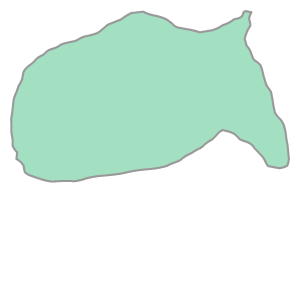

In [10]:
maskPolygon

In [11]:
# rgb color list
colorList = [[191, 214, 230], [107, 174, 216], [33, 114, 180], [239, 243, 255]]
# colorList = [[191, 214, 230], [107, 174, 216], [33, 114, 180], [239, 243, 255]]

In [12]:
def bgr2rgb(value):
    return value[2],value[0],value[1]
def valueEqualColor(value,color):
    colorR, colorG, colorB = color[0], color[1], color[2]
    valueR, valueG, valueB = value[0], value[1], value[2]
    if abs(colorR - valueR) > 10 or abs(colorB - valueB) > 10 or abs(colorG - valueG) > 10:
        return False
    else:
        return True

In [13]:
def rgb2Grey(dominantColor):
    rgb_weights = [0.2989, 0.5870, 0.1140]
    dominantColorGrey = int(np.dot(dominantColor, rgb_weights))
    return dominantColorGrey

In [14]:
# traverse the whole image
colorGrey0 = rgb2Grey(colorList[0])
colorGrey1 = rgb2Grey(colorList[1])
colorGrey2 = rgb2Grey(colorList[2])
colorGrey3 = rgb2Grey(colorList[3])

In [15]:
pixelCoordList0, pixelCoordList1, pixelCoordList2, pixelCoordList3 = [],[],[],[]
for i in range(height):
    for j in range(mask.shape[1]):
        # test x,y axis
#         if i != 148 or j != 257:
#             continue
        point = Point(j,i)
#         if bboxMap.contains(point) and maskPolygon.contains(point):
        if mask[i,j] == True:
#             print('yes!')
            value =  imageGray[i,j]
            print(value)
            b, g, r = image[i,j]
#             value_rgb = value
#             print(value_rgb)
            if not (abs(b - g) < 10 and abs(b-r) < 10 and abs(g - r)<10):
                if abs(value - colorGrey0) <= 10:
                    print('0: j: '+ str(j) + ' i: ' + str(i))
                    pixelCoordList0.append((j,i))  
                elif abs(value - colorGrey1) <= 10:
                    print('1: j: '+ str(j) + ' i: ' + str(i))
                    pixelCoordList1.append((j,i))  
                elif abs(value - colorGrey2) <= 10:
                    print('0: j: '+ str(j) + ' i: ' + str(i))
                    pixelCoordList2.append((j,i))  
                elif abs(value - colorGrey3) <= 10:
                    print('0: j: '+ str(j) + ' i: ' + str(i))
                    pixelCoordList3.append((j,i))  

242
0: j: 245 i: 130
236
0: j: 246 i: 130
229
243
0: j: 248 i: 130
243
0: j: 249 i: 130
243
0: j: 250 i: 130
243
0: j: 251 i: 130
243
0: j: 252 i: 130
243
0: j: 253 i: 130
243
0: j: 254 i: 130
243
0: j: 255 i: 130
239
0: j: 256 i: 130
245
0: j: 257 i: 130
241
0: j: 258 i: 130
249
239
0: j: 260 i: 130
242
0: j: 261 i: 130
245
0: j: 262 i: 130
184
125
246
242
0: j: 240 i: 131
241
0: j: 241 i: 131
241
0: j: 242 i: 131
244
0: j: 243 i: 131
247
0: j: 244 i: 131
249
246
0: j: 246 i: 131
240
0: j: 247 i: 131
243
0: j: 248 i: 131
243
0: j: 249 i: 131
243
0: j: 250 i: 131
243
0: j: 251 i: 131
243
0: j: 252 i: 131
243
0: j: 253 i: 131
243
0: j: 254 i: 131
243
0: j: 255 i: 131
239
0: j: 256 i: 131
246
0: j: 257 i: 131
236
0: j: 258 i: 131
250
239
0: j: 260 i: 131
242
0: j: 261 i: 131
249
162
1: j: 263 i: 131
123
169
236
0: j: 266 i: 131
249
244
0: j: 268 i: 131
243
0: j: 269 i: 131
244
0: j: 270 i: 131
242
0: j: 271 i: 131
241
0: j: 272 i: 131
241
0: j: 273 i: 131
239
0: j: 274 i: 131
168
1: j: 2

C:\Users\jiali\anaconda3\envs\imageProcess\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: overflow encountered in ubyte_scalars
  app.launch_new_instance()


131
151
1: j: 289 i: 135
239
0: j: 290 i: 135
239
0: j: 291 i: 135
247
0: j: 292 i: 135
249
241
0: j: 294 i: 135
247
0: j: 295 i: 135
154
1: j: 296 i: 135
125
173
236
0: j: 299 i: 135
249
134
116
222
245
0: j: 304 i: 135
238
0: j: 305 i: 135
246
0: j: 306 i: 135
242
0: j: 307 i: 135
238
0: j: 308 i: 135
247
0: j: 309 i: 135
246
0: j: 310 i: 135
240
0: j: 311 i: 135
239
0: j: 312 i: 135
246
0: j: 313 i: 135
220
116
128
250
228
251
243
0: j: 320 i: 135
243
0: j: 321 i: 135
243
0: j: 322 i: 135
243
0: j: 323 i: 135
243
0: j: 324 i: 135
243
0: j: 325 i: 135
243
0: j: 326 i: 135
243
0: j: 327 i: 135
240
0: j: 328 i: 135
241
0: j: 329 i: 135
242
0: j: 330 i: 135
243
0: j: 331 i: 135
243
0: j: 332 i: 135
243
0: j: 333 i: 135
243
0: j: 334 i: 135
243
0: j: 335 i: 135
240
0: j: 336 i: 135
253
0: j: 337 i: 135
227
158
1: j: 339 i: 135
123
127
146
156
1: j: 343 i: 135
158
1: j: 344 i: 135
159
1: j: 345 i: 135
159
1: j: 346 i: 135
159
1: j: 347 i: 135
158
1: j: 348 i: 135
158
1: j: 349 i: 135
159


190
241
0: j: 196 i: 143
247
239
0: j: 198 i: 143
242
0: j: 199 i: 143
245
0: j: 200 i: 143
244
0: j: 201 i: 143
243
0: j: 202 i: 143
243
0: j: 203 i: 143
242
0: j: 204 i: 143
242
0: j: 205 i: 143
243
0: j: 206 i: 143
243
0: j: 207 i: 143
248
244
0: j: 209 i: 143
241
0: j: 210 i: 143
239
0: j: 211 i: 143
239
0: j: 212 i: 143
241
0: j: 213 i: 143
242
0: j: 214 i: 143
242
0: j: 215 i: 143
206
0: j: 216 i: 143
112
149
1: j: 218 i: 143
201
0: j: 219 i: 143
238
0: j: 220 i: 143
239
0: j: 221 i: 143
247
0: j: 222 i: 143
241
0: j: 223 i: 143
243
0: j: 224 i: 143
243
0: j: 225 i: 143
243
0: j: 226 i: 143
243
0: j: 227 i: 143
243
0: j: 228 i: 143
243
0: j: 229 i: 143
243
0: j: 230 i: 143
243
0: j: 231 i: 143
244
0: j: 232 i: 143
243
0: j: 233 i: 143
227
159
1: j: 235 i: 143
128
130
161
127
130
149
1: j: 241 i: 143
227
239
0: j: 243 i: 143
252
240
0: j: 245 i: 143
238
0: j: 246 i: 143
247
0: j: 247 i: 143
244
0: j: 248 i: 143
244
0: j: 249 i: 143
248
0: j: 250 i: 143
238
0: j: 251 i: 143
251
231

224
128
130
226
239
0: j: 297 i: 146
236
0: j: 298 i: 146
230
243
0: j: 300 i: 146
252
248
0: j: 302 i: 146
244
0: j: 303 i: 146
243
0: j: 304 i: 146
253
238
0: j: 306 i: 146
234
0: j: 307 i: 146
230
243
0: j: 309 i: 146
241
0: j: 310 i: 146
248
183
133
154
1: j: 314 i: 146
242
0: j: 315 i: 146
245
0: j: 316 i: 146
236
232
245
0: j: 319 i: 146
244
0: j: 320 i: 146
251
246
0: j: 322 i: 146
240
0: j: 323 i: 146
244
0: j: 324 i: 146
246
0: j: 325 i: 146
242
0: j: 326 i: 146
241
0: j: 327 i: 146
242
0: j: 328 i: 146
246
0: j: 329 i: 146
237
0: j: 330 i: 146
230
239
0: j: 332 i: 146
240
227
134
131
151
1: j: 337 i: 146
159
1: j: 338 i: 146
158
1: j: 339 i: 146
162
1: j: 340 i: 146
159
1: j: 341 i: 146
156
1: j: 342 i: 146
162
1: j: 343 i: 146
159
1: j: 344 i: 146
159
1: j: 345 i: 146
159
1: j: 346 i: 146
159
1: j: 347 i: 146
159
1: j: 348 i: 146
159
1: j: 349 i: 146
159
1: j: 350 i: 146
159
1: j: 351 i: 146
157
1: j: 352 i: 146
162
1: j: 353 i: 146
163
1: j: 354 i: 146
156
1: j: 355 i: 146


159
1: j: 375 i: 149
165
1: j: 376 i: 149
162
1: j: 377 i: 149
159
1: j: 378 i: 149
158
1: j: 379 i: 149
159
1: j: 380 i: 149
159
1: j: 381 i: 149
155
1: j: 382 i: 149
151
1: j: 383 i: 149
129
120
102
0: j: 386 i: 149
94
0: j: 387 i: 149
99
0: j: 388 i: 149
97
0: j: 389 i: 149
93
0: j: 390 i: 149
100
0: j: 391 i: 149
97
0: j: 392 i: 149
97
0: j: 393 i: 149
97
0: j: 394 i: 149
97
0: j: 395 i: 149
97
0: j: 396 i: 149
97
0: j: 397 i: 149
97
0: j: 398 i: 149
97
0: j: 399 i: 149
111
129
121
99
0: j: 403 i: 149
95
0: j: 404 i: 149
99
0: j: 405 i: 149
98
0: j: 406 i: 149
96
0: j: 407 i: 149
100
0: j: 408 i: 149
92
0: j: 409 i: 149
124
129
146
157
1: j: 413 i: 149
161
1: j: 414 i: 149
159
1: j: 415 i: 149
159
1: j: 416 i: 149
159
1: j: 417 i: 149
159
1: j: 418 i: 149
160
1: j: 419 i: 149
160
1: j: 420 i: 149
130
133
129
117
130
150
1: j: 180 i: 150
162
1: j: 181 i: 150
135
116
134
144
125
128
191
243
0: j: 189 i: 150
248
0: j: 190 i: 150
246
0: j: 191 i: 150
245
0: j: 192 i: 150
240
0: j: 193 

158
1: j: 370 i: 152
156
1: j: 371 i: 152
159
1: j: 372 i: 152
162
1: j: 373 i: 152
159
1: j: 374 i: 152
151
1: j: 375 i: 152
131
130
126
123
125
129
128
123
125
112
99
0: j: 386 i: 152
96
0: j: 387 i: 152
97
0: j: 388 i: 152
96
0: j: 389 i: 152
96
0: j: 390 i: 152
97
0: j: 391 i: 152
92
0: j: 392 i: 152
100
0: j: 393 i: 152
97
0: j: 394 i: 152
94
0: j: 395 i: 152
100
0: j: 396 i: 152
100
0: j: 397 i: 152
95
0: j: 398 i: 152
98
0: j: 399 i: 152
133
121
104
0: j: 402 i: 152
94
0: j: 403 i: 152
95
0: j: 404 i: 152
99
0: j: 405 i: 152
99
0: j: 406 i: 152
95
0: j: 407 i: 152
92
0: j: 408 i: 152
108
121
130
163
1: j: 412 i: 152
150
1: j: 413 i: 152
165
1: j: 414 i: 152
158
1: j: 415 i: 152
159
1: j: 416 i: 152
159
1: j: 417 i: 152
159
1: j: 418 i: 152
159
1: j: 419 i: 152
159
1: j: 420 i: 152
159
1: j: 421 i: 152
159
1: j: 422 i: 152
159
1: j: 423 i: 152
162
1: j: 424 i: 152
160
1: j: 425 i: 152
158
1: j: 426 i: 152
158
1: j: 427 i: 152
160
1: j: 428 i: 152
161
1: j: 429 i: 152
161
1: j: 43

225
245
0: j: 258 i: 155
246
0: j: 259 i: 155
236
0: j: 260 i: 155
245
0: j: 261 i: 155
245
0: j: 262 i: 155
241
0: j: 263 i: 155
243
0: j: 264 i: 155
243
0: j: 265 i: 155
243
0: j: 266 i: 155
243
0: j: 267 i: 155
243
0: j: 268 i: 155
243
0: j: 269 i: 155
243
0: j: 270 i: 155
243
0: j: 271 i: 155
233
0: j: 272 i: 155
254
250
254
229
128
128
211
254
206
156
143
164
1: j: 284 i: 155
249
251
240
0: j: 287 i: 155
243
0: j: 288 i: 155
246
0: j: 289 i: 155
235
0: j: 290 i: 155
222
130
138
222
238
0: j: 295 i: 155
242
0: j: 296 i: 155
244
0: j: 297 i: 155
251
250
251
240
0: j: 301 i: 155
140
132
159
141
125
192
243
231
159
126
131
247
0: j: 313 i: 155
244
0: j: 314 i: 155
242
0: j: 315 i: 155
245
0: j: 316 i: 155
240
0: j: 317 i: 155
226
134
132
206
0: j: 321 i: 155
244
0: j: 322 i: 155
240
0: j: 323 i: 155
245
0: j: 324 i: 155
243
0: j: 325 i: 155
248
0: j: 326 i: 155
242
0: j: 327 i: 155
254
246
0: j: 329 i: 155
140
123
154
1: j: 332 i: 155
155
1: j: 333 i: 155
167
1: j: 334 i: 155
155
1: j

100
0: j: 398 i: 157
120
126
109
96
0: j: 402 i: 157
96
0: j: 403 i: 157
99
0: j: 404 i: 157
96
0: j: 405 i: 157
95
0: j: 406 i: 157
97
0: j: 407 i: 157
97
0: j: 408 i: 157
125
126
153
1: j: 411 i: 157
158
1: j: 412 i: 157
159
1: j: 413 i: 157
158
1: j: 414 i: 157
161
1: j: 415 i: 157
159
1: j: 416 i: 157
159
1: j: 417 i: 157
159
1: j: 418 i: 157
159
1: j: 419 i: 157
159
1: j: 420 i: 157
159
1: j: 421 i: 157
159
1: j: 422 i: 157
159
1: j: 423 i: 157
160
1: j: 424 i: 157
159
1: j: 425 i: 157
159
1: j: 426 i: 157
160
1: j: 427 i: 157
161
1: j: 428 i: 157
159
1: j: 429 i: 157
156
1: j: 430 i: 157
154
1: j: 431 i: 157
125
131
150
1: j: 434 i: 157
161
1: j: 435 i: 157
157
1: j: 436 i: 157
157
1: j: 437 i: 157
161
1: j: 438 i: 157
157
1: j: 439 i: 157
159
1: j: 440 i: 157
159
1: j: 441 i: 157
159
1: j: 442 i: 157
159
1: j: 443 i: 157
159
1: j: 444 i: 157
159
1: j: 445 i: 157
159
1: j: 446 i: 157
159
1: j: 447 i: 157
159
1: j: 448 i: 157
160
1: j: 449 i: 157
156
1: j: 450 i: 157
158
1: j: 451

160
1: j: 458 i: 159
156
1: j: 459 i: 159
158
1: j: 460 i: 159
161
1: j: 461 i: 159
161
1: j: 462 i: 159
158
1: j: 463 i: 159
159
1: j: 464 i: 159
159
1: j: 465 i: 159
159
1: j: 466 i: 159
159
1: j: 467 i: 159
159
1: j: 468 i: 159
159
1: j: 469 i: 159
159
1: j: 470 i: 159
159
1: j: 471 i: 159
160
1: j: 472 i: 159
150
1: j: 473 i: 159
129
127
150
1: j: 476 i: 159
163
1: j: 477 i: 159
161
1: j: 478 i: 159
160
1: j: 479 i: 159
156
1: j: 480 i: 159
157
1: j: 481 i: 159
157
1: j: 482 i: 159
158
1: j: 483 i: 159
159
1: j: 484 i: 159
160
1: j: 485 i: 159
160
1: j: 486 i: 159
161
1: j: 487 i: 159
159
1: j: 488 i: 159
158
1: j: 489 i: 159
159
1: j: 490 i: 159
161
1: j: 491 i: 159
157
1: j: 492 i: 159
146
139
137
132
112
94
0: j: 498 i: 159
91
0: j: 499 i: 159
98
0: j: 500 i: 159
101
0: j: 501 i: 159
99
0: j: 502 i: 159
97
0: j: 503 i: 159
95
0: j: 504 i: 159
95
0: j: 505 i: 159
96
0: j: 506 i: 159
96
0: j: 507 i: 159
97
0: j: 508 i: 159
97
0: j: 509 i: 159
98
0: j: 510 i: 159
98
0: j: 511 i: 15

101
0: j: 501 i: 161
100
0: j: 502 i: 161
100
0: j: 503 i: 161
95
0: j: 504 i: 161
96
0: j: 505 i: 161
97
0: j: 506 i: 161
98
0: j: 507 i: 161
99
0: j: 508 i: 161
100
0: j: 509 i: 161
101
0: j: 510 i: 161
102
0: j: 511 i: 161
96
0: j: 512 i: 161
113
130
122
99
0: j: 516 i: 161
96
0: j: 517 i: 161
102
0: j: 518 i: 161
97
0: j: 519 i: 161
97
0: j: 520 i: 161
97
0: j: 521 i: 161
97
0: j: 522 i: 161
97
0: j: 523 i: 161
97
0: j: 524 i: 161
97
0: j: 525 i: 161
255
255
255
255
235
142
127
132
130
135
186
248
243
0: j: 161 i: 162
249
241
0: j: 163 i: 162
229
235
0: j: 165 i: 162
254
224
117
138
224
251
246
0: j: 172 i: 162
245
0: j: 173 i: 162
247
0: j: 174 i: 162
254
244
0: j: 176 i: 162
241
242
245
234
201
158
128
124
119
139
128
123
119
131
214
0: j: 191 i: 162
247
0: j: 192 i: 162
246
0: j: 193 i: 162
245
0: j: 194 i: 162
245
0: j: 195 i: 162
243
0: j: 196 i: 162
239
0: j: 197 i: 162
237
0: j: 198 i: 162
237
0: j: 199 i: 162
243
0: j: 200 i: 162
241
0: j: 201 i: 162
243
0: j: 202 i: 162
23

255
255
255
255
255
255
167
120
134
138
136
137
229
252
239
0: j: 161 i: 164
236
0: j: 162 i: 164
234
0: j: 163 i: 164
247
0: j: 164 i: 164
248
0: j: 165 i: 164
241
134
129
179
248
0: j: 170 i: 164
234
0: j: 171 i: 164
246
0: j: 172 i: 164
247
0: j: 173 i: 164
240
0: j: 174 i: 164
237
0: j: 175 i: 164
235
0: j: 176 i: 164
241
0: j: 177 i: 164
246
0: j: 178 i: 164
246
0: j: 179 i: 164
242
0: j: 180 i: 164
241
0: j: 181 i: 164
243
0: j: 182 i: 164
245
0: j: 183 i: 164
230
251
241
0: j: 186 i: 164
225
190
147
137
129
117
157
1: j: 193 i: 164
191
205
0: j: 195 i: 164
222
242
0: j: 197 i: 164
237
0: j: 198 i: 164
216
0: j: 199 i: 164
224
224
247
215
129
133
216
250
235
251
237
0: j: 210 i: 164
254
126
132
171
235
0: j: 215 i: 164
238
0: j: 216 i: 164
241
0: j: 217 i: 164
246
0: j: 218 i: 164
249
249
247
0: j: 221 i: 164
244
0: j: 222 i: 164
242
0: j: 223 i: 164
241
0: j: 224 i: 164
243
0: j: 225 i: 164
245
0: j: 226 i: 164
244
0: j: 227 i: 164
241
0: j: 228 i: 164
238
0: j: 229 i: 164
238
0

99
0: j: 510 i: 166
97
0: j: 511 i: 166
106
0: j: 512 i: 166
111
125
126
107
0: j: 516 i: 166
96
0: j: 517 i: 166
97
0: j: 518 i: 166
95
0: j: 519 i: 166
97
0: j: 520 i: 166
97
0: j: 521 i: 166
97
0: j: 522 i: 166
97
0: j: 523 i: 166
97
0: j: 524 i: 166
97
0: j: 525 i: 166
97
0: j: 526 i: 166
97
0: j: 527 i: 166
98
0: j: 528 i: 166
96
0: j: 529 i: 166
96
0: j: 530 i: 166
124
130
110
109
107
0: j: 535 i: 166
103
0: j: 536 i: 166
103
0: j: 537 i: 166
102
0: j: 538 i: 166
101
0: j: 539 i: 166
101
0: j: 540 i: 166
100
0: j: 541 i: 166
99
0: j: 542 i: 166
99
0: j: 543 i: 166
99
0: j: 544 i: 166
102
0: j: 545 i: 166
99
0: j: 546 i: 166
98
0: j: 547 i: 166
99
0: j: 548 i: 166
92
0: j: 549 i: 166
255
255
255
255
255
255
255
255
255
166
121
127
150
235
241
230
141
125
123
128
142
173
228
169
122
157
254
233
0: j: 170 i: 167
245
0: j: 171 i: 167
245
0: j: 172 i: 167
241
0: j: 173 i: 167
247
0: j: 174 i: 167
242
0: j: 175 i: 167
245
0: j: 176 i: 167
249
0: j: 177 i: 167
248
0: j: 178 i: 167
241
0

159
1: j: 440 i: 168
159
1: j: 441 i: 168
159
1: j: 442 i: 168
159
1: j: 443 i: 168
159
1: j: 444 i: 168
159
1: j: 445 i: 168
159
1: j: 446 i: 168
159
1: j: 447 i: 168
162
1: j: 448 i: 168
156
1: j: 449 i: 168
143
132
138
154
1: j: 453 i: 168
160
1: j: 454 i: 168
157
1: j: 455 i: 168
159
1: j: 456 i: 168
159
1: j: 457 i: 168
159
1: j: 458 i: 168
159
1: j: 459 i: 168
159
1: j: 460 i: 168
159
1: j: 461 i: 168
159
1: j: 462 i: 168
159
1: j: 463 i: 168
156
1: j: 464 i: 168
164
1: j: 465 i: 168
161
1: j: 466 i: 168
152
1: j: 467 i: 168
156
1: j: 468 i: 168
165
1: j: 469 i: 168
152
1: j: 470 i: 168
128
124
134
148
1: j: 474 i: 168
158
1: j: 475 i: 168
161
1: j: 476 i: 168
161
1: j: 477 i: 168
160
1: j: 478 i: 168
160
1: j: 479 i: 168
159
1: j: 480 i: 168
159
1: j: 481 i: 168
159
1: j: 482 i: 168
159
1: j: 483 i: 168
159
1: j: 484 i: 168
159
1: j: 485 i: 168
159
1: j: 486 i: 168
159
1: j: 487 i: 168
159
1: j: 488 i: 168
159
1: j: 489 i: 168
159
1: j: 490 i: 168
159
1: j: 491 i: 168
159
1: j: 

250
240
230
243
124
133
209
0: j: 253 i: 170
240
0: j: 254 i: 170
244
0: j: 255 i: 170
245
0: j: 256 i: 170
243
0: j: 257 i: 170
241
0: j: 258 i: 170
241
0: j: 259 i: 170
244
0: j: 260 i: 170
246
0: j: 261 i: 170
247
0: j: 262 i: 170
246
0: j: 263 i: 170
247
0: j: 264 i: 170
249
253
237
0: j: 267 i: 170
243
0: j: 268 i: 170
238
0: j: 269 i: 170
201
136
127
135
122
132
128
128
136
134
154
1: j: 280 i: 170
177
205
0: j: 282 i: 170
215
0: j: 283 i: 170
238
0: j: 284 i: 170
254
245
0: j: 286 i: 170
246
0: j: 287 i: 170
130
119
131
129
141
123
121
144
129
123
128
126
113
135
132
137
199
249
241
0: j: 306 i: 170
242
0: j: 307 i: 170
247
0: j: 308 i: 170
238
0: j: 309 i: 170
246
0: j: 310 i: 170
242
0: j: 311 i: 170
254
130
111
126
233
247
213
0: j: 318 i: 170
247
0: j: 319 i: 170
239
0: j: 320 i: 170
246
0: j: 321 i: 170
243
0: j: 322 i: 170
232
234
0: j: 324 i: 170
247
0: j: 325 i: 170
253
249
0: j: 327 i: 170
241
0: j: 328 i: 170
245
0: j: 329 i: 170
242
0: j: 330 i: 170
242
0: j: 331 i: 1

255
255
255
255
255
255
255
255
255
255
133
120
126
133
129
115
159
161
148
1: j: 161 i: 172
146
141
114
187
244
226
117
134
228
236
0: j: 171 i: 172
197
151
1: j: 173 i: 172
145
139
129
119
116
129
152
183
219
248
0: j: 183 i: 172
244
248
0: j: 185 i: 172
250
245
0: j: 187 i: 172
237
236
0: j: 189 i: 172
243
251
239
0: j: 192 i: 172
238
0: j: 193 i: 172
237
0: j: 194 i: 172
239
0: j: 195 i: 172
243
0: j: 196 i: 172
246
0: j: 197 i: 172
245
0: j: 198 i: 172
242
0: j: 199 i: 172
237
0: j: 200 i: 172
245
0: j: 201 i: 172
254
145
142
141
239
0: j: 206 i: 172
235
0: j: 207 i: 172
243
0: j: 208 i: 172
243
0: j: 209 i: 172
243
0: j: 210 i: 172
243
0: j: 211 i: 172
243
0: j: 212 i: 172
243
0: j: 213 i: 172
243
0: j: 214 i: 172
243
0: j: 215 i: 172
248
0: j: 216 i: 172
242
0: j: 217 i: 172
240
0: j: 218 i: 172
254
231
136
138
188
225
240
0: j: 225 i: 172
249
244
0: j: 227 i: 172
244
0: j: 228 i: 172
248
0: j: 229 i: 172
242
229
122
145
244
0: j: 234 i: 172
248
238
0: j: 236 i: 172
238
0: j: 23

108
111
129
122
97
0: j: 533 i: 173
98
0: j: 534 i: 173
98
0: j: 535 i: 173
96
0: j: 536 i: 173
96
0: j: 537 i: 173
97
0: j: 538 i: 173
97
0: j: 539 i: 173
98
0: j: 540 i: 173
98
0: j: 541 i: 173
99
0: j: 542 i: 173
99
0: j: 543 i: 173
96
0: j: 544 i: 173
96
0: j: 545 i: 173
96
0: j: 546 i: 173
94
0: j: 547 i: 173
93
0: j: 548 i: 173
93
0: j: 549 i: 173
96
0: j: 550 i: 173
98
0: j: 551 i: 173
127
126
114
107
0: j: 555 i: 173
115
118
119
127
123
131
128
125
129
126
125
133
130
129
122
132
121
94
0: j: 573 i: 173
94
0: j: 574 i: 173
94
0: j: 575 i: 173
94
0: j: 576 i: 173
99
0: j: 577 i: 173
124
135
121
119
125
118
112
255
255
255
255
255
255
255
255
255
255
255
236
121
134
181
123
117
138
150
169
215
205
153
126
129
208
161
133
149
250
246
248
0: j: 172 i: 174
233
0: j: 173 i: 174
241
0: j: 174 i: 174
250
243
245
0: j: 177 i: 174
236
0: j: 178 i: 174
203
0: j: 179 i: 174
158
1: j: 180 i: 174
127
126
138
136
131
126
131
153
1: j: 188 i: 174
189
227
251
231
241
0: j: 193 i: 174
247
0: j: 

161
1: j: 407 i: 175
159
1: j: 408 i: 175
159
1: j: 409 i: 175
159
1: j: 410 i: 175
159
1: j: 411 i: 175
159
1: j: 412 i: 175
159
1: j: 413 i: 175
159
1: j: 414 i: 175
159
1: j: 415 i: 175
159
1: j: 416 i: 175
159
1: j: 417 i: 175
159
1: j: 418 i: 175
159
1: j: 419 i: 175
159
1: j: 420 i: 175
159
1: j: 421 i: 175
159
1: j: 422 i: 175
159
1: j: 423 i: 175
156
1: j: 424 i: 175
161
1: j: 425 i: 175
162
1: j: 426 i: 175
160
1: j: 427 i: 175
149
1: j: 428 i: 175
128
130
156
1: j: 431 i: 175
159
1: j: 432 i: 175
159
1: j: 433 i: 175
159
1: j: 434 i: 175
159
1: j: 435 i: 175
159
1: j: 436 i: 175
159
1: j: 437 i: 175
159
1: j: 438 i: 175
159
1: j: 439 i: 175
159
1: j: 440 i: 175
159
1: j: 441 i: 175
159
1: j: 442 i: 175
159
1: j: 443 i: 175
159
1: j: 444 i: 175
159
1: j: 445 i: 175
159
1: j: 446 i: 175
159
1: j: 447 i: 175
157
1: j: 448 i: 175
135
128
146
161
1: j: 452 i: 175
158
1: j: 453 i: 175
156
1: j: 454 i: 175
161
1: j: 455 i: 175
159
1: j: 456 i: 175
159
1: j: 457 i: 175
159
1: j: 458 

246
0: j: 228 i: 177
241
0: j: 229 i: 177
194
134
145
240
254
238
244
245
223
180
162
209
135
144
219
251
238
0: j: 246 i: 177
235
0: j: 247 i: 177
243
0: j: 248 i: 177
251
253
243
0: j: 251 i: 177
234
0: j: 252 i: 177
237
0: j: 253 i: 177
246
0: j: 254 i: 177
251
240
0: j: 256 i: 177
241
0: j: 257 i: 177
243
0: j: 258 i: 177
246
0: j: 259 i: 177
247
0: j: 260 i: 177
245
0: j: 261 i: 177
238
0: j: 262 i: 177
232
235
0: j: 264 i: 177
250
234
0: j: 266 i: 177
246
0: j: 267 i: 177
246
0: j: 268 i: 177
145
133
172
243
0: j: 272 i: 177
243
0: j: 273 i: 177
243
0: j: 274 i: 177
243
0: j: 275 i: 177
242
0: j: 276 i: 177
242
0: j: 277 i: 177
242
0: j: 278 i: 177
242
0: j: 279 i: 177
244
0: j: 280 i: 177
241
0: j: 281 i: 177
244
0: j: 282 i: 177
245
0: j: 283 i: 177
242
0: j: 284 i: 177
238
0: j: 285 i: 177
215
0: j: 286 i: 177
125
123
116
241
0: j: 290 i: 177
240
0: j: 291 i: 177
247
0: j: 292 i: 177
254
230
244
241
241
245
241
193
133
137
244
243
0: j: 304 i: 177
242
0: j: 305 i: 177
242
0: j

99
0: j: 576 i: 178
99
0: j: 577 i: 178
99
0: j: 578 i: 178
99
0: j: 579 i: 178
99
0: j: 580 i: 178
99
0: j: 581 i: 178
99
0: j: 582 i: 178
99
0: j: 583 i: 178
112
126
126
107
0: j: 587 i: 178
94
0: j: 588 i: 178
95
0: j: 589 i: 178
97
0: j: 590 i: 178
94
0: j: 591 i: 178
96
0: j: 592 i: 178
95
0: j: 593 i: 178
102
0: j: 594 i: 178
95
0: j: 595 i: 178
94
0: j: 596 i: 178
96
0: j: 597 i: 178
98
0: j: 598 i: 178
129
128
110
96
0: j: 602 i: 178
94
0: j: 603 i: 178
93
0: j: 604 i: 178
90
0: j: 605 i: 178
92
0: j: 606 i: 178
97
0: j: 607 i: 178
99
0: j: 608 i: 178
95
0: j: 609 i: 178
98
0: j: 610 i: 178
98
0: j: 611 i: 178
97
0: j: 612 i: 178
111
126
126
95
0: j: 616 i: 178
92
0: j: 617 i: 178
93
0: j: 618 i: 178
95
0: j: 619 i: 178
92
0: j: 620 i: 178
90
0: j: 621 i: 178
103
0: j: 622 i: 178
119
124
109
96
0: j: 626 i: 178
255
255
255
255
255
254
255
253
248
250
0: j: 149 i: 179
203
0: j: 150 i: 179
119
157
1: j: 152 i: 179
245
252
241
0: j: 155 i: 179
243
0: j: 156 i: 179
243
0: j: 157 i:

131
128
207
0: j: 356 i: 180
248
0: j: 357 i: 180
235
0: j: 358 i: 180
248
0: j: 359 i: 180
236
0: j: 360 i: 180
120
123
154
1: j: 363 i: 180
224
236
0: j: 365 i: 180
244
0: j: 366 i: 180
254
242
0: j: 368 i: 180
233
0: j: 369 i: 180
234
0: j: 370 i: 180
253
0: j: 371 i: 180
244
0: j: 372 i: 180
204
0: j: 373 i: 180
150
1: j: 374 i: 180
130
113
104
0: j: 377 i: 180
98
0: j: 378 i: 180
98
0: j: 379 i: 180
94
0: j: 380 i: 180
92
0: j: 381 i: 180
102
0: j: 382 i: 180
118
132
130
122
129
122
135
177
177
160
1: j: 392 i: 180
150
1: j: 393 i: 180
144
139
129
124
126
128
131
128
132
147
158
1: j: 404 i: 180
159
1: j: 405 i: 180
156
1: j: 406 i: 180
154
1: j: 407 i: 180
159
1: j: 408 i: 180
159
1: j: 409 i: 180
159
1: j: 410 i: 180
159
1: j: 411 i: 180
159
1: j: 412 i: 180
159
1: j: 413 i: 180
159
1: j: 414 i: 180
159
1: j: 415 i: 180
161
1: j: 416 i: 180
160
1: j: 417 i: 180
159
1: j: 418 i: 180
158
1: j: 419 i: 180
159
1: j: 420 i: 180
159
1: j: 421 i: 180
160
1: j: 422 i: 180
159
1: j: 423 

255
255
255
255
255
251
255
255
202
136
118
203
241
247
243
0: j: 155 i: 182
233
0: j: 156 i: 182
251
233
0: j: 158 i: 182
248
0: j: 159 i: 182
250
229
130
128
217
0: j: 164 i: 182
239
0: j: 165 i: 182
240
0: j: 166 i: 182
237
0: j: 167 i: 182
251
240
0: j: 169 i: 182
251
230
132
127
241
0: j: 174 i: 182
247
0: j: 175 i: 182
239
0: j: 176 i: 182
246
0: j: 177 i: 182
245
0: j: 178 i: 182
238
0: j: 179 i: 182
242
0: j: 180 i: 182
251
247
0: j: 182 i: 182
233
0: j: 183 i: 182
134
126
203
0: j: 186 i: 182
251
238
0: j: 188 i: 182
240
0: j: 189 i: 182
252
246
0: j: 191 i: 182
235
0: j: 192 i: 182
240
0: j: 193 i: 182
243
0: j: 194 i: 182
241
0: j: 195 i: 182
241
0: j: 196 i: 182
246
0: j: 197 i: 182
191
141
135
249
239
0: j: 202 i: 182
244
0: j: 203 i: 182
246
0: j: 204 i: 182
246
0: j: 205 i: 182
248
233
0: j: 207 i: 182
243
0: j: 208 i: 182
243
0: j: 209 i: 182
243
0: j: 210 i: 182
243
0: j: 211 i: 182
243
0: j: 212 i: 182
243
0: j: 213 i: 182
243
0: j: 214 i: 182
243
0: j: 215 i: 182
243

159
1: j: 477 i: 183
159
1: j: 478 i: 183
159
1: j: 479 i: 183
154
1: j: 480 i: 183
159
1: j: 481 i: 183
161
1: j: 482 i: 183
154
1: j: 483 i: 183
140
130
128
130
164
1: j: 488 i: 183
175
163
1: j: 490 i: 183
131
117
128
132
122
121
134
132
125
130
131
127
129
178
173
154
1: j: 506 i: 183
131
122
128
131
125
126
129
133
136
136
133
129
126
132
132
132
128
121
111
101
0: j: 526 i: 183
96
0: j: 527 i: 183
107
0: j: 528 i: 183
109
137
126
97
0: j: 532 i: 183
99
0: j: 533 i: 183
98
0: j: 534 i: 183
93
0: j: 535 i: 183
115
123
130
126
113
102
0: j: 541 i: 183
98
0: j: 542 i: 183
99
0: j: 543 i: 183
97
0: j: 544 i: 183
108
118
122
124
123
112
100
0: j: 551 i: 183
125
125
108
93
0: j: 555 i: 183
96
0: j: 556 i: 183
97
0: j: 557 i: 183
96
0: j: 558 i: 183
100
0: j: 559 i: 183
97
0: j: 560 i: 183
97
0: j: 561 i: 183
97
0: j: 562 i: 183
97
0: j: 563 i: 183
97
0: j: 564 i: 183
97
0: j: 565 i: 183
97
0: j: 566 i: 183
97
0: j: 567 i: 183
102
0: j: 568 i: 183
126
122
99
0: j: 571 i: 183
94
0: j: 572

217
0: j: 197 i: 185
127
131
238
0: j: 200 i: 185
246
0: j: 201 i: 185
248
0: j: 202 i: 185
243
0: j: 203 i: 185
243
0: j: 204 i: 185
246
0: j: 205 i: 185
240
0: j: 206 i: 185
228
244
0: j: 208 i: 185
248
0: j: 209 i: 185
250
247
0: j: 211 i: 185
240
0: j: 212 i: 185
237
0: j: 213 i: 185
240
0: j: 214 i: 185
245
0: j: 215 i: 185
243
0: j: 216 i: 185
243
0: j: 217 i: 185
243
0: j: 218 i: 185
243
0: j: 219 i: 185
243
0: j: 220 i: 185
243
0: j: 221 i: 185
243
0: j: 222 i: 185
243
0: j: 223 i: 185
248
239
0: j: 225 i: 185
249
244
0: j: 227 i: 185
243
0: j: 228 i: 185
229
134
130
215
0: j: 232 i: 185
237
0: j: 233 i: 185
251
245
0: j: 235 i: 185
239
0: j: 236 i: 185
244
0: j: 237 i: 185
245
0: j: 238 i: 185
240
0: j: 239 i: 185
240
175
127
156
236
0: j: 244 i: 185
248
0: j: 245 i: 185
238
0: j: 246 i: 185
246
0: j: 247 i: 185
245
0: j: 248 i: 185
238
0: j: 249 i: 185
242
0: j: 250 i: 185
246
0: j: 251 i: 185
244
0: j: 252 i: 185
243
0: j: 253 i: 185
247
0: j: 254 i: 185
247
240
232
240
254


141
128
135
154
1: j: 469 i: 186
162
1: j: 470 i: 186
156
1: j: 471 i: 186
154
1: j: 472 i: 186
160
1: j: 473 i: 186
164
1: j: 474 i: 186
162
1: j: 475 i: 186
157
1: j: 476 i: 186
155
1: j: 477 i: 186
160
1: j: 478 i: 186
165
1: j: 479 i: 186
163
1: j: 480 i: 186
155
1: j: 481 i: 186
144
134
128
126
126
126
126
156
1: j: 489 i: 186
195
205
0: j: 491 i: 186
208
0: j: 492 i: 186
214
0: j: 493 i: 186
220
212
0: j: 495 i: 186
221
218
0: j: 497 i: 186
214
0: j: 498 i: 186
212
0: j: 499 i: 186
212
0: j: 500 i: 186
211
0: j: 501 i: 186
209
0: j: 502 i: 186
207
0: j: 503 i: 186
207
0: j: 504 i: 186
207
0: j: 505 i: 186
208
0: j: 506 i: 186
206
0: j: 507 i: 186
130
134
151
1: j: 510 i: 186
168
1: j: 511 i: 186
162
1: j: 512 i: 186
162
1: j: 513 i: 186
161
1: j: 514 i: 186
160
1: j: 515 i: 186
159
1: j: 516 i: 186
158
1: j: 517 i: 186
157
1: j: 518 i: 186
157
1: j: 519 i: 186
161
1: j: 520 i: 186
162
1: j: 521 i: 186
161
1: j: 522 i: 186
156
1: j: 523 i: 186
148
1: j: 524 i: 186
139
133
130
128


255
255
255
255
255
251
0: j: 145 i: 188
244
0: j: 146 i: 188
255
200
119
151
239
241
0: j: 152 i: 188
235
0: j: 153 i: 188
252
241
0: j: 155 i: 188
254
220
138
114
120
126
151
151
109
129
126
133
153
245
245
197
144
124
129
198
233
0: j: 176 i: 188
239
0: j: 177 i: 188
245
0: j: 178 i: 188
253
224
206
0: j: 181 i: 188
156
121
140
249
239
0: j: 186 i: 188
242
0: j: 187 i: 188
245
0: j: 188 i: 188
247
0: j: 189 i: 188
237
0: j: 190 i: 188
244
0: j: 191 i: 188
241
0: j: 192 i: 188
251
221
135
127
119
125
140
187
207
230
242
0: j: 203 i: 188
245
0: j: 204 i: 188
246
0: j: 205 i: 188
246
0: j: 206 i: 188
246
0: j: 207 i: 188
240
0: j: 208 i: 188
240
0: j: 209 i: 188
240
0: j: 210 i: 188
242
0: j: 211 i: 188
243
0: j: 212 i: 188
244
0: j: 213 i: 188
243
0: j: 214 i: 188
243
0: j: 215 i: 188
243
0: j: 216 i: 188
243
0: j: 217 i: 188
243
0: j: 218 i: 188
243
0: j: 219 i: 188
243
0: j: 220 i: 188
243
0: j: 221 i: 188
243
0: j: 222 i: 188
243
0: j: 223 i: 188
241
0: j: 224 i: 188
243
0: j: 225 

209
0: j: 402 i: 189
190
136
127
123
128
146
148
1: j: 409 i: 189
151
1: j: 410 i: 189
154
1: j: 411 i: 189
156
1: j: 412 i: 189
158
1: j: 413 i: 189
160
1: j: 414 i: 189
160
1: j: 415 i: 189
158
1: j: 416 i: 189
150
1: j: 417 i: 189
135
126
124
125
149
1: j: 422 i: 189
186
202
0: j: 424 i: 189
205
0: j: 425 i: 189
209
0: j: 426 i: 189
211
0: j: 427 i: 189
211
0: j: 428 i: 189
209
0: j: 429 i: 189
205
0: j: 430 i: 189
203
0: j: 431 i: 189
212
0: j: 432 i: 189
210
0: j: 433 i: 189
199
0: j: 434 i: 189
208
0: j: 435 i: 189
208
0: j: 436 i: 189
199
0: j: 437 i: 189
207
0: j: 438 i: 189
206
0: j: 439 i: 189
215
0: j: 440 i: 189
161
1: j: 441 i: 189
143
132
119
124
127
135
142
147
154
1: j: 450 i: 189
158
1: j: 451 i: 189
160
1: j: 452 i: 189
159
1: j: 453 i: 189
159
1: j: 454 i: 189
159
1: j: 455 i: 189
163
1: j: 456 i: 189
161
1: j: 457 i: 189
160
1: j: 458 i: 189
160
1: j: 459 i: 189
161
1: j: 460 i: 189
160
1: j: 461 i: 189
156
1: j: 462 i: 189
153
1: j: 463 i: 189
156
1: j: 464 i: 189


97
0: j: 663 i: 190
105
0: j: 664 i: 190
98
0: j: 665 i: 190
97
0: j: 666 i: 190
108
124
127
113
98
0: j: 671 i: 190
99
0: j: 672 i: 190
99
0: j: 673 i: 190
99
0: j: 674 i: 190
99
0: j: 675 i: 190
99
0: j: 676 i: 190
99
0: j: 677 i: 190
99
0: j: 678 i: 190
99
0: j: 679 i: 190
92
0: j: 680 i: 190
92
0: j: 681 i: 190
94
0: j: 682 i: 190
92
0: j: 683 i: 190
101
0: j: 684 i: 190
124
125
100
0: j: 687 i: 190
98
0: j: 688 i: 190
98
0: j: 689 i: 190
98
0: j: 690 i: 190
98
0: j: 691 i: 190
98
0: j: 692 i: 190
98
0: j: 693 i: 190
98
0: j: 694 i: 190
98
0: j: 695 i: 190
97
0: j: 696 i: 190
97
0: j: 697 i: 190
97
0: j: 698 i: 190
97
0: j: 699 i: 190
97
0: j: 700 i: 190
97
0: j: 701 i: 190
97
0: j: 702 i: 190
97
0: j: 703 i: 190
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
253
254
254
255
254
253
0: j: 1158 i: 190
253
0: j: 1159 i: 190
249
0: j: 1160 i: 190
238
0: j: 1161 i: 190
129
130
133
97
0: j: 1165 i: 190
94
0

126
217
239
0: j: 197 i: 192
240
0: j: 198 i: 192
244
0: j: 199 i: 192
245
0: j: 200 i: 192
241
0: j: 201 i: 192
240
0: j: 202 i: 192
244
0: j: 203 i: 192
243
0: j: 204 i: 192
226
195
170
131
131
130
126
126
138
158
1: j: 214 i: 192
175
242
0: j: 216 i: 192
234
0: j: 217 i: 192
235
0: j: 218 i: 192
247
0: j: 219 i: 192
251
245
0: j: 221 i: 192
241
0: j: 222 i: 192
244
0: j: 223 i: 192
238
0: j: 224 i: 192
237
0: j: 225 i: 192
242
0: j: 226 i: 192
241
0: j: 227 i: 192
129
118
168
1: j: 230 i: 192
247
0: j: 231 i: 192
243
0: j: 232 i: 192
243
0: j: 233 i: 192
243
0: j: 234 i: 192
243
0: j: 235 i: 192
243
0: j: 236 i: 192
243
0: j: 237 i: 192
242
0: j: 238 i: 192
243
0: j: 239 i: 192
155
1: j: 240 i: 192
117
161
1: j: 242 i: 192
247
0: j: 243 i: 192
242
0: j: 244 i: 192
240
0: j: 245 i: 192
247
0: j: 246 i: 192
247
0: j: 247 i: 192
252
218
0: j: 249 i: 192
167
1: j: 250 i: 192
125
117
146
194
230
242
0: j: 256 i: 192
241
0: j: 257 i: 192
238
0: j: 258 i: 192
235
0: j: 259 i: 192
156
131
1

207
0: j: 420 i: 193
213
0: j: 421 i: 193
215
0: j: 422 i: 193
207
0: j: 423 i: 193
209
0: j: 424 i: 193
209
0: j: 425 i: 193
209
0: j: 426 i: 193
209
0: j: 427 i: 193
209
0: j: 428 i: 193
209
0: j: 429 i: 193
209
0: j: 430 i: 193
209
0: j: 431 i: 193
209
0: j: 432 i: 193
209
0: j: 433 i: 193
209
0: j: 434 i: 193
209
0: j: 435 i: 193
209
0: j: 436 i: 193
209
0: j: 437 i: 193
209
0: j: 438 i: 193
209
0: j: 439 i: 193
216
0: j: 440 i: 193
224
206
0: j: 442 i: 193
204
0: j: 443 i: 193
202
0: j: 444 i: 193
202
0: j: 445 i: 193
219
210
0: j: 447 i: 193
192
138
121
143
152
1: j: 452 i: 193
153
1: j: 453 i: 193
157
1: j: 454 i: 193
150
1: j: 455 i: 193
131
131
133
135
131
119
106
0: j: 462 i: 193
99
0: j: 463 i: 193
99
0: j: 464 i: 193
105
0: j: 465 i: 193
109
105
0: j: 467 i: 193
97
0: j: 468 i: 193
94
0: j: 469 i: 193
98
0: j: 470 i: 193
103
0: j: 471 i: 193
100
0: j: 472 i: 193
102
0: j: 473 i: 193
105
0: j: 474 i: 193
106
0: j: 475 i: 193
105
0: j: 476 i: 193
101
0: j: 477 i: 193
96
0: j:

103
0: j: 634 i: 194
97
0: j: 635 i: 194
93
0: j: 636 i: 194
100
0: j: 637 i: 194
96
0: j: 638 i: 194
98
0: j: 639 i: 194
96
0: j: 640 i: 194
96
0: j: 641 i: 194
116
132
119
100
0: j: 645 i: 194
95
0: j: 646 i: 194
95
0: j: 647 i: 194
97
0: j: 648 i: 194
97
0: j: 649 i: 194
97
0: j: 650 i: 194
97
0: j: 651 i: 194
97
0: j: 652 i: 194
97
0: j: 653 i: 194
97
0: j: 654 i: 194
97
0: j: 655 i: 194
97
0: j: 656 i: 194
99
0: j: 657 i: 194
124
132
105
0: j: 660 i: 194
93
0: j: 661 i: 194
99
0: j: 662 i: 194
95
0: j: 663 i: 194
93
0: j: 664 i: 194
100
0: j: 665 i: 194
97
0: j: 666 i: 194
101
0: j: 667 i: 194
120
129
127
127
127
128
130
130
129
129
130
131
129
123
128
131
127
128
125
113
103
0: j: 688 i: 194
100
0: j: 689 i: 194
109
124
125
109
96
0: j: 694 i: 194
94
0: j: 695 i: 194
97
0: j: 696 i: 194
97
0: j: 697 i: 194
97
0: j: 698 i: 194
97
0: j: 699 i: 194
97
0: j: 700 i: 194
97
0: j: 701 i: 194
97
0: j: 702 i: 194
97
0: j: 703 i: 194
101
0: j: 704 i: 194
101
0: j: 705 i: 194
120
133
118
10

239
0: j: 152 i: 196
247
0: j: 153 i: 196
237
0: j: 154 i: 196
157
1: j: 155 i: 196
122
117
143
192
240
234
0: j: 161 i: 196
245
0: j: 162 i: 196
244
0: j: 163 i: 196
239
248
250
223
129
122
137
186
147
118
135
157
221
245
0: j: 177 i: 196
246
0: j: 178 i: 196
249
160
1: j: 180 i: 196
129
175
233
0: j: 183 i: 196
245
0: j: 184 i: 196
254
248
0: j: 186 i: 196
224
209
0: j: 188 i: 196
202
0: j: 189 i: 196
216
0: j: 190 i: 196
245
0: j: 191 i: 196
243
141
119
131
150
1: j: 196 i: 196
226
232
254
240
0: j: 200 i: 196
242
0: j: 201 i: 196
245
0: j: 202 i: 196
247
0: j: 203 i: 196
247
0: j: 204 i: 196
246
0: j: 205 i: 196
242
0: j: 206 i: 196
239
0: j: 207 i: 196
239
0: j: 208 i: 196
239
0: j: 209 i: 196
241
0: j: 210 i: 196
242
0: j: 211 i: 196
244
0: j: 212 i: 196
245
0: j: 213 i: 196
245
0: j: 214 i: 196
244
0: j: 215 i: 196
241
0: j: 216 i: 196
239
0: j: 217 i: 196
237
0: j: 218 i: 196
231
213
0: j: 220 i: 196
184
154
1: j: 222 i: 196
137
129
119
120
126
122
173
250
235
0: j: 231 i: 196


243
0: j: 374 i: 197
243
0: j: 375 i: 197
243
0: j: 376 i: 197
243
0: j: 377 i: 197
238
0: j: 378 i: 197
244
0: j: 379 i: 197
246
0: j: 380 i: 197
228
230
121
124
195
215
0: j: 386 i: 197
210
0: j: 387 i: 197
214
0: j: 388 i: 197
211
0: j: 389 i: 197
212
0: j: 390 i: 197
205
0: j: 391 i: 197
209
0: j: 392 i: 197
214
0: j: 393 i: 197
207
0: j: 394 i: 197
194
197
212
0: j: 397 i: 197
215
0: j: 398 i: 197
204
0: j: 399 i: 197
212
0: j: 400 i: 197
215
0: j: 401 i: 197
155
1: j: 402 i: 197
137
134
156
1: j: 405 i: 197
157
1: j: 406 i: 197
163
1: j: 407 i: 197
159
1: j: 408 i: 197
162
1: j: 409 i: 197
159
1: j: 410 i: 197
155
1: j: 411 i: 197
157
1: j: 412 i: 197
162
1: j: 413 i: 197
156
1: j: 414 i: 197
144
140
136
127
126
151
1: j: 420 i: 197
188
207
0: j: 422 i: 197
206
0: j: 423 i: 197
209
0: j: 424 i: 197
209
0: j: 425 i: 197
209
0: j: 426 i: 197
209
0: j: 427 i: 197
209
0: j: 428 i: 197
209
0: j: 429 i: 197
209
0: j: 430 i: 197
209
0: j: 431 i: 197
209
0: j: 432 i: 197
209
0: j: 433 i:

104
0: j: 566 i: 198
101
0: j: 567 i: 198
97
0: j: 568 i: 198
98
0: j: 569 i: 198
96
0: j: 570 i: 198
94
0: j: 571 i: 198
94
0: j: 572 i: 198
97
0: j: 573 i: 198
98
0: j: 574 i: 198
97
0: j: 575 i: 198
99
0: j: 576 i: 198
99
0: j: 577 i: 198
98
0: j: 578 i: 198
98
0: j: 579 i: 198
98
0: j: 580 i: 198
97
0: j: 581 i: 198
97
0: j: 582 i: 198
97
0: j: 583 i: 198
97
0: j: 584 i: 198
100
0: j: 585 i: 198
96
0: j: 586 i: 198
94
0: j: 587 i: 198
99
0: j: 588 i: 198
98
0: j: 589 i: 198
94
0: j: 590 i: 198
97
0: j: 591 i: 198
120
129
118
101
0: j: 595 i: 198
99
0: j: 596 i: 198
101
0: j: 597 i: 198
97
0: j: 598 i: 198
98
0: j: 599 i: 198
96
0: j: 600 i: 198
102
0: j: 601 i: 198
123
126
104
0: j: 604 i: 198
98
0: j: 605 i: 198
104
0: j: 606 i: 198
98
0: j: 607 i: 198
93
0: j: 608 i: 198
96
0: j: 609 i: 198
99
0: j: 610 i: 198
98
0: j: 611 i: 198
97
0: j: 612 i: 198
97
0: j: 613 i: 198
98
0: j: 614 i: 198
98
0: j: 615 i: 198
127
122
116
110
108
107
0: j: 621 i: 198
107
0: j: 622 i: 198
108
110
10

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
223
125
126
122
93
0: j: 1164 i: 199
103
0: j: 1165 i: 199
94
0: j: 1166 i: 199
99
0: j: 1167 i: 199
102
0: j: 1168 i: 199
96
0: j: 1169 i: 199
93
0: j: 1170 i: 199
96
0: j: 1171 i: 199
96
0: j: 1172 i: 199
95
0: j: 1173 i: 199
101
0: j: 1174 i: 199
109
130
135
147
160
1: j: 1179 i: 199
162
1: j: 1180 i: 199
157
1: j: 1181 i: 199
156
1: j: 1182 i: 199
161
1: j: 1183 i: 199
155
1: j: 1184 i: 199
160
1: j: 1185 i: 199
161
1: j: 1186 i: 199
157
1: j: 1187 i: 199
157
1: j: 1188 i: 199
163
1: j: 1189 i: 199
163
1: j: 1190 i: 199
159
1: j: 1191 i: 199
158
1: j: 1192 i: 199
147
255
255
255
255
255
241
255
250
255
253
254
181
113
178
244
166
214
236
251
231
253
169
132
155
244
238
244
245
232
132
132
126
123
219
242
248
133
125
118
145
129
160
204
241
224
166
118
122
135
133
133
159
149
130
148
236
246
239
247
242
242
244
150
127
131
121
129
201
0: j: 200 i: 200
239
0: j:

245
0: j: 240 i: 201
249
242
0: j: 242 i: 201
201
0: j: 243 i: 201
141
122
179
252
254
250
237
0: j: 250 i: 201
233
0: j: 251 i: 201
242
0: j: 252 i: 201
251
248
0: j: 254 i: 201
238
0: j: 255 i: 201
243
0: j: 256 i: 201
249
238
0: j: 258 i: 201
249
248
202
181
134
127
218
0: j: 265 i: 201
241
0: j: 266 i: 201
248
239
0: j: 268 i: 201
248
169
115
156
232
140
124
219
243
242
248
245
204
134
119
235
250
232
241
179
205
0: j: 289 i: 201
233
0: j: 290 i: 201
253
243
0: j: 292 i: 201
229
139
125
130
123
146
142
237
0: j: 300 i: 201
230
235
0: j: 302 i: 201
254
244
0: j: 304 i: 201
229
250
235
0: j: 307 i: 201
221
171
196
174
158
1: j: 312 i: 201
156
1: j: 313 i: 201
153
1: j: 314 i: 201
149
1: j: 315 i: 201
145
141
138
136
137
137
133
130
132
133
127
117
121
133
119
126
133
116
126
131
128
146
171
201
0: j: 339 i: 201
229
237
0: j: 341 i: 201
235
0: j: 342 i: 201
241
0: j: 343 i: 201
235
0: j: 344 i: 201
254
200
0: j: 346 i: 201
162
1: j: 347 i: 201
175
124
138
108
134
156
1: j: 353 i: 201


131
130
205
0: j: 423 i: 202
209
0: j: 424 i: 202
209
0: j: 425 i: 202
209
0: j: 426 i: 202
209
0: j: 427 i: 202
209
0: j: 428 i: 202
209
0: j: 429 i: 202
209
0: j: 430 i: 202
209
0: j: 431 i: 202
207
0: j: 432 i: 202
204
0: j: 433 i: 202
210
0: j: 434 i: 202
212
0: j: 435 i: 202
205
0: j: 436 i: 202
208
0: j: 437 i: 202
213
0: j: 438 i: 202
208
0: j: 439 i: 202
131
127
141
155
1: j: 443 i: 202
155
1: j: 444 i: 202
159
1: j: 445 i: 202
166
1: j: 446 i: 202
164
1: j: 447 i: 202
163
1: j: 448 i: 202
163
1: j: 449 i: 202
161
1: j: 450 i: 202
160
1: j: 451 i: 202
161
1: j: 452 i: 202
157
1: j: 453 i: 202
142
127
126
98
0: j: 457 i: 202
99
0: j: 458 i: 202
97
0: j: 459 i: 202
94
0: j: 460 i: 202
100
0: j: 461 i: 202
95
0: j: 462 i: 202
98
0: j: 463 i: 202
97
0: j: 464 i: 202
97
0: j: 465 i: 202
97
0: j: 466 i: 202
97
0: j: 467 i: 202
97
0: j: 468 i: 202
97
0: j: 469 i: 202
97
0: j: 470 i: 202
97
0: j: 471 i: 202
97
0: j: 472 i: 202
97
0: j: 473 i: 202
97
0: j: 474 i: 202
97
0: j: 475 i: 202

97
0: j: 623 i: 203
97
0: j: 624 i: 203
99
0: j: 625 i: 203
102
0: j: 626 i: 203
102
0: j: 627 i: 203
98
0: j: 628 i: 203
98
0: j: 629 i: 203
110
124
134
123
127
133
126
123
129
131
131
129
130
129
126
128
130
127
128
129
135
135
126
125
129
129
128
131
127
124
132
135
122
107
0: j: 663 i: 203
101
0: j: 664 i: 203
96
0: j: 665 i: 203
94
0: j: 666 i: 203
98
0: j: 667 i: 203
98
0: j: 668 i: 203
94
0: j: 669 i: 203
94
0: j: 670 i: 203
97
0: j: 671 i: 203
94
0: j: 672 i: 203
94
0: j: 673 i: 203
94
0: j: 674 i: 203
94
0: j: 675 i: 203
94
0: j: 676 i: 203
94
0: j: 677 i: 203
94
0: j: 678 i: 203
94
0: j: 679 i: 203
96
0: j: 680 i: 203
98
0: j: 681 i: 203
99
0: j: 682 i: 203
93
0: j: 683 i: 203
98
0: j: 684 i: 203
124
133
115
97
0: j: 688 i: 203
99
0: j: 689 i: 203
96
0: j: 690 i: 203
97
0: j: 691 i: 203
114
129
119
97
0: j: 695 i: 203
97
0: j: 696 i: 203
97
0: j: 697 i: 203
97
0: j: 698 i: 203
97
0: j: 699 i: 203
97
0: j: 700 i: 203
97
0: j: 701 i: 203
97
0: j: 702 i: 203
97
0: j: 703 i: 203


138
132
117
103
0: j: 1164 i: 204
97
0: j: 1165 i: 204
98
0: j: 1166 i: 204
100
0: j: 1167 i: 204
97
0: j: 1168 i: 204
97
0: j: 1169 i: 204
96
0: j: 1170 i: 204
97
0: j: 1171 i: 204
99
0: j: 1172 i: 204
100
0: j: 1173 i: 204
98
0: j: 1174 i: 204
94
0: j: 1175 i: 204
102
0: j: 1176 i: 204
123
128
136
159
1: j: 1180 i: 204
165
1: j: 1181 i: 204
156
1: j: 1182 i: 204
160
1: j: 1183 i: 204
159
1: j: 1184 i: 204
159
1: j: 1185 i: 204
159
1: j: 1186 i: 204
159
1: j: 1187 i: 204
159
1: j: 1188 i: 204
159
1: j: 1189 i: 204
159
1: j: 1190 i: 204
159
1: j: 1191 i: 204
153
1: j: 1192 i: 204
159
1: j: 1193 i: 204
152
1: j: 1194 i: 204
255
255
255
255
255
255
255
255
244
255
255
250
241
138
114
121
158
145
122
124
174
205
238
243
245
234
246
244
0: j: 156 i: 205
246
0: j: 157 i: 205
232
241
248
182
121
142
123
122
161
109
127
147
249
243
0: j: 171 i: 205
252
238
0: j: 173 i: 205
248
242
0: j: 175 i: 205
245
0: j: 176 i: 205
235
0: j: 177 i: 205
240
0: j: 178 i: 205
251
251
247
0: j: 181 i: 205
243


240
0: j: 246 i: 206
238
0: j: 247 i: 206
249
245
0: j: 249 i: 206
242
0: j: 250 i: 206
247
0: j: 251 i: 206
252
244
0: j: 253 i: 206
213
0: j: 254 i: 206
184
153
1: j: 256 i: 206
133
131
122
130
129
127
131
150
1: j: 264 i: 206
174
205
0: j: 266 i: 206
222
234
0: j: 268 i: 206
174
132
130
124
132
153
219
246
252
243
0: j: 278 i: 206
235
0: j: 279 i: 206
247
234
0: j: 281 i: 206
157
1: j: 282 i: 206
125
149
246
254
107
131
202
0: j: 289 i: 206
251
242
0: j: 291 i: 206
243
0: j: 292 i: 206
236
0: j: 293 i: 206
240
0: j: 294 i: 206
247
0: j: 295 i: 206
246
0: j: 296 i: 206
245
0: j: 297 i: 206
172
137
141
112
114
132
163
1: j: 304 i: 206
145
132
148
1: j: 307 i: 206
243
0: j: 308 i: 206
246
0: j: 309 i: 206
254
240
0: j: 311 i: 206
247
0: j: 312 i: 206
247
0: j: 313 i: 206
246
0: j: 314 i: 206
246
0: j: 315 i: 206
246
0: j: 316 i: 206
246
0: j: 317 i: 206
245
0: j: 318 i: 206
245
0: j: 319 i: 206
249
243
0: j: 321 i: 206
240
0: j: 322 i: 206
242
0: j: 323 i: 206
243
0: j: 324 i: 206
240


159
1: j: 410 i: 207
159
1: j: 411 i: 207
159
1: j: 412 i: 207
159
1: j: 413 i: 207
159
1: j: 414 i: 207
159
1: j: 415 i: 207
166
1: j: 416 i: 207
147
164
1: j: 418 i: 207
157
1: j: 419 i: 207
128
133
167
1: j: 422 i: 207
208
0: j: 423 i: 207
209
0: j: 424 i: 207
209
0: j: 425 i: 207
209
0: j: 426 i: 207
209
0: j: 427 i: 207
209
0: j: 428 i: 207
209
0: j: 429 i: 207
209
0: j: 430 i: 207
209
0: j: 431 i: 207
204
0: j: 432 i: 207
207
0: j: 433 i: 207
213
0: j: 434 i: 207
208
0: j: 435 i: 207
202
0: j: 436 i: 207
211
0: j: 437 i: 207
216
0: j: 438 i: 207
203
0: j: 439 i: 207
201
0: j: 440 i: 207
177
136
129
158
1: j: 444 i: 207
166
1: j: 445 i: 207
156
1: j: 446 i: 207
160
1: j: 447 i: 207
158
1: j: 448 i: 207
158
1: j: 449 i: 207
157
1: j: 450 i: 207
157
1: j: 451 i: 207
159
1: j: 452 i: 207
156
1: j: 453 i: 207
142
127
126
98
0: j: 457 i: 207
99
0: j: 458 i: 207
97
0: j: 459 i: 207
94
0: j: 460 i: 207
100
0: j: 461 i: 207
95
0: j: 462 i: 207
98
0: j: 463 i: 207
97
0: j: 464 i: 207
97
0:

127
127
128
114
109
96
0: j: 549 i: 208
87
0: j: 550 i: 208
101
0: j: 551 i: 208
97
0: j: 552 i: 208
97
0: j: 553 i: 208
97
0: j: 554 i: 208
97
0: j: 555 i: 208
97
0: j: 556 i: 208
97
0: j: 557 i: 208
97
0: j: 558 i: 208
97
0: j: 559 i: 208
98
0: j: 560 i: 208
104
0: j: 561 i: 208
122
128
107
0: j: 564 i: 208
93
0: j: 565 i: 208
96
0: j: 566 i: 208
100
0: j: 567 i: 208
96
0: j: 568 i: 208
98
0: j: 569 i: 208
99
0: j: 570 i: 208
99
0: j: 571 i: 208
98
0: j: 572 i: 208
97
0: j: 573 i: 208
97
0: j: 574 i: 208
97
0: j: 575 i: 208
108
123
124
105
0: j: 579 i: 208
92
0: j: 580 i: 208
95
0: j: 581 i: 208
99
0: j: 582 i: 208
94
0: j: 583 i: 208
99
0: j: 584 i: 208
97
0: j: 585 i: 208
96
0: j: 586 i: 208
96
0: j: 587 i: 208
96
0: j: 588 i: 208
101
0: j: 589 i: 208
115
130
112
98
0: j: 593 i: 208
92
0: j: 594 i: 208
98
0: j: 595 i: 208
102
0: j: 596 i: 208
97
0: j: 597 i: 208
96
0: j: 598 i: 208
101
0: j: 599 i: 208
103
0: j: 600 i: 208
97
0: j: 601 i: 208
118
133
110
94
0: j: 605 i: 208
99
0: j

98
0: j: 655 i: 209
98
0: j: 656 i: 209
95
0: j: 657 i: 209
98
0: j: 658 i: 209
98
0: j: 659 i: 209
97
0: j: 660 i: 209
112
129
129
128
128
128
128
128
128
128
128
124
128
125
126
137
135
126
127
128
125
128
127
123
131
136
129
97
0: j: 688 i: 209
100
0: j: 689 i: 209
96
0: j: 690 i: 209
94
0: j: 691 i: 209
110
130
122
100
0: j: 695 i: 209
96
0: j: 696 i: 209
97
0: j: 697 i: 209
98
0: j: 698 i: 209
98
0: j: 699 i: 209
98
0: j: 700 i: 209
99
0: j: 701 i: 209
101
0: j: 702 i: 209
103
0: j: 703 i: 209
98
0: j: 704 i: 209
95
0: j: 705 i: 209
111
128
135
151
1: j: 709 i: 209
156
1: j: 710 i: 209
139
128
126
130
145
159
1: j: 716 i: 209
163
1: j: 717 i: 209
162
1: j: 718 i: 209
164
1: j: 719 i: 209
159
1: j: 720 i: 209
159
1: j: 721 i: 209
159
1: j: 722 i: 209
160
1: j: 723 i: 209
159
1: j: 724 i: 209
158
1: j: 725 i: 209
159
1: j: 726 i: 209
161
1: j: 727 i: 209
161
1: j: 728 i: 209
155
1: j: 729 i: 209
159
1: j: 730 i: 209
155
1: j: 731 i: 209
134
128
146
162
1: j: 735 i: 209
159
1: j: 736

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
253
0: j: 1140 i: 210
253
0: j: 1141 i: 210
253
0: j: 1142 i: 210
254
252
0: j: 1144 i: 210
254
253
0: j: 1146 i: 210
253
0: j: 1147 i: 210
253
0: j: 1148 i: 210
255
254
254
254
241
0: j: 1153 i: 210
253
251
241
0: j: 1156 i: 210
139
136
132
143
157
1: j: 1161 i: 210
160
1: j: 1162 i: 210
147
136
129
115
97
0: j: 1167 i: 210
98
0: j: 1168 i: 210
97
0: j: 1169 i: 210
97
0: j: 1170 i: 210
97
0: j: 1171 i: 210
97
0: j: 1172 i: 210
97
0: j: 1173 i: 210
96
0: j: 1174 i: 210
96
0: j: 1175 i: 210
96
0: j: 1176 i: 210
95
0: j: 1177 i: 210
97
0: j: 1178 i: 210
105
0: j: 1179 i: 210
118
133
146
153
1: j: 1183 i: 210
161
1: j: 1184 i: 210
161
1: j: 1185 i: 210
161
1: j: 1186 i: 210
156
1: j: 1187 i: 210
146
136
127
123
130
142
157
1: j: 1194 i: 210
164
1: j: 1195 i: 210
255
255
255
255
255
255
255
255
255
255
255
255
254
254
253
0: j: 136 i: 211
255
238
153
1

132
231
243
0: j: 149 i: 212
250
243
0: j: 151 i: 212
237
0: j: 152 i: 212
232
238
0: j: 154 i: 212
243
0: j: 155 i: 212
250
232
229
150
122
174
247
237
233
0: j: 164 i: 212
250
215
0: j: 166 i: 212
119
121
200
0: j: 169 i: 212
240
0: j: 170 i: 212
251
230
244
0: j: 173 i: 212
246
0: j: 174 i: 212
238
0: j: 175 i: 212
243
0: j: 176 i: 212
243
0: j: 177 i: 212
243
0: j: 178 i: 212
243
0: j: 179 i: 212
243
0: j: 180 i: 212
243
0: j: 181 i: 212
243
0: j: 182 i: 212
243
0: j: 183 i: 212
241
0: j: 184 i: 212
233
0: j: 185 i: 212
157
1: j: 186 i: 212
138
118
137
123
114
114
197
237
0: j: 194 i: 212
248
247
0: j: 196 i: 212
231
242
0: j: 198 i: 212
238
0: j: 199 i: 212
241
0: j: 200 i: 212
155
1: j: 201 i: 212
141
127
128
159
1: j: 205 i: 212
242
0: j: 206 i: 212
249
246
0: j: 208 i: 212
247
0: j: 209 i: 212
178
144
128
129
134
204
0: j: 215 i: 212
244
0: j: 216 i: 212
242
0: j: 217 i: 212
249
236
0: j: 219 i: 212
217
0: j: 220 i: 212
125
127
241
0: j: 223 i: 212
244
0: j: 224 i: 212
245
0: j

0: j: 295 i: 213
252
240
0: j: 297 i: 213
247
0: j: 298 i: 213
236
0: j: 299 i: 213
238
0: j: 300 i: 213
250
240
0: j: 302 i: 213
252
235
0: j: 304 i: 213
238
0: j: 305 i: 213
238
0: j: 306 i: 213
237
0: j: 307 i: 213
239
0: j: 308 i: 213
244
0: j: 309 i: 213
247
0: j: 310 i: 213
246
0: j: 311 i: 213
243
0: j: 312 i: 213
243
0: j: 313 i: 213
243
0: j: 314 i: 213
243
0: j: 315 i: 213
243
0: j: 316 i: 213
243
0: j: 317 i: 213
243
0: j: 318 i: 213
243
0: j: 319 i: 213
244
0: j: 320 i: 213
244
0: j: 321 i: 213
242
0: j: 322 i: 213
240
0: j: 323 i: 213
243
0: j: 324 i: 213
248
0: j: 325 i: 213
248
0: j: 326 i: 213
245
0: j: 327 i: 213
203
0: j: 328 i: 213
109
133
200
0: j: 331 i: 213
242
0: j: 332 i: 213
254
240
0: j: 334 i: 213
244
0: j: 335 i: 213
244
0: j: 336 i: 213
246
0: j: 337 i: 213
239
0: j: 338 i: 213
242
0: j: 339 i: 213
243
0: j: 340 i: 213
250
137
123
215
0: j: 344 i: 213
238
0: j: 345 i: 213
246
0: j: 346 i: 213
242
0: j: 347 i: 213
243
0: j: 348 i: 213
242
0: j: 349 i: 213
24

148
1: j: 413 i: 214
148
1: j: 414 i: 214
150
1: j: 415 i: 214
139
131
120
128
126
129
155
1: j: 422 i: 214
156
1: j: 423 i: 214
161
1: j: 424 i: 214
161
1: j: 425 i: 214
132
126
129
123
128
128
129
133
141
153
1: j: 435 i: 214
168
1: j: 436 i: 214
182
194
201
0: j: 439 i: 214
138
128
131
149
1: j: 443 i: 214
160
1: j: 444 i: 214
159
1: j: 445 i: 214
159
1: j: 446 i: 214
163
1: j: 447 i: 214
162
1: j: 448 i: 214
157
1: j: 449 i: 214
156
1: j: 450 i: 214
161
1: j: 451 i: 214
160
1: j: 452 i: 214
149
1: j: 453 i: 214
134
127
114
105
0: j: 457 i: 214
107
0: j: 458 i: 214
109
103
0: j: 460 i: 214
103
0: j: 461 i: 214
107
0: j: 462 i: 214
104
0: j: 463 i: 214
103
0: j: 464 i: 214
103
0: j: 465 i: 214
102
0: j: 466 i: 214
101
0: j: 467 i: 214
101
0: j: 468 i: 214
100
0: j: 469 i: 214
99
0: j: 470 i: 214
99
0: j: 471 i: 214
97
0: j: 472 i: 214
97
0: j: 473 i: 214
97
0: j: 474 i: 214
97
0: j: 475 i: 214
97
0: j: 476 i: 214
97
0: j: 477 i: 214
97
0: j: 478 i: 214
97
0: j: 479 i: 214
95
0: j: 48

158
1: j: 507 i: 215
164
1: j: 508 i: 215
162
1: j: 509 i: 215
157
1: j: 510 i: 215
161
1: j: 511 i: 215
159
1: j: 512 i: 215
159
1: j: 513 i: 215
159
1: j: 514 i: 215
159
1: j: 515 i: 215
159
1: j: 516 i: 215
159
1: j: 517 i: 215
159
1: j: 518 i: 215
159
1: j: 519 i: 215
158
1: j: 520 i: 215
141
134
119
239
243
244
122
130
202
0: j: 529 i: 215
204
0: j: 530 i: 215
211
0: j: 531 i: 215
207
0: j: 532 i: 215
209
0: j: 533 i: 215
127
129
206
0: j: 536 i: 215
209
0: j: 537 i: 215
207
0: j: 538 i: 215
210
0: j: 539 i: 215
217
0: j: 540 i: 215
210
0: j: 541 i: 215
205
0: j: 542 i: 215
213
0: j: 543 i: 215
203
202
0: j: 545 i: 215
120
127
94
0: j: 548 i: 215
93
0: j: 549 i: 215
97
0: j: 550 i: 215
101
0: j: 551 i: 215
97
0: j: 552 i: 215
97
0: j: 553 i: 215
97
0: j: 554 i: 215
97
0: j: 555 i: 215
97
0: j: 556 i: 215
97
0: j: 557 i: 215
97
0: j: 558 i: 215
97
0: j: 559 i: 215
99
0: j: 560 i: 215
94
0: j: 561 i: 215
113
133
119
96
0: j: 565 i: 215
93
0: j: 566 i: 215
99
0: j: 567 i: 215
98
0: j

0: j: 621 i: 216
97
0: j: 622 i: 216
97
0: j: 623 i: 216
98
0: j: 624 i: 216
94
0: j: 625 i: 216
100
0: j: 626 i: 216
94
0: j: 627 i: 216
97
0: j: 628 i: 216
98
0: j: 629 i: 216
96
0: j: 630 i: 216
123
126
125
127
130
130
127
128
132
126
127
133
130
121
126
132
125
129
129
129
129
129
129
129
129
130
125
129
131
124
126
130
125
99
0: j: 664 i: 216
99
0: j: 665 i: 216
98
0: j: 666 i: 216
97
0: j: 667 i: 216
96
0: j: 668 i: 216
96
0: j: 669 i: 216
97
0: j: 670 i: 216
97
0: j: 671 i: 216
95
0: j: 672 i: 216
101
0: j: 673 i: 216
90
0: j: 674 i: 216
95
0: j: 675 i: 216
124
127
106
0: j: 678 i: 216
99
0: j: 679 i: 216
95
0: j: 680 i: 216
96
0: j: 681 i: 216
95
0: j: 682 i: 216
93
0: j: 683 i: 216
95
0: j: 684 i: 216
104
0: j: 685 i: 216
120
132
100
0: j: 688 i: 216
98
0: j: 689 i: 216
98
0: j: 690 i: 216
95
0: j: 691 i: 216
102
0: j: 692 i: 216
124
125
101
0: j: 695 i: 216
96
0: j: 696 i: 216
101
0: j: 697 i: 216
93
0: j: 698 i: 216
99
0: j: 699 i: 216
98
0: j: 700 i: 216
96
0: j: 701 i: 216

159
1: j: 743 i: 217
159
1: j: 744 i: 217
159
1: j: 745 i: 217
159
1: j: 746 i: 217
159
1: j: 747 i: 217
159
1: j: 748 i: 217
159
1: j: 749 i: 217
159
1: j: 750 i: 217
159
1: j: 751 i: 217
161
1: j: 752 i: 217
156
1: j: 753 i: 217
161
1: j: 754 i: 217
160
1: j: 755 i: 217
128
127
101
0: j: 758 i: 217
97
0: j: 759 i: 217
98
0: j: 760 i: 217
83
127
122
123
207
0: j: 765 i: 217
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
255
254
254
254
255
254
253
0: j: 1144 i: 217
253
0: j: 1145 i: 217
248
0: j: 1146 i: 217
177
127
123
155
1: j: 1150 i: 217
154
1: j: 1151 i: 217
143
139
131
131
147
161
1: j: 1157 i: 217
154
1: j: 1158 i: 217
136
127
140
158
1: j: 1162 i: 217
161
1: j: 1163 i: 217
154
1: j: 1164 i: 217
161
1: j: 1165 i: 217
165
1: j: 1166 i: 217
154
1: j: 1167 i: 217
159
1: j: 1168 i: 217
157
1: j: 1169 i: 217
155
1: j: 1170 i: 217
154
1: j: 1171 i: 217
150
1: j: 1172 i: 217
140
12

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
255
254
253
254
255
254
251
0: j: 1144 i: 218
253
0: j: 1145 i: 218
247
0: j: 1146 i: 218
167
124
125
162
1: j: 1150 i: 218
165
1: j: 1151 i: 218
157
1: j: 1152 i: 218
154
1: j: 1153 i: 218
139
126
136
157
1: j: 1157 i: 218
159
1: j: 1158 i: 218
145
130
133
149
1: j: 1162 i: 218
160
1: j: 1163 i: 218
157
1: j: 1164 i: 218
160
1: j: 1165 i: 218
165
1: j: 1166 i: 218
161
1: j: 1167 i: 218
163
1: j: 1168 i: 218
157
1: j: 1169 i: 218
158
1: j: 1170 i: 218
162
1: j: 1171 i: 218
156
1: j: 1172 i: 218
140
127
123
100
0: j: 1176 i: 218
96
0: j: 1177 i: 218
95
0: j: 1178 i: 218
97
0: j: 1179 i: 218
97
0: j: 1180 i: 218
95
0: j: 1181 i: 218
93
0: j: 1182 i: 218
94
0: j: 1183 i: 218
92
0: j: 1184 i: 218
96
0: j: 1185 i: 218
99
0: j: 1186 i: 218
97
0: j: 1187 i: 218
96
0: j: 1188 i: 218
102
0: j: 1189 i: 218
117
130
142
160
1: j: 1193 i: 218
166
1: j: 1194 i: 218
156
1: j: 1195 i

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
0: j: 128 i: 220
254
250
0: j: 130 i: 220
254
255
253
255
249
154
117
200
0: j: 138 i: 220
247
0: j: 139 i: 220
244
0: j: 140 i: 220
240
0: j: 141 i: 220
242
0: j: 142 i: 220
242
0: j: 143 i: 220
251
226
114
134
206
252
235
234
247
232
179
124
106
135
131
137
129
124
119
121
130
137
133
125
187
242
0: j: 169 i: 220
244
247
186
169
130
131
134
120
123
134
154
193
193
146
135
208
250
251
229
248
242
0: j: 190 i: 220
243
0: j: 191 i: 220
239
0: j: 192 i: 220
248
244
0: j: 194 i: 220
238
0: j: 195 i: 220
245
0: j: 196 i: 220
244
0: j: 197 i: 220
239
0: j: 198 i: 220
244
0: j: 199 i: 220
232
249
247
0: j: 202 i: 220
177
134
148
1: j: 205 i: 220
214
0: j: 206 i: 220
243
214
146
118
199
0: j: 211 i: 220
239
0: j: 212 i: 220
245
0: j: 213 i: 220
247
0: j: 214 i: 220
248
233
0: j: 216 i: 220
237
0: j: 217 i: 220
203
0: j: 218 i: 220
122
117
133
125
218
244
0: j: 224 i: 220
236
0: j: 225 i: 220
236
0: j: 226 i: 220
245
0

255
255
255
255
253
0: j: 1136 i: 220
254
255
253
253
253
254
254
253
0: j: 1144 i: 220
244
0: j: 1145 i: 220
251
0: j: 1146 i: 220
248
126
124
153
1: j: 1150 i: 220
161
1: j: 1151 i: 220
159
1: j: 1152 i: 220
163
1: j: 1153 i: 220
151
1: j: 1154 i: 220
130
128
147
160
1: j: 1158 i: 220
158
1: j: 1159 i: 220
135
122
135
160
1: j: 1163 i: 220
163
1: j: 1164 i: 220
156
1: j: 1165 i: 220
156
1: j: 1166 i: 220
157
1: j: 1167 i: 220
162
1: j: 1168 i: 220
154
1: j: 1169 i: 220
157
1: j: 1170 i: 220
165
1: j: 1171 i: 220
159
1: j: 1172 i: 220
139
128
130
116
109
100
0: j: 1178 i: 220
95
0: j: 1179 i: 220
96
0: j: 1180 i: 220
99
0: j: 1181 i: 220
100
0: j: 1182 i: 220
99
0: j: 1183 i: 220
99
0: j: 1184 i: 220
98
0: j: 1185 i: 220
96
0: j: 1186 i: 220
95
0: j: 1187 i: 220
98
0: j: 1188 i: 220
106
0: j: 1189 i: 220
118
127
128
129
141
157
1: j: 1195 i: 220
161
1: j: 1196 i: 220
148
1: j: 1197 i: 220
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
250
0: j: 128 i: 221
254


159
1: j: 713 i: 221
161
1: j: 714 i: 221
158
1: j: 715 i: 221
157
1: j: 716 i: 221
163
1: j: 717 i: 221
153
1: j: 718 i: 221
126
135
152
1: j: 721 i: 221
156
1: j: 722 i: 221
154
1: j: 723 i: 221
159
1: j: 724 i: 221
159
1: j: 725 i: 221
157
1: j: 726 i: 221
162
1: j: 727 i: 221
157
1: j: 728 i: 221
153
1: j: 729 i: 221
155
1: j: 730 i: 221
156
1: j: 731 i: 221
144
132
140
159
1: j: 735 i: 221
159
1: j: 736 i: 221
159
1: j: 737 i: 221
159
1: j: 738 i: 221
159
1: j: 739 i: 221
159
1: j: 740 i: 221
159
1: j: 741 i: 221
159
1: j: 742 i: 221
159
1: j: 743 i: 221
159
1: j: 744 i: 221
159
1: j: 745 i: 221
159
1: j: 746 i: 221
159
1: j: 747 i: 221
159
1: j: 748 i: 221
159
1: j: 749 i: 221
159
1: j: 750 i: 221
159
1: j: 751 i: 221
160
1: j: 752 i: 221
157
1: j: 753 i: 221
162
1: j: 754 i: 221
159
1: j: 755 i: 221
126
130
112
117
118
144
234
0: j: 762 i: 221
252
0: j: 763 i: 221
248
0: j: 764 i: 221
253
0: j: 765 i: 221
254
255
254
253
0: j: 769 i: 221
249
0: j: 770 i: 221
255
255
255
255
255


97
0: j: 666 i: 222
96
0: j: 667 i: 222
96
0: j: 668 i: 222
96
0: j: 669 i: 222
96
0: j: 670 i: 222
96
0: j: 671 i: 222
96
0: j: 672 i: 222
106
0: j: 673 i: 222
127
127
103
0: j: 676 i: 222
96
0: j: 677 i: 222
101
0: j: 678 i: 222
92
0: j: 679 i: 222
96
0: j: 680 i: 222
96
0: j: 681 i: 222
96
0: j: 682 i: 222
96
0: j: 683 i: 222
97
0: j: 684 i: 222
98
0: j: 685 i: 222
98
0: j: 686 i: 222
97
0: j: 687 i: 222
90
0: j: 688 i: 222
91
0: j: 689 i: 222
93
0: j: 690 i: 222
93
0: j: 691 i: 222
102
0: j: 692 i: 222
124
125
100
0: j: 695 i: 222
96
0: j: 696 i: 222
101
0: j: 697 i: 222
93
0: j: 698 i: 222
99
0: j: 699 i: 222
98
0: j: 700 i: 222
96
0: j: 701 i: 222
120
130
140
159
1: j: 705 i: 222
163
1: j: 706 i: 222
157
1: j: 707 i: 222
159
1: j: 708 i: 222
161
1: j: 709 i: 222
158
1: j: 710 i: 222
160
1: j: 711 i: 222
159
1: j: 712 i: 222
159
1: j: 713 i: 222
161
1: j: 714 i: 222
158
1: j: 715 i: 222
157
1: j: 716 i: 222
165
1: j: 717 i: 222
155
1: j: 718 i: 222
126
121
131
130
127
133
133
129


97
0: j: 620 i: 223
97
0: j: 621 i: 223
97
0: j: 622 i: 223
97
0: j: 623 i: 223
98
0: j: 624 i: 223
94
0: j: 625 i: 223
100
0: j: 626 i: 223
94
0: j: 627 i: 223
97
0: j: 628 i: 223
98
0: j: 629 i: 223
96
0: j: 630 i: 223
123
129
114
100
0: j: 634 i: 223
95
0: j: 635 i: 223
95
0: j: 636 i: 223
96
0: j: 637 i: 223
98
0: j: 638 i: 223
102
0: j: 639 i: 223
91
0: j: 640 i: 223
96
0: j: 641 i: 223
100
0: j: 642 i: 223
94
0: j: 643 i: 223
96
0: j: 644 i: 223
121
129
112
96
0: j: 648 i: 223
96
0: j: 649 i: 223
96
0: j: 650 i: 223
96
0: j: 651 i: 223
96
0: j: 652 i: 223
96
0: j: 653 i: 223
96
0: j: 654 i: 223
96
0: j: 655 i: 223
96
0: j: 656 i: 223
92
0: j: 657 i: 223
96
0: j: 658 i: 223
96
0: j: 659 i: 223
90
0: j: 660 i: 223
101
0: j: 661 i: 223
121
129
99
0: j: 664 i: 223
99
0: j: 665 i: 223
98
0: j: 666 i: 223
97
0: j: 667 i: 223
96
0: j: 668 i: 223
96
0: j: 669 i: 223
97
0: j: 670 i: 223
97
0: j: 671 i: 223
99
0: j: 672 i: 223
106
0: j: 673 i: 223
127
123
95
0: j: 676 i: 223
90
0: j: 677 i

96
0: j: 591 i: 224
97
0: j: 592 i: 224
97
0: j: 593 i: 224
97
0: j: 594 i: 224
97
0: j: 595 i: 224
97
0: j: 596 i: 224
97
0: j: 597 i: 224
97
0: j: 598 i: 224
97
0: j: 599 i: 224
105
0: j: 600 i: 224
128
126
103
0: j: 603 i: 224
95
0: j: 604 i: 224
97
0: j: 605 i: 224
97
0: j: 606 i: 224
97
0: j: 607 i: 224
96
0: j: 608 i: 224
98
0: j: 609 i: 224
97
0: j: 610 i: 224
100
0: j: 611 i: 224
117
131
120
98
0: j: 615 i: 224
97
0: j: 616 i: 224
97
0: j: 617 i: 224
97
0: j: 618 i: 224
97
0: j: 619 i: 224
97
0: j: 620 i: 224
97
0: j: 621 i: 224
97
0: j: 622 i: 224
97
0: j: 623 i: 224
97
0: j: 624 i: 224
99
0: j: 625 i: 224
95
0: j: 626 i: 224
96
0: j: 627 i: 224
100
0: j: 628 i: 224
94
0: j: 629 i: 224
99
0: j: 630 i: 224
119
129
113
99
0: j: 634 i: 224
95
0: j: 635 i: 224
97
0: j: 636 i: 224
97
0: j: 637 i: 224
96
0: j: 638 i: 224
97
0: j: 639 i: 224
99
0: j: 640 i: 224
95
0: j: 641 i: 224
96
0: j: 642 i: 224
96
0: j: 643 i: 224
100
0: j: 644 i: 224
120
133
126
97
0: j: 648 i: 224
97
0: j: 64

243
0: j: 375 i: 226
226
242
0: j: 377 i: 226
153
1: j: 378 i: 226
131
193
245
0: j: 381 i: 226
239
0: j: 382 i: 226
247
0: j: 383 i: 226
231
247
0: j: 385 i: 226
222
128
139
121
119
127
130
124
127
143
158
1: j: 396 i: 226
164
1: j: 397 i: 226
168
1: j: 398 i: 226
170
220
211
0: j: 401 i: 226
205
0: j: 402 i: 226
199
0: j: 403 i: 226
207
0: j: 404 i: 226
210
0: j: 405 i: 226
203
0: j: 406 i: 226
137
130
149
1: j: 409 i: 226
156
1: j: 410 i: 226
158
1: j: 411 i: 226
164
1: j: 412 i: 226
163
1: j: 413 i: 226
158
1: j: 414 i: 226
160
1: j: 415 i: 226
163
1: j: 416 i: 226
160
1: j: 417 i: 226
158
1: j: 418 i: 226
160
1: j: 419 i: 226
160
1: j: 420 i: 226
158
1: j: 421 i: 226
158
1: j: 422 i: 226
161
1: j: 423 i: 226
132
125
150
1: j: 426 i: 226
161
1: j: 427 i: 226
158
1: j: 428 i: 226
160
1: j: 429 i: 226
155
1: j: 430 i: 226
162
1: j: 431 i: 226
162
1: j: 432 i: 226
157
1: j: 433 i: 226
134
128
131
161
1: j: 437 i: 226
163
1: j: 438 i: 226
159
1: j: 439 i: 226
160
1: j: 440 i: 226
160
1

161
1: j: 449 i: 227
165
1: j: 450 i: 227
160
1: j: 451 i: 227
150
1: j: 452 i: 227
153
1: j: 453 i: 227
150
1: j: 454 i: 227
133
128
126
128
134
135
130
127
127
128
123
124
128
120
102
0: j: 469 i: 227
95
0: j: 470 i: 227
98
0: j: 471 i: 227
97
0: j: 472 i: 227
97
0: j: 473 i: 227
97
0: j: 474 i: 227
97
0: j: 475 i: 227
97
0: j: 476 i: 227
97
0: j: 477 i: 227
97
0: j: 478 i: 227
97
0: j: 479 i: 227
98
0: j: 480 i: 227
96
0: j: 481 i: 227
96
0: j: 482 i: 227
97
0: j: 483 i: 227
95
0: j: 484 i: 227
98
0: j: 485 i: 227
112
127
121
99
0: j: 489 i: 227
94
0: j: 490 i: 227
100
0: j: 491 i: 227
97
0: j: 492 i: 227
95
0: j: 493 i: 227
98
0: j: 494 i: 227
97
0: j: 495 i: 227
94
0: j: 496 i: 227
96
0: j: 497 i: 227
106
0: j: 498 i: 227
130
125
166
1: j: 501 i: 227
194
206
0: j: 503 i: 227
194
207
0: j: 505 i: 227
213
0: j: 506 i: 227
208
0: j: 507 i: 227
205
0: j: 508 i: 227
202
0: j: 509 i: 227
185
163
1: j: 511 i: 227
167
1: j: 512 i: 227
123
136
132
126
137
128
123
107
0: j: 520 i: 227
139
1

128
136
147
158
1: j: 504 i: 228
184
205
0: j: 506 i: 228
205
0: j: 507 i: 228
197
183
157
1: j: 510 i: 228
131
130
103
0: j: 513 i: 228
125
137
137
152
1: j: 517 i: 228
140
146
130
129
131
129
134
147
116
134
206
0: j: 528 i: 228
213
0: j: 529 i: 228
195
194
199
0: j: 532 i: 228
201
0: j: 533 i: 228
148
1: j: 534 i: 228
133
192
200
0: j: 537 i: 228
213
0: j: 538 i: 228
202
0: j: 539 i: 228
215
0: j: 540 i: 228
143
132
118
97
0: j: 544 i: 228
97
0: j: 545 i: 228
96
0: j: 546 i: 228
96
0: j: 547 i: 228
95
0: j: 548 i: 228
95
0: j: 549 i: 228
95
0: j: 550 i: 228
94
0: j: 551 i: 228
90
0: j: 552 i: 228
91
0: j: 553 i: 228
93
0: j: 554 i: 228
95
0: j: 555 i: 228
97
0: j: 556 i: 228
99
0: j: 557 i: 228
101
0: j: 558 i: 228
102
0: j: 559 i: 228
99
0: j: 560 i: 228
102
0: j: 561 i: 228
115
131
129
114
107
0: j: 566 i: 228
111
105
0: j: 568 i: 228
104
0: j: 569 i: 228
101
0: j: 570 i: 228
98
0: j: 571 i: 228
97
0: j: 572 i: 228
98
0: j: 573 i: 228
101
0: j: 574 i: 228
103
0: j: 575 i: 228
97
0

136
209
0: j: 528 i: 229
200
0: j: 529 i: 229
150
1: j: 530 i: 229
129
127
139
114
114
136
140
145
140
155
1: j: 540 i: 229
116
123
115
101
0: j: 544 i: 229
101
0: j: 545 i: 229
101
0: j: 546 i: 229
100
0: j: 547 i: 229
99
0: j: 548 i: 229
98
0: j: 549 i: 229
98
0: j: 550 i: 229
98
0: j: 551 i: 229
100
0: j: 552 i: 229
99
0: j: 553 i: 229
99
0: j: 554 i: 229
98
0: j: 555 i: 229
97
0: j: 556 i: 229
96
0: j: 557 i: 229
95
0: j: 558 i: 229
95
0: j: 559 i: 229
94
0: j: 560 i: 229
99
0: j: 561 i: 229
114
131
134
126
124
129
124
126
123
115
103
0: j: 572 i: 229
96
0: j: 573 i: 229
96
0: j: 574 i: 229
99
0: j: 575 i: 229
97
0: j: 576 i: 229
97
0: j: 577 i: 229
97
0: j: 578 i: 229
97
0: j: 579 i: 229
97
0: j: 580 i: 229
97
0: j: 581 i: 229
97
0: j: 582 i: 229
97
0: j: 583 i: 229
99
0: j: 584 i: 229
97
0: j: 585 i: 229
108
127
126
106
0: j: 589 i: 229
93
0: j: 590 i: 229
95
0: j: 591 i: 229
97
0: j: 592 i: 229
97
0: j: 593 i: 229
97
0: j: 594 i: 229
97
0: j: 595 i: 229
97
0: j: 596 i: 229
97
0:

103
0: j: 561 i: 230
115
127
128
121
119
124
123
130
135
126
109
96
0: j: 573 i: 230
93
0: j: 574 i: 230
96
0: j: 575 i: 230
97
0: j: 576 i: 230
97
0: j: 577 i: 230
97
0: j: 578 i: 230
97
0: j: 579 i: 230
97
0: j: 580 i: 230
97
0: j: 581 i: 230
97
0: j: 582 i: 230
97
0: j: 583 i: 230
98
0: j: 584 i: 230
98
0: j: 585 i: 230
108
125
128
114
101
0: j: 590 i: 230
98
0: j: 591 i: 230
97
0: j: 592 i: 230
97
0: j: 593 i: 230
97
0: j: 594 i: 230
97
0: j: 595 i: 230
97
0: j: 596 i: 230
97
0: j: 597 i: 230
97
0: j: 598 i: 230
97
0: j: 599 i: 230
111
128
120
98
0: j: 603 i: 230
95
0: j: 604 i: 230
101
0: j: 605 i: 230
99
0: j: 606 i: 230
96
0: j: 607 i: 230
95
0: j: 608 i: 230
97
0: j: 609 i: 230
95
0: j: 610 i: 230
97
0: j: 611 i: 230
114
129
119
97
0: j: 615 i: 230
97
0: j: 616 i: 230
97
0: j: 617 i: 230
97
0: j: 618 i: 230
97
0: j: 619 i: 230
97
0: j: 620 i: 230
97
0: j: 621 i: 230
97
0: j: 622 i: 230
97
0: j: 623 i: 230
97
0: j: 624 i: 230
99
0: j: 625 i: 230
95
0: j: 626 i: 230
96
0: j: 627 

95
0: j: 657 i: 231
96
0: j: 658 i: 231
101
0: j: 659 i: 231
99
0: j: 660 i: 231
98
0: j: 661 i: 231
112
132
119
99
0: j: 665 i: 231
94
0: j: 666 i: 231
100
0: j: 667 i: 231
98
0: j: 668 i: 231
97
0: j: 669 i: 231
98
0: j: 670 i: 231
94
0: j: 671 i: 231
95
0: j: 672 i: 231
96
0: j: 673 i: 231
129
127
101
0: j: 676 i: 231
98
0: j: 677 i: 231
97
0: j: 678 i: 231
97
0: j: 679 i: 231
97
0: j: 680 i: 231
97
0: j: 681 i: 231
97
0: j: 682 i: 231
97
0: j: 683 i: 231
97
0: j: 684 i: 231
97
0: j: 685 i: 231
97
0: j: 686 i: 231
97
0: j: 687 i: 231
94
0: j: 688 i: 231
97
0: j: 689 i: 231
101
0: j: 690 i: 231
98
0: j: 691 i: 231
97
0: j: 692 i: 231
118
136
133
139
138
139
140
137
132
132
136
143
165
1: j: 705 i: 231
161
1: j: 706 i: 231
159
1: j: 707 i: 231
147
127
135
146
146
142
148
1: j: 714 i: 231
151
1: j: 715 i: 231
148
1: j: 716 i: 231
151
1: j: 717 i: 231
151
1: j: 718 i: 231
141
125
141
156
1: j: 722 i: 231
160
1: j: 723 i: 231
158
1: j: 724 i: 231
158
1: j: 725 i: 231
159
1: j: 726 i: 231

158
1: j: 729 i: 232
160
1: j: 730 i: 232
157
1: j: 731 i: 232
154
1: j: 732 i: 232
128
133
207
0: j: 735 i: 232
209
0: j: 736 i: 232
209
0: j: 737 i: 232
209
0: j: 738 i: 232
209
0: j: 739 i: 232
209
0: j: 740 i: 232
209
0: j: 741 i: 232
209
0: j: 742 i: 232
209
0: j: 743 i: 232
206
0: j: 744 i: 232
215
0: j: 745 i: 232
204
0: j: 746 i: 232
137
130
125
125
136
132
130
126
125
127
133
141
145
158
1: j: 760 i: 232
135
126
143
160
1: j: 764 i: 232
160
1: j: 765 i: 232
158
1: j: 766 i: 232
161
1: j: 767 i: 232
159
1: j: 768 i: 232
158
1: j: 769 i: 232
159
1: j: 770 i: 232
157
1: j: 771 i: 232
164
1: j: 772 i: 232
137
141
126
168
1: j: 776 i: 232
140
123
160
1: j: 779 i: 232
226
253
0: j: 781 i: 232
254
254
253
0: j: 784 i: 232
221
169
253
255
255
255
255
255
255
247
0: j: 1096 i: 232
247
0: j: 1097 i: 232
255
255
252
0: j: 1100 i: 232
250
0: j: 1101 i: 232
254
254
252
0: j: 1104 i: 232
252
0: j: 1105 i: 232
253
0: j: 1106 i: 232
253
0: j: 1107 i: 232
254
254
254
255
254
223
192
165
133
12

255
255
255
254
253
252
253
255
255
252
255
255
255
255
243
0: j: 1103 i: 233
248
0: j: 1104 i: 233
247
0: j: 1105 i: 233
252
0: j: 1106 i: 233
255
254
248
0: j: 1109 i: 233
215
0: j: 1110 i: 233
188
142
131
129
130
125
123
121
113
108
102
0: j: 1121 i: 233
99
0: j: 1122 i: 233
103
0: j: 1123 i: 233
104
0: j: 1124 i: 233
99
0: j: 1125 i: 233
97
0: j: 1126 i: 233
99
0: j: 1127 i: 233
108
123
126
107
0: j: 1131 i: 233
92
0: j: 1132 i: 233
94
0: j: 1133 i: 233
97
0: j: 1134 i: 233
94
0: j: 1135 i: 233
97
0: j: 1136 i: 233
91
0: j: 1137 i: 233
100
0: j: 1138 i: 233
96
0: j: 1139 i: 233
111
129
125
145
152
1: j: 1144 i: 233
160
1: j: 1145 i: 233
159
1: j: 1146 i: 233
142
128
133
153
1: j: 1150 i: 233
169
160
1: j: 1152 i: 233
159
1: j: 1153 i: 233
157
1: j: 1154 i: 233
157
1: j: 1155 i: 233
161
1: j: 1156 i: 233
162
1: j: 1157 i: 233
152
1: j: 1158 i: 233
140
130
141
159
1: j: 1162 i: 233
163
1: j: 1163 i: 233
156
1: j: 1164 i: 233
159
1: j: 1165 i: 233
164
1: j: 1166 i: 233
155
1: j: 1167 

115
131
130
130
139
153
1: j: 1145 i: 234
159
1: j: 1146 i: 234
145
127
127
147
166
1: j: 1151 i: 234
160
1: j: 1152 i: 234
160
1: j: 1153 i: 234
158
1: j: 1154 i: 234
157
1: j: 1155 i: 234
161
1: j: 1156 i: 234
163
1: j: 1157 i: 234
157
1: j: 1158 i: 234
148
1: j: 1159 i: 234
126
136
156
1: j: 1162 i: 234
164
1: j: 1163 i: 234
157
1: j: 1164 i: 234
158
1: j: 1165 i: 234
162
1: j: 1166 i: 234
156
1: j: 1167 i: 234
158
1: j: 1168 i: 234
161
1: j: 1169 i: 234
161
1: j: 1170 i: 234
161
1: j: 1171 i: 234
165
1: j: 1172 i: 234
164
1: j: 1173 i: 234
148
1: j: 1174 i: 234
128
123
132
132
126
136
157
1: j: 1181 i: 234
164
1: j: 1182 i: 234
155
1: j: 1183 i: 234
160
1: j: 1184 i: 234
160
1: j: 1185 i: 234
160
1: j: 1186 i: 234
160
1: j: 1187 i: 234
161
1: j: 1188 i: 234
157
1: j: 1189 i: 234
142
128
126
126
129
135
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
243
158
1: j: 130 i: 235
135
197
250
0: j: 133 i: 235
254
226
236
0: j: 136 i: 235
234
0: j: 137 i: 235
238
0:

98
0: j: 1121 i: 235
97
0: j: 1122 i: 235
97
0: j: 1123 i: 235
96
0: j: 1124 i: 235
95
0: j: 1125 i: 235
96
0: j: 1126 i: 235
98
0: j: 1127 i: 235
102
0: j: 1128 i: 235
122
131
118
102
0: j: 1132 i: 235
97
0: j: 1133 i: 235
99
0: j: 1134 i: 235
98
0: j: 1135 i: 235
101
0: j: 1136 i: 235
94
0: j: 1137 i: 235
111
121
119
131
136
124
129
145
156
1: j: 1146 i: 235
148
1: j: 1147 i: 235
132
127
138
151
1: j: 1151 i: 235
158
1: j: 1152 i: 235
159
1: j: 1153 i: 235
158
1: j: 1154 i: 235
157
1: j: 1155 i: 235
159
1: j: 1156 i: 235
163
1: j: 1157 i: 235
160
1: j: 1158 i: 235
154
1: j: 1159 i: 235
125
131
151
1: j: 1162 i: 235
164
1: j: 1163 i: 235
158
1: j: 1164 i: 235
157
1: j: 1165 i: 235
160
1: j: 1166 i: 235
156
1: j: 1167 i: 235
157
1: j: 1168 i: 235
161
1: j: 1169 i: 235
158
1: j: 1170 i: 235
152
1: j: 1171 i: 235
158
1: j: 1172 i: 235
164
1: j: 1173 i: 235
152
1: j: 1174 i: 235
130
126
139
140
129
136
157
1: j: 1181 i: 235
164
1: j: 1182 i: 235
155
1: j: 1183 i: 235
162
1: j: 1184 i: 235

166
1: j: 1173 i: 236
157
1: j: 1174 i: 236
138
127
141
143
131
132
151
1: j: 1181 i: 236
162
1: j: 1182 i: 236
159
1: j: 1183 i: 236
159
1: j: 1184 i: 236
158
1: j: 1185 i: 236
156
1: j: 1186 i: 236
152
1: j: 1187 i: 236
144
134
127
123
130
127
128
136
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
196
126
167
1: j: 131 i: 237
236
0: j: 132 i: 237
240
0: j: 133 i: 237
239
0: j: 134 i: 237
238
0: j: 135 i: 237
223
232
241
0: j: 138 i: 237
243
0: j: 139 i: 237
245
0: j: 140 i: 237
247
0: j: 141 i: 237
247
0: j: 142 i: 237
244
0: j: 143 i: 237
250
247
0: j: 145 i: 237
245
0: j: 146 i: 237
238
0: j: 147 i: 237
234
0: j: 148 i: 237
245
0: j: 149 i: 237
249
239
0: j: 151 i: 237
237
0: j: 152 i: 237
233
0: j: 153 i: 237
192
142
141
211
251
239
225
155
115
115
141
204
228
185
187
202
0: j: 169 i: 237
223
239
0: j: 171 i: 237
246
0: j: 172 i: 237
246
0: j: 173 i: 237
244
0: j: 174 i: 237
243
0: j: 175 i: 237
210
112
131
140
116
122
133
127
148
1: j: 184 i: 237
176
215


255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
249
139
123
203
0: j: 131 i: 238
239
0: j: 132 i: 238
243
0: j: 133 i: 238
217
0: j: 134 i: 238
140
118
144
173
199
0: j: 139 i: 238
227
249
247
0: j: 142 i: 238
232
234
0: j: 144 i: 238
241
0: j: 145 i: 238
242
0: j: 146 i: 238
243
0: j: 147 i: 238
246
0: j: 148 i: 238
245
0: j: 149 i: 238
242
0: j: 150 i: 238
247
0: j: 151 i: 238
246
0: j: 152 i: 238
243
0: j: 153 i: 238
246
244
241
239
240
250
254
233
0: j: 161 i: 238
171
119
119
137
135
123
128
134
145
160
1: j: 171 i: 238
179
206
0: j: 173 i: 238
233
0: j: 174 i: 238
251
169
128
164
218
189
169
147
116
135
130
128
137
162
1: j: 188 i: 238
197
233
0: j: 190 i: 238
254
250
213
0: j: 193 i: 238
133
110
133
119
134
200
0: j: 199 i: 238
184
164
1: j: 201 i: 238
139
123
128
134
124
120
178
234
0: j: 209 i: 238
245
0: j: 210 i: 238
245
0: j: 211 i: 238
241
0: j: 212 i: 238
244
0: j: 213 i: 238
242
0: j: 214 i: 238
246
0: j: 215 i: 238
246
0: j: 216 i: 238
240
0: j: 217 i: 23

240
0: j: 146 i: 239
241
0: j: 147 i: 239
251
242
0: j: 149 i: 239
233
0: j: 150 i: 239
248
0: j: 151 i: 239
239
0: j: 152 i: 239
244
0: j: 153 i: 239
250
240
0: j: 155 i: 239
248
0: j: 156 i: 239
248
0: j: 157 i: 239
240
0: j: 158 i: 239
244
240
241
241
207
146
120
129
135
124
126
127
125
124
128
138
147
126
131
158
249
245
230
232
221
163
1: j: 184 i: 239
149
1: j: 185 i: 239
132
124
127
132
133
132
162
1: j: 192 i: 239
155
1: j: 193 i: 239
142
123
135
122
128
229
242
0: j: 200 i: 239
248
0: j: 201 i: 239
239
0: j: 202 i: 239
213
0: j: 203 i: 239
191
155
1: j: 205 i: 239
123
133
211
0: j: 208 i: 239
237
0: j: 209 i: 239
247
0: j: 210 i: 239
244
0: j: 211 i: 239
245
0: j: 212 i: 239
246
0: j: 213 i: 239
240
0: j: 214 i: 239
245
0: j: 215 i: 239
247
0: j: 216 i: 239
240
0: j: 217 i: 239
248
242
0: j: 219 i: 239
198
0: j: 220 i: 239
125
134
247
0: j: 223 i: 239
244
0: j: 224 i: 239
242
0: j: 225 i: 239
241
0: j: 226 i: 239
242
0: j: 227 i: 239
242
0: j: 228 i: 239
243
0: j: 229 i: 239
2

238
0: j: 147 i: 240
238
0: j: 148 i: 240
243
0: j: 149 i: 240
246
0: j: 150 i: 240
245
0: j: 151 i: 240
243
0: j: 152 i: 240
243
0: j: 153 i: 240
243
0: j: 154 i: 240
243
0: j: 155 i: 240
243
0: j: 156 i: 240
243
0: j: 157 i: 240
243
0: j: 158 i: 240
243
0: j: 159 i: 240
241
0: j: 160 i: 240
238
0: j: 161 i: 240
240
0: j: 162 i: 240
250
243
0: j: 164 i: 240
204
0: j: 165 i: 240
176
180
237
0: j: 168 i: 240
237
0: j: 169 i: 240
215
0: j: 170 i: 240
173
138
128
130
130
123
133
157
240
242
0: j: 180 i: 240
241
0: j: 181 i: 240
245
0: j: 182 i: 240
234
0: j: 183 i: 240
235
0: j: 184 i: 240
244
0: j: 185 i: 240
236
0: j: 186 i: 240
189
161
1: j: 188 i: 240
127
138
126
127
119
129
191
220
204
0: j: 197 i: 240
184
248
242
0: j: 200 i: 240
251
236
0: j: 202 i: 240
254
243
0: j: 204 i: 240
196
128
130
247
247
239
0: j: 210 i: 240
236
0: j: 211 i: 240
243
0: j: 212 i: 240
242
0: j: 213 i: 240
238
0: j: 214 i: 240
243
0: j: 215 i: 240
242
0: j: 216 i: 240
240
0: j: 217 i: 240
252
233
0: j: 219 i

244
0: j: 160 i: 241
242
0: j: 161 i: 241
239
0: j: 162 i: 241
246
0: j: 163 i: 241
250
235
0: j: 165 i: 241
226
238
0: j: 167 i: 241
244
0: j: 168 i: 241
240
0: j: 169 i: 241
236
0: j: 170 i: 241
242
0: j: 171 i: 241
251
244
0: j: 173 i: 241
208
0: j: 174 i: 241
171
147
120
143
246
0: j: 179 i: 241
252
240
0: j: 181 i: 241
250
254
247
0: j: 184 i: 241
243
0: j: 185 i: 241
242
0: j: 186 i: 241
233
0: j: 187 i: 241
247
0: j: 188 i: 241
231
183
132
129
142
131
201
0: j: 195 i: 241
249
248
0: j: 197 i: 241
235
0: j: 198 i: 241
248
241
0: j: 200 i: 241
239
0: j: 201 i: 241
237
0: j: 202 i: 241
247
0: j: 203 i: 241
245
0: j: 204 i: 241
180
134
147
234
237
246
251
244
0: j: 212 i: 241
235
0: j: 213 i: 241
239
0: j: 214 i: 241
247
0: j: 215 i: 241
244
0: j: 216 i: 241
242
0: j: 217 i: 241
246
0: j: 218 i: 241
235
0: j: 219 i: 241
148
1: j: 220 i: 241
125
193
241
243
0: j: 224 i: 241
243
0: j: 225 i: 241
243
0: j: 226 i: 241
243
0: j: 227 i: 241
243
0: j: 228 i: 241
243
0: j: 229 i: 241
243
0:

252
252
173
130
158
215
197
238
0: j: 195 i: 242
249
239
0: j: 197 i: 242
244
0: j: 198 i: 242
234
0: j: 199 i: 242
253
243
0: j: 201 i: 242
249
245
0: j: 203 i: 242
241
0: j: 204 i: 242
156
122
134
159
187
227
241
0: j: 211 i: 242
235
0: j: 212 i: 242
246
0: j: 213 i: 242
252
233
0: j: 215 i: 242
243
0: j: 216 i: 242
245
0: j: 217 i: 242
241
0: j: 218 i: 242
226
133
116
239
238
243
0: j: 224 i: 242
243
0: j: 225 i: 242
243
0: j: 226 i: 242
243
0: j: 227 i: 242
243
0: j: 228 i: 242
243
0: j: 229 i: 242
243
0: j: 230 i: 242
243
0: j: 231 i: 242
243
0: j: 232 i: 242
243
0: j: 233 i: 242
243
0: j: 234 i: 242
243
0: j: 235 i: 242
243
0: j: 236 i: 242
243
0: j: 237 i: 242
243
0: j: 238 i: 242
243
0: j: 239 i: 242
253
233
0: j: 241 i: 242
206
0: j: 242 i: 242
191
170
163
141
126
118
200
250
247
0: j: 251 i: 242
243
0: j: 252 i: 242
243
0: j: 253 i: 242
241
0: j: 254 i: 242
244
0: j: 255 i: 242
243
0: j: 256 i: 242
242
0: j: 257 i: 242
241
0: j: 258 i: 242
243
0: j: 259 i: 242
245
0: j: 260 i

243
0: j: 228 i: 243
243
0: j: 229 i: 243
243
0: j: 230 i: 243
243
0: j: 231 i: 243
243
0: j: 232 i: 243
243
0: j: 233 i: 243
243
0: j: 234 i: 243
243
0: j: 235 i: 243
243
0: j: 236 i: 243
243
0: j: 237 i: 243
243
0: j: 238 i: 243
243
0: j: 239 i: 243
246
0: j: 240 i: 243
247
0: j: 241 i: 243
149
1: j: 242 i: 243
135
122
114
126
117
122
211
251
238
0: j: 251 i: 243
240
0: j: 252 i: 243
243
0: j: 253 i: 243
240
0: j: 254 i: 243
248
242
0: j: 256 i: 243
242
0: j: 257 i: 243
242
0: j: 258 i: 243
241
0: j: 259 i: 243
240
0: j: 260 i: 243
240
0: j: 261 i: 243
242
0: j: 262 i: 243
243
0: j: 263 i: 243
241
0: j: 264 i: 243
243
0: j: 265 i: 243
243
0: j: 266 i: 243
241
0: j: 267 i: 243
243
0: j: 268 i: 243
245
0: j: 269 i: 243
243
0: j: 270 i: 243
237
0: j: 271 i: 243
243
0: j: 272 i: 243
243
0: j: 273 i: 243
239
0: j: 274 i: 243
227
142
121
224
251
241
0: j: 280 i: 243
249
246
0: j: 282 i: 243
243
0: j: 283 i: 243
243
0: j: 284 i: 243
242
0: j: 285 i: 243
247
0: j: 286 i: 243
253
245
245
123


244
0: j: 255 i: 244
244
0: j: 256 i: 244
246
0: j: 257 i: 244
247
0: j: 258 i: 244
246
0: j: 259 i: 244
244
0: j: 260 i: 244
242
0: j: 261 i: 244
243
0: j: 262 i: 244
244
0: j: 263 i: 244
237
0: j: 264 i: 244
243
0: j: 265 i: 244
245
0: j: 266 i: 244
243
0: j: 267 i: 244
241
0: j: 268 i: 244
243
0: j: 269 i: 244
243
0: j: 270 i: 244
241
0: j: 271 i: 244
236
0: j: 272 i: 244
236
0: j: 273 i: 244
244
0: j: 274 i: 244
201
0: j: 275 i: 244
144
118
238
0: j: 278 i: 244
246
0: j: 279 i: 244
239
0: j: 280 i: 244
243
0: j: 281 i: 244
241
0: j: 282 i: 244
238
0: j: 283 i: 244
245
0: j: 284 i: 244
240
0: j: 285 i: 244
231
242
0: j: 287 i: 244
234
249
135
122
153
1: j: 292 i: 244
223
232
253
241
0: j: 296 i: 244
241
0: j: 297 i: 244
241
0: j: 298 i: 244
239
0: j: 299 i: 244
237
0: j: 300 i: 244
239
0: j: 301 i: 244
243
0: j: 302 i: 244
248
0: j: 303 i: 244
237
0: j: 304 i: 244
236
0: j: 305 i: 244
239
0: j: 306 i: 244
245
0: j: 307 i: 244
246
0: j: 308 i: 244
231
204
0: j: 310 i: 244
183
156
1: 

212
141
110
224
230
235
0: j: 294 i: 245
236
0: j: 295 i: 245
232
241
0: j: 297 i: 245
251
254
251
243
0: j: 301 i: 245
237
0: j: 302 i: 245
235
0: j: 303 i: 245
249
245
0: j: 305 i: 245
240
0: j: 306 i: 245
239
0: j: 307 i: 245
241
0: j: 308 i: 245
243
0: j: 309 i: 245
242
0: j: 310 i: 245
240
0: j: 311 i: 245
241
0: j: 312 i: 245
235
0: j: 313 i: 245
218
0: j: 314 i: 245
200
0: j: 315 i: 245
185
122
120
132
218
0: j: 320 i: 245
240
0: j: 321 i: 245
246
0: j: 322 i: 245
248
0: j: 323 i: 245
242
0: j: 324 i: 245
234
0: j: 325 i: 245
246
0: j: 326 i: 245
245
0: j: 327 i: 245
243
0: j: 328 i: 245
243
0: j: 329 i: 245
243
0: j: 330 i: 245
243
0: j: 331 i: 245
243
0: j: 332 i: 245
243
0: j: 333 i: 245
243
0: j: 334 i: 245
243
0: j: 335 i: 245
243
0: j: 336 i: 245
178
121
147
246
0: j: 340 i: 245
239
0: j: 341 i: 245
240
0: j: 342 i: 245
246
0: j: 343 i: 245
243
0: j: 344 i: 245
243
0: j: 345 i: 245
243
0: j: 346 i: 245
243
0: j: 347 i: 245
243
0: j: 348 i: 245
243
0: j: 349 i: 245
243
0: j

249
242
0: j: 283 i: 246
241
0: j: 284 i: 246
248
238
0: j: 286 i: 246
244
0: j: 287 i: 246
230
147
126
128
254
250
249
239
0: j: 295 i: 246
246
0: j: 296 i: 246
243
0: j: 297 i: 246
240
0: j: 298 i: 246
237
0: j: 299 i: 246
237
0: j: 300 i: 246
241
0: j: 301 i: 246
247
0: j: 302 i: 246
252
235
0: j: 304 i: 246
243
0: j: 305 i: 246
250
249
243
0: j: 308 i: 246
239
0: j: 309 i: 246
242
0: j: 310 i: 246
247
0: j: 311 i: 246
238
0: j: 312 i: 246
254
248
0: j: 314 i: 246
236
0: j: 315 i: 246
236
0: j: 316 i: 246
157
1: j: 317 i: 246
134
156
1: j: 319 i: 246
244
0: j: 320 i: 246
250
235
0: j: 322 i: 246
243
0: j: 323 i: 246
247
0: j: 324 i: 246
235
0: j: 325 i: 246
245
0: j: 326 i: 246
244
0: j: 327 i: 246
243
0: j: 328 i: 246
243
0: j: 329 i: 246
243
0: j: 330 i: 246
243
0: j: 331 i: 246
243
0: j: 332 i: 246
243
0: j: 333 i: 246
243
0: j: 334 i: 246
243
0: j: 335 i: 246
243
0: j: 336 i: 246
207
0: j: 337 i: 246
127
136
227
244
0: j: 341 i: 246
242
0: j: 342 i: 246
242
0: j: 343 i: 246
243


133
175
233
0: j: 292 i: 247
238
0: j: 293 i: 247
237
0: j: 294 i: 247
250
246
0: j: 296 i: 247
243
0: j: 297 i: 247
241
0: j: 298 i: 247
241
0: j: 299 i: 247
245
0: j: 300 i: 247
245
0: j: 301 i: 247
242
0: j: 302 i: 247
238
0: j: 303 i: 247
245
0: j: 304 i: 247
239
0: j: 305 i: 247
236
0: j: 306 i: 247
239
0: j: 307 i: 247
246
0: j: 308 i: 247
248
244
0: j: 310 i: 247
238
0: j: 311 i: 247
242
0: j: 312 i: 247
247
0: j: 313 i: 247
234
0: j: 314 i: 247
247
0: j: 315 i: 247
248
0: j: 316 i: 247
135
122
206
0: j: 319 i: 247
234
0: j: 320 i: 247
254
238
0: j: 322 i: 247
241
0: j: 323 i: 247
248
0: j: 324 i: 247
241
0: j: 325 i: 247
248
0: j: 326 i: 247
239
0: j: 327 i: 247
243
0: j: 328 i: 247
243
0: j: 329 i: 247
243
0: j: 330 i: 247
243
0: j: 331 i: 247
243
0: j: 332 i: 247
243
0: j: 333 i: 247
243
0: j: 334 i: 247
243
0: j: 335 i: 247
243
0: j: 336 i: 247
228
133
127
210
0: j: 340 i: 247
249
245
0: j: 342 i: 247
237
0: j: 343 i: 247
243
0: j: 344 i: 247
243
0: j: 345 i: 247
243
0: j: 3

239
0: j: 323 i: 248
240
0: j: 324 i: 248
246
0: j: 325 i: 248
248
0: j: 326 i: 248
245
0: j: 327 i: 248
243
0: j: 328 i: 248
243
0: j: 329 i: 248
243
0: j: 330 i: 248
243
0: j: 331 i: 248
243
0: j: 332 i: 248
243
0: j: 333 i: 248
243
0: j: 334 i: 248
243
0: j: 335 i: 248
247
0: j: 336 i: 248
243
0: j: 337 i: 248
156
1: j: 338 i: 248
133
126
249
251
238
0: j: 343 i: 248
243
0: j: 344 i: 248
243
0: j: 345 i: 248
243
0: j: 346 i: 248
243
0: j: 347 i: 248
243
0: j: 348 i: 248
243
0: j: 349 i: 248
243
0: j: 350 i: 248
243
0: j: 351 i: 248
243
0: j: 352 i: 248
243
0: j: 353 i: 248
243
0: j: 354 i: 248
243
0: j: 355 i: 248
243
0: j: 356 i: 248
243
0: j: 357 i: 248
243
0: j: 358 i: 248
243
0: j: 359 i: 248
248
189
130
130
213
0: j: 364 i: 248
210
0: j: 365 i: 248
202
0: j: 366 i: 248
219
209
0: j: 368 i: 248
209
0: j: 369 i: 248
209
0: j: 370 i: 248
209
0: j: 371 i: 248
209
0: j: 372 i: 248
209
0: j: 373 i: 248
209
0: j: 374 i: 248
209
0: j: 375 i: 248
208
0: j: 376 i: 248
210
0: j: 377 i: 24

246
0: j: 321 i: 249
245
0: j: 322 i: 249
240
0: j: 323 i: 249
239
0: j: 324 i: 249
241
0: j: 325 i: 249
240
0: j: 326 i: 249
235
0: j: 327 i: 249
243
0: j: 328 i: 249
243
0: j: 329 i: 249
243
0: j: 330 i: 249
243
0: j: 331 i: 249
243
0: j: 332 i: 249
243
0: j: 333 i: 249
243
0: j: 334 i: 249
243
0: j: 335 i: 249
246
0: j: 336 i: 249
244
0: j: 337 i: 249
206
0: j: 338 i: 249
129
139
220
247
0: j: 342 i: 249
240
0: j: 343 i: 249
243
0: j: 344 i: 249
243
0: j: 345 i: 249
243
0: j: 346 i: 249
243
0: j: 347 i: 249
243
0: j: 348 i: 249
243
0: j: 349 i: 249
243
0: j: 350 i: 249
243
0: j: 351 i: 249
243
0: j: 352 i: 249
243
0: j: 353 i: 249
243
0: j: 354 i: 249
243
0: j: 355 i: 249
243
0: j: 356 i: 249
243
0: j: 357 i: 249
243
0: j: 358 i: 249
243
0: j: 359 i: 249
238
0: j: 360 i: 249
175
128
139
212
0: j: 364 i: 249
212
0: j: 365 i: 249
204
0: j: 366 i: 249
207
0: j: 367 i: 249
209
0: j: 368 i: 249
209
0: j: 369 i: 249
209
0: j: 370 i: 249
209
0: j: 371 i: 249
209
0: j: 372 i: 249
209
0: j: 

194
125
125
252
239
0: j: 320 i: 250
243
0: j: 321 i: 250
244
0: j: 322 i: 250
243
0: j: 323 i: 250
243
0: j: 324 i: 250
245
0: j: 325 i: 250
244
0: j: 326 i: 250
241
0: j: 327 i: 250
243
0: j: 328 i: 250
243
0: j: 329 i: 250
243
0: j: 330 i: 250
243
0: j: 331 i: 250
243
0: j: 332 i: 250
243
0: j: 333 i: 250
243
0: j: 334 i: 250
243
0: j: 335 i: 250
242
0: j: 336 i: 250
237
0: j: 337 i: 250
247
0: j: 338 i: 250
119
133
167
1: j: 341 i: 250
218
0: j: 342 i: 250
239
0: j: 343 i: 250
243
0: j: 344 i: 250
243
0: j: 345 i: 250
243
0: j: 346 i: 250
243
0: j: 347 i: 250
243
0: j: 348 i: 250
243
0: j: 349 i: 250
243
0: j: 350 i: 250
243
0: j: 351 i: 250
243
0: j: 352 i: 250
243
0: j: 353 i: 250
243
0: j: 354 i: 250
243
0: j: 355 i: 250
243
0: j: 356 i: 250
243
0: j: 357 i: 250
243
0: j: 358 i: 250
243
0: j: 359 i: 250
238
0: j: 360 i: 250
161
1: j: 361 i: 250
128
157
1: j: 363 i: 250
210
0: j: 364 i: 250
214
0: j: 365 i: 250
212
0: j: 366 i: 250
205
0: j: 367 i: 250
209
0: j: 368 i: 250
209
0:

245
0: j: 327 i: 251
243
0: j: 328 i: 251
243
0: j: 329 i: 251
243
0: j: 330 i: 251
243
0: j: 331 i: 251
243
0: j: 332 i: 251
243
0: j: 333 i: 251
243
0: j: 334 i: 251
243
0: j: 335 i: 251
244
0: j: 336 i: 251
232
254
133
119
127
172
242
0: j: 343 i: 251
243
0: j: 344 i: 251
243
0: j: 345 i: 251
243
0: j: 346 i: 251
243
0: j: 347 i: 251
243
0: j: 348 i: 251
243
0: j: 349 i: 251
243
0: j: 350 i: 251
243
0: j: 351 i: 251
243
0: j: 352 i: 251
243
0: j: 353 i: 251
243
0: j: 354 i: 251
243
0: j: 355 i: 251
243
0: j: 356 i: 251
243
0: j: 357 i: 251
243
0: j: 358 i: 251
243
0: j: 359 i: 251
246
0: j: 360 i: 251
146
124
177
209
0: j: 364 i: 251
208
0: j: 365 i: 251
215
0: j: 366 i: 251
210
0: j: 367 i: 251
209
0: j: 368 i: 251
209
0: j: 369 i: 251
209
0: j: 370 i: 251
209
0: j: 371 i: 251
209
0: j: 372 i: 251
209
0: j: 373 i: 251
209
0: j: 374 i: 251
209
0: j: 375 i: 251
209
0: j: 376 i: 251
212
0: j: 377 i: 251
212
0: j: 378 i: 251
206
0: j: 379 i: 251
211
0: j: 380 i: 251
217
0: j: 381 i: 25

241
0: j: 327 i: 252
243
0: j: 328 i: 252
243
0: j: 329 i: 252
243
0: j: 330 i: 252
243
0: j: 331 i: 252
243
0: j: 332 i: 252
243
0: j: 333 i: 252
243
0: j: 334 i: 252
243
0: j: 335 i: 252
250
239
0: j: 337 i: 252
248
0: j: 338 i: 252
186
132
124
133
248
0: j: 343 i: 252
243
0: j: 344 i: 252
243
0: j: 345 i: 252
243
0: j: 346 i: 252
243
0: j: 347 i: 252
243
0: j: 348 i: 252
243
0: j: 349 i: 252
243
0: j: 350 i: 252
243
0: j: 351 i: 252
243
0: j: 352 i: 252
243
0: j: 353 i: 252
243
0: j: 354 i: 252
243
0: j: 355 i: 252
243
0: j: 356 i: 252
243
0: j: 357 i: 252
243
0: j: 358 i: 252
243
0: j: 359 i: 252
240
0: j: 360 i: 252
132
122
199
0: j: 363 i: 252
212
0: j: 364 i: 252
203
0: j: 365 i: 252
209
0: j: 366 i: 252
209
0: j: 367 i: 252
209
0: j: 368 i: 252
209
0: j: 369 i: 252
209
0: j: 370 i: 252
209
0: j: 371 i: 252
209
0: j: 372 i: 252
209
0: j: 373 i: 252
209
0: j: 374 i: 252
209
0: j: 375 i: 252
209
0: j: 376 i: 252
209
0: j: 377 i: 252
213
0: j: 378 i: 252
206
0: j: 379 i: 252
214
0:

241
0: j: 322 i: 253
244
0: j: 323 i: 253
245
0: j: 324 i: 253
244
0: j: 325 i: 253
244
0: j: 326 i: 253
247
0: j: 327 i: 253
243
0: j: 328 i: 253
243
0: j: 329 i: 253
243
0: j: 330 i: 253
243
0: j: 331 i: 253
243
0: j: 332 i: 253
243
0: j: 333 i: 253
243
0: j: 334 i: 253
243
0: j: 335 i: 253
247
0: j: 336 i: 253
242
0: j: 337 i: 253
241
0: j: 338 i: 253
236
0: j: 339 i: 253
167
1: j: 340 i: 253
135
116
244
0: j: 343 i: 253
243
0: j: 344 i: 253
243
0: j: 345 i: 253
243
0: j: 346 i: 253
243
0: j: 347 i: 253
243
0: j: 348 i: 253
243
0: j: 349 i: 253
243
0: j: 350 i: 253
243
0: j: 351 i: 253
243
0: j: 352 i: 253
243
0: j: 353 i: 253
243
0: j: 354 i: 253
243
0: j: 355 i: 253
243
0: j: 356 i: 253
243
0: j: 357 i: 253
243
0: j: 358 i: 253
243
0: j: 359 i: 253
223
128
130
215
0: j: 363 i: 253
217
0: j: 364 i: 253
208
0: j: 365 i: 253
209
0: j: 366 i: 253
208
0: j: 367 i: 253
209
0: j: 368 i: 253
209
0: j: 369 i: 253
209
0: j: 370 i: 253
209
0: j: 371 i: 253
209
0: j: 372 i: 253
209
0: j: 373 

243
0: j: 345 i: 254
243
0: j: 346 i: 254
243
0: j: 347 i: 254
243
0: j: 348 i: 254
243
0: j: 349 i: 254
243
0: j: 350 i: 254
243
0: j: 351 i: 254
243
0: j: 352 i: 254
243
0: j: 353 i: 254
243
0: j: 354 i: 254
243
0: j: 355 i: 254
243
0: j: 356 i: 254
243
0: j: 357 i: 254
243
0: j: 358 i: 254
243
0: j: 359 i: 254
200
0: j: 360 i: 254
131
133
204
0: j: 363 i: 254
201
0: j: 364 i: 254
212
0: j: 365 i: 254
215
0: j: 366 i: 254
208
0: j: 367 i: 254
209
0: j: 368 i: 254
209
0: j: 369 i: 254
209
0: j: 370 i: 254
209
0: j: 371 i: 254
209
0: j: 372 i: 254
209
0: j: 373 i: 254
209
0: j: 374 i: 254
209
0: j: 375 i: 254
212
0: j: 376 i: 254
203
0: j: 377 i: 254
216
0: j: 378 i: 254
207
0: j: 379 i: 254
215
0: j: 380 i: 254
183
131
132
235
0: j: 384 i: 254
247
0: j: 385 i: 254
241
0: j: 386 i: 254
246
0: j: 387 i: 254
132
126
197
240
0: j: 391 i: 254
217
0: j: 392 i: 254
245
0: j: 393 i: 254
236
0: j: 394 i: 254
242
0: j: 395 i: 254
251
246
0: j: 397 i: 254
242
0: j: 398 i: 254
241
0: j: 399 i: 25

243
0: j: 352 i: 255
243
0: j: 353 i: 255
243
0: j: 354 i: 255
243
0: j: 355 i: 255
243
0: j: 356 i: 255
243
0: j: 357 i: 255
243
0: j: 358 i: 255
243
0: j: 359 i: 255
181
130
125
175
171
206
0: j: 365 i: 255
216
0: j: 366 i: 255
205
0: j: 367 i: 255
209
0: j: 368 i: 255
209
0: j: 369 i: 255
209
0: j: 370 i: 255
209
0: j: 371 i: 255
209
0: j: 372 i: 255
209
0: j: 373 i: 255
209
0: j: 374 i: 255
209
0: j: 375 i: 255
214
0: j: 376 i: 255
202
0: j: 377 i: 255
217
0: j: 378 i: 255
207
0: j: 379 i: 255
214
0: j: 380 i: 255
169
135
130
243
0: j: 384 i: 255
248
0: j: 385 i: 255
228
246
0: j: 387 i: 255
131
132
217
0: j: 390 i: 255
243
0: j: 391 i: 255
246
0: j: 392 i: 255
246
0: j: 393 i: 255
239
0: j: 394 i: 255
236
0: j: 395 i: 255
254
230
242
0: j: 398 i: 255
243
0: j: 399 i: 255
241
0: j: 400 i: 255
254
235
0: j: 402 i: 255
237
0: j: 403 i: 255
132
121
186
133
120
147
126
155
248
242
0: j: 413 i: 255
247
0: j: 414 i: 255
246
0: j: 415 i: 255
233
162
109
120
136
125
135
176
172
140
218
0: 

252
248
205
0: j: 339 i: 256
132
124
146
243
0: j: 343 i: 256
245
0: j: 344 i: 256
239
0: j: 345 i: 256
242
0: j: 346 i: 256
243
0: j: 347 i: 256
240
0: j: 348 i: 256
245
0: j: 349 i: 256
246
0: j: 350 i: 256
236
0: j: 351 i: 256
243
0: j: 352 i: 256
243
0: j: 353 i: 256
243
0: j: 354 i: 256
243
0: j: 355 i: 256
243
0: j: 356 i: 256
243
0: j: 357 i: 256
243
0: j: 358 i: 256
243
0: j: 359 i: 256
165
1: j: 360 i: 256
132
127
125
134
209
0: j: 365 i: 256
213
0: j: 366 i: 256
201
0: j: 367 i: 256
209
0: j: 368 i: 256
209
0: j: 369 i: 256
209
0: j: 370 i: 256
209
0: j: 371 i: 256
209
0: j: 372 i: 256
209
0: j: 373 i: 256
209
0: j: 374 i: 256
209
0: j: 375 i: 256
205
0: j: 376 i: 256
209
0: j: 377 i: 256
212
0: j: 378 i: 256
203
0: j: 379 i: 256
218
0: j: 380 i: 256
159
1: j: 381 i: 256
133
148
1: j: 383 i: 256
234
0: j: 384 i: 256
246
0: j: 385 i: 256
246
0: j: 386 i: 256
209
0: j: 387 i: 256
127
143
234
0: j: 390 i: 256
240
0: j: 391 i: 256
243
0: j: 392 i: 256
243
0: j: 393 i: 256
243
0: 

244
0: j: 335 i: 257
245
0: j: 336 i: 257
230
246
0: j: 338 i: 257
187
131
120
187
232
241
0: j: 344 i: 257
238
0: j: 345 i: 257
246
0: j: 346 i: 257
250
241
0: j: 348 i: 257
239
0: j: 349 i: 257
243
0: j: 350 i: 257
241
0: j: 351 i: 257
243
0: j: 352 i: 257
243
0: j: 353 i: 257
243
0: j: 354 i: 257
243
0: j: 355 i: 257
243
0: j: 356 i: 257
243
0: j: 357 i: 257
243
0: j: 358 i: 257
243
0: j: 359 i: 257
230
216
0: j: 361 i: 257
162
1: j: 362 i: 257
131
149
1: j: 364 i: 257
204
0: j: 365 i: 257
204
0: j: 366 i: 257
214
0: j: 367 i: 257
209
0: j: 368 i: 257
209
0: j: 369 i: 257
209
0: j: 370 i: 257
209
0: j: 371 i: 257
209
0: j: 372 i: 257
209
0: j: 373 i: 257
209
0: j: 374 i: 257
209
0: j: 375 i: 257
207
0: j: 376 i: 257
211
0: j: 377 i: 257
209
0: j: 378 i: 257
203
0: j: 379 i: 257
215
0: j: 380 i: 257
150
1: j: 381 i: 257
130
169
247
0: j: 384 i: 257
245
0: j: 385 i: 257
237
0: j: 386 i: 257
170
120
127
240
0: j: 390 i: 257
243
0: j: 391 i: 257
246
0: j: 392 i: 257
245
0: j: 393 i: 257

254
229
249
241
0: j: 332 i: 258
240
0: j: 333 i: 258
243
0: j: 334 i: 258
246
0: j: 335 i: 258
254
234
0: j: 337 i: 258
250
205
0: j: 339 i: 258
133
133
233
0: j: 342 i: 258
249
244
0: j: 344 i: 258
238
0: j: 345 i: 258
243
0: j: 346 i: 258
245
0: j: 347 i: 258
237
0: j: 348 i: 258
237
0: j: 349 i: 258
245
0: j: 350 i: 258
246
0: j: 351 i: 258
243
0: j: 352 i: 258
243
0: j: 353 i: 258
243
0: j: 354 i: 258
243
0: j: 355 i: 258
243
0: j: 356 i: 258
243
0: j: 357 i: 258
243
0: j: 358 i: 258
243
0: j: 359 i: 258
245
0: j: 360 i: 258
251
158
1: j: 362 i: 258
113
137
165
1: j: 365 i: 258
170
211
0: j: 367 i: 258
209
0: j: 368 i: 258
209
0: j: 369 i: 258
209
0: j: 370 i: 258
209
0: j: 371 i: 258
209
0: j: 372 i: 258
209
0: j: 373 i: 258
209
0: j: 374 i: 258
209
0: j: 375 i: 258
209
0: j: 376 i: 258
213
0: j: 377 i: 258
205
0: j: 378 i: 258
206
0: j: 379 i: 258
211
0: j: 380 i: 258
137
127
199
0: j: 383 i: 258
250
0: j: 384 i: 258
237
0: j: 385 i: 258
238
0: j: 386 i: 258
138
126
139
250
244


238
0: j: 276 i: 259
245
0: j: 277 i: 259
232
158
1: j: 279 i: 259
143
115
198
0: j: 282 i: 259
242
0: j: 283 i: 259
212
0: j: 284 i: 259
133
117
136
174
237
0: j: 289 i: 259
246
0: j: 290 i: 259
243
0: j: 291 i: 259
244
0: j: 292 i: 259
235
0: j: 293 i: 259
242
0: j: 294 i: 259
245
0: j: 295 i: 259
246
0: j: 296 i: 259
241
0: j: 297 i: 259
239
0: j: 298 i: 259
247
0: j: 299 i: 259
243
0: j: 300 i: 259
246
0: j: 301 i: 259
248
0: j: 302 i: 259
222
116
149
111
131
218
238
207
181
220
190
123
130
236
230
246
231
243
132
112
126
196
122
133
171
223
254
238
0: j: 330 i: 259
253
244
0: j: 332 i: 259
243
0: j: 333 i: 259
242
0: j: 334 i: 259
242
0: j: 335 i: 259
238
0: j: 336 i: 259
244
0: j: 337 i: 259
239
0: j: 338 i: 259
228
126
127
208
0: j: 342 i: 259
239
0: j: 343 i: 259
243
0: j: 344 i: 259
243
0: j: 345 i: 259
247
0: j: 346 i: 259
242
0: j: 347 i: 259
234
0: j: 348 i: 259
241
0: j: 349 i: 259
247
0: j: 350 i: 259
241
0: j: 351 i: 259
243
0: j: 352 i: 259
243
0: j: 353 i: 259
243
0: j

126
126
162
1: j: 219 i: 260
178
219
242
0: j: 222 i: 260
239
0: j: 223 i: 260
243
0: j: 224 i: 260
251
254
254
247
0: j: 228 i: 260
240
0: j: 229 i: 260
239
0: j: 230 i: 260
240
0: j: 231 i: 260
234
0: j: 232 i: 260
239
0: j: 233 i: 260
250
247
0: j: 235 i: 260
241
0: j: 236 i: 260
244
0: j: 237 i: 260
242
0: j: 238 i: 260
235
0: j: 239 i: 260
232
231
240
244
145
135
203
0: j: 246 i: 260
236
0: j: 247 i: 260
250
247
0: j: 249 i: 260
240
0: j: 250 i: 260
236
0: j: 251 i: 260
238
0: j: 252 i: 260
245
0: j: 253 i: 260
246
0: j: 254 i: 260
244
0: j: 255 i: 260
254
237
0: j: 257 i: 260
242
0: j: 258 i: 260
140
116
120
143
143
131
121
116
235
253
247
0: j: 269 i: 260
232
247
0: j: 271 i: 260
243
0: j: 272 i: 260
240
0: j: 273 i: 260
240
0: j: 274 i: 260
247
0: j: 275 i: 260
245
0: j: 276 i: 260
246
0: j: 277 i: 260
247
219
139
138
148
1: j: 282 i: 260
122
135
120
123
134
180
232
249
247
0: j: 291 i: 260
242
0: j: 292 i: 260
234
0: j: 293 i: 260
240
0: j: 294 i: 260
247
0: j: 295 i: 260
241


196
233
0: j: 163 i: 261
137
104
0: j: 165 i: 261
169
246
0: j: 167 i: 261
238
0: j: 168 i: 261
245
0: j: 169 i: 261
253
237
0: j: 171 i: 261
212
0: j: 172 i: 261
158
1: j: 173 i: 261
138
142
127
126
119
127
157
1: j: 180 i: 261
190
217
0: j: 182 i: 261
239
0: j: 183 i: 261
239
0: j: 184 i: 261
241
0: j: 185 i: 261
242
0: j: 186 i: 261
243
0: j: 187 i: 261
242
0: j: 188 i: 261
243
0: j: 189 i: 261
244
0: j: 190 i: 261
246
0: j: 191 i: 261
232
237
246
242
230
235
0: j: 197 i: 261
251
254
135
144
170
243
0: j: 203 i: 261
243
0: j: 204 i: 261
252
247
0: j: 206 i: 261
243
0: j: 207 i: 261
239
0: j: 208 i: 261
232
237
0: j: 210 i: 261
246
0: j: 211 i: 261
183
117
129
161
1: j: 215 i: 261
133
137
107
0: j: 218 i: 261
138
123
131
149
1: j: 222 i: 261
146
177
224
250
235
0: j: 227 i: 261
228
246
0: j: 229 i: 261
253
241
0: j: 231 i: 261
130
129
161
1: j: 234 i: 261
195
227
243
0: j: 237 i: 261
240
0: j: 238 i: 261
252
252
248
252
229
118
122
228
248
0: j: 247 i: 261
248
0: j: 248 i: 261
243
0:

255
255
255
255
255
255
255
255
255
255
255
255
255
255
247
0: j: 114 i: 262
150
1: j: 115 i: 262
136
177
252
234
249
0: j: 120 i: 262
241
0: j: 121 i: 262
242
0: j: 122 i: 262
245
0: j: 123 i: 262
241
0: j: 124 i: 262
242
0: j: 125 i: 262
245
0: j: 126 i: 262
245
0: j: 127 i: 262
234
0: j: 128 i: 262
242
0: j: 129 i: 262
235
0: j: 130 i: 262
142
123
200
0: j: 133 i: 262
244
0: j: 134 i: 262
234
0: j: 135 i: 262
243
0: j: 136 i: 262
243
0: j: 137 i: 262
243
0: j: 138 i: 262
243
0: j: 139 i: 262
243
0: j: 140 i: 262
243
0: j: 141 i: 262
243
0: j: 142 i: 262
243
0: j: 143 i: 262
243
0: j: 144 i: 262
245
0: j: 145 i: 262
248
0: j: 146 i: 262
250
250
248
0: j: 149 i: 262
246
0: j: 150 i: 262
244
0: j: 151 i: 262
239
0: j: 152 i: 262
244
0: j: 153 i: 262
244
0: j: 154 i: 262
230
218
0: j: 156 i: 262
190
145
118
138
124
115
140
128
132
218
0: j: 166 i: 262
245
0: j: 167 i: 262
246
0: j: 168 i: 262
236
0: j: 169 i: 262
240
0: j: 170 i: 262
232
247
0: j: 172 i: 262
236
0: j: 173 i: 262
241
0: 

98
0: j: 1117 i: 262
126
127
147
159
1: j: 1121 i: 262
165
1: j: 1122 i: 262
159
1: j: 1123 i: 262
155
1: j: 1124 i: 262
159
1: j: 1125 i: 262
160
1: j: 1126 i: 262
157
1: j: 1127 i: 262
159
1: j: 1128 i: 262
165
1: j: 1129 i: 262
152
1: j: 1130 i: 262
134
131
133
140
152
1: j: 1135 i: 262
154
1: j: 1136 i: 262
158
1: j: 1137 i: 262
158
1: j: 1138 i: 262
156
1: j: 1139 i: 262
157
1: j: 1140 i: 262
160
1: j: 1141 i: 262
157
1: j: 1142 i: 262
150
1: j: 1143 i: 262
127
133
203
0: j: 1146 i: 262
205
0: j: 1147 i: 262
214
0: j: 1148 i: 262
207
0: j: 1149 i: 262
215
0: j: 1150 i: 262
206
0: j: 1151 i: 262
199
0: j: 1152 i: 262
217
0: j: 1153 i: 262
201
0: j: 1154 i: 262
217
0: j: 1155 i: 262
146
125
138
169
198
0: j: 1160 i: 262
220
206
0: j: 1162 i: 262
205
0: j: 1163 i: 262
201
0: j: 1164 i: 262
205
0: j: 1165 i: 262
211
0: j: 1166 i: 262
209
0: j: 1167 i: 262
141
124
146
159
1: j: 1171 i: 262
156
1: j: 1172 i: 262
164
1: j: 1173 i: 262
161
1: j: 1174 i: 262
162
1: j: 1175 i: 262
162
1: j:

95
0: j: 538 i: 264
96
0: j: 539 i: 264
102
0: j: 540 i: 264
97
0: j: 541 i: 264
95
0: j: 542 i: 264
104
0: j: 543 i: 264
129
127
99
0: j: 546 i: 264
94
0: j: 547 i: 264
101
0: j: 548 i: 264
95
0: j: 549 i: 264
99
0: j: 550 i: 264
96
0: j: 551 i: 264
97
0: j: 552 i: 264
97
0: j: 553 i: 264
97
0: j: 554 i: 264
97
0: j: 555 i: 264
97
0: j: 556 i: 264
97
0: j: 557 i: 264
97
0: j: 558 i: 264
97
0: j: 559 i: 264
96
0: j: 560 i: 264
99
0: j: 561 i: 264
129
129
107
0: j: 564 i: 264
97
0: j: 565 i: 264
92
0: j: 566 i: 264
104
0: j: 567 i: 264
102
0: j: 568 i: 264
100
0: j: 569 i: 264
98
0: j: 570 i: 264
97
0: j: 571 i: 264
97
0: j: 572 i: 264
98
0: j: 573 i: 264
99
0: j: 574 i: 264
99
0: j: 575 i: 264
98
0: j: 576 i: 264
98
0: j: 577 i: 264
98
0: j: 578 i: 264
98
0: j: 579 i: 264
98
0: j: 580 i: 264
98
0: j: 581 i: 264
98
0: j: 582 i: 264
98
0: j: 583 i: 264
100
0: j: 584 i: 264
93
0: j: 585 i: 264
90
0: j: 586 i: 264
96
0: j: 587 i: 264
101
0: j: 588 i: 264
100
0: j: 589 i: 264
96
0: j: 590 i

95
0: j: 484 i: 265
96
0: j: 485 i: 265
98
0: j: 486 i: 265
98
0: j: 487 i: 265
97
0: j: 488 i: 265
97
0: j: 489 i: 265
97
0: j: 490 i: 265
97
0: j: 491 i: 265
97
0: j: 492 i: 265
97
0: j: 493 i: 265
97
0: j: 494 i: 265
97
0: j: 495 i: 265
94
0: j: 496 i: 265
102
0: j: 497 i: 265
98
0: j: 498 i: 265
94
0: j: 499 i: 265
97
0: j: 500 i: 265
96
0: j: 501 i: 265
95
0: j: 502 i: 265
102
0: j: 503 i: 265
115
134
122
98
0: j: 507 i: 265
97
0: j: 508 i: 265
99
0: j: 509 i: 265
95
0: j: 510 i: 265
97
0: j: 511 i: 265
97
0: j: 512 i: 265
97
0: j: 513 i: 265
97
0: j: 514 i: 265
97
0: j: 515 i: 265
97
0: j: 516 i: 265
97
0: j: 517 i: 265
97
0: j: 518 i: 265
97
0: j: 519 i: 265
97
0: j: 520 i: 265
95
0: j: 521 i: 265
113
131
118
100
0: j: 525 i: 265
96
0: j: 526 i: 265
98
0: j: 527 i: 265
97
0: j: 528 i: 265
97
0: j: 529 i: 265
97
0: j: 530 i: 265
97
0: j: 531 i: 265
97
0: j: 532 i: 265
97
0: j: 533 i: 265
97
0: j: 534 i: 265
97
0: j: 535 i: 265
96
0: j: 536 i: 265
99
0: j: 537 i: 265
95
0: j: 538 

160
1: j: 451 i: 266
160
1: j: 452 i: 266
161
1: j: 453 i: 266
161
1: j: 454 i: 266
161
1: j: 455 i: 266
160
1: j: 456 i: 266
160
1: j: 457 i: 266
159
1: j: 458 i: 266
159
1: j: 459 i: 266
159
1: j: 460 i: 266
159
1: j: 461 i: 266
158
1: j: 462 i: 266
158
1: j: 463 i: 266
158
1: j: 464 i: 266
161
1: j: 465 i: 266
158
1: j: 466 i: 266
159
1: j: 467 i: 266
162
1: j: 468 i: 266
147
129
127
97
0: j: 472 i: 266
94
0: j: 473 i: 266
96
0: j: 474 i: 266
100
0: j: 475 i: 266
98
0: j: 476 i: 266
96
0: j: 477 i: 266
104
0: j: 478 i: 266
117
128
116
103
0: j: 482 i: 266
96
0: j: 483 i: 266
95
0: j: 484 i: 266
97
0: j: 485 i: 266
97
0: j: 486 i: 266
96
0: j: 487 i: 266
97
0: j: 488 i: 266
97
0: j: 489 i: 266
97
0: j: 490 i: 266
97
0: j: 491 i: 266
97
0: j: 492 i: 266
97
0: j: 493 i: 266
97
0: j: 494 i: 266
97
0: j: 495 i: 266
94
0: j: 496 i: 266
101
0: j: 497 i: 266
98
0: j: 498 i: 266
94
0: j: 499 i: 266
97
0: j: 500 i: 266
95
0: j: 501 i: 266
96
0: j: 502 i: 266
106
0: j: 503 i: 266
123
131
117
9

123
153
1: j: 373 i: 267
195
200
0: j: 375 i: 267
212
0: j: 376 i: 267
206
0: j: 377 i: 267
216
0: j: 378 i: 267
172
129
133
251
241
241
214
0: j: 385 i: 267
129
135
202
0: j: 388 i: 267
214
0: j: 389 i: 267
203
0: j: 390 i: 267
212
0: j: 391 i: 267
206
0: j: 392 i: 267
208
0: j: 393 i: 267
211
0: j: 394 i: 267
213
0: j: 395 i: 267
214
0: j: 396 i: 267
214
0: j: 397 i: 267
212
0: j: 398 i: 267
211
0: j: 399 i: 267
211
0: j: 400 i: 267
210
0: j: 401 i: 267
208
0: j: 402 i: 267
205
0: j: 403 i: 267
202
0: j: 404 i: 267
198
0: j: 405 i: 267
195
194
169
161
1: j: 409 i: 267
144
138
134
130
134
133
132
132
130
129
131
139
151
1: j: 422 i: 267
159
1: j: 423 i: 267
200
0: j: 424 i: 267
212
0: j: 425 i: 267
229
239
0: j: 427 i: 267
242
0: j: 428 i: 267
241
0: j: 429 i: 267
242
0: j: 430 i: 267
244
0: j: 431 i: 267
235
0: j: 432 i: 267
249
0: j: 433 i: 267
246
0: j: 434 i: 267
239
0: j: 435 i: 267
243
0: j: 436 i: 267
235
0: j: 437 i: 267
226
238
0: j: 439 i: 267
247
0: j: 440 i: 267
202
0: j: 

134
120
161
1: j: 332 i: 268
243
0: j: 333 i: 268
243
246
0: j: 335 i: 268
246
0: j: 336 i: 268
236
0: j: 337 i: 268
232
237
0: j: 339 i: 268
243
0: j: 340 i: 268
247
0: j: 341 i: 268
244
0: j: 342 i: 268
233
0: j: 343 i: 268
251
210
0: j: 345 i: 268
128
123
208
0: j: 348 i: 268
238
0: j: 349 i: 268
244
0: j: 350 i: 268
246
0: j: 351 i: 268
243
0: j: 352 i: 268
243
0: j: 353 i: 268
243
0: j: 354 i: 268
243
0: j: 355 i: 268
243
0: j: 356 i: 268
243
0: j: 357 i: 268
243
0: j: 358 i: 268
243
0: j: 359 i: 268
250
238
0: j: 361 i: 268
254
237
0: j: 363 i: 268
246
0: j: 364 i: 268
249
241
0: j: 366 i: 268
246
0: j: 367 i: 268
235
227
208
0: j: 370 i: 268
154
1: j: 371 i: 268
117
151
1: j: 373 i: 268
199
0: j: 374 i: 268
211
0: j: 375 i: 268
210
0: j: 376 i: 268
206
0: j: 377 i: 268
212
0: j: 378 i: 268
163
1: j: 379 i: 268
135
141
245
0: j: 382 i: 268
243
0: j: 383 i: 268
240
192
128
145
213
0: j: 388 i: 268
218
0: j: 389 i: 268
207
0: j: 390 i: 268
213
0: j: 391 i: 268
210
0: j: 392 i: 268


123
133
141
146
176
180
176
150
114
141
148
110
143
216
0: j: 305 i: 269
243
0: j: 306 i: 269
246
0: j: 307 i: 269
242
0: j: 308 i: 269
244
0: j: 309 i: 269
243
0: j: 310 i: 269
243
0: j: 311 i: 269
240
0: j: 312 i: 269
245
0: j: 313 i: 269
247
0: j: 314 i: 269
245
0: j: 315 i: 269
242
0: j: 316 i: 269
244
0: j: 317 i: 269
246
0: j: 318 i: 269
246
0: j: 319 i: 269
239
0: j: 320 i: 269
246
0: j: 321 i: 269
247
0: j: 322 i: 269
241
0: j: 323 i: 269
239
0: j: 324 i: 269
244
0: j: 325 i: 269
245
0: j: 326 i: 269
239
0: j: 327 i: 269
245
0: j: 328 i: 269
247
0: j: 329 i: 269
194
133
111
138
182
231
241
0: j: 336 i: 269
251
248
244
0: j: 339 i: 269
247
0: j: 340 i: 269
242
0: j: 341 i: 269
239
0: j: 342 i: 269
250
238
0: j: 344 i: 269
196
122
129
220
242
0: j: 349 i: 269
244
0: j: 350 i: 269
246
0: j: 351 i: 269
243
0: j: 352 i: 269
243
0: j: 353 i: 269
243
0: j: 354 i: 269
243
0: j: 355 i: 269
243
0: j: 356 i: 269
243
0: j: 357 i: 269
243
0: j: 358 i: 269
243
0: j: 359 i: 269
248
0: j: 360 

249
248
246
0: j: 229 i: 270
241
0: j: 230 i: 270
238
0: j: 231 i: 270
240
0: j: 232 i: 270
238
0: j: 233 i: 270
239
0: j: 234 i: 270
241
0: j: 235 i: 270
241
0: j: 236 i: 270
241
0: j: 237 i: 270
244
0: j: 238 i: 270
247
0: j: 239 i: 270
243
0: j: 240 i: 270
221
123
129
223
238
0: j: 245 i: 270
247
0: j: 246 i: 270
248
243
0: j: 248 i: 270
243
0: j: 249 i: 270
243
0: j: 250 i: 270
243
0: j: 251 i: 270
243
0: j: 252 i: 270
243
0: j: 253 i: 270
243
0: j: 254 i: 270
243
0: j: 255 i: 270
243
0: j: 256 i: 270
243
0: j: 257 i: 270
243
0: j: 258 i: 270
243
0: j: 259 i: 270
242
0: j: 260 i: 270
242
0: j: 261 i: 270
242
0: j: 262 i: 270
242
0: j: 263 i: 270
234
0: j: 264 i: 270
247
0: j: 265 i: 270
230
185
129
144
246
0: j: 270 i: 270
225
248
0: j: 272 i: 270
245
0: j: 273 i: 270
236
0: j: 274 i: 270
248
0: j: 275 i: 270
218
0: j: 276 i: 270
186
135
116
147
123
115
134
121
137
159
1: j: 286 i: 270
230
236
217
189
163
146
136
129
124
123
130
146
120
126
176
185
124
122
174
236
0: j: 306 i: 270


233
0: j: 187 i: 271
239
0: j: 188 i: 271
248
247
0: j: 190 i: 271
237
0: j: 191 i: 271
242
0: j: 192 i: 271
240
0: j: 193 i: 271
238
0: j: 194 i: 271
241
0: j: 195 i: 271
246
0: j: 196 i: 271
246
0: j: 197 i: 271
242
0: j: 198 i: 271
236
0: j: 199 i: 271
244
0: j: 200 i: 271
240
0: j: 201 i: 271
236
0: j: 202 i: 271
249
246
240
233
193
129
133
250
233
0: j: 211 i: 271
248
0: j: 212 i: 271
249
240
0: j: 214 i: 271
246
0: j: 215 i: 271
243
0: j: 216 i: 271
243
0: j: 217 i: 271
243
0: j: 218 i: 271
243
0: j: 219 i: 271
243
0: j: 220 i: 271
243
0: j: 221 i: 271
243
0: j: 222 i: 271
243
0: j: 223 i: 271
243
0: j: 224 i: 271
242
0: j: 225 i: 271
241
0: j: 226 i: 271
241
0: j: 227 i: 271
242
0: j: 228 i: 271
243
0: j: 229 i: 271
245
0: j: 230 i: 271
246
0: j: 231 i: 271
245
0: j: 232 i: 271
245
0: j: 233 i: 271
244
0: j: 234 i: 271
243
0: j: 235 i: 271
244
0: j: 236 i: 271
245
0: j: 237 i: 271
244
0: j: 238 i: 271
243
0: j: 239 i: 271
243
0: j: 240 i: 271
211
0: j: 241 i: 271
128
133
244
0: 

188
242
244
246
0: j: 117 i: 272
217
0: j: 118 i: 272
123
110
187
249
149
1: j: 123 i: 272
127
136
127
128
167
1: j: 128 i: 272
227
244
0: j: 130 i: 272
241
0: j: 131 i: 272
254
232
248
241
0: j: 135 i: 272
243
0: j: 136 i: 272
248
244
0: j: 138 i: 272
242
0: j: 139 i: 272
247
0: j: 140 i: 272
245
0: j: 141 i: 272
236
0: j: 142 i: 272
237
0: j: 143 i: 272
242
0: j: 144 i: 272
246
0: j: 145 i: 272
239
0: j: 146 i: 272
248
0: j: 147 i: 272
236
0: j: 148 i: 272
245
0: j: 149 i: 272
240
0: j: 150 i: 272
246
0: j: 151 i: 272
242
0: j: 152 i: 272
236
0: j: 153 i: 272
248
239
238
230
168
227
247
240
0: j: 161 i: 272
145
119
146
237
0: j: 165 i: 272
238
0: j: 166 i: 272
248
237
0: j: 168 i: 272
246
0: j: 169 i: 272
242
0: j: 170 i: 272
237
0: j: 171 i: 272
243
0: j: 172 i: 272
245
0: j: 173 i: 272
243
0: j: 174 i: 272
246
0: j: 175 i: 272
254
131
120
197
244
0: j: 180 i: 272
234
0: j: 181 i: 272
254
237
0: j: 183 i: 272
243
0: j: 184 i: 272
243
0: j: 185 i: 272
243
0: j: 186 i: 272
243
0: j: 1

122
130
223
254
251
0: j: 1183 i: 272
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
255
254
253
255
255
254
255
219
126
151
238
235
0: j: 116 i: 273
244
0: j: 117 i: 273
227
132
141
167
1: j: 121 i: 273
156
1: j: 122 i: 273
146
129
126
119
136
112
166
1: j: 129 i: 273
252
247
0: j: 131 i: 273
230
244
0: j: 133 i: 273
253
227
241
0: j: 136 i: 273
241
0: j: 137 i: 273
238
0: j: 138 i: 273
242
0: j: 139 i: 273
248
245
0: j: 141 i: 273
242
0: j: 142 i: 273
251
237
0: j: 144 i: 273
238
0: j: 145 i: 273
234
0: j: 146 i: 273
251
240
0: j: 148 i: 273
242
0: j: 149 i: 273
236
250
243
251
243
243
237
176
132
121
129
140
126
142
200
0: j: 164 i: 273
239
0: j: 165 i: 273
236
0: j: 166 i: 273
241
0: j: 167 i: 273
241
0: j: 168 i: 273
245
0: j: 169 i: 273
241
0: j: 170 i: 273
240
0: j: 171 i: 273
245
0: j: 172 i: 273
245
0: j: 173 i: 273
241
0: j: 174 i: 273
243
0: j: 175 i: 273
233
0: j: 176 i: 273
135
124
217
0: j: 179 i: 273
237
0: j: 180 i: 273
244
0: j: 181 i: 

160
1: j: 1126 i: 273
159
1: j: 1127 i: 273
158
1: j: 1128 i: 273
159
1: j: 1129 i: 273
158
1: j: 1130 i: 273
157
1: j: 1131 i: 273
158
1: j: 1132 i: 273
153
1: j: 1133 i: 273
138
122
131
158
1: j: 1137 i: 273
162
1: j: 1138 i: 273
155
1: j: 1139 i: 273
161
1: j: 1140 i: 273
155
1: j: 1141 i: 273
133
123
196
207
215
0: j: 1146 i: 273
195
175
159
1: j: 1149 i: 273
136
133
168
1: j: 1152 i: 273
239
0: j: 1153 i: 273
239
0: j: 1154 i: 273
244
0: j: 1155 i: 273
254
211
0: j: 1157 i: 273
182
176
208
0: j: 1160 i: 273
177
133
116
131
143
156
1: j: 1166 i: 273
126
135
248
0: j: 1169 i: 273
245
0: j: 1170 i: 273
226
187
137
107
0: j: 1174 i: 273
138
143
150
1: j: 1177 i: 273
167
1: j: 1178 i: 273
133
135
235
0: j: 1181 i: 273
253
0: j: 1182 i: 273
247
0: j: 1183 i: 273
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
253
255
255
255
253
253
0: j: 111 i: 274
230
135
131
250
239
0: j: 116 i: 274
236
0: j: 117 i: 274
217
0: j: 118 i: 274
120
119
135
134
112
133


192
127
121
122
130
114
123
104
0: j: 1068 i: 274
104
0: j: 1069 i: 274
86
98
0: j: 1071 i: 274
104
0: j: 1072 i: 274
95
0: j: 1073 i: 274
96
0: j: 1074 i: 274
99
0: j: 1075 i: 274
103
0: j: 1076 i: 274
121
134
128
111
96
0: j: 1081 i: 274
96
0: j: 1082 i: 274
100
0: j: 1083 i: 274
95
0: j: 1084 i: 274
101
0: j: 1085 i: 274
121
132
143
162
1: j: 1089 i: 274
162
1: j: 1090 i: 274
152
1: j: 1091 i: 274
144
129
132
158
1: j: 1095 i: 274
160
1: j: 1096 i: 274
160
1: j: 1097 i: 274
160
1: j: 1098 i: 274
161
1: j: 1099 i: 274
163
1: j: 1100 i: 274
162
1: j: 1101 i: 274
159
1: j: 1102 i: 274
157
1: j: 1103 i: 274
152
1: j: 1104 i: 274
136
126
130
130
125
126
134
137
142
146
151
1: j: 1115 i: 274
157
1: j: 1116 i: 274
162
1: j: 1117 i: 274
159
1: j: 1118 i: 274
152
1: j: 1119 i: 274
129
129
129
124
142
139
150
1: j: 1126 i: 274
162
1: j: 1127 i: 274
162
1: j: 1128 i: 274
161
1: j: 1129 i: 274
159
1: j: 1130 i: 274
159
1: j: 1131 i: 274
161
1: j: 1132 i: 274
157
1: j: 1133 i: 274
141
125
133
15

205
0: j: 756 i: 275
209
0: j: 757 i: 275
205
0: j: 758 i: 275
214
0: j: 759 i: 275
217
0: j: 760 i: 275
211
0: j: 761 i: 275
207
143
130
134
130
119
124
126
126
128
133
139
138
133
128
129
157
1: j: 778 i: 275
162
1: j: 779 i: 275
156
1: j: 780 i: 275
161
1: j: 781 i: 275
154
1: j: 782 i: 275
155
1: j: 783 i: 275
156
1: j: 784 i: 275
156
1: j: 785 i: 275
157
1: j: 786 i: 275
158
1: j: 787 i: 275
158
1: j: 788 i: 275
158
1: j: 789 i: 275
158
1: j: 790 i: 275
158
1: j: 791 i: 275
133
131
146
161
1: j: 795 i: 275
161
1: j: 796 i: 275
161
1: j: 797 i: 275
164
1: j: 798 i: 275
159
1: j: 799 i: 275
164
1: j: 800 i: 275
162
1: j: 801 i: 275
165
1: j: 802 i: 275
160
1: j: 803 i: 275
145
135
122
103
0: j: 807 i: 275
93
0: j: 808 i: 275
98
0: j: 809 i: 275
100
0: j: 810 i: 275
97
0: j: 811 i: 275
97
0: j: 812 i: 275
101
0: j: 813 i: 275
99
0: j: 814 i: 275
94
0: j: 815 i: 275
98
0: j: 816 i: 275
99
0: j: 817 i: 275
105
0: j: 818 i: 275
116
124
122
109
98
0: j: 823 i: 275
106
0: j: 824 i: 275
95

161
1: j: 680 i: 276
160
1: j: 681 i: 276
159
1: j: 682 i: 276
158
1: j: 683 i: 276
158
1: j: 684 i: 276
159
1: j: 685 i: 276
160
1: j: 686 i: 276
161
1: j: 687 i: 276
159
1: j: 688 i: 276
159
1: j: 689 i: 276
160
1: j: 690 i: 276
147
129
135
155
1: j: 694 i: 276
162
1: j: 695 i: 276
157
1: j: 696 i: 276
161
1: j: 697 i: 276
157
1: j: 698 i: 276
161
1: j: 699 i: 276
160
1: j: 700 i: 276
130
114
136
130
136
131
137
137
117
118
141
121
115
132
172
207
0: j: 716 i: 276
220
199
0: j: 718 i: 276
167
1: j: 719 i: 276
127
116
125
137
128
123
136
147
204
0: j: 728 i: 276
214
0: j: 729 i: 276
209
0: j: 730 i: 276
208
0: j: 731 i: 276
203
0: j: 732 i: 276
216
0: j: 733 i: 276
211
0: j: 734 i: 276
142
125
127
132
123
123
134
153
1: j: 742 i: 276
203
0: j: 743 i: 276
213
0: j: 744 i: 276
216
0: j: 745 i: 276
211
0: j: 746 i: 276
214
0: j: 747 i: 276
208
0: j: 748 i: 276
209
0: j: 749 i: 276
206
0: j: 750 i: 276
165
1: j: 751 i: 276
131
161
1: j: 753 i: 276
206
214
0: j: 755 i: 276
212
0: j: 756 i:

99
0: j: 643 i: 277
96
0: j: 644 i: 277
96
0: j: 645 i: 277
99
0: j: 646 i: 277
96
0: j: 647 i: 277
97
0: j: 648 i: 277
95
0: j: 649 i: 277
99
0: j: 650 i: 277
97
0: j: 651 i: 277
95
0: j: 652 i: 277
110
129
131
130
130
132
136
141
146
147
148
1: j: 663 i: 277
147
152
1: j: 665 i: 277
154
1: j: 666 i: 277
146
137
130
124
119
114
112
102
0: j: 674 i: 277
122
131
158
1: j: 677 i: 277
157
1: j: 678 i: 277
160
1: j: 679 i: 277
160
1: j: 680 i: 277
160
1: j: 681 i: 277
159
1: j: 682 i: 277
159
1: j: 683 i: 277
159
1: j: 684 i: 277
159
1: j: 685 i: 277
160
1: j: 686 i: 277
160
1: j: 687 i: 277
159
1: j: 688 i: 277
159
1: j: 689 i: 277
159
1: j: 690 i: 277
145
126
132
153
1: j: 694 i: 277
161
1: j: 695 i: 277
161
1: j: 696 i: 277
163
1: j: 697 i: 277
158
1: j: 698 i: 277
161
1: j: 699 i: 277
161
1: j: 700 i: 277
136
132
164
1: j: 703 i: 277
199
0: j: 704 i: 277
198
0: j: 705 i: 277
194
201
0: j: 707 i: 277
179
141
130
121
130
140
176
202
0: j: 715 i: 277
205
0: j: 716 i: 277
215
0: j: 717 i: 

97
0: j: 583 i: 278
97
0: j: 584 i: 278
97
0: j: 585 i: 278
97
0: j: 586 i: 278
97
0: j: 587 i: 278
97
0: j: 588 i: 278
97
0: j: 589 i: 278
97
0: j: 590 i: 278
97
0: j: 591 i: 278
99
0: j: 592 i: 278
99
0: j: 593 i: 278
116
127
115
103
0: j: 597 i: 278
101
0: j: 598 i: 278
99
0: j: 599 i: 278
93
0: j: 600 i: 278
94
0: j: 601 i: 278
95
0: j: 602 i: 278
97
0: j: 603 i: 278
99
0: j: 604 i: 278
101
0: j: 605 i: 278
101
0: j: 606 i: 278
101
0: j: 607 i: 278
127
123
117
112
110
110
113
115
112
113
115
117
120
123
125
126
118
132
131
123
128
132
132
136
128
133
129
128
131
127
126
136
128
105
0: j: 641 i: 278
96
0: j: 642 i: 278
99
0: j: 643 i: 278
96
0: j: 644 i: 278
96
0: j: 645 i: 278
99
0: j: 646 i: 278
96
0: j: 647 i: 278
97
0: j: 648 i: 278
95
0: j: 649 i: 278
99
0: j: 650 i: 278
98
0: j: 651 i: 278
95
0: j: 652 i: 278
111
129
132
161
1: j: 656 i: 278
159
1: j: 657 i: 278
158
1: j: 658 i: 278
160
1: j: 659 i: 278
164
1: j: 660 i: 278
166
1: j: 661 i: 278
166
1: j: 662 i: 278
165
1: j: 6

120
98
0: j: 524 i: 279
97
0: j: 525 i: 279
96
0: j: 526 i: 279
104
0: j: 527 i: 279
95
0: j: 528 i: 279
95
0: j: 529 i: 279
96
0: j: 530 i: 279
96
0: j: 531 i: 279
96
0: j: 532 i: 279
96
0: j: 533 i: 279
96
0: j: 534 i: 279
96
0: j: 535 i: 279
98
0: j: 536 i: 279
101
0: j: 537 i: 279
96
0: j: 538 i: 279
94
0: j: 539 i: 279
100
0: j: 540 i: 279
101
0: j: 541 i: 279
109
127
133
118
119
127
122
117
116
112
110
109
107
0: j: 554 i: 279
104
0: j: 555 i: 279
101
0: j: 556 i: 279
98
0: j: 557 i: 279
96
0: j: 558 i: 279
95
0: j: 559 i: 279
98
0: j: 560 i: 279
123
131
110
93
0: j: 564 i: 279
97
0: j: 565 i: 279
100
0: j: 566 i: 279
95
0: j: 567 i: 279
100
0: j: 568 i: 279
96
0: j: 569 i: 279
100
0: j: 570 i: 279
121
131
109
92
0: j: 574 i: 279
100
0: j: 575 i: 279
97
0: j: 576 i: 279
97
0: j: 577 i: 279
97
0: j: 578 i: 279
97
0: j: 579 i: 279
97
0: j: 580 i: 279
97
0: j: 581 i: 279
97
0: j: 582 i: 279
97
0: j: 583 i: 279
97
0: j: 584 i: 279
97
0: j: 585 i: 279
97
0: j: 586 i: 279
97
0: j: 587 

124
122
98
0: j: 452 i: 280
94
0: j: 453 i: 280
105
0: j: 454 i: 280
96
0: j: 455 i: 280
95
0: j: 456 i: 280
96
0: j: 457 i: 280
97
0: j: 458 i: 280
97
0: j: 459 i: 280
96
0: j: 460 i: 280
96
0: j: 461 i: 280
98
0: j: 462 i: 280
100
0: j: 463 i: 280
94
0: j: 464 i: 280
95
0: j: 465 i: 280
95
0: j: 466 i: 280
96
0: j: 467 i: 280
97
0: j: 468 i: 280
98
0: j: 469 i: 280
98
0: j: 470 i: 280
99
0: j: 471 i: 280
99
0: j: 472 i: 280
98
0: j: 473 i: 280
98
0: j: 474 i: 280
97
0: j: 475 i: 280
97
0: j: 476 i: 280
96
0: j: 477 i: 280
96
0: j: 478 i: 280
96
0: j: 479 i: 280
101
0: j: 480 i: 280
96
0: j: 481 i: 280
97
0: j: 482 i: 280
128
130
101
0: j: 485 i: 280
97
0: j: 486 i: 280
98
0: j: 487 i: 280
97
0: j: 488 i: 280
97
0: j: 489 i: 280
97
0: j: 490 i: 280
97
0: j: 491 i: 280
97
0: j: 492 i: 280
97
0: j: 493 i: 280
97
0: j: 494 i: 280
97
0: j: 495 i: 280
94
0: j: 496 i: 280
99
0: j: 497 i: 280
99
0: j: 498 i: 280
91
0: j: 499 i: 280
97
0: j: 500 i: 280
126
133
109
97
0: j: 504 i: 280
97
0: j:

247
0: j: 332 i: 281
244
0: j: 333 i: 281
248
0: j: 334 i: 281
241
0: j: 335 i: 281
201
126
127
244
237
251
244
0: j: 342 i: 281
238
0: j: 343 i: 281
228
140
130
142
146
132
141
237
236
0: j: 352 i: 281
240
0: j: 353 i: 281
246
0: j: 354 i: 281
249
0: j: 355 i: 281
249
0: j: 356 i: 281
247
0: j: 357 i: 281
242
0: j: 358 i: 281
239
0: j: 359 i: 281
243
0: j: 360 i: 281
248
0: j: 361 i: 281
246
0: j: 362 i: 281
244
0: j: 363 i: 281
240
0: j: 364 i: 281
238
0: j: 365 i: 281
244
0: j: 366 i: 281
244
0: j: 367 i: 281
144
129
124
188
211
0: j: 372 i: 281
183
203
0: j: 374 i: 281
219
208
0: j: 376 i: 281
209
0: j: 377 i: 281
208
0: j: 378 i: 281
214
0: j: 379 i: 281
206
0: j: 380 i: 281
209
0: j: 381 i: 281
216
0: j: 382 i: 281
182
127
133
207
0: j: 386 i: 281
207
0: j: 387 i: 281
209
0: j: 388 i: 281
212
0: j: 389 i: 281
207
0: j: 390 i: 281
210
0: j: 391 i: 281
205
0: j: 392 i: 281
206
0: j: 393 i: 281
215
0: j: 394 i: 281
203
0: j: 395 i: 281
211
0: j: 396 i: 281
211
0: j: 397 i: 281
162
1

243
0: j: 246 i: 282
240
0: j: 247 i: 282
242
0: j: 248 i: 282
242
0: j: 249 i: 282
243
0: j: 250 i: 282
243
0: j: 251 i: 282
243
0: j: 252 i: 282
243
0: j: 253 i: 282
243
0: j: 254 i: 282
243
0: j: 255 i: 282
243
0: j: 256 i: 282
244
0: j: 257 i: 282
237
0: j: 258 i: 282
246
0: j: 259 i: 282
239
0: j: 260 i: 282
242
0: j: 261 i: 282
242
0: j: 262 i: 282
177
122
128
120
218
252
238
244
0: j: 270 i: 282
249
242
0: j: 272 i: 282
239
126
127
233
0: j: 276 i: 282
248
0: j: 277 i: 282
237
0: j: 278 i: 282
215
0: j: 279 i: 282
134
109
191
242
0: j: 283 i: 282
231
240
0: j: 285 i: 282
245
0: j: 286 i: 282
242
0: j: 287 i: 282
254
244
0: j: 289 i: 282
254
254
234
0: j: 292 i: 282
205
0: j: 293 i: 282
149
1: j: 294 i: 282
119
170
193
205
0: j: 298 i: 282
213
0: j: 299 i: 282
222
247
236
159
115
118
134
126
139
112
142
184
203
0: j: 312 i: 282
245
0: j: 313 i: 282
251
241
0: j: 315 i: 282
227
243
0: j: 317 i: 282
245
0: j: 318 i: 282
251
246
0: j: 320 i: 282
244
0: j: 321 i: 282
242
0: j: 322 i:

243
0: j: 169 i: 283
244
0: j: 170 i: 283
241
0: j: 171 i: 283
245
0: j: 172 i: 283
246
0: j: 173 i: 283
150
126
180
240
0: j: 177 i: 283
250
242
0: j: 179 i: 283
244
0: j: 180 i: 283
239
0: j: 181 i: 283
243
0: j: 182 i: 283
246
0: j: 183 i: 283
243
0: j: 184 i: 283
243
0: j: 185 i: 283
243
0: j: 186 i: 283
243
0: j: 187 i: 283
243
0: j: 188 i: 283
243
0: j: 189 i: 283
243
0: j: 190 i: 283
243
0: j: 191 i: 283
243
0: j: 192 i: 283
243
0: j: 193 i: 283
243
0: j: 194 i: 283
243
0: j: 195 i: 283
243
0: j: 196 i: 283
243
0: j: 197 i: 283
243
0: j: 198 i: 283
243
0: j: 199 i: 283
246
0: j: 200 i: 283
240
0: j: 201 i: 283
246
0: j: 202 i: 283
221
122
129
150
238
243
0: j: 208 i: 283
243
0: j: 209 i: 283
243
0: j: 210 i: 283
243
0: j: 211 i: 283
243
0: j: 212 i: 283
243
0: j: 213 i: 283
243
0: j: 214 i: 283
243
0: j: 215 i: 283
243
0: j: 216 i: 283
243
0: j: 217 i: 283
243
0: j: 218 i: 283
243
0: j: 219 i: 283
243
0: j: 220 i: 283
243
0: j: 221 i: 283
243
0: j: 222 i: 283
243
0: j: 223 i: 28

251
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
255
255
255
252
177
130
178
248
233
0: j: 113 i: 284
245
0: j: 114 i: 284
245
0: j: 115 i: 284
244
0: j: 116 i: 284
137
117
131
161
237
0: j: 121 i: 284
242
0: j: 122 i: 284
251
228
254
241
0: j: 126 i: 284
236
0: j: 127 i: 284
242
0: j: 128 i: 284
248
239
0: j: 130 i: 284
245
0: j: 131 i: 284
239
0: j: 132 i: 284
242
0: j: 133 i: 284
212
0: j: 134 i: 284
123
133
238
0: j: 137 i: 284
242
0: j: 138 i: 284
250
239
0: j: 140 i: 284
245
0: j: 141 i: 284
242
0: j: 142 i: 284
240
0: j: 143 i: 284
243
0: j: 144 i: 284
246
0: j: 145 i: 284
246
0: j: 146 i: 284
241
0: j: 147 i: 284
240
0: j: 148 i: 284
243
0: j: 149 i: 284
242
0: j: 150 i: 284
238
0: j: 151 i: 284
245
0: j: 152 i: 284
248
0: j: 153 i: 284
169
133
146
243
0: j: 157 i: 284
246
0: j: 158 i: 284
241
0: j: 159 i: 284
243
0: j: 160 i: 284
243
0: j: 161 i: 284
243
0: j: 162 i: 284
243
0: j: 163 i: 284
242
0: j: 164 i: 284
242
0: j: 165 i: 284
242
0: j:

255
255
255
255
255
255
255
255
255
254
254
255
254
254
254
255
255
253
254
184
122
123
101
0: j: 1069 i: 284
124
113
129
125
124
128
133
118
97
0: j: 1078 i: 284
100
0: j: 1079 i: 284
96
0: j: 1080 i: 284
98
0: j: 1081 i: 284
98
0: j: 1082 i: 284
95
0: j: 1083 i: 284
93
0: j: 1084 i: 284
95
0: j: 1085 i: 284
102
0: j: 1086 i: 284
108
124
127
132
145
160
1: j: 1092 i: 284
163
1: j: 1093 i: 284
155
1: j: 1094 i: 284
148
1: j: 1095 i: 284
125
134
150
1: j: 1098 i: 284
161
1: j: 1099 i: 284
160
1: j: 1100 i: 284
158
1: j: 1101 i: 284
158
1: j: 1102 i: 284
158
1: j: 1103 i: 284
153
1: j: 1104 i: 284
162
1: j: 1105 i: 284
163
1: j: 1106 i: 284
150
1: j: 1107 i: 284
133
129
141
154
1: j: 1111 i: 284
143
140
132
129
143
159
1: j: 1117 i: 284
159
1: j: 1118 i: 284
147
126
132
152
1: j: 1122 i: 284
162
1: j: 1123 i: 284
156
1: j: 1124 i: 284
158
1: j: 1125 i: 284
153
1: j: 1126 i: 284
132
128
126
115
113
123
123
122
130
131
127
130
130
127
138
148
1: j: 1142 i: 284
142
128
124
121
121
152
1: j:

160
1: j: 773 i: 285
158
1: j: 774 i: 285
157
1: j: 775 i: 285
122
132
200
0: j: 778 i: 285
216
0: j: 779 i: 285
217
0: j: 780 i: 285
208
0: j: 781 i: 285
214
0: j: 782 i: 285
210
0: j: 783 i: 285
211
0: j: 784 i: 285
208
0: j: 785 i: 285
210
0: j: 786 i: 285
201
0: j: 787 i: 285
131
126
98
0: j: 790 i: 285
98
0: j: 791 i: 285
97
0: j: 792 i: 285
97
0: j: 793 i: 285
97
0: j: 794 i: 285
97
0: j: 795 i: 285
97
0: j: 796 i: 285
97
0: j: 797 i: 285
97
0: j: 798 i: 285
97
0: j: 799 i: 285
97
0: j: 800 i: 285
97
0: j: 801 i: 285
97
0: j: 802 i: 285
97
0: j: 803 i: 285
97
0: j: 804 i: 285
97
0: j: 805 i: 285
97
0: j: 806 i: 285
97
0: j: 807 i: 285
96
0: j: 808 i: 285
123
126
106
0: j: 811 i: 285
98
0: j: 812 i: 285
98
0: j: 813 i: 285
94
0: j: 814 i: 285
93
0: j: 815 i: 285
98
0: j: 816 i: 285
97
0: j: 817 i: 285
104
0: j: 818 i: 285
119
130
132
129
129
120
123
121
119
126
131
117
94
0: j: 831 i: 285
102
0: j: 832 i: 285
102
0: j: 833 i: 285
104
0: j: 834 i: 285
128
135
225
254
245
131
120
11

98
0: j: 632 i: 286
95
0: j: 633 i: 286
100
0: j: 634 i: 286
94
0: j: 635 i: 286
97
0: j: 636 i: 286
99
0: j: 637 i: 286
98
0: j: 638 i: 286
126
129
103
0: j: 641 i: 286
96
0: j: 642 i: 286
103
0: j: 643 i: 286
100
0: j: 644 i: 286
97
0: j: 645 i: 286
100
0: j: 646 i: 286
102
0: j: 647 i: 286
123
125
111
96
0: j: 651 i: 286
96
0: j: 652 i: 286
96
0: j: 653 i: 286
93
0: j: 654 i: 286
98
0: j: 655 i: 286
96
0: j: 656 i: 286
96
0: j: 657 i: 286
92
0: j: 658 i: 286
101
0: j: 659 i: 286
120
125
125
134
132
127
127
130
124
118
130
151
1: j: 671 i: 286
162
1: j: 672 i: 286
162
1: j: 673 i: 286
159
1: j: 674 i: 286
157
1: j: 675 i: 286
161
1: j: 676 i: 286
164
1: j: 677 i: 286
159
1: j: 678 i: 286
149
1: j: 679 i: 286
134
131
136
150
1: j: 683 i: 286
160
1: j: 684 i: 286
162
1: j: 685 i: 286
162
1: j: 686 i: 286
162
1: j: 687 i: 286
161
1: j: 688 i: 286
158
1: j: 689 i: 286
162
1: j: 690 i: 286
155
1: j: 691 i: 286
135
132
149
1: j: 694 i: 286
162
1: j: 695 i: 286
159
1: j: 696 i: 286
160
1: j

98
0: j: 550 i: 287
99
0: j: 551 i: 287
96
0: j: 552 i: 287
96
0: j: 553 i: 287
96
0: j: 554 i: 287
96
0: j: 555 i: 287
96
0: j: 556 i: 287
96
0: j: 557 i: 287
96
0: j: 558 i: 287
96
0: j: 559 i: 287
104
0: j: 560 i: 287
130
126
99
0: j: 563 i: 287
93
0: j: 564 i: 287
101
0: j: 565 i: 287
100
0: j: 566 i: 287
95
0: j: 567 i: 287
92
0: j: 568 i: 287
97
0: j: 569 i: 287
99
0: j: 570 i: 287
98
0: j: 571 i: 287
98
0: j: 572 i: 287
100
0: j: 573 i: 287
99
0: j: 574 i: 287
94
0: j: 575 i: 287
97
0: j: 576 i: 287
116
134
125
99
0: j: 580 i: 287
94
0: j: 581 i: 287
98
0: j: 582 i: 287
91
0: j: 583 i: 287
101
0: j: 584 i: 287
96
0: j: 585 i: 287
97
0: j: 586 i: 287
100
0: j: 587 i: 287
95
0: j: 588 i: 287
89
0: j: 589 i: 287
99
0: j: 590 i: 287
115
133
128
127
131
130
126
126
131
131
131
130
129
128
127
127
126
125
135
118
118
126
122
125
119
119
118
116
114
112
110
108
107
0: j: 623 i: 287
108
128
123
100
0: j: 627 i: 287
95
0: j: 628 i: 287
99
0: j: 629 i: 287
98
0: j: 630 i: 287
97
0: j: 631

209
0: j: 450 i: 288
209
0: j: 451 i: 288
209
0: j: 452 i: 288
209
0: j: 453 i: 288
209
0: j: 454 i: 288
209
0: j: 455 i: 288
143
121
123
102
0: j: 459 i: 288
92
0: j: 460 i: 288
116
107
0: j: 462 i: 288
110
119
120
122
124
126
128
130
130
129
129
129
128
128
127
127
127
124
121
126
124
107
0: j: 484 i: 288
98
0: j: 485 i: 288
100
0: j: 486 i: 288
97
0: j: 487 i: 288
97
0: j: 488 i: 288
97
0: j: 489 i: 288
97
0: j: 490 i: 288
97
0: j: 491 i: 288
97
0: j: 492 i: 288
97
0: j: 493 i: 288
97
0: j: 494 i: 288
97
0: j: 495 i: 288
95
0: j: 496 i: 288
98
0: j: 497 i: 288
98
0: j: 498 i: 288
95
0: j: 499 i: 288
122
131
102
0: j: 502 i: 288
99
0: j: 503 i: 288
97
0: j: 504 i: 288
97
0: j: 505 i: 288
97
0: j: 506 i: 288
97
0: j: 507 i: 288
97
0: j: 508 i: 288
97
0: j: 509 i: 288
97
0: j: 510 i: 288
97
0: j: 511 i: 288
97
0: j: 512 i: 288
97
0: j: 513 i: 288
97
0: j: 514 i: 288
97
0: j: 515 i: 288
97
0: j: 516 i: 288
97
0: j: 517 i: 288
97
0: j: 518 i: 288
97
0: j: 519 i: 288
111
125
118
100
0: j:

213
0: j: 344 i: 289
189
173
152
1: j: 347 i: 289
138
122
129
134
212
0: j: 352 i: 289
211
0: j: 353 i: 289
209
0: j: 354 i: 289
206
0: j: 355 i: 289
203
0: j: 356 i: 289
200
0: j: 357 i: 289
198
0: j: 358 i: 289
197
144
129
143
145
136
198
0: j: 365 i: 289
208
0: j: 366 i: 289
210
0: j: 367 i: 289
204
0: j: 368 i: 289
208
0: j: 369 i: 289
211
0: j: 370 i: 289
211
0: j: 371 i: 289
209
0: j: 372 i: 289
206
0: j: 373 i: 289
207
0: j: 374 i: 289
208
0: j: 375 i: 289
219
214
0: j: 377 i: 289
206
0: j: 378 i: 289
200
0: j: 379 i: 289
206
0: j: 380 i: 289
201
0: j: 381 i: 289
166
1: j: 382 i: 289
134
144
210
0: j: 385 i: 289
205
0: j: 386 i: 289
208
0: j: 387 i: 289
215
0: j: 388 i: 289
200
0: j: 389 i: 289
212
0: j: 390 i: 289
207
0: j: 391 i: 289
209
0: j: 392 i: 289
209
0: j: 393 i: 289
209
0: j: 394 i: 289
209
0: j: 395 i: 289
209
0: j: 396 i: 289
209
0: j: 397 i: 289
209
0: j: 398 i: 289
209
0: j: 399 i: 289
159
1: j: 400 i: 289
130
141
209
0: j: 403 i: 289
209
0: j: 404 i: 289
212
0: j

243
0: j: 249 i: 290
243
0: j: 250 i: 290
243
0: j: 251 i: 290
243
0: j: 252 i: 290
243
0: j: 253 i: 290
243
0: j: 254 i: 290
243
0: j: 255 i: 290
242
0: j: 256 i: 290
245
0: j: 257 i: 290
246
0: j: 258 i: 290
238
0: j: 259 i: 290
246
0: j: 260 i: 290
208
0: j: 261 i: 290
124
130
243
0: j: 264 i: 290
247
0: j: 265 i: 290
234
0: j: 266 i: 290
250
142
124
169
244
132
132
124
211
0: j: 275 i: 290
237
0: j: 276 i: 290
244
0: j: 277 i: 290
247
0: j: 278 i: 290
240
0: j: 279 i: 290
244
0: j: 280 i: 290
246
0: j: 281 i: 290
246
0: j: 282 i: 290
145
121
186
224
239
247
0: j: 288 i: 290
248
0: j: 289 i: 290
246
0: j: 290 i: 290
242
0: j: 291 i: 290
237
0: j: 292 i: 290
235
0: j: 293 i: 290
238
0: j: 294 i: 290
241
0: j: 295 i: 290
246
0: j: 296 i: 290
234
0: j: 297 i: 290
244
0: j: 298 i: 290
248
0: j: 299 i: 290
238
0: j: 300 i: 290
218
140
124
174
241
0: j: 305 i: 290
239
0: j: 306 i: 290
245
0: j: 307 i: 290
241
0: j: 308 i: 290
193
132
135
240
0: j: 312 i: 290
236
0: j: 313 i: 290
251
240
0

243
0: j: 137 i: 291
243
0: j: 138 i: 291
243
0: j: 139 i: 291
243
0: j: 140 i: 291
243
0: j: 141 i: 291
243
0: j: 142 i: 291
243
0: j: 143 i: 291
240
0: j: 144 i: 291
248
238
0: j: 146 i: 291
242
0: j: 147 i: 291
250
241
0: j: 149 i: 291
242
0: j: 150 i: 291
247
0: j: 151 i: 291
149
1: j: 152 i: 291
124
137
244
0: j: 155 i: 291
237
0: j: 156 i: 291
242
0: j: 157 i: 291
245
0: j: 158 i: 291
237
0: j: 159 i: 291
243
0: j: 160 i: 291
243
0: j: 161 i: 291
243
0: j: 162 i: 291
243
0: j: 163 i: 291
243
0: j: 164 i: 291
243
0: j: 165 i: 291
243
0: j: 166 i: 291
243
0: j: 167 i: 291
243
0: j: 168 i: 291
243
0: j: 169 i: 291
244
0: j: 170 i: 291
240
0: j: 171 i: 291
247
0: j: 172 i: 291
250
250
243
0: j: 175 i: 291
232
241
0: j: 177 i: 291
248
0: j: 178 i: 291
220
169
125
126
143
243
0: j: 184 i: 291
243
0: j: 185 i: 291
243
0: j: 186 i: 291
243
0: j: 187 i: 291
243
0: j: 188 i: 291
243
0: j: 189 i: 291
243
0: j: 190 i: 291
243
0: j: 191 i: 291
243
0: j: 192 i: 291
243
0: j: 193 i: 291
243
0: 

112
98
0: j: 1131 i: 291
91
0: j: 1132 i: 291
105
0: j: 1133 i: 291
118
128
160
1: j: 1136 i: 291
161
1: j: 1137 i: 291
162
1: j: 1138 i: 291
161
1: j: 1139 i: 291
158
1: j: 1140 i: 291
157
1: j: 1141 i: 291
158
1: j: 1142 i: 291
159
1: j: 1143 i: 291
135
129
153
1: j: 1146 i: 291
211
0: j: 1147 i: 291
205
0: j: 1148 i: 291
213
0: j: 1149 i: 291
206
0: j: 1150 i: 291
209
0: j: 1151 i: 291
218
0: j: 1152 i: 291
199
0: j: 1153 i: 291
177
125
116
151
1: j: 1157 i: 291
164
1: j: 1158 i: 291
154
1: j: 1159 i: 291
157
1: j: 1160 i: 291
157
1: j: 1161 i: 291
158
1: j: 1162 i: 291
159
1: j: 1163 i: 291
160
1: j: 1164 i: 291
158
1: j: 1165 i: 291
153
1: j: 1166 i: 291
148
1: j: 1167 i: 291
130
133
133
129
113
140
212
0: j: 1174 i: 291
218
0: j: 1175 i: 291
199
0: j: 1176 i: 291
212
0: j: 1177 i: 291
200
0: j: 1178 i: 291
215
0: j: 1179 i: 291
195
139
128
116
130
140
254
250
252
249
255
255
255
255
255
255
255
255
255
255
253
252
255
254
255
226
145
127
206
0: j: 112 i: 292
245
0: j: 113 i: 292


255
255
255
255
255
255
255
255
255
255
255
255
254
252
0: j: 864 i: 292
248
0: j: 865 i: 292
252
0: j: 866 i: 292
253
0: j: 867 i: 292
120
127
109
100
0: j: 871 i: 292
99
0: j: 872 i: 292
104
0: j: 873 i: 292
100
0: j: 874 i: 292
101
0: j: 875 i: 292
117
129
139
154
1: j: 879 i: 292
159
1: j: 880 i: 292
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
255
255
255
254
255
255
255
255
255
254
254
254
254
253
0: j: 1057 i: 292
254
252
0: j: 1059 i: 292
250
0: j: 1060 i: 292
252
0: j: 1061 i: 292
244
0: j: 1062 i: 292
192
132
121
127
100
0: j: 1067 i: 292
100
0: j: 1068 i: 292
90
0: j: 1069 i: 292
109
97
0: j: 1071 i: 292
100
0: j: 1072 i: 292
92
0: j: 1073 i: 292
99
0: j: 1074 i: 292
98
0: j: 1075 i: 292
125
131
151
1: j: 1078 i: 292
153
1: j: 1079 i: 292
152
1: j: 1080 i: 292
147
144
147
155
1: j: 1084 i: 292
160
1: j: 1085 i: 292
160
1: j: 1086 i: 292
158
1: j: 1087 i: 292
156
1: j: 1088 i: 292
160
1: j: 1089 i: 292
146
123
123

132
135
210
0: j: 732 i: 293
212
0: j: 733 i: 293
209
0: j: 734 i: 293
199
0: j: 735 i: 293
194
171
153
1: j: 738 i: 293
141
130
119
166
1: j: 742 i: 293
191
213
0: j: 744 i: 293
214
0: j: 745 i: 293
212
0: j: 746 i: 293
208
0: j: 747 i: 293
208
0: j: 748 i: 293
213
0: j: 749 i: 293
213
0: j: 750 i: 293
211
0: j: 751 i: 293
190
123
125
159
1: j: 755 i: 293
156
1: j: 756 i: 293
153
1: j: 757 i: 293
146
148
1: j: 759 i: 293
133
146
114
123
177
240
0: j: 765 i: 293
240
0: j: 766 i: 293
240
0: j: 767 i: 293
243
0: j: 768 i: 293
243
0: j: 769 i: 293
244
0: j: 770 i: 293
243
0: j: 771 i: 293
242
240
238
237
151
1: j: 776 i: 293
133
172
208
0: j: 779 i: 293
211
0: j: 780 i: 293
210
0: j: 781 i: 293
204
0: j: 782 i: 293
208
0: j: 783 i: 293
207
0: j: 784 i: 293
211
0: j: 785 i: 293
210
0: j: 786 i: 293
212
0: j: 787 i: 293
133
131
124
124
125
123
120
118
117
119
122
124
99
0: j: 800 i: 293
99
0: j: 801 i: 293
99
0: j: 802 i: 293
98
0: j: 803 i: 293
98
0: j: 804 i: 293
97
0: j: 805 i: 293
97
0:

184
114
134
110
97
0: j: 462 i: 294
88
0: j: 463 i: 294
98
0: j: 464 i: 294
98
0: j: 465 i: 294
98
0: j: 466 i: 294
98
0: j: 467 i: 294
97
0: j: 468 i: 294
97
0: j: 469 i: 294
97
0: j: 470 i: 294
97
0: j: 471 i: 294
99
0: j: 472 i: 294
99
0: j: 473 i: 294
99
0: j: 474 i: 294
100
0: j: 475 i: 294
100
0: j: 476 i: 294
101
0: j: 477 i: 294
101
0: j: 478 i: 294
101
0: j: 479 i: 294
100
0: j: 480 i: 294
114
129
120
98
0: j: 484 i: 294
95
0: j: 485 i: 294
99
0: j: 486 i: 294
93
0: j: 487 i: 294
97
0: j: 488 i: 294
97
0: j: 489 i: 294
97
0: j: 490 i: 294
97
0: j: 491 i: 294
97
0: j: 492 i: 294
97
0: j: 493 i: 294
97
0: j: 494 i: 294
97
0: j: 495 i: 294
99
0: j: 496 i: 294
95
0: j: 497 i: 294
96
0: j: 498 i: 294
102
0: j: 499 i: 294
129
127
94
0: j: 502 i: 294
98
0: j: 503 i: 294
97
0: j: 504 i: 294
97
0: j: 505 i: 294
97
0: j: 506 i: 294
97
0: j: 507 i: 294
97
0: j: 508 i: 294
97
0: j: 509 i: 294
97
0: j: 510 i: 294
97
0: j: 511 i: 294
97
0: j: 512 i: 294
97
0: j: 513 i: 294
97
0: j: 514 i: 2

0: j: 343 i: 295
241
0: j: 344 i: 295
245
0: j: 345 i: 295
246
0: j: 346 i: 295
242
0: j: 347 i: 295
197
132
135
207
0: j: 351 i: 295
206
0: j: 352 i: 295
207
0: j: 353 i: 295
207
0: j: 354 i: 295
207
0: j: 355 i: 295
208
0: j: 356 i: 295
208
0: j: 357 i: 295
208
0: j: 358 i: 295
209
0: j: 359 i: 295
202
0: j: 360 i: 295
203
0: j: 361 i: 295
212
0: j: 362 i: 295
130
130
152
1: j: 365 i: 295
141
140
134
127
121
122
127
131
129
126
132
129
124
129
122
121
139
138
212
0: j: 384 i: 295
201
0: j: 385 i: 295
212
0: j: 386 i: 295
213
0: j: 387 i: 295
206
0: j: 388 i: 295
209
0: j: 389 i: 295
208
0: j: 390 i: 295
210
0: j: 391 i: 295
209
0: j: 392 i: 295
209
0: j: 393 i: 295
209
0: j: 394 i: 295
209
0: j: 395 i: 295
209
0: j: 396 i: 295
209
0: j: 397 i: 295
209
0: j: 398 i: 295
209
0: j: 399 i: 295
212
0: j: 400 i: 295
137
123
177
211
0: j: 404 i: 295
211
0: j: 405 i: 295
211
0: j: 406 i: 295
208
0: j: 407 i: 295
209
0: j: 408 i: 295
209
0: j: 409 i: 295
209
0: j: 410 i: 295
209
0: j: 411 i: 2

241
0: j: 212 i: 296
252
235
0: j: 214 i: 296
246
0: j: 215 i: 296
243
0: j: 216 i: 296
243
0: j: 217 i: 296
243
0: j: 218 i: 296
243
0: j: 219 i: 296
243
0: j: 220 i: 296
243
0: j: 221 i: 296
243
0: j: 222 i: 296
243
0: j: 223 i: 296
243
0: j: 224 i: 296
243
0: j: 225 i: 296
243
0: j: 226 i: 296
243
0: j: 227 i: 296
243
0: j: 228 i: 296
243
0: j: 229 i: 296
243
0: j: 230 i: 296
243
0: j: 231 i: 296
242
0: j: 232 i: 296
240
0: j: 233 i: 296
243
0: j: 234 i: 296
213
0: j: 235 i: 296
125
135
231
243
0: j: 239 i: 296
243
0: j: 240 i: 296
243
0: j: 241 i: 296
243
0: j: 242 i: 296
243
0: j: 243 i: 296
243
0: j: 244 i: 296
243
0: j: 245 i: 296
243
0: j: 246 i: 296
243
0: j: 247 i: 296
243
0: j: 248 i: 296
243
0: j: 249 i: 296
243
0: j: 250 i: 296
243
0: j: 251 i: 296
243
0: j: 252 i: 296
243
0: j: 253 i: 296
243
0: j: 254 i: 296
243
0: j: 255 i: 296
247
0: j: 256 i: 296
241
0: j: 257 i: 296
237
0: j: 258 i: 296
254
162
1: j: 260 i: 296
132
153
1: j: 262 i: 296
241
0: j: 263 i: 296
244
0: j: 

254
254
255
255
255
255
255
255
255
255
255
255
255
255
253
255
238
255
251
246
132
130
224
251
249
244
235
210
184
149
122
146
136
109
131
146
149
1: j: 126 i: 297
198
0: j: 127 i: 297
246
248
226
136
127
228
254
251
243
0: j: 136 i: 297
244
0: j: 137 i: 297
243
0: j: 138 i: 297
237
0: j: 139 i: 297
232
234
0: j: 141 i: 297
242
0: j: 142 i: 297
249
249
237
0: j: 145 i: 297
236
0: j: 146 i: 297
242
0: j: 147 i: 297
243
0: j: 148 i: 297
251
191
126
146
232
241
0: j: 154 i: 297
242
0: j: 155 i: 297
246
0: j: 156 i: 297
235
0: j: 157 i: 297
248
241
0: j: 159 i: 297
243
0: j: 160 i: 297
243
0: j: 161 i: 297
243
0: j: 162 i: 297
243
0: j: 163 i: 297
243
0: j: 164 i: 297
243
0: j: 165 i: 297
243
0: j: 166 i: 297
243
0: j: 167 i: 297
243
0: j: 168 i: 297
243
0: j: 169 i: 297
243
0: j: 170 i: 297
243
0: j: 171 i: 297
243
0: j: 172 i: 297
243
0: j: 173 i: 297
243
0: j: 174 i: 297
243
0: j: 175 i: 297
242
0: j: 176 i: 297
244
0: j: 177 i: 297
246
0: j: 178 i: 297
234
0: j: 179 i: 297
142
126
207

254
253
0: j: 1058 i: 297
216
0: j: 1059 i: 297
146
115
129
110
96
0: j: 1064 i: 297
97
0: j: 1065 i: 297
97
0: j: 1066 i: 297
95
0: j: 1067 i: 297
97
0: j: 1068 i: 297
104
0: j: 1069 i: 297
110
113
104
0: j: 1072 i: 297
104
0: j: 1073 i: 297
95
0: j: 1074 i: 297
95
0: j: 1075 i: 297
113
128
140
155
1: j: 1079 i: 297
157
1: j: 1080 i: 297
157
1: j: 1081 i: 297
157
1: j: 1082 i: 297
158
1: j: 1083 i: 297
158
1: j: 1084 i: 297
159
1: j: 1085 i: 297
159
1: j: 1086 i: 297
158
1: j: 1087 i: 297
156
1: j: 1088 i: 297
161
1: j: 1089 i: 297
158
1: j: 1090 i: 297
142
128
131
148
1: j: 1094 i: 297
163
1: j: 1095 i: 297
152
1: j: 1096 i: 297
155
1: j: 1097 i: 297
156
1: j: 1098 i: 297
128
135
140
160
1: j: 1102 i: 297
157
1: j: 1103 i: 297
158
1: j: 1104 i: 297
161
1: j: 1105 i: 297
159
1: j: 1106 i: 297
154
1: j: 1107 i: 297
152
1: j: 1108 i: 297
154
1: j: 1109 i: 297
152
1: j: 1110 i: 297
147
119
124
138
156
1: j: 1115 i: 297
165
1: j: 1116 i: 297
163
1: j: 1117 i: 297
159
1: j: 1118 i: 297
159

128
111
99
0: j: 803 i: 298
101
0: j: 804 i: 298
98
0: j: 805 i: 298
93
0: j: 806 i: 298
96
0: j: 807 i: 298
94
0: j: 808 i: 298
99
0: j: 809 i: 298
124
128
102
0: j: 812 i: 298
93
0: j: 813 i: 298
100
0: j: 814 i: 298
94
0: j: 815 i: 298
96
0: j: 816 i: 298
96
0: j: 817 i: 298
97
0: j: 818 i: 298
110
124
115
99
0: j: 822 i: 298
99
0: j: 823 i: 298
95
0: j: 824 i: 298
95
0: j: 825 i: 298
97
0: j: 826 i: 298
96
0: j: 827 i: 298
93
0: j: 828 i: 298
97
0: j: 829 i: 298
114
131
118
98
0: j: 833 i: 298
97
0: j: 834 i: 298
93
0: j: 835 i: 298
96
0: j: 836 i: 298
104
0: j: 837 i: 298
106
0: j: 838 i: 298
124
137
147
147
134
136
172
253
250
0: j: 847 i: 298
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
252
0: j: 864 i: 298
247
0: j: 865 i: 298
252
0: j: 866 i: 298
159
1: j: 867 i: 298
128
111
93
0: j: 870 i: 298
97
0: j: 871 i: 298
93
0: j: 872 i: 298
90
0: j: 873 i: 298
99
0: j: 874 i: 298
92
0: j: 875 i: 298
99
0: j: 876 i: 298
123
136
155
1: j: 879 i: 298
159
1: j: 880 i: 

117
117
118
114
120
116
116
129
130
120
115
113
114
109
112
122
125
135
157
1: j: 671 i: 299
162
1: j: 672 i: 299
158
1: j: 673 i: 299
161
1: j: 674 i: 299
142
135
140
191
198
0: j: 679 i: 299
210
0: j: 680 i: 299
213
0: j: 681 i: 299
211
0: j: 682 i: 299
202
0: j: 683 i: 299
206
0: j: 684 i: 299
118
125
132
164
1: j: 688 i: 299
164
1: j: 689 i: 299
124
129
213
0: j: 692 i: 299
207
0: j: 693 i: 299
179
145
122
123
133
149
1: j: 699 i: 299
159
1: j: 700 i: 299
160
1: j: 701 i: 299
159
1: j: 702 i: 299
161
1: j: 703 i: 299
129
132
143
157
1: j: 707 i: 299
161
1: j: 708 i: 299
155
1: j: 709 i: 299
154
1: j: 710 i: 299
159
1: j: 711 i: 299
158
1: j: 712 i: 299
160
1: j: 713 i: 299
160
1: j: 714 i: 299
160
1: j: 715 i: 299
161
1: j: 716 i: 299
157
1: j: 717 i: 299
141
124
129
134
124
119
129
127
121
129
129
137
123
131
147
212
0: j: 733 i: 299
208
0: j: 734 i: 299
175
137
125
123
137
139
135
198
0: j: 742 i: 299
198
0: j: 743 i: 299
228
203
0: j: 745 i: 299
172
146
145
134
114
135
126
134
1

97
0: j: 502 i: 300
95
0: j: 503 i: 300
92
0: j: 504 i: 300
93
0: j: 505 i: 300
94
0: j: 506 i: 300
96
0: j: 507 i: 300
97
0: j: 508 i: 300
99
0: j: 509 i: 300
100
0: j: 510 i: 300
101
0: j: 511 i: 300
98
0: j: 512 i: 300
100
0: j: 513 i: 300
96
0: j: 514 i: 300
96
0: j: 515 i: 300
99
0: j: 516 i: 300
94
0: j: 517 i: 300
101
0: j: 518 i: 300
121
128
113
99
0: j: 522 i: 300
95
0: j: 523 i: 300
97
0: j: 524 i: 300
97
0: j: 525 i: 300
96
0: j: 526 i: 300
97
0: j: 527 i: 300
97
0: j: 528 i: 300
129
131
107
0: j: 531 i: 300
96
0: j: 532 i: 300
95
0: j: 533 i: 300
93
0: j: 534 i: 300
98
0: j: 535 i: 300
97
0: j: 536 i: 300
97
0: j: 537 i: 300
97
0: j: 538 i: 300
97
0: j: 539 i: 300
97
0: j: 540 i: 300
97
0: j: 541 i: 300
97
0: j: 542 i: 300
97
0: j: 543 i: 300
97
0: j: 544 i: 300
97
0: j: 545 i: 300
97
0: j: 546 i: 300
97
0: j: 547 i: 300
97
0: j: 548 i: 300
97
0: j: 549 i: 300
97
0: j: 550 i: 300
97
0: j: 551 i: 300
100
0: j: 552 i: 300
100
0: j: 553 i: 300
121
131
119
120
124
111
130
127
9

209
0: j: 386 i: 301
209
0: j: 387 i: 301
209
0: j: 388 i: 301
209
0: j: 389 i: 301
209
0: j: 390 i: 301
209
0: j: 391 i: 301
209
0: j: 392 i: 301
209
0: j: 393 i: 301
209
0: j: 394 i: 301
209
0: j: 395 i: 301
209
0: j: 396 i: 301
209
0: j: 397 i: 301
209
0: j: 398 i: 301
209
0: j: 399 i: 301
162
1: j: 400 i: 301
130
140
210
0: j: 403 i: 301
154
1: j: 404 i: 301
124
126
184
144
125
151
1: j: 410 i: 301
179
166
1: j: 412 i: 301
130
124
167
1: j: 415 i: 301
201
0: j: 416 i: 301
206
0: j: 417 i: 301
203
0: j: 418 i: 301
169
133
137
142
118
127
179
175
175
205
0: j: 428 i: 301
203
0: j: 429 i: 301
197
155
1: j: 431 i: 301
130
125
139
159
1: j: 435 i: 301
161
1: j: 436 i: 301
160
1: j: 437 i: 301
160
1: j: 438 i: 301
156
1: j: 439 i: 301
163
1: j: 440 i: 301
162
1: j: 441 i: 301
160
1: j: 442 i: 301
159
1: j: 443 i: 301
159
1: j: 444 i: 301
160
1: j: 445 i: 301
162
1: j: 446 i: 301
163
1: j: 447 i: 301
163
1: j: 448 i: 301
162
1: j: 449 i: 301
161
1: j: 450 i: 301
160
1: j: 451 i: 301
159
1

243
0: j: 248 i: 302
243
0: j: 249 i: 302
243
0: j: 250 i: 302
243
0: j: 251 i: 302
243
0: j: 252 i: 302
243
0: j: 253 i: 302
243
0: j: 254 i: 302
243
0: j: 255 i: 302
241
0: j: 256 i: 302
248
230
133
133
209
0: j: 261 i: 302
241
0: j: 262 i: 302
243
0: j: 263 i: 302
243
0: j: 264 i: 302
241
0: j: 265 i: 302
241
0: j: 266 i: 302
243
0: j: 267 i: 302
245
0: j: 268 i: 302
245
0: j: 269 i: 302
244
0: j: 270 i: 302
244
0: j: 271 i: 302
249
247
0: j: 273 i: 302
228
151
1: j: 275 i: 302
138
109
138
138
137
125
133
235
0: j: 283 i: 302
248
0: j: 284 i: 302
241
0: j: 285 i: 302
239
0: j: 286 i: 302
239
0: j: 287 i: 302
243
0: j: 288 i: 302
243
0: j: 289 i: 302
243
0: j: 290 i: 302
243
0: j: 291 i: 302
243
0: j: 292 i: 302
243
0: j: 293 i: 302
243
0: j: 294 i: 302
243
0: j: 295 i: 302
246
0: j: 296 i: 302
254
215
0: j: 298 i: 302
141
136
215
242
241
232
244
0: j: 305 i: 302
238
0: j: 306 i: 302
240
0: j: 307 i: 302
254
239
0: j: 309 i: 302
171
137
131
117
139
209
0: j: 315 i: 302
252
232
225
24

120
168
241
0: j: 112 i: 303
245
0: j: 113 i: 303
244
0: j: 114 i: 303
243
0: j: 115 i: 303
239
0: j: 116 i: 303
253
235
0: j: 118 i: 303
149
1: j: 119 i: 303
132
150
1: j: 121 i: 303
227
254
237
0: j: 124 i: 303
245
0: j: 125 i: 303
251
239
0: j: 127 i: 303
239
0: j: 128 i: 303
246
0: j: 129 i: 303
238
0: j: 130 i: 303
249
232
246
0: j: 133 i: 303
248
241
0: j: 135 i: 303
244
0: j: 136 i: 303
240
0: j: 137 i: 303
223
190
151
127
124
129
132
119
150
1: j: 146 i: 303
169
222
129
120
215
0: j: 151 i: 303
250
235
0: j: 153 i: 303
243
0: j: 154 i: 303
246
0: j: 155 i: 303
241
0: j: 156 i: 303
243
0: j: 157 i: 303
241
0: j: 158 i: 303
243
0: j: 159 i: 303
243
0: j: 160 i: 303
243
0: j: 161 i: 303
243
0: j: 162 i: 303
243
0: j: 163 i: 303
243
0: j: 164 i: 303
243
0: j: 165 i: 303
243
0: j: 166 i: 303
243
0: j: 167 i: 303
243
0: j: 168 i: 303
243
0: j: 169 i: 303
243
0: j: 170 i: 303
243
0: j: 171 i: 303
243
0: j: 172 i: 303
243
0: j: 173 i: 303
243
0: j: 174 i: 303
243
0: j: 175 i: 303
230
2

159
1: j: 1069 i: 303
155
1: j: 1070 i: 303
164
1: j: 1071 i: 303
154
1: j: 1072 i: 303
162
1: j: 1073 i: 303
156
1: j: 1074 i: 303
141
133
127
133
150
1: j: 1079 i: 303
161
1: j: 1080 i: 303
160
1: j: 1081 i: 303
154
1: j: 1082 i: 303
140
127
128
142
157
1: j: 1087 i: 303
156
1: j: 1088 i: 303
161
1: j: 1089 i: 303
154
1: j: 1090 i: 303
136
128
138
149
1: j: 1094 i: 303
153
1: j: 1095 i: 303
159
1: j: 1096 i: 303
152
1: j: 1097 i: 303
129
135
123
133
111
102
0: j: 1103 i: 303
97
0: j: 1104 i: 303
95
0: j: 1105 i: 303
95
0: j: 1106 i: 303
98
0: j: 1107 i: 303
97
0: j: 1108 i: 303
97
0: j: 1109 i: 303
107
0: j: 1110 i: 303
120
131
124
109
94
0: j: 1115 i: 303
94
0: j: 1116 i: 303
109
123
128
125
129
124
132
120
97
0: j: 1125 i: 303
101
0: j: 1126 i: 303
103
0: j: 1127 i: 303
100
0: j: 1128 i: 303
89
0: j: 1129 i: 303
105
0: j: 1130 i: 303
128
123
105
0: j: 1133 i: 303
96
0: j: 1134 i: 303
92
0: j: 1135 i: 303
100
0: j: 1136 i: 303
120
123
124
96
0: j: 1140 i: 303
96
0: j: 1141 i: 303
90

132
98
0: j: 791 i: 304
100
0: j: 792 i: 304
106
0: j: 793 i: 304
109
107
0: j: 795 i: 304
105
0: j: 796 i: 304
109
115
118
119
130
128
123
128
128
124
128
126
127
128
129
130
129
128
127
126
133
128
125
133
133
125
123
131
128
132
119
125
145
141
141
143
138
127
130
149
1: j: 836 i: 304
158
1: j: 837 i: 304
157
1: j: 838 i: 304
163
1: j: 839 i: 304
166
1: j: 840 i: 304
150
1: j: 841 i: 304
163
1: j: 842 i: 304
148
1: j: 843 i: 304
119
127
226
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
237
0: j: 864 i: 304
123
125
163
1: j: 867 i: 304
155
1: j: 868 i: 304
158
1: j: 869 i: 304
158
1: j: 870 i: 304
156
1: j: 871 i: 304
160
1: j: 872 i: 304
130
132
152
1: j: 875 i: 304
153
1: j: 876 i: 304
155
1: j: 877 i: 304
161
1: j: 878 i: 304
155
1: j: 879 i: 304
160
1: j: 880 i: 304
158
1: j: 881 i: 304
152
1: j: 882 i: 304
124
124
100
0: j: 885 i: 304
98
0: j: 886 i: 304
99
0: j: 887 i: 304
95
0: j: 888 i: 304
99
0: j: 889 i: 304
95
0: j: 890 i: 304
102
0: j: 891 i: 304
122

96
0: j: 620 i: 305
96
0: j: 621 i: 305
96
0: j: 622 i: 305
96
0: j: 623 i: 305
115
127
144
155
1: j: 627 i: 305
159
1: j: 628 i: 305
159
1: j: 629 i: 305
159
1: j: 630 i: 305
160
1: j: 631 i: 305
160
1: j: 632 i: 305
160
1: j: 633 i: 305
159
1: j: 634 i: 305
159
1: j: 635 i: 305
159
1: j: 636 i: 305
159
1: j: 637 i: 305
159
1: j: 638 i: 305
159
1: j: 639 i: 305
158
1: j: 640 i: 305
130
128
152
1: j: 643 i: 305
161
1: j: 644 i: 305
158
1: j: 645 i: 305
158
1: j: 646 i: 305
158
1: j: 647 i: 305
154
1: j: 648 i: 305
156
1: j: 649 i: 305
160
1: j: 650 i: 305
156
1: j: 651 i: 305
153
1: j: 652 i: 305
161
1: j: 653 i: 305
153
1: j: 654 i: 305
127
128
142
155
1: j: 658 i: 305
158
1: j: 659 i: 305
156
1: j: 660 i: 305
155
1: j: 661 i: 305
156
1: j: 662 i: 305
155
1: j: 663 i: 305
156
1: j: 664 i: 305
152
1: j: 665 i: 305
155
1: j: 666 i: 305
157
1: j: 667 i: 305
141
122
132
157
1: j: 671 i: 305
159
1: j: 672 i: 305
159
1: j: 673 i: 305
153
1: j: 674 i: 305
156
1: j: 675 i: 305
131
123
214
0: 

97
0: j: 474 i: 306
97
0: j: 475 i: 306
97
0: j: 476 i: 306
97
0: j: 477 i: 306
97
0: j: 478 i: 306
97
0: j: 479 i: 306
114
128
120
100
0: j: 483 i: 306
96
0: j: 484 i: 306
98
0: j: 485 i: 306
96
0: j: 486 i: 306
98
0: j: 487 i: 306
97
0: j: 488 i: 306
97
0: j: 489 i: 306
97
0: j: 490 i: 306
97
0: j: 491 i: 306
97
0: j: 492 i: 306
97
0: j: 493 i: 306
97
0: j: 494 i: 306
97
0: j: 495 i: 306
100
0: j: 496 i: 306
93
0: j: 497 i: 306
109
129
119
100
0: j: 501 i: 306
95
0: j: 502 i: 306
96
0: j: 503 i: 306
99
0: j: 504 i: 306
99
0: j: 505 i: 306
98
0: j: 506 i: 306
98
0: j: 507 i: 306
98
0: j: 508 i: 306
97
0: j: 509 i: 306
97
0: j: 510 i: 306
97
0: j: 511 i: 306
94
0: j: 512 i: 306
96
0: j: 513 i: 306
95
0: j: 514 i: 306
98
0: j: 515 i: 306
104
0: j: 516 i: 306
101
0: j: 517 i: 306
107
0: j: 518 i: 306
127
127
120
127
133
127
125
129
127
128
127
129
132
132
126
123
124
121
120
119
117
116
114
113
112
100
0: j: 544 i: 306
100
0: j: 545 i: 306
99
0: j: 546 i: 306
99
0: j: 547 i: 306
99
0: j:

240
223
141
124
198
198
0: j: 311 i: 307
158
1: j: 312 i: 307
143
136
132
118
126
135
131
130
133
159
1: j: 322 i: 307
194
213
237
246
240
255
245
230
242
243
118
117
128
130
180
204
0: j: 338 i: 307
235
0: j: 339 i: 307
231
151
1: j: 341 i: 307
125
119
246
0: j: 344 i: 307
245
0: j: 345 i: 307
229
245
0: j: 347 i: 307
236
0: j: 348 i: 307
229
179
154
1: j: 351 i: 307
134
133
123
135
134
117
127
137
144
176
213
0: j: 362 i: 307
221
205
0: j: 364 i: 307
200
0: j: 365 i: 307
209
0: j: 366 i: 307
215
0: j: 367 i: 307
210
0: j: 368 i: 307
204
0: j: 369 i: 307
202
0: j: 370 i: 307
205
0: j: 371 i: 307
207
0: j: 372 i: 307
208
0: j: 373 i: 307
215
0: j: 374 i: 307
223
179
126
122
130
131
124
213
0: j: 382 i: 307
207
0: j: 383 i: 307
209
0: j: 384 i: 307
209
0: j: 385 i: 307
209
0: j: 386 i: 307
209
0: j: 387 i: 307
209
0: j: 388 i: 307
209
0: j: 389 i: 307
209
0: j: 390 i: 307
209
0: j: 391 i: 307
208
0: j: 392 i: 307
212
0: j: 393 i: 307
208
0: j: 394 i: 307
212
0: j: 395 i: 307
207
0: j: 3

250
250
246
0: j: 151 i: 308
240
0: j: 152 i: 308
248
0: j: 153 i: 308
242
0: j: 154 i: 308
209
0: j: 155 i: 308
163
1: j: 156 i: 308
131
127
136
127
121
127
159
1: j: 163 i: 308
203
0: j: 164 i: 308
234
0: j: 165 i: 308
240
0: j: 166 i: 308
234
0: j: 167 i: 308
246
0: j: 168 i: 308
247
0: j: 169 i: 308
247
0: j: 170 i: 308
244
0: j: 171 i: 308
240
0: j: 172 i: 308
239
0: j: 173 i: 308
240
0: j: 174 i: 308
241
0: j: 175 i: 308
243
146
124
182
244
0: j: 180 i: 308
233
0: j: 181 i: 308
248
0: j: 182 i: 308
243
0: j: 183 i: 308
243
0: j: 184 i: 308
243
0: j: 185 i: 308
243
0: j: 186 i: 308
243
0: j: 187 i: 308
243
0: j: 188 i: 308
243
0: j: 189 i: 308
242
0: j: 190 i: 308
243
0: j: 191 i: 308
243
0: j: 192 i: 308
243
0: j: 193 i: 308
243
0: j: 194 i: 308
243
0: j: 195 i: 308
243
0: j: 196 i: 308
243
0: j: 197 i: 308
243
0: j: 198 i: 308
243
0: j: 199 i: 308
243
0: j: 200 i: 308
243
0: j: 201 i: 308
243
0: j: 202 i: 308
243
0: j: 203 i: 308
243
0: j: 204 i: 308
243
0: j: 205 i: 308
243
0: 

158
1: j: 1086 i: 308
152
1: j: 1087 i: 308
141
151
1: j: 1089 i: 308
148
1: j: 1090 i: 308
141
137
121
100
0: j: 1094 i: 308
92
0: j: 1095 i: 308
94
0: j: 1096 i: 308
92
0: j: 1097 i: 308
98
0: j: 1098 i: 308
106
0: j: 1099 i: 308
100
0: j: 1100 i: 308
89
0: j: 1101 i: 308
97
0: j: 1102 i: 308
115
134
118
96
0: j: 1106 i: 308
89
0: j: 1107 i: 308
97
0: j: 1108 i: 308
95
0: j: 1109 i: 308
94
0: j: 1110 i: 308
106
0: j: 1111 i: 308
98
0: j: 1112 i: 308
113
131
125
100
0: j: 1116 i: 308
92
0: j: 1117 i: 308
97
0: j: 1118 i: 308
95
0: j: 1119 i: 308
96
0: j: 1120 i: 308
103
0: j: 1121 i: 308
124
131
109
92
0: j: 1125 i: 308
93
0: j: 1126 i: 308
97
0: j: 1127 i: 308
97
0: j: 1128 i: 308
104
0: j: 1129 i: 308
109
130
124
97
0: j: 1133 i: 308
98
0: j: 1134 i: 308
100
0: j: 1135 i: 308
100
0: j: 1136 i: 308
97
0: j: 1137 i: 308
120
128
135
150
1: j: 1141 i: 308
142
134
133
119
118
134
140
132
130
138
123
125
125
150
1: j: 1155 i: 308
165
1: j: 1156 i: 308
210
0: j: 1157 i: 308
214
0: j: 1158 

93
0: j: 815 i: 309
95
0: j: 816 i: 309
115
128
139
156
1: j: 820 i: 309
162
1: j: 821 i: 309
159
1: j: 822 i: 309
162
1: j: 823 i: 309
156
1: j: 824 i: 309
159
1: j: 825 i: 309
159
1: j: 826 i: 309
131
130
157
1: j: 829 i: 309
160
1: j: 830 i: 309
160
1: j: 831 i: 309
164
1: j: 832 i: 309
157
1: j: 833 i: 309
136
127
147
162
1: j: 837 i: 309
160
1: j: 838 i: 309
156
1: j: 839 i: 309
156
1: j: 840 i: 309
136
135
178
253
0: j: 844 i: 309
249
0: j: 845 i: 309
253
0: j: 846 i: 309
253
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
158
1: j: 865 i: 309
142
123
156
1: j: 868 i: 309
164
1: j: 869 i: 309
167
1: j: 870 i: 309
154
1: j: 871 i: 309
160
1: j: 872 i: 309
147
130
135
160
1: j: 876 i: 309
167
1: j: 877 i: 309
162
1: j: 878 i: 309
164
1: j: 879 i: 309
163
1: j: 880 i: 309
162
1: j: 881 i: 309
158
1: j: 882 i: 309
133
133
107
0: j: 885 i: 309
103
0: j: 886 i: 309
102
0: j: 887 i: 309
99
0: j: 888 i: 309
104
0: j: 889 i: 309
101
0: j: 890 i: 309
106
0: j: 891 i: 30

130
130
131
131
131
129
127
124
123
125
128
130
131
131
130
129
129
124
127
129
127
133
138
130
131
127
131
132
126
130
131
121
121
127
130
129
129
132
131
128
132
129
129
131
127
120
123
132
128
127
132
121
124
115
143
144
120
124
128
131
132
127
124
127
125
131
133
130
134
142
133
115
132
198
0: j: 697 i: 310
200
0: j: 698 i: 310
206
0: j: 699 i: 310
203
0: j: 700 i: 310
213
0: j: 701 i: 310
208
0: j: 702 i: 310
212
0: j: 703 i: 310
216
0: j: 704 i: 310
215
0: j: 705 i: 310
209
0: j: 706 i: 310
214
0: j: 707 i: 310
205
0: j: 708 i: 310
151
1: j: 709 i: 310
118
140
138
127
132
146
127
117
145
190
203
0: j: 720 i: 310
135
129
117
133
119
130
137
124
127
125
136
135
133
142
123
135
124
144
125
126
124
125
118
119
138
131
121
134
134
123
128
245
0: j: 752 i: 310
242
153
130
142
141
176
165
129
127
131
197
118
154
152
238
249
249
248
241
210
137
134
198
0: j: 775 i: 310
152
1: j: 776 i: 310
134
129
147
169
177
176
175
180
183
187
190
186
161
1: j: 789 i: 310
130
129
157
1: j: 792 i: 310
1

97
0: j: 479 i: 311
129
125
107
0: j: 482 i: 311
94
0: j: 483 i: 311
99
0: j: 484 i: 311
100
0: j: 485 i: 311
96
0: j: 486 i: 311
100
0: j: 487 i: 311
97
0: j: 488 i: 311
97
0: j: 489 i: 311
97
0: j: 490 i: 311
97
0: j: 491 i: 311
97
0: j: 492 i: 311
97
0: j: 493 i: 311
97
0: j: 494 i: 311
97
0: j: 495 i: 311
97
0: j: 496 i: 311
103
0: j: 497 i: 311
122
128
108
92
0: j: 501 i: 311
94
0: j: 502 i: 311
97
0: j: 503 i: 311
99
0: j: 504 i: 311
99
0: j: 505 i: 311
98
0: j: 506 i: 311
98
0: j: 507 i: 311
98
0: j: 508 i: 311
98
0: j: 509 i: 311
98
0: j: 510 i: 311
97
0: j: 511 i: 311
98
0: j: 512 i: 311
99
0: j: 513 i: 311
94
0: j: 514 i: 311
96
0: j: 515 i: 311
101
0: j: 516 i: 311
99
0: j: 517 i: 311
106
0: j: 518 i: 311
127
124
99
0: j: 521 i: 311
93
0: j: 522 i: 311
100
0: j: 523 i: 311
96
0: j: 524 i: 311
91
0: j: 525 i: 311
97
0: j: 526 i: 311
102
0: j: 527 i: 311
98
0: j: 528 i: 311
92
0: j: 529 i: 311
91
0: j: 530 i: 311
96
0: j: 531 i: 311
97
0: j: 532 i: 311
93
0: j: 533 i: 311
95
0

127
134
243
237
248
241
129
136
216
170
174
213
241
0: j: 337 i: 312
235
140
119
203
248
0: j: 342 i: 312
241
0: j: 343 i: 312
243
0: j: 344 i: 312
239
0: j: 345 i: 312
240
0: j: 346 i: 312
244
0: j: 347 i: 312
246
0: j: 348 i: 312
243
0: j: 349 i: 312
242
0: j: 350 i: 312
245
0: j: 351 i: 312
239
0: j: 352 i: 312
239
0: j: 353 i: 312
239
0: j: 354 i: 312
240
0: j: 355 i: 312
241
0: j: 356 i: 312
243
0: j: 357 i: 312
244
0: j: 358 i: 312
245
0: j: 359 i: 312
242
0: j: 360 i: 312
248
0: j: 361 i: 312
239
0: j: 362 i: 312
165
132
135
171
193
208
0: j: 368 i: 312
206
0: j: 369 i: 312
205
0: j: 370 i: 312
218
0: j: 371 i: 312
209
0: j: 372 i: 312
204
0: j: 373 i: 312
212
0: j: 374 i: 312
204
0: j: 375 i: 312
211
0: j: 376 i: 312
204
0: j: 377 i: 312
196
123
136
211
0: j: 381 i: 312
204
0: j: 382 i: 312
211
0: j: 383 i: 312
211
0: j: 384 i: 312
209
0: j: 385 i: 312
205
0: j: 386 i: 312
204
0: j: 387 i: 312
208
0: j: 388 i: 312
213
0: j: 389 i: 312
212
0: j: 390 i: 312
206
0: j: 391 i: 312
2

249
241
0: j: 161 i: 313
241
0: j: 162 i: 313
209
0: j: 163 i: 313
130
138
218
0: j: 166 i: 313
248
0: j: 167 i: 313
251
243
0: j: 169 i: 313
239
0: j: 170 i: 313
236
0: j: 171 i: 313
216
0: j: 172 i: 313
176
140
122
126
121
127
142
153
1: j: 180 i: 313
167
1: j: 181 i: 313
198
0: j: 182 i: 313
231
250
241
0: j: 185 i: 313
233
0: j: 186 i: 313
235
0: j: 187 i: 313
245
0: j: 188 i: 313
249
246
0: j: 190 i: 313
240
0: j: 191 i: 313
239
0: j: 192 i: 313
239
0: j: 193 i: 313
244
0: j: 194 i: 313
249
251
246
0: j: 197 i: 313
241
0: j: 198 i: 313
238
0: j: 199 i: 313
244
0: j: 200 i: 313
244
0: j: 201 i: 313
242
0: j: 202 i: 313
253
248
242
0: j: 205 i: 313
246
0: j: 206 i: 313
224
135
134
204
247
0: j: 211 i: 313
247
0: j: 212 i: 313
241
0: j: 213 i: 313
249
241
0: j: 215 i: 313
243
0: j: 216 i: 313
243
0: j: 217 i: 313
243
0: j: 218 i: 313
243
0: j: 219 i: 313
243
0: j: 220 i: 313
243
0: j: 221 i: 313
243
0: j: 222 i: 313
243
0: j: 223 i: 313
244
0: j: 224 i: 313
243
0: j: 225 i: 313
246
0

126
134
142
138
142
150
1: j: 1086 i: 313
150
1: j: 1087 i: 313
153
1: j: 1088 i: 313
156
1: j: 1089 i: 313
158
1: j: 1090 i: 313
137
127
117
92
0: j: 1094 i: 313
95
0: j: 1095 i: 313
94
0: j: 1096 i: 313
99
0: j: 1097 i: 313
99
0: j: 1098 i: 313
93
0: j: 1099 i: 313
91
0: j: 1100 i: 313
97
0: j: 1101 i: 313
101
0: j: 1102 i: 313
101
0: j: 1103 i: 313
122
128
121
100
0: j: 1107 i: 313
90
0: j: 1108 i: 313
97
0: j: 1109 i: 313
103
0: j: 1110 i: 313
99
0: j: 1111 i: 313
95
0: j: 1112 i: 313
118
131
118
100
0: j: 1116 i: 313
99
0: j: 1117 i: 313
112
121
131
129
125
127
126
106
0: j: 1125 i: 313
92
0: j: 1126 i: 313
98
0: j: 1127 i: 313
97
0: j: 1128 i: 313
97
0: j: 1129 i: 313
97
0: j: 1130 i: 313
125
129
105
0: j: 1133 i: 313
101
0: j: 1134 i: 313
97
0: j: 1135 i: 313
94
0: j: 1136 i: 313
100
0: j: 1137 i: 313
121
120
143
135
132
129
125
125
131
137
131
122
128
143
127
124
142
137
119
142
122
151
1: j: 1159 i: 313
211
0: j: 1160 i: 313
215
0: j: 1161 i: 313
214
0: j: 1162 i: 313
209
0: j

107
0: j: 809 i: 314
103
0: j: 810 i: 314
109
125
132
138
153
1: j: 815 i: 314
153
1: j: 816 i: 314
152
1: j: 817 i: 314
126
126
136
131
132
126
124
129
129
126
131
144
151
1: j: 830 i: 314
150
1: j: 831 i: 314
129
128
135
136
129
132
135
128
139
129
124
250
0: j: 843 i: 314
253
0: j: 844 i: 314
254
252
0: j: 846 i: 314
250
0: j: 847 i: 314
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
253
0: j: 864 i: 314
253
0: j: 865 i: 314
133
120
128
191
198
0: j: 870 i: 314
219
205
0: j: 872 i: 314
197
165
136
138
153
1: j: 877 i: 314
159
1: j: 878 i: 314
164
1: j: 879 i: 314
161
1: j: 880 i: 314
163
1: j: 881 i: 314
166
1: j: 882 i: 314
153
1: j: 883 i: 314
132
135
153
1: j: 886 i: 314
161
1: j: 887 i: 314
161
1: j: 888 i: 314
158
1: j: 889 i: 314
159
1: j: 890 i: 314
162
1: j: 891 i: 314
157
1: j: 892 i: 314
142
126
118
96
0: j: 896 i: 314
100
0: j: 897 i: 314
98
0: j: 898 i: 314
97
0: j: 899 i: 314
98
0: j: 900 i: 314
93
0: j: 901 i: 314
102
0: j: 902 i: 314
126
120
104
0: j:

162
1: j: 627 i: 315
158
1: j: 628 i: 315
163
1: j: 629 i: 315
156
1: j: 630 i: 315
133
128
143
158
1: j: 634 i: 315
161
1: j: 635 i: 315
159
1: j: 636 i: 315
158
1: j: 637 i: 315
159
1: j: 638 i: 315
158
1: j: 639 i: 315
149
1: j: 640 i: 315
128
132
155
1: j: 643 i: 315
162
1: j: 644 i: 315
158
1: j: 645 i: 315
158
1: j: 646 i: 315
158
1: j: 647 i: 315
161
1: j: 648 i: 315
156
1: j: 649 i: 315
134
126
111
93
0: j: 653 i: 315
99
0: j: 654 i: 315
96
0: j: 655 i: 315
95
0: j: 656 i: 315
96
0: j: 657 i: 315
97
0: j: 658 i: 315
102
0: j: 659 i: 315
128
130
161
1: j: 662 i: 315
160
1: j: 663 i: 315
160
1: j: 664 i: 315
162
1: j: 665 i: 315
157
1: j: 666 i: 315
160
1: j: 667 i: 315
131
129
109
95
0: j: 671 i: 315
94
0: j: 672 i: 315
97
0: j: 673 i: 315
93
0: j: 674 i: 315
97
0: j: 675 i: 315
129
126
154
1: j: 678 i: 315
161
1: j: 679 i: 315
159
1: j: 680 i: 315
158
1: j: 681 i: 315
157
1: j: 682 i: 315
158
1: j: 683 i: 315
159
1: j: 684 i: 315
158
1: j: 685 i: 315
156
1: j: 686 i: 315
154
1:

100
0: j: 463 i: 316
98
0: j: 464 i: 316
97
0: j: 465 i: 316
97
0: j: 466 i: 316
97
0: j: 467 i: 316
97
0: j: 468 i: 316
97
0: j: 469 i: 316
97
0: j: 470 i: 316
97
0: j: 471 i: 316
95
0: j: 472 i: 316
99
0: j: 473 i: 316
96
0: j: 474 i: 316
96
0: j: 475 i: 316
98
0: j: 476 i: 316
93
0: j: 477 i: 316
101
0: j: 478 i: 316
123
128
106
0: j: 481 i: 316
97
0: j: 482 i: 316
97
0: j: 483 i: 316
97
0: j: 484 i: 316
96
0: j: 485 i: 316
94
0: j: 486 i: 316
97
0: j: 487 i: 316
97
0: j: 488 i: 316
97
0: j: 489 i: 316
97
0: j: 490 i: 316
97
0: j: 491 i: 316
97
0: j: 492 i: 316
97
0: j: 493 i: 316
97
0: j: 494 i: 316
97
0: j: 495 i: 316
96
0: j: 496 i: 316
112
127
121
102
0: j: 500 i: 316
95
0: j: 501 i: 316
98
0: j: 502 i: 316
97
0: j: 503 i: 316
97
0: j: 504 i: 316
97
0: j: 505 i: 316
97
0: j: 506 i: 316
97
0: j: 507 i: 316
97
0: j: 508 i: 316
97
0: j: 509 i: 316
97
0: j: 510 i: 316
97
0: j: 511 i: 316
97
0: j: 512 i: 316
99
0: j: 513 i: 316
94
0: j: 514 i: 316
100
0: j: 515 i: 316
94
0: j: 516 i:

243
0: j: 284 i: 317
243
0: j: 285 i: 317
243
0: j: 286 i: 317
243
0: j: 287 i: 317
246
0: j: 288 i: 317
237
0: j: 289 i: 317
241
0: j: 290 i: 317
239
0: j: 291 i: 317
219
212
0: j: 293 i: 317
191
158
141
124
129
136
118
129
222
243
249
154
113
130
158
123
135
136
127
207
0: j: 313 i: 317
241
0: j: 314 i: 317
241
0: j: 315 i: 317
246
0: j: 316 i: 317
245
0: j: 317 i: 317
243
0: j: 318 i: 317
237
0: j: 319 i: 317
243
0: j: 320 i: 317
246
0: j: 321 i: 317
242
0: j: 322 i: 317
208
0: j: 323 i: 317
131
133
229
245
248
246
132
128
209
163
133
154
239
0: j: 336 i: 317
242
0: j: 337 i: 317
158
1: j: 338 i: 317
130
160
1: j: 340 i: 317
239
0: j: 341 i: 317
253
240
0: j: 343 i: 317
224
191
156
1: j: 346 i: 317
147
167
1: j: 348 i: 317
201
0: j: 349 i: 317
235
0: j: 350 i: 317
254
246
0: j: 352 i: 317
245
0: j: 353 i: 317
243
0: j: 354 i: 317
241
0: j: 355 i: 317
241
0: j: 356 i: 317
241
0: j: 357 i: 317
241
0: j: 358 i: 317
242
0: j: 359 i: 317
251
246
0: j: 361 i: 317
242
0: j: 362 i: 317
238


255
255
255
255
255
255
255
255
255
255
255
254
254
254
159
1: j: 105 i: 318
120
160
1: j: 107 i: 318
247
0: j: 108 i: 318
235
0: j: 109 i: 318
250
0: j: 110 i: 318
235
0: j: 111 i: 318
246
0: j: 112 i: 318
240
0: j: 113 i: 318
240
0: j: 114 i: 318
246
0: j: 115 i: 318
242
0: j: 116 i: 318
251
237
0: j: 118 i: 318
160
1: j: 119 i: 318
133
172
242
0: j: 122 i: 318
240
0: j: 123 i: 318
233
0: j: 124 i: 318
248
235
0: j: 126 i: 318
251
243
0: j: 128 i: 318
243
0: j: 129 i: 318
243
0: j: 130 i: 318
243
0: j: 131 i: 318
243
0: j: 132 i: 318
243
0: j: 133 i: 318
243
0: j: 134 i: 318
243
0: j: 135 i: 318
243
0: j: 136 i: 318
243
0: j: 137 i: 318
243
0: j: 138 i: 318
243
0: j: 139 i: 318
243
0: j: 140 i: 318
243
0: j: 141 i: 318
243
0: j: 142 i: 318
243
0: j: 143 i: 318
243
0: j: 144 i: 318
243
0: j: 145 i: 318
243
0: j: 146 i: 318
243
0: j: 147 i: 318
243
0: j: 148 i: 318
243
0: j: 149 i: 318
243
0: j: 150 i: 318
243
0: j: 151 i: 318
243
0: j: 152 i: 318
243
0: j: 153 i: 318
243
0: j: 154 i: 

0: j: 1014 i: 318
249
0: j: 1015 i: 318
254
251
0: j: 1017 i: 318
152
1: j: 1018 i: 318
115
145
155
1: j: 1021 i: 318
167
1: j: 1022 i: 318
158
1: j: 1023 i: 318
155
1: j: 1024 i: 318
160
1: j: 1025 i: 318
164
1: j: 1026 i: 318
137
125
137
133
135
130
131
129
129
133
137
131
121
144
161
1: j: 1041 i: 318
157
1: j: 1042 i: 318
162
1: j: 1043 i: 318
155
1: j: 1044 i: 318
130
127
129
160
1: j: 1048 i: 318
163
1: j: 1049 i: 318
152
1: j: 1050 i: 318
131
121
127
130
126
138
144
143
133
129
137
147
150
1: j: 1063 i: 318
114
124
133
135
134
133
131
129
129
126
134
152
1: j: 1075 i: 318
162
1: j: 1076 i: 318
159
1: j: 1077 i: 318
157
1: j: 1078 i: 318
160
1: j: 1079 i: 318
146
127
132
154
1: j: 1083 i: 318
161
1: j: 1084 i: 318
160
1: j: 1085 i: 318
161
1: j: 1086 i: 318
160
1: j: 1087 i: 318
160
1: j: 1088 i: 318
160
1: j: 1089 i: 318
157
1: j: 1090 i: 318
132
120
112
91
0: j: 1094 i: 318
97
0: j: 1095 i: 318
95
0: j: 1096 i: 318
107
0: j: 1097 i: 318
120
127
131
139
150
1: j: 1102 i: 318
159

1: j: 752 i: 319
160
134
127
133
152
128
145
130
123
135
134
115
126
138
119
130
117
138
132
148
1: j: 772 i: 319
206
0: j: 773 i: 319
218
0: j: 774 i: 319
208
0: j: 775 i: 319
211
0: j: 776 i: 319
209
0: j: 777 i: 319
126
129
187
203
0: j: 781 i: 319
213
0: j: 782 i: 319
206
0: j: 783 i: 319
210
0: j: 784 i: 319
209
0: j: 785 i: 319
209
0: j: 786 i: 319
206
0: j: 787 i: 319
216
0: j: 788 i: 319
194
137
124
157
1: j: 792 i: 319
154
1: j: 793 i: 319
156
1: j: 794 i: 319
163
1: j: 795 i: 319
161
1: j: 796 i: 319
147
131
123
138
153
1: j: 801 i: 319
152
1: j: 802 i: 319
161
1: j: 803 i: 319
122
135
97
0: j: 806 i: 319
105
0: j: 807 i: 319
101
0: j: 808 i: 319
101
0: j: 809 i: 319
104
0: j: 810 i: 319
119
131
127
133
156
1: j: 815 i: 319
161
1: j: 816 i: 319
155
1: j: 817 i: 319
127
131
152
1: j: 820 i: 319
157
1: j: 821 i: 319
163
1: j: 822 i: 319
159
1: j: 823 i: 319
160
1: j: 824 i: 319
159
1: j: 825 i: 319
159
1: j: 826 i: 319
160
1: j: 827 i: 319
159
1: j: 828 i: 319
157
1: j: 829 i: 

98
0: j: 556 i: 320
108
120
127
103
0: j: 560 i: 320
101
0: j: 561 i: 320
98
0: j: 562 i: 320
96
0: j: 563 i: 320
95
0: j: 564 i: 320
96
0: j: 565 i: 320
97
0: j: 566 i: 320
98
0: j: 567 i: 320
100
0: j: 568 i: 320
94
0: j: 569 i: 320
98
0: j: 570 i: 320
100
0: j: 571 i: 320
96
0: j: 572 i: 320
105
0: j: 573 i: 320
124
131
136
125
118
124
134
134
119
103
0: j: 583 i: 320
100
0: j: 584 i: 320
95
0: j: 585 i: 320
97
0: j: 586 i: 320
101
0: j: 587 i: 320
98
0: j: 588 i: 320
95
0: j: 589 i: 320
106
0: j: 590 i: 320
123
119
136
152
1: j: 594 i: 320
157
1: j: 595 i: 320
156
1: j: 596 i: 320
157
1: j: 597 i: 320
160
1: j: 598 i: 320
162
1: j: 599 i: 320
160
1: j: 600 i: 320
154
1: j: 601 i: 320
154
1: j: 602 i: 320
161
1: j: 603 i: 320
164
1: j: 604 i: 320
160
1: j: 605 i: 320
160
1: j: 606 i: 320
163
1: j: 607 i: 320
161
1: j: 608 i: 320
167
1: j: 609 i: 320
162
1: j: 610 i: 320
143
128
132
148
1: j: 614 i: 320
160
1: j: 615 i: 320
160
1: j: 616 i: 320
158
1: j: 617 i: 320
162
1: j: 618 i: 3

164
1: j: 390 i: 321
158
1: j: 391 i: 321
159
1: j: 392 i: 321
159
1: j: 393 i: 321
159
1: j: 394 i: 321
159
1: j: 395 i: 321
159
1: j: 396 i: 321
159
1: j: 397 i: 321
159
1: j: 398 i: 321
159
1: j: 399 i: 321
157
1: j: 400 i: 321
162
1: j: 401 i: 321
156
1: j: 402 i: 321
159
1: j: 403 i: 321
161
1: j: 404 i: 321
132
129
173
209
0: j: 408 i: 321
210
0: j: 409 i: 321
203
0: j: 410 i: 321
210
0: j: 411 i: 321
208
0: j: 412 i: 321
206
0: j: 413 i: 321
217
0: j: 414 i: 321
205
0: j: 415 i: 321
209
0: j: 416 i: 321
209
0: j: 417 i: 321
209
0: j: 418 i: 321
209
0: j: 419 i: 321
209
0: j: 420 i: 321
209
0: j: 421 i: 321
209
0: j: 422 i: 321
209
0: j: 423 i: 321
209
0: j: 424 i: 321
209
0: j: 425 i: 321
209
0: j: 426 i: 321
209
0: j: 427 i: 321
209
0: j: 428 i: 321
209
0: j: 429 i: 321
209
0: j: 430 i: 321
209
0: j: 431 i: 321
209
0: j: 432 i: 321
209
0: j: 433 i: 321
209
0: j: 434 i: 321
209
0: j: 435 i: 321
209
0: j: 436 i: 321
209
0: j: 437 i: 321
209
0: j: 438 i: 321
209
0: j: 439 i: 321
2

255
246
255
255
247
255
255
246
0: j: 102 i: 322
246
0: j: 103 i: 322
120
133
241
242
0: j: 107 i: 322
250
237
0: j: 109 i: 322
242
0: j: 110 i: 322
247
0: j: 111 i: 322
240
0: j: 112 i: 322
246
0: j: 113 i: 322
243
0: j: 114 i: 322
241
0: j: 115 i: 322
244
0: j: 116 i: 322
246
0: j: 117 i: 322
236
0: j: 118 i: 322
135
119
197
251
243
0: j: 123 i: 322
245
0: j: 124 i: 322
234
0: j: 125 i: 322
230
250
242
0: j: 128 i: 322
251
245
0: j: 130 i: 322
234
0: j: 131 i: 322
241
0: j: 132 i: 322
249
243
0: j: 134 i: 322
237
0: j: 135 i: 322
188
159
1: j: 137 i: 322
124
136
226
244
0: j: 141 i: 322
235
0: j: 142 i: 322
242
0: j: 143 i: 322
243
0: j: 144 i: 322
243
0: j: 145 i: 322
243
0: j: 146 i: 322
243
0: j: 147 i: 322
243
0: j: 148 i: 322
243
0: j: 149 i: 322
243
0: j: 150 i: 322
243
0: j: 151 i: 322
243
0: j: 152 i: 322
243
0: j: 153 i: 322
243
0: j: 154 i: 322
243
0: j: 155 i: 322
243
0: j: 156 i: 322
243
0: j: 157 i: 322
243
0: j: 158 i: 322
243
0: j: 159 i: 322
244
167
124
161
1: j: 163 

138
148
1: j: 1053 i: 322
151
1: j: 1054 i: 322
146
142
145
160
1: j: 1058 i: 322
163
1: j: 1059 i: 322
143
128
127
127
125
128
129
134
148
1: j: 1068 i: 322
165
1: j: 1069 i: 322
166
1: j: 1070 i: 322
158
1: j: 1071 i: 322
163
1: j: 1072 i: 322
147
128
132
152
1: j: 1076 i: 322
155
1: j: 1077 i: 322
150
1: j: 1078 i: 322
155
1: j: 1079 i: 322
147
133
124
132
148
1: j: 1084 i: 322
160
1: j: 1085 i: 322
162
1: j: 1086 i: 322
161
1: j: 1087 i: 322
156
1: j: 1088 i: 322
162
1: j: 1089 i: 322
153
1: j: 1090 i: 322
140
135
126
123
133
129
142
156
1: j: 1098 i: 322
163
1: j: 1099 i: 322
160
1: j: 1100 i: 322
156
1: j: 1101 i: 322
157
1: j: 1102 i: 322
160
1: j: 1103 i: 322
159
1: j: 1104 i: 322
160
1: j: 1105 i: 322
160
1: j: 1106 i: 322
158
1: j: 1107 i: 322
157
1: j: 1108 i: 322
152
1: j: 1109 i: 322
141
130
110
100
0: j: 1113 i: 322
92
0: j: 1114 i: 322
90
0: j: 1115 i: 322
90
0: j: 1116 i: 322
90
0: j: 1117 i: 322
91
0: j: 1118 i: 322
93
0: j: 1119 i: 322
126
127
121
129
118
92
0: j: 112

117
108
132
128
132
135
122
130
140
126
136
124
136
133
137
121
123
139
142
144
141
138
137
137
135
126
122
132
141
133
129
130
126
131
130
130
130
130
128
126
127
120
125
128
131
133
130
128
132
129
131
140
143
129
122
133
144
153
1: j: 832 i: 323
125
131
144
139
139
139
130
134
128
131
243
0: j: 843 i: 323
255
248
255
252
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
250
0: j: 864 i: 323
255
188
122
131
132
129
117
117
121
129
124
126
139
161
1: j: 878 i: 323
166
1: j: 879 i: 323
157
1: j: 880 i: 323
163
1: j: 881 i: 323
156
1: j: 882 i: 323
161
1: j: 883 i: 323
151
1: j: 884 i: 323
128
123
112
99
0: j: 888 i: 323
99
0: j: 889 i: 323
99
0: j: 890 i: 323
97
0: j: 891 i: 323
94
0: j: 892 i: 323
93
0: j: 893 i: 323
93
0: j: 894 i: 323
94
0: j: 895 i: 323
94
0: j: 896 i: 323
93
0: j: 897 i: 323
99
0: j: 898 i: 323
120
130
109
91
0: j: 902 i: 323
97
0: j: 903 i: 323
99
0: j: 904 i: 323
96
0: j: 905 i: 323
97
0: j: 906 i: 323
99
0: j: 907 i: 323
111
132
129
100
0: j: 911 

160
1: j: 616 i: 324
158
1: j: 617 i: 324
162
1: j: 618 i: 324
156
1: j: 619 i: 324
161
1: j: 620 i: 324
156
1: j: 621 i: 324
128
128
195
211
0: j: 625 i: 324
211
0: j: 626 i: 324
206
0: j: 627 i: 324
213
0: j: 628 i: 324
208
0: j: 629 i: 324
210
0: j: 630 i: 324
133
130
186
210
0: j: 634 i: 324
210
0: j: 635 i: 324
210
0: j: 636 i: 324
214
0: j: 637 i: 324
153
1: j: 638 i: 324
133
142
158
1: j: 641 i: 324
163
1: j: 642 i: 324
162
1: j: 643 i: 324
157
1: j: 644 i: 324
140
131
144
162
1: j: 648 i: 324
154
1: j: 649 i: 324
155
1: j: 650 i: 324
157
1: j: 651 i: 324
157
1: j: 652 i: 324
160
1: j: 653 i: 324
150
1: j: 654 i: 324
128
132
149
1: j: 657 i: 324
164
1: j: 658 i: 324
166
1: j: 659 i: 324
163
1: j: 660 i: 324
163
1: j: 661 i: 324
163
1: j: 662 i: 324
163
1: j: 663 i: 324
162
1: j: 664 i: 324
158
1: j: 665 i: 324
162
1: j: 666 i: 324
156
1: j: 667 i: 324
134
129
146
160
1: j: 671 i: 324
166
1: j: 672 i: 324
161
1: j: 673 i: 324
163
1: j: 674 i: 324
153
1: j: 675 i: 324
131
128
148


209
0: j: 427 i: 325
209
0: j: 428 i: 325
209
0: j: 429 i: 325
209
0: j: 430 i: 325
209
0: j: 431 i: 325
209
0: j: 432 i: 325
209
0: j: 433 i: 325
209
0: j: 434 i: 325
209
0: j: 435 i: 325
209
0: j: 436 i: 325
209
0: j: 437 i: 325
209
0: j: 438 i: 325
209
0: j: 439 i: 325
207
0: j: 440 i: 325
207
0: j: 441 i: 325
207
0: j: 442 i: 325
208
0: j: 443 i: 325
210
0: j: 444 i: 325
212
0: j: 445 i: 325
213
0: j: 446 i: 325
214
0: j: 447 i: 325
135
122
105
0: j: 450 i: 325
96
0: j: 451 i: 325
97
0: j: 452 i: 325
100
0: j: 453 i: 325
99
0: j: 454 i: 325
97
0: j: 455 i: 325
94
0: j: 456 i: 325
94
0: j: 457 i: 325
95
0: j: 458 i: 325
96
0: j: 459 i: 325
97
0: j: 460 i: 325
98
0: j: 461 i: 325
99
0: j: 462 i: 325
99
0: j: 463 i: 325
95
0: j: 464 i: 325
95
0: j: 465 i: 325
95
0: j: 466 i: 325
95
0: j: 467 i: 325
95
0: j: 468 i: 325
95
0: j: 469 i: 325
95
0: j: 470 i: 325
95
0: j: 471 i: 325
100
0: j: 472 i: 325
99
0: j: 473 i: 325
99
0: j: 474 i: 325
97
0: j: 475 i: 325
104
0: j: 476 i: 325
124
125

170
118
138
212
0: j: 208 i: 326
214
0: j: 209 i: 326
211
0: j: 210 i: 326
213
0: j: 211 i: 326
215
0: j: 212 i: 326
204
0: j: 213 i: 326
202
0: j: 214 i: 326
216
0: j: 215 i: 326
209
0: j: 216 i: 326
212
0: j: 217 i: 326
215
0: j: 218 i: 326
215
0: j: 219 i: 326
212
0: j: 220 i: 326
208
0: j: 221 i: 326
206
0: j: 222 i: 326
204
0: j: 223 i: 326
166
1: j: 224 i: 326
152
1: j: 225 i: 326
135
130
119
121
120
136
131
154
1: j: 233 i: 326
189
215
0: j: 235 i: 326
233
0: j: 236 i: 326
240
0: j: 237 i: 326
235
0: j: 238 i: 326
237
0: j: 239 i: 326
242
0: j: 240 i: 326
242
0: j: 241 i: 326
242
0: j: 242 i: 326
243
0: j: 243 i: 326
243
0: j: 244 i: 326
244
0: j: 245 i: 326
244
0: j: 246 i: 326
244
0: j: 247 i: 326
245
0: j: 248 i: 326
241
0: j: 249 i: 326
246
0: j: 250 i: 326
237
0: j: 251 i: 326
251
0: j: 252 i: 326
200
0: j: 253 i: 326
128
134
243
0: j: 256 i: 326
244
0: j: 257 i: 326
248
0: j: 258 i: 326
244
0: j: 259 i: 326
245
0: j: 260 i: 326
246
0: j: 261 i: 326
240
0: j: 262 i: 326
242

141
139
139
152
1: j: 1090 i: 326
149
1: j: 1091 i: 326
129
133
154
1: j: 1094 i: 326
160
1: j: 1095 i: 326
162
1: j: 1096 i: 326
160
1: j: 1097 i: 326
158
1: j: 1098 i: 326
158
1: j: 1099 i: 326
158
1: j: 1100 i: 326
158
1: j: 1101 i: 326
159
1: j: 1102 i: 326
159
1: j: 1103 i: 326
159
1: j: 1104 i: 326
158
1: j: 1105 i: 326
159
1: j: 1106 i: 326
160
1: j: 1107 i: 326
152
1: j: 1108 i: 326
138
130
130
147
154
1: j: 1113 i: 326
155
1: j: 1114 i: 326
148
1: j: 1115 i: 326
143
145
149
1: j: 1118 i: 326
149
1: j: 1119 i: 326
157
1: j: 1120 i: 326
151
1: j: 1121 i: 326
152
1: j: 1122 i: 326
127
130
154
1: j: 1125 i: 326
147
145
123
130
126
132
125
126
174
212
0: j: 1135 i: 326
205
0: j: 1136 i: 326
210
0: j: 1137 i: 326
220
208
0: j: 1139 i: 326
210
0: j: 1140 i: 326
210
0: j: 1141 i: 326
209
0: j: 1142 i: 326
140
124
131
152
1: j: 1146 i: 326
163
1: j: 1147 i: 326
157
1: j: 1148 i: 326
157
1: j: 1149 i: 326
161
1: j: 1150 i: 326
157
1: j: 1151 i: 326
152
1: j: 1152 i: 326
132
131
139
209


243
0: j: 753 i: 327
243
0: j: 754 i: 327
243
0: j: 755 i: 327
244
0: j: 756 i: 327
244
0: j: 757 i: 327
245
0: j: 758 i: 327
245
0: j: 759 i: 327
245
0: j: 760 i: 327
231
159
1: j: 762 i: 327
132
158
1: j: 764 i: 327
212
0: j: 765 i: 327
211
0: j: 766 i: 327
207
0: j: 767 i: 327
214
0: j: 768 i: 327
206
0: j: 769 i: 327
214
0: j: 770 i: 327
202
0: j: 771 i: 327
122
122
201
0: j: 774 i: 327
206
0: j: 775 i: 327
212
0: j: 776 i: 327
215
0: j: 777 i: 327
205
0: j: 778 i: 327
211
0: j: 779 i: 327
216
0: j: 780 i: 327
215
0: j: 781 i: 327
196
143
121
136
119
133
128
130
122
124
132
125
131
152
1: j: 795 i: 327
164
1: j: 796 i: 327
160
1: j: 797 i: 327
156
1: j: 798 i: 327
160
1: j: 799 i: 327
163
1: j: 800 i: 327
157
1: j: 801 i: 327
151
1: j: 802 i: 327
139
132
136
125
97
0: j: 807 i: 327
93
0: j: 808 i: 327
98
0: j: 809 i: 327
99
0: j: 810 i: 327
95
0: j: 811 i: 327
96
0: j: 812 i: 327
99
0: j: 813 i: 327
98
0: j: 814 i: 327
93
0: j: 815 i: 327
125
126
168
1: j: 818 i: 327
212
0: j: 819 

99
0: j: 552 i: 328
95
0: j: 553 i: 328
94
0: j: 554 i: 328
126
127
126
103
0: j: 558 i: 328
101
0: j: 559 i: 328
100
0: j: 560 i: 328
100
0: j: 561 i: 328
100
0: j: 562 i: 328
99
0: j: 563 i: 328
98
0: j: 564 i: 328
98
0: j: 565 i: 328
97
0: j: 566 i: 328
97
0: j: 567 i: 328
99
0: j: 568 i: 328
92
0: j: 569 i: 328
95
0: j: 570 i: 328
102
0: j: 571 i: 328
106
0: j: 572 i: 328
117
124
116
98
0: j: 576 i: 328
98
0: j: 577 i: 328
98
0: j: 578 i: 328
97
0: j: 579 i: 328
96
0: j: 580 i: 328
95
0: j: 581 i: 328
95
0: j: 582 i: 328
95
0: j: 583 i: 328
94
0: j: 584 i: 328
94
0: j: 585 i: 328
95
0: j: 586 i: 328
96
0: j: 587 i: 328
97
0: j: 588 i: 328
97
0: j: 589 i: 328
98
0: j: 590 i: 328
98
0: j: 591 i: 328
95
0: j: 592 i: 328
122
127
145
161
1: j: 596 i: 328
158
1: j: 597 i: 328
162
1: j: 598 i: 328
157
1: j: 599 i: 328
157
1: j: 600 i: 328
164
1: j: 601 i: 328
158
1: j: 602 i: 328
159
1: j: 603 i: 328
162
1: j: 604 i: 328
139
126
144
161
1: j: 608 i: 328
167
1: j: 609 i: 328
156
1: j: 610 

205
0: j: 381 i: 329
211
0: j: 382 i: 329
206
0: j: 383 i: 329
208
0: j: 384 i: 329
152
1: j: 385 i: 329
124
143
157
1: j: 388 i: 329
157
1: j: 389 i: 329
159
1: j: 390 i: 329
162
1: j: 391 i: 329
159
1: j: 392 i: 329
159
1: j: 393 i: 329
159
1: j: 394 i: 329
159
1: j: 395 i: 329
159
1: j: 396 i: 329
159
1: j: 397 i: 329
159
1: j: 398 i: 329
159
1: j: 399 i: 329
159
1: j: 400 i: 329
156
1: j: 401 i: 329
155
1: j: 402 i: 329
159
1: j: 403 i: 329
162
1: j: 404 i: 329
160
1: j: 405 i: 329
152
1: j: 406 i: 329
144
133
126
150
1: j: 410 i: 329
187
211
0: j: 412 i: 329
212
0: j: 413 i: 329
213
0: j: 414 i: 329
208
0: j: 415 i: 329
209
0: j: 416 i: 329
209
0: j: 417 i: 329
209
0: j: 418 i: 329
209
0: j: 419 i: 329
209
0: j: 420 i: 329
209
0: j: 421 i: 329
209
0: j: 422 i: 329
209
0: j: 423 i: 329
209
0: j: 424 i: 329
209
0: j: 425 i: 329
209
0: j: 426 i: 329
209
0: j: 427 i: 329
209
0: j: 428 i: 329
209
0: j: 429 i: 329
209
0: j: 430 i: 329
209
0: j: 431 i: 329
209
0: j: 432 i: 329
209
0: j: 

243
0: j: 119 i: 330
247
0: j: 120 i: 330
241
0: j: 121 i: 330
244
0: j: 122 i: 330
254
241
136
110
135
132
127
221
250
243
0: j: 132 i: 330
240
0: j: 133 i: 330
248
0: j: 134 i: 330
245
0: j: 135 i: 330
189
159
1: j: 137 i: 330
122
134
185
196
161
1: j: 142 i: 330
136
114
121
129
131
136
160
1: j: 149 i: 330
207
0: j: 150 i: 330
247
0: j: 151 i: 330
245
0: j: 152 i: 330
248
0: j: 153 i: 330
244
0: j: 154 i: 330
250
237
0: j: 156 i: 330
245
0: j: 157 i: 330
241
0: j: 158 i: 330
153
1: j: 159 i: 330
122
183
237
244
0: j: 163 i: 330
245
0: j: 164 i: 330
247
0: j: 165 i: 330
249
249
245
0: j: 168 i: 330
244
0: j: 169 i: 330
244
0: j: 170 i: 330
243
0: j: 171 i: 330
243
0: j: 172 i: 330
243
0: j: 173 i: 330
244
0: j: 174 i: 330
244
0: j: 175 i: 330
243
0: j: 176 i: 330
243
0: j: 177 i: 330
243
0: j: 178 i: 330
243
0: j: 179 i: 330
243
0: j: 180 i: 330
243
0: j: 181 i: 330
243
0: j: 182 i: 330
243
0: j: 183 i: 330
242
0: j: 184 i: 330
245
0: j: 185 i: 330
246
0: j: 186 i: 330
243
0: j: 187 

255
255
255
255
255
255
255
255
255
255
254
248
252
254
249
254
254
238
0: j: 1015 i: 330
150
1: j: 1016 i: 330
122
133
139
145
150
1: j: 1021 i: 330
165
1: j: 1022 i: 330
152
1: j: 1023 i: 330
146
161
1: j: 1025 i: 330
158
1: j: 1026 i: 330
131
113
121
136
142
156
1: j: 1032 i: 330
117
132
170
188
201
0: j: 1037 i: 330
208
0: j: 1038 i: 330
214
0: j: 1039 i: 330
211
0: j: 1040 i: 330
206
0: j: 1041 i: 330
202
0: j: 1042 i: 330
181
178
141
126
173
209
0: j: 1048 i: 330
209
0: j: 1049 i: 330
209
0: j: 1050 i: 330
209
0: j: 1051 i: 330
209
0: j: 1052 i: 330
209
0: j: 1053 i: 330
209
0: j: 1054 i: 330
209
0: j: 1055 i: 330
217
0: j: 1056 i: 330
200
0: j: 1057 i: 330
132
126
155
1: j: 1060 i: 330
145
139
132
127
131
131
127
126
127
125
122
131
134
149
1: j: 1074 i: 330
148
1: j: 1075 i: 330
157
1: j: 1076 i: 330
166
1: j: 1077 i: 330
146
133
126
145
160
1: j: 1082 i: 330
161
1: j: 1083 i: 330
162
1: j: 1084 i: 330
169
168
1: j: 1086 i: 330
159
1: j: 1087 i: 330
161
1: j: 1088 i: 330
158
1:

134
127
136
152
1: j: 715 i: 331
152
1: j: 716 i: 331
143
145
152
1: j: 719 i: 331
141
148
1: j: 721 i: 331
138
139
122
116
133
135
140
138
133
126
124
126
126
125
141
126
144
136
128
130
122
124
121
128
134
134
125
124
128
123
128
128
138
134
118
125
138
132
116
136
131
133
140
124
115
147
143
154
1: j: 769 i: 331
145
157
1: j: 771 i: 331
122
130
147
152
1: j: 775 i: 331
144
144
140
146
138
134
139
114
121
148
1: j: 785 i: 331
205
0: j: 786 i: 331
207
0: j: 787 i: 331
210
0: j: 788 i: 331
201
0: j: 789 i: 331
207
0: j: 790 i: 331
207
0: j: 791 i: 331
208
0: j: 792 i: 331
133
121
149
1: j: 795 i: 331
161
1: j: 796 i: 331
161
1: j: 797 i: 331
154
1: j: 798 i: 331
162
1: j: 799 i: 331
160
1: j: 800 i: 331
156
1: j: 801 i: 331
160
1: j: 802 i: 331
157
1: j: 803 i: 331
144
136
122
101
0: j: 807 i: 331
102
0: j: 808 i: 331
102
0: j: 809 i: 331
101
0: j: 810 i: 331
100
0: j: 811 i: 331
98
0: j: 812 i: 331
99
0: j: 813 i: 331
102
0: j: 814 i: 331
105
0: j: 815 i: 331
115
124
142
205
0: j: 819

95
0: j: 496 i: 332
99
0: j: 497 i: 332
94
0: j: 498 i: 332
106
0: j: 499 i: 332
130
121
98
0: j: 502 i: 332
97
0: j: 503 i: 332
97
0: j: 504 i: 332
97
0: j: 505 i: 332
97
0: j: 506 i: 332
97
0: j: 507 i: 332
97
0: j: 508 i: 332
97
0: j: 509 i: 332
97
0: j: 510 i: 332
97
0: j: 511 i: 332
98
0: j: 512 i: 332
96
0: j: 513 i: 332
96
0: j: 514 i: 332
97
0: j: 515 i: 332
107
0: j: 516 i: 332
127
124
97
0: j: 519 i: 332
98
0: j: 520 i: 332
98
0: j: 521 i: 332
98
0: j: 522 i: 332
98
0: j: 523 i: 332
99
0: j: 524 i: 332
99
0: j: 525 i: 332
99
0: j: 526 i: 332
99
0: j: 527 i: 332
94
0: j: 528 i: 332
94
0: j: 529 i: 332
94
0: j: 530 i: 332
94
0: j: 531 i: 332
94
0: j: 532 i: 332
94
0: j: 533 i: 332
94
0: j: 534 i: 332
94
0: j: 535 i: 332
97
0: j: 536 i: 332
105
0: j: 537 i: 332
129
129
100
0: j: 540 i: 332
92
0: j: 541 i: 332
100
0: j: 542 i: 332
96
0: j: 543 i: 332
97
0: j: 544 i: 332
97
0: j: 545 i: 332
97
0: j: 546 i: 332
97
0: j: 547 i: 332
97
0: j: 548 i: 332
97
0: j: 549 i: 332
97
0: j: 55

240
0: j: 318 i: 333
240
0: j: 319 i: 333
243
0: j: 320 i: 333
240
0: j: 321 i: 333
231
234
0: j: 323 i: 333
249
0: j: 324 i: 333
251
243
0: j: 326 i: 333
238
0: j: 327 i: 333
244
0: j: 328 i: 333
238
0: j: 329 i: 333
242
0: j: 330 i: 333
243
0: j: 331 i: 333
230
247
0: j: 333 i: 333
247
0: j: 334 i: 333
178
129
141
245
247
0: j: 339 i: 333
243
0: j: 340 i: 333
241
0: j: 341 i: 333
240
0: j: 342 i: 333
239
0: j: 343 i: 333
241
0: j: 344 i: 333
232
194
160
130
128
212
0: j: 350 i: 333
245
234
0: j: 352 i: 333
236
0: j: 353 i: 333
247
248
0: j: 355 i: 333
254
154
1: j: 357 i: 333
127
133
204
0: j: 360 i: 333
210
0: j: 361 i: 333
210
0: j: 362 i: 333
203
0: j: 363 i: 333
196
197
201
0: j: 366 i: 333
203
0: j: 367 i: 333
207
0: j: 368 i: 333
208
0: j: 369 i: 333
205
0: j: 370 i: 333
208
0: j: 371 i: 333
204
0: j: 372 i: 333
215
0: j: 373 i: 333
217
0: j: 374 i: 333
170
129
141
212
0: j: 378 i: 333
203
0: j: 379 i: 333
209
0: j: 380 i: 333
212
0: j: 381 i: 333
210
0: j: 382 i: 333
191
130
1

243
0: j: 107 i: 334
243
0: j: 108 i: 334
243
0: j: 109 i: 334
243
0: j: 110 i: 334
243
0: j: 111 i: 334
230
133
131
213
0: j: 115 i: 334
237
0: j: 116 i: 334
244
0: j: 117 i: 334
234
0: j: 118 i: 334
246
0: j: 119 i: 334
248
241
0: j: 121 i: 334
239
0: j: 122 i: 334
235
0: j: 123 i: 334
239
0: j: 124 i: 334
224
250
244
0: j: 127 i: 334
253
249
240
0: j: 130 i: 334
234
0: j: 131 i: 334
236
0: j: 132 i: 334
156
1: j: 133 i: 334
116
127
170
219
250
245
0: j: 139 i: 334
238
0: j: 140 i: 334
248
253
248
0: j: 143 i: 334
235
0: j: 144 i: 334
245
0: j: 145 i: 334
251
248
0: j: 147 i: 334
243
0: j: 148 i: 334
242
0: j: 149 i: 334
241
0: j: 150 i: 334
238
0: j: 151 i: 334
254
238
0: j: 153 i: 334
216
0: j: 154 i: 334
191
167
1: j: 156 i: 334
143
127
134
117
148
152
181
213
0: j: 164 i: 334
236
0: j: 165 i: 334
242
0: j: 166 i: 334
253
236
0: j: 168 i: 334
238
0: j: 169 i: 334
242
0: j: 170 i: 334
244
0: j: 171 i: 334
246
0: j: 172 i: 334
245
0: j: 173 i: 334
243
0: j: 174 i: 334
242
0: j: 175 

103
0: j: 921 i: 334
93
0: j: 922 i: 334
99
0: j: 923 i: 334
100
0: j: 924 i: 334
105
0: j: 925 i: 334
110
108
117
125
124
123
118
108
101
0: j: 941 i: 334
103
0: j: 942 i: 334
111
131
123
100
0: j: 946 i: 334
94
0: j: 947 i: 334
110
126
158
254
255
253
253
253
254
253
0: j: 957 i: 334
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
253
0: j: 1008 i: 334
248
0: j: 1009 i: 334
254
236
159
1: j: 1012 i: 334
123
155
1: j: 1014 i: 334
184
212
0: j: 1016 i: 334
215
0: j: 1017 i: 334
148
1: j: 1018 i: 334
128
147
168
1: j: 1021 i: 334
146
143
158
202
240
247
0: j: 1027 i: 334
243
247
247
0: j: 1030 i: 334
240
0: j: 1031 i: 334
248
0: j: 1032 i: 334
228
122
133
208
0: j: 1036 i: 334
207
0: j: 1037 i: 334
206
0: j: 1038 i: 334
200
0: j: 1039 i: 334
209
0: j: 1040 i: 334
215
0: j: 1041 i: 334
210
0: j: 1042 i: 334
213
0: j: 1043 i: 334
220
192
1

141
123
129
143
153
1: j: 627 i: 335
165
1: j: 628 i: 335
163
1: j: 629 i: 335
151
1: j: 630 i: 335
163
1: j: 631 i: 335
166
1: j: 632 i: 335
156
1: j: 633 i: 335
166
1: j: 634 i: 335
124
127
145
166
1: j: 638 i: 335
160
1: j: 639 i: 335
160
1: j: 640 i: 335
154
1: j: 641 i: 335
158
1: j: 642 i: 335
160
1: j: 643 i: 335
157
1: j: 644 i: 335
162
1: j: 645 i: 335
165
1: j: 646 i: 335
156
1: j: 647 i: 335
159
1: j: 648 i: 335
149
1: j: 649 i: 335
125
126
158
1: j: 652 i: 335
167
1: j: 653 i: 335
158
1: j: 654 i: 335
164
1: j: 655 i: 335
154
1: j: 656 i: 335
163
1: j: 657 i: 335
153
1: j: 658 i: 335
128
129
154
1: j: 661 i: 335
166
1: j: 662 i: 335
158
1: j: 663 i: 335
158
1: j: 664 i: 335
154
1: j: 665 i: 335
129
124
151
1: j: 668 i: 335
162
1: j: 669 i: 335
157
1: j: 670 i: 335
163
1: j: 671 i: 335
162
1: j: 672 i: 335
157
1: j: 673 i: 335
162
1: j: 674 i: 335
163
1: j: 675 i: 335
156
1: j: 676 i: 335
157
1: j: 677 i: 335
163
1: j: 678 i: 335
159
1: j: 679 i: 335
123
136
176
211
0: j: 68

131
128
201
0: j: 377 i: 336
205
0: j: 378 i: 336
208
0: j: 379 i: 336
216
0: j: 380 i: 336
203
0: j: 381 i: 336
212
0: j: 382 i: 336
212
0: j: 383 i: 336
127
125
151
1: j: 386 i: 336
158
1: j: 387 i: 336
157
1: j: 388 i: 336
165
1: j: 389 i: 336
159
1: j: 390 i: 336
158
1: j: 391 i: 336
159
1: j: 392 i: 336
159
1: j: 393 i: 336
159
1: j: 394 i: 336
159
1: j: 395 i: 336
159
1: j: 396 i: 336
159
1: j: 397 i: 336
159
1: j: 398 i: 336
159
1: j: 399 i: 336
159
1: j: 400 i: 336
159
1: j: 401 i: 336
159
1: j: 402 i: 336
159
1: j: 403 i: 336
159
1: j: 404 i: 336
159
1: j: 405 i: 336
159
1: j: 406 i: 336
159
1: j: 407 i: 336
162
1: j: 408 i: 336
156
1: j: 409 i: 336
159
1: j: 410 i: 336
157
1: j: 411 i: 336
133
116
149
1: j: 414 i: 336
201
0: j: 415 i: 336
208
0: j: 416 i: 336
215
0: j: 417 i: 336
205
0: j: 418 i: 336
208
0: j: 419 i: 336
207
0: j: 420 i: 336
203
0: j: 421 i: 336
213
0: j: 422 i: 336
209
0: j: 423 i: 336
209
0: j: 424 i: 336
209
0: j: 425 i: 336
209
0: j: 426 i: 336
209
0: j: 

119
177
249
243
0: j: 116 i: 337
245
0: j: 117 i: 337
245
0: j: 118 i: 337
239
0: j: 119 i: 337
243
0: j: 120 i: 337
243
0: j: 121 i: 337
242
0: j: 122 i: 337
242
0: j: 123 i: 337
242
0: j: 124 i: 337
242
0: j: 125 i: 337
242
0: j: 126 i: 337
243
0: j: 127 i: 337
239
0: j: 128 i: 337
249
249
165
1: j: 131 i: 337
125
120
218
0: j: 134 i: 337
238
0: j: 135 i: 337
243
0: j: 136 i: 337
243
0: j: 137 i: 337
243
0: j: 138 i: 337
243
0: j: 139 i: 337
243
0: j: 140 i: 337
243
0: j: 141 i: 337
243
0: j: 142 i: 337
243
0: j: 143 i: 337
243
0: j: 144 i: 337
243
0: j: 145 i: 337
243
0: j: 146 i: 337
243
0: j: 147 i: 337
243
0: j: 148 i: 337
243
0: j: 149 i: 337
242
0: j: 150 i: 337
242
0: j: 151 i: 337
241
0: j: 152 i: 337
245
0: j: 153 i: 337
241
0: j: 154 i: 337
238
0: j: 155 i: 337
251
242
0: j: 157 i: 337
241
0: j: 158 i: 337
227
124
136
235
245
231
204
160
137
137
125
115
120
136
160
186
205
239
0: j: 176 i: 337
244
0: j: 177 i: 337
251
251
242
0: j: 180 i: 337
231
232
239
0: j: 183 i: 337
22

95
0: j: 948 i: 337
125
149
1: j: 950 i: 337
251
0: j: 951 i: 337
253
253
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
0: j: 1000 i: 337
255
254
249
0: j: 1003 i: 337
253
0: j: 1004 i: 337
255
255
244
0: j: 1007 i: 337
255
221
160
129
149
1: j: 1012 i: 337
192
213
0: j: 1014 i: 337
209
0: j: 1015 i: 337
209
0: j: 1016 i: 337
209
0: j: 1017 i: 337
193
135
123
235
0: j: 1021 i: 337
243
0: j: 1022 i: 337
240
0: j: 1023 i: 337
243
0: j: 1024 i: 337
243
0: j: 1025 i: 337
243
0: j: 1026 i: 337
243
0: j: 1027 i: 337
243
0: j: 1028 i: 337
243
0: j: 1029 i: 337
243
0: j: 1030 i: 337
243
0: j: 1031 i: 337
243
0: j: 1032 i: 337
245
0: j: 1033 i: 337
153
1: j: 1034 i: 337
126
164
1: j: 1036 i: 337
208
0: j: 1037 i: 337
207
0: j: 1038 i: 337
212
0: j: 1039 i: 337
211
0: j: 1040 i: 337
215
0: j: 1041 i: 337
209
0: j: 1042 i: 337
207
0: j: 1043 i: 337
206
0: j

1: j: 675 i: 338
157
1: j: 676 i: 338
157
1: j: 677 i: 338
157
1: j: 678 i: 338
157
1: j: 679 i: 338
125
128
173
201
0: j: 683 i: 338
207
211
0: j: 685 i: 338
204
0: j: 686 i: 338
207
0: j: 687 i: 338
207
0: j: 688 i: 338
153
1: j: 689 i: 338
136
173
205
0: j: 692 i: 338
210
0: j: 693 i: 338
209
0: j: 694 i: 338
207
0: j: 695 i: 338
203
0: j: 696 i: 338
213
0: j: 697 i: 338
193
144
137
201
0: j: 701 i: 338
208
0: j: 702 i: 338
202
0: j: 703 i: 338
213
0: j: 704 i: 338
208
0: j: 705 i: 338
213
0: j: 706 i: 338
203
0: j: 707 i: 338
144
129
186
212
0: j: 711 i: 338
208
0: j: 712 i: 338
210
0: j: 713 i: 338
205
0: j: 714 i: 338
212
0: j: 715 i: 338
206
0: j: 716 i: 338
187
128
129
149
1: j: 720 i: 338
147
138
146
141
138
147
131
123
134
162
1: j: 730 i: 338
151
1: j: 731 i: 338
149
1: j: 732 i: 338
141
154
1: j: 734 i: 338
144
150
1: j: 736 i: 338
130
161
1: j: 738 i: 338
240
0: j: 739 i: 338
246
0: j: 740 i: 338
243
0: j: 741 i: 338
237
0: j: 742 i: 338
245
0: j: 743 i: 338
237
0: j: 744 

159
1: j: 405 i: 339
159
1: j: 406 i: 339
159
1: j: 407 i: 339
157
1: j: 408 i: 339
159
1: j: 409 i: 339
161
1: j: 410 i: 339
161
1: j: 411 i: 339
160
1: j: 412 i: 339
153
1: j: 413 i: 339
137
124
122
198
0: j: 417 i: 339
208
0: j: 418 i: 339
201
0: j: 419 i: 339
216
0: j: 420 i: 339
210
0: j: 421 i: 339
206
0: j: 422 i: 339
212
0: j: 423 i: 339
209
0: j: 424 i: 339
209
0: j: 425 i: 339
209
0: j: 426 i: 339
209
0: j: 427 i: 339
209
0: j: 428 i: 339
209
0: j: 429 i: 339
209
0: j: 430 i: 339
209
0: j: 431 i: 339
209
0: j: 432 i: 339
209
0: j: 433 i: 339
209
0: j: 434 i: 339
209
0: j: 435 i: 339
209
0: j: 436 i: 339
209
0: j: 437 i: 339
209
0: j: 438 i: 339
209
0: j: 439 i: 339
207
0: j: 440 i: 339
213
0: j: 441 i: 339
213
0: j: 442 i: 339
209
0: j: 443 i: 339
204
0: j: 444 i: 339
209
0: j: 445 i: 339
143
132
123
101
0: j: 449 i: 339
94
0: j: 450 i: 339
98
0: j: 451 i: 339
95
0: j: 452 i: 339
93
0: j: 453 i: 339
97
0: j: 454 i: 339
96
0: j: 455 i: 339
97
0: j: 456 i: 339
97
0: j: 457 i: 3

243
0: j: 135 i: 340
243
0: j: 136 i: 340
243
0: j: 137 i: 340
243
0: j: 138 i: 340
243
0: j: 139 i: 340
243
0: j: 140 i: 340
243
0: j: 141 i: 340
243
0: j: 142 i: 340
243
0: j: 143 i: 340
243
0: j: 144 i: 340
243
0: j: 145 i: 340
243
0: j: 146 i: 340
243
0: j: 147 i: 340
243
0: j: 148 i: 340
243
0: j: 149 i: 340
242
0: j: 150 i: 340
242
0: j: 151 i: 340
246
0: j: 152 i: 340
238
0: j: 153 i: 340
246
0: j: 154 i: 340
244
0: j: 155 i: 340
241
0: j: 156 i: 340
245
0: j: 157 i: 340
238
0: j: 158 i: 340
132
128
209
0: j: 161 i: 340
248
254
248
243
0: j: 165 i: 340
236
0: j: 166 i: 340
231
252
246
0: j: 169 i: 340
240
0: j: 170 i: 340
238
0: j: 171 i: 340
235
0: j: 172 i: 340
235
0: j: 173 i: 340
240
0: j: 174 i: 340
246
0: j: 175 i: 340
206
0: j: 176 i: 340
175
141
126
128
131
129
127
142
183
213
0: j: 186 i: 340
185
117
136
251
236
0: j: 191 i: 340
243
0: j: 192 i: 340
243
0: j: 193 i: 340
243
0: j: 194 i: 340
243
0: j: 195 i: 340
243
0: j: 196 i: 340
243
0: j: 197 i: 340
243
0: j: 198 i: 

255
255
255
255
255
255
255
255
255
255
255
251
255
252
241
255
255
228
158
116
147
188
213
0: j: 1011 i: 340
216
0: j: 1012 i: 340
209
0: j: 1013 i: 340
207
0: j: 1014 i: 340
209
0: j: 1015 i: 340
208
0: j: 1016 i: 340
209
0: j: 1017 i: 340
208
0: j: 1018 i: 340
146
127
168
1: j: 1021 i: 340
251
238
243
0: j: 1024 i: 340
243
0: j: 1025 i: 340
243
0: j: 1026 i: 340
243
0: j: 1027 i: 340
243
0: j: 1028 i: 340
243
0: j: 1029 i: 340
243
0: j: 1030 i: 340
243
0: j: 1031 i: 340
242
0: j: 1032 i: 340
246
0: j: 1033 i: 340
235
0: j: 1034 i: 340
133
121
196
206
0: j: 1038 i: 340
209
0: j: 1039 i: 340
215
0: j: 1040 i: 340
201
0: j: 1041 i: 340
206
0: j: 1042 i: 340
205
0: j: 1043 i: 340
199
0: j: 1044 i: 340
208
0: j: 1045 i: 340
194
128
133
210
0: j: 1049 i: 340
220
209
0: j: 1051 i: 340
218
0: j: 1052 i: 340
205
0: j: 1053 i: 340
195
199
0: j: 1055 i: 340
186
171
158
134
130
125
116
121
125
120
131
147
166
1: j: 1068 i: 340
204
0: j: 1069 i: 340
240
0: j: 1070 i: 340
247
0: j: 1071 i: 340
24

205
0: j: 714 i: 341
212
0: j: 715 i: 341
206
0: j: 716 i: 341
187
128
129
202
0: j: 720 i: 341
206
0: j: 721 i: 341
202
0: j: 722 i: 341
209
0: j: 723 i: 341
206
0: j: 724 i: 341
203
0: j: 725 i: 341
202
0: j: 726 i: 341
172
131
161
1: j: 729 i: 341
242
0: j: 730 i: 341
240
0: j: 731 i: 341
239
0: j: 732 i: 341
241
0: j: 733 i: 341
244
253
199
0: j: 736 i: 341
136
116
163
1: j: 739 i: 341
157
1: j: 740 i: 341
153
1: j: 741 i: 341
154
1: j: 742 i: 341
172
166
1: j: 744 i: 341
162
1: j: 745 i: 341
132
130
167
1: j: 748 i: 341
188
191
196
198
0: j: 752 i: 341
198
0: j: 753 i: 341
198
0: j: 754 i: 341
183
131
126
206
0: j: 758 i: 341
213
0: j: 759 i: 341
212
0: j: 760 i: 341
209
0: j: 761 i: 341
215
0: j: 762 i: 341
209
0: j: 763 i: 341
205
0: j: 764 i: 341
148
1: j: 765 i: 341
135
157
1: j: 767 i: 341
213
0: j: 768 i: 341
207
0: j: 769 i: 341
207
0: j: 770 i: 341
203
0: j: 771 i: 341
211
0: j: 772 i: 341
196
148
1: j: 774 i: 341
128
142
161
1: j: 777 i: 341
164
1: j: 778 i: 341
157
1: j:

97
0: j: 461 i: 342
97
0: j: 462 i: 342
97
0: j: 463 i: 342
97
0: j: 464 i: 342
97
0: j: 465 i: 342
97
0: j: 466 i: 342
97
0: j: 467 i: 342
97
0: j: 468 i: 342
97
0: j: 469 i: 342
97
0: j: 470 i: 342
97
0: j: 471 i: 342
95
0: j: 472 i: 342
95
0: j: 473 i: 342
102
0: j: 474 i: 342
123
131
109
92
0: j: 478 i: 342
101
0: j: 479 i: 342
97
0: j: 480 i: 342
97
0: j: 481 i: 342
97
0: j: 482 i: 342
97
0: j: 483 i: 342
97
0: j: 484 i: 342
97
0: j: 485 i: 342
97
0: j: 486 i: 342
97
0: j: 487 i: 342
97
0: j: 488 i: 342
97
0: j: 489 i: 342
97
0: j: 490 i: 342
97
0: j: 491 i: 342
97
0: j: 492 i: 342
97
0: j: 493 i: 342
97
0: j: 494 i: 342
97
0: j: 495 i: 342
99
0: j: 496 i: 342
97
0: j: 497 i: 342
100
0: j: 498 i: 342
129
128
99
0: j: 501 i: 342
97
0: j: 502 i: 342
99
0: j: 503 i: 342
97
0: j: 504 i: 342
97
0: j: 505 i: 342
97
0: j: 506 i: 342
97
0: j: 507 i: 342
97
0: j: 508 i: 342
97
0: j: 509 i: 342
97
0: j: 510 i: 342
97
0: j: 511 i: 342
97
0: j: 512 i: 342
99
0: j: 513 i: 342
96
0: j: 514 i: 3

243
0: j: 142 i: 343
243
0: j: 143 i: 343
243
0: j: 144 i: 343
243
0: j: 145 i: 343
243
0: j: 146 i: 343
243
0: j: 147 i: 343
243
0: j: 148 i: 343
243
0: j: 149 i: 343
242
0: j: 150 i: 343
242
0: j: 151 i: 343
245
0: j: 152 i: 343
245
0: j: 153 i: 343
240
0: j: 154 i: 343
243
0: j: 155 i: 343
235
0: j: 156 i: 343
246
0: j: 157 i: 343
129
123
123
250
241
0: j: 162 i: 343
244
0: j: 163 i: 343
246
0: j: 164 i: 343
246
0: j: 165 i: 343
246
0: j: 166 i: 343
240
0: j: 167 i: 343
248
241
0: j: 169 i: 343
236
0: j: 170 i: 343
240
0: j: 171 i: 343
246
0: j: 172 i: 343
245
0: j: 173 i: 343
243
0: j: 174 i: 343
242
0: j: 175 i: 343
242
0: j: 176 i: 343
242
0: j: 177 i: 343
244
0: j: 178 i: 343
246
0: j: 179 i: 343
243
0: j: 180 i: 343
238
0: j: 181 i: 343
239
0: j: 182 i: 343
243
0: j: 183 i: 343
232
253
213
0: j: 186 i: 343
142
128
225
251
239
0: j: 191 i: 343
243
0: j: 192 i: 343
243
0: j: 193 i: 343
243
0: j: 194 i: 343
243
0: j: 195 i: 343
243
0: j: 196 i: 343
243
0: j: 197 i: 343
243
0: j: 1

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
250
255
255
207
0: j: 1003 i: 343
151
1: j: 1004 i: 343
124
128
140
209
0: j: 1008 i: 343
206
0: j: 1009 i: 343
208
0: j: 1010 i: 343
212
0: j: 1011 i: 343
213
0: j: 1012 i: 343
208
0: j: 1013 i: 343
208
0: j: 1014 i: 343
211
0: j: 1015 i: 343
206
0: j: 1016 i: 343
215
0: j: 1017 i: 343
210
0: j: 1018 i: 343
203
0: j: 1019 i: 343
130
122
230
245
0: j: 1023 i: 343
243
0: j: 1024 i: 343
243
0: j: 1025 i: 343
243
0: j: 1026 i: 343
243
0: j: 1027 i: 343
243
0: j: 1028 i: 343
243
0: j: 1029 i: 343
243
0: j: 1030 i: 343
243
0: j: 1031 i: 343
245
0: j: 1032 i: 343
238
0: j: 1033 i: 343
242
0: j: 1034 i: 343
164
1: j: 1035 i: 343
125
154
1: j: 1037 i: 343
209
0: j: 1038 i: 343
206
0: j: 1039 i: 343
202
0: j: 1040 i: 343
189
169
150
1: j: 1043 i: 343
147
124
145
117
126
133
122
127
137
157
1: j: 1053 i: 343
200
0: j: 1054 i: 343
218
0: j: 1055 i: 343
244
237
247
243
251
238
252
236
185
126
149
22

124
127
138
140
134
144
148
1: j: 665 i: 344
128
152
1: j: 667 i: 344
124
122
148
1: j: 670 i: 344
161
1: j: 671 i: 344
160
1: j: 672 i: 344
160
1: j: 673 i: 344
160
1: j: 674 i: 344
160
1: j: 675 i: 344
160
1: j: 676 i: 344
160
1: j: 677 i: 344
160
1: j: 678 i: 344
160
1: j: 679 i: 344
133
117
201
0: j: 682 i: 344
211
0: j: 683 i: 344
203
0: j: 684 i: 344
210
0: j: 685 i: 344
211
0: j: 686 i: 344
205
0: j: 687 i: 344
210
0: j: 688 i: 344
151
1: j: 689 i: 344
126
167
1: j: 691 i: 344
210
0: j: 692 i: 344
212
0: j: 693 i: 344
203
0: j: 694 i: 344
205
0: j: 695 i: 344
217
0: j: 696 i: 344
200
0: j: 697 i: 344
212
0: j: 698 i: 344
121
129
151
1: j: 701 i: 344
163
1: j: 702 i: 344
160
1: j: 703 i: 344
163
1: j: 704 i: 344
154
1: j: 705 i: 344
159
1: j: 706 i: 344
156
1: j: 707 i: 344
130
126
170
215
0: j: 711 i: 344
199
0: j: 712 i: 344
218
0: j: 713 i: 344
205
0: j: 714 i: 344
206
0: j: 715 i: 344
216
0: j: 716 i: 344
199
0: j: 717 i: 344
126
127
207
0: j: 720 i: 344
215
0: j: 721 i: 344


122
206
244
0: j: 804 i: 345
237
0: j: 805 i: 345
240
0: j: 806 i: 345
240
0: j: 807 i: 345
243
0: j: 808 i: 345
245
0: j: 809 i: 345
241
0: j: 810 i: 345
240
0: j: 811 i: 345
240
0: j: 812 i: 345
241
0: j: 813 i: 345
247
0: j: 814 i: 345
245
0: j: 815 i: 345
240
0: j: 816 i: 345
180
125
160
1: j: 819 i: 345
214
0: j: 820 i: 345
220
215
0: j: 822 i: 345
205
0: j: 823 i: 345
216
0: j: 824 i: 345
203
0: j: 825 i: 345
193
127
131
178
214
0: j: 830 i: 345
216
0: j: 831 i: 345
207
0: j: 832 i: 345
188
185
171
149
1: j: 836 i: 345
125
119
157
1: j: 839 i: 345
151
1: j: 840 i: 345
129
123
159
232
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
250
0: j: 873 i: 345
128
129
137
149
1: j: 877 i: 345
143
142
166
1: j: 880 i: 345
170
170
170
180
190
186
173
131
132
156
1: j: 890 i: 345
155
1: j: 891 i: 345
150
1: j: 892 i: 345
163
1: j: 893 i: 345
161
1: j: 894 i: 345
160
1: j: 895 i: 345
161
1: j: 896 i: 345
127
133
104
0: j: 899 i: 

199
0: j: 444 i: 346
136
125
104
0: j: 447 i: 346
97
0: j: 448 i: 346
97
0: j: 449 i: 346
97
0: j: 450 i: 346
96
0: j: 451 i: 346
96
0: j: 452 i: 346
96
0: j: 453 i: 346
95
0: j: 454 i: 346
95
0: j: 455 i: 346
97
0: j: 456 i: 346
97
0: j: 457 i: 346
97
0: j: 458 i: 346
97
0: j: 459 i: 346
97
0: j: 460 i: 346
97
0: j: 461 i: 346
98
0: j: 462 i: 346
98
0: j: 463 i: 346
97
0: j: 464 i: 346
97
0: j: 465 i: 346
97
0: j: 466 i: 346
97
0: j: 467 i: 346
97
0: j: 468 i: 346
97
0: j: 469 i: 346
97
0: j: 470 i: 346
97
0: j: 471 i: 346
98
0: j: 472 i: 346
97
0: j: 473 i: 346
106
0: j: 474 i: 346
131
122
97
0: j: 477 i: 346
100
0: j: 478 i: 346
96
0: j: 479 i: 346
97
0: j: 480 i: 346
97
0: j: 481 i: 346
97
0: j: 482 i: 346
97
0: j: 483 i: 346
97
0: j: 484 i: 346
97
0: j: 485 i: 346
97
0: j: 486 i: 346
97
0: j: 487 i: 346
93
0: j: 488 i: 346
93
0: j: 489 i: 346
94
0: j: 490 i: 346
95
0: j: 491 i: 346
95
0: j: 492 i: 346
94
0: j: 493 i: 346
94
0: j: 494 i: 346
93
0: j: 495 i: 346
100
0: j: 496 i: 346

250
255
255
199
128
139
212
251
237
0: j: 98 i: 347
242
0: j: 99 i: 347
249
238
0: j: 101 i: 347
249
243
0: j: 103 i: 347
239
0: j: 104 i: 347
246
0: j: 105 i: 347
244
0: j: 106 i: 347
239
0: j: 107 i: 347
249
148
1: j: 109 i: 347
116
195
244
0: j: 112 i: 347
240
0: j: 113 i: 347
245
0: j: 114 i: 347
248
240
0: j: 116 i: 347
237
0: j: 117 i: 347
246
0: j: 118 i: 347
253
245
0: j: 120 i: 347
193
163
1: j: 122 i: 347
127
116
127
142
200
239
0: j: 128 i: 347
235
0: j: 129 i: 347
245
0: j: 130 i: 347
251
243
0: j: 132 i: 347
245
0: j: 133 i: 347
248
0: j: 134 i: 347
238
0: j: 135 i: 347
243
0: j: 136 i: 347
243
0: j: 137 i: 347
243
0: j: 138 i: 347
243
0: j: 139 i: 347
243
0: j: 140 i: 347
243
0: j: 141 i: 347
243
0: j: 142 i: 347
243
0: j: 143 i: 347
243
0: j: 144 i: 347
243
0: j: 145 i: 347
243
0: j: 146 i: 347
243
0: j: 147 i: 347
243
0: j: 148 i: 347
243
0: j: 149 i: 347
242
0: j: 150 i: 347
242
0: j: 151 i: 347
246
0: j: 152 i: 347
237
0: j: 153 i: 347
242
0: j: 154 i: 347
250
244
0: 

91
0: j: 920 i: 347
91
0: j: 921 i: 347
90
0: j: 922 i: 347
92
0: j: 923 i: 347
97
0: j: 924 i: 347
107
0: j: 925 i: 347
119
127
102
0: j: 928 i: 347
103
0: j: 929 i: 347
105
0: j: 930 i: 347
111
117
122
124
124
138
131
127
126
124
126
131
132
215
0: j: 944 i: 347
250
0: j: 945 i: 347
254
252
0: j: 947 i: 347
254
254
251
0: j: 950 i: 347
249
0: j: 951 i: 347
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
248
0: j: 992 i: 347
255
255
247
0: j: 995 i: 347
255
255
215
154
1: j: 999 i: 347
108
149
1: j: 1001 i: 347
209
0: j: 1002 i: 347
254
242
0: j: 1004 i: 347
246
0: j: 1005 i: 347
141
135
164
1: j: 1008 i: 347
210
0: j: 1009 i: 347
225
223
211
0: j: 1012 i: 347
202
0: j: 1013 i: 347
209
0: j: 1014 i: 347
203
0: j: 1015 i: 347
217
0: j: 1016 i: 347
204
0: j: 1017 i: 347
206
0: j: 1018 i: 347
196
155
1: j: 1020 i: 347
125
127
136
129
124
128
134
133
131
130
125
144
155
1: j: 10

210
0: j: 421 i: 348
209
0: j: 422 i: 348
215
0: j: 423 i: 348
209
0: j: 424 i: 348
209
0: j: 425 i: 348
209
0: j: 426 i: 348
209
0: j: 427 i: 348
209
0: j: 428 i: 348
209
0: j: 429 i: 348
209
0: j: 430 i: 348
209
0: j: 431 i: 348
209
0: j: 432 i: 348
209
0: j: 433 i: 348
209
0: j: 434 i: 348
209
0: j: 435 i: 348
209
0: j: 436 i: 348
209
0: j: 437 i: 348
209
0: j: 438 i: 348
209
0: j: 439 i: 348
210
0: j: 440 i: 348
210
0: j: 441 i: 348
210
0: j: 442 i: 348
210
0: j: 443 i: 348
169
133
116
97
0: j: 447 i: 348
98
0: j: 448 i: 348
98
0: j: 449 i: 348
98
0: j: 450 i: 348
99
0: j: 451 i: 348
99
0: j: 452 i: 348
100
0: j: 453 i: 348
100
0: j: 454 i: 348
100
0: j: 455 i: 348
95
0: j: 456 i: 348
95
0: j: 457 i: 348
95
0: j: 458 i: 348
95
0: j: 459 i: 348
95
0: j: 460 i: 348
96
0: j: 461 i: 348
96
0: j: 462 i: 348
96
0: j: 463 i: 348
97
0: j: 464 i: 348
97
0: j: 465 i: 348
97
0: j: 466 i: 348
97
0: j: 467 i: 348
97
0: j: 468 i: 348
97
0: j: 469 i: 348
97
0: j: 470 i: 348
97
0: j: 471 i: 348
99

158
1: j: 1106 i: 348
144
122
131
128
127
129
138
149
1: j: 1114 i: 348
158
1: j: 1115 i: 348
161
1: j: 1116 i: 348
160
1: j: 1117 i: 348
160
1: j: 1118 i: 348
159
1: j: 1119 i: 348
160
1: j: 1120 i: 348
161
1: j: 1121 i: 348
160
1: j: 1122 i: 348
158
1: j: 1123 i: 348
161
1: j: 1124 i: 348
160
1: j: 1125 i: 348
143
122
125
134
151
1: j: 1130 i: 348
163
1: j: 1131 i: 348
162
1: j: 1132 i: 348
160
1: j: 1133 i: 348
158
1: j: 1134 i: 348
156
1: j: 1135 i: 348
155
1: j: 1136 i: 348
135
132
126
100
0: j: 1140 i: 348
92
0: j: 1141 i: 348
101
0: j: 1142 i: 348
99
0: j: 1143 i: 348
104
0: j: 1144 i: 348
130
116
148
1: j: 1147 i: 348
225
253
254
254
254
254
250
0: j: 1154 i: 348
248
0: j: 1155 i: 348
254
254
196
126
128
133
118
132
106
0: j: 1164 i: 348
135
131
135
120
122
193
243
255
239
255
252
255
255
255
255
255
255
250
253
255
225
131
129
195
246
0: j: 98 i: 349
246
0: j: 99 i: 349
240
0: j: 100 i: 349
244
0: j: 101 i: 349
243
0: j: 102 i: 349
243
0: j: 103 i: 349
246
0: j: 104 i: 349
246

129
126
173
202
0: j: 664 i: 349
209
0: j: 665 i: 349
185
129
132
144
144
151
1: j: 671 i: 349
153
1: j: 672 i: 349
153
1: j: 673 i: 349
153
1: j: 674 i: 349
153
1: j: 675 i: 349
153
1: j: 676 i: 349
153
1: j: 677 i: 349
153
1: j: 678 i: 349
153
1: j: 679 i: 349
130
137
174
185
195
182
191
186
184
149
1: j: 689 i: 349
133
157
1: j: 691 i: 349
186
192
187
186
182
187
177
144
133
139
145
138
143
132
134
139
130
129
143
153
1: j: 711 i: 349
159
1: j: 712 i: 349
157
1: j: 713 i: 349
150
1: j: 714 i: 349
154
1: j: 715 i: 349
151
1: j: 716 i: 349
159
1: j: 717 i: 349
124
126
154
1: j: 720 i: 349
162
1: j: 721 i: 349
159
1: j: 722 i: 349
163
1: j: 723 i: 349
157
1: j: 724 i: 349
155
1: j: 725 i: 349
161
1: j: 726 i: 349
138
128
115
152
1: j: 730 i: 349
146
146
145
150
1: j: 734 i: 349
141
146
116
124
129
125
132
126
119
128
126
124
135
128
131
112
134
131
139
122
133
130
133
201
0: j: 758 i: 349
245
0: j: 759 i: 349
243
0: j: 760 i: 349
241
0: j: 761 i: 349
242
0: j: 762 i: 349
245
0: j: 763 

124
124
129
127
129
132
136
140
144
148
1: j: 406 i: 350
149
1: j: 407 i: 350
150
1: j: 408 i: 350
151
1: j: 409 i: 350
158
1: j: 410 i: 350
153
1: j: 411 i: 350
158
1: j: 412 i: 350
154
1: j: 413 i: 350
129
131
206
0: j: 416 i: 350
215
0: j: 417 i: 350
212
0: j: 418 i: 350
208
0: j: 419 i: 350
212
0: j: 420 i: 350
211
0: j: 421 i: 350
207
0: j: 422 i: 350
211
0: j: 423 i: 350
209
0: j: 424 i: 350
209
0: j: 425 i: 350
209
0: j: 426 i: 350
209
0: j: 427 i: 350
209
0: j: 428 i: 350
209
0: j: 429 i: 350
209
0: j: 430 i: 350
209
0: j: 431 i: 350
209
0: j: 432 i: 350
209
0: j: 433 i: 350
209
0: j: 434 i: 350
209
0: j: 435 i: 350
209
0: j: 436 i: 350
209
0: j: 437 i: 350
209
0: j: 438 i: 350
209
0: j: 439 i: 350
209
0: j: 440 i: 350
208
0: j: 441 i: 350
216
0: j: 442 i: 350
206
0: j: 443 i: 350
141
132
123
116
106
0: j: 448 i: 350
105
0: j: 449 i: 350
104
0: j: 450 i: 350
103
0: j: 451 i: 350
102
0: j: 452 i: 350
100
0: j: 453 i: 350
99
0: j: 454 i: 350
99
0: j: 455 i: 350
101
0: j: 456 i: 3

233
0: j: 153 i: 351
254
237
0: j: 155 i: 351
133
135
185
241
0: j: 159 i: 351
242
0: j: 160 i: 351
244
0: j: 161 i: 351
242
0: j: 162 i: 351
238
0: j: 163 i: 351
241
0: j: 164 i: 351
248
0: j: 165 i: 351
247
0: j: 166 i: 351
240
0: j: 167 i: 351
243
0: j: 168 i: 351
243
0: j: 169 i: 351
243
0: j: 170 i: 351
243
0: j: 171 i: 351
243
0: j: 172 i: 351
243
0: j: 173 i: 351
243
0: j: 174 i: 351
243
0: j: 175 i: 351
243
0: j: 176 i: 351
242
0: j: 177 i: 351
243
0: j: 178 i: 351
243
0: j: 179 i: 351
243
0: j: 180 i: 351
243
0: j: 181 i: 351
243
0: j: 182 i: 351
243
0: j: 183 i: 351
222
121
131
238
0: j: 187 i: 351
237
0: j: 188 i: 351
244
0: j: 189 i: 351
249
239
0: j: 191 i: 351
236
0: j: 192 i: 351
249
0: j: 193 i: 351
235
0: j: 194 i: 351
244
0: j: 195 i: 351
243
0: j: 196 i: 351
248
234
0: j: 198 i: 351
128
125
163
1: j: 201 i: 351
199
0: j: 202 i: 351
214
0: j: 203 i: 351
196
214
0: j: 205 i: 351
202
0: j: 206 i: 351
215
0: j: 207 i: 351
209
0: j: 208 i: 351
209
0: j: 209 i: 351
209
0: 

143
203
232
242
247
246
0: j: 1016 i: 351
251
245
0: j: 1018 i: 351
240
0: j: 1019 i: 351
244
0: j: 1020 i: 351
240
0: j: 1021 i: 351
237
0: j: 1022 i: 351
244
0: j: 1023 i: 351
131
129
171
211
0: j: 1027 i: 351
205
0: j: 1028 i: 351
206
0: j: 1029 i: 351
215
0: j: 1030 i: 351
204
0: j: 1031 i: 351
206
0: j: 1032 i: 351
221
196
211
0: j: 1035 i: 351
209
0: j: 1036 i: 351
212
0: j: 1037 i: 351
216
0: j: 1038 i: 351
120
123
197
208
0: j: 1042 i: 351
202
0: j: 1043 i: 351
216
0: j: 1044 i: 351
205
0: j: 1045 i: 351
200
0: j: 1046 i: 351
211
0: j: 1047 i: 351
210
0: j: 1048 i: 351
204
0: j: 1049 i: 351
218
0: j: 1050 i: 351
153
1: j: 1051 i: 351
133
151
1: j: 1053 i: 351
248
239
0: j: 1055 i: 351
243
0: j: 1056 i: 351
243
0: j: 1057 i: 351
243
0: j: 1058 i: 351
243
0: j: 1059 i: 351
243
0: j: 1060 i: 351
243
0: j: 1061 i: 351
243
243
248
231
216
134
121
132
132
128
129
128
127
126
126
128
131
132
126
127
137
210
0: j: 1083 i: 351
207
0: j: 1084 i: 351
205
0: j: 1085 i: 351
214
0: j: 1086 i

211
0: j: 725 i: 352
209
0: j: 726 i: 352
168
1: j: 727 i: 352
132
142
249
0: j: 730 i: 352
239
0: j: 731 i: 352
241
0: j: 732 i: 352
244
0: j: 733 i: 352
247
0: j: 734 i: 352
241
0: j: 735 i: 352
246
153
129
165
1: j: 739 i: 352
211
0: j: 740 i: 352
208
0: j: 741 i: 352
216
0: j: 742 i: 352
208
0: j: 743 i: 352
206
0: j: 744 i: 352
210
0: j: 745 i: 352
179
127
127
208
0: j: 749 i: 352
206
0: j: 750 i: 352
213
0: j: 751 i: 352
204
0: j: 752 i: 352
202
0: j: 753 i: 352
215
0: j: 754 i: 352
211
0: j: 755 i: 352
136
136
191
247
0: j: 759 i: 352
242
0: j: 760 i: 352
244
0: j: 761 i: 352
245
0: j: 762 i: 352
242
0: j: 763 i: 352
246
0: j: 764 i: 352
220
124
136
215
0: j: 768 i: 352
211
0: j: 769 i: 352
208
0: j: 770 i: 352
208
0: j: 771 i: 352
209
0: j: 772 i: 352
208
0: j: 773 i: 352
207
0: j: 774 i: 352
207
0: j: 775 i: 352
138
131
162
1: j: 778 i: 352
208
0: j: 779 i: 352
215
0: j: 780 i: 352
202
0: j: 781 i: 352
204
0: j: 782 i: 352
217
0: j: 783 i: 352
207
0: j: 784 i: 352
212
0: j: 78

95
0: j: 485 i: 353
98
0: j: 486 i: 353
102
0: j: 487 i: 353
93
0: j: 488 i: 353
102
0: j: 489 i: 353
120
124
107
0: j: 492 i: 353
99
0: j: 493 i: 353
102
0: j: 494 i: 353
102
0: j: 495 i: 353
98
0: j: 496 i: 353
100
0: j: 497 i: 353
103
0: j: 498 i: 353
105
0: j: 499 i: 353
102
0: j: 500 i: 353
101
0: j: 501 i: 353
111
123
132
119
120
128
123
120
125
126
123
124
119
134
128
103
0: j: 517 i: 353
102
0: j: 518 i: 353
99
0: j: 519 i: 353
97
0: j: 520 i: 353
96
0: j: 521 i: 353
97
0: j: 522 i: 353
97
0: j: 523 i: 353
94
0: j: 524 i: 353
97
0: j: 525 i: 353
112
127
122
96
0: j: 529 i: 353
89
0: j: 530 i: 353
98
0: j: 531 i: 353
97
0: j: 532 i: 353
93
0: j: 533 i: 353
95
0: j: 534 i: 353
95
0: j: 535 i: 353
96
0: j: 536 i: 353
98
0: j: 537 i: 353
97
0: j: 538 i: 353
91
0: j: 539 i: 353
101
0: j: 540 i: 353
129
129
100
0: j: 543 i: 353
97
0: j: 544 i: 353
97
0: j: 545 i: 353
97
0: j: 546 i: 353
97
0: j: 547 i: 353
97
0: j: 548 i: 353
97
0: j: 549 i: 353
97
0: j: 550 i: 353
97
0: j: 551 i: 35

209
0: j: 236 i: 354
209
0: j: 237 i: 354
209
0: j: 238 i: 354
209
0: j: 239 i: 354
210
0: j: 240 i: 354
211
0: j: 241 i: 354
204
0: j: 242 i: 354
209
0: j: 243 i: 354
209
0: j: 244 i: 354
210
0: j: 245 i: 354
212
0: j: 246 i: 354
184
129
134
152
1: j: 250 i: 354
162
1: j: 251 i: 354
157
1: j: 252 i: 354
158
1: j: 253 i: 354
164
1: j: 254 i: 354
158
1: j: 255 i: 354
159
1: j: 256 i: 354
159
1: j: 257 i: 354
159
1: j: 258 i: 354
159
1: j: 259 i: 354
159
1: j: 260 i: 354
159
1: j: 261 i: 354
159
1: j: 262 i: 354
159
1: j: 263 i: 354
159
1: j: 264 i: 354
159
1: j: 265 i: 354
159
1: j: 266 i: 354
159
1: j: 267 i: 354
159
1: j: 268 i: 354
159
1: j: 269 i: 354
159
1: j: 270 i: 354
159
1: j: 271 i: 354
159
1: j: 272 i: 354
159
1: j: 273 i: 354
159
1: j: 274 i: 354
159
1: j: 275 i: 354
159
1: j: 276 i: 354
159
1: j: 277 i: 354
159
1: j: 278 i: 354
159
1: j: 279 i: 354
159
1: j: 280 i: 354
159
1: j: 281 i: 354
159
1: j: 282 i: 354
159
1: j: 283 i: 354
159
1: j: 284 i: 354
159
1: j: 285 i: 354
1

241
0: j: 1055 i: 354
247
229
201
0: j: 1058 i: 354
172
148
133
124
119
122
126
146
153
230
149
1: j: 1069 i: 354
123
187
242
254
244
0: j: 1074 i: 354
230
235
0: j: 1076 i: 354
234
0: j: 1077 i: 354
235
0: j: 1078 i: 354
251
186
137
133
165
1: j: 1083 i: 354
150
1: j: 1084 i: 354
141
137
130
120
136
145
123
113
118
145
207
0: j: 1095 i: 354
213
0: j: 1096 i: 354
170
139
132
131
135
143
143
141
129
143
153
1: j: 1107 i: 354
160
1: j: 1108 i: 354
155
1: j: 1109 i: 354
131
129
180
211
0: j: 1113 i: 354
211
0: j: 1114 i: 354
203
0: j: 1115 i: 354
229
212
0: j: 1117 i: 354
209
143
127
135
136
127
123
130
135
135
149
1: j: 1128 i: 354
144
138
131
134
150
1: j: 1133 i: 354
149
1: j: 1134 i: 354
129
144
127
147
135
185
253
248
0: j: 1142 i: 354
254
254
254
203
0: j: 1146 i: 354
136
116
125
136
150
1: j: 1151 i: 354
149
1: j: 1152 i: 354
159
1: j: 1153 i: 354
161
1: j: 1154 i: 354
155
1: j: 1155 i: 354
157
1: j: 1156 i: 354
165
1: j: 1157 i: 354
162
1: j: 1158 i: 354
149
1: j: 1159 i: 354
156


131
208
0: j: 749 i: 355
216
0: j: 750 i: 355
216
0: j: 751 i: 355
207
0: j: 752 i: 355
208
0: j: 753 i: 355
213
0: j: 754 i: 355
212
0: j: 755 i: 355
146
131
170
231
239
0: j: 760 i: 355
243
0: j: 761 i: 355
239
0: j: 762 i: 355
243
0: j: 763 i: 355
241
0: j: 764 i: 355
218
0: j: 765 i: 355
140
132
199
0: j: 768 i: 355
198
0: j: 769 i: 355
193
186
180
175
168
1: j: 774 i: 355
161
1: j: 775 i: 355
145
134
137
142
130
123
134
145
126
156
1: j: 785 i: 355
171
214
0: j: 787 i: 355
204
0: j: 788 i: 355
195
127
142
245
0: j: 792 i: 355
245
0: j: 793 i: 355
245
0: j: 794 i: 355
244
0: j: 795 i: 355
243
0: j: 796 i: 355
242
0: j: 797 i: 355
240
0: j: 798 i: 355
240
0: j: 799 i: 355
244
0: j: 800 i: 355
190
126
137
212
0: j: 804 i: 355
210
0: j: 805 i: 355
212
0: j: 806 i: 355
215
0: j: 807 i: 355
203
0: j: 808 i: 355
205
0: j: 809 i: 355
216
0: j: 810 i: 355
144
129
194
251
0: j: 814 i: 355
241
239
0: j: 816 i: 355
245
0: j: 817 i: 355
247
0: j: 818 i: 355
246
0: j: 819 i: 355
252
246
247
0: 

100
0: j: 463 i: 356
94
0: j: 464 i: 356
95
0: j: 465 i: 356
95
0: j: 466 i: 356
96
0: j: 467 i: 356
97
0: j: 468 i: 356
98
0: j: 469 i: 356
98
0: j: 470 i: 356
98
0: j: 471 i: 356
96
0: j: 472 i: 356
117
125
115
109
112
114
115
120
120
122
127
135
132
115
97
0: j: 487 i: 356
118
125
134
122
97
0: j: 492 i: 356
92
0: j: 493 i: 356
100
0: j: 494 i: 356
99
0: j: 495 i: 356
97
0: j: 496 i: 356
97
0: j: 497 i: 356
98
0: j: 498 i: 356
98
0: j: 499 i: 356
95
0: j: 500 i: 356
98
0: j: 501 i: 356
111
126
129
105
0: j: 505 i: 356
96
0: j: 506 i: 356
101
0: j: 507 i: 356
101
0: j: 508 i: 356
101
0: j: 509 i: 356
102
0: j: 510 i: 356
97
0: j: 511 i: 356
95
0: j: 512 i: 356
103
0: j: 513 i: 356
108
129
125
100
0: j: 517 i: 356
99
0: j: 518 i: 356
97
0: j: 519 i: 356
96
0: j: 520 i: 356
96
0: j: 521 i: 356
97
0: j: 522 i: 356
97
0: j: 523 i: 356
96
0: j: 524 i: 356
99
0: j: 525 i: 356
114
129
117
99
0: j: 529 i: 356
96
0: j: 530 i: 356
101
0: j: 531 i: 356
97
0: j: 532 i: 356
96
0: j: 533 i: 356
99

178
184
216
0: j: 214 i: 357
208
0: j: 215 i: 357
205
0: j: 216 i: 357
208
0: j: 217 i: 357
212
0: j: 218 i: 357
214
0: j: 219 i: 357
213
0: j: 220 i: 357
210
0: j: 221 i: 357
205
0: j: 222 i: 357
202
0: j: 223 i: 357
209
0: j: 224 i: 357
209
0: j: 225 i: 357
209
0: j: 226 i: 357
209
0: j: 227 i: 357
209
0: j: 228 i: 357
209
0: j: 229 i: 357
209
0: j: 230 i: 357
209
0: j: 231 i: 357
209
0: j: 232 i: 357
209
0: j: 233 i: 357
209
0: j: 234 i: 357
209
0: j: 235 i: 357
209
0: j: 236 i: 357
209
0: j: 237 i: 357
209
0: j: 238 i: 357
209
0: j: 239 i: 357
205
0: j: 240 i: 357
214
0: j: 241 i: 357
206
0: j: 242 i: 357
207
0: j: 243 i: 357
210
0: j: 244 i: 357
212
0: j: 245 i: 357
193
136
125
150
1: j: 249 i: 357
160
1: j: 250 i: 357
158
1: j: 251 i: 357
161
1: j: 252 i: 357
160
1: j: 253 i: 357
157
1: j: 254 i: 357
162
1: j: 255 i: 357
159
1: j: 256 i: 357
159
1: j: 257 i: 357
159
1: j: 258 i: 357
159
1: j: 259 i: 357
159
1: j: 260 i: 357
159
1: j: 261 i: 357
159
1: j: 262 i: 357
159
1: j: 263 

212
0: j: 1049 i: 357
210
207
0: j: 1051 i: 357
171
126
133
172
209
0: j: 1056 i: 357
220
234
0: j: 1058 i: 357
245
0: j: 1059 i: 357
248
245
0: j: 1061 i: 357
240
0: j: 1062 i: 357
236
0: j: 1063 i: 357
252
232
245
0: j: 1066 i: 357
246
0: j: 1067 i: 357
235
0: j: 1068 i: 357
245
0: j: 1069 i: 357
206
0: j: 1070 i: 357
138
123
176
227
244
0: j: 1075 i: 357
244
0: j: 1076 i: 357
248
0: j: 1077 i: 357
240
0: j: 1078 i: 357
221
138
127
169
233
0: j: 1083 i: 357
238
0: j: 1084 i: 357
243
0: j: 1085 i: 357
248
0: j: 1086 i: 357
243
0: j: 1087 i: 357
247
0: j: 1088 i: 357
241
0: j: 1089 i: 357
246
0: j: 1090 i: 357
245
0: j: 1091 i: 357
237
0: j: 1092 i: 357
188
127
123
140
118
124
150
1: j: 1099 i: 357
159
1: j: 1100 i: 357
162
1: j: 1101 i: 357
181
201
0: j: 1103 i: 357
137
120
129
137
141
138
131
148
1: j: 1111 i: 357
217
0: j: 1112 i: 357
207
0: j: 1113 i: 357
211
0: j: 1114 i: 357
214
0: j: 1115 i: 357
200
0: j: 1116 i: 357
206
0: j: 1117 i: 357
138
124
131
157
1: j: 1121 i: 357
169
15

122
137
124
135
133
139
124
122
155
1: j: 720 i: 358
211
0: j: 721 i: 358
211
0: j: 722 i: 358
202
0: j: 723 i: 358
213
0: j: 724 i: 358
210
0: j: 725 i: 358
203
0: j: 726 i: 358
194
129
132
243
243
0: j: 731 i: 358
247
0: j: 732 i: 358
241
0: j: 733 i: 358
243
0: j: 734 i: 358
243
0: j: 735 i: 358
242
174
130
146
212
0: j: 740 i: 358
208
0: j: 741 i: 358
201
0: j: 742 i: 358
207
0: j: 743 i: 358
212
0: j: 744 i: 358
202
0: j: 745 i: 358
193
120
121
136
126
124
127
137
130
140
129
133
125
138
138
147
137
152
1: j: 763 i: 358
144
146
129
122
148
1: j: 768 i: 358
156
1: j: 769 i: 358
160
1: j: 770 i: 358
157
1: j: 771 i: 358
158
1: j: 772 i: 358
163
1: j: 773 i: 358
157
1: j: 774 i: 358
146
116
157
1: j: 777 i: 358
208
224
208
0: j: 780 i: 358
200
0: j: 781 i: 358
202
0: j: 782 i: 358
197
201
0: j: 784 i: 358
143
121
157
1: j: 787 i: 358
192
194
148
1: j: 790 i: 358
139
226
224
220
214
0: j: 795 i: 358
206
0: j: 796 i: 358
197
189
185
161
140
118
114
139
131
145
133
128
134
137
116
121
1

132
127
107
0: j: 446 i: 359
94
0: j: 447 i: 359
94
0: j: 448 i: 359
94
0: j: 449 i: 359
95
0: j: 450 i: 359
95
0: j: 451 i: 359
96
0: j: 452 i: 359
96
0: j: 453 i: 359
97
0: j: 454 i: 359
97
0: j: 455 i: 359
98
0: j: 456 i: 359
97
0: j: 457 i: 359
97
0: j: 458 i: 359
97
0: j: 459 i: 359
96
0: j: 460 i: 359
97
0: j: 461 i: 359
97
0: j: 462 i: 359
97
0: j: 463 i: 359
99
0: j: 464 i: 359
99
0: j: 465 i: 359
98
0: j: 466 i: 359
98
0: j: 467 i: 359
97
0: j: 468 i: 359
96
0: j: 469 i: 359
95
0: j: 470 i: 359
95
0: j: 471 i: 359
92
0: j: 472 i: 359
129
128
102
0: j: 475 i: 359
99
0: j: 476 i: 359
100
0: j: 477 i: 359
96
0: j: 478 i: 359
100
0: j: 479 i: 359
99
0: j: 480 i: 359
94
0: j: 481 i: 359
106
0: j: 482 i: 359
131
135
118
113
123
126
128
129
115
98
0: j: 492 i: 359
100
0: j: 493 i: 359
103
0: j: 494 i: 359
91
0: j: 495 i: 359
100
0: j: 496 i: 359
98
0: j: 497 i: 359
97
0: j: 498 i: 359
96
0: j: 499 i: 359
94
0: j: 500 i: 359
98
0: j: 501 i: 359
114
131
116
98
0: j: 505 i: 359
94
0: j:

136
117
189
209
0: j: 200 i: 360
209
0: j: 201 i: 360
209
0: j: 202 i: 360
209
0: j: 203 i: 360
209
0: j: 204 i: 360
209
0: j: 205 i: 360
209
0: j: 206 i: 360
209
0: j: 207 i: 360
212
0: j: 208 i: 360
207
0: j: 209 i: 360
205
0: j: 210 i: 360
210
0: j: 211 i: 360
213
0: j: 212 i: 360
202
0: j: 213 i: 360
178
157
1: j: 215 i: 360
130
131
130
124
118
121
133
144
173
184
192
204
0: j: 227 i: 360
217
0: j: 228 i: 360
213
0: j: 229 i: 360
206
0: j: 230 i: 360
213
0: j: 231 i: 360
211
0: j: 232 i: 360
212
0: j: 233 i: 360
215
0: j: 234 i: 360
203
0: j: 235 i: 360
207
0: j: 236 i: 360
213
0: j: 237 i: 360
204
0: j: 238 i: 360
215
0: j: 239 i: 360
206
0: j: 240 i: 360
212
0: j: 241 i: 360
211
0: j: 242 i: 360
209
0: j: 243 i: 360
205
0: j: 244 i: 360
215
0: j: 245 i: 360
147
125
144
155
1: j: 249 i: 360
163
1: j: 250 i: 360
164
1: j: 251 i: 360
162
1: j: 252 i: 360
161
1: j: 253 i: 360
158
1: j: 254 i: 360
155
1: j: 255 i: 360
155
1: j: 256 i: 360
156
1: j: 257 i: 360
156
1: j: 258 i: 360
157


132
137
142
157
1: j: 1039 i: 360
159
1: j: 1040 i: 360
155
1: j: 1041 i: 360
167
1: j: 1042 i: 360
149
1: j: 1043 i: 360
130
133
127
125
127
125
147
159
1: j: 1051 i: 360
180
139
126
127
195
235
0: j: 1057 i: 360
249
241
0: j: 1059 i: 360
244
0: j: 1060 i: 360
246
0: j: 1061 i: 360
240
0: j: 1062 i: 360
240
0: j: 1063 i: 360
237
0: j: 1064 i: 360
241
0: j: 1065 i: 360
246
0: j: 1066 i: 360
253
228
243
0: j: 1069 i: 360
247
0: j: 1070 i: 360
243
0: j: 1071 i: 360
244
0: j: 1072 i: 360
234
0: j: 1073 i: 360
156
129
117
140
119
139
193
115
142
251
242
0: j: 1084 i: 360
231
241
0: j: 1086 i: 360
248
0: j: 1087 i: 360
253
237
0: j: 1089 i: 360
237
0: j: 1090 i: 360
251
234
0: j: 1092 i: 360
205
0: j: 1093 i: 360
129
129
128
160
1: j: 1097 i: 360
213
0: j: 1098 i: 360
208
0: j: 1099 i: 360
208
0: j: 1100 i: 360
217
0: j: 1101 i: 360
206
0: j: 1102 i: 360
209
0: j: 1103 i: 360
206
0: j: 1104 i: 360
221
208
0: j: 1106 i: 360
179
131
126
121
131
141
189
210
0: j: 1114 i: 360
217
0: j: 1115 i: 

124
137
134
125
128
130
128
132
126
127
131
132
128
126
128
128
133
118
116
114
129
128
127
129
135
133
145
132
132
195
214
0: j: 750 i: 361
211
0: j: 751 i: 361
200
0: j: 752 i: 361
217
0: j: 753 i: 361
203
0: j: 754 i: 361
212
0: j: 755 i: 361
171
136
132
159
1: j: 759 i: 361
163
1: j: 760 i: 361
164
1: j: 761 i: 361
164
1: j: 762 i: 361
163
1: j: 763 i: 361
162
1: j: 764 i: 361
156
1: j: 765 i: 361
142
127
136
163
1: j: 769 i: 361
159
1: j: 770 i: 361
157
1: j: 771 i: 361
161
1: j: 772 i: 361
158
1: j: 773 i: 361
157
1: j: 774 i: 361
144
136
140
210
0: j: 778 i: 361
211
0: j: 779 i: 361
207
0: j: 780 i: 361
205
0: j: 781 i: 361
203
0: j: 782 i: 361
205
0: j: 783 i: 361
204
0: j: 784 i: 361
162
1: j: 785 i: 361
129
119
131
172
202
0: j: 790 i: 361
199
0: j: 791 i: 361
212
0: j: 792 i: 361
205
0: j: 793 i: 361
212
0: j: 794 i: 361
214
0: j: 795 i: 361
210
0: j: 796 i: 361
214
0: j: 797 i: 361
216
0: j: 798 i: 361
218
0: j: 799 i: 361
157
132
151
209
0: j: 803 i: 361
201
0: j: 804 i: 3

128
129
104
0: j: 475 i: 362
94
0: j: 476 i: 362
98
0: j: 477 i: 362
98
0: j: 478 i: 362
97
0: j: 479 i: 362
95
0: j: 480 i: 362
95
0: j: 481 i: 362
95
0: j: 482 i: 362
96
0: j: 483 i: 362
97
0: j: 484 i: 362
100
0: j: 485 i: 362
102
0: j: 486 i: 362
104
0: j: 487 i: 362
106
0: j: 488 i: 362
130
128
104
0: j: 491 i: 362
96
0: j: 492 i: 362
98
0: j: 493 i: 362
98
0: j: 494 i: 362
98
0: j: 495 i: 362
98
0: j: 496 i: 362
98
0: j: 497 i: 362
94
0: j: 498 i: 362
102
0: j: 499 i: 362
95
0: j: 500 i: 362
96
0: j: 501 i: 362
124
128
104
0: j: 504 i: 362
100
0: j: 505 i: 362
96
0: j: 506 i: 362
96
0: j: 507 i: 362
98
0: j: 508 i: 362
100
0: j: 509 i: 362
98
0: j: 510 i: 362
96
0: j: 511 i: 362
100
0: j: 512 i: 362
93
0: j: 513 i: 362
124
130
107
0: j: 516 i: 362
100
0: j: 517 i: 362
96
0: j: 518 i: 362
98
0: j: 519 i: 362
97
0: j: 520 i: 362
96
0: j: 521 i: 362
97
0: j: 522 i: 362
97
0: j: 523 i: 362
95
0: j: 524 i: 362
98
0: j: 525 i: 362
112
127
120
99
0: j: 529 i: 362
94
0: j: 530 i: 362
99


211
0: j: 216 i: 363
208
0: j: 217 i: 363
208
0: j: 218 i: 363
212
0: j: 219 i: 363
218
0: j: 220 i: 363
218
0: j: 221 i: 363
211
0: j: 222 i: 363
204
0: j: 223 i: 363
214
0: j: 224 i: 363
206
0: j: 225 i: 363
194
173
151
1: j: 228 i: 363
140
132
119
130
126
180
212
0: j: 235 i: 363
203
0: j: 236 i: 363
208
0: j: 237 i: 363
212
0: j: 238 i: 363
211
0: j: 239 i: 363
208
0: j: 240 i: 363
214
0: j: 241 i: 363
204
0: j: 242 i: 363
208
0: j: 243 i: 363
215
0: j: 244 i: 363
176
122
128
113
121
126
125
124
127
129
128
134
135
141
148
1: j: 259 i: 363
152
1: j: 260 i: 363
153
1: j: 261 i: 363
156
1: j: 262 i: 363
160
1: j: 263 i: 363
159
1: j: 264 i: 363
163
1: j: 265 i: 363
165
1: j: 266 i: 363
162
1: j: 267 i: 363
158
1: j: 268 i: 363
159
1: j: 269 i: 363
159
1: j: 270 i: 363
159
1: j: 271 i: 363
159
1: j: 272 i: 363
159
1: j: 273 i: 363
159
1: j: 274 i: 363
159
1: j: 275 i: 363
159
1: j: 276 i: 363
159
1: j: 277 i: 363
159
1: j: 278 i: 363
159
1: j: 279 i: 363
159
1: j: 280 i: 363
159
1: j:

241
0: j: 1029 i: 363
239
0: j: 1030 i: 363
229
233
0: j: 1032 i: 363
244
0: j: 1033 i: 363
240
0: j: 1034 i: 363
254
225
129
135
138
125
123
149
1: j: 1042 i: 363
155
1: j: 1043 i: 363
155
1: j: 1044 i: 363
158
1: j: 1045 i: 363
135
117
196
206
0: j: 1049 i: 363
217
0: j: 1050 i: 363
212
0: j: 1051 i: 363
216
0: j: 1052 i: 363
226
224
203
0: j: 1055 i: 363
179
132
124
169
214
0: j: 1060 i: 363
237
0: j: 1061 i: 363
245
0: j: 1062 i: 363
242
0: j: 1063 i: 363
247
0: j: 1064 i: 363
254
246
0: j: 1066 i: 363
228
239
0: j: 1068 i: 363
247
238
0: j: 1070 i: 363
231
161
1: j: 1072 i: 363
129
157
1: j: 1074 i: 363
132
141
134
223
255
243
0: j: 1080 i: 363
196
145
128
128
230
242
0: j: 1086 i: 363
240
0: j: 1087 i: 363
246
0: j: 1088 i: 363
239
0: j: 1089 i: 363
251
242
0: j: 1091 i: 363
167
1: j: 1092 i: 363
139
126
224
210
152
115
150
1: j: 1099 i: 363
183
205
0: j: 1101 i: 363
200
0: j: 1102 i: 363
214
0: j: 1103 i: 363
212
0: j: 1104 i: 363
199
0: j: 1105 i: 363
124
140
130
198
0: j: 1109

203
0: j: 735 i: 364
210
0: j: 736 i: 364
168
124
124
209
0: j: 740 i: 364
202
0: j: 741 i: 364
217
0: j: 742 i: 364
203
0: j: 743 i: 364
194
201
0: j: 745 i: 364
213
0: j: 746 i: 364
142
131
142
214
0: j: 750 i: 364
209
0: j: 751 i: 364
208
0: j: 752 i: 364
203
0: j: 753 i: 364
200
0: j: 754 i: 364
216
0: j: 755 i: 364
193
126
124
154
1: j: 759 i: 364
158
1: j: 760 i: 364
160
1: j: 761 i: 364
162
1: j: 762 i: 364
162
1: j: 763 i: 364
162
1: j: 764 i: 364
157
1: j: 765 i: 364
142
127
133
160
1: j: 769 i: 364
159
1: j: 770 i: 364
161
1: j: 771 i: 364
162
1: j: 772 i: 364
155
1: j: 773 i: 364
160
1: j: 774 i: 364
156
1: j: 775 i: 364
121
127
200
0: j: 778 i: 364
207
0: j: 779 i: 364
209
0: j: 780 i: 364
211
0: j: 781 i: 364
210
0: j: 782 i: 364
211
0: j: 783 i: 364
206
0: j: 784 i: 364
152
1: j: 785 i: 364
117
129
142
127
124
143
178
211
0: j: 793 i: 364
205
0: j: 794 i: 364
206
0: j: 795 i: 364
212
0: j: 796 i: 364
205
0: j: 797 i: 364
210
0: j: 798 i: 364
203
0: j: 799 i: 364
174
130
1

0: j: 513 i: 365
130
128
101
0: j: 516 i: 365
98
0: j: 517 i: 365
97
0: j: 518 i: 365
98
0: j: 519 i: 365
96
0: j: 520 i: 365
96
0: j: 521 i: 365
97
0: j: 522 i: 365
98
0: j: 523 i: 365
96
0: j: 524 i: 365
100
0: j: 525 i: 365
115
130
117
96
0: j: 529 i: 365
91
0: j: 530 i: 365
98
0: j: 531 i: 365
97
0: j: 532 i: 365
97
0: j: 533 i: 365
100
0: j: 534 i: 365
97
0: j: 535 i: 365
100
0: j: 536 i: 365
97
0: j: 537 i: 365
97
0: j: 538 i: 365
96
0: j: 539 i: 365
107
0: j: 540 i: 365
129
126
97
0: j: 543 i: 365
97
0: j: 544 i: 365
97
0: j: 545 i: 365
97
0: j: 546 i: 365
97
0: j: 547 i: 365
97
0: j: 548 i: 365
97
0: j: 549 i: 365
97
0: j: 550 i: 365
97
0: j: 551 i: 365
96
0: j: 552 i: 365
97
0: j: 553 i: 365
99
0: j: 554 i: 365
126
128
102
0: j: 557 i: 365
99
0: j: 558 i: 365
95
0: j: 559 i: 365
97
0: j: 560 i: 365
97
0: j: 561 i: 365
97
0: j: 562 i: 365
97
0: j: 563 i: 365
97
0: j: 564 i: 365
97
0: j: 565 i: 365
97
0: j: 566 i: 365
97
0: j: 567 i: 365
97
0: j: 568 i: 365
97
0: j: 569 i: 365
9

0: j: 215 i: 366
213
0: j: 216 i: 366
213
0: j: 217 i: 366
213
0: j: 218 i: 366
209
0: j: 219 i: 366
206
0: j: 220 i: 366
204
0: j: 221 i: 366
205
0: j: 222 i: 366
208
0: j: 223 i: 366
222
213
0: j: 225 i: 366
218
0: j: 226 i: 366
214
0: j: 227 i: 366
203
0: j: 228 i: 366
214
0: j: 229 i: 366
201
0: j: 230 i: 366
151
1: j: 231 i: 366
122
155
1: j: 233 i: 366
203
0: j: 234 i: 366
210
0: j: 235 i: 366
205
0: j: 236 i: 366
211
0: j: 237 i: 366
206
0: j: 238 i: 366
212
0: j: 239 i: 366
210
0: j: 240 i: 366
203
0: j: 241 i: 366
211
0: j: 242 i: 366
214
0: j: 243 i: 366
191
131
128
102
0: j: 247 i: 366
99
0: j: 248 i: 366
100
0: j: 249 i: 366
97
0: j: 250 i: 366
91
0: j: 251 i: 366
93
0: j: 252 i: 366
106
0: j: 253 i: 366
121
129
101
0: j: 256 i: 366
97
0: j: 257 i: 366
100
0: j: 258 i: 366
108
109
108
118
132
125
143
157
1: j: 266 i: 366
157
1: j: 267 i: 366
157
1: j: 268 i: 366
161
1: j: 269 i: 366
162
1: j: 270 i: 366
157
1: j: 271 i: 366
159
1: j: 272 i: 366
159
1: j: 273 i: 366
159
1: j

128
134
237
254
240
0: j: 1010 i: 366
239
0: j: 1011 i: 366
240
0: j: 1012 i: 366
232
143
122
124
136
131
125
125
124
129
137
117
142
136
128
186
227
242
0: j: 1030 i: 366
249
0: j: 1031 i: 366
247
0: j: 1032 i: 366
243
0: j: 1033 i: 366
242
0: j: 1034 i: 366
238
0: j: 1035 i: 366
239
0: j: 1036 i: 366
229
238
0: j: 1038 i: 366
239
0: j: 1039 i: 366
227
142
121
148
1: j: 1043 i: 366
154
1: j: 1044 i: 366
132
123
155
1: j: 1047 i: 366
131
131
161
1: j: 1050 i: 366
213
0: j: 1051 i: 366
206
0: j: 1052 i: 366
221
213
0: j: 1054 i: 366
195
202
0: j: 1056 i: 366
224
208
0: j: 1058 i: 366
176
155
1: j: 1060 i: 366
122
118
159
1: j: 1063 i: 366
226
230
250
244
114
120
139
130
197
126
128
121
147
127
201
0: j: 1078 i: 366
244
0: j: 1079 i: 366
253
249
239
0: j: 1082 i: 366
197
120
127
232
254
234
0: j: 1088 i: 366
248
0: j: 1089 i: 366
248
0: j: 1090 i: 366
196
117
140
140
225
243
198
110
135
157
1: j: 1100 i: 366
208
0: j: 1101 i: 366
207
0: j: 1102 i: 366
193
120
137
188
239
0: j: 1107 i: 36

210
0: j: 694 i: 367
210
0: j: 695 i: 367
208
0: j: 696 i: 367
204
0: j: 697 i: 367
208
0: j: 698 i: 367
212
0: j: 699 i: 367
148
1: j: 700 i: 367
136
162
1: j: 702 i: 367
207
0: j: 703 i: 367
208
0: j: 704 i: 367
207
0: j: 705 i: 367
204
0: j: 706 i: 367
214
0: j: 707 i: 367
210
0: j: 708 i: 367
165
1: j: 709 i: 367
134
149
1: j: 711 i: 367
211
0: j: 712 i: 367
202
0: j: 713 i: 367
218
0: j: 714 i: 367
204
0: j: 715 i: 367
205
0: j: 716 i: 367
213
0: j: 717 i: 367
213
0: j: 718 i: 367
129
126
177
212
0: j: 722 i: 367
214
0: j: 723 i: 367
214
0: j: 724 i: 367
215
0: j: 725 i: 367
210
0: j: 726 i: 367
207
0: j: 727 i: 367
171
123
149
1: j: 730 i: 367
209
0: j: 731 i: 367
213
0: j: 732 i: 367
208
0: j: 733 i: 367
214
0: j: 734 i: 367
202
0: j: 735 i: 367
209
0: j: 736 i: 367
211
0: j: 737 i: 367
129
130
188
203
0: j: 741 i: 367
208
0: j: 742 i: 367
193
190
190
182
154
1: j: 747 i: 367
132
122
172
162
1: j: 751 i: 367
142
147
146
138
151
1: j: 756 i: 367
119
129
126
128
127
124
123
128
13

95
0: j: 479 i: 368
97
0: j: 480 i: 368
97
0: j: 481 i: 368
97
0: j: 482 i: 368
97
0: j: 483 i: 368
97
0: j: 484 i: 368
97
0: j: 485 i: 368
97
0: j: 486 i: 368
97
0: j: 487 i: 368
110
127
121
100
0: j: 491 i: 368
95
0: j: 492 i: 368
99
0: j: 493 i: 368
98
0: j: 494 i: 368
98
0: j: 495 i: 368
97
0: j: 496 i: 368
95
0: j: 497 i: 368
98
0: j: 498 i: 368
97
0: j: 499 i: 368
96
0: j: 500 i: 368
112
127
125
97
0: j: 504 i: 368
97
0: j: 505 i: 368
97
0: j: 506 i: 368
97
0: j: 507 i: 368
97
0: j: 508 i: 368
97
0: j: 509 i: 368
97
0: j: 510 i: 368
97
0: j: 511 i: 368
99
0: j: 512 i: 368
107
0: j: 513 i: 368
129
126
94
0: j: 516 i: 368
87
0: j: 517 i: 368
100
0: j: 518 i: 368
98
0: j: 519 i: 368
97
0: j: 520 i: 368
97
0: j: 521 i: 368
97
0: j: 522 i: 368
96
0: j: 523 i: 368
94
0: j: 524 i: 368
99
0: j: 525 i: 368
116
134
103
0: j: 528 i: 368
99
0: j: 529 i: 368
96
0: j: 530 i: 368
96
0: j: 531 i: 368
97
0: j: 532 i: 368
98
0: j: 533 i: 368
100
0: j: 534 i: 368
101
0: j: 535 i: 368
94
0: j: 536 i

130
133
201
0: j: 197 i: 369
211
0: j: 198 i: 369
207
0: j: 199 i: 369
209
0: j: 200 i: 369
209
0: j: 201 i: 369
209
0: j: 202 i: 369
209
0: j: 203 i: 369
209
0: j: 204 i: 369
209
0: j: 205 i: 369
209
0: j: 206 i: 369
209
0: j: 207 i: 369
209
0: j: 208 i: 369
209
0: j: 209 i: 369
209
0: j: 210 i: 369
209
0: j: 211 i: 369
209
0: j: 212 i: 369
209
0: j: 213 i: 369
209
0: j: 214 i: 369
209
0: j: 215 i: 369
209
0: j: 216 i: 369
209
0: j: 217 i: 369
209
0: j: 218 i: 369
209
0: j: 219 i: 369
209
0: j: 220 i: 369
209
0: j: 221 i: 369
209
0: j: 222 i: 369
209
0: j: 223 i: 369
212
0: j: 224 i: 369
206
0: j: 225 i: 369
214
0: j: 226 i: 369
211
0: j: 227 i: 369
202
0: j: 228 i: 369
217
0: j: 229 i: 369
205
0: j: 230 i: 369
152
1: j: 231 i: 369
149
1: j: 232 i: 369
127
128
112
123
131
155
1: j: 238 i: 369
161
1: j: 239 i: 369
210
0: j: 240 i: 369
209
0: j: 241 i: 369
214
0: j: 242 i: 369
209
0: j: 243 i: 369
144
124
107
0: j: 246 i: 369
90
0: j: 247 i: 369
98
0: j: 248 i: 369
95
0: j: 249 i: 369
9

255
255
255
255
255
255
250
248
248
250
254
255
254
254
250
0: j: 968 i: 369
254
246
222
159
1: j: 972 i: 369
137
119
130
129
124
121
138
151
1: j: 980 i: 369
203
0: j: 981 i: 369
202
0: j: 982 i: 369
213
0: j: 983 i: 369
132
126
150
124
125
124
125
128
135
133
127
121
133
135
142
135
156
1: j: 1000 i: 369
171
180
194
190
142
123
210
0: j: 1007 i: 369
237
0: j: 1008 i: 369
249
0: j: 1009 i: 369
244
0: j: 1010 i: 369
232
251
242
197
138
125
132
140
152
1: j: 1019 i: 369
158
1: j: 1020 i: 369
140
125
129
142
164
1: j: 1025 i: 369
196
206
0: j: 1027 i: 369
200
0: j: 1028 i: 369
183
147
120
126
142
133
127
124
126
141
138
130
122
136
139
149
1: j: 1044 i: 369
136
119
117
129
132
126
133
131
129
141
129
174
195
217
0: j: 1058 i: 369
207
0: j: 1059 i: 369
195
215
0: j: 1061 i: 369
219
186
132
132
134
175
209
0: j: 1068 i: 369
238
0: j: 1069 i: 369
238
0: j: 1070 i: 369
135
134
121
120
173
166
126
113
128
222
244
232
224
155
1: j: 1084 i: 369
117
133
144
127
133
126
129
195
244
234
0: j: 1094

230
122
125
133
118
123
130
126
127
128
126
130
130
127
125
124
168
1: j: 672 i: 370
195
208
0: j: 674 i: 370
208
0: j: 675 i: 370
211
0: j: 676 i: 370
211
0: j: 677 i: 370
207
0: j: 678 i: 370
209
0: j: 679 i: 370
206
0: j: 680 i: 370
209
0: j: 681 i: 370
215
0: j: 682 i: 370
197
140
137
197
215
0: j: 687 i: 370
208
0: j: 688 i: 370
213
0: j: 689 i: 370
203
0: j: 690 i: 370
137
137
202
0: j: 693 i: 370
215
0: j: 694 i: 370
212
0: j: 695 i: 370
204
0: j: 696 i: 370
217
0: j: 697 i: 370
215
0: j: 698 i: 370
211
0: j: 699 i: 370
154
1: j: 700 i: 370
131
163
1: j: 702 i: 370
200
0: j: 703 i: 370
207
0: j: 704 i: 370
206
0: j: 705 i: 370
197
202
0: j: 707 i: 370
204
0: j: 708 i: 370
165
1: j: 709 i: 370
133
145
217
0: j: 712 i: 370
208
0: j: 713 i: 370
211
0: j: 714 i: 370
211
0: j: 715 i: 370
213
0: j: 716 i: 370
208
0: j: 717 i: 370
205
0: j: 718 i: 370
152
1: j: 719 i: 370
131
180
203
0: j: 722 i: 370
210
0: j: 723 i: 370
216
0: j: 724 i: 370
216
0: j: 725 i: 370
208
0: j: 726 i: 370
22

97
0: j: 414 i: 371
97
0: j: 415 i: 371
97
0: j: 416 i: 371
97
0: j: 417 i: 371
97
0: j: 418 i: 371
97
0: j: 419 i: 371
97
0: j: 420 i: 371
97
0: j: 421 i: 371
97
0: j: 422 i: 371
97
0: j: 423 i: 371
97
0: j: 424 i: 371
97
0: j: 425 i: 371
97
0: j: 426 i: 371
97
0: j: 427 i: 371
97
0: j: 428 i: 371
97
0: j: 429 i: 371
97
0: j: 430 i: 371
97
0: j: 431 i: 371
97
0: j: 432 i: 371
97
0: j: 433 i: 371
94
0: j: 434 i: 371
91
0: j: 435 i: 371
92
0: j: 436 i: 371
96
0: j: 437 i: 371
97
0: j: 438 i: 371
96
0: j: 439 i: 371
97
0: j: 440 i: 371
95
0: j: 441 i: 371
115
131
116
97
0: j: 445 i: 371
95
0: j: 446 i: 371
98
0: j: 447 i: 371
97
0: j: 448 i: 371
97
0: j: 449 i: 371
97
0: j: 450 i: 371
97
0: j: 451 i: 371
97
0: j: 452 i: 371
97
0: j: 453 i: 371
97
0: j: 454 i: 371
97
0: j: 455 i: 371
97
0: j: 456 i: 371
97
0: j: 457 i: 371
97
0: j: 458 i: 371
97
0: j: 459 i: 371
97
0: j: 460 i: 371
97
0: j: 461 i: 371
97
0: j: 462 i: 371
97
0: j: 463 i: 371
97
0: j: 464 i: 371
98
0: j: 465 i: 371
98
0: j:

243
0: j: 166 i: 372
243
0: j: 167 i: 372
231
248
236
0: j: 170 i: 372
171
115
133
108
138
235
0: j: 176 i: 372
232
250
161
1: j: 179 i: 372
116
169
239
0: j: 182 i: 372
242
0: j: 183 i: 372
243
0: j: 184 i: 372
243
0: j: 185 i: 372
243
0: j: 186 i: 372
243
0: j: 187 i: 372
243
0: j: 188 i: 372
243
0: j: 189 i: 372
243
0: j: 190 i: 372
243
0: j: 191 i: 372
244
0: j: 192 i: 372
231
129
126
195
209
0: j: 197 i: 372
204
0: j: 198 i: 372
213
0: j: 199 i: 372
209
0: j: 200 i: 372
209
0: j: 201 i: 372
209
0: j: 202 i: 372
209
0: j: 203 i: 372
209
0: j: 204 i: 372
209
0: j: 205 i: 372
209
0: j: 206 i: 372
209
0: j: 207 i: 372
209
0: j: 208 i: 372
209
0: j: 209 i: 372
209
0: j: 210 i: 372
209
0: j: 211 i: 372
209
0: j: 212 i: 372
209
0: j: 213 i: 372
209
0: j: 214 i: 372
209
0: j: 215 i: 372
209
0: j: 216 i: 372
209
0: j: 217 i: 372
209
0: j: 218 i: 372
209
0: j: 219 i: 372
209
0: j: 220 i: 372
209
0: j: 221 i: 372
209
0: j: 222 i: 372
209
0: j: 223 i: 372
212
0: j: 224 i: 372
207
0: j: 225 i:

217
0: j: 991 i: 372
210
0: j: 992 i: 372
217
0: j: 993 i: 372
165
1: j: 994 i: 372
115
135
208
0: j: 997 i: 372
198
0: j: 998 i: 372
205
0: j: 999 i: 372
208
0: j: 1000 i: 372
201
0: j: 1001 i: 372
213
0: j: 1002 i: 372
202
0: j: 1003 i: 372
217
0: j: 1004 i: 372
167
1: j: 1005 i: 372
130
142
236
0: j: 1008 i: 372
245
0: j: 1009 i: 372
239
0: j: 1010 i: 372
232
225
129
136
118
151
1: j: 1016 i: 372
158
1: j: 1017 i: 372
159
1: j: 1018 i: 372
161
1: j: 1019 i: 372
164
1: j: 1020 i: 372
149
1: j: 1021 i: 372
132
130
192
202
0: j: 1025 i: 372
207
0: j: 1026 i: 372
215
0: j: 1027 i: 372
210
0: j: 1028 i: 372
217
0: j: 1029 i: 372
201
0: j: 1030 i: 372
121
118
178
208
233
0: j: 1035 i: 372
248
0: j: 1036 i: 372
233
0: j: 1037 i: 372
237
0: j: 1038 i: 372
249
0: j: 1039 i: 372
237
0: j: 1040 i: 372
239
0: j: 1041 i: 372
243
0: j: 1042 i: 372
242
0: j: 1043 i: 372
242
0: j: 1044 i: 372
134
126
136
194
217
0: j: 1049 i: 372
206
0: j: 1050 i: 372
208
0: j: 1051 i: 372
225
226
218
0: j: 1054 i:

148
1: j: 687 i: 373
156
1: j: 688 i: 373
152
1: j: 689 i: 373
154
1: j: 690 i: 373
160
1: j: 691 i: 373
161
1: j: 692 i: 373
155
1: j: 693 i: 373
149
1: j: 694 i: 373
150
1: j: 695 i: 373
126
118
143
137
138
134
132
128
147
120
134
170
181
189
195
185
193
189
153
1: j: 714 i: 373
130
158
1: j: 716 i: 373
206
0: j: 717 i: 373
195
201
0: j: 719 i: 373
209
0: j: 720 i: 373
213
0: j: 721 i: 373
211
0: j: 722 i: 373
207
0: j: 723 i: 373
132
129
134
147
157
1: j: 728 i: 373
150
1: j: 729 i: 373
153
1: j: 730 i: 373
164
1: j: 731 i: 373
162
1: j: 732 i: 373
144
135
140
156
1: j: 736 i: 373
161
1: j: 737 i: 373
153
1: j: 738 i: 373
160
1: j: 739 i: 373
164
1: j: 740 i: 373
159
1: j: 741 i: 373
155
1: j: 742 i: 373
134
133
159
1: j: 745 i: 373
168
1: j: 746 i: 373
161
1: j: 747 i: 373
162
1: j: 748 i: 373
163
1: j: 749 i: 373
160
1: j: 750 i: 373
160
1: j: 751 i: 373
144
126
132
156
1: j: 755 i: 373
162
1: j: 756 i: 373
159
1: j: 757 i: 373
160
1: j: 758 i: 373
161
1: j: 759 i: 373
152
1: j: 7

97
0: j: 418 i: 374
97
0: j: 419 i: 374
97
0: j: 420 i: 374
97
0: j: 421 i: 374
97
0: j: 422 i: 374
97
0: j: 423 i: 374
97
0: j: 424 i: 374
97
0: j: 425 i: 374
97
0: j: 426 i: 374
97
0: j: 427 i: 374
97
0: j: 428 i: 374
97
0: j: 429 i: 374
97
0: j: 430 i: 374
97
0: j: 431 i: 374
99
0: j: 432 i: 374
120
135
132
125
125
126
123
123
118
125
127
110
97
0: j: 445 i: 374
98
0: j: 446 i: 374
99
0: j: 447 i: 374
97
0: j: 448 i: 374
97
0: j: 449 i: 374
97
0: j: 450 i: 374
97
0: j: 451 i: 374
97
0: j: 452 i: 374
97
0: j: 453 i: 374
97
0: j: 454 i: 374
97
0: j: 455 i: 374
97
0: j: 456 i: 374
97
0: j: 457 i: 374
97
0: j: 458 i: 374
97
0: j: 459 i: 374
97
0: j: 460 i: 374
97
0: j: 461 i: 374
97
0: j: 462 i: 374
97
0: j: 463 i: 374
94
0: j: 464 i: 374
97
0: j: 465 i: 374
99
0: j: 466 i: 374
97
0: j: 467 i: 374
94
0: j: 468 i: 374
95
0: j: 469 i: 374
101
0: j: 470 i: 374
106
0: j: 471 i: 374
128
123
96
0: j: 474 i: 374
95
0: j: 475 i: 374
101
0: j: 476 i: 374
93
0: j: 477 i: 374
97
0: j: 478 i: 374
9

215
0: j: 197 i: 375
211
0: j: 198 i: 375
205
0: j: 199 i: 375
209
0: j: 200 i: 375
209
0: j: 201 i: 375
209
0: j: 202 i: 375
209
0: j: 203 i: 375
209
0: j: 204 i: 375
209
0: j: 205 i: 375
209
0: j: 206 i: 375
209
0: j: 207 i: 375
209
0: j: 208 i: 375
209
0: j: 209 i: 375
209
0: j: 210 i: 375
209
0: j: 211 i: 375
209
0: j: 212 i: 375
209
0: j: 213 i: 375
209
0: j: 214 i: 375
209
0: j: 215 i: 375
209
0: j: 216 i: 375
209
0: j: 217 i: 375
209
0: j: 218 i: 375
209
0: j: 219 i: 375
209
0: j: 220 i: 375
209
0: j: 221 i: 375
209
0: j: 222 i: 375
209
0: j: 223 i: 375
206
0: j: 224 i: 375
215
0: j: 225 i: 375
211
0: j: 226 i: 375
204
0: j: 227 i: 375
209
0: j: 228 i: 375
210
0: j: 229 i: 375
206
0: j: 230 i: 375
209
0: j: 231 i: 375
204
0: j: 232 i: 375
213
0: j: 233 i: 375
208
0: j: 234 i: 375
201
0: j: 235 i: 375
170
117
134
94
0: j: 239 i: 375
97
0: j: 240 i: 375
105
0: j: 241 i: 375
91
0: j: 242 i: 375
98
0: j: 243 i: 375
93
0: j: 244 i: 375
102
0: j: 245 i: 375
92
0: j: 246 i: 375
103
0: 

213
0: j: 1050 i: 375
206
0: j: 1051 i: 375
214
0: j: 1052 i: 375
208
0: j: 1053 i: 375
206
0: j: 1054 i: 375
207
0: j: 1055 i: 375
207
0: j: 1056 i: 375
214
0: j: 1057 i: 375
195
193
219
200
0: j: 1061 i: 375
147
123
164
1: j: 1064 i: 375
160
1: j: 1065 i: 375
115
123
136
129
126
228
200
122
137
231
254
236
249
231
196
118
131
124
192
208
0: j: 1085 i: 375
212
0: j: 1086 i: 375
207
0: j: 1087 i: 375
198
0: j: 1088 i: 375
206
0: j: 1089 i: 375
217
0: j: 1090 i: 375
199
0: j: 1091 i: 375
169
129
112
152
235
251
244
250
229
162
1: j: 1101 i: 375
128
126
120
194
169
112
141
126
121
143
194
211
0: j: 1113 i: 375
208
0: j: 1114 i: 375
213
0: j: 1115 i: 375
206
0: j: 1116 i: 375
113
136
209
0: j: 1119 i: 375
214
0: j: 1120 i: 375
206
0: j: 1121 i: 375
175
129
132
196
216
0: j: 1126 i: 375
169
138
121
133
144
127
141
202
254
246
253
255
255
255
251
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
255
255
244
128
130
239
245
0: j: 

199
0: j: 780 i: 376
165
127
141
203
0: j: 784 i: 376
211
0: j: 785 i: 376
236
0: j: 786 i: 376
239
0: j: 787 i: 376
239
0: j: 788 i: 376
243
0: j: 789 i: 376
236
0: j: 790 i: 376
246
0: j: 791 i: 376
247
0: j: 792 i: 376
244
0: j: 793 i: 376
242
0: j: 794 i: 376
240
0: j: 795 i: 376
190
125
141
180
165
1: j: 800 i: 376
169
154
1: j: 802 i: 376
146
132
120
130
125
126
156
1: j: 809 i: 376
167
1: j: 810 i: 376
150
1: j: 811 i: 376
114
140
149
1: j: 814 i: 376
178
174
171
163
1: j: 818 i: 376
145
145
136
124
154
1: j: 823 i: 376
206
0: j: 824 i: 376
205
0: j: 825 i: 376
211
0: j: 826 i: 376
212
0: j: 827 i: 376
134
128
183
211
0: j: 831 i: 376
210
0: j: 832 i: 376
211
0: j: 833 i: 376
206
0: j: 834 i: 376
149
1: j: 835 i: 376
134
167
1: j: 837 i: 376
215
0: j: 838 i: 376
203
0: j: 839 i: 376
208
0: j: 840 i: 376
203
0: j: 841 i: 376
157
1: j: 842 i: 376
127
153
1: j: 844 i: 376
217
0: j: 845 i: 376
207
0: j: 846 i: 376
207
0: j: 847 i: 376
184
107
0: j: 849 i: 376
159
1: j: 850 i: 376
24

151
1: j: 529 i: 377
160
1: j: 530 i: 377
157
1: j: 531 i: 377
160
1: j: 532 i: 377
161
1: j: 533 i: 377
158
1: j: 534 i: 377
160
1: j: 535 i: 377
160
1: j: 536 i: 377
159
1: j: 537 i: 377
158
1: j: 538 i: 377
157
1: j: 539 i: 377
164
1: j: 540 i: 377
133
132
112
97
0: j: 544 i: 377
97
0: j: 545 i: 377
97
0: j: 546 i: 377
97
0: j: 547 i: 377
97
0: j: 548 i: 377
97
0: j: 549 i: 377
97
0: j: 550 i: 377
97
0: j: 551 i: 377
99
0: j: 552 i: 377
117
128
137
154
1: j: 556 i: 377
161
1: j: 557 i: 377
159
1: j: 558 i: 377
162
1: j: 559 i: 377
158
1: j: 560 i: 377
158
1: j: 561 i: 377
156
1: j: 562 i: 377
157
1: j: 563 i: 377
161
1: j: 564 i: 377
159
1: j: 565 i: 377
145
130
134
160
1: j: 569 i: 377
166
1: j: 570 i: 377
157
1: j: 571 i: 377
158
1: j: 572 i: 377
162
1: j: 573 i: 377
161
1: j: 574 i: 377
161
1: j: 575 i: 377
154
1: j: 576 i: 377
161
1: j: 577 i: 377
143
124
135
156
1: j: 581 i: 377
159
1: j: 582 i: 377
154
1: j: 583 i: 377
161
1: j: 584 i: 377
158
1: j: 585 i: 377
162
1: j: 586 i:

159
1: j: 300 i: 378
159
1: j: 301 i: 378
159
1: j: 302 i: 378
159
1: j: 303 i: 378
158
1: j: 304 i: 378
129
129
169
210
0: j: 308 i: 378
212
0: j: 309 i: 378
209
0: j: 310 i: 378
213
0: j: 311 i: 378
210
0: j: 312 i: 378
211
0: j: 313 i: 378
212
0: j: 314 i: 378
212
0: j: 315 i: 378
210
0: j: 316 i: 378
206
0: j: 317 i: 378
203
0: j: 318 i: 378
201
0: j: 319 i: 378
188
177
162
1: j: 322 i: 378
148
1: j: 323 i: 378
140
133
127
123
129
128
126
125
124
124
124
125
130
132
115
133
135
174
159
1: j: 342 i: 378
179
189
198
0: j: 345 i: 378
196
197
180
159
1: j: 349 i: 378
146
115
125
177
180
163
1: j: 355 i: 378
159
1: j: 356 i: 378
162
182
197
203
206
211
0: j: 362 i: 378
198
0: j: 363 i: 378
142
134
136
130
131
128
109
95
0: j: 371 i: 378
97
0: j: 372 i: 378
98
0: j: 373 i: 378
95
0: j: 374 i: 378
97
0: j: 375 i: 378
97
0: j: 376 i: 378
97
0: j: 377 i: 378
97
0: j: 378 i: 378
97
0: j: 379 i: 378
97
0: j: 380 i: 378
97
0: j: 381 i: 378
97
0: j: 382 i: 378
97
0: j: 383 i: 378
97
0: j: 384 i

255
255
255
255
255
255
255
255
255
255
255
255
253
255
255
244
128
130
239
0: j: 97 i: 379
245
0: j: 98 i: 379
245
0: j: 99 i: 379
242
0: j: 100 i: 379
244
0: j: 101 i: 379
243
0: j: 102 i: 379
244
0: j: 103 i: 379
237
0: j: 104 i: 379
254
247
0: j: 106 i: 379
239
0: j: 107 i: 379
254
223
203
0: j: 110 i: 379
134
128
236
234
237
190
140
120
155
1: j: 119 i: 379
222
237
0: j: 121 i: 379
245
0: j: 122 i: 379
246
0: j: 123 i: 379
246
0: j: 124 i: 379
239
0: j: 125 i: 379
236
0: j: 126 i: 379
246
0: j: 127 i: 379
254
247
0: j: 129 i: 379
243
0: j: 130 i: 379
248
0: j: 131 i: 379
238
0: j: 132 i: 379
203
0: j: 133 i: 379
122
134
178
237
231
246
0: j: 139 i: 379
236
0: j: 140 i: 379
244
0: j: 141 i: 379
251
243
0: j: 143 i: 379
240
0: j: 144 i: 379
229
238
0: j: 146 i: 379
254
243
0: j: 148 i: 379
226
187
133
124
138
239
248
239
0: j: 156 i: 379
145
146
120
139
209
0: j: 161 i: 379
254
251
238
0: j: 164 i: 379
247
0: j: 165 i: 379
253
244
0: j: 167 i: 379
250
242
0: j: 169 i: 379
242
0: j: 

137
151
1: j: 874 i: 379
159
1: j: 875 i: 379
161
1: j: 876 i: 379
161
1: j: 877 i: 379
160
1: j: 878 i: 379
158
1: j: 879 i: 379
134
123
134
155
1: j: 883 i: 379
159
1: j: 884 i: 379
156
1: j: 885 i: 379
156
1: j: 886 i: 379
154
1: j: 887 i: 379
158
1: j: 888 i: 379
132
130
150
1: j: 891 i: 379
159
1: j: 892 i: 379
161
1: j: 893 i: 379
160
1: j: 894 i: 379
156
1: j: 895 i: 379
163
1: j: 896 i: 379
152
1: j: 897 i: 379
140
137
139
142
145
147
141
138
143
121
124
179
200
207
0: j: 911 i: 379
210
0: j: 912 i: 379
207
0: j: 913 i: 379
211
0: j: 914 i: 379
163
1: j: 915 i: 379
119
121
126
140
137
138
123
111
120
128
127
128
135
122
148
1: j: 930 i: 379
200
0: j: 931 i: 379
206
0: j: 932 i: 379
206
0: j: 933 i: 379
205
0: j: 934 i: 379
159
1: j: 935 i: 379
124
134
162
1: j: 938 i: 379
179
182
195
195
202
0: j: 943 i: 379
207
0: j: 944 i: 379
207
0: j: 945 i: 379
192
157
1: j: 947 i: 379
121
130
207
0: j: 950 i: 379
209
0: j: 951 i: 379
207
0: j: 952 i: 379
187
184
191
205
188
138
123
207
0:

212
0: j: 600 i: 380
209
0: j: 601 i: 380
156
1: j: 602 i: 380
136
160
1: j: 604 i: 380
212
0: j: 605 i: 380
210
0: j: 606 i: 380
208
0: j: 607 i: 380
210
0: j: 608 i: 380
211
0: j: 609 i: 380
212
0: j: 610 i: 380
173
139
147
211
0: j: 614 i: 380
207
0: j: 615 i: 380
211
0: j: 616 i: 380
208
0: j: 617 i: 380
206
0: j: 618 i: 380
213
0: j: 619 i: 380
207
0: j: 620 i: 380
131
127
156
1: j: 623 i: 380
156
1: j: 624 i: 380
157
1: j: 625 i: 380
157
1: j: 626 i: 380
158
1: j: 627 i: 380
160
1: j: 628 i: 380
157
1: j: 629 i: 380
145
131
119
143
134
134
139
128
131
136
130
130
146
160
1: j: 643 i: 380
158
1: j: 644 i: 380
157
1: j: 645 i: 380
161
1: j: 646 i: 380
158
1: j: 647 i: 380
158
1: j: 648 i: 380
146
128
135
205
0: j: 652 i: 380
213
0: j: 653 i: 380
206
0: j: 654 i: 380
207
0: j: 655 i: 380
182
128
136
207
0: j: 659 i: 380
208
0: j: 660 i: 380
211
0: j: 661 i: 380
208
0: j: 662 i: 380
207
0: j: 663 i: 380
211
0: j: 664 i: 380
208
0: j: 665 i: 380
125
133
177
209
0: j: 669 i: 380
209
0:

103
0: j: 391 i: 381
97
0: j: 392 i: 381
97
0: j: 393 i: 381
97
0: j: 394 i: 381
97
0: j: 395 i: 381
97
0: j: 396 i: 381
97
0: j: 397 i: 381
97
0: j: 398 i: 381
97
0: j: 399 i: 381
97
0: j: 400 i: 381
97
0: j: 401 i: 381
97
0: j: 402 i: 381
97
0: j: 403 i: 381
97
0: j: 404 i: 381
97
0: j: 405 i: 381
97
0: j: 406 i: 381
97
0: j: 407 i: 381
97
0: j: 408 i: 381
97
0: j: 409 i: 381
97
0: j: 410 i: 381
97
0: j: 411 i: 381
97
0: j: 412 i: 381
97
0: j: 413 i: 381
97
0: j: 414 i: 381
97
0: j: 415 i: 381
97
0: j: 416 i: 381
97
0: j: 417 i: 381
97
0: j: 418 i: 381
97
0: j: 419 i: 381
97
0: j: 420 i: 381
97
0: j: 421 i: 381
97
0: j: 422 i: 381
97
0: j: 423 i: 381
97
0: j: 424 i: 381
97
0: j: 425 i: 381
97
0: j: 426 i: 381
97
0: j: 427 i: 381
97
0: j: 428 i: 381
97
0: j: 429 i: 381
97
0: j: 430 i: 381
97
0: j: 431 i: 381
115
131
123
101
0: j: 435 i: 381
95
0: j: 436 i: 381
98
0: j: 437 i: 381
98
0: j: 438 i: 381
101
0: j: 439 i: 381
96
0: j: 440 i: 381
96
0: j: 441 i: 381
96
0: j: 442 i: 381
96
0:

242
0: j: 185 i: 382
241
0: j: 186 i: 382
243
0: j: 187 i: 382
243
0: j: 188 i: 382
243
0: j: 189 i: 382
239
0: j: 190 i: 382
236
252
208
140
115
133
132
123
138
123
131
145
162
1: j: 203 i: 382
179
194
205
0: j: 206 i: 382
210
0: j: 207 i: 382
203
0: j: 208 i: 382
205
0: j: 209 i: 382
208
0: j: 210 i: 382
210
0: j: 211 i: 382
211
0: j: 212 i: 382
210
0: j: 213 i: 382
209
0: j: 214 i: 382
207
0: j: 215 i: 382
209
0: j: 216 i: 382
209
0: j: 217 i: 382
209
0: j: 218 i: 382
209
0: j: 219 i: 382
209
0: j: 220 i: 382
209
0: j: 221 i: 382
209
0: j: 222 i: 382
209
0: j: 223 i: 382
209
0: j: 224 i: 382
210
0: j: 225 i: 382
211
0: j: 226 i: 382
212
0: j: 227 i: 382
211
0: j: 228 i: 382
209
0: j: 229 i: 382
207
0: j: 230 i: 382
205
0: j: 231 i: 382
161
1: j: 232 i: 382
128
118
99
0: j: 235 i: 382
105
0: j: 236 i: 382
88
0: j: 237 i: 382
100
0: j: 238 i: 382
97
0: j: 239 i: 382
97
0: j: 240 i: 382
97
0: j: 241 i: 382
97
0: j: 242 i: 382
97
0: j: 243 i: 382
97
0: j: 244 i: 382
97
0: j: 245 i: 382


200
0: j: 1009 i: 382
203
0: j: 1010 i: 382
209
0: j: 1011 i: 382
205
0: j: 1012 i: 382
157
129
122
135
138
142
147
155
1: j: 1020 i: 382
161
1: j: 1021 i: 382
157
1: j: 1022 i: 382
150
1: j: 1023 i: 382
118
121
116
114
112
109
107
0: j: 1030 i: 382
99
0: j: 1031 i: 382
113
129
156
1: j: 1034 i: 382
241
0: j: 1035 i: 382
243
0: j: 1036 i: 382
243
0: j: 1037 i: 382
239
0: j: 1038 i: 382
243
0: j: 1039 i: 382
248
0: j: 1040 i: 382
233
0: j: 1041 i: 382
140
124
134
147
119
145
129
163
1: j: 1049 i: 382
175
177
140
112
132
124
131
128
173
200
0: j: 1059 i: 382
230
179
154
1: j: 1062 i: 382
130
128
169
196
176
158
1: j: 1068 i: 382
132
125
125
122
130
139
175
206
0: j: 1076 i: 382
205
0: j: 1077 i: 382
213
0: j: 1078 i: 382
145
137
126
121
130
139
137
129
125
133
151
1: j: 1089 i: 382
161
1: j: 1090 i: 382
156
1: j: 1091 i: 382
156
1: j: 1092 i: 382
163
1: j: 1093 i: 382
163
1: j: 1094 i: 382
155
1: j: 1095 i: 382
154
1: j: 1096 i: 382
158
1: j: 1097 i: 382
161
1: j: 1098 i: 382
160
1: j: 1

126
133
125
134
132
128
129
126
125
135
137
131
133
135
131
136
140
132
129
119
109
106
0: j: 747 i: 383
108
107
0: j: 749 i: 383
104
0: j: 750 i: 383
101
0: j: 751 i: 383
104
0: j: 752 i: 383
128
140
143
155
1: j: 756 i: 383
162
1: j: 757 i: 383
160
1: j: 758 i: 383
162
1: j: 759 i: 383
161
1: j: 760 i: 383
154
1: j: 761 i: 383
142
133
152
1: j: 764 i: 383
198
0: j: 765 i: 383
217
0: j: 766 i: 383
198
0: j: 767 i: 383
205
0: j: 768 i: 383
211
0: j: 769 i: 383
208
0: j: 770 i: 383
204
0: j: 771 i: 383
130
131
184
218
0: j: 775 i: 383
211
0: j: 776 i: 383
208
0: j: 777 i: 383
210
0: j: 778 i: 383
207
0: j: 779 i: 383
208
0: j: 780 i: 383
174
124
126
127
124
135
128
125
129
122
129
126
144
113
133
126
181
205
0: j: 798 i: 383
219
208
0: j: 800 i: 383
215
0: j: 801 i: 383
202
0: j: 802 i: 383
205
0: j: 803 i: 383
215
0: j: 804 i: 383
215
0: j: 805 i: 383
205
0: j: 806 i: 383
169
119
152
1: j: 809 i: 383
211
0: j: 810 i: 383
204
0: j: 811 i: 383
217
0: j: 812 i: 383
212
0: j: 813 i: 383
21

93
0: j: 474 i: 384
97
0: j: 475 i: 384
100
0: j: 476 i: 384
95
0: j: 477 i: 384
93
0: j: 478 i: 384
98
0: j: 479 i: 384
99
0: j: 480 i: 384
97
0: j: 481 i: 384
95
0: j: 482 i: 384
99
0: j: 483 i: 384
102
0: j: 484 i: 384
92
0: j: 485 i: 384
99
0: j: 486 i: 384
125
128
103
0: j: 489 i: 384
92
0: j: 490 i: 384
97
0: j: 491 i: 384
97
0: j: 492 i: 384
98
0: j: 493 i: 384
100
0: j: 494 i: 384
95
0: j: 495 i: 384
100
0: j: 496 i: 384
95
0: j: 497 i: 384
93
0: j: 498 i: 384
102
0: j: 499 i: 384
117
129
131
129
128
128
129
129
128
126
124
122
128
131
114
93
0: j: 515 i: 384
93
0: j: 516 i: 384
98
0: j: 517 i: 384
96
0: j: 518 i: 384
95
0: j: 519 i: 384
96
0: j: 520 i: 384
97
0: j: 521 i: 384
98
0: j: 522 i: 384
97
0: j: 523 i: 384
94
0: j: 524 i: 384
99
0: j: 525 i: 384
115
132
135
157
1: j: 529 i: 384
163
1: j: 530 i: 384
156
1: j: 531 i: 384
159
1: j: 532 i: 384
162
1: j: 533 i: 384
160
1: j: 534 i: 384
162
1: j: 535 i: 384
158
1: j: 536 i: 384
159
1: j: 537 i: 384
160
1: j: 538 i: 384
161


97
0: j: 245 i: 385
97
0: j: 246 i: 385
97
0: j: 247 i: 385
97
0: j: 248 i: 385
106
0: j: 249 i: 385
127
126
100
0: j: 252 i: 385
94
0: j: 253 i: 385
102
0: j: 254 i: 385
96
0: j: 255 i: 385
97
0: j: 256 i: 385
100
0: j: 257 i: 385
95
0: j: 258 i: 385
97
0: j: 259 i: 385
99
0: j: 260 i: 385
127
126
155
1: j: 263 i: 385
159
1: j: 264 i: 385
159
1: j: 265 i: 385
159
1: j: 266 i: 385
159
1: j: 267 i: 385
159
1: j: 268 i: 385
159
1: j: 269 i: 385
159
1: j: 270 i: 385
159
1: j: 271 i: 385
159
1: j: 272 i: 385
159
1: j: 273 i: 385
159
1: j: 274 i: 385
159
1: j: 275 i: 385
159
1: j: 276 i: 385
159
1: j: 277 i: 385
159
1: j: 278 i: 385
159
1: j: 279 i: 385
159
1: j: 280 i: 385
159
1: j: 281 i: 385
159
1: j: 282 i: 385
159
1: j: 283 i: 385
159
1: j: 284 i: 385
159
1: j: 285 i: 385
159
1: j: 286 i: 385
159
1: j: 287 i: 385
159
1: j: 288 i: 385
159
1: j: 289 i: 385
159
1: j: 290 i: 385
159
1: j: 291 i: 385
159
1: j: 292 i: 385
159
1: j: 293 i: 385
159
1: j: 294 i: 385
159
1: j: 295 i: 385
162
1: 

166
1: j: 1000 i: 385
159
1: j: 1001 i: 385
162
1: j: 1002 i: 385
151
1: j: 1003 i: 385
138
130
150
1: j: 1006 i: 385
211
0: j: 1007 i: 385
211
0: j: 1008 i: 385
213
0: j: 1009 i: 385
206
0: j: 1010 i: 385
215
0: j: 1011 i: 385
206
0: j: 1012 i: 385
209
0: j: 1013 i: 385
124
134
153
1: j: 1016 i: 385
159
1: j: 1017 i: 385
161
1: j: 1018 i: 385
159
1: j: 1019 i: 385
157
1: j: 1020 i: 385
159
1: j: 1021 i: 385
159
1: j: 1022 i: 385
157
1: j: 1023 i: 385
131
122
108
98
0: j: 1027 i: 385
96
0: j: 1028 i: 385
98
0: j: 1029 i: 385
98
0: j: 1030 i: 385
97
0: j: 1031 i: 385
108
135
105
140
128
121
126
131
121
133
128
129
146
141
127
132
216
0: j: 1048 i: 385
254
247
0: j: 1050 i: 385
246
0: j: 1051 i: 385
230
250
0: j: 1053 i: 385
178
115
131
204
0: j: 1057 i: 385
205
0: j: 1058 i: 385
204
0: j: 1059 i: 385
132
125
126
206
0: j: 1063 i: 385
219
173
120
115
150
1: j: 1068 i: 385
197
213
0: j: 1070 i: 385
186
136
126
178
197
209
0: j: 1076 i: 385
210
0: j: 1077 i: 385
139
125
133
162
1: j: 1081 

158
1: j: 707 i: 386
162
1: j: 708 i: 386
163
1: j: 709 i: 386
161
1: j: 710 i: 386
164
1: j: 711 i: 386
130
130
169
212
0: j: 715 i: 386
220
217
0: j: 717 i: 386
215
0: j: 718 i: 386
206
0: j: 719 i: 386
214
0: j: 720 i: 386
209
0: j: 721 i: 386
137
121
188
209
0: j: 725 i: 386
203
0: j: 726 i: 386
208
0: j: 727 i: 386
210
0: j: 728 i: 386
207
0: j: 729 i: 386
211
0: j: 730 i: 386
179
127
131
161
1: j: 734 i: 386
159
1: j: 735 i: 386
159
1: j: 736 i: 386
157
1: j: 737 i: 386
160
1: j: 738 i: 386
159
1: j: 739 i: 386
156
1: j: 740 i: 386
161
1: j: 741 i: 386
156
1: j: 742 i: 386
136
126
117
94
0: j: 746 i: 386
97
0: j: 747 i: 386
99
0: j: 748 i: 386
93
0: j: 749 i: 386
101
0: j: 750 i: 386
95
0: j: 751 i: 386
97
0: j: 752 i: 386
124
130
147
162
1: j: 756 i: 386
160
1: j: 757 i: 386
163
1: j: 758 i: 386
159
1: j: 759 i: 386
158
1: j: 760 i: 386
155
1: j: 761 i: 386
138
127
141
204
0: j: 765 i: 386
208
0: j: 766 i: 386
210
0: j: 767 i: 386
212
0: j: 768 i: 386
204
0: j: 769 i: 386
207
0:

97
0: j: 455 i: 387
97
0: j: 456 i: 387
97
0: j: 457 i: 387
97
0: j: 458 i: 387
97
0: j: 459 i: 387
97
0: j: 460 i: 387
97
0: j: 461 i: 387
97
0: j: 462 i: 387
97
0: j: 463 i: 387
92
0: j: 464 i: 387
125
132
113
106
0: j: 468 i: 387
111
114
115
110
100
0: j: 473 i: 387
94
0: j: 474 i: 387
96
0: j: 475 i: 387
98
0: j: 476 i: 387
96
0: j: 477 i: 387
95
0: j: 478 i: 387
97
0: j: 479 i: 387
97
0: j: 480 i: 387
98
0: j: 481 i: 387
95
0: j: 482 i: 387
97
0: j: 483 i: 387
100
0: j: 484 i: 387
96
0: j: 485 i: 387
104
0: j: 486 i: 387
128
123
101
0: j: 489 i: 387
93
0: j: 490 i: 387
98
0: j: 491 i: 387
96
0: j: 492 i: 387
96
0: j: 493 i: 387
99
0: j: 494 i: 387
96
0: j: 495 i: 387
99
0: j: 496 i: 387
99
0: j: 497 i: 387
99
0: j: 498 i: 387
97
0: j: 499 i: 387
95
0: j: 500 i: 387
95
0: j: 501 i: 387
96
0: j: 502 i: 387
98
0: j: 503 i: 387
95
0: j: 504 i: 387
95
0: j: 505 i: 387
95
0: j: 506 i: 387
96
0: j: 507 i: 387
96
0: j: 508 i: 387
96
0: j: 509 i: 387
95
0: j: 510 i: 387
95
0: j: 511 i: 387

211
0: j: 213 i: 388
206
0: j: 214 i: 388
203
0: j: 215 i: 388
221
205
0: j: 217 i: 388
179
154
1: j: 219 i: 388
137
131
131
134
118
127
133
135
142
144
129
111
98
0: j: 232 i: 388
95
0: j: 233 i: 388
95
0: j: 234 i: 388
98
0: j: 235 i: 388
99
0: j: 236 i: 388
98
0: j: 237 i: 388
97
0: j: 238 i: 388
99
0: j: 239 i: 388
97
0: j: 240 i: 388
97
0: j: 241 i: 388
97
0: j: 242 i: 388
97
0: j: 243 i: 388
97
0: j: 244 i: 388
97
0: j: 245 i: 388
97
0: j: 246 i: 388
97
0: j: 247 i: 388
100
0: j: 248 i: 388
127
130
105
0: j: 251 i: 388
91
0: j: 252 i: 388
98
0: j: 253 i: 388
101
0: j: 254 i: 388
96
0: j: 255 i: 388
97
0: j: 256 i: 388
100
0: j: 257 i: 388
95
0: j: 258 i: 388
97
0: j: 259 i: 388
99
0: j: 260 i: 388
127
126
155
1: j: 263 i: 388
159
1: j: 264 i: 388
159
1: j: 265 i: 388
159
1: j: 266 i: 388
159
1: j: 267 i: 388
159
1: j: 268 i: 388
159
1: j: 269 i: 388
159
1: j: 270 i: 388
159
1: j: 271 i: 388
159
1: j: 272 i: 388
159
1: j: 273 i: 388
159
1: j: 274 i: 388
159
1: j: 275 i: 388
159
1:

123
131
132
125
129
131
121
126
121
125
127
126
133
136
126
136
134
180
188
171
153
1: j: 925 i: 388
157
1: j: 926 i: 388
122
125
135
138
121
122
125
124
124
151
1: j: 936 i: 388
120
130
218
0: j: 939 i: 388
209
0: j: 940 i: 388
215
0: j: 941 i: 388
198
0: j: 942 i: 388
211
0: j: 943 i: 388
209
0: j: 944 i: 388
213
0: j: 945 i: 388
203
0: j: 946 i: 388
212
0: j: 947 i: 388
200
0: j: 948 i: 388
129
133
236
0: j: 951 i: 388
246
0: j: 952 i: 388
250
0: j: 953 i: 388
234
0: j: 954 i: 388
234
241
128
129
139
143
156
1: j: 961 i: 388
167
1: j: 962 i: 388
115
124
130
118
125
124
118
119
118
131
139
118
134
155
1: j: 976 i: 388
150
1: j: 977 i: 388
139
129
136
151
1: j: 981 i: 388
158
1: j: 982 i: 388
155
1: j: 983 i: 388
156
1: j: 984 i: 388
138
126
129
131
126
126
131
135
137
135
140
145
133
126
135
130
137
139
138
149
1: j: 1004 i: 388
128
126
197
202
0: j: 1008 i: 388
207
0: j: 1009 i: 388
204
0: j: 1010 i: 388
207
0: j: 1011 i: 388
210
0: j: 1012 i: 388
216
0: j: 1013 i: 388
163
1: j: 101

117
97
0: j: 544 i: 389
97
0: j: 545 i: 389
97
0: j: 546 i: 389
97
0: j: 547 i: 389
97
0: j: 548 i: 389
97
0: j: 549 i: 389
97
0: j: 550 i: 389
97
0: j: 551 i: 389
98
0: j: 552 i: 389
95
0: j: 553 i: 389
118
127
136
159
1: j: 557 i: 389
162
1: j: 558 i: 389
162
1: j: 559 i: 389
159
1: j: 560 i: 389
159
1: j: 561 i: 389
158
1: j: 562 i: 389
157
1: j: 563 i: 389
160
1: j: 564 i: 389
157
1: j: 565 i: 389
143
129
138
157
1: j: 569 i: 389
162
1: j: 570 i: 389
157
1: j: 571 i: 389
160
1: j: 572 i: 389
161
1: j: 573 i: 389
158
1: j: 574 i: 389
160
1: j: 575 i: 389
157
1: j: 576 i: 389
157
1: j: 577 i: 389
158
1: j: 578 i: 389
160
1: j: 579 i: 389
150
1: j: 580 i: 389
126
129
159
1: j: 583 i: 389
164
1: j: 584 i: 389
161
1: j: 585 i: 389
161
1: j: 586 i: 389
165
1: j: 587 i: 389
168
1: j: 588 i: 389
161
1: j: 589 i: 389
144
129
160
1: j: 592 i: 389
203
0: j: 593 i: 389
211
0: j: 594 i: 389
207
0: j: 595 i: 389
206
0: j: 596 i: 389
205
0: j: 597 i: 389
210
0: j: 598 i: 389
200
0: j: 599 i: 389


115
125
146
202
0: j: 197 i: 390
205
0: j: 198 i: 390
202
0: j: 199 i: 390
203
0: j: 200 i: 390
206
0: j: 201 i: 390
209
0: j: 202 i: 390
211
0: j: 203 i: 390
211
0: j: 204 i: 390
209
0: j: 205 i: 390
205
0: j: 206 i: 390
203
0: j: 207 i: 390
211
0: j: 208 i: 390
210
0: j: 209 i: 390
209
0: j: 210 i: 390
207
0: j: 211 i: 390
205
0: j: 212 i: 390
205
0: j: 213 i: 390
207
0: j: 214 i: 390
208
0: j: 215 i: 390
211
0: j: 216 i: 390
208
0: j: 217 i: 390
206
0: j: 218 i: 390
207
0: j: 219 i: 390
210
0: j: 220 i: 390
212
0: j: 221 i: 390
211
0: j: 222 i: 390
210
0: j: 223 i: 390
209
0: j: 224 i: 390
195
191
180
150
1: j: 228 i: 390
129
119
106
0: j: 231 i: 390
95
0: j: 232 i: 390
97
0: j: 233 i: 390
98
0: j: 234 i: 390
98
0: j: 235 i: 390
97
0: j: 236 i: 390
97
0: j: 237 i: 390
97
0: j: 238 i: 390
97
0: j: 239 i: 390
97
0: j: 240 i: 390
97
0: j: 241 i: 390
97
0: j: 242 i: 390
97
0: j: 243 i: 390
97
0: j: 244 i: 390
97
0: j: 245 i: 390
97
0: j: 246 i: 390
97
0: j: 247 i: 390
114
132
119
95
0: 

203
0: j: 934 i: 390
201
0: j: 935 i: 390
206
0: j: 936 i: 390
135
135
200
0: j: 939 i: 390
207
0: j: 940 i: 390
205
0: j: 941 i: 390
206
0: j: 942 i: 390
201
0: j: 943 i: 390
207
0: j: 944 i: 390
211
0: j: 945 i: 390
197
185
171
133
115
139
136
121
119
119
127
127
133
116
221
236
0: j: 961 i: 390
231
160
123
130
193
190
195
205
0: j: 969 i: 390
212
0: j: 970 i: 390
207
0: j: 971 i: 390
212
0: j: 972 i: 390
212
0: j: 973 i: 390
130
123
126
131
133
132
140
155
1: j: 981 i: 390
160
1: j: 982 i: 390
156
1: j: 983 i: 390
163
1: j: 984 i: 390
146
131
133
148
1: j: 988 i: 390
161
1: j: 989 i: 390
164
1: j: 990 i: 390
162
1: j: 991 i: 390
159
1: j: 992 i: 390
161
1: j: 993 i: 390
160
1: j: 994 i: 390
161
1: j: 995 i: 390
159
1: j: 996 i: 390
140
125
131
161
1: j: 1000 i: 390
158
1: j: 1001 i: 390
164
1: j: 1002 i: 390
159
1: j: 1003 i: 390
156
1: j: 1004 i: 390
140
121
141
218
0: j: 1008 i: 390
214
0: j: 1009 i: 390
207
0: j: 1010 i: 390
197
182
167
1: j: 1013 i: 390
152
1: j: 1014 i: 390
126

126
199
0: j: 623 i: 391
212
0: j: 624 i: 391
216
0: j: 625 i: 391
214
0: j: 626 i: 391
210
0: j: 627 i: 391
212
0: j: 628 i: 391
205
0: j: 629 i: 391
170
130
134
161
1: j: 633 i: 391
159
1: j: 634 i: 391
160
1: j: 635 i: 391
161
1: j: 636 i: 391
155
1: j: 637 i: 391
160
1: j: 638 i: 391
157
1: j: 639 i: 391
134
121
240
0: j: 642 i: 391
241
246
0: j: 644 i: 391
245
0: j: 645 i: 391
248
0: j: 646 i: 391
246
0: j: 647 i: 391
249
0: j: 648 i: 391
237
0: j: 649 i: 391
245
0: j: 650 i: 391
226
124
130
162
1: j: 654 i: 391
157
1: j: 655 i: 391
165
1: j: 656 i: 391
150
1: j: 657 i: 391
161
1: j: 658 i: 391
133
120
206
0: j: 661 i: 391
216
0: j: 662 i: 391
209
0: j: 663 i: 391
219
208
0: j: 665 i: 391
204
0: j: 666 i: 391
206
0: j: 667 i: 391
146
126
154
1: j: 670 i: 391
212
0: j: 671 i: 391
212
0: j: 672 i: 391
209
0: j: 673 i: 391
205
0: j: 674 i: 391
147
119
141
202
0: j: 678 i: 391
212
0: j: 679 i: 391
204
0: j: 680 i: 391
202
0: j: 681 i: 391
211
0: j: 682 i: 391
212
0: j: 683 i: 391
209


123
126
131
125
126
129
128
126
127
130
128
124
133
127
118
142
118
122
134
128
128
134
128
130
151
1: j: 772 i: 392
120
173
245
0: j: 775 i: 392
242
0: j: 776 i: 392
253
234
0: j: 778 i: 392
248
0: j: 779 i: 392
227
242
247
0: j: 782 i: 392
209
0: j: 783 i: 392
131
122
136
126
110
170
223
198
0: j: 791 i: 392
119
129
191
244
0: j: 795 i: 392
241
0: j: 796 i: 392
243
0: j: 797 i: 392
247
0: j: 798 i: 392
238
0: j: 799 i: 392
243
0: j: 800 i: 392
245
0: j: 801 i: 392
244
0: j: 802 i: 392
183
134
144
234
0: j: 806 i: 392
251
251
232
236
0: j: 810 i: 392
228
252
238
0: j: 813 i: 392
247
0: j: 814 i: 392
243
0: j: 815 i: 392
243
0: j: 816 i: 392
235
0: j: 817 i: 392
119
118
215
0: j: 820 i: 392
198
0: j: 821 i: 392
218
0: j: 822 i: 392
208
0: j: 823 i: 392
210
0: j: 824 i: 392
212
0: j: 825 i: 392
203
0: j: 826 i: 392
209
0: j: 827 i: 392
207
0: j: 828 i: 392
158
1: j: 829 i: 392
132
138
161
1: j: 832 i: 392
157
1: j: 833 i: 392
158
1: j: 834 i: 392
164
1: j: 835 i: 392
155
1: j: 836 i: 39

165
1: j: 644 i: 393
248
244
0: j: 646 i: 393
240
0: j: 647 i: 393
248
0: j: 648 i: 393
244
0: j: 649 i: 393
242
0: j: 650 i: 393
214
0: j: 651 i: 393
131
134
153
1: j: 654 i: 393
149
1: j: 655 i: 393
156
1: j: 656 i: 393
160
1: j: 657 i: 393
157
1: j: 658 i: 393
115
122
212
0: j: 661 i: 393
209
0: j: 662 i: 393
213
0: j: 663 i: 393
212
0: j: 664 i: 393
215
0: j: 665 i: 393
213
0: j: 666 i: 393
200
0: j: 667 i: 393
150
1: j: 668 i: 393
128
155
1: j: 670 i: 393
211
0: j: 671 i: 393
216
0: j: 672 i: 393
207
0: j: 673 i: 393
203
0: j: 674 i: 393
173
139
130
125
128
130
138
133
128
138
140
126
116
117
129
140
141
138
137
135
132
136
129
121
136
136
128
137
129
130
122
137
133
125
132
130
134
135
118
119
133
134
132
130
125
126
137
126
127
118
139
131
125
125
126
129
130
127
124
127
133
128
132
128
129
134
127
123
131
131
127
131
132
126
130
131
121
124
130
133
133
133
135
135
132
137
127
127
174
169
178
189
184
186
169
121
127
139
128
164
1: j: 774 i: 393
233
0: j: 775 i: 393
237
0: j: 776

160
1: j: 363 i: 394
150
1: j: 364 i: 394
152
1: j: 365 i: 394
168
1: j: 366 i: 394
155
1: j: 367 i: 394
150
1: j: 368 i: 394
135
126
134
127
134
133
130
135
132
131
134
140
149
1: j: 381 i: 394
166
1: j: 382 i: 394
181
140
140
121
119
123
132
138
157
1: j: 391 i: 394
152
1: j: 392 i: 394
146
146
150
1: j: 395 i: 394
148
1: j: 396 i: 394
141
142
149
1: j: 399 i: 394
139
137
137
110
133
138
151
1: j: 406 i: 394
137
129
116
100
0: j: 410 i: 394
91
0: j: 411 i: 394
91
0: j: 412 i: 394
94
0: j: 413 i: 394
96
0: j: 414 i: 394
96
0: j: 415 i: 394
93
0: j: 416 i: 394
94
0: j: 417 i: 394
96
0: j: 418 i: 394
98
0: j: 419 i: 394
100
0: j: 420 i: 394
102
0: j: 421 i: 394
104
0: j: 422 i: 394
105
0: j: 423 i: 394
109
116
124
128
127
126
126
127
131
131
130
129
129
128
128
128
118
115
111
107
0: j: 443 i: 394
105
0: j: 444 i: 394
104
0: j: 445 i: 394
104
0: j: 446 i: 394
104
0: j: 447 i: 394
101
0: j: 448 i: 394
101
0: j: 449 i: 394
99
0: j: 450 i: 394
97
0: j: 451 i: 394
95
0: j: 452 i: 394
93
0: 

255
255
254
255
233
130
123
144
137
127
154
1: j: 101 i: 395
154
1: j: 102 i: 395
132
132
132
133
130
124
119
120
124
111
192
236
0: j: 114 i: 395
242
0: j: 115 i: 395
243
254
233
0: j: 118 i: 395
235
0: j: 119 i: 395
142
118
122
191
225
252
0: j: 125 i: 395
240
0: j: 126 i: 395
225
241
0: j: 128 i: 395
245
0: j: 129 i: 395
241
0: j: 130 i: 395
235
0: j: 131 i: 395
148
120
123
162
1: j: 135 i: 395
167
1: j: 136 i: 395
163
1: j: 137 i: 395
141
123
183
238
0: j: 141 i: 395
232
239
0: j: 143 i: 395
248
0: j: 144 i: 395
141
129
186
213
0: j: 148 i: 395
216
0: j: 149 i: 395
209
0: j: 150 i: 395
207
0: j: 151 i: 395
212
0: j: 152 i: 395
217
0: j: 153 i: 395
197
154
1: j: 155 i: 395
125
127
134
133
129
129
128
129
130
130
129
128
163
1: j: 168 i: 395
177
199
0: j: 170 i: 395
205
0: j: 171 i: 395
196
159
129
146
236
0: j: 176 i: 395
251
229
249
141
142
144
197
200
0: j: 184 i: 395
219
208
0: j: 186 i: 395
161
1: j: 187 i: 395
127
132
149
1: j: 190 i: 395
156
1: j: 191 i: 395
147
134
123
164
1:

103
0: j: 862 i: 395
104
0: j: 863 i: 395
121
128
125
123
131
131
128
133
127
123
132
126
130
141
133
135
150
1: j: 880 i: 395
144
135
129
135
147
154
1: j: 886 i: 395
155
1: j: 887 i: 395
157
1: j: 888 i: 395
146
134
133
142
154
1: j: 893 i: 395
158
1: j: 894 i: 395
156
1: j: 895 i: 395
156
1: j: 896 i: 395
142
127
135
155
1: j: 900 i: 395
158
1: j: 901 i: 395
155
1: j: 902 i: 395
163
1: j: 903 i: 395
158
1: j: 904 i: 395
156
1: j: 905 i: 395
161
1: j: 906 i: 395
161
1: j: 907 i: 395
151
1: j: 908 i: 395
136
125
117
123
124
126
122
120
127
135
135
160
1: j: 920 i: 395
216
0: j: 921 i: 395
219
211
0: j: 923 i: 395
217
0: j: 924 i: 395
204
0: j: 925 i: 395
196
194
135
140
176
213
0: j: 931 i: 395
217
0: j: 932 i: 395
207
0: j: 933 i: 395
206
0: j: 934 i: 395
183
127
130
131
206
0: j: 939 i: 395
213
0: j: 940 i: 395
223
213
0: j: 942 i: 395
208
0: j: 943 i: 395
143
130
168
1: j: 946 i: 395
204
0: j: 947 i: 395
203
0: j: 948 i: 395
203
0: j: 949 i: 395
221
217
0: j: 951 i: 395
131
126
186

122
122
124
126
128
120
118
115
111
106
0: j: 460 i: 396
102
0: j: 461 i: 396
99
0: j: 462 i: 396
97
0: j: 463 i: 396
126
125
110
98
0: j: 467 i: 396
101
0: j: 468 i: 396
100
0: j: 469 i: 396
94
0: j: 470 i: 396
96
0: j: 471 i: 396
90
0: j: 472 i: 396
91
0: j: 473 i: 396
92
0: j: 474 i: 396
94
0: j: 475 i: 396
96
0: j: 476 i: 396
98
0: j: 477 i: 396
99
0: j: 478 i: 396
99
0: j: 479 i: 396
102
0: j: 480 i: 396
103
0: j: 481 i: 396
96
0: j: 482 i: 396
101
0: j: 483 i: 396
95
0: j: 484 i: 396
98
0: j: 485 i: 396
125
124
100
0: j: 488 i: 396
98
0: j: 489 i: 396
97
0: j: 490 i: 396
97
0: j: 491 i: 396
98
0: j: 492 i: 396
98
0: j: 493 i: 396
98
0: j: 494 i: 396
97
0: j: 495 i: 396
97
0: j: 496 i: 396
97
0: j: 497 i: 396
97
0: j: 498 i: 396
97
0: j: 499 i: 396
97
0: j: 500 i: 396
97
0: j: 501 i: 396
97
0: j: 502 i: 396
97
0: j: 503 i: 396
97
0: j: 504 i: 396
99
0: j: 505 i: 396
96
0: j: 506 i: 396
97
0: j: 507 i: 396
99
0: j: 508 i: 396
94
0: j: 509 i: 396
100
0: j: 510 i: 396
120
125
110
96


112
133
156
1: j: 129 i: 397
174
198
0: j: 131 i: 397
155
1: j: 132 i: 397
128
111
137
166
1: j: 136 i: 397
142
144
141
233
240
0: j: 141 i: 397
247
0: j: 142 i: 397
225
141
119
148
1: j: 146 i: 397
215
0: j: 147 i: 397
218
0: j: 148 i: 397
203
0: j: 149 i: 397
209
0: j: 150 i: 397
177
132
136
129
123
139
166
1: j: 157 i: 397
168
1: j: 158 i: 397
150
1: j: 159 i: 397
157
1: j: 160 i: 397
158
1: j: 161 i: 397
160
1: j: 162 i: 397
162
1: j: 163 i: 397
160
1: j: 164 i: 397
155
1: j: 165 i: 397
147
142
143
129
131
123
130
125
136
226
246
0: j: 176 i: 397
238
0: j: 177 i: 397
254
242
0: j: 179 i: 397
144
122
155
216
0: j: 183 i: 397
216
0: j: 184 i: 397
168
1: j: 185 i: 397
126
124
146
160
1: j: 189 i: 397
163
1: j: 190 i: 397
163
1: j: 191 i: 397
129
133
145
205
0: j: 195 i: 397
202
0: j: 196 i: 397
208
0: j: 197 i: 397
207
0: j: 198 i: 397
211
0: j: 199 i: 397
209
0: j: 200 i: 397
209
0: j: 201 i: 397
209
0: j: 202 i: 397
209
0: j: 203 i: 397
209
0: j: 204 i: 397
209
0: j: 205 i: 397
209


124
128
126
123
124
130
120
134
134
130
141
131
133
130
136
152
1: j: 788 i: 397
158
1: j: 789 i: 397
160
1: j: 790 i: 397
169
132
125
222
238
0: j: 795 i: 397
247
246
0: j: 797 i: 397
242
0: j: 798 i: 397
241
0: j: 799 i: 397
251
240
0: j: 801 i: 397
240
0: j: 802 i: 397
217
0: j: 803 i: 397
127
127
168
154
141
151
175
215
142
140
127
129
163
1: j: 816 i: 397
217
0: j: 817 i: 397
137
114
170
203
0: j: 821 i: 397
206
0: j: 822 i: 397
215
0: j: 823 i: 397
208
0: j: 824 i: 397
208
0: j: 825 i: 397
204
0: j: 826 i: 397
215
0: j: 827 i: 397
212
0: j: 828 i: 397
213
0: j: 829 i: 397
131
124
158
1: j: 832 i: 397
165
1: j: 833 i: 397
165
1: j: 834 i: 397
164
1: j: 835 i: 397
159
1: j: 836 i: 397
139
125
129
133
132
135
144
156
1: j: 844 i: 397
161
1: j: 845 i: 397
158
1: j: 846 i: 397
152
1: j: 847 i: 397
157
1: j: 848 i: 397
159
1: j: 849 i: 397
158
1: j: 850 i: 397
159
1: j: 851 i: 397
131
128
122
120
115
121
130
121
99
0: j: 860 i: 397
94
0: j: 861 i: 397
101
0: j: 862 i: 397
100
0: j: 863

97
0: j: 507 i: 398
98
0: j: 508 i: 398
93
0: j: 509 i: 398
101
0: j: 510 i: 398
124
129
114
100
0: j: 514 i: 398
96
0: j: 515 i: 398
98
0: j: 516 i: 398
98
0: j: 517 i: 398
97
0: j: 518 i: 398
97
0: j: 519 i: 398
94
0: j: 520 i: 398
96
0: j: 521 i: 398
99
0: j: 522 i: 398
96
0: j: 523 i: 398
98
0: j: 524 i: 398
120
130
118
96
0: j: 528 i: 398
96
0: j: 529 i: 398
96
0: j: 530 i: 398
97
0: j: 531 i: 398
97
0: j: 532 i: 398
97
0: j: 533 i: 398
97
0: j: 534 i: 398
98
0: j: 535 i: 398
97
0: j: 536 i: 398
95
0: j: 537 i: 398
99
0: j: 538 i: 398
99
0: j: 539 i: 398
102
0: j: 540 i: 398
121
134
127
131
131
130
129
128
127
126
126
123
132
121
102
0: j: 555 i: 398
99
0: j: 556 i: 398
101
0: j: 557 i: 398
100
0: j: 558 i: 398
104
0: j: 559 i: 398
96
0: j: 560 i: 398
95
0: j: 561 i: 398
95
0: j: 562 i: 398
95
0: j: 563 i: 398
95
0: j: 564 i: 398
95
0: j: 565 i: 398
94
0: j: 566 i: 398
94
0: j: 567 i: 398
96
0: j: 568 i: 398
127
129
101
0: j: 571 i: 398
91
0: j: 572 i: 398
97
0: j: 573 i: 398
98
0

209
0: j: 210 i: 399
209
0: j: 211 i: 399
209
0: j: 212 i: 399
209
0: j: 213 i: 399
209
0: j: 214 i: 399
209
0: j: 215 i: 399
209
0: j: 216 i: 399
209
0: j: 217 i: 399
209
0: j: 218 i: 399
209
0: j: 219 i: 399
209
0: j: 220 i: 399
209
0: j: 221 i: 399
209
0: j: 222 i: 399
209
0: j: 223 i: 399
204
0: j: 224 i: 399
212
0: j: 225 i: 399
210
0: j: 226 i: 399
182
139
128
87
0: j: 230 i: 399
101
0: j: 231 i: 399
97
0: j: 232 i: 399
97
0: j: 233 i: 399
97
0: j: 234 i: 399
97
0: j: 235 i: 399
97
0: j: 236 i: 399
97
0: j: 237 i: 399
97
0: j: 238 i: 399
97
0: j: 239 i: 399
99
0: j: 240 i: 399
100
0: j: 241 i: 399
96
0: j: 242 i: 399
97
0: j: 243 i: 399
99
0: j: 244 i: 399
95
0: j: 245 i: 399
106
0: j: 246 i: 399
133
126
95
0: j: 249 i: 399
91
0: j: 250 i: 399
100
0: j: 251 i: 399
95
0: j: 252 i: 399
97
0: j: 253 i: 399
102
0: j: 254 i: 399
93
0: j: 255 i: 399
97
0: j: 256 i: 399
97
0: j: 257 i: 399
99
0: j: 258 i: 399
100
0: j: 259 i: 399
96
0: j: 260 i: 399
95
0: j: 261 i: 399
107
0: j: 262 i: 

126
127
123
133
128
131
158
1: j: 926 i: 399
162
1: j: 927 i: 399
147
122
127
143
115
128
119
133
121
131
129
212
0: j: 939 i: 399
206
0: j: 940 i: 399
208
0: j: 941 i: 399
207
0: j: 942 i: 399
213
0: j: 943 i: 399
187
130
123
179
157
1: j: 948 i: 399
140
123
125
125
133
121
129
125
212
0: j: 957 i: 399
207
0: j: 958 i: 399
202
0: j: 959 i: 399
179
125
139
129
128
140
124
130
135
152
1: j: 969 i: 399
159
1: j: 970 i: 399
174
178
202
0: j: 973 i: 399
206
0: j: 974 i: 399
132
133
151
1: j: 977 i: 399
225
235
0: j: 979 i: 399
243
0: j: 980 i: 399
243
0: j: 981 i: 399
163
1: j: 982 i: 399
134
127
150
1: j: 985 i: 399
201
0: j: 986 i: 399
214
0: j: 987 i: 399
206
0: j: 988 i: 399
209
0: j: 989 i: 399
174
126
131
147
205
0: j: 994 i: 399
229
173
127
129
132
134
120
125
128
133
179
217
0: j: 1006 i: 399
205
0: j: 1007 i: 399
207
0: j: 1008 i: 399
201
0: j: 1009 i: 399
206
0: j: 1010 i: 399
218
0: j: 1011 i: 399
211
0: j: 1012 i: 399
208
0: j: 1013 i: 399
202
0: j: 1014 i: 399
167
1: j: 1015 i

0: j: 577 i: 400
97
0: j: 578 i: 400
97
0: j: 579 i: 400
97
0: j: 580 i: 400
97
0: j: 581 i: 400
97
0: j: 582 i: 400
97
0: j: 583 i: 400
98
0: j: 584 i: 400
99
0: j: 585 i: 400
94
0: j: 586 i: 400
100
0: j: 587 i: 400
94
0: j: 588 i: 400
98
0: j: 589 i: 400
125
125
173
200
0: j: 593 i: 400
210
0: j: 594 i: 400
205
0: j: 595 i: 400
206
0: j: 596 i: 400
207
0: j: 597 i: 400
206
0: j: 598 i: 400
209
0: j: 599 i: 400
209
0: j: 600 i: 400
209
0: j: 601 i: 400
209
0: j: 602 i: 400
209
0: j: 603 i: 400
209
0: j: 604 i: 400
209
0: j: 605 i: 400
209
0: j: 606 i: 400
209
0: j: 607 i: 400
214
0: j: 608 i: 400
209
0: j: 609 i: 400
206
0: j: 610 i: 400
147
133
139
155
1: j: 614 i: 400
163
1: j: 615 i: 400
155
1: j: 616 i: 400
163
1: j: 617 i: 400
162
1: j: 618 i: 400
156
1: j: 619 i: 400
157
1: j: 620 i: 400
129
129
209
0: j: 623 i: 400
208
0: j: 624 i: 400
207
0: j: 625 i: 400
209
0: j: 626 i: 400
211
0: j: 627 i: 400
213
0: j: 628 i: 400
207
0: j: 629 i: 400
130
121
138
163
1: j: 633 i: 400
146
1

159
1: j: 279 i: 401
159
1: j: 280 i: 401
159
1: j: 281 i: 401
159
1: j: 282 i: 401
159
1: j: 283 i: 401
159
1: j: 284 i: 401
159
1: j: 285 i: 401
159
1: j: 286 i: 401
159
1: j: 287 i: 401
161
1: j: 288 i: 401
161
1: j: 289 i: 401
160
1: j: 290 i: 401
158
1: j: 291 i: 401
156
1: j: 292 i: 401
155
1: j: 293 i: 401
153
1: j: 294 i: 401
153
1: j: 295 i: 401
138
132
134
129
134
124
131
200
208
0: j: 304 i: 401
207
0: j: 305 i: 401
206
0: j: 306 i: 401
205
0: j: 307 i: 401
206
0: j: 308 i: 401
208
0: j: 309 i: 401
211
0: j: 310 i: 401
213
0: j: 311 i: 401
209
0: j: 312 i: 401
209
0: j: 313 i: 401
209
0: j: 314 i: 401
209
0: j: 315 i: 401
209
0: j: 316 i: 401
209
0: j: 317 i: 401
209
0: j: 318 i: 401
209
0: j: 319 i: 401
209
0: j: 320 i: 401
209
0: j: 321 i: 401
209
0: j: 322 i: 401
209
0: j: 323 i: 401
209
0: j: 324 i: 401
209
0: j: 325 i: 401
209
0: j: 326 i: 401
209
0: j: 327 i: 401
209
0: j: 328 i: 401
209
0: j: 329 i: 401
209
0: j: 330 i: 401
209
0: j: 331 i: 401
209
0: j: 332 i: 401
20

134
126
126
137
130
168
1: j: 1058 i: 401
241
0: j: 1059 i: 401
243
0: j: 1060 i: 401
248
0: j: 1061 i: 401
184
128
144
219
201
0: j: 1066 i: 401
151
1: j: 1067 i: 401
133
117
125
141
183
176
148
1: j: 1074 i: 401
116
149
1: j: 1076 i: 401
190
212
0: j: 1078 i: 401
218
0: j: 1079 i: 401
211
0: j: 1080 i: 401
211
0: j: 1081 i: 401
214
0: j: 1082 i: 401
217
0: j: 1083 i: 401
213
0: j: 1084 i: 401
195
168
1: j: 1086 i: 401
147
126
136
197
208
0: j: 1091 i: 401
218
209
0: j: 1093 i: 401
200
0: j: 1094 i: 401
132
123
125
156
1: j: 1098 i: 401
167
1: j: 1099 i: 401
162
1: j: 1100 i: 401
155
1: j: 1101 i: 401
136
133
174
200
0: j: 1105 i: 401
201
0: j: 1106 i: 401
152
1: j: 1107 i: 401
136
120
116
168
1: j: 1111 i: 401
254
246
0: j: 1113 i: 401
244
0: j: 1114 i: 401
248
241
0: j: 1116 i: 401
180
133
120
135
145
115
142
197
125
123
137
165
1: j: 1128 i: 401
191
169
140
121
131
153
233
255
255
255
255
255
255
255
255
255
255
255
255
254
254
249
0: j: 97 i: 402
209
0: j: 98 i: 402
141
125
146
17

164
1: j: 688 i: 402
156
1: j: 689 i: 402
165
1: j: 690 i: 402
158
1: j: 691 i: 402
154
1: j: 692 i: 402
161
1: j: 693 i: 402
143
126
137
195
208
0: j: 698 i: 402
205
0: j: 699 i: 402
209
0: j: 700 i: 402
206
0: j: 701 i: 402
211
0: j: 702 i: 402
213
0: j: 703 i: 402
127
128
148
1: j: 706 i: 402
164
1: j: 707 i: 402
160
1: j: 708 i: 402
156
1: j: 709 i: 402
159
1: j: 710 i: 402
159
1: j: 711 i: 402
163
1: j: 712 i: 402
149
1: j: 713 i: 402
132
119
108
99
0: j: 717 i: 402
96
0: j: 718 i: 402
98
0: j: 719 i: 402
92
0: j: 720 i: 402
96
0: j: 721 i: 402
106
0: j: 722 i: 402
120
137
149
1: j: 725 i: 402
155
1: j: 726 i: 402
155
1: j: 727 i: 402
162
1: j: 728 i: 402
161
1: j: 729 i: 402
161
1: j: 730 i: 402
156
1: j: 731 i: 402
143
132
139
154
1: j: 735 i: 402
153
1: j: 736 i: 402
159
1: j: 737 i: 402
156
1: j: 738 i: 402
156
1: j: 739 i: 402
161
1: j: 740 i: 402
152
1: j: 741 i: 402
137
134
158
1: j: 744 i: 402
149
1: j: 745 i: 402
158
1: j: 746 i: 402
152
1: j: 747 i: 402
156
1: j: 748 i: 

99
0: j: 411 i: 403
96
0: j: 412 i: 403
96
0: j: 413 i: 403
100
0: j: 414 i: 403
97
0: j: 415 i: 403
97
0: j: 416 i: 403
97
0: j: 417 i: 403
97
0: j: 418 i: 403
97
0: j: 419 i: 403
97
0: j: 420 i: 403
97
0: j: 421 i: 403
97
0: j: 422 i: 403
97
0: j: 423 i: 403
97
0: j: 424 i: 403
97
0: j: 425 i: 403
97
0: j: 426 i: 403
97
0: j: 427 i: 403
97
0: j: 428 i: 403
97
0: j: 429 i: 403
97
0: j: 430 i: 403
97
0: j: 431 i: 403
97
0: j: 432 i: 403
97
0: j: 433 i: 403
97
0: j: 434 i: 403
97
0: j: 435 i: 403
97
0: j: 436 i: 403
97
0: j: 437 i: 403
97
0: j: 438 i: 403
97
0: j: 439 i: 403
98
0: j: 440 i: 403
98
0: j: 441 i: 403
100
0: j: 442 i: 403
125
129
158
1: j: 445 i: 403
159
1: j: 446 i: 403
154
1: j: 447 i: 403
163
1: j: 448 i: 403
160
1: j: 449 i: 403
157
1: j: 450 i: 403
158
1: j: 451 i: 403
161
1: j: 452 i: 403
162
1: j: 453 i: 403
158
1: j: 454 i: 403
154
1: j: 455 i: 403
138
133
120
105
0: j: 459 i: 403
97
0: j: 460 i: 403
96
0: j: 461 i: 403
97
0: j: 462 i: 403
95
0: j: 463 i: 403
97
0: 

96
0: j: 130 i: 404
93
0: j: 131 i: 404
100
0: j: 132 i: 404
119
130
126
132
140
146
124
130
162
1: j: 141 i: 404
162
1: j: 142 i: 404
156
1: j: 143 i: 404
156
1: j: 144 i: 404
160
1: j: 145 i: 404
158
1: j: 146 i: 404
146
130
122
124
129
135
135
138
139
133
130
139
152
1: j: 159 i: 404
145
137
128
124
126
129
130
129
133
128
129
121
127
136
129
132
131
134
143
147
134
120
128
149
1: j: 183 i: 404
156
1: j: 184 i: 404
156
1: j: 185 i: 404
158
1: j: 186 i: 404
161
1: j: 187 i: 404
161
1: j: 188 i: 404
159
1: j: 189 i: 404
157
1: j: 190 i: 404
157
1: j: 191 i: 404
160
1: j: 192 i: 404
135
125
122
145
207
0: j: 197 i: 404
205
0: j: 198 i: 404
212
0: j: 199 i: 404
209
0: j: 200 i: 404
209
0: j: 201 i: 404
209
0: j: 202 i: 404
209
0: j: 203 i: 404
209
0: j: 204 i: 404
209
0: j: 205 i: 404
209
0: j: 206 i: 404
209
0: j: 207 i: 404
209
0: j: 208 i: 404
209
0: j: 209 i: 404
209
0: j: 210 i: 404
209
0: j: 211 i: 404
209
0: j: 212 i: 404
209
0: j: 213 i: 404
209
0: j: 214 i: 404
209
0: j: 215 i:

159
1: j: 935 i: 404
155
1: j: 936 i: 404
145
159
1: j: 938 i: 404
121
134
206
0: j: 941 i: 404
210
0: j: 942 i: 404
208
0: j: 943 i: 404
205
0: j: 944 i: 404
204
0: j: 945 i: 404
201
0: j: 946 i: 404
204
0: j: 947 i: 404
164
1: j: 948 i: 404
135
142
249
248
0: j: 952 i: 404
247
0: j: 953 i: 404
247
0: j: 954 i: 404
129
129
127
128
144
154
1: j: 960 i: 404
172
177
198
0: j: 963 i: 404
185
128
139
172
182
173
160
1: j: 970 i: 404
147
147
123
137
128
132
142
244
0: j: 978 i: 404
237
0: j: 979 i: 404
243
0: j: 980 i: 404
243
0: j: 981 i: 404
250
241
0: j: 983 i: 404
146
121
134
155
1: j: 987 i: 404
153
1: j: 988 i: 404
168
1: j: 989 i: 404
176
182
165
1: j: 992 i: 404
128
144
212
0: j: 995 i: 404
211
0: j: 996 i: 404
190
143
119
125
137
246
231
239
0: j: 1004 i: 404
251
237
0: j: 1006 i: 404
210
0: j: 1007 i: 404
181
158
1: j: 1009 i: 404
137
121
123
139
141
132
124
137
152
1: j: 1018 i: 404
159
1: j: 1019 i: 404
160
1: j: 1020 i: 404
160
1: j: 1021 i: 404
159
1: j: 1022 i: 404
157
1: j: 

210
0: j: 667 i: 405
215
0: j: 668 i: 405
220
167
1: j: 670 i: 405
123
127
144
145
155
1: j: 675 i: 405
155
1: j: 676 i: 405
148
1: j: 677 i: 405
158
1: j: 678 i: 405
154
1: j: 679 i: 405
130
125
133
139
132
129
132
129
135
140
118
117
129
125
129
129
127
124
132
124
123
133
125
124
135
130
130
128
127
137
138
123
124
123
123
126
126
124
128
134
128
134
135
130
129
134
133
127
133
128
122
120
120
119
115
112
113
126
133
142
156
1: j: 740 i: 405
156
1: j: 741 i: 405
151
1: j: 742 i: 405
155
1: j: 743 i: 405
158
1: j: 744 i: 405
150
1: j: 745 i: 405
152
1: j: 746 i: 405
132
133
195
201
0: j: 750 i: 405
206
0: j: 751 i: 405
202
0: j: 752 i: 405
203
0: j: 753 i: 405
212
0: j: 754 i: 405
205
0: j: 755 i: 405
146
141
176
212
0: j: 759 i: 405
208
0: j: 760 i: 405
213
0: j: 761 i: 405
206
0: j: 762 i: 405
211
0: j: 763 i: 405
205
0: j: 764 i: 405
208
0: j: 765 i: 405
130
126
204
0: j: 768 i: 405
232
205
0: j: 770 i: 405
210
0: j: 771 i: 405
203
0: j: 772 i: 405
124
126
134
124
130
127
125
134


243
0: j: 397 i: 406
243
0: j: 398 i: 406
243
0: j: 399 i: 406
237
0: j: 400 i: 406
252
0: j: 401 i: 406
234
0: j: 402 i: 406
248
0: j: 403 i: 406
242
0: j: 404 i: 406
235
0: j: 405 i: 406
133
130
101
0: j: 408 i: 406
95
0: j: 409 i: 406
98
0: j: 410 i: 406
99
0: j: 411 i: 406
94
0: j: 412 i: 406
97
0: j: 413 i: 406
101
0: j: 414 i: 406
94
0: j: 415 i: 406
97
0: j: 416 i: 406
97
0: j: 417 i: 406
97
0: j: 418 i: 406
97
0: j: 419 i: 406
97
0: j: 420 i: 406
97
0: j: 421 i: 406
97
0: j: 422 i: 406
97
0: j: 423 i: 406
97
0: j: 424 i: 406
97
0: j: 425 i: 406
97
0: j: 426 i: 406
97
0: j: 427 i: 406
97
0: j: 428 i: 406
97
0: j: 429 i: 406
97
0: j: 430 i: 406
97
0: j: 431 i: 406
97
0: j: 432 i: 406
97
0: j: 433 i: 406
97
0: j: 434 i: 406
97
0: j: 435 i: 406
97
0: j: 436 i: 406
97
0: j: 437 i: 406
97
0: j: 438 i: 406
97
0: j: 439 i: 406
95
0: j: 440 i: 406
107
0: j: 441 i: 406
116
135
131
159
1: j: 445 i: 406
162
1: j: 446 i: 406
157
1: j: 447 i: 406
159
1: j: 448 i: 406
159
1: j: 449 i: 406
159

248
0: j: 98 i: 407
248
253
144
132
144
159
1: j: 104 i: 407
159
1: j: 105 i: 407
159
1: j: 106 i: 407
159
1: j: 107 i: 407
159
1: j: 108 i: 407
159
1: j: 109 i: 407
159
1: j: 110 i: 407
159
1: j: 111 i: 407
167
1: j: 112 i: 407
133
138
126
170
150
1: j: 117 i: 407
165
1: j: 118 i: 407
154
1: j: 119 i: 407
162
1: j: 120 i: 407
156
1: j: 121 i: 407
143
128
131
91
0: j: 125 i: 407
98
0: j: 126 i: 407
98
0: j: 127 i: 407
103
0: j: 128 i: 407
88
0: j: 129 i: 407
96
0: j: 130 i: 407
104
0: j: 131 i: 407
91
0: j: 132 i: 407
96
0: j: 133 i: 407
119
127
131
120
127
126
127
134
135
154
1: j: 143 i: 407
155
1: j: 144 i: 407
143
128
125
140
159
1: j: 149 i: 407
161
1: j: 150 i: 407
153
1: j: 151 i: 407
163
1: j: 152 i: 407
154
1: j: 153 i: 407
154
1: j: 154 i: 407
164
1: j: 155 i: 407
166
1: j: 156 i: 407
153
1: j: 157 i: 407
142
139
146
153
1: j: 161 i: 407
161
1: j: 162 i: 407
163
1: j: 163 i: 407
160
1: j: 164 i: 407
157
1: j: 165 i: 407
157
1: j: 166 i: 407
159
1: j: 167 i: 407
156
1: j: 168 

125
96
0: j: 855 i: 407
96
0: j: 856 i: 407
99
0: j: 857 i: 407
106
0: j: 858 i: 407
131
115
102
0: j: 861 i: 407
131
126
95
0: j: 864 i: 407
100
0: j: 865 i: 407
94
0: j: 866 i: 407
90
0: j: 867 i: 407
100
0: j: 868 i: 407
108
115
126
126
125
128
135
145
154
1: j: 877 i: 407
157
1: j: 878 i: 407
158
1: j: 879 i: 407
166
1: j: 880 i: 407
127
129
141
160
1: j: 884 i: 407
161
1: j: 885 i: 407
127
126
104
0: j: 888 i: 407
100
0: j: 889 i: 407
102
0: j: 890 i: 407
97
0: j: 891 i: 407
123
119
132
141
129
133
129
118
128
95
0: j: 901 i: 407
103
0: j: 902 i: 407
97
0: j: 903 i: 407
114
129
116
102
0: j: 907 i: 407
92
0: j: 908 i: 407
98
0: j: 909 i: 407
125
129
113
107
0: j: 913 i: 407
89
0: j: 914 i: 407
102
0: j: 915 i: 407
93
0: j: 916 i: 407
116
131
134
157
1: j: 920 i: 407
161
1: j: 921 i: 407
163
1: j: 922 i: 407
160
1: j: 923 i: 407
158
1: j: 924 i: 407
158
1: j: 925 i: 407
155
1: j: 926 i: 407
150
1: j: 927 i: 407
145
131
122
126
132
131
127
126
124
129
129
131
123
124
135
121
136
204

159
1: j: 529 i: 408
159
1: j: 530 i: 408
159
1: j: 531 i: 408
159
1: j: 532 i: 408
159
1: j: 533 i: 408
159
1: j: 534 i: 408
159
1: j: 535 i: 408
161
1: j: 536 i: 408
157
1: j: 537 i: 408
162
1: j: 538 i: 408
129
131
114
99
0: j: 542 i: 408
99
0: j: 543 i: 408
95
0: j: 544 i: 408
95
0: j: 545 i: 408
96
0: j: 546 i: 408
97
0: j: 547 i: 408
98
0: j: 548 i: 408
98
0: j: 549 i: 408
98
0: j: 550 i: 408
98
0: j: 551 i: 408
124
128
105
0: j: 554 i: 408
99
0: j: 555 i: 408
100
0: j: 556 i: 408
92
0: j: 557 i: 408
100
0: j: 558 i: 408
103
0: j: 559 i: 408
98
0: j: 560 i: 408
98
0: j: 561 i: 408
98
0: j: 562 i: 408
98
0: j: 563 i: 408
98
0: j: 564 i: 408
98
0: j: 565 i: 408
98
0: j: 566 i: 408
99
0: j: 567 i: 408
109
129
124
99
0: j: 571 i: 408
93
0: j: 572 i: 408
99
0: j: 573 i: 408
96
0: j: 574 i: 408
93
0: j: 575 i: 408
98
0: j: 576 i: 408
98
0: j: 577 i: 408
98
0: j: 578 i: 408
98
0: j: 579 i: 408
98
0: j: 580 i: 408
99
0: j: 581 i: 408
99
0: j: 582 i: 408
99
0: j: 583 i: 408
97
0: j: 584 i

159
1: j: 290 i: 409
159
1: j: 291 i: 409
159
1: j: 292 i: 409
159
1: j: 293 i: 409
159
1: j: 294 i: 409
159
1: j: 295 i: 409
157
1: j: 296 i: 409
164
1: j: 297 i: 409
159
1: j: 298 i: 409
141
131
136
145
149
1: j: 303 i: 409
147
143
136
130
127
127
128
130
120
123
130
143
161
1: j: 316 i: 409
180
197
207
0: j: 319 i: 409
208
0: j: 320 i: 409
207
0: j: 321 i: 409
206
0: j: 322 i: 409
206
0: j: 323 i: 409
207
0: j: 324 i: 409
208
0: j: 325 i: 409
210
0: j: 326 i: 409
212
0: j: 327 i: 409
206
0: j: 328 i: 409
205
0: j: 329 i: 409
204
0: j: 330 i: 409
204
0: j: 331 i: 409
205
0: j: 332 i: 409
207
0: j: 333 i: 409
209
0: j: 334 i: 409
210
0: j: 335 i: 409
215
0: j: 336 i: 409
208
0: j: 337 i: 409
204
0: j: 338 i: 409
139
126
163
1: j: 341 i: 409
210
0: j: 342 i: 409
209
0: j: 343 i: 409
212
0: j: 344 i: 409
211
0: j: 345 i: 409
209
0: j: 346 i: 409
208
0: j: 347 i: 409
209
0: j: 348 i: 409
210
0: j: 349 i: 409
211
0: j: 350 i: 409
210
0: j: 351 i: 409
210
0: j: 352 i: 409
214
0: j: 353 i: 

145
122
124
214
0: j: 1120 i: 409
197
161
1: j: 1122 i: 409
124
133
238
0: j: 1125 i: 409
243
0: j: 1126 i: 409
234
249
190
119
137
184
251
255
255
255
255
255
255
255
255
255
255
252
0: j: 96 i: 410
254
252
0: j: 98 i: 410
255
254
171
126
129
125
135
142
153
1: j: 107 i: 410
165
1: j: 108 i: 410
162
1: j: 109 i: 410
155
1: j: 110 i: 410
160
1: j: 111 i: 410
163
1: j: 112 i: 410
149
1: j: 113 i: 410
131
126
139
157
1: j: 117 i: 410
162
1: j: 118 i: 410
157
1: j: 119 i: 410
158
1: j: 120 i: 410
154
1: j: 121 i: 410
137
126
128
125
120
124
122
123
118
113
110
100
0: j: 133 i: 410
102
0: j: 134 i: 410
122
136
119
99
0: j: 138 i: 410
89
0: j: 139 i: 410
91
0: j: 140 i: 410
98
0: j: 141 i: 410
103
0: j: 142 i: 410
105
0: j: 143 i: 410
116
131
129
149
1: j: 147 i: 410
166
1: j: 148 i: 410
159
1: j: 149 i: 410
162
1: j: 150 i: 410
161
1: j: 151 i: 410
160
1: j: 152 i: 410
160
1: j: 153 i: 410
159
1: j: 154 i: 410
159
1: j: 155 i: 410
159
1: j: 156 i: 410
159
1: j: 157 i: 410
158
1: j: 158 i: 

102
0: j: 874 i: 410
111
109
115
127
132
163
1: j: 880 i: 410
156
1: j: 881 i: 410
131
129
157
1: j: 884 i: 410
159
1: j: 885 i: 410
139
137
130
127
111
100
0: j: 891 i: 410
102
0: j: 892 i: 410
100
0: j: 893 i: 410
96
0: j: 894 i: 410
100
0: j: 895 i: 410
106
0: j: 896 i: 410
126
130
123
125
127
128
133
128
114
119
115
110
111
109
128
125
104
0: j: 913 i: 410
94
0: j: 914 i: 410
95
0: j: 915 i: 410
93
0: j: 916 i: 410
102
0: j: 917 i: 410
121
131
143
136
128
127
130
131
126
121
130
119
105
0: j: 930 i: 410
96
0: j: 931 i: 410
93
0: j: 932 i: 410
95
0: j: 933 i: 410
97
0: j: 934 i: 410
97
0: j: 935 i: 410
95
0: j: 936 i: 410
108
133
135
162
1: j: 940 i: 410
162
1: j: 941 i: 410
157
1: j: 942 i: 410
132
120
168
1: j: 945 i: 410
193
201
0: j: 947 i: 410
149
1: j: 948 i: 410
153
1: j: 949 i: 410
123
133
129
127
136
124
129
121
202
0: j: 958 i: 410
200
0: j: 959 i: 410
210
0: j: 960 i: 410
198
0: j: 961 i: 410
210
0: j: 962 i: 410
213
0: j: 963 i: 410
201
0: j: 964 i: 410
172
136
136
246
2

125
128
136
139
136
136
139
138
132
129
137
119
119
123
117
124
126
115
122
122
121
126
130
131
132
131
127
126
121
120
124
124
128
133
129
129
127
122
123
127
128
124
124
133
123
129
135
123
138
165
1: j: 768 i: 411
203
0: j: 769 i: 411
204
0: j: 770 i: 411
209
0: j: 771 i: 411
195
139
133
172
210
0: j: 776 i: 411
208
0: j: 777 i: 411
215
0: j: 778 i: 411
180
113
133
176
218
0: j: 783 i: 411
210
141
130
164
1: j: 787 i: 411
210
0: j: 788 i: 411
207
0: j: 789 i: 411
213
0: j: 790 i: 411
205
0: j: 791 i: 411
188
133
139
213
0: j: 795 i: 411
215
0: j: 796 i: 411
211
0: j: 797 i: 411
205
0: j: 798 i: 411
211
0: j: 799 i: 411
211
0: j: 800 i: 411
202
0: j: 801 i: 411
132
127
144
162
1: j: 805 i: 411
160
1: j: 806 i: 411
162
1: j: 807 i: 411
156
1: j: 808 i: 411
164
1: j: 809 i: 411
156
1: j: 810 i: 411
132
124
140
153
1: j: 814 i: 411
154
1: j: 815 i: 411
151
1: j: 816 i: 411
155
1: j: 817 i: 411
162
1: j: 818 i: 411
159
1: j: 819 i: 411
155
1: j: 820 i: 411
164
1: j: 821 i: 411
159
1: j: 

125
120
98
0: j: 865 i: 412
101
0: j: 866 i: 412
99
0: j: 867 i: 412
103
0: j: 868 i: 412
121
121
122
112
98
0: j: 873 i: 412
95
0: j: 874 i: 412
95
0: j: 875 i: 412
93
0: j: 876 i: 412
104
0: j: 877 i: 412
124
132
130
132
127
124
126
123
119
121
128
128
112
98
0: j: 891 i: 412
101
0: j: 892 i: 412
102
0: j: 893 i: 412
99
0: j: 894 i: 412
100
0: j: 895 i: 412
91
0: j: 896 i: 412
126
132
105
0: j: 899 i: 412
91
0: j: 900 i: 412
99
0: j: 901 i: 412
115
130
119
90
0: j: 905 i: 412
90
0: j: 906 i: 412
96
0: j: 907 i: 412
97
0: j: 908 i: 412
95
0: j: 909 i: 412
100
0: j: 910 i: 412
132
124
104
0: j: 913 i: 412
97
0: j: 914 i: 412
100
0: j: 915 i: 412
98
0: j: 916 i: 412
106
0: j: 917 i: 412
123
131
132
130
123
110
99
0: j: 924 i: 412
97
0: j: 925 i: 412
106
0: j: 926 i: 412
116
124
114
102
0: j: 930 i: 412
97
0: j: 931 i: 412
98
0: j: 932 i: 412
101
0: j: 933 i: 412
99
0: j: 934 i: 412
97
0: j: 935 i: 412
102
0: j: 936 i: 412
110
128
127
155
1: j: 940 i: 412
158
1: j: 941 i: 412
157
1: j: 9

93
0: j: 915 i: 413
91
0: j: 916 i: 413
102
0: j: 917 i: 413
122
132
126
125
118
102
0: j: 923 i: 413
88
0: j: 924 i: 413
85
95
0: j: 926 i: 413
107
0: j: 927 i: 413
129
115
98
0: j: 930 i: 413
90
0: j: 931 i: 413
91
0: j: 932 i: 413
96
0: j: 933 i: 413
98
0: j: 934 i: 413
97
0: j: 935 i: 413
97
0: j: 936 i: 413
109
131
132
159
1: j: 940 i: 413
161
1: j: 941 i: 413
160
1: j: 942 i: 413
137
122
151
1: j: 945 i: 413
216
0: j: 946 i: 413
200
0: j: 947 i: 413
211
0: j: 948 i: 413
191
216
0: j: 950 i: 413
229
212
0: j: 952 i: 413
212
0: j: 953 i: 413
123
123
120
143
138
137
135
125
128
121
125
133
126
134
150
1: j: 968 i: 413
174
172
146
135
137
131
123
148
1: j: 976 i: 413
113
139
193
192
199
0: j: 981 i: 413
200
0: j: 982 i: 413
212
0: j: 983 i: 413
188
208
0: j: 985 i: 413
169
136
131
213
0: j: 989 i: 413
208
0: j: 990 i: 413
210
0: j: 991 i: 413
212
0: j: 992 i: 413
207
0: j: 993 i: 413
211
0: j: 994 i: 413
206
0: j: 995 i: 413
200
0: j: 996 i: 413
130
107
0: j: 998 i: 413
127
132
127
1

103
0: j: 519 i: 414
128
132
151
1: j: 522 i: 414
165
1: j: 523 i: 414
159
1: j: 524 i: 414
157
1: j: 525 i: 414
161
1: j: 526 i: 414
161
1: j: 527 i: 414
159
1: j: 528 i: 414
159
1: j: 529 i: 414
159
1: j: 530 i: 414
159
1: j: 531 i: 414
159
1: j: 532 i: 414
159
1: j: 533 i: 414
159
1: j: 534 i: 414
159
1: j: 535 i: 414
160
1: j: 536 i: 414
154
1: j: 537 i: 414
158
1: j: 538 i: 414
125
131
121
113
117
113
113
114
116
120
124
129
132
127
134
115
115
119
110
113
111
99
0: j: 560 i: 414
99
0: j: 561 i: 414
98
0: j: 562 i: 414
98
0: j: 563 i: 414
97
0: j: 564 i: 414
96
0: j: 565 i: 414
95
0: j: 566 i: 414
95
0: j: 567 i: 414
117
125
115
102
0: j: 571 i: 414
102
0: j: 572 i: 414
103
0: j: 573 i: 414
99
0: j: 574 i: 414
100
0: j: 575 i: 414
100
0: j: 576 i: 414
100
0: j: 577 i: 414
99
0: j: 578 i: 414
98
0: j: 579 i: 414
98
0: j: 580 i: 414
97
0: j: 581 i: 414
96
0: j: 582 i: 414
96
0: j: 583 i: 414
97
0: j: 584 i: 414
99
0: j: 585 i: 414
94
0: j: 586 i: 414
100
0: j: 587 i: 414
95
0: j: 58

1: j: 264 i: 415
159
1: j: 265 i: 415
159
1: j: 266 i: 415
159
1: j: 267 i: 415
159
1: j: 268 i: 415
159
1: j: 269 i: 415
159
1: j: 270 i: 415
159
1: j: 271 i: 415
159
1: j: 272 i: 415
159
1: j: 273 i: 415
159
1: j: 274 i: 415
159
1: j: 275 i: 415
159
1: j: 276 i: 415
159
1: j: 277 i: 415
159
1: j: 278 i: 415
159
1: j: 279 i: 415
159
1: j: 280 i: 415
159
1: j: 281 i: 415
159
1: j: 282 i: 415
159
1: j: 283 i: 415
159
1: j: 284 i: 415
159
1: j: 285 i: 415
159
1: j: 286 i: 415
159
1: j: 287 i: 415
159
1: j: 288 i: 415
159
1: j: 289 i: 415
159
1: j: 290 i: 415
159
1: j: 291 i: 415
159
1: j: 292 i: 415
159
1: j: 293 i: 415
159
1: j: 294 i: 415
159
1: j: 295 i: 415
165
1: j: 296 i: 415
152
1: j: 297 i: 415
136
129
138
153
1: j: 301 i: 415
159
1: j: 302 i: 415
158
1: j: 303 i: 415
158
1: j: 304 i: 415
158
1: j: 305 i: 415
158
1: j: 306 i: 415
158
1: j: 307 i: 415
158
1: j: 308 i: 415
157
1: j: 309 i: 415
157
1: j: 310 i: 415
157
1: j: 311 i: 415
158
1: j: 312 i: 415
158
1: j: 313 i: 415
159
1

214
0: j: 984 i: 415
215
0: j: 985 i: 415
178
126
147
201
0: j: 989 i: 415
207
0: j: 990 i: 415
211
0: j: 991 i: 415
214
0: j: 992 i: 415
205
0: j: 993 i: 415
212
0: j: 994 i: 415
216
0: j: 995 i: 415
202
0: j: 996 i: 415
120
132
215
245
182
127
129
109
184
203
0: j: 1006 i: 415
202
0: j: 1007 i: 415
212
0: j: 1008 i: 415
203
0: j: 1009 i: 415
195
228
194
191
141
128
131
212
0: j: 1017 i: 415
211
0: j: 1018 i: 415
210
0: j: 1019 i: 415
212
0: j: 1020 i: 415
203
0: j: 1021 i: 415
219
195
213
0: j: 1024 i: 415
163
1: j: 1025 i: 415
127
120
138
207
0: j: 1029 i: 415
205
0: j: 1030 i: 415
210
0: j: 1031 i: 415
213
0: j: 1032 i: 415
207
0: j: 1033 i: 415
209
0: j: 1034 i: 415
208
0: j: 1035 i: 415
206
0: j: 1036 i: 415
204
0: j: 1037 i: 415
170
123
116
144
131
123
132
127
127
124
129
128
131
132
128
131
132
119
131
146
124
130
131
170
204
0: j: 1062 i: 415
216
0: j: 1063 i: 415
197
132
124
147
153
1: j: 1068 i: 415
160
1: j: 1069 i: 415
157
1: j: 1070 i: 415
144
137
129
125
133
150
1: j: 10

101
0: j: 544 i: 416
100
0: j: 545 i: 416
95
0: j: 546 i: 416
97
0: j: 547 i: 416
103
0: j: 548 i: 416
98
0: j: 549 i: 416
99
0: j: 550 i: 416
115
123
135
145
143
137
135
135
134
135
130
131
123
133
137
120
127
130
128
127
127
129
130
130
129
131
120
133
128
122
132
130
132
126
126
126
126
126
127
127
127
137
133
140
133
137
151
1: j: 597 i: 416
146
150
1: j: 599 i: 416
156
1: j: 600 i: 416
154
1: j: 601 i: 416
153
1: j: 602 i: 416
155
1: j: 603 i: 416
159
1: j: 604 i: 416
155
1: j: 605 i: 416
140
125
157
1: j: 608 i: 416
209
0: j: 609 i: 416
226
211
0: j: 611 i: 416
209
0: j: 612 i: 416
208
0: j: 613 i: 416
204
0: j: 614 i: 416
209
0: j: 615 i: 416
210
0: j: 616 i: 416
205
0: j: 617 i: 416
214
0: j: 618 i: 416
220
185
134
125
150
1: j: 623 i: 416
161
1: j: 624 i: 416
159
1: j: 625 i: 416
162
1: j: 626 i: 416
168
1: j: 627 i: 416
162
1: j: 628 i: 416
149
1: j: 629 i: 416
145
124
189
208
0: j: 633 i: 416
206
0: j: 634 i: 416
203
0: j: 635 i: 416
204
0: j: 636 i: 416
215
0: j: 637 i: 416

162
1: j: 645 i: 417
163
1: j: 646 i: 417
161
1: j: 647 i: 417
152
1: j: 648 i: 417
128
136
174
199
0: j: 652 i: 417
207
0: j: 653 i: 417
209
0: j: 654 i: 417
207
0: j: 655 i: 417
208
0: j: 656 i: 417
202
0: j: 657 i: 417
168
1: j: 658 i: 417
136
140
155
1: j: 661 i: 417
155
1: j: 662 i: 417
149
1: j: 663 i: 417
162
1: j: 664 i: 417
155
1: j: 665 i: 417
157
1: j: 666 i: 417
156
1: j: 667 i: 417
123
123
159
1: j: 670 i: 417
153
1: j: 671 i: 417
157
1: j: 672 i: 417
157
1: j: 673 i: 417
157
1: j: 674 i: 417
158
1: j: 675 i: 417
158
1: j: 676 i: 417
159
1: j: 677 i: 417
159
1: j: 678 i: 417
159
1: j: 679 i: 417
137
134
153
1: j: 682 i: 417
221
213
0: j: 684 i: 417
199
0: j: 685 i: 417
201
0: j: 686 i: 417
207
0: j: 687 i: 417
206
0: j: 688 i: 417
208
0: j: 689 i: 417
125
129
157
1: j: 692 i: 417
162
1: j: 693 i: 417
160
1: j: 694 i: 417
162
1: j: 695 i: 417
155
1: j: 696 i: 417
155
1: j: 697 i: 417
153
1: j: 698 i: 417
136
121
134
153
1: j: 702 i: 417
156
1: j: 703 i: 417
167
1: j: 704 i:

159
1: j: 826 i: 418
160
1: j: 827 i: 418
160
1: j: 828 i: 418
160
1: j: 829 i: 418
158
1: j: 830 i: 418
158
1: j: 831 i: 418
156
1: j: 832 i: 418
154
1: j: 833 i: 418
141
128
121
105
0: j: 837 i: 418
96
0: j: 838 i: 418
102
0: j: 839 i: 418
95
0: j: 840 i: 418
107
0: j: 841 i: 418
121
130
129
126
123
123
127
125
128
121
129
135
122
133
126
124
124
125
122
119
122
129
126
100
0: j: 865 i: 418
97
0: j: 866 i: 418
95
0: j: 867 i: 418
96
0: j: 868 i: 418
98
0: j: 869 i: 418
99
0: j: 870 i: 418
122
131
123
116
114
113
110
110
113
129
128
124
118
113
109
105
0: j: 886 i: 418
103
0: j: 887 i: 418
109
129
127
114
113
107
0: j: 893 i: 418
107
0: j: 894 i: 418
124
125
110
101
0: j: 898 i: 418
102
0: j: 899 i: 418
101
0: j: 900 i: 418
99
0: j: 901 i: 418
110
128
133
124
120
126
128
122
119
121
125
132
160
1: j: 914 i: 418
161
1: j: 915 i: 418
170
161
1: j: 917 i: 418
159
1: j: 918 i: 418
133
132
119
111
115
118
116
116
120
136
135
150
1: j: 930 i: 418
162
1: j: 931 i: 418
157
1: j: 932 i: 418
15

136
133
131
194
165
1: j: 473 i: 419
122
121
129
89
0: j: 477 i: 419
97
0: j: 478 i: 419
98
0: j: 479 i: 419
100
0: j: 480 i: 419
100
0: j: 481 i: 419
100
0: j: 482 i: 419
100
0: j: 483 i: 419
100
0: j: 484 i: 419
99
0: j: 485 i: 419
99
0: j: 486 i: 419
99
0: j: 487 i: 419
101
0: j: 488 i: 419
99
0: j: 489 i: 419
103
0: j: 490 i: 419
131
127
93
0: j: 493 i: 419
92
0: j: 494 i: 419
97
0: j: 495 i: 419
97
0: j: 496 i: 419
97
0: j: 497 i: 419
97
0: j: 498 i: 419
97
0: j: 499 i: 419
97
0: j: 500 i: 419
97
0: j: 501 i: 419
97
0: j: 502 i: 419
97
0: j: 503 i: 419
102
0: j: 504 i: 419
98
0: j: 505 i: 419
95
0: j: 506 i: 419
108
125
119
103
0: j: 510 i: 419
102
0: j: 511 i: 419
100
0: j: 512 i: 419
102
0: j: 513 i: 419
105
0: j: 514 i: 419
106
0: j: 515 i: 419
108
111
116
119
122
124
128
137
153
1: j: 524 i: 419
166
1: j: 525 i: 419
166
1: j: 526 i: 419
159
1: j: 527 i: 419
156
1: j: 528 i: 419
156
1: j: 529 i: 419
156
1: j: 530 i: 419
156
1: j: 531 i: 419
156
1: j: 532 i: 419
156
1: j: 533 i:

255
250
0: j: 96 i: 420
247
0: j: 97 i: 420
245
0: j: 98 i: 420
191
143
125
142
130
124
137
160
1: j: 106 i: 420
160
1: j: 107 i: 420
152
1: j: 108 i: 420
162
1: j: 109 i: 420
157
1: j: 110 i: 420
136
119
148
1: j: 113 i: 420
157
1: j: 114 i: 420
144
136
131
125
124
150
1: j: 120 i: 420
154
1: j: 121 i: 420
152
1: j: 122 i: 420
147
152
1: j: 124 i: 420
162
1: j: 125 i: 420
162
1: j: 126 i: 420
154
1: j: 127 i: 420
154
1: j: 128 i: 420
160
1: j: 129 i: 420
159
1: j: 130 i: 420
138
123
122
118
116
105
0: j: 136 i: 420
102
0: j: 137 i: 420
97
0: j: 138 i: 420
93
0: j: 139 i: 420
91
0: j: 140 i: 420
94
0: j: 141 i: 420
98
0: j: 142 i: 420
102
0: j: 143 i: 420
127
126
144
160
1: j: 147 i: 420
161
1: j: 148 i: 420
155
1: j: 149 i: 420
150
1: j: 150 i: 420
154
1: j: 151 i: 420
165
1: j: 152 i: 420
152
1: j: 153 i: 420
140
136
136
134
132
133
125
130
134
130
137
129
123
167
1: j: 167 i: 420
206
0: j: 168 i: 420
211
0: j: 169 i: 420
205
0: j: 170 i: 420
210
0: j: 171 i: 420
211
0: j: 172 i: 420

155
1: j: 783 i: 420
125
167
1: j: 785 i: 420
204
0: j: 786 i: 420
210
0: j: 787 i: 420
206
0: j: 788 i: 420
211
0: j: 789 i: 420
213
0: j: 790 i: 420
208
0: j: 791 i: 420
219
137
118
106
0: j: 795 i: 420
105
0: j: 796 i: 420
92
0: j: 797 i: 420
97
0: j: 798 i: 420
99
0: j: 799 i: 420
99
0: j: 800 i: 420
96
0: j: 801 i: 420
101
0: j: 802 i: 420
89
0: j: 803 i: 420
98
0: j: 804 i: 420
124
127
132
142
145
152
1: j: 810 i: 420
159
1: j: 811 i: 420
160
1: j: 812 i: 420
157
1: j: 813 i: 420
157
1: j: 814 i: 420
161
1: j: 815 i: 420
156
1: j: 816 i: 420
143
127
133
156
1: j: 820 i: 420
163
1: j: 821 i: 420
156
1: j: 822 i: 420
156
1: j: 823 i: 420
159
1: j: 824 i: 420
159
1: j: 825 i: 420
160
1: j: 826 i: 420
160
1: j: 827 i: 420
160
1: j: 828 i: 420
159
1: j: 829 i: 420
159
1: j: 830 i: 420
158
1: j: 831 i: 420
160
1: j: 832 i: 420
161
1: j: 833 i: 420
147
130
121
108
98
0: j: 838 i: 420
100
0: j: 839 i: 420
96
0: j: 840 i: 420
101
0: j: 841 i: 420
106
0: j: 842 i: 420
108
110
114
122
129
1

122
133
124
100
0: j: 493 i: 421
99
0: j: 494 i: 421
95
0: j: 495 i: 421
97
0: j: 496 i: 421
97
0: j: 497 i: 421
97
0: j: 498 i: 421
97
0: j: 499 i: 421
97
0: j: 500 i: 421
97
0: j: 501 i: 421
97
0: j: 502 i: 421
97
0: j: 503 i: 421
94
0: j: 504 i: 421
93
0: j: 505 i: 421
98
0: j: 506 i: 421
117
133
118
98
0: j: 510 i: 421
97
0: j: 511 i: 421
97
0: j: 512 i: 421
99
0: j: 513 i: 421
99
0: j: 514 i: 421
98
0: j: 515 i: 421
96
0: j: 516 i: 421
95
0: j: 517 i: 421
96
0: j: 518 i: 421
97
0: j: 519 i: 421
89
0: j: 520 i: 421
107
0: j: 521 i: 421
123
128
126
127
130
132
126
127
128
129
130
131
132
132
142
146
126
125
123
106
0: j: 541 i: 421
107
0: j: 542 i: 421
108
99
0: j: 544 i: 421
103
0: j: 545 i: 421
101
0: j: 546 i: 421
101
0: j: 547 i: 421
103
0: j: 548 i: 421
96
0: j: 549 i: 421
100
0: j: 550 i: 421
120
129
144
158
1: j: 554 i: 421
162
1: j: 555 i: 421
160
1: j: 556 i: 421
160
1: j: 557 i: 421
161
1: j: 558 i: 421
161
1: j: 559 i: 421
162
1: j: 560 i: 421
159
1: j: 561 i: 421
162
1: 

96
0: j: 231 i: 422
93
0: j: 232 i: 422
95
0: j: 233 i: 422
98
0: j: 234 i: 422
100
0: j: 235 i: 422
101
0: j: 236 i: 422
100
0: j: 237 i: 422
99
0: j: 238 i: 422
98
0: j: 239 i: 422
98
0: j: 240 i: 422
97
0: j: 241 i: 422
96
0: j: 242 i: 422
96
0: j: 243 i: 422
93
0: j: 244 i: 422
90
0: j: 245 i: 422
90
0: j: 246 i: 422
94
0: j: 247 i: 422
97
0: j: 248 i: 422
100
0: j: 249 i: 422
104
0: j: 250 i: 422
110
116
122
125
127
124
129
133
147
164
1: j: 260 i: 422
162
1: j: 261 i: 422
154
1: j: 262 i: 422
159
1: j: 263 i: 422
159
1: j: 264 i: 422
159
1: j: 265 i: 422
159
1: j: 266 i: 422
159
1: j: 267 i: 422
159
1: j: 268 i: 422
159
1: j: 269 i: 422
159
1: j: 270 i: 422
159
1: j: 271 i: 422
159
1: j: 272 i: 422
159
1: j: 273 i: 422
159
1: j: 274 i: 422
159
1: j: 275 i: 422
159
1: j: 276 i: 422
159
1: j: 277 i: 422
159
1: j: 278 i: 422
159
1: j: 279 i: 422
159
1: j: 280 i: 422
159
1: j: 281 i: 422
159
1: j: 282 i: 422
159
1: j: 283 i: 422
159
1: j: 284 i: 422
159
1: j: 285 i: 422
159
1: j: 286

143
128
120
215
0: j: 1055 i: 422
203
0: j: 1056 i: 422
221
199
0: j: 1058 i: 422
128
132
132
133
141
127
123
132
149
1: j: 1067 i: 422
159
1: j: 1068 i: 422
160
1: j: 1069 i: 422
159
1: j: 1070 i: 422
157
1: j: 1071 i: 422
147
133
125
129
131
132
141
154
1: j: 1079 i: 422
154
1: j: 1080 i: 422
152
1: j: 1081 i: 422
151
1: j: 1082 i: 422
141
125
125
131
125
129
132
125
133
159
1: j: 1092 i: 422
185
245
0: j: 1094 i: 422
213
0: j: 1095 i: 422
120
144
136
141
130
132
154
1: j: 1102 i: 422
165
1: j: 1103 i: 422
128
124
124
134
149
1: j: 1108 i: 422
159
1: j: 1109 i: 422
160
1: j: 1110 i: 422
157
1: j: 1111 i: 422
154
1: j: 1112 i: 422
148
1: j: 1113 i: 422
127
132
163
212
0: j: 1117 i: 422
253
0: j: 1118 i: 422
253
0: j: 1119 i: 422
252
0: j: 1120 i: 422
254
254
164
1: j: 1123 i: 422
121
138
132
212
0: j: 1127 i: 422
254
254
252
0: j: 1130 i: 422
255
255
254
254
255
255
255
255
254
249
0: j: 96 i: 423
253
254
254
249
0: j: 100 i: 423
253
0: j: 101 i: 423
246
0: j: 102 i: 423
255
215
0: j:

132
152
1: j: 772 i: 423
145
127
125
204
0: j: 776 i: 423
212
0: j: 777 i: 423
202
0: j: 778 i: 423
205
0: j: 779 i: 423
220
197
212
0: j: 782 i: 423
158
1: j: 783 i: 423
126
165
1: j: 785 i: 423
203
0: j: 786 i: 423
213
0: j: 787 i: 423
206
0: j: 788 i: 423
203
0: j: 789 i: 423
206
0: j: 790 i: 423
209
0: j: 791 i: 423
223
139
127
112
99
0: j: 796 i: 423
92
0: j: 797 i: 423
104
0: j: 798 i: 423
92
0: j: 799 i: 423
98
0: j: 800 i: 423
90
0: j: 801 i: 423
103
0: j: 802 i: 423
110
124
135
126
130
127
129
138
153
1: j: 811 i: 423
162
1: j: 812 i: 423
162
1: j: 813 i: 423
157
1: j: 814 i: 423
155
1: j: 815 i: 423
165
1: j: 816 i: 423
149
1: j: 817 i: 423
126
128
151
1: j: 820 i: 423
160
1: j: 821 i: 423
157
1: j: 822 i: 423
160
1: j: 823 i: 423
162
1: j: 824 i: 423
162
1: j: 825 i: 423
161
1: j: 826 i: 423
160
1: j: 827 i: 423
159
1: j: 828 i: 423
159
1: j: 829 i: 423
159
1: j: 830 i: 423
159
1: j: 831 i: 423
156
1: j: 832 i: 423
159
1: j: 833 i: 423
143
127
131
141
149
1: j: 838 i: 423
16

126
111
102
0: j: 524 i: 424
97
0: j: 525 i: 424
94
0: j: 526 i: 424
98
0: j: 527 i: 424
98
0: j: 528 i: 424
98
0: j: 529 i: 424
94
0: j: 530 i: 424
96
0: j: 531 i: 424
101
0: j: 532 i: 424
96
0: j: 533 i: 424
97
0: j: 534 i: 424
113
133
121
104
0: j: 538 i: 424
94
0: j: 539 i: 424
95
0: j: 540 i: 424
99
0: j: 541 i: 424
99
0: j: 542 i: 424
95
0: j: 543 i: 424
101
0: j: 544 i: 424
107
0: j: 545 i: 424
109
113
116
110
114
133
128
149
1: j: 553 i: 424
156
1: j: 554 i: 424
153
1: j: 555 i: 424
158
1: j: 556 i: 424
161
1: j: 557 i: 424
161
1: j: 558 i: 424
164
1: j: 559 i: 424
156
1: j: 560 i: 424
162
1: j: 561 i: 424
160
1: j: 562 i: 424
160
1: j: 563 i: 424
162
1: j: 564 i: 424
149
1: j: 565 i: 424
130
124
97
0: j: 568 i: 424
97
0: j: 569 i: 424
98
0: j: 570 i: 424
98
0: j: 571 i: 424
98
0: j: 572 i: 424
99
0: j: 573 i: 424
99
0: j: 574 i: 424
99
0: j: 575 i: 424
92
0: j: 576 i: 424
105
0: j: 577 i: 424
130
126
95
0: j: 580 i: 424
90
0: j: 581 i: 424
101
0: j: 582 i: 424
94
0: j: 583 i: 

159
1: j: 269 i: 425
159
1: j: 270 i: 425
158
1: j: 271 i: 425
159
1: j: 272 i: 425
159
1: j: 273 i: 425
159
1: j: 274 i: 425
159
1: j: 275 i: 425
159
1: j: 276 i: 425
159
1: j: 277 i: 425
159
1: j: 278 i: 425
159
1: j: 279 i: 425
159
1: j: 280 i: 425
159
1: j: 281 i: 425
159
1: j: 282 i: 425
159
1: j: 283 i: 425
159
1: j: 284 i: 425
159
1: j: 285 i: 425
159
1: j: 286 i: 425
159
1: j: 287 i: 425
161
1: j: 288 i: 425
154
1: j: 289 i: 425
158
1: j: 290 i: 425
162
1: j: 291 i: 425
157
1: j: 292 i: 425
159
1: j: 293 i: 425
162
1: j: 294 i: 425
157
1: j: 295 i: 425
128
133
145
158
1: j: 299 i: 425
161
1: j: 300 i: 425
158
1: j: 301 i: 425
157
1: j: 302 i: 425
161
1: j: 303 i: 425
159
1: j: 304 i: 425
159
1: j: 305 i: 425
159
1: j: 306 i: 425
159
1: j: 307 i: 425
159
1: j: 308 i: 425
159
1: j: 309 i: 425
159
1: j: 310 i: 425
159
1: j: 311 i: 425
159
1: j: 312 i: 425
159
1: j: 313 i: 425
159
1: j: 314 i: 425
159
1: j: 315 i: 425
159
1: j: 316 i: 425
159
1: j: 317 i: 425
159
1: j: 318 i: 425
1

212
0: j: 1075 i: 425
201
0: j: 1076 i: 425
211
0: j: 1077 i: 425
187
125
118
127
144
153
1: j: 1083 i: 425
145
132
137
152
1: j: 1087 i: 425
162
1: j: 1088 i: 425
150
1: j: 1089 i: 425
146
138
126
127
254
248
184
138
132
127
126
150
1: j: 1101 i: 425
166
1: j: 1102 i: 425
122
129
135
140
134
133
152
1: j: 1109 i: 425
163
1: j: 1110 i: 425
150
1: j: 1111 i: 425
158
1: j: 1112 i: 425
150
1: j: 1113 i: 425
145
137
119
121
167
1: j: 1118 i: 425
223
250
254
248
0: j: 1122 i: 425
254
254
254
252
0: j: 1126 i: 425
249
0: j: 1127 i: 425
254
254
254
255
255
254
254
254
255
255
254
252
0: j: 96 i: 426
251
0: j: 97 i: 426
252
0: j: 98 i: 426
253
253
254
255
254
254
236
0: j: 105 i: 426
237
0: j: 106 i: 426
154
129
121
137
145
171
123
119
132
142
157
1: j: 117 i: 426
154
1: j: 118 i: 426
152
1: j: 119 i: 426
164
1: j: 120 i: 426
162
1: j: 121 i: 426
158
1: j: 122 i: 426
154
1: j: 123 i: 426
148
1: j: 124 i: 426
140
132
126
128
133
129
126
124
107
0: j: 133 i: 426
93
0: j: 134 i: 426
97
0: j: 135 

211
0: j: 786 i: 426
215
0: j: 787 i: 426
216
0: j: 788 i: 426
210
0: j: 789 i: 426
214
0: j: 790 i: 426
211
0: j: 791 i: 426
217
0: j: 792 i: 426
166
1: j: 793 i: 426
134
120
99
0: j: 796 i: 426
96
0: j: 797 i: 426
104
0: j: 798 i: 426
98
0: j: 799 i: 426
95
0: j: 800 i: 426
107
0: j: 801 i: 426
123
139
153
1: j: 804 i: 426
163
1: j: 805 i: 426
164
1: j: 806 i: 426
159
1: j: 807 i: 426
149
1: j: 808 i: 426
126
120
128
127
125
129
129
130
133
127
126
134
131
126
130
125
128
131
129
125
124
127
131
126
125
119
127
131
141
164
1: j: 838 i: 426
157
1: j: 839 i: 426
159
1: j: 840 i: 426
157
1: j: 841 i: 426
162
1: j: 842 i: 426
156
1: j: 843 i: 426
161
1: j: 844 i: 426
156
1: j: 845 i: 426
129
129
149
1: j: 848 i: 426
157
1: j: 849 i: 426
161
1: j: 850 i: 426
159
1: j: 851 i: 426
159
1: j: 852 i: 426
157
1: j: 853 i: 426
143
126
131
130
130
124
108
93
0: j: 861 i: 426
94
0: j: 862 i: 426
105
0: j: 863 i: 426
124
125
99
0: j: 866 i: 426
95
0: j: 867 i: 426
101
0: j: 868 i: 426
96
0: j: 869 

94
0: j: 547 i: 427
96
0: j: 548 i: 427
94
0: j: 549 i: 427
104
0: j: 550 i: 427
128
130
145
144
136
140
141
136
136
128
131
126
125
133
131
123
125
128
128
126
125
123
122
121
120
129
131
135
133
126
124
127
125
119
118
117
116
115
115
115
115
129
133
138
143
145
147
148
1: j: 598 i: 427
148
1: j: 599 i: 427
146
136
132
143
158
1: j: 604 i: 427
164
1: j: 605 i: 427
159
1: j: 606 i: 427
154
1: j: 607 i: 427
158
1: j: 608 i: 427
156
1: j: 609 i: 427
150
1: j: 610 i: 427
135
134
168
1: j: 613 i: 427
201
0: j: 614 i: 427
207
0: j: 615 i: 427
201
0: j: 616 i: 427
204
0: j: 617 i: 427
207
0: j: 618 i: 427
203
0: j: 619 i: 427
169
125
144
210
0: j: 623 i: 427
212
0: j: 624 i: 427
205
0: j: 625 i: 427
205
0: j: 626 i: 427
205
0: j: 627 i: 427
212
0: j: 628 i: 427
212
0: j: 629 i: 427
135
129
229
248
0: j: 633 i: 427
245
0: j: 634 i: 427
240
0: j: 635 i: 427
240
0: j: 636 i: 427
253
242
0: j: 638 i: 427
152
1: j: 639 i: 427
124
140
156
1: j: 642 i: 427
161
1: j: 643 i: 427
161
1: j: 644 i: 427

142
126
140
155
1: j: 298 i: 428
162
1: j: 299 i: 428
162
1: j: 300 i: 428
159
1: j: 301 i: 428
158
1: j: 302 i: 428
158
1: j: 303 i: 428
159
1: j: 304 i: 428
159
1: j: 305 i: 428
159
1: j: 306 i: 428
159
1: j: 307 i: 428
159
1: j: 308 i: 428
159
1: j: 309 i: 428
159
1: j: 310 i: 428
159
1: j: 311 i: 428
159
1: j: 312 i: 428
159
1: j: 313 i: 428
159
1: j: 314 i: 428
159
1: j: 315 i: 428
159
1: j: 316 i: 428
159
1: j: 317 i: 428
159
1: j: 318 i: 428
159
1: j: 319 i: 428
161
1: j: 320 i: 428
160
1: j: 321 i: 428
160
1: j: 322 i: 428
159
1: j: 323 i: 428
159
1: j: 324 i: 428
158
1: j: 325 i: 428
158
1: j: 326 i: 428
158
1: j: 327 i: 428
160
1: j: 328 i: 428
156
1: j: 329 i: 428
160
1: j: 330 i: 428
160
1: j: 331 i: 428
156
1: j: 332 i: 428
160
1: j: 333 i: 428
157
1: j: 334 i: 428
141
125
127
156
1: j: 338 i: 428
161
1: j: 339 i: 428
154
1: j: 340 i: 428
159
1: j: 341 i: 428
156
1: j: 342 i: 428
160
1: j: 343 i: 428
162
1: j: 344 i: 428
149
1: j: 345 i: 428
128
129
150
1: j: 348 i: 428
15

254
254
254
255
255
254
254
254
255
242
0: j: 105 i: 429
254
247
0: j: 107 i: 429
179
125
129
133
141
115
125
127
122
138
150
1: j: 118 i: 429
161
1: j: 119 i: 429
162
1: j: 120 i: 429
160
1: j: 121 i: 429
159
1: j: 122 i: 429
159
1: j: 123 i: 429
160
1: j: 124 i: 429
160
1: j: 125 i: 429
159
1: j: 126 i: 429
158
1: j: 127 i: 429
160
1: j: 128 i: 429
142
131
120
100
0: j: 132 i: 429
94
0: j: 133 i: 429
99
0: j: 134 i: 429
98
0: j: 135 i: 429
96
0: j: 136 i: 429
100
0: j: 137 i: 429
97
0: j: 138 i: 429
96
0: j: 139 i: 429
99
0: j: 140 i: 429
95
0: j: 141 i: 429
96
0: j: 142 i: 429
109
131
120
103
0: j: 146 i: 429
93
0: j: 147 i: 429
94
0: j: 148 i: 429
99
0: j: 149 i: 429
98
0: j: 150 i: 429
92
0: j: 151 i: 429
97
0: j: 152 i: 429
94
0: j: 153 i: 429
93
0: j: 154 i: 429
98
0: j: 155 i: 429
109
119
125
127
104
0: j: 160 i: 429
101
0: j: 161 i: 429
97
0: j: 162 i: 429
96
0: j: 163 i: 429
97
0: j: 164 i: 429
99
0: j: 165 i: 429
100
0: j: 166 i: 429
100
0: j: 167 i: 429
91
0: j: 168 i: 429


158
1: j: 849 i: 429
163
1: j: 850 i: 429
157
1: j: 851 i: 429
158
1: j: 852 i: 429
162
1: j: 853 i: 429
150
1: j: 854 i: 429
128
127
132
127
113
102
0: j: 860 i: 429
100
0: j: 861 i: 429
98
0: j: 862 i: 429
95
0: j: 863 i: 429
122
124
98
0: j: 866 i: 429
95
0: j: 867 i: 429
100
0: j: 868 i: 429
93
0: j: 869 i: 429
97
0: j: 870 i: 429
94
0: j: 871 i: 429
119
127
116
101
0: j: 875 i: 429
100
0: j: 876 i: 429
100
0: j: 877 i: 429
96
0: j: 878 i: 429
98
0: j: 879 i: 429
95
0: j: 880 i: 429
105
0: j: 881 i: 429
123
125
106
0: j: 884 i: 429
95
0: j: 885 i: 429
96
0: j: 886 i: 429
93
0: j: 887 i: 429
95
0: j: 888 i: 429
97
0: j: 889 i: 429
124
124
113
115
111
114
128
128
111
97
0: j: 899 i: 429
99
0: j: 900 i: 429
100
0: j: 901 i: 429
98
0: j: 902 i: 429
102
0: j: 903 i: 429
126
120
109
97
0: j: 907 i: 429
92
0: j: 908 i: 429
93
0: j: 909 i: 429
92
0: j: 910 i: 429
90
0: j: 911 i: 429
112
127
127
122
124
121
118
125
125
128
140
146
142
143
142
130
127
129
130
130
129
125
121
119
111
110
108


1: j: 580 i: 430
157
1: j: 581 i: 430
149
1: j: 582 i: 430
155
1: j: 583 i: 430
159
1: j: 584 i: 430
160
1: j: 585 i: 430
161
1: j: 586 i: 430
160
1: j: 587 i: 430
155
1: j: 588 i: 430
147
140
135
211
0: j: 592 i: 430
211
0: j: 593 i: 430
210
0: j: 594 i: 430
210
0: j: 595 i: 430
209
0: j: 596 i: 430
209
0: j: 597 i: 430
208
0: j: 598 i: 430
207
0: j: 599 i: 430
196
160
1: j: 601 i: 430
134
140
152
1: j: 604 i: 430
150
1: j: 605 i: 430
148
1: j: 606 i: 430
152
1: j: 607 i: 430
142
144
142
129
128
152
1: j: 613 i: 430
165
1: j: 614 i: 430
151
1: j: 615 i: 430
151
1: j: 616 i: 430
146
149
1: j: 618 i: 430
146
130
123
134
144
137
146
132
129
127
135
116
138
140
136
139
138
136
136
130
126
117
129
138
135
129
127
128
128
129
118
122
131
128
126
128
124
133
140
129
118
134
202
0: j: 661 i: 430
206
0: j: 662 i: 430
200
0: j: 663 i: 430
204
0: j: 664 i: 430
205
0: j: 665 i: 430
208
0: j: 666 i: 430
198
0: j: 667 i: 430
133
135
214
0: j: 670 i: 430
215
0: j: 671 i: 430
209
0: j: 672 i: 430
211

163
1: j: 367 i: 431
154
1: j: 368 i: 431
155
1: j: 369 i: 431
156
1: j: 370 i: 431
157
1: j: 371 i: 431
158
1: j: 372 i: 431
160
1: j: 373 i: 431
160
1: j: 374 i: 431
161
1: j: 375 i: 431
162
1: j: 376 i: 431
158
1: j: 377 i: 431
158
1: j: 378 i: 431
162
1: j: 379 i: 431
158
1: j: 380 i: 431
145
132
126
171
223
251
248
0: j: 387 i: 431
245
0: j: 388 i: 431
246
0: j: 389 i: 431
242
0: j: 390 i: 431
241
0: j: 391 i: 431
243
0: j: 392 i: 431
243
0: j: 393 i: 431
243
0: j: 394 i: 431
243
0: j: 395 i: 431
243
0: j: 396 i: 431
243
0: j: 397 i: 431
243
0: j: 398 i: 431
243
0: j: 399 i: 431
240
0: j: 400 i: 431
246
0: j: 401 i: 431
144
125
137
152
1: j: 405 i: 431
153
1: j: 406 i: 431
158
1: j: 407 i: 431
159
1: j: 408 i: 431
159
1: j: 409 i: 431
159
1: j: 410 i: 431
159
1: j: 411 i: 431
159
1: j: 412 i: 431
159
1: j: 413 i: 431
159
1: j: 414 i: 431
159
1: j: 415 i: 431
159
1: j: 416 i: 431
159
1: j: 417 i: 431
159
1: j: 418 i: 431
159
1: j: 419 i: 431
159
1: j: 420 i: 431
159
1: j: 421 i: 43

97
0: j: 167 i: 432
94
0: j: 168 i: 432
104
0: j: 169 i: 432
86
95
0: j: 171 i: 432
128
119
138
217
0: j: 175 i: 432
210
0: j: 176 i: 432
205
0: j: 177 i: 432
211
0: j: 178 i: 432
211
0: j: 179 i: 432
202
0: j: 180 i: 432
209
0: j: 181 i: 432
216
0: j: 182 i: 432
204
0: j: 183 i: 432
209
0: j: 184 i: 432
140
133
119
97
0: j: 188 i: 432
99
0: j: 189 i: 432
92
0: j: 190 i: 432
103
0: j: 191 i: 432
97
0: j: 192 i: 432
97
0: j: 193 i: 432
97
0: j: 194 i: 432
97
0: j: 195 i: 432
97
0: j: 196 i: 432
97
0: j: 197 i: 432
97
0: j: 198 i: 432
97
0: j: 199 i: 432
97
0: j: 200 i: 432
97
0: j: 201 i: 432
97
0: j: 202 i: 432
97
0: j: 203 i: 432
97
0: j: 204 i: 432
97
0: j: 205 i: 432
97
0: j: 206 i: 432
97
0: j: 207 i: 432
103
0: j: 208 i: 432
98
0: j: 209 i: 432
92
0: j: 210 i: 432
95
0: j: 211 i: 432
110
124
126
119
93
0: j: 216 i: 432
96
0: j: 217 i: 432
97
0: j: 218 i: 432
95
0: j: 219 i: 432
96
0: j: 220 i: 432
98
0: j: 221 i: 432
97
0: j: 222 i: 432
95
0: j: 223 i: 432
97
0: j: 224 i: 432
97
0

150
1: j: 1015 i: 432
239
198
124
130
225
255
225
200
0: j: 1023 i: 432
215
0: j: 1024 i: 432
235
0: j: 1025 i: 432
215
138
129
124
131
150
190
207
0: j: 1033 i: 432
216
0: j: 1034 i: 432
211
0: j: 1035 i: 432
206
0: j: 1036 i: 432
143
124
131
123
131
135
133
134
138
138
134
134
137
133
124
141
179
179
141
126
124
139
154
1: j: 1059 i: 432
156
1: j: 1060 i: 432
150
1: j: 1061 i: 432
139
121
159
1: j: 1064 i: 432
154
1: j: 1065 i: 432
150
1: j: 1066 i: 432
165
1: j: 1067 i: 432
151
1: j: 1068 i: 432
162
1: j: 1069 i: 432
161
1: j: 1070 i: 432
163
1: j: 1071 i: 432
132
136
135
144
129
118
132
120
126
136
115
146
199
0: j: 1084 i: 432
219
201
0: j: 1086 i: 432
139
129
122
159
1: j: 1090 i: 432
156
1: j: 1091 i: 432
131
117
190
123
129
128
163
195
127
152
1: j: 1101 i: 432
217
0: j: 1102 i: 432
188
128
123
124
166
1: j: 1107 i: 432
153
1: j: 1108 i: 432
131
128
152
1: j: 1111 i: 432
158
1: j: 1112 i: 432
158
1: j: 1113 i: 432
159
1: j: 1114 i: 432
160
1: j: 1115 i: 432
158
1: j: 1116 i: 43

101
0: j: 739 i: 433
104
0: j: 740 i: 433
95
0: j: 741 i: 433
102
0: j: 742 i: 433
127
128
147
161
1: j: 746 i: 433
160
1: j: 747 i: 433
156
1: j: 748 i: 433
159
1: j: 749 i: 433
160
1: j: 750 i: 433
156
1: j: 751 i: 433
164
1: j: 752 i: 433
151
1: j: 753 i: 433
129
128
150
1: j: 756 i: 433
160
1: j: 757 i: 433
156
1: j: 758 i: 433
156
1: j: 759 i: 433
158
1: j: 760 i: 433
151
1: j: 761 i: 433
131
125
144
157
1: j: 765 i: 433
156
1: j: 766 i: 433
157
1: j: 767 i: 433
158
1: j: 768 i: 433
158
1: j: 769 i: 433
157
1: j: 770 i: 433
132
125
148
1: j: 773 i: 433
163
1: j: 774 i: 433
176
179
180
183
186
190
193
196
197
124
130
138
143
140
137
143
153
1: j: 791 i: 433
159
1: j: 792 i: 433
161
1: j: 793 i: 433
153
1: j: 794 i: 433
135
123
123
133
143
139
149
1: j: 801 i: 433
138
124
129
130
128
135
140
139
147
146
130
129
147
159
1: j: 815 i: 433
160
1: j: 816 i: 433
160
1: j: 817 i: 433
158
1: j: 818 i: 433
160
1: j: 819 i: 433
153
1: j: 820 i: 433
130
120
134
123
128
125
124
132
130
125
129


100
0: j: 500 i: 434
105
0: j: 501 i: 434
108
107
0: j: 503 i: 434
116
116
116
117
119
121
124
125
131
126
126
130
132
129
128
130
130
130
120
103
0: j: 523 i: 434
94
0: j: 524 i: 434
96
0: j: 525 i: 434
99
0: j: 526 i: 434
96
0: j: 527 i: 434
98
0: j: 528 i: 434
96
0: j: 529 i: 434
97
0: j: 530 i: 434
99
0: j: 531 i: 434
97
0: j: 532 i: 434
96
0: j: 533 i: 434
110
127
127
98
0: j: 537 i: 434
97
0: j: 538 i: 434
96
0: j: 539 i: 434
95
0: j: 540 i: 434
101
0: j: 541 i: 434
94
0: j: 542 i: 434
96
0: j: 543 i: 434
96
0: j: 544 i: 434
99
0: j: 545 i: 434
95
0: j: 546 i: 434
100
0: j: 547 i: 434
92
0: j: 548 i: 434
96
0: j: 549 i: 434
124
125
144
159
1: j: 553 i: 434
162
1: j: 554 i: 434
159
1: j: 555 i: 434
161
1: j: 556 i: 434
160
1: j: 557 i: 434
157
1: j: 558 i: 434
163
1: j: 559 i: 434
161
1: j: 560 i: 434
164
1: j: 561 i: 434
161
1: j: 562 i: 434
161
1: j: 563 i: 434
160
1: j: 564 i: 434
142
128
134
157
1: j: 568 i: 434
157
1: j: 569 i: 434
157
1: j: 570 i: 434
157
1: j: 571 i: 434
15

159
1: j: 283 i: 435
159
1: j: 284 i: 435
159
1: j: 285 i: 435
159
1: j: 286 i: 435
159
1: j: 287 i: 435
159
1: j: 288 i: 435
162
1: j: 289 i: 435
158
1: j: 290 i: 435
158
1: j: 291 i: 435
165
1: j: 292 i: 435
156
1: j: 293 i: 435
135
126
145
155
1: j: 297 i: 435
161
1: j: 298 i: 435
159
1: j: 299 i: 435
157
1: j: 300 i: 435
159
1: j: 301 i: 435
160
1: j: 302 i: 435
158
1: j: 303 i: 435
159
1: j: 304 i: 435
159
1: j: 305 i: 435
159
1: j: 306 i: 435
159
1: j: 307 i: 435
159
1: j: 308 i: 435
159
1: j: 309 i: 435
159
1: j: 310 i: 435
159
1: j: 311 i: 435
159
1: j: 312 i: 435
159
1: j: 313 i: 435
159
1: j: 314 i: 435
159
1: j: 315 i: 435
159
1: j: 316 i: 435
159
1: j: 317 i: 435
159
1: j: 318 i: 435
159
1: j: 319 i: 435
159
1: j: 320 i: 435
159
1: j: 321 i: 435
159
1: j: 322 i: 435
159
1: j: 323 i: 435
159
1: j: 324 i: 435
159
1: j: 325 i: 435
159
1: j: 326 i: 435
159
1: j: 327 i: 435
155
1: j: 328 i: 435
160
1: j: 329 i: 435
161
1: j: 330 i: 435
157
1: j: 331 i: 435
157
1: j: 332 i: 435
1

159
1: j: 1119 i: 435
155
1: j: 1120 i: 435
158
1: j: 1121 i: 435
157
1: j: 1122 i: 435
158
1: j: 1123 i: 435
131
124
238
0: j: 1126 i: 435
254
255
255
255
255
255
255
254
254
255
255
255
255
255
255
255
255
255
245
0: j: 105 i: 436
142
130
178
210
0: j: 109 i: 436
168
1: j: 110 i: 436
129
152
1: j: 112 i: 436
215
0: j: 113 i: 436
195
127
111
100
0: j: 117 i: 436
93
0: j: 118 i: 436
100
0: j: 119 i: 436
94
0: j: 120 i: 436
93
0: j: 121 i: 436
92
0: j: 122 i: 436
93
0: j: 123 i: 436
93
0: j: 124 i: 436
93
0: j: 125 i: 436
93
0: j: 126 i: 436
95
0: j: 127 i: 436
131
119
105
0: j: 130 i: 436
97
0: j: 131 i: 436
96
0: j: 132 i: 436
96
0: j: 133 i: 436
97
0: j: 134 i: 436
96
0: j: 135 i: 436
98
0: j: 136 i: 436
88
0: j: 137 i: 436
98
0: j: 138 i: 436
104
0: j: 139 i: 436
93
0: j: 140 i: 436
101
0: j: 141 i: 436
122
126
156
1: j: 144 i: 436
156
1: j: 145 i: 436
145
121
128
111
115
133
125
116
103
0: j: 154 i: 436
95
0: j: 155 i: 436
93
0: j: 156 i: 436
95
0: j: 157 i: 436
98
0: j: 158 i: 436

141
138
137
131
124
129
131
137
134
130
129
126
129
121
118
108
128
126
99
0: j: 861 i: 436
99
0: j: 862 i: 436
94
0: j: 863 i: 436
103
0: j: 864 i: 436
120
132
128
119
115
114
112
109
123
128
116
102
0: j: 876 i: 436
100
0: j: 877 i: 436
102
0: j: 878 i: 436
101
0: j: 879 i: 436
100
0: j: 880 i: 436
130
131
102
0: j: 883 i: 436
91
0: j: 884 i: 436
96
0: j: 885 i: 436
97
0: j: 886 i: 436
95
0: j: 887 i: 436
103
0: j: 888 i: 436
124
122
101
0: j: 891 i: 436
94
0: j: 892 i: 436
97
0: j: 893 i: 436
103
0: j: 894 i: 436
112
129
124
108
103
0: j: 899 i: 436
103
0: j: 900 i: 436
103
0: j: 901 i: 436
106
0: j: 902 i: 436
125
125
121
126
126
122
131
133
114
106
0: j: 912 i: 436
120
130
119
100
0: j: 916 i: 436
95
0: j: 917 i: 436
100
0: j: 918 i: 436
100
0: j: 919 i: 436
118
130
144
153
1: j: 923 i: 436
154
1: j: 924 i: 436
153
1: j: 925 i: 436
153
1: j: 926 i: 436
155
1: j: 927 i: 436
131
126
109
98
0: j: 931 i: 436
102
0: j: 932 i: 436
101
0: j: 933 i: 436
99
0: j: 934 i: 436
106
0: j: 935 i

131
131
132
132
132
125
126
137
136
134
143
143
143
142
147
148
1: j: 588 i: 437
133
128
143
206
0: j: 592 i: 437
206
0: j: 593 i: 437
206
0: j: 594 i: 437
206
0: j: 595 i: 437
206
0: j: 596 i: 437
206
0: j: 597 i: 437
206
0: j: 598 i: 437
206
0: j: 599 i: 437
195
153
1: j: 601 i: 437
133
145
156
1: j: 604 i: 437
160
1: j: 605 i: 437
162
1: j: 606 i: 437
159
1: j: 607 i: 437
160
1: j: 608 i: 437
150
1: j: 609 i: 437
148
1: j: 610 i: 437
129
132
205
0: j: 613 i: 437
212
0: j: 614 i: 437
219
212
0: j: 616 i: 437
220
218
0: j: 618 i: 437
207
0: j: 619 i: 437
129
124
181
219
210
0: j: 624 i: 437
216
0: j: 625 i: 437
212
0: j: 626 i: 437
217
0: j: 627 i: 437
210
0: j: 628 i: 437
192
130
125
239
235
245
242
247
243
234
156
1: j: 639 i: 437
124
150
1: j: 641 i: 437
213
0: j: 642 i: 437
213
0: j: 643 i: 437
212
0: j: 644 i: 437
207
0: j: 645 i: 437
212
0: j: 646 i: 437
209
0: j: 647 i: 437
183
132
137
207
0: j: 651 i: 437
210
0: j: 652 i: 437
213
0: j: 653 i: 437
211
0: j: 654 i: 437
214
0: j:

160
1: j: 359 i: 438
164
1: j: 360 i: 438
163
1: j: 361 i: 438
162
1: j: 362 i: 438
160
1: j: 363 i: 438
159
1: j: 364 i: 438
159
1: j: 365 i: 438
159
1: j: 366 i: 438
159
1: j: 367 i: 438
162
1: j: 368 i: 438
161
1: j: 369 i: 438
161
1: j: 370 i: 438
160
1: j: 371 i: 438
158
1: j: 372 i: 438
156
1: j: 373 i: 438
155
1: j: 374 i: 438
154
1: j: 375 i: 438
157
1: j: 376 i: 438
152
1: j: 377 i: 438
157
1: j: 378 i: 438
167
1: j: 379 i: 438
148
1: j: 380 i: 438
118
146
213
0: j: 383 i: 438
217
0: j: 384 i: 438
213
0: j: 385 i: 438
209
0: j: 386 i: 438
205
0: j: 387 i: 438
202
0: j: 388 i: 438
198
0: j: 389 i: 438
193
190
168
1: j: 392 i: 438
158
1: j: 393 i: 438
143
130
122
123
128
132
141
126
122
152
1: j: 403 i: 438
206
0: j: 404 i: 438
210
0: j: 405 i: 438
208
0: j: 406 i: 438
207
0: j: 407 i: 438
214
0: j: 408 i: 438
212
0: j: 409 i: 438
209
0: j: 410 i: 438
207
0: j: 411 i: 438
207
0: j: 412 i: 438
208
0: j: 413 i: 438
207
0: j: 414 i: 438
205
0: j: 415 i: 438
206
0: j: 416 i: 438
206

254
254
254
254
254
255
255
255
252
0: j: 105 i: 439
253
135
130
201
0: j: 109 i: 439
208
0: j: 110 i: 439
209
0: j: 111 i: 439
181
118
142
126
114
97
0: j: 117 i: 439
95
0: j: 118 i: 439
101
0: j: 119 i: 439
100
0: j: 120 i: 439
98
0: j: 121 i: 439
97
0: j: 122 i: 439
97
0: j: 123 i: 439
92
0: j: 124 i: 439
92
0: j: 125 i: 439
104
0: j: 126 i: 439
119
120
108
97
0: j: 130 i: 439
95
0: j: 131 i: 439
99
0: j: 132 i: 439
105
0: j: 133 i: 439
119
132
123
133
128
126
135
128
124
142
153
1: j: 144 i: 439
163
1: j: 145 i: 439
161
1: j: 146 i: 439
154
1: j: 147 i: 439
116
131
118
92
0: j: 151 i: 439
96
0: j: 152 i: 439
96
0: j: 153 i: 439
96
0: j: 154 i: 439
97
0: j: 155 i: 439
98
0: j: 156 i: 439
98
0: j: 157 i: 439
96
0: j: 158 i: 439
95
0: j: 159 i: 439
97
0: j: 160 i: 439
97
0: j: 161 i: 439
97
0: j: 162 i: 439
97
0: j: 163 i: 439
97
0: j: 164 i: 439
97
0: j: 165 i: 439
97
0: j: 166 i: 439
97
0: j: 167 i: 439
95
0: j: 168 i: 439
104
0: j: 169 i: 439
101
0: j: 170 i: 439
97
0: j: 171 i: 43

163
1: j: 828 i: 439
154
1: j: 829 i: 439
136
130
108
98
0: j: 833 i: 439
91
0: j: 834 i: 439
97
0: j: 835 i: 439
126
127
155
152
1: j: 839 i: 439
154
1: j: 840 i: 439
156
1: j: 841 i: 439
157
1: j: 842 i: 439
158
1: j: 843 i: 439
159
1: j: 844 i: 439
155
1: j: 845 i: 439
140
124
132
102
0: j: 849 i: 439
102
0: j: 850 i: 439
94
0: j: 851 i: 439
93
0: j: 852 i: 439
96
0: j: 853 i: 439
86
108
131
122
95
0: j: 858 i: 439
129
132
96
0: j: 861 i: 439
108
100
0: j: 863 i: 439
99
0: j: 864 i: 439
95
0: j: 865 i: 439
108
129
124
97
0: j: 869 i: 439
89
0: j: 870 i: 439
100
0: j: 871 i: 439
91
0: j: 872 i: 439
113
128
120
104
0: j: 876 i: 439
99
0: j: 877 i: 439
101
0: j: 878 i: 439
102
0: j: 879 i: 439
98
0: j: 880 i: 439
121
125
110
102
0: j: 884 i: 439
97
0: j: 885 i: 439
94
0: j: 886 i: 439
97
0: j: 887 i: 439
99
0: j: 888 i: 439
124
131
125
127
128
121
117
129
120
95
0: j: 898 i: 439
106
0: j: 899 i: 439
94
0: j: 900 i: 439
98
0: j: 901 i: 439
95
0: j: 902 i: 439
126
130
99
0: j: 905 i: 439

124
124
113
112
109
105
0: j: 507 i: 440
102
0: j: 508 i: 440
98
0: j: 509 i: 440
95
0: j: 510 i: 440
94
0: j: 511 i: 440
99
0: j: 512 i: 440
97
0: j: 513 i: 440
98
0: j: 514 i: 440
125
127
101
0: j: 517 i: 440
98
0: j: 518 i: 440
97
0: j: 519 i: 440
97
0: j: 520 i: 440
97
0: j: 521 i: 440
98
0: j: 522 i: 440
98
0: j: 523 i: 440
98
0: j: 524 i: 440
98
0: j: 525 i: 440
99
0: j: 526 i: 440
99
0: j: 527 i: 440
96
0: j: 528 i: 440
100
0: j: 529 i: 440
97
0: j: 530 i: 440
101
0: j: 531 i: 440
93
0: j: 532 i: 440
96
0: j: 533 i: 440
124
127
104
0: j: 536 i: 440
101
0: j: 537 i: 440
97
0: j: 538 i: 440
95
0: j: 539 i: 440
96
0: j: 540 i: 440
97
0: j: 541 i: 440
97
0: j: 542 i: 440
97
0: j: 543 i: 440
97
0: j: 544 i: 440
98
0: j: 545 i: 440
97
0: j: 546 i: 440
95
0: j: 547 i: 440
95
0: j: 548 i: 440
103
0: j: 549 i: 440
117
129
207
0: j: 552 i: 440
207
0: j: 553 i: 440
209
0: j: 554 i: 440
210
0: j: 555 i: 440
210
0: j: 556 i: 440
210
0: j: 557 i: 440
210
0: j: 558 i: 440
210
0: j: 559 i: 440


97
0: j: 231 i: 441
97
0: j: 232 i: 441
97
0: j: 233 i: 441
97
0: j: 234 i: 441
97
0: j: 235 i: 441
97
0: j: 236 i: 441
97
0: j: 237 i: 441
97
0: j: 238 i: 441
97
0: j: 239 i: 441
97
0: j: 240 i: 441
97
0: j: 241 i: 441
97
0: j: 242 i: 441
97
0: j: 243 i: 441
97
0: j: 244 i: 441
97
0: j: 245 i: 441
97
0: j: 246 i: 441
97
0: j: 247 i: 441
97
0: j: 248 i: 441
97
0: j: 249 i: 441
97
0: j: 250 i: 441
97
0: j: 251 i: 441
97
0: j: 252 i: 441
97
0: j: 253 i: 441
97
0: j: 254 i: 441
97
0: j: 255 i: 441
97
0: j: 256 i: 441
97
0: j: 257 i: 441
97
0: j: 258 i: 441
97
0: j: 259 i: 441
97
0: j: 260 i: 441
97
0: j: 261 i: 441
97
0: j: 262 i: 441
97
0: j: 263 i: 441
94
0: j: 264 i: 441
101
0: j: 265 i: 441
97
0: j: 266 i: 441
94
0: j: 267 i: 441
100
0: j: 268 i: 441
99
0: j: 269 i: 441
96
0: j: 270 i: 441
102
0: j: 271 i: 441
126
128
130
130
128
127
129
132
139
140
143
148
1: j: 283 i: 441
152
1: j: 284 i: 441
157
1: j: 285 i: 441
161
1: j: 286 i: 441
163
1: j: 287 i: 441
156
1: j: 288 i: 441
165
1: 

0: j: 869 i: 441
96
0: j: 870 i: 441
95
0: j: 871 i: 441
96
0: j: 872 i: 441
113
128
128
115
107
0: j: 877 i: 441
110
117
122
133
132
127
131
129
123
124
122
123
128
118
98
0: j: 892 i: 441
95
0: j: 893 i: 441
100
0: j: 894 i: 441
96
0: j: 895 i: 441
124
121
109
100
0: j: 899 i: 441
98
0: j: 900 i: 441
93
0: j: 901 i: 441
99
0: j: 902 i: 441
119
133
110
101
0: j: 906 i: 441
100
0: j: 907 i: 441
103
0: j: 908 i: 441
122
131
115
118
117
126
126
108
98
0: j: 917 i: 441
98
0: j: 918 i: 441
96
0: j: 919 i: 441
101
0: j: 920 i: 441
105
0: j: 921 i: 441
101
0: j: 922 i: 441
105
0: j: 923 i: 441
122
123
104
0: j: 926 i: 441
92
0: j: 927 i: 441
95
0: j: 928 i: 441
97
0: j: 929 i: 441
101
0: j: 930 i: 441
116
130
118
100
0: j: 934 i: 441
101
0: j: 935 i: 441
96
0: j: 936 i: 441
96
0: j: 937 i: 441
90
0: j: 938 i: 441
97
0: j: 939 i: 441
121
129
116
107
0: j: 943 i: 441
111
126
128
111
96
0: j: 948 i: 441
96
0: j: 949 i: 441
98
0: j: 950 i: 441
94
0: j: 951 i: 441
95
0: j: 952 i: 441
97
0: j: 953

157
1: j: 584 i: 442
163
1: j: 585 i: 442
158
1: j: 586 i: 442
158
1: j: 587 i: 442
161
1: j: 588 i: 442
138
127
148
1: j: 591 i: 442
209
0: j: 592 i: 442
209
0: j: 593 i: 442
210
0: j: 594 i: 442
211
0: j: 595 i: 442
212
0: j: 596 i: 442
213
0: j: 597 i: 442
214
0: j: 598 i: 442
214
0: j: 599 i: 442
208
0: j: 600 i: 442
129
123
199
0: j: 603 i: 442
208
0: j: 604 i: 442
215
0: j: 605 i: 442
214
0: j: 606 i: 442
211
0: j: 607 i: 442
215
0: j: 608 i: 442
209
0: j: 609 i: 442
214
0: j: 610 i: 442
222
203
0: j: 612 i: 442
125
127
155
1: j: 615 i: 442
161
1: j: 616 i: 442
161
1: j: 617 i: 442
161
1: j: 618 i: 442
161
1: j: 619 i: 442
161
1: j: 620 i: 442
161
1: j: 621 i: 442
161
1: j: 622 i: 442
161
1: j: 623 i: 442
143
130
149
1: j: 626 i: 442
203
0: j: 627 i: 442
202
0: j: 628 i: 442
209
0: j: 629 i: 442
205
0: j: 630 i: 442
205
0: j: 631 i: 442
205
0: j: 632 i: 442
204
0: j: 633 i: 442
203
0: j: 634 i: 442
207
0: j: 635 i: 442
182
129
137
202
0: j: 639 i: 442
211
0: j: 640 i: 442
211
0: 

158
1: j: 295 i: 443
159
1: j: 296 i: 443
159
1: j: 297 i: 443
159
1: j: 298 i: 443
159
1: j: 299 i: 443
159
1: j: 300 i: 443
159
1: j: 301 i: 443
159
1: j: 302 i: 443
159
1: j: 303 i: 443
159
1: j: 304 i: 443
159
1: j: 305 i: 443
159
1: j: 306 i: 443
159
1: j: 307 i: 443
159
1: j: 308 i: 443
159
1: j: 309 i: 443
159
1: j: 310 i: 443
159
1: j: 311 i: 443
159
1: j: 312 i: 443
159
1: j: 313 i: 443
159
1: j: 314 i: 443
159
1: j: 315 i: 443
159
1: j: 316 i: 443
159
1: j: 317 i: 443
159
1: j: 318 i: 443
159
1: j: 319 i: 443
159
1: j: 320 i: 443
159
1: j: 321 i: 443
159
1: j: 322 i: 443
159
1: j: 323 i: 443
159
1: j: 324 i: 443
159
1: j: 325 i: 443
159
1: j: 326 i: 443
159
1: j: 327 i: 443
160
1: j: 328 i: 443
157
1: j: 329 i: 443
158
1: j: 330 i: 443
161
1: j: 331 i: 443
158
1: j: 332 i: 443
149
1: j: 333 i: 443
141
139
124
125
132
142
143
136
132
132
124
125
125
126
128
131
135
138
132
125
138
159
1: j: 355 i: 443
161
1: j: 356 i: 443
158
1: j: 357 i: 443
160
1: j: 358 i: 443
157
1: j: 359

207
0: j: 1114 i: 443
202
0: j: 1115 i: 443
207
0: j: 1116 i: 443
221
219
173
124
134
156
1: j: 1122 i: 443
147
130
129
125
236
0: j: 1127 i: 443
255
255
254
254
255
255
255
255
254
255
255
255
255
255
255
237
0: j: 105 i: 444
152
121
171
216
0: j: 109 i: 444
197
156
1: j: 111 i: 444
123
140
199
0: j: 114 i: 444
202
0: j: 115 i: 444
211
0: j: 116 i: 444
207
0: j: 117 i: 444
211
0: j: 118 i: 444
206
0: j: 119 i: 444
207
0: j: 120 i: 444
212
0: j: 121 i: 444
204
0: j: 122 i: 444
203
0: j: 123 i: 444
185
167
1: j: 125 i: 444
155
1: j: 126 i: 444
108
130
125
149
1: j: 130 i: 444
156
1: j: 131 i: 444
155
1: j: 132 i: 444
161
1: j: 133 i: 444
156
1: j: 134 i: 444
158
1: j: 135 i: 444
158
1: j: 136 i: 444
158
1: j: 137 i: 444
158
1: j: 138 i: 444
158
1: j: 139 i: 444
157
1: j: 140 i: 444
157
1: j: 141 i: 444
157
1: j: 142 i: 444
157
1: j: 143 i: 444
157
1: j: 144 i: 444
156
1: j: 145 i: 444
158
1: j: 146 i: 444
161
1: j: 147 i: 444
163
1: j: 148 i: 444
158
1: j: 149 i: 444
146
135
123
129
133

126
142
149
1: j: 819 i: 444
156
1: j: 820 i: 444
155
1: j: 821 i: 444
132
127
149
1: j: 824 i: 444
153
1: j: 825 i: 444
155
1: j: 826 i: 444
157
1: j: 827 i: 444
151
1: j: 828 i: 444
131
128
147
160
1: j: 832 i: 444
159
1: j: 833 i: 444
163
1: j: 834 i: 444
154
1: j: 835 i: 444
133
127
134
133
137
133
132
133
130
124
124
128
128
105
0: j: 849 i: 444
96
0: j: 850 i: 444
99
0: j: 851 i: 444
96
0: j: 852 i: 444
96
0: j: 853 i: 444
100
0: j: 854 i: 444
97
0: j: 855 i: 444
125
132
125
131
135
123
124
130
130
126
120
137
131
102
0: j: 869 i: 444
100
0: j: 870 i: 444
100
0: j: 871 i: 444
101
0: j: 872 i: 444
95
0: j: 873 i: 444
106
0: j: 874 i: 444
127
128
107
0: j: 877 i: 444
97
0: j: 878 i: 444
103
0: j: 879 i: 444
100
0: j: 880 i: 444
95
0: j: 881 i: 444
96
0: j: 882 i: 444
116
132
117
98
0: j: 886 i: 444
99
0: j: 887 i: 444
93
0: j: 888 i: 444
108
128
124
101
0: j: 892 i: 444
93
0: j: 893 i: 444
98
0: j: 894 i: 444
97
0: j: 895 i: 444
118
128
119
104
0: j: 899 i: 444
104
0: j: 900 i: 444

97
0: j: 528 i: 445
97
0: j: 529 i: 445
91
0: j: 530 i: 445
98
0: j: 531 i: 445
95
0: j: 532 i: 445
100
0: j: 533 i: 445
127
126
98
0: j: 536 i: 445
96
0: j: 537 i: 445
95
0: j: 538 i: 445
96
0: j: 539 i: 445
97
0: j: 540 i: 445
98
0: j: 541 i: 445
96
0: j: 542 i: 445
95
0: j: 543 i: 445
98
0: j: 544 i: 445
98
0: j: 545 i: 445
97
0: j: 546 i: 445
96
0: j: 547 i: 445
99
0: j: 548 i: 445
111
129
143
209
0: j: 552 i: 445
209
0: j: 553 i: 445
210
0: j: 554 i: 445
210
0: j: 555 i: 445
210
0: j: 556 i: 445
209
0: j: 557 i: 445
208
0: j: 558 i: 445
207
0: j: 559 i: 445
208
0: j: 560 i: 445
212
0: j: 561 i: 445
207
0: j: 562 i: 445
139
127
145
161
1: j: 566 i: 445
157
1: j: 567 i: 445
159
1: j: 568 i: 445
159
1: j: 569 i: 445
159
1: j: 570 i: 445
159
1: j: 571 i: 445
159
1: j: 572 i: 445
159
1: j: 573 i: 445
159
1: j: 574 i: 445
159
1: j: 575 i: 445
158
1: j: 576 i: 445
137
127
141
158
1: j: 580 i: 445
161
1: j: 581 i: 445
159
1: j: 582 i: 445
160
1: j: 583 i: 445
159
1: j: 584 i: 445
161
1: j

100
0: j: 268 i: 446
95
0: j: 269 i: 446
101
0: j: 270 i: 446
123
129
148
1: j: 273 i: 446
162
1: j: 274 i: 446
161
1: j: 275 i: 446
157
1: j: 276 i: 446
159
1: j: 277 i: 446
159
1: j: 278 i: 446
155
1: j: 279 i: 446
157
1: j: 280 i: 446
157
1: j: 281 i: 446
159
1: j: 282 i: 446
160
1: j: 283 i: 446
161
1: j: 284 i: 446
162
1: j: 285 i: 446
163
1: j: 286 i: 446
163
1: j: 287 i: 446
167
1: j: 288 i: 446
157
1: j: 289 i: 446
160
1: j: 290 i: 446
154
1: j: 291 i: 446
132
133
151
1: j: 294 i: 446
157
1: j: 295 i: 446
159
1: j: 296 i: 446
159
1: j: 297 i: 446
159
1: j: 298 i: 446
159
1: j: 299 i: 446
159
1: j: 300 i: 446
159
1: j: 301 i: 446
159
1: j: 302 i: 446
159
1: j: 303 i: 446
159
1: j: 304 i: 446
159
1: j: 305 i: 446
159
1: j: 306 i: 446
159
1: j: 307 i: 446
159
1: j: 308 i: 446
159
1: j: 309 i: 446
159
1: j: 310 i: 446
159
1: j: 311 i: 446
159
1: j: 312 i: 446
159
1: j: 313 i: 446
159
1: j: 314 i: 446
159
1: j: 315 i: 446
159
1: j: 316 i: 446
159
1: j: 317 i: 446
159
1: j: 318 i: 44

254
254
255
255
254
254
254
254
255
255
255
255
253
138
125
134
128
129
129
133
126
150
1: j: 114 i: 447
195
200
0: j: 116 i: 447
221
204
0: j: 118 i: 447
211
0: j: 119 i: 447
212
0: j: 120 i: 447
219
200
0: j: 122 i: 447
207
0: j: 123 i: 447
199
0: j: 124 i: 447
206
0: j: 125 i: 447
220
147
127
132
160
1: j: 130 i: 447
162
1: j: 131 i: 447
153
1: j: 132 i: 447
160
1: j: 133 i: 447
158
1: j: 134 i: 447
162
1: j: 135 i: 447
160
1: j: 136 i: 447
159
1: j: 137 i: 447
159
1: j: 138 i: 447
158
1: j: 139 i: 447
156
1: j: 140 i: 447
151
1: j: 141 i: 447
144
140
127
127
127
125
125
126
130
133
130
118
104
0: j: 154 i: 447
96
0: j: 155 i: 447
96
0: j: 156 i: 447
98
0: j: 157 i: 447
99
0: j: 158 i: 447
97
0: j: 159 i: 447
100
0: j: 160 i: 447
96
0: j: 161 i: 447
93
0: j: 162 i: 447
94
0: j: 163 i: 447
97
0: j: 164 i: 447
99
0: j: 165 i: 447
98
0: j: 166 i: 447
96
0: j: 167 i: 447
95
0: j: 168 i: 447
95
0: j: 169 i: 447
99
0: j: 170 i: 447
104
0: j: 171 i: 447
99
0: j: 172 i: 447
95
0: j: 173 i: 

126
133
129
114
101
0: j: 878 i: 447
96
0: j: 879 i: 447
100
0: j: 880 i: 447
97
0: j: 881 i: 447
92
0: j: 882 i: 447
104
0: j: 883 i: 447
127
127
106
0: j: 886 i: 447
95
0: j: 887 i: 447
93
0: j: 888 i: 447
106
0: j: 889 i: 447
124
123
104
0: j: 892 i: 447
97
0: j: 893 i: 447
99
0: j: 894 i: 447
93
0: j: 895 i: 447
106
0: j: 896 i: 447
126
121
101
0: j: 899 i: 447
98
0: j: 900 i: 447
103
0: j: 901 i: 447
99
0: j: 902 i: 447
96
0: j: 903 i: 447
126
129
106
0: j: 906 i: 447
88
0: j: 907 i: 447
97
0: j: 908 i: 447
101
0: j: 909 i: 447
102
0: j: 910 i: 447
117
121
113
126
140
130
118
125
134
124
130
125
123
132
134
126
124
125
131
126
123
130
129
122
124
128
134
119
97
0: j: 939 i: 447
93
0: j: 940 i: 447
95
0: j: 941 i: 447
96
0: j: 942 i: 447
100
0: j: 943 i: 447
92
0: j: 944 i: 447
114
129
126
122
128
130
125
126
127
125
136
131
125
134
119
118
110
108
117
125
127
127
129
126
130
150
1: j: 970 i: 447
160
1: j: 971 i: 447
156
1: j: 972 i: 447
153
1: j: 973 i: 447
161
1: j: 974 i: 447
16

1: j: 615 i: 448
161
1: j: 616 i: 448
161
1: j: 617 i: 448
160
1: j: 618 i: 448
160
1: j: 619 i: 448
159
1: j: 620 i: 448
158
1: j: 621 i: 448
158
1: j: 622 i: 448
158
1: j: 623 i: 448
135
122
157
1: j: 626 i: 448
208
0: j: 627 i: 448
212
0: j: 628 i: 448
202
0: j: 629 i: 448
206
0: j: 630 i: 448
209
0: j: 631 i: 448
207
0: j: 632 i: 448
212
0: j: 633 i: 448
212
0: j: 634 i: 448
205
0: j: 635 i: 448
172
125
140
209
0: j: 639 i: 448
209
0: j: 640 i: 448
209
0: j: 641 i: 448
209
0: j: 642 i: 448
209
0: j: 643 i: 448
209
0: j: 644 i: 448
209
0: j: 645 i: 448
209
0: j: 646 i: 448
209
0: j: 647 i: 448
175
127
144
216
0: j: 651 i: 448
210
0: j: 652 i: 448
212
0: j: 653 i: 448
210
0: j: 654 i: 448
206
0: j: 655 i: 448
209
0: j: 656 i: 448
208
0: j: 657 i: 448
207
0: j: 658 i: 448
211
0: j: 659 i: 448
178
115
143
250
248
246
0: j: 665 i: 448
244
0: j: 666 i: 448
242
0: j: 667 i: 448
241
0: j: 668 i: 448
242
0: j: 669 i: 448
242
0: j: 670 i: 448
244
0: j: 671 i: 448
150
121
160
1: j: 674 i: 448

159
1: j: 286 i: 449
159
1: j: 287 i: 449
158
1: j: 288 i: 449
161
1: j: 289 i: 449
160
1: j: 290 i: 449
138
124
129
109
124
130
130
130
129
128
128
128
127
126
130
137
145
152
1: j: 308 i: 449
157
1: j: 309 i: 449
160
1: j: 310 i: 449
162
1: j: 311 i: 449
156
1: j: 312 i: 449
156
1: j: 313 i: 449
158
1: j: 314 i: 449
159
1: j: 315 i: 449
161
1: j: 316 i: 449
163
1: j: 317 i: 449
164
1: j: 318 i: 449
165
1: j: 319 i: 449
157
1: j: 320 i: 449
160
1: j: 321 i: 449
154
1: j: 322 i: 449
151
1: j: 323 i: 449
160
1: j: 324 i: 449
160
1: j: 325 i: 449
154
1: j: 326 i: 449
156
1: j: 327 i: 449
154
1: j: 328 i: 449
159
1: j: 329 i: 449
153
1: j: 330 i: 449
135
128
138
152
1: j: 334 i: 449
158
1: j: 335 i: 449
159
1: j: 336 i: 449
159
1: j: 337 i: 449
159
1: j: 338 i: 449
159
1: j: 339 i: 449
159
1: j: 340 i: 449
159
1: j: 341 i: 449
159
1: j: 342 i: 449
159
1: j: 343 i: 449
157
1: j: 344 i: 449
158
1: j: 345 i: 449
161
1: j: 346 i: 449
157
1: j: 347 i: 449
155
1: j: 348 i: 449
165
1: j: 349 i: 

118
126
102
0: j: 878 i: 449
95
0: j: 879 i: 449
100
0: j: 880 i: 449
106
0: j: 881 i: 449
100
0: j: 882 i: 449
106
0: j: 883 i: 449
128
128
114
115
122
129
136
136
130
126
126
129
123
130
120
102
0: j: 899 i: 449
98
0: j: 900 i: 449
95
0: j: 901 i: 449
93
0: j: 902 i: 449
99
0: j: 903 i: 449
122
124
131
128
121
126
129
117
117
112
116
125
123
108
100
0: j: 918 i: 449
102
0: j: 919 i: 449
99
0: j: 920 i: 449
99
0: j: 921 i: 449
99
0: j: 922 i: 449
99
0: j: 923 i: 449
104
0: j: 924 i: 449
114
126
134
116
104
0: j: 929 i: 449
108
106
0: j: 931 i: 449
114
125
116
120
130
122
102
0: j: 938 i: 449
92
0: j: 939 i: 449
100
0: j: 940 i: 449
100
0: j: 941 i: 449
94
0: j: 942 i: 449
96
0: j: 943 i: 449
97
0: j: 944 i: 449
105
0: j: 945 i: 449
122
124
104
0: j: 948 i: 449
95
0: j: 949 i: 449
100
0: j: 950 i: 449
101
0: j: 951 i: 449
103
0: j: 952 i: 449
100
0: j: 953 i: 449
98
0: j: 954 i: 449
98
0: j: 955 i: 449
97
0: j: 956 i: 449
101
0: j: 957 i: 449
114
127
120
101
0: j: 961 i: 449
94
0: j: 9

115
117
118
120
120
119
119
123
129
120
136
120
131
123
124
124
125
126
127
128
128
130
123
138
116
124
126
133
139
137
138
139
141
143
145
146
147
152
1: j: 576 i: 450
138
130
141
158
1: j: 580 i: 450
164
1: j: 581 i: 450
159
1: j: 582 i: 450
154
1: j: 583 i: 450
159
1: j: 584 i: 450
153
1: j: 585 i: 450
154
1: j: 586 i: 450
165
1: j: 587 i: 450
158
1: j: 588 i: 450
129
134
175
203
0: j: 592 i: 450
204
0: j: 593 i: 450
205
0: j: 594 i: 450
207
0: j: 595 i: 450
209
0: j: 596 i: 450
211
0: j: 597 i: 450
213
0: j: 598 i: 450
214
0: j: 599 i: 450
178
127
138
207
0: j: 603 i: 450
213
0: j: 604 i: 450
212
0: j: 605 i: 450
210
0: j: 606 i: 450
209
0: j: 607 i: 450
212
0: j: 608 i: 450
213
0: j: 609 i: 450
221
209
0: j: 611 i: 450
165
1: j: 612 i: 450
134
136
149
1: j: 615 i: 450
161
1: j: 616 i: 450
161
1: j: 617 i: 450
162
1: j: 618 i: 450
162
1: j: 619 i: 450
162
1: j: 620 i: 450
162
1: j: 621 i: 450
162
1: j: 622 i: 450
163
1: j: 623 i: 450
136
128
160
1: j: 626 i: 450
201
0: j: 627 i: 45

122
129
136
145
153
1: j: 317 i: 451
159
1: j: 318 i: 451
162
1: j: 319 i: 451
150
1: j: 320 i: 451
160
1: j: 321 i: 451
162
1: j: 322 i: 451
162
1: j: 323 i: 451
159
1: j: 324 i: 451
141
123
123
122
123
122
124
136
152
1: j: 333 i: 451
159
1: j: 334 i: 451
158
1: j: 335 i: 451
159
1: j: 336 i: 451
159
1: j: 337 i: 451
159
1: j: 338 i: 451
159
1: j: 339 i: 451
159
1: j: 340 i: 451
159
1: j: 341 i: 451
159
1: j: 342 i: 451
159
1: j: 343 i: 451
159
1: j: 344 i: 451
157
1: j: 345 i: 451
160
1: j: 346 i: 451
158
1: j: 347 i: 451
156
1: j: 348 i: 451
161
1: j: 349 i: 451
154
1: j: 350 i: 451
131
129
152
1: j: 353 i: 451
160
1: j: 354 i: 451
157
1: j: 355 i: 451
160
1: j: 356 i: 451
161
1: j: 357 i: 451
158
1: j: 358 i: 451
161
1: j: 359 i: 451
159
1: j: 360 i: 451
159
1: j: 361 i: 451
159
1: j: 362 i: 451
159
1: j: 363 i: 451
159
1: j: 364 i: 451
159
1: j: 365 i: 451
159
1: j: 366 i: 451
159
1: j: 367 i: 451
162
1: j: 368 i: 451
155
1: j: 369 i: 451
157
1: j: 370 i: 451
160
1: j: 371 i: 451

134
121
113
108
97
0: j: 951 i: 451
96
0: j: 952 i: 451
96
0: j: 953 i: 451
96
0: j: 954 i: 451
96
0: j: 955 i: 451
94
0: j: 956 i: 451
98
0: j: 957 i: 451
114
130
113
103
0: j: 961 i: 451
93
0: j: 962 i: 451
101
0: j: 963 i: 451
96
0: j: 964 i: 451
100
0: j: 965 i: 451
127
124
115
106
0: j: 969 i: 451
110
103
0: j: 971 i: 451
106
0: j: 972 i: 451
121
123
135
154
1: j: 976 i: 451
140
129
128
127
126
136
150
1: j: 983 i: 451
164
1: j: 984 i: 451
152
1: j: 985 i: 451
130
130
146
142
132
139
119
123
163
202
199
132
123
227
206
124
126
165
1: j: 1003 i: 451
242
0: j: 1004 i: 451
238
0: j: 1005 i: 451
252
230
152
116
122
130
132
170
125
119
127
138
190
212
0: j: 1019 i: 451
210
0: j: 1020 i: 451
199
0: j: 1021 i: 451
203
0: j: 1022 i: 451
132
130
130
135
117
137
136
210
0: j: 1030 i: 451
207
0: j: 1031 i: 451
214
0: j: 1032 i: 451
203
0: j: 1033 i: 451
211
0: j: 1034 i: 451
208
0: j: 1035 i: 451
211
0: j: 1036 i: 451
148
1: j: 1037 i: 451
127
149
1: j: 1039 i: 451
195
210
0: j: 1041 i: 451


125
125
126
126
126
132
119
132
144
143
143
153
1: j: 606 i: 452
149
1: j: 607 i: 452
149
1: j: 608 i: 452
149
1: j: 609 i: 452
157
156
137
125
135
150
1: j: 615 i: 452
147
147
148
1: j: 618 i: 452
148
1: j: 619 i: 452
149
1: j: 620 i: 452
150
1: j: 621 i: 452
150
1: j: 622 i: 452
150
1: j: 623 i: 452
133
126
154
186
187
188
198
0: j: 630 i: 452
197
203
0: j: 632 i: 452
194
205
0: j: 634 i: 452
199
0: j: 635 i: 452
159
1: j: 636 i: 452
133
135
135
136
136
136
136
136
136
136
136
138
133
154
204
0: j: 651 i: 452
202
0: j: 652 i: 452
211
0: j: 653 i: 452
208
0: j: 654 i: 452
211
0: j: 655 i: 452
206
0: j: 656 i: 452
196
203
0: j: 658 i: 452
209
0: j: 659 i: 452
171
122
152
1: j: 662 i: 452
229
236
0: j: 664 i: 452
237
0: j: 665 i: 452
237
0: j: 666 i: 452
239
0: j: 667 i: 452
241
0: j: 668 i: 452
244
0: j: 669 i: 452
246
0: j: 670 i: 452
247
146
138
165
1: j: 674 i: 452
202
0: j: 675 i: 452
211
0: j: 676 i: 452
210
0: j: 677 i: 452
211
0: j: 678 i: 452
205
0: j: 679 i: 452
209
0: j: 680 

157
1: j: 335 i: 453
159
1: j: 336 i: 453
159
1: j: 337 i: 453
159
1: j: 338 i: 453
159
1: j: 339 i: 453
159
1: j: 340 i: 453
159
1: j: 341 i: 453
159
1: j: 342 i: 453
159
1: j: 343 i: 453
161
1: j: 344 i: 453
156
1: j: 345 i: 453
159
1: j: 346 i: 453
160
1: j: 347 i: 453
157
1: j: 348 i: 453
156
1: j: 349 i: 453
147
126
135
156
1: j: 353 i: 453
163
1: j: 354 i: 453
158
1: j: 355 i: 453
160
1: j: 356 i: 453
160
1: j: 357 i: 453
157
1: j: 358 i: 453
160
1: j: 359 i: 453
159
1: j: 360 i: 453
159
1: j: 361 i: 453
159
1: j: 362 i: 453
159
1: j: 363 i: 453
159
1: j: 364 i: 453
159
1: j: 365 i: 453
159
1: j: 366 i: 453
159
1: j: 367 i: 453
161
1: j: 368 i: 453
157
1: j: 369 i: 453
159
1: j: 370 i: 453
158
1: j: 371 i: 453
156
1: j: 372 i: 453
162
1: j: 373 i: 453
157
1: j: 374 i: 453
137
126
130
172
212
210
0: j: 380 i: 453
206
0: j: 381 i: 453
211
0: j: 382 i: 453
209
0: j: 383 i: 453
209
0: j: 384 i: 453
209
0: j: 385 i: 453
209
0: j: 386 i: 453
209
0: j: 387 i: 453
209
0: j: 388 i: 453
20

225
131
141
177
205
0: j: 112 i: 454
208
0: j: 113 i: 454
215
0: j: 114 i: 454
219
193
141
122
144
208
0: j: 120 i: 454
217
0: j: 121 i: 454
212
0: j: 122 i: 454
209
0: j: 123 i: 454
207
0: j: 124 i: 454
202
0: j: 125 i: 454
174
119
126
124
127
132
132
129
131
136
153
1: j: 136 i: 454
156
1: j: 137 i: 454
159
1: j: 138 i: 454
159
1: j: 139 i: 454
159
1: j: 140 i: 454
160
1: j: 141 i: 454
161
1: j: 142 i: 454
162
1: j: 143 i: 454
159
1: j: 144 i: 454
159
1: j: 145 i: 454
159
1: j: 146 i: 454
159
1: j: 147 i: 454
158
1: j: 148 i: 454
157
1: j: 149 i: 454
156
1: j: 150 i: 454
155
1: j: 151 i: 454
134
133
116
98
0: j: 155 i: 454
98
0: j: 156 i: 454
97
0: j: 157 i: 454
94
0: j: 158 i: 454
98
0: j: 159 i: 454
101
0: j: 160 i: 454
96
0: j: 161 i: 454
96
0: j: 162 i: 454
102
0: j: 163 i: 454
103
0: j: 164 i: 454
103
0: j: 165 i: 454
114
130
124
136
152
1: j: 170 i: 454
163
1: j: 171 i: 454
165
1: j: 172 i: 454
161
1: j: 173 i: 454
157
1: j: 174 i: 454
154
1: j: 175 i: 454
162
1: j: 176 i: 454


122
112
120
129
128
128
95
0: j: 904 i: 454
97
0: j: 905 i: 454
98
0: j: 906 i: 454
95
0: j: 907 i: 454
102
0: j: 908 i: 454
125
127
103
0: j: 911 i: 454
91
0: j: 912 i: 454
97
0: j: 913 i: 454
110
125
130
127
128
132
129
131
134
134
130
127
125
125
109
99
0: j: 929 i: 454
100
0: j: 930 i: 454
96
0: j: 931 i: 454
112
133
117
104
0: j: 935 i: 454
128
130
123
123
134
133
124
123
107
0: j: 944 i: 454
99
0: j: 945 i: 454
97
0: j: 946 i: 454
98
0: j: 947 i: 454
107
0: j: 948 i: 454
130
138
125
131
128
128
131
131
128
127
129
128
125
101
0: j: 962 i: 454
99
0: j: 963 i: 454
102
0: j: 964 i: 454
100
0: j: 965 i: 454
118
127
107
0: j: 968 i: 454
96
0: j: 969 i: 454
100
0: j: 970 i: 454
93
0: j: 971 i: 454
101
0: j: 972 i: 454
122
130
147
157
1: j: 976 i: 454
155
1: j: 977 i: 454
143
128
128
144
156
1: j: 982 i: 454
159
1: j: 983 i: 454
158
1: j: 984 i: 454
163
1: j: 985 i: 454
146
126
134
153
1: j: 989 i: 454
161
1: j: 990 i: 454
164
1: j: 991 i: 454
146
123
143
134
192
131
130
111
151
1: j: 1

127
133
148
1: j: 659 i: 455
149
1: j: 660 i: 455
151
1: j: 661 i: 455
162
1: j: 662 i: 455
168
1: j: 663 i: 455
126
134
146
158
1: j: 667 i: 455
165
1: j: 668 i: 455
167
1: j: 669 i: 455
165
1: j: 670 i: 455
163
1: j: 671 i: 455
149
1: j: 672 i: 455
146
143
138
130
125
129
137
139
147
158
1: j: 682 i: 455
138
205
0: j: 684 i: 455
205
0: j: 685 i: 455
189
120
138
251
0: j: 689 i: 455
247
0: j: 690 i: 455
230
247
0: j: 692 i: 455
243
0: j: 693 i: 455
248
0: j: 694 i: 455
236
0: j: 695 i: 455
185
131
136
127
132
122
131
132
129
122
135
124
135
212
0: j: 709 i: 455
208
0: j: 710 i: 455
213
0: j: 711 i: 455
212
0: j: 712 i: 455
206
0: j: 713 i: 455
209
0: j: 714 i: 455
153
129
126
131
120
130
132
136
124
133
123
125
207
0: j: 727 i: 455
212
0: j: 728 i: 455
215
0: j: 729 i: 455
200
0: j: 730 i: 455
200
0: j: 731 i: 455
214
0: j: 732 i: 455
202
0: j: 733 i: 455
210
0: j: 734 i: 455
128
118
145
181
205
0: j: 739 i: 455
210
0: j: 740 i: 455
207
0: j: 741 i: 455
208
0: j: 742 i: 455
212
0: j: 

249
234
0: j: 442 i: 456
130
127
169
246
0: j: 446 i: 456
242
0: j: 447 i: 456
236
0: j: 448 i: 456
199
0: j: 449 i: 456
166
1: j: 450 i: 456
196
147
126
156
1: j: 454 i: 456
221
239
244
237
254
175
118
149
187
210
0: j: 464 i: 456
212
0: j: 465 i: 456
208
0: j: 466 i: 456
203
0: j: 467 i: 456
207
0: j: 468 i: 456
215
0: j: 469 i: 456
214
0: j: 470 i: 456
206
0: j: 471 i: 456
205
0: j: 472 i: 456
209
0: j: 473 i: 456
212
0: j: 474 i: 456
203
0: j: 475 i: 456
217
0: j: 476 i: 456
184
119
136
130
132
143
153
1: j: 483 i: 456
166
1: j: 484 i: 456
164
1: j: 485 i: 456
151
1: j: 486 i: 456
161
1: j: 487 i: 456
158
1: j: 488 i: 456
161
1: j: 489 i: 456
164
1: j: 490 i: 456
164
1: j: 491 i: 456
156
1: j: 492 i: 456
143
129
120
96
0: j: 496 i: 456
97
0: j: 497 i: 456
97
0: j: 498 i: 456
98
0: j: 499 i: 456
98
0: j: 500 i: 456
99
0: j: 501 i: 456
99
0: j: 502 i: 456
99
0: j: 503 i: 456
99
0: j: 504 i: 456
97
0: j: 505 i: 456
96
0: j: 506 i: 456
99
0: j: 507 i: 456
103
0: j: 508 i: 456
103
0: j:

134
107
0: j: 223 i: 457
97
0: j: 224 i: 457
97
0: j: 225 i: 457
97
0: j: 226 i: 457
97
0: j: 227 i: 457
97
0: j: 228 i: 457
97
0: j: 229 i: 457
97
0: j: 230 i: 457
97
0: j: 231 i: 457
97
0: j: 232 i: 457
97
0: j: 233 i: 457
97
0: j: 234 i: 457
97
0: j: 235 i: 457
97
0: j: 236 i: 457
97
0: j: 237 i: 457
97
0: j: 238 i: 457
97
0: j: 239 i: 457
97
0: j: 240 i: 457
97
0: j: 241 i: 457
97
0: j: 242 i: 457
97
0: j: 243 i: 457
97
0: j: 244 i: 457
97
0: j: 245 i: 457
97
0: j: 246 i: 457
97
0: j: 247 i: 457
98
0: j: 248 i: 457
113
129
137
139
140
137
131
131
129
126
124
122
122
122
123
97
0: j: 264 i: 457
100
0: j: 265 i: 457
99
0: j: 266 i: 457
95
0: j: 267 i: 457
99
0: j: 268 i: 457
114
131
142
159
1: j: 272 i: 457
159
1: j: 273 i: 457
159
1: j: 274 i: 457
159
1: j: 275 i: 457
159
1: j: 276 i: 457
159
1: j: 277 i: 457
159
1: j: 278 i: 457
159
1: j: 279 i: 457
159
1: j: 280 i: 457
159
1: j: 281 i: 457
159
1: j: 282 i: 457
159
1: j: 283 i: 457
159
1: j: 284 i: 457
159
1: j: 285 i: 457
159
1: j

214
0: j: 1013 i: 457
212
0: j: 1014 i: 457
172
125
132
187
208
0: j: 1019 i: 457
197
159
1: j: 1021 i: 457
115
141
203
0: j: 1024 i: 457
206
0: j: 1025 i: 457
181
124
140
234
228
157
132
123
129
129
121
124
161
126
108
141
159
1: j: 1042 i: 457
152
1: j: 1043 i: 457
141
130
127
135
121
138
189
135
140
126
174
147
123
134
128
184
133
135
126
184
223
253
0: j: 1065 i: 457
254
179
140
132
194
210
0: j: 1071 i: 457
216
0: j: 1072 i: 457
208
0: j: 1073 i: 457
207
0: j: 1074 i: 457
200
0: j: 1075 i: 457
133
128
172
224
183
125
124
94
145
135
117
139
132
139
121
188
234
0: j: 1092 i: 457
253
0: j: 1093 i: 457
204
0: j: 1094 i: 457
214
0: j: 1095 i: 457
109
138
225
247
0: j: 1099 i: 457
181
170
234
254
255
248
255
255
250
0: j: 1108 i: 457
250
0: j: 1109 i: 457
209
0: j: 1110 i: 457
136
122
139
121
135
126
158
198
196
129
133
136
127
116
255
241
0: j: 1126 i: 457
255
255
255
255
255
255
255
255
255
255
255
255
255
250
252
255
254
249
255
236
0: j: 113 i: 458
224
153
1: j: 115 i: 458
135
183
1

128
135
167
1: j: 659 i: 458
219
203
0: j: 661 i: 458
128
130
158
1: j: 664 i: 458
201
0: j: 665 i: 458
221
209
0: j: 667 i: 458
205
0: j: 668 i: 458
212
0: j: 669 i: 458
212
0: j: 670 i: 458
207
0: j: 671 i: 458
207
0: j: 672 i: 458
213
0: j: 673 i: 458
206
0: j: 674 i: 458
210
0: j: 675 i: 458
194
130
128
209
0: j: 679 i: 458
213
0: j: 680 i: 458
209
0: j: 681 i: 458
209
0: j: 682 i: 458
213
0: j: 683 i: 458
204
0: j: 684 i: 458
206
0: j: 685 i: 458
150
1: j: 686 i: 458
121
111
127
130
123
121
134
117
134
136
128
113
113
127
148
1: j: 701 i: 458
178
212
0: j: 703 i: 458
218
0: j: 704 i: 458
210
0: j: 705 i: 458
194
133
122
149
1: j: 709 i: 458
140
153
1: j: 711 i: 458
149
1: j: 712 i: 458
137
153
1: j: 714 i: 458
126
127
156
1: j: 717 i: 458
202
0: j: 718 i: 458
210
0: j: 719 i: 458
207
0: j: 720 i: 458
217
0: j: 721 i: 458
213
0: j: 722 i: 458
201
0: j: 723 i: 458
203
0: j: 724 i: 458
131
131
207
0: j: 727 i: 458
211
0: j: 728 i: 458
205
0: j: 729 i: 458
209
0: j: 730 i: 458
213
0: 

209
0: j: 471 i: 459
208
0: j: 472 i: 459
214
0: j: 473 i: 459
202
0: j: 474 i: 459
213
0: j: 475 i: 459
210
0: j: 476 i: 459
198
0: j: 477 i: 459
184
124
131
171
171
164
1: j: 483 i: 459
162
1: j: 484 i: 459
137
123
128
126
126
126
126
126
127
127
127
131
130
130
129
129
128
127
127
114
116
115
108
100
0: j: 508 i: 459
95
0: j: 509 i: 459
96
0: j: 510 i: 459
99
0: j: 511 i: 459
97
0: j: 512 i: 459
121
128
142
160
1: j: 516 i: 459
156
1: j: 517 i: 459
162
1: j: 518 i: 459
157
1: j: 519 i: 459
160
1: j: 520 i: 459
158
1: j: 521 i: 459
159
1: j: 522 i: 459
162
1: j: 523 i: 459
156
1: j: 524 i: 459
141
126
120
97
0: j: 528 i: 459
97
0: j: 529 i: 459
97
0: j: 530 i: 459
97
0: j: 531 i: 459
97
0: j: 532 i: 459
97
0: j: 533 i: 459
97
0: j: 534 i: 459
97
0: j: 535 i: 459
97
0: j: 536 i: 459
97
0: j: 537 i: 459
97
0: j: 538 i: 459
97
0: j: 539 i: 459
97
0: j: 540 i: 459
97
0: j: 541 i: 459
97
0: j: 542 i: 459
97
0: j: 543 i: 459
95
0: j: 544 i: 459
97
0: j: 545 i: 459
102
0: j: 546 i: 459
95
0

159
1: j: 278 i: 460
159
1: j: 279 i: 460
159
1: j: 280 i: 460
159
1: j: 281 i: 460
159
1: j: 282 i: 460
159
1: j: 283 i: 460
159
1: j: 284 i: 460
159
1: j: 285 i: 460
159
1: j: 286 i: 460
159
1: j: 287 i: 460
159
1: j: 288 i: 460
135
124
121
110
103
0: j: 293 i: 460
103
0: j: 294 i: 460
102
0: j: 295 i: 460
100
0: j: 296 i: 460
99
0: j: 297 i: 460
97
0: j: 298 i: 460
95
0: j: 299 i: 460
94
0: j: 300 i: 460
94
0: j: 301 i: 460
94
0: j: 302 i: 460
94
0: j: 303 i: 460
99
0: j: 304 i: 460
99
0: j: 305 i: 460
99
0: j: 306 i: 460
98
0: j: 307 i: 460
98
0: j: 308 i: 460
98
0: j: 309 i: 460
98
0: j: 310 i: 460
98
0: j: 311 i: 460
97
0: j: 312 i: 460
97
0: j: 313 i: 460
97
0: j: 314 i: 460
97
0: j: 315 i: 460
97
0: j: 316 i: 460
97
0: j: 317 i: 460
97
0: j: 318 i: 460
97
0: j: 319 i: 460
101
0: j: 320 i: 460
96
0: j: 321 i: 460
92
0: j: 322 i: 460
96
0: j: 323 i: 460
106
0: j: 324 i: 460
118
126
130
150
1: j: 328 i: 460
158
1: j: 329 i: 460
163
1: j: 330 i: 460
161
1: j: 331 i: 460
159
1: j: 3

135
189
129
125
127
123
126
129
166
166
149
120
132
125
190
244
0: j: 1105 i: 460
254
254
254
253
0: j: 1109 i: 460
245
0: j: 1110 i: 460
251
0: j: 1111 i: 460
251
244
0: j: 1113 i: 460
254
156
136
167
1: j: 1117 i: 460
213
0: j: 1118 i: 460
141
130
212
255
249
255
240
251
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
255
255
254
197
134
105
187
131
130
120
131
151
1: j: 123 i: 461
154
1: j: 124 i: 461
151
1: j: 125 i: 461
141
126
120
129
129
158
1: j: 131 i: 461
152
1: j: 132 i: 461
166
1: j: 133 i: 461
154
1: j: 134 i: 461
159
1: j: 135 i: 461
161
1: j: 136 i: 461
158
1: j: 137 i: 461
156
1: j: 138 i: 461
157
1: j: 139 i: 461
160
1: j: 140 i: 461
161
1: j: 141 i: 461
159
1: j: 142 i: 461
156
1: j: 143 i: 461
144
133
122
120
125
130
130
127
132
123
124
125
123
134
147
149
1: j: 159 i: 461
161
1: j: 160 i: 461
163
1: j: 161 i: 461
164
1: j: 162 i: 461
163
1: j: 163 i: 461
161
1: j: 164 i: 461
158
1: j: 165 i: 461
157
1: j: 166 i: 461
157
1: j: 167 i: 461
159
1

159
1: j: 765 i: 461
160
1: j: 766 i: 461
165
1: j: 767 i: 461
155
1: j: 768 i: 461
155
1: j: 769 i: 461
157
1: j: 770 i: 461
161
1: j: 771 i: 461
162
1: j: 772 i: 461
154
1: j: 773 i: 461
140
128
151
1: j: 776 i: 461
206
0: j: 777 i: 461
204
0: j: 778 i: 461
195
133
127
123
124
133
130
128
130
128
123
121
123
132
126
137
139
146
149
1: j: 797 i: 461
128
123
127
129
124
131
154
1: j: 804 i: 461
166
1: j: 805 i: 461
160
1: j: 806 i: 461
158
1: j: 807 i: 461
161
1: j: 808 i: 461
161
1: j: 809 i: 461
157
1: j: 810 i: 461
140
124
136
156
1: j: 814 i: 461
159
1: j: 815 i: 461
160
1: j: 816 i: 461
162
1: j: 817 i: 461
154
1: j: 818 i: 461
164
1: j: 819 i: 461
160
1: j: 820 i: 461
137
124
104
0: j: 823 i: 461
100
0: j: 824 i: 461
99
0: j: 825 i: 461
100
0: j: 826 i: 461
101
0: j: 827 i: 461
99
0: j: 828 i: 461
101
0: j: 829 i: 461
111
123
115
98
0: j: 833 i: 461
94
0: j: 834 i: 461
97
0: j: 835 i: 461
92
0: j: 836 i: 461
93
0: j: 837 i: 461
102
0: j: 838 i: 461
104
0: j: 839 i: 461
129
127
10

0: j: 1032 i: 462
233
0: j: 1033 i: 462
146
135
173
243
240
0: j: 1038 i: 462
245
0: j: 1039 i: 462
254
232
241
0: j: 1042 i: 462
252
0: j: 1043 i: 462
240
0: j: 1044 i: 462
240
0: j: 1045 i: 462
233
198
133
134
165
1: j: 1050 i: 462
213
0: j: 1051 i: 462
206
0: j: 1052 i: 462
206
0: j: 1053 i: 462
195
187
165
1: j: 1056 i: 462
144
131
119
137
134
131
114
133
128
133
137
142
114
129
135
150
1: j: 1072 i: 462
168
1: j: 1073 i: 462
118
138
205
0: j: 1076 i: 462
251
226
251
246
0: j: 1080 i: 462
254
209
189
132
126
134
190
242
0: j: 1088 i: 462
128
123
134
139
131
209
230
187
137
121
162
1: j: 1099 i: 462
212
0: j: 1100 i: 462
214
0: j: 1101 i: 462
188
161
1: j: 1103 i: 462
123
197
249
0: j: 1106 i: 462
249
0: j: 1107 i: 462
243
0: j: 1108 i: 462
248
0: j: 1109 i: 462
250
250
254
243
122
127
172
218
0: j: 1117 i: 462
166
1: j: 1118 i: 462
128
161
252
251
255
245
255
255
244
255
255
255
255
255
255
255
255
255
255
255
255
252
253
254
255
240
0: j: 113 i: 463
253
144
121
186
194
206
0: j: 1

132
94
0: j: 222 i: 464
103
0: j: 223 i: 464
97
0: j: 224 i: 464
97
0: j: 225 i: 464
97
0: j: 226 i: 464
97
0: j: 227 i: 464
97
0: j: 228 i: 464
97
0: j: 229 i: 464
97
0: j: 230 i: 464
97
0: j: 231 i: 464
97
0: j: 232 i: 464
97
0: j: 233 i: 464
97
0: j: 234 i: 464
97
0: j: 235 i: 464
97
0: j: 236 i: 464
97
0: j: 237 i: 464
97
0: j: 238 i: 464
97
0: j: 239 i: 464
100
0: j: 240 i: 464
97
0: j: 241 i: 464
91
0: j: 242 i: 464
94
0: j: 243 i: 464
101
0: j: 244 i: 464
95
0: j: 245 i: 464
93
0: j: 246 i: 464
105
0: j: 247 i: 464
125
137
153
1: j: 250 i: 464
162
1: j: 251 i: 464
161
1: j: 252 i: 464
157
1: j: 253 i: 464
158
1: j: 254 i: 464
162
1: j: 255 i: 464
159
1: j: 256 i: 464
159
1: j: 257 i: 464
159
1: j: 258 i: 464
159
1: j: 259 i: 464
159
1: j: 260 i: 464
159
1: j: 261 i: 464
159
1: j: 262 i: 464
159
1: j: 263 i: 464
159
1: j: 264 i: 464
159
1: j: 265 i: 464
159
1: j: 266 i: 464
159
1: j: 267 i: 464
159
1: j: 268 i: 464
159
1: j: 269 i: 464
159
1: j: 270 i: 464
159
1: j: 271 i: 464
15

90
0: j: 846 i: 464
98
0: j: 847 i: 464
96
0: j: 848 i: 464
130
127
101
0: j: 851 i: 464
99
0: j: 852 i: 464
102
0: j: 853 i: 464
98
0: j: 854 i: 464
102
0: j: 855 i: 464
98
0: j: 856 i: 464
113
128
127
110
94
0: j: 861 i: 464
92
0: j: 862 i: 464
98
0: j: 863 i: 464
125
123
109
99
0: j: 867 i: 464
106
0: j: 868 i: 464
110
107
0: j: 870 i: 464
110
108
119
122
126
133
123
103
0: j: 878 i: 464
94
0: j: 879 i: 464
99
0: j: 880 i: 464
97
0: j: 881 i: 464
96
0: j: 882 i: 464
93
0: j: 883 i: 464
104
0: j: 884 i: 464
129
126
97
0: j: 887 i: 464
99
0: j: 888 i: 464
95
0: j: 889 i: 464
97
0: j: 890 i: 464
102
0: j: 891 i: 464
99
0: j: 892 i: 464
94
0: j: 893 i: 464
103
0: j: 894 i: 464
120
130
128
127
129
129
123
109
97
0: j: 903 i: 464
94
0: j: 904 i: 464
105
0: j: 905 i: 464
93
0: j: 906 i: 464
99
0: j: 907 i: 464
130
126
101
0: j: 910 i: 464
102
0: j: 911 i: 464
112
125
131
126
125
130
129
122
128
123
122
133
130
101
0: j: 925 i: 464
87
0: j: 926 i: 464
102
0: j: 927 i: 464
102
0: j: 928 i: 4

208
0: j: 477 i: 465
149
1: j: 478 i: 465
134
176
211
0: j: 481 i: 465
215
0: j: 482 i: 465
201
0: j: 483 i: 465
166
1: j: 484 i: 465
130
121
162
1: j: 487 i: 465
161
1: j: 488 i: 465
159
1: j: 489 i: 465
158
1: j: 490 i: 465
159
1: j: 491 i: 465
160
1: j: 492 i: 465
159
1: j: 493 i: 465
158
1: j: 494 i: 465
158
1: j: 495 i: 465
159
1: j: 496 i: 465
159
1: j: 497 i: 465
159
1: j: 498 i: 465
159
1: j: 499 i: 465
159
1: j: 500 i: 465
159
1: j: 501 i: 465
159
1: j: 502 i: 465
159
1: j: 503 i: 465
157
1: j: 504 i: 465
143
134
122
103
0: j: 508 i: 465
97
0: j: 509 i: 465
102
0: j: 510 i: 465
102
0: j: 511 i: 465
104
0: j: 512 i: 465
125
128
161
1: j: 515 i: 465
156
1: j: 516 i: 465
157
1: j: 517 i: 465
158
1: j: 518 i: 465
159
1: j: 519 i: 465
163
1: j: 520 i: 465
155
1: j: 521 i: 465
159
1: j: 522 i: 465
161
1: j: 523 i: 465
143
130
131
133
128
128
127
126
125
124
124
123
132
131
131
130
129
128
127
127
126
126
125
116
133
140
143
196
203
0: j: 552 i: 465
200
0: j: 553 i: 465
193
184
175
1

159
1: j: 254 i: 466
161
1: j: 255 i: 466
159
1: j: 256 i: 466
159
1: j: 257 i: 466
159
1: j: 258 i: 466
159
1: j: 259 i: 466
159
1: j: 260 i: 466
159
1: j: 261 i: 466
159
1: j: 262 i: 466
159
1: j: 263 i: 466
159
1: j: 264 i: 466
159
1: j: 265 i: 466
159
1: j: 266 i: 466
159
1: j: 267 i: 466
159
1: j: 268 i: 466
159
1: j: 269 i: 466
159
1: j: 270 i: 466
159
1: j: 271 i: 466
159
1: j: 272 i: 466
159
1: j: 273 i: 466
159
1: j: 274 i: 466
159
1: j: 275 i: 466
159
1: j: 276 i: 466
159
1: j: 277 i: 466
159
1: j: 278 i: 466
159
1: j: 279 i: 466
159
1: j: 280 i: 466
158
1: j: 281 i: 466
157
1: j: 282 i: 466
158
1: j: 283 i: 466
160
1: j: 284 i: 466
161
1: j: 285 i: 466
161
1: j: 286 i: 466
159
1: j: 287 i: 466
128
129
145
160
1: j: 291 i: 466
159
1: j: 292 i: 466
159
1: j: 293 i: 466
162
1: j: 294 i: 466
158
1: j: 295 i: 466
155
1: j: 296 i: 466
157
1: j: 297 i: 466
159
1: j: 298 i: 466
161
1: j: 299 i: 466
162
1: j: 300 i: 466
162
1: j: 301 i: 466
161
1: j: 302 i: 466
161
1: j: 303 i: 466
1

159
1: j: 539 i: 467
157
1: j: 540 i: 467
156
1: j: 541 i: 467
154
1: j: 542 i: 467
154
1: j: 543 i: 467
143
145
148
1: j: 546 i: 467
147
136
120
145
207
0: j: 551 i: 467
207
0: j: 552 i: 467
207
0: j: 553 i: 467
208
0: j: 554 i: 467
208
0: j: 555 i: 467
208
0: j: 556 i: 467
209
0: j: 557 i: 467
209
0: j: 558 i: 467
209
0: j: 559 i: 467
160
1: j: 560 i: 467
127
151
1: j: 562 i: 467
207
0: j: 563 i: 467
222
211
0: j: 565 i: 467
211
0: j: 566 i: 467
214
0: j: 567 i: 467
210
0: j: 568 i: 467
210
0: j: 569 i: 467
210
0: j: 570 i: 467
206
0: j: 571 i: 467
206
0: j: 572 i: 467
208
0: j: 573 i: 467
177
126
135
156
1: j: 577 i: 467
162
1: j: 578 i: 467
156
1: j: 579 i: 467
157
1: j: 580 i: 467
155
1: j: 581 i: 467
153
1: j: 582 i: 467
158
1: j: 583 i: 467
158
1: j: 584 i: 467
156
1: j: 585 i: 467
157
1: j: 586 i: 467
162
1: j: 587 i: 467
154
1: j: 588 i: 467
129
126
151
1: j: 591 i: 467
154
1: j: 592 i: 467
154
1: j: 593 i: 467
153
1: j: 594 i: 467
153
1: j: 595 i: 467
152
1: j: 596 i: 467
152

160
1: j: 304 i: 468
160
1: j: 305 i: 468
160
1: j: 306 i: 468
160
1: j: 307 i: 468
159
1: j: 308 i: 468
159
1: j: 309 i: 468
159
1: j: 310 i: 468
159
1: j: 311 i: 468
161
1: j: 312 i: 468
162
1: j: 313 i: 468
163
1: j: 314 i: 468
164
1: j: 315 i: 468
163
1: j: 316 i: 468
162
1: j: 317 i: 468
160
1: j: 318 i: 468
158
1: j: 319 i: 468
148
1: j: 320 i: 468
153
1: j: 321 i: 468
139
122
128
137
135
133
127
127
127
127
129
131
133
134
141
136
137
197
207
0: j: 340 i: 468
206
0: j: 341 i: 468
210
0: j: 342 i: 468
219
205
0: j: 344 i: 468
207
0: j: 345 i: 468
209
0: j: 346 i: 468
211
0: j: 347 i: 468
211
0: j: 348 i: 468
210
0: j: 349 i: 468
207
0: j: 350 i: 468
206
0: j: 351 i: 468
204
0: j: 352 i: 468
206
0: j: 353 i: 468
207
0: j: 354 i: 468
207
0: j: 355 i: 468
206
0: j: 356 i: 468
206
0: j: 357 i: 468
210
0: j: 358 i: 468
213
0: j: 359 i: 468
206
0: j: 360 i: 468
208
0: j: 361 i: 468
210
0: j: 362 i: 468
212
0: j: 363 i: 468
211
0: j: 364 i: 468
210
0: j: 365 i: 468
208
0: j: 366 i: 468


0: j: 1070 i: 468
168
1: j: 1071 i: 468
140
134
208
0: j: 1074 i: 468
216
0: j: 1075 i: 468
205
0: j: 1076 i: 468
213
0: j: 1077 i: 468
152
1: j: 1078 i: 468
112
124
112
153
212
242
0: j: 1084 i: 468
170
136
116
134
148
126
181
224
134
123
115
134
130
123
126
150
171
155
120
129
232
250
254
255
255
248
255
141
119
142
160
162
144
128
149
255
250
250
255
253
249
255
254
255
255
255
255
255
247
255
255
255
209
131
144
189
204
0: j: 113 i: 469
215
0: j: 114 i: 469
213
0: j: 115 i: 469
206
0: j: 116 i: 469
203
0: j: 117 i: 469
207
0: j: 118 i: 469
213
0: j: 119 i: 469
213
0: j: 120 i: 469
199
0: j: 121 i: 469
172
132
127
132
168
1: j: 126 i: 469
156
1: j: 127 i: 469
159
1: j: 128 i: 469
154
1: j: 129 i: 469
158
1: j: 130 i: 469
165
1: j: 131 i: 469
156
1: j: 132 i: 469
135
125
129
139
152
1: j: 137 i: 469
162
1: j: 138 i: 469
163
1: j: 139 i: 469
159
1: j: 140 i: 469
157
1: j: 141 i: 469
157
1: j: 142 i: 469
157
1: j: 143 i: 469
152
1: j: 144 i: 469
129
128
146
156
1: j: 148 i: 469
161
1: 

204
0: j: 724 i: 469
203
0: j: 725 i: 469
209
0: j: 726 i: 469
217
0: j: 727 i: 469
203
0: j: 728 i: 469
213
0: j: 729 i: 469
190
128
124
212
0: j: 733 i: 469
213
0: j: 734 i: 469
202
0: j: 735 i: 469
214
0: j: 736 i: 469
207
0: j: 737 i: 469
214
0: j: 738 i: 469
208
0: j: 739 i: 469
211
0: j: 740 i: 469
183
123
122
131
171
198
0: j: 746 i: 469
206
0: j: 747 i: 469
202
0: j: 748 i: 469
204
0: j: 749 i: 469
191
145
140
217
0: j: 753 i: 469
237
0: j: 754 i: 469
253
235
0: j: 756 i: 469
244
0: j: 757 i: 469
246
0: j: 758 i: 469
196
139
152
1: j: 761 i: 469
235
0: j: 762 i: 469
229
235
0: j: 764 i: 469
232
241
0: j: 766 i: 469
239
0: j: 767 i: 469
240
0: j: 768 i: 469
236
0: j: 769 i: 469
185
136
139
154
1: j: 773 i: 469
154
1: j: 774 i: 469
156
1: j: 775 i: 469
163
1: j: 776 i: 469
161
1: j: 777 i: 469
137
129
128
133
155
1: j: 782 i: 469
155
1: j: 783 i: 469
159
1: j: 784 i: 469
160
1: j: 785 i: 469
161
1: j: 786 i: 469
164
1: j: 787 i: 469
163
1: j: 788 i: 469
156
1: j: 789 i: 469
144
1

241
0: j: 421 i: 470
243
0: j: 422 i: 470
246
0: j: 423 i: 470
242
0: j: 424 i: 470
254
250
243
0: j: 427 i: 470
237
0: j: 428 i: 470
244
0: j: 429 i: 470
219
139
130
243
0: j: 433 i: 470
240
0: j: 434 i: 470
245
0: j: 435 i: 470
244
0: j: 436 i: 470
241
0: j: 437 i: 470
243
0: j: 438 i: 470
242
0: j: 439 i: 470
243
0: j: 440 i: 470
243
0: j: 441 i: 470
243
0: j: 442 i: 470
243
0: j: 443 i: 470
243
0: j: 444 i: 470
243
0: j: 445 i: 470
243
0: j: 446 i: 470
243
0: j: 447 i: 470
243
0: j: 448 i: 470
244
0: j: 449 i: 470
245
0: j: 450 i: 470
238
0: j: 451 i: 470
243
0: j: 452 i: 470
230
152
126
175
233
246
0: j: 458 i: 470
243
0: j: 459 i: 470
246
0: j: 460 i: 470
242
0: j: 461 i: 470
245
0: j: 462 i: 470
242
0: j: 463 i: 470
164
1: j: 464 i: 470
120
128
126
129
128
130
125
136
123
130
134
129
146
114
128
169
179
216
0: j: 482 i: 470
214
0: j: 483 i: 470
194
198
0: j: 485 i: 470
156
1: j: 486 i: 470
140
142
155
1: j: 489 i: 470
162
1: j: 490 i: 470
158
1: j: 491 i: 470
156
1: j: 492 i: 47

159
1: j: 193 i: 471
159
1: j: 194 i: 471
159
1: j: 195 i: 471
159
1: j: 196 i: 471
159
1: j: 197 i: 471
159
1: j: 198 i: 471
159
1: j: 199 i: 471
158
1: j: 200 i: 471
160
1: j: 201 i: 471
160
1: j: 202 i: 471
157
1: j: 203 i: 471
159
1: j: 204 i: 471
164
1: j: 205 i: 471
162
1: j: 206 i: 471
154
1: j: 207 i: 471
137
127
132
154
1: j: 211 i: 471
165
1: j: 212 i: 471
158
1: j: 213 i: 471
155
1: j: 214 i: 471
161
1: j: 215 i: 471
154
1: j: 216 i: 471
162
1: j: 217 i: 471
121
127
106
0: j: 220 i: 471
94
0: j: 221 i: 471
93
0: j: 222 i: 471
100
0: j: 223 i: 471
97
0: j: 224 i: 471
97
0: j: 225 i: 471
97
0: j: 226 i: 471
97
0: j: 227 i: 471
97
0: j: 228 i: 471
97
0: j: 229 i: 471
97
0: j: 230 i: 471
97
0: j: 231 i: 471
97
0: j: 232 i: 471
97
0: j: 233 i: 471
97
0: j: 234 i: 471
97
0: j: 235 i: 471
97
0: j: 236 i: 471
97
0: j: 237 i: 471
97
0: j: 238 i: 471
97
0: j: 239 i: 471
98
0: j: 240 i: 471
99
0: j: 241 i: 471
94
0: j: 242 i: 471
96
0: j: 243 i: 471
103
0: j: 244 i: 471
103
0: j: 245 i

127
98
0: j: 968 i: 471
105
0: j: 969 i: 471
117
128
132
129
125
124
117
120
121
130
135
124
119
133
128
129
129
132
142
155
1: j: 989 i: 471
161
1: j: 990 i: 471
160
1: j: 991 i: 471
158
1: j: 992 i: 471
147
127
133
156
1: j: 996 i: 471
147
129
136
137
133
136
115
139
197
207
0: j: 1006 i: 471
212
0: j: 1007 i: 471
141
126
144
197
206
0: j: 1012 i: 471
233
0: j: 1013 i: 471
143
129
119
145
165
1: j: 1018 i: 471
174
147
124
134
130
134
165
1: j: 1025 i: 471
209
0: j: 1026 i: 471
213
0: j: 1027 i: 471
207
0: j: 1028 i: 471
210
0: j: 1029 i: 471
202
0: j: 1030 i: 471
208
0: j: 1031 i: 471
183
121
134
202
0: j: 1035 i: 471
180
161
1: j: 1037 i: 471
124
127
134
169
222
201
0: j: 1043 i: 471
159
1: j: 1044 i: 471
138
115
138
185
161
1: j: 1049 i: 471
122
137
193
216
0: j: 1053 i: 471
202
0: j: 1054 i: 471
181
121
139
124
178
220
206
0: j: 1061 i: 471
205
0: j: 1062 i: 471
196
124
143
198
0: j: 1066 i: 471
186
130
119
165
1: j: 1070 i: 471
124
127
149
1: j: 1073 i: 471
220
191
185
205
0: j: 

123
129
125
167
1: j: 660 i: 472
153
1: j: 661 i: 472
161
1: j: 662 i: 472
159
1: j: 663 i: 472
153
1: j: 664 i: 472
157
1: j: 665 i: 472
157
1: j: 666 i: 472
128
126
153
1: j: 669 i: 472
157
1: j: 670 i: 472
158
1: j: 671 i: 472
159
1: j: 672 i: 472
161
1: j: 673 i: 472
159
1: j: 674 i: 472
158
1: j: 675 i: 472
163
1: j: 676 i: 472
164
1: j: 677 i: 472
148
1: j: 678 i: 472
127
132
212
0: j: 681 i: 472
216
0: j: 682 i: 472
198
0: j: 683 i: 472
213
0: j: 684 i: 472
214
0: j: 685 i: 472
207
0: j: 686 i: 472
206
0: j: 687 i: 472
131
134
149
1: j: 690 i: 472
159
1: j: 691 i: 472
161
1: j: 692 i: 472
162
1: j: 693 i: 472
150
1: j: 694 i: 472
126
126
135
136
135
125
122
150
1: j: 702 i: 472
200
0: j: 703 i: 472
217
0: j: 704 i: 472
212
0: j: 705 i: 472
206
0: j: 706 i: 472
137
117
188
210
0: j: 710 i: 472
201
0: j: 711 i: 472
214
0: j: 712 i: 472
206
0: j: 713 i: 472
205
0: j: 714 i: 472
203
0: j: 715 i: 472
206
0: j: 716 i: 472
176
129
135
217
0: j: 720 i: 472
212
0: j: 721 i: 472
199
0: j:

100
0: j: 876 i: 473
130
119
107
0: j: 879 i: 473
101
0: j: 880 i: 473
98
0: j: 881 i: 473
97
0: j: 882 i: 473
93
0: j: 883 i: 473
97
0: j: 884 i: 473
118
125
108
100
0: j: 888 i: 473
104
0: j: 889 i: 473
103
0: j: 890 i: 473
96
0: j: 891 i: 473
95
0: j: 892 i: 473
106
0: j: 893 i: 473
121
131
129
126
119
108
99
0: j: 900 i: 473
97
0: j: 901 i: 473
104
0: j: 902 i: 473
113
127
130
129
126
128
128
114
95
0: j: 911 i: 473
102
0: j: 912 i: 473
118
130
126
113
104
0: j: 917 i: 473
100
0: j: 918 i: 473
96
0: j: 919 i: 473
97
0: j: 920 i: 473
112
129
129
128
126
108
92
0: j: 927 i: 473
101
0: j: 928 i: 473
96
0: j: 929 i: 473
99
0: j: 930 i: 473
112
124
125
121
119
128
127
128
118
100
0: j: 940 i: 473
97
0: j: 941 i: 473
97
0: j: 942 i: 473
87
0: j: 943 i: 473
95
0: j: 944 i: 473
100
0: j: 945 i: 473
119
132
129
130
133
128
130
118
104
0: j: 954 i: 473
96
0: j: 955 i: 473
95
0: j: 956 i: 473
96
0: j: 957 i: 473
97
0: j: 958 i: 473
98
0: j: 959 i: 473
100
0: j: 960 i: 473
113
122
121
119
123


1: j: 520 i: 474
154
1: j: 521 i: 474
159
1: j: 522 i: 474
151
1: j: 523 i: 474
125
131
156
1: j: 526 i: 474
161
1: j: 527 i: 474
157
1: j: 528 i: 474
158
1: j: 529 i: 474
158
1: j: 530 i: 474
158
1: j: 531 i: 474
158
1: j: 532 i: 474
158
1: j: 533 i: 474
158
1: j: 534 i: 474
158
1: j: 535 i: 474
161
1: j: 536 i: 474
161
1: j: 537 i: 474
162
1: j: 538 i: 474
162
1: j: 539 i: 474
163
1: j: 540 i: 474
163
1: j: 541 i: 474
164
1: j: 542 i: 474
164
1: j: 543 i: 474
157
1: j: 544 i: 474
158
1: j: 545 i: 474
155
1: j: 546 i: 474
158
1: j: 547 i: 474
124
132
208
0: j: 550 i: 474
225
209
0: j: 552 i: 474
210
0: j: 553 i: 474
211
0: j: 554 i: 474
211
0: j: 555 i: 474
211
0: j: 556 i: 474
210
0: j: 557 i: 474
208
0: j: 558 i: 474
207
0: j: 559 i: 474
138
131
188
210
0: j: 563 i: 474
202
0: j: 564 i: 474
206
0: j: 565 i: 474
194
201
0: j: 567 i: 474
204
0: j: 568 i: 474
208
0: j: 569 i: 474
200
0: j: 570 i: 474
216
0: j: 571 i: 474
210
0: j: 572 i: 474
218
0: j: 573 i: 474
155
1: j: 574 i: 474
13

159
1: j: 262 i: 475
159
1: j: 263 i: 475
159
1: j: 264 i: 475
159
1: j: 265 i: 475
159
1: j: 266 i: 475
159
1: j: 267 i: 475
159
1: j: 268 i: 475
159
1: j: 269 i: 475
159
1: j: 270 i: 475
159
1: j: 271 i: 475
159
1: j: 272 i: 475
159
1: j: 273 i: 475
159
1: j: 274 i: 475
159
1: j: 275 i: 475
159
1: j: 276 i: 475
159
1: j: 277 i: 475
159
1: j: 278 i: 475
159
1: j: 279 i: 475
159
1: j: 280 i: 475
157
1: j: 281 i: 475
160
1: j: 282 i: 475
163
1: j: 283 i: 475
161
1: j: 284 i: 475
154
1: j: 285 i: 475
141
125
139
155
1: j: 289 i: 475
160
1: j: 290 i: 475
157
1: j: 291 i: 475
162
1: j: 292 i: 475
161
1: j: 293 i: 475
156
1: j: 294 i: 475
159
1: j: 295 i: 475
160
1: j: 296 i: 475
158
1: j: 297 i: 475
157
1: j: 298 i: 475
158
1: j: 299 i: 475
159
1: j: 300 i: 475
159
1: j: 301 i: 475
158
1: j: 302 i: 475
158
1: j: 303 i: 475
159
1: j: 304 i: 475
159
1: j: 305 i: 475
159
1: j: 306 i: 475
159
1: j: 307 i: 475
159
1: j: 308 i: 475
159
1: j: 309 i: 475
159
1: j: 310 i: 475
159
1: j: 311 i: 475
1

126
167
179
168
123
124
136
126
130
117
131
119
130
185
220
180
129
126
140
127
110
156
230
255
255
255
174
127
134
127
172
254
254
248
255
255
255
255
255
255
255
255
255
251
255
249
255
148
123
171
216
0: j: 112 i: 476
209
0: j: 113 i: 476
205
0: j: 114 i: 476
208
0: j: 115 i: 476
212
0: j: 116 i: 476
211
0: j: 117 i: 476
209
0: j: 118 i: 476
208
0: j: 119 i: 476
206
0: j: 120 i: 476
211
0: j: 121 i: 476
214
0: j: 122 i: 476
209
0: j: 123 i: 476
204
0: j: 124 i: 476
161
1: j: 125 i: 476
116
138
160
1: j: 128 i: 476
158
1: j: 129 i: 476
158
1: j: 130 i: 476
161
1: j: 131 i: 476
160
1: j: 132 i: 476
157
1: j: 133 i: 476
158
1: j: 134 i: 476
162
1: j: 135 i: 476
153
1: j: 136 i: 476
134
127
143
157
1: j: 140 i: 476
157
1: j: 141 i: 476
157
1: j: 142 i: 476
162
1: j: 143 i: 476
157
1: j: 144 i: 476
158
1: j: 145 i: 476
159
1: j: 146 i: 476
159
1: j: 147 i: 476
158
1: j: 148 i: 476
158
1: j: 149 i: 476
160
1: j: 150 i: 476
162
1: j: 151 i: 476
157
1: j: 152 i: 476
157
1: j: 153 i: 476
158

158
1: j: 789 i: 476
155
1: j: 790 i: 476
161
1: j: 791 i: 476
153
1: j: 792 i: 476
149
1: j: 793 i: 476
145
140
125
107
0: j: 797 i: 476
97
0: j: 798 i: 476
96
0: j: 799 i: 476
115
124
132
138
150
1: j: 804 i: 476
163
1: j: 805 i: 476
165
1: j: 806 i: 476
158
1: j: 807 i: 476
161
1: j: 808 i: 476
160
1: j: 809 i: 476
157
1: j: 810 i: 476
155
1: j: 811 i: 476
157
1: j: 812 i: 476
153
1: j: 813 i: 476
139
124
132
150
1: j: 817 i: 476
157
1: j: 818 i: 476
156
1: j: 819 i: 476
159
1: j: 820 i: 476
157
1: j: 821 i: 476
155
1: j: 822 i: 476
161
1: j: 823 i: 476
132
125
113
100
0: j: 827 i: 476
96
0: j: 828 i: 476
99
0: j: 829 i: 476
101
0: j: 830 i: 476
99
0: j: 831 i: 476
101
0: j: 832 i: 476
100
0: j: 833 i: 476
124
125
114
116
111
115
118
116
121
131
133
126
120
120
109
104
0: j: 849 i: 476
111
125
129
121
118
123
119
130
129
114
103
0: j: 860 i: 476
108
117
119
114
126
127
124
124
115
108
111
122
128
133
128
130
129
126
116
100
0: j: 880 i: 476
96
0: j: 881 i: 476
97
0: j: 882 i: 476
94

118
125
125
124
125
128
132
135
135
135
139
140
142
146
150
1: j: 500 i: 477
155
1: j: 501 i: 477
159
1: j: 502 i: 477
161
1: j: 503 i: 477
142
127
134
152
1: j: 507 i: 477
155
1: j: 508 i: 477
155
1: j: 509 i: 477
160
1: j: 510 i: 477
163
1: j: 511 i: 477
158
1: j: 512 i: 477
158
1: j: 513 i: 477
158
1: j: 514 i: 477
158
1: j: 515 i: 477
158
1: j: 516 i: 477
158
1: j: 517 i: 477
158
1: j: 518 i: 477
158
1: j: 519 i: 477
163
1: j: 520 i: 477
164
1: j: 521 i: 477
154
1: j: 522 i: 477
133
122
125
131
134
132
133
134
136
138
140
141
142
146
147
149
1: j: 538 i: 477
151
1: j: 539 i: 477
153
1: j: 540 i: 477
155
1: j: 541 i: 477
157
1: j: 542 i: 477
158
1: j: 543 i: 477
153
1: j: 544 i: 477
152
1: j: 545 i: 477
153
1: j: 546 i: 477
145
129
127
130
124
128
126
125
128
133
136
135
132
126
131
133
130
130
131
130
130
127
131
135
132
139
147
124
125
134
134
138
144
146
146
149
1: j: 582 i: 477
154
1: j: 583 i: 477
154
1: j: 584 i: 477
161
1: j: 585 i: 477
160
1: j: 586 i: 477
154
1: j: 587 i: 4

128
128
118
97
0: j: 948 i: 478
92
0: j: 949 i: 478
100
0: j: 950 i: 478
102
0: j: 951 i: 478
126
132
127
113
108
116
124
124
133
127
110
93
0: j: 963 i: 478
96
0: j: 964 i: 478
115
126
125
117
102
0: j: 969 i: 478
98
0: j: 970 i: 478
98
0: j: 971 i: 478
96
0: j: 972 i: 478
106
0: j: 973 i: 478
123
129
133
109
96
0: j: 978 i: 478
109
123
125
129
139
161
1: j: 984 i: 478
158
1: j: 985 i: 478
157
1: j: 986 i: 478
161
1: j: 987 i: 478
164
1: j: 988 i: 478
157
1: j: 989 i: 478
143
130
123
137
126
141
164
1: j: 996 i: 478
208
0: j: 997 i: 478
210
0: j: 998 i: 478
214
0: j: 999 i: 478
219
194
214
0: j: 1002 i: 478
196
218
0: j: 1004 i: 478
184
128
125
178
204
0: j: 1009 i: 478
208
0: j: 1010 i: 478
202
0: j: 1011 i: 478
213
0: j: 1012 i: 478
215
0: j: 1013 i: 478
204
0: j: 1014 i: 478
202
0: j: 1015 i: 478
206
0: j: 1016 i: 478
210
0: j: 1017 i: 478
202
0: j: 1018 i: 478
183
118
155
1: j: 1021 i: 478
188
192
132
139
165
152
1: j: 1027 i: 478
134
131
120
130
125
160
1: j: 1033 i: 478
218
0: j

1: j: 143 i: 480
163
1: j: 144 i: 480
160
1: j: 145 i: 480
158
1: j: 146 i: 480
159
1: j: 147 i: 480
160
1: j: 148 i: 480
159
1: j: 149 i: 480
160
1: j: 150 i: 480
162
1: j: 151 i: 480
159
1: j: 152 i: 480
156
1: j: 153 i: 480
160
1: j: 154 i: 480
161
1: j: 155 i: 480
158
1: j: 156 i: 480
164
1: j: 157 i: 480
165
1: j: 158 i: 480
153
1: j: 159 i: 480
159
1: j: 160 i: 480
160
1: j: 161 i: 480
165
1: j: 162 i: 480
150
1: j: 163 i: 480
167
1: j: 164 i: 480
164
1: j: 165 i: 480
157
1: j: 166 i: 480
128
121
132
136
144
161
1: j: 172 i: 480
160
1: j: 173 i: 480
140
127
132
128
124
124
128
138
150
1: j: 182 i: 480
157
1: j: 183 i: 480
154
1: j: 184 i: 480
159
1: j: 185 i: 480
161
1: j: 186 i: 480
164
1: j: 187 i: 480
124
122
134
158
1: j: 191 i: 480
159
1: j: 192 i: 480
159
1: j: 193 i: 480
159
1: j: 194 i: 480
159
1: j: 195 i: 480
159
1: j: 196 i: 480
159
1: j: 197 i: 480
159
1: j: 198 i: 480
159
1: j: 199 i: 480
159
1: j: 200 i: 480
159
1: j: 201 i: 480
159
1: j: 202 i: 480
159
1: j: 203 i:

104
0: j: 891 i: 480
125
131
115
97
0: j: 895 i: 480
98
0: j: 896 i: 480
121
131
129
128
124
120
124
132
134
123
117
131
145
153
1: j: 910 i: 480
162
1: j: 911 i: 480
160
1: j: 912 i: 480
155
1: j: 913 i: 480
134
130
116
95
0: j: 917 i: 480
96
0: j: 918 i: 480
91
0: j: 919 i: 480
128
118
111
98
0: j: 923 i: 480
84
94
0: j: 925 i: 480
119
132
127
130
110
92
0: j: 931 i: 480
98
0: j: 932 i: 480
96
0: j: 933 i: 480
97
0: j: 934 i: 480
117
126
127
129
126
110
92
0: j: 941 i: 480
91
0: j: 942 i: 480
102
0: j: 943 i: 480
131
126
129
133
122
102
0: j: 949 i: 480
98
0: j: 950 i: 480
107
0: j: 951 i: 480
123
132
125
107
0: j: 955 i: 480
95
0: j: 956 i: 480
90
0: j: 957 i: 480
101
0: j: 958 i: 480
123
129
114
100
0: j: 962 i: 480
95
0: j: 963 i: 480
95
0: j: 964 i: 480
96
0: j: 965 i: 480
103
0: j: 966 i: 480
111
122
134
113
90
0: j: 971 i: 480
97
0: j: 972 i: 480
98
0: j: 973 i: 480
101
0: j: 974 i: 480
125
128
131
131
126
124
126
129
130
139
133
151
1: j: 986 i: 480
154
1: j: 987 i: 480
161
1:

140
137
128
141
137
139
137
133
137
148
1: j: 525 i: 481
156
1: j: 526 i: 481
157
1: j: 527 i: 481
159
1: j: 528 i: 481
159
1: j: 529 i: 481
159
1: j: 530 i: 481
159
1: j: 531 i: 481
159
1: j: 532 i: 481
159
1: j: 533 i: 481
159
1: j: 534 i: 481
159
1: j: 535 i: 481
161
1: j: 536 i: 481
160
1: j: 537 i: 481
160
1: j: 538 i: 481
158
1: j: 539 i: 481
157
1: j: 540 i: 481
156
1: j: 541 i: 481
155
1: j: 542 i: 481
155
1: j: 543 i: 481
158
1: j: 544 i: 481
155
1: j: 545 i: 481
154
1: j: 546 i: 481
142
127
135
156
1: j: 550 i: 481
164
1: j: 551 i: 481
161
1: j: 552 i: 481
157
1: j: 553 i: 481
162
1: j: 554 i: 481
157
1: j: 555 i: 481
162
1: j: 556 i: 481
154
1: j: 557 i: 481
127
128
207
0: j: 560 i: 481
209
0: j: 561 i: 481
207
0: j: 562 i: 481
213
0: j: 563 i: 481
207
0: j: 564 i: 481
210
0: j: 565 i: 481
208
0: j: 566 i: 481
162
1: j: 567 i: 481
126
146
206
0: j: 570 i: 481
210
0: j: 571 i: 481
212
0: j: 572 i: 481
205
0: j: 573 i: 481
209
0: j: 574 i: 481
209
0: j: 575 i: 481
197
126
128


159
1: j: 249 i: 482
159
1: j: 250 i: 482
159
1: j: 251 i: 482
159
1: j: 252 i: 482
159
1: j: 253 i: 482
159
1: j: 254 i: 482
159
1: j: 255 i: 482
159
1: j: 256 i: 482
159
1: j: 257 i: 482
159
1: j: 258 i: 482
159
1: j: 259 i: 482
159
1: j: 260 i: 482
159
1: j: 261 i: 482
159
1: j: 262 i: 482
159
1: j: 263 i: 482
159
1: j: 264 i: 482
159
1: j: 265 i: 482
159
1: j: 266 i: 482
159
1: j: 267 i: 482
159
1: j: 268 i: 482
159
1: j: 269 i: 482
159
1: j: 270 i: 482
159
1: j: 271 i: 482
159
1: j: 272 i: 482
159
1: j: 273 i: 482
159
1: j: 274 i: 482
159
1: j: 275 i: 482
159
1: j: 276 i: 482
159
1: j: 277 i: 482
159
1: j: 278 i: 482
159
1: j: 279 i: 482
160
1: j: 280 i: 482
163
1: j: 281 i: 482
156
1: j: 282 i: 482
162
1: j: 283 i: 482
161
1: j: 284 i: 482
126
128
183
208
0: j: 288 i: 482
209
0: j: 289 i: 482
210
0: j: 290 i: 482
211
0: j: 291 i: 482
211
0: j: 292 i: 482
211
0: j: 293 i: 482
210
0: j: 294 i: 482
210
0: j: 295 i: 482
215
0: j: 296 i: 482
193
158
1: j: 298 i: 482
128
117
122
129
13

206
0: j: 1042 i: 482
224
226
193
205
0: j: 1046 i: 482
222
131
131
125
122
134
154
1: j: 1053 i: 482
161
1: j: 1054 i: 482
156
1: j: 1055 i: 482
156
1: j: 1056 i: 482
159
1: j: 1057 i: 482
153
1: j: 1058 i: 482
165
1: j: 1059 i: 482
140
129
132
214
0: j: 1063 i: 482
187
133
128
114
124
146
176
135
127
124
118
238
251
0: j: 1076 i: 482
245
0: j: 1077 i: 482
230
250
0: j: 1079 i: 482
249
0: j: 1080 i: 482
226
137
128
131
122
115
126
135
128
116
120
137
137
127
128
161
1: j: 1096 i: 482
139
122
123
130
130
128
128
116
137
153
1: j: 1106 i: 482
170
236
0: j: 1108 i: 482
253
0: j: 1109 i: 482
252
0: j: 1110 i: 482
254
255
225
129
129
129
254
244
0: j: 1118 i: 482
253
0: j: 1119 i: 482
254
255
255
255
255
255
255
255
255
254
254
255
224
123
138
210
0: j: 115 i: 483
211
0: j: 116 i: 483
203
0: j: 117 i: 483
215
0: j: 118 i: 483
205
0: j: 119 i: 483
208
0: j: 120 i: 483
207
0: j: 121 i: 483
213
0: j: 122 i: 483
210
0: j: 123 i: 483
203
0: j: 124 i: 483
211
0: j: 125 i: 483
209
0: j: 126 i: 48

246
0: j: 737 i: 483
243
0: j: 738 i: 483
240
179
131
145
242
246
158
118
144
222
235
0: j: 749 i: 483
249
249
234
0: j: 752 i: 483
216
0: j: 753 i: 483
119
134
235
253
237
183
128
136
110
145
137
158
221
235
0: j: 767 i: 483
224
248
0: j: 769 i: 483
230
137
125
239
0: j: 773 i: 483
244
241
234
121
132
209
0: j: 779 i: 483
220
206
0: j: 781 i: 483
203
0: j: 782 i: 483
210
0: j: 783 i: 483
198
0: j: 784 i: 483
149
1: j: 785 i: 483
138
120
149
1: j: 788 i: 483
185
146
134
127
126
135
130
121
128
131
125
117
120
145
136
192
200
0: j: 805 i: 483
219
199
0: j: 807 i: 483
211
0: j: 808 i: 483
210
0: j: 809 i: 483
211
0: j: 810 i: 483
209
0: j: 811 i: 483
195
134
130
133
123
127
132
142
161
1: j: 820 i: 483
182
194
196
189
136
129
118
121
109
116
117
108
107
0: j: 833 i: 483
115
125
119
101
0: j: 837 i: 483
95
0: j: 838 i: 483
101
0: j: 839 i: 483
95
0: j: 840 i: 483
100
0: j: 841 i: 483
101
0: j: 842 i: 483
97
0: j: 843 i: 483
93
0: j: 844 i: 483
99
0: j: 845 i: 483
114
129
109
104
0: j: 849

243
0: j: 392 i: 484
241
0: j: 393 i: 484
246
0: j: 394 i: 484
136
118
197
246
254
246
0: j: 400 i: 484
247
0: j: 401 i: 484
248
0: j: 402 i: 484
248
0: j: 403 i: 484
248
0: j: 404 i: 484
247
0: j: 405 i: 484
247
0: j: 406 i: 484
247
0: j: 407 i: 484
250
251
246
0: j: 410 i: 484
237
0: j: 411 i: 484
235
0: j: 412 i: 484
241
0: j: 413 i: 484
245
0: j: 414 i: 484
244
0: j: 415 i: 484
243
244
250
238
131
133
171
246
224
255
235
205
154
119
207
220
199
0: j: 432 i: 484
195
183
165
1: j: 435 i: 484
150
140
128
118
124
127
196
208
0: j: 443 i: 484
212
0: j: 444 i: 484
203
0: j: 445 i: 484
210
0: j: 446 i: 484
210
0: j: 447 i: 484
209
0: j: 448 i: 484
209
0: j: 449 i: 484
209
0: j: 450 i: 484
209
0: j: 451 i: 484
209
0: j: 452 i: 484
209
0: j: 453 i: 484
209
0: j: 454 i: 484
209
0: j: 455 i: 484
209
0: j: 456 i: 484
209
0: j: 457 i: 484
209
0: j: 458 i: 484
209
0: j: 459 i: 484
209
0: j: 460 i: 484
209
0: j: 461 i: 484
209
0: j: 462 i: 484
209
0: j: 463 i: 484
202
0: j: 464 i: 484
212
0: j: 4

202
0: j: 182 i: 485
203
0: j: 183 i: 485
209
0: j: 184 i: 485
215
0: j: 185 i: 485
210
0: j: 186 i: 485
194
130
115
129
160
1: j: 191 i: 485
159
1: j: 192 i: 485
159
1: j: 193 i: 485
159
1: j: 194 i: 485
159
1: j: 195 i: 485
159
1: j: 196 i: 485
159
1: j: 197 i: 485
159
1: j: 198 i: 485
159
1: j: 199 i: 485
159
1: j: 200 i: 485
159
1: j: 201 i: 485
159
1: j: 202 i: 485
159
1: j: 203 i: 485
159
1: j: 204 i: 485
159
1: j: 205 i: 485
159
1: j: 206 i: 485
159
1: j: 207 i: 485
160
1: j: 208 i: 485
158
1: j: 209 i: 485
157
1: j: 210 i: 485
158
1: j: 211 i: 485
160
1: j: 212 i: 485
160
1: j: 213 i: 485
159
1: j: 214 i: 485
158
1: j: 215 i: 485
146
137
123
110
102
0: j: 220 i: 485
98
0: j: 221 i: 485
96
0: j: 222 i: 485
95
0: j: 223 i: 485
97
0: j: 224 i: 485
97
0: j: 225 i: 485
97
0: j: 226 i: 485
97
0: j: 227 i: 485
97
0: j: 228 i: 485
97
0: j: 229 i: 485
97
0: j: 230 i: 485
97
0: j: 231 i: 485
97
0: j: 232 i: 485
97
0: j: 233 i: 485
97
0: j: 234 i: 485
97
0: j: 235 i: 485
97
0: j: 236 i: 4

126
129
124
133
136
130
122
126
145
156
1: j: 996 i: 485
155
1: j: 997 i: 485
155
1: j: 998 i: 485
161
1: j: 999 i: 485
153
1: j: 1000 i: 485
163
1: j: 1001 i: 485
160
1: j: 1002 i: 485
132
126
125
128
167
1: j: 1007 i: 485
218
0: j: 1008 i: 485
174
130
136
149
1: j: 1012 i: 485
147
150
1: j: 1014 i: 485
146
139
144
147
117
129
113
121
121
133
126
131
149
1: j: 1027 i: 485
160
1: j: 1028 i: 485
157
1: j: 1029 i: 485
155
1: j: 1030 i: 485
159
1: j: 1031 i: 485
156
1: j: 1032 i: 485
158
1: j: 1033 i: 485
153
1: j: 1034 i: 485
132
119
136
155
1: j: 1038 i: 485
152
1: j: 1039 i: 485
119
140
130
112
148
1: j: 1044 i: 485
211
0: j: 1045 i: 485
203
0: j: 1046 i: 485
139
129
141
174
208
0: j: 1051 i: 485
205
0: j: 1052 i: 485
166
1: j: 1053 i: 485
131
118
138
122
154
1: j: 1058 i: 485
146
126
139
193
145
121
125
180
209
225
205
0: j: 1069 i: 485
210
0: j: 1070 i: 485
193
152
1: j: 1072 i: 485
135
126
131
137
131
133
140
225
211
0: j: 1081 i: 485
133
131
137
132
135
154
1: j: 1087 i: 485
166
1:

121
120
120
136
131
131
133
129
130
136
128
120
125
163
1: j: 672 i: 486
161
1: j: 673 i: 486
157
1: j: 674 i: 486
156
1: j: 675 i: 486
160
1: j: 676 i: 486
158
1: j: 677 i: 486
143
127
130
158
1: j: 681 i: 486
157
1: j: 682 i: 486
159
1: j: 683 i: 486
162
1: j: 684 i: 486
156
1: j: 685 i: 486
161
1: j: 686 i: 486
158
1: j: 687 i: 486
120
127
192
210
0: j: 691 i: 486
216
0: j: 692 i: 486
212
0: j: 693 i: 486
218
0: j: 694 i: 486
214
0: j: 695 i: 486
209
0: j: 696 i: 486
188
133
127
238
0: j: 700 i: 486
236
0: j: 701 i: 486
237
0: j: 702 i: 486
244
0: j: 703 i: 486
242
0: j: 704 i: 486
237
0: j: 705 i: 486
247
135
134
175
197
199
0: j: 711 i: 486
201
0: j: 712 i: 486
201
0: j: 713 i: 486
204
0: j: 714 i: 486
206
0: j: 715 i: 486
210
0: j: 716 i: 486
210
0: j: 717 i: 486
185
146
134
149
1: j: 721 i: 486
159
1: j: 722 i: 486
155
1: j: 723 i: 486
153
1: j: 724 i: 486
157
1: j: 725 i: 486
159
1: j: 726 i: 486
155
1: j: 727 i: 486
163
1: j: 728 i: 486
155
1: j: 729 i: 486
142
138
121
132
118

208
0: j: 314 i: 487
204
0: j: 315 i: 487
211
0: j: 316 i: 487
211
0: j: 317 i: 487
206
0: j: 318 i: 487
208
0: j: 319 i: 487
218
0: j: 320 i: 487
202
0: j: 321 i: 487
181
164
1: j: 323 i: 487
153
1: j: 324 i: 487
144
133
125
125
125
126
127
127
128
129
129
136
141
147
153
1: j: 339 i: 487
158
1: j: 340 i: 487
159
1: j: 341 i: 487
159
1: j: 342 i: 487
158
1: j: 343 i: 487
159
1: j: 344 i: 487
159
1: j: 345 i: 487
159
1: j: 346 i: 487
159
1: j: 347 i: 487
159
1: j: 348 i: 487
159
1: j: 349 i: 487
159
1: j: 350 i: 487
159
1: j: 351 i: 487
159
1: j: 352 i: 487
159
1: j: 353 i: 487
159
1: j: 354 i: 487
159
1: j: 355 i: 487
159
1: j: 356 i: 487
159
1: j: 357 i: 487
159
1: j: 358 i: 487
159
1: j: 359 i: 487
165
1: j: 360 i: 487
157
1: j: 361 i: 487
152
1: j: 362 i: 487
141
134
118
238
0: j: 366 i: 487
240
0: j: 367 i: 487
244
0: j: 368 i: 487
245
0: j: 369 i: 487
238
0: j: 370 i: 487
243
0: j: 371 i: 487
229
252
248
0: j: 374 i: 487
240
0: j: 375 i: 487
243
0: j: 376 i: 487
243
0: j: 377 i: 

254
255
255
255
255
255
255
255
255
242
144
114
205
0: j: 116 i: 488
203
0: j: 117 i: 488
203
0: j: 118 i: 488
211
0: j: 119 i: 488
215
0: j: 120 i: 488
213
0: j: 121 i: 488
209
0: j: 122 i: 488
206
0: j: 123 i: 488
205
0: j: 124 i: 488
206
0: j: 125 i: 488
209
0: j: 126 i: 488
211
0: j: 127 i: 488
207
0: j: 128 i: 488
207
0: j: 129 i: 488
210
0: j: 130 i: 488
209
0: j: 131 i: 488
207
0: j: 132 i: 488
203
0: j: 133 i: 488
171
124
130
159
1: j: 137 i: 488
159
1: j: 138 i: 488
149
1: j: 139 i: 488
162
1: j: 140 i: 488
167
1: j: 141 i: 488
159
1: j: 142 i: 488
158
1: j: 143 i: 488
164
1: j: 144 i: 488
156
1: j: 145 i: 488
153
1: j: 146 i: 488
160
1: j: 147 i: 488
163
1: j: 148 i: 488
153
1: j: 149 i: 488
135
121
155
1: j: 152 i: 488
214
0: j: 153 i: 488
213
0: j: 154 i: 488
198
0: j: 155 i: 488
208
0: j: 156 i: 488
209
0: j: 157 i: 488
210
0: j: 158 i: 488
208
0: j: 159 i: 488
213
159
1: j: 161 i: 488
121
130
219
195
208
0: j: 166 i: 488
212
0: j: 167 i: 488
209
0: j: 168 i: 488
209
0: j:

238
231
251
244
0: j: 766 i: 488
238
0: j: 767 i: 488
246
234
255
140
117
203
234
248
0: j: 775 i: 488
248
0: j: 776 i: 488
126
127
187
205
0: j: 780 i: 488
211
0: j: 781 i: 488
207
0: j: 782 i: 488
208
0: j: 783 i: 488
208
0: j: 784 i: 488
215
0: j: 785 i: 488
209
0: j: 786 i: 488
209
0: j: 787 i: 488
211
0: j: 788 i: 488
216
0: j: 789 i: 488
146
132
150
1: j: 792 i: 488
220
206
0: j: 794 i: 488
205
0: j: 795 i: 488
210
0: j: 796 i: 488
211
0: j: 797 i: 488
208
0: j: 798 i: 488
120
123
203
0: j: 801 i: 488
210
0: j: 802 i: 488
213
0: j: 803 i: 488
204
0: j: 804 i: 488
179
132
124
128
115
137
210
0: j: 811 i: 488
210
0: j: 812 i: 488
135
131
184
208
0: j: 816 i: 488
209
0: j: 817 i: 488
211
0: j: 818 i: 488
213
0: j: 819 i: 488
213
0: j: 820 i: 488
210
0: j: 821 i: 488
205
0: j: 822 i: 488
202
0: j: 823 i: 488
215
0: j: 824 i: 488
136
118
108
90
0: j: 828 i: 488
96
0: j: 829 i: 488
94
0: j: 830 i: 488
99
0: j: 831 i: 488
99
0: j: 832 i: 488
96
0: j: 833 i: 488
106
0: j: 834 i: 488
127


218
0: j: 782 i: 489
200
0: j: 783 i: 489
204
0: j: 784 i: 489
208
0: j: 785 i: 489
204
0: j: 786 i: 489
205
0: j: 787 i: 489
205
0: j: 788 i: 489
207
0: j: 789 i: 489
146
136
147
213
0: j: 793 i: 489
207
0: j: 794 i: 489
213
0: j: 795 i: 489
215
0: j: 796 i: 489
207
0: j: 797 i: 489
204
0: j: 798 i: 489
129
128
200
0: j: 801 i: 489
215
0: j: 802 i: 489
212
0: j: 803 i: 489
213
0: j: 804 i: 489
208
0: j: 805 i: 489
150
1: j: 806 i: 489
136
139
128
139
196
200
0: j: 812 i: 489
140
135
171
211
209
0: j: 817 i: 489
207
0: j: 818 i: 489
205
0: j: 819 i: 489
203
0: j: 820 i: 489
200
0: j: 821 i: 489
196
193
167
1: j: 824 i: 489
125
128
116
95
0: j: 828 i: 489
105
0: j: 829 i: 489
103
0: j: 830 i: 489
98
0: j: 831 i: 489
100
0: j: 832 i: 489
98
0: j: 833 i: 489
108
125
128
114
106
0: j: 838 i: 489
108
106
0: j: 840 i: 489
107
0: j: 841 i: 489
120
125
111
102
0: j: 845 i: 489
103
0: j: 846 i: 489
100
0: j: 847 i: 489
103
0: j: 848 i: 489
98
0: j: 849 i: 489
114
120
128
130
115
117
127
130
133

127
144
164
180
192
203
0: j: 509 i: 490
207
0: j: 510 i: 490
207
0: j: 511 i: 490
192
152
1: j: 513 i: 490
147
137
120
127
129
131
215
0: j: 520 i: 490
215
0: j: 521 i: 490
213
0: j: 522 i: 490
210
0: j: 523 i: 490
208
0: j: 524 i: 490
206
0: j: 525 i: 490
204
0: j: 526 i: 490
203
0: j: 527 i: 490
196
191
188
179
143
125
126
135
137
136
135
133
132
130
129
128
127
127
128
131
129
125
126
129
126
128
125
127
130
121
120
135
136
140
137
143
144
147
148
1: j: 566 i: 490
116
130
162
1: j: 569 i: 490
184
193
204
0: j: 572 i: 490
209
0: j: 573 i: 490
208
0: j: 574 i: 490
213
0: j: 575 i: 490
162
1: j: 576 i: 490
140
161
1: j: 578 i: 490
201
0: j: 579 i: 490
210
0: j: 580 i: 490
210
0: j: 581 i: 490
214
0: j: 582 i: 490
208
0: j: 583 i: 490
210
0: j: 584 i: 490
199
0: j: 585 i: 490
136
129
152
1: j: 588 i: 490
147
158
1: j: 590 i: 490
159
1: j: 591 i: 490
163
1: j: 592 i: 490
162
1: j: 593 i: 490
162
1: j: 594 i: 490
161
1: j: 595 i: 490
160
1: j: 596 i: 490
159
1: j: 597 i: 490
158
1: j: 59

97
0: j: 233 i: 491
97
0: j: 234 i: 491
97
0: j: 235 i: 491
97
0: j: 236 i: 491
97
0: j: 237 i: 491
97
0: j: 238 i: 491
97
0: j: 239 i: 491
88
0: j: 240 i: 491
101
0: j: 241 i: 491
120
132
138
147
154
1: j: 246 i: 491
153
1: j: 247 i: 491
155
1: j: 248 i: 491
158
1: j: 249 i: 491
161
1: j: 250 i: 491
164
1: j: 251 i: 491
164
1: j: 252 i: 491
161
1: j: 253 i: 491
157
1: j: 254 i: 491
154
1: j: 255 i: 491
159
1: j: 256 i: 491
159
1: j: 257 i: 491
159
1: j: 258 i: 491
159
1: j: 259 i: 491
159
1: j: 260 i: 491
159
1: j: 261 i: 491
159
1: j: 262 i: 491
159
1: j: 263 i: 491
159
1: j: 264 i: 491
159
1: j: 265 i: 491
158
1: j: 266 i: 491
157
1: j: 267 i: 491
158
1: j: 268 i: 491
158
1: j: 269 i: 491
159
1: j: 270 i: 491
160
1: j: 271 i: 491
159
1: j: 272 i: 491
159
1: j: 273 i: 491
159
1: j: 274 i: 491
159
1: j: 275 i: 491
159
1: j: 276 i: 491
159
1: j: 277 i: 491
159
1: j: 278 i: 491
159
1: j: 279 i: 491
161
1: j: 280 i: 491
161
1: j: 281 i: 491
159
1: j: 282 i: 491
135
125
164
1: j: 285 i: 4

140
132
128
136
209
0: j: 1033 i: 491
206
0: j: 1034 i: 491
182
127
117
141
154
1: j: 1039 i: 491
203
0: j: 1040 i: 491
186
130
132
148
1: j: 1044 i: 491
175
199
0: j: 1046 i: 491
221
199
0: j: 1048 i: 491
135
110
132
135
170
143
116
134
139
148
1: j: 1058 i: 491
155
1: j: 1059 i: 491
159
1: j: 1060 i: 491
167
1: j: 1061 i: 491
165
1: j: 1062 i: 491
153
1: j: 1063 i: 491
150
1: j: 1064 i: 491
127
129
152
1: j: 1067 i: 491
161
1: j: 1068 i: 491
160
1: j: 1069 i: 491
160
1: j: 1070 i: 491
158
1: j: 1071 i: 491
148
1: j: 1072 i: 491
123
132
194
200
0: j: 1076 i: 491
212
0: j: 1077 i: 491
208
0: j: 1078 i: 491
213
0: j: 1079 i: 491
209
0: j: 1080 i: 491
210
0: j: 1081 i: 491
208
0: j: 1082 i: 491
190
128
132
133
117
159
1: j: 1088 i: 491
189
202
0: j: 1090 i: 491
156
1: j: 1091 i: 491
182
147
138
125
130
131
136
150
1: j: 1099 i: 491
166
1: j: 1100 i: 491
168
1: j: 1101 i: 491
150
1: j: 1102 i: 491
130
138
130
124
124
125
126
128
132
128
135
163
1: j: 1114 i: 491
144
133
132
230
254
255
25

120
138
216
232
233
0: j: 745 i: 492
254
254
186
140
139
237
0: j: 751 i: 492
252
247
248
242
237
242
232
168
121
121
131
128
124
147
141
154
1: j: 767 i: 492
163
164
178
138
127
152
1: j: 773 i: 492
192
187
178
131
125
160
175
180
180
155
1: j: 783 i: 492
147
152
1: j: 785 i: 492
151
1: j: 786 i: 492
139
128
124
134
131
163
1: j: 792 i: 492
215
0: j: 793 i: 492
217
0: j: 794 i: 492
208
0: j: 795 i: 492
205
0: j: 796 i: 492
211
0: j: 797 i: 492
210
0: j: 798 i: 492
161
1: j: 799 i: 492
118
130
179
216
0: j: 803 i: 492
226
214
0: j: 805 i: 492
126
126
148
1: j: 808 i: 492
175
169
166
1: j: 811 i: 492
172
171
173
162
1: j: 815 i: 492
128
135
145
152
1: j: 819 i: 492
156
1: j: 820 i: 492
157
1: j: 821 i: 492
157
1: j: 822 i: 492
158
1: j: 823 i: 492
156
1: j: 824 i: 492
143
130
128
125
126
133
129
132
126
130
137
129
107
0: j: 837 i: 492
95
0: j: 838 i: 492
97
0: j: 839 i: 492
97
0: j: 840 i: 492
98
0: j: 841 i: 492
115
127
113
97
0: j: 845 i: 492
96
0: j: 846 i: 492
96
0: j: 847 i: 492
9

184
101
140
152
233
246
247
247
228
160
118
143
244
0: j: 431 i: 493
248
0: j: 432 i: 493
238
0: j: 433 i: 493
247
0: j: 434 i: 493
167
1: j: 435 i: 493
132
154
239
0: j: 438 i: 493
240
0: j: 439 i: 493
239
0: j: 440 i: 493
255
244
241
175
128
140
122
209
0: j: 448 i: 493
191
223
220
206
0: j: 452 i: 493
218
0: j: 453 i: 493
205
0: j: 454 i: 493
201
0: j: 455 i: 493
209
0: j: 456 i: 493
209
0: j: 457 i: 493
209
0: j: 458 i: 493
209
0: j: 459 i: 493
209
0: j: 460 i: 493
209
0: j: 461 i: 493
209
0: j: 462 i: 493
209
0: j: 463 i: 493
199
0: j: 464 i: 493
221
201
0: j: 466 i: 493
212
0: j: 467 i: 493
209
0: j: 468 i: 493
193
130
117
166
1: j: 472 i: 493
202
0: j: 473 i: 493
213
0: j: 474 i: 493
198
0: j: 475 i: 493
191
175
142
118
121
130
124
160
1: j: 483 i: 493
206
0: j: 484 i: 493
210
0: j: 485 i: 493
208
0: j: 486 i: 493
208
0: j: 487 i: 493
209
0: j: 488 i: 493
209
0: j: 489 i: 493
209
0: j: 490 i: 493
209
0: j: 491 i: 493
209
0: j: 492 i: 493
209
0: j: 493 i: 493
209
0: j: 494 i: 493

209
0: j: 181 i: 494
209
0: j: 182 i: 494
209
0: j: 183 i: 494
208
0: j: 184 i: 494
207
0: j: 185 i: 494
208
0: j: 186 i: 494
212
0: j: 187 i: 494
204
0: j: 188 i: 494
182
135
126
137
152
1: j: 193 i: 494
161
1: j: 194 i: 494
159
1: j: 195 i: 494
158
1: j: 196 i: 494
162
1: j: 197 i: 494
161
1: j: 198 i: 494
156
1: j: 199 i: 494
159
1: j: 200 i: 494
159
1: j: 201 i: 494
159
1: j: 202 i: 494
159
1: j: 203 i: 494
159
1: j: 204 i: 494
159
1: j: 205 i: 494
159
1: j: 206 i: 494
159
1: j: 207 i: 494
159
1: j: 208 i: 494
159
1: j: 209 i: 494
159
1: j: 210 i: 494
159
1: j: 211 i: 494
159
1: j: 212 i: 494
159
1: j: 213 i: 494
159
1: j: 214 i: 494
159
1: j: 215 i: 494
157
1: j: 216 i: 494
157
1: j: 217 i: 494
158
1: j: 218 i: 494
159
1: j: 219 i: 494
159
1: j: 220 i: 494
153
1: j: 221 i: 494
141
130
119
103
0: j: 225 i: 494
94
0: j: 226 i: 494
97
0: j: 227 i: 494
100
0: j: 228 i: 494
95
0: j: 229 i: 494
94
0: j: 230 i: 494
98
0: j: 231 i: 494
97
0: j: 232 i: 494
97
0: j: 233 i: 494
97
0: j: 234 

122
126
130
129
127
127
115
111
122
130
146
161
1: j: 965 i: 494
155
1: j: 966 i: 494
156
1: j: 967 i: 494
131
129
137
153
1: j: 971 i: 494
162
1: j: 972 i: 494
158
1: j: 973 i: 494
157
1: j: 974 i: 494
162
1: j: 975 i: 494
162
1: j: 976 i: 494
157
1: j: 977 i: 494
147
136
128
125
124
124
129
129
130
130
129
130
133
132
134
135
134
130
126
125
128
132
157
1: j: 1000 i: 494
164
1: j: 1001 i: 494
163
1: j: 1002 i: 494
154
1: j: 1003 i: 494
155
1: j: 1004 i: 494
161
1: j: 1005 i: 494
152
1: j: 1006 i: 494
135
128
125
126
126
137
173
203
0: j: 1014 i: 494
206
0: j: 1015 i: 494
145
127
126
121
134
114
141
180
141
135
127
122
122
126
128
128
196
198
0: j: 1033 i: 494
197
210
0: j: 1035 i: 494
202
0: j: 1036 i: 494
189
136
125
168
1: j: 1040 i: 494
132
125
174
210
0: j: 1044 i: 494
204
0: j: 1045 i: 494
214
0: j: 1046 i: 494
213
0: j: 1047 i: 494
205
0: j: 1048 i: 494
218
0: j: 1049 i: 494
208
0: j: 1050 i: 494
198
0: j: 1051 i: 494
147
129
214
222
224
160
1: j: 1057 i: 494
128
131
130
137
13

139
160
1: j: 681 i: 495
164
1: j: 682 i: 495
155
1: j: 683 i: 495
157
1: j: 684 i: 495
160
1: j: 685 i: 495
158
1: j: 686 i: 495
161
1: j: 687 i: 495
127
128
146
162
1: j: 691 i: 495
161
1: j: 692 i: 495
158
1: j: 693 i: 495
159
1: j: 694 i: 495
154
1: j: 695 i: 495
166
1: j: 696 i: 495
135
125
138
197
213
0: j: 701 i: 495
217
0: j: 702 i: 495
202
0: j: 703 i: 495
213
0: j: 704 i: 495
212
0: j: 705 i: 495
198
0: j: 706 i: 495
146
127
176
204
0: j: 710 i: 495
210
0: j: 711 i: 495
210
0: j: 712 i: 495
213
0: j: 713 i: 495
201
0: j: 714 i: 495
206
0: j: 715 i: 495
217
0: j: 716 i: 495
204
0: j: 717 i: 495
209
0: j: 718 i: 495
130
122
133
129
122
129
133
128
126
120
134
124
129
125
173
207
0: j: 734 i: 495
211
0: j: 735 i: 495
209
0: j: 736 i: 495
202
0: j: 737 i: 495
213
0: j: 738 i: 495
211
0: j: 739 i: 495
141
133
136
126
124
139
136
116
133
123
136
125
133
231
238
0: j: 754 i: 495
239
0: j: 755 i: 495
246
242
239
174
127
127
240
239
244
237
250
240
0: j: 767 i: 495
248
0: j: 768 i: 49

207
0: j: 461 i: 496
204
0: j: 462 i: 496
209
0: j: 463 i: 496
200
0: j: 464 i: 496
209
0: j: 465 i: 496
215
0: j: 466 i: 496
208
0: j: 467 i: 496
210
0: j: 468 i: 496
209
0: j: 469 i: 496
199
0: j: 470 i: 496
207
0: j: 471 i: 496
126
134
128
142
131
129
180
199
0: j: 479 i: 496
204
0: j: 480 i: 496
150
1: j: 481 i: 496
117
135
156
1: j: 484 i: 496
154
1: j: 485 i: 496
153
1: j: 486 i: 496
165
1: j: 487 i: 496
166
1: j: 488 i: 496
165
1: j: 489 i: 496
163
1: j: 490 i: 496
177
201
0: j: 492 i: 496
209
0: j: 493 i: 496
209
0: j: 494 i: 496
216
0: j: 495 i: 496
208
0: j: 496 i: 496
206
0: j: 497 i: 496
217
0: j: 498 i: 496
211
0: j: 499 i: 496
199
0: j: 500 i: 496
214
0: j: 501 i: 496
194
129
129
157
1: j: 505 i: 496
156
1: j: 506 i: 496
158
1: j: 507 i: 496
161
1: j: 508 i: 496
156
1: j: 509 i: 496
163
1: j: 510 i: 496
160
1: j: 511 i: 496
156
1: j: 512 i: 496
160
1: j: 513 i: 496
160
1: j: 514 i: 496
155
1: j: 515 i: 496
163
1: j: 516 i: 496
143
121
157
1: j: 519 i: 496
209
0: j: 520 i:

162
1: j: 244 i: 497
157
1: j: 245 i: 497
167
1: j: 246 i: 497
157
1: j: 247 i: 497
159
1: j: 248 i: 497
159
1: j: 249 i: 497
159
1: j: 250 i: 497
159
1: j: 251 i: 497
159
1: j: 252 i: 497
159
1: j: 253 i: 497
159
1: j: 254 i: 497
159
1: j: 255 i: 497
161
1: j: 256 i: 497
160
1: j: 257 i: 497
158
1: j: 258 i: 497
156
1: j: 259 i: 497
153
1: j: 260 i: 497
150
1: j: 261 i: 497
147
146
132
130
128
126
126
127
128
129
142
143
146
151
1: j: 275 i: 497
155
1: j: 276 i: 497
160
1: j: 277 i: 497
164
1: j: 278 i: 497
166
1: j: 279 i: 497
165
1: j: 280 i: 497
161
1: j: 281 i: 497
131
126
146
174
166
1: j: 286 i: 497
160
1: j: 287 i: 497
130
127
124
122
123
126
131
135
148
1: j: 296 i: 497
157
1: j: 297 i: 497
172
186
197
205
0: j: 301 i: 497
209
0: j: 302 i: 497
211
0: j: 303 i: 497
202
0: j: 304 i: 497
217
0: j: 305 i: 497
213
0: j: 306 i: 497
196
128
120
200
0: j: 310 i: 497
212
0: j: 311 i: 497
209
0: j: 312 i: 497
201
0: j: 313 i: 497
203
0: j: 314 i: 497
214
0: j: 315 i: 497
217
0: j: 316 i

123
130
190
213
0: j: 1064 i: 497
214
0: j: 1065 i: 497
212
0: j: 1066 i: 497
204
0: j: 1067 i: 497
198
0: j: 1068 i: 497
209
0: j: 1069 i: 497
208
0: j: 1070 i: 497
144
134
142
152
1: j: 1074 i: 497
157
1: j: 1075 i: 497
154
1: j: 1076 i: 497
144
132
124
127
130
126
120
140
130
213
0: j: 1086 i: 497
210
0: j: 1087 i: 497
192
157
1: j: 1089 i: 497
127
130
149
1: j: 1092 i: 497
161
1: j: 1093 i: 497
159
1: j: 1094 i: 497
155
1: j: 1095 i: 497
141
126
128
136
129
128
144
158
1: j: 1103 i: 497
152
1: j: 1104 i: 497
144
128
129
150
1: j: 1108 i: 497
163
1: j: 1109 i: 497
165
1: j: 1110 i: 497
170
162
1: j: 1112 i: 497
149
1: j: 1113 i: 497
134
127
131
135
133
127
254
254
254
245
0: j: 116 i: 498
127
128
158
1: j: 119 i: 498
161
1: j: 120 i: 498
163
1: j: 121 i: 498
163
1: j: 122 i: 498
158
1: j: 123 i: 498
154
1: j: 124 i: 498
149
1: j: 125 i: 498
140
132
122
122
122
127
137
150
1: j: 133 i: 498
164
1: j: 134 i: 498
172
197
208
0: j: 137 i: 498
213
0: j: 138 i: 498
206
0: j: 139 i: 498
170

136
125
131
215
0: j: 700 i: 498
215
0: j: 701 i: 498
211
0: j: 702 i: 498
209
0: j: 703 i: 498
212
0: j: 704 i: 498
211
0: j: 705 i: 498
214
0: j: 706 i: 498
133
122
172
205
0: j: 710 i: 498
207
0: j: 711 i: 498
202
0: j: 712 i: 498
208
0: j: 713 i: 498
216
0: j: 714 i: 498
213
0: j: 715 i: 498
222
210
0: j: 717 i: 498
204
0: j: 718 i: 498
152
1: j: 719 i: 498
122
167
208
0: j: 722 i: 498
217
0: j: 723 i: 498
211
0: j: 724 i: 498
210
0: j: 725 i: 498
211
0: j: 726 i: 498
209
0: j: 727 i: 498
205
0: j: 728 i: 498
209
0: j: 729 i: 498
227
149
1: j: 731 i: 498
128
145
170
170
168
1: j: 736 i: 498
163
1: j: 737 i: 498
167
1: j: 738 i: 498
170
152
1: j: 740 i: 498
121
122
231
249
0: j: 744 i: 498
244
0: j: 745 i: 498
246
0: j: 746 i: 498
239
0: j: 747 i: 498
246
0: j: 748 i: 498
236
0: j: 749 i: 498
248
0: j: 750 i: 498
126
130
136
240
246
242
244
232
251
128
137
222
245
233
181
134
123
119
136
119
131
117
116
159
127
187
240
242
247
0: j: 779 i: 498
239
0: j: 780 i: 498
243
0: j: 781 i: 4

139
129
248
0: j: 430 i: 499
240
0: j: 431 i: 499
243
242
219
123
132
247
0: j: 437 i: 499
234
0: j: 438 i: 499
247
0: j: 439 i: 499
243
0: j: 440 i: 499
243
0: j: 441 i: 499
243
0: j: 442 i: 499
242
0: j: 443 i: 499
193
129
124
217
0: j: 447 i: 499
252
248
0: j: 449 i: 499
241
0: j: 450 i: 499
234
0: j: 451 i: 499
224
207
0: j: 453 i: 499
186
171
153
1: j: 456 i: 499
146
147
114
111
139
132
135
135
135
129
128
121
122
142
145
125
134
187
200
0: j: 475 i: 499
200
0: j: 476 i: 499
211
0: j: 477 i: 499
203
0: j: 478 i: 499
214
0: j: 479 i: 499
206
0: j: 480 i: 499
215
0: j: 481 i: 499
215
0: j: 482 i: 499
204
0: j: 483 i: 499
200
0: j: 484 i: 499
206
0: j: 485 i: 499
207
0: j: 486 i: 499
201
0: j: 487 i: 499
201
0: j: 488 i: 499
217
0: j: 489 i: 499
212
0: j: 490 i: 499
187
159
1: j: 492 i: 499
134
124
132
148
1: j: 496 i: 499
169
201
0: j: 498 i: 499
214
0: j: 499 i: 499
213
0: j: 500 i: 499
211
0: j: 501 i: 499
181
132
130
158
1: j: 505 i: 499
157
1: j: 506 i: 499
158
1: j: 507 i: 499


210
0: j: 164 i: 500
213
0: j: 165 i: 500
211
0: j: 166 i: 500
207
0: j: 167 i: 500
209
0: j: 168 i: 500
209
0: j: 169 i: 500
209
0: j: 170 i: 500
209
0: j: 171 i: 500
209
0: j: 172 i: 500
209
0: j: 173 i: 500
209
0: j: 174 i: 500
209
0: j: 175 i: 500
209
0: j: 176 i: 500
209
0: j: 177 i: 500
209
0: j: 178 i: 500
209
0: j: 179 i: 500
209
0: j: 180 i: 500
209
0: j: 181 i: 500
209
0: j: 182 i: 500
209
0: j: 183 i: 500
209
0: j: 184 i: 500
204
0: j: 185 i: 500
207
0: j: 186 i: 500
210
0: j: 187 i: 500
206
0: j: 188 i: 500
193
124
130
146
159
1: j: 193 i: 500
160
1: j: 194 i: 500
157
1: j: 195 i: 500
161
1: j: 196 i: 500
160
1: j: 197 i: 500
156
1: j: 198 i: 500
159
1: j: 199 i: 500
159
1: j: 200 i: 500
159
1: j: 201 i: 500
159
1: j: 202 i: 500
159
1: j: 203 i: 500
159
1: j: 204 i: 500
159
1: j: 205 i: 500
159
1: j: 206 i: 500
159
1: j: 207 i: 500
159
1: j: 208 i: 500
159
1: j: 209 i: 500
159
1: j: 210 i: 500
159
1: j: 211 i: 500
159
1: j: 212 i: 500
159
1: j: 213 i: 500
159
1: j: 214 i: 5

104
0: j: 899 i: 500
116
127
128
124
133
122
125
132
124
119
125
129
127
130
127
129
137
125
101
0: j: 918 i: 500
89
0: j: 919 i: 500
105
0: j: 920 i: 500
115
127
131
127
124
124
126
104
0: j: 928 i: 500
101
0: j: 929 i: 500
110
127
129
119
121
134
126
114
109
107
0: j: 939 i: 500
107
0: j: 940 i: 500
120
129
124
126
143
133
115
125
130
110
92
0: j: 951 i: 500
99
0: j: 952 i: 500
92
0: j: 953 i: 500
91
0: j: 954 i: 500
104
0: j: 955 i: 500
119
125
127
128
154
1: j: 960 i: 500
156
1: j: 961 i: 500
157
1: j: 962 i: 500
153
1: j: 963 i: 500
141
129
125
129
140
131
130
143
155
1: j: 972 i: 500
159
1: j: 973 i: 500
159
1: j: 974 i: 500
161
1: j: 975 i: 500
162
1: j: 976 i: 500
143
130
134
146
153
1: j: 981 i: 500
159
1: j: 982 i: 500
164
1: j: 983 i: 500
153
1: j: 984 i: 500
135
125
130
135
136
144
156
1: j: 991 i: 500
168
1: j: 992 i: 500
152
1: j: 993 i: 500
142
141
132
116
116
128
124
129
135
141
144
142
134
128
129
129
133
132
134
161
1: j: 1013 i: 500
132
121
127
132
204
0: j: 1018 i: 

105
0: j: 997 i: 501
108
126
125
136
150
1: j: 1002 i: 501
159
1: j: 1003 i: 501
163
1: j: 1004 i: 501
159
1: j: 1005 i: 501
147
135
134
124
131
153
170
206
0: j: 1013 i: 501
152
1: j: 1014 i: 501
134
132
121
205
218
0: j: 1019 i: 501
215
0: j: 1020 i: 501
175
146
119
125
108
137
187
205
0: j: 1028 i: 501
211
0: j: 1029 i: 501
218
0: j: 1030 i: 501
214
0: j: 1031 i: 501
205
0: j: 1032 i: 501
209
0: j: 1033 i: 501
212
0: j: 1034 i: 501
205
0: j: 1035 i: 501
150
1: j: 1036 i: 501
124
123
140
130
139
156
1: j: 1042 i: 501
162
1: j: 1043 i: 501
158
1: j: 1044 i: 501
160
1: j: 1045 i: 501
153
1: j: 1046 i: 501
135
128
155
1: j: 1049 i: 501
168
1: j: 1050 i: 501
151
1: j: 1051 i: 501
151
1: j: 1052 i: 501
160
1: j: 1053 i: 501
146
138
129
133
156
229
220
132
132
122
118
127
108
134
126
135
131
131
124
142
157
1: j: 1074 i: 501
160
1: j: 1075 i: 501
159
1: j: 1076 i: 501
161
1: j: 1077 i: 501
159
1: j: 1078 i: 501
154
1: j: 1079 i: 501
127
119
163
1: j: 1082 i: 501
146
118
130
130
128
148
1: 

155
1: j: 664 i: 502
155
1: j: 665 i: 502
137
126
142
159
1: j: 669 i: 502
162
1: j: 670 i: 502
161
1: j: 671 i: 502
161
1: j: 672 i: 502
152
1: j: 673 i: 502
161
1: j: 674 i: 502
159
1: j: 675 i: 502
162
1: j: 676 i: 502
161
1: j: 677 i: 502
136
128
145
160
1: j: 681 i: 502
163
1: j: 682 i: 502
161
1: j: 683 i: 502
166
1: j: 684 i: 502
165
1: j: 685 i: 502
163
1: j: 686 i: 502
167
130
131
158
1: j: 690 i: 502
163
1: j: 691 i: 502
157
1: j: 692 i: 502
164
1: j: 693 i: 502
161
1: j: 694 i: 502
163
1: j: 695 i: 502
159
1: j: 696 i: 502
141
125
130
140
141
137
140
151
1: j: 704 i: 502
148
1: j: 705 i: 502
150
1: j: 706 i: 502
132
142
161
1: j: 709 i: 502
206
0: j: 710 i: 502
209
0: j: 711 i: 502
220
216
0: j: 713 i: 502
199
0: j: 714 i: 502
152
1: j: 715 i: 502
140
161
1: j: 717 i: 502
190
135
134
173
208
0: j: 722 i: 502
216
0: j: 723 i: 502
210
0: j: 724 i: 502
209
0: j: 725 i: 502
207
0: j: 726 i: 502
202
0: j: 727 i: 502
205
0: j: 728 i: 502
218
0: j: 729 i: 502
202
0: j: 730 i: 502
1

133
156
1: j: 394 i: 503
243
0: j: 395 i: 503
245
0: j: 396 i: 503
245
0: j: 397 i: 503
238
0: j: 398 i: 503
245
0: j: 399 i: 503
247
0: j: 400 i: 503
246
0: j: 401 i: 503
243
0: j: 402 i: 503
241
0: j: 403 i: 503
241
0: j: 404 i: 503
242
0: j: 405 i: 503
243
0: j: 406 i: 503
245
0: j: 407 i: 503
240
0: j: 408 i: 503
240
0: j: 409 i: 503
244
0: j: 410 i: 503
238
0: j: 411 i: 503
244
0: j: 412 i: 503
200
0: j: 413 i: 503
120
122
163
1: j: 416 i: 503
248
0: j: 417 i: 503
243
0: j: 418 i: 503
249
247
0: j: 420 i: 503
244
0: j: 421 i: 503
239
0: j: 422 i: 503
248
0: j: 423 i: 503
253
226
248
0: j: 426 i: 503
149
1: j: 427 i: 503
128
180
248
246
244
241
140
130
197
232
254
240
0: j: 439 i: 503
239
0: j: 440 i: 503
248
240
0: j: 442 i: 503
237
0: j: 443 i: 503
128
127
221
241
244
0: j: 448 i: 503
242
0: j: 449 i: 503
240
0: j: 450 i: 503
242
0: j: 451 i: 503
245
0: j: 452 i: 503
245
0: j: 453 i: 503
242
0: j: 454 i: 503
238
0: j: 455 i: 503
244
0: j: 456 i: 503
239
0: j: 457 i: 503
228
131
1

254
254
255
188
132
143
145
155
1: j: 124 i: 504
172
150
1: j: 126 i: 504
163
1: j: 127 i: 504
159
1: j: 128 i: 504
159
1: j: 129 i: 504
159
1: j: 130 i: 504
159
1: j: 131 i: 504
159
1: j: 132 i: 504
159
1: j: 133 i: 504
159
1: j: 134 i: 504
159
1: j: 135 i: 504
159
1: j: 136 i: 504
158
1: j: 137 i: 504
158
1: j: 138 i: 504
159
1: j: 139 i: 504
147
124
128
160
1: j: 143 i: 504
157
1: j: 144 i: 504
164
1: j: 145 i: 504
158
1: j: 146 i: 504
149
1: j: 147 i: 504
146
137
128
130
128
126
125
123
123
136
167
1: j: 158 i: 504
197
206
0: j: 160 i: 504
208
0: j: 161 i: 504
210
0: j: 162 i: 504
210
0: j: 163 i: 504
208
0: j: 164 i: 504
207
0: j: 165 i: 504
208
0: j: 166 i: 504
209
0: j: 167 i: 504
205
0: j: 168 i: 504
207
0: j: 169 i: 504
209
0: j: 170 i: 504
211
0: j: 171 i: 504
211
0: j: 172 i: 504
210
0: j: 173 i: 504
208
0: j: 174 i: 504
206
0: j: 175 i: 504
212
0: j: 176 i: 504
211
0: j: 177 i: 504
211
0: j: 178 i: 504
210
0: j: 179 i: 504
210
0: j: 180 i: 504
210
0: j: 181 i: 504
210
0: j:

97
0: j: 872 i: 504
112
121
128
132
119
101
0: j: 878 i: 504
96
0: j: 879 i: 504
104
0: j: 880 i: 504
116
125
126
129
135
135
130
133
124
127
134
132
130
121
103
0: j: 895 i: 504
97
0: j: 896 i: 504
93
0: j: 897 i: 504
125
135
115
98
0: j: 901 i: 504
94
0: j: 902 i: 504
113
125
131
133
123
109
101
0: j: 909 i: 504
100
0: j: 910 i: 504
102
0: j: 911 i: 504
101
0: j: 912 i: 504
100
0: j: 913 i: 504
98
0: j: 914 i: 504
104
0: j: 915 i: 504
119
128
113
90
0: j: 919 i: 504
126
127
112
98
0: j: 923 i: 504
97
0: j: 924 i: 504
95
0: j: 925 i: 504
92
0: j: 926 i: 504
98
0: j: 927 i: 504
105
0: j: 928 i: 504
126
128
150
1: j: 931 i: 504
159
1: j: 932 i: 504
151
1: j: 933 i: 504
156
1: j: 934 i: 504
136
129
111
99
0: j: 938 i: 504
100
0: j: 939 i: 504
98
0: j: 940 i: 504
93
0: j: 941 i: 504
104
0: j: 942 i: 504
124
122
125
127
126
125
124
127
129
126
123
130
107
0: j: 955 i: 504
96
0: j: 956 i: 504
98
0: j: 957 i: 504
96
0: j: 958 i: 504
132
133
149
1: j: 961 i: 504
165
1: j: 962 i: 504
165
1: j:

134
138
143
153
1: j: 615 i: 505
153
1: j: 616 i: 505
156
1: j: 617 i: 505
157
1: j: 618 i: 505
156
1: j: 619 i: 505
158
1: j: 620 i: 505
160
1: j: 621 i: 505
157
1: j: 622 i: 505
151
1: j: 623 i: 505
129
138
209
0: j: 626 i: 505
208
0: j: 627 i: 505
212
0: j: 628 i: 505
213
0: j: 629 i: 505
207
0: j: 630 i: 505
218
0: j: 631 i: 505
204
0: j: 632 i: 505
204
0: j: 633 i: 505
205
0: j: 634 i: 505
205
0: j: 635 i: 505
206
0: j: 636 i: 505
207
0: j: 637 i: 505
208
0: j: 638 i: 505
209
0: j: 639 i: 505
141
122
123
137
133
128
129
128
132
129
133
139
129
119
133
158
1: j: 655 i: 505
159
1: j: 656 i: 505
159
1: j: 657 i: 505
159
1: j: 658 i: 505
159
1: j: 659 i: 505
159
1: j: 660 i: 505
159
1: j: 661 i: 505
159
1: j: 662 i: 505
159
1: j: 663 i: 505
160
1: j: 664 i: 505
156
1: j: 665 i: 505
137
126
143
159
1: j: 669 i: 505
160
1: j: 670 i: 505
158
1: j: 671 i: 505
160
1: j: 672 i: 505
157
1: j: 673 i: 505
161
1: j: 674 i: 505
156
1: j: 675 i: 505
163
1: j: 676 i: 505
159
1: j: 677 i: 505
131
1

240
0: j: 369 i: 506
244
0: j: 370 i: 506
246
0: j: 371 i: 506
246
0: j: 372 i: 506
245
0: j: 373 i: 506
241
0: j: 374 i: 506
239
0: j: 375 i: 506
238
0: j: 376 i: 506
240
0: j: 377 i: 506
243
0: j: 378 i: 506
245
0: j: 379 i: 506
245
0: j: 380 i: 506
244
0: j: 381 i: 506
243
0: j: 382 i: 506
242
0: j: 383 i: 506
242
0: j: 384 i: 506
242
0: j: 385 i: 506
242
0: j: 386 i: 506
245
0: j: 387 i: 506
247
0: j: 388 i: 506
244
0: j: 389 i: 506
244
0: j: 390 i: 506
244
0: j: 391 i: 506
137
121
216
0: j: 394 i: 506
237
0: j: 395 i: 506
246
0: j: 396 i: 506
243
0: j: 397 i: 506
240
0: j: 398 i: 506
243
0: j: 399 i: 506
243
0: j: 400 i: 506
243
0: j: 401 i: 506
243
0: j: 402 i: 506
243
0: j: 403 i: 506
243
0: j: 404 i: 506
243
0: j: 405 i: 506
243
0: j: 406 i: 506
243
0: j: 407 i: 506
250
244
0: j: 409 i: 506
178
124
138
197
230
248
0: j: 415 i: 506
243
0: j: 416 i: 506
243
0: j: 417 i: 506
243
0: j: 418 i: 506
243
0: j: 419 i: 506
243
0: j: 420 i: 506
243
0: j: 421 i: 506
243
0: j: 422 i: 506
24

157
1: j: 197 i: 507
159
1: j: 198 i: 507
159
1: j: 199 i: 507
159
1: j: 200 i: 507
159
1: j: 201 i: 507
159
1: j: 202 i: 507
159
1: j: 203 i: 507
159
1: j: 204 i: 507
159
1: j: 205 i: 507
159
1: j: 206 i: 507
159
1: j: 207 i: 507
159
1: j: 208 i: 507
159
1: j: 209 i: 507
159
1: j: 210 i: 507
159
1: j: 211 i: 507
159
1: j: 212 i: 507
159
1: j: 213 i: 507
159
1: j: 214 i: 507
159
1: j: 215 i: 507
159
1: j: 216 i: 507
159
1: j: 217 i: 507
159
1: j: 218 i: 507
159
1: j: 219 i: 507
159
1: j: 220 i: 507
159
1: j: 221 i: 507
159
1: j: 222 i: 507
159
1: j: 223 i: 507
158
1: j: 224 i: 507
156
1: j: 225 i: 507
155
1: j: 226 i: 507
158
1: j: 227 i: 507
160
1: j: 228 i: 507
154
1: j: 229 i: 507
139
127
120
103
0: j: 233 i: 507
94
0: j: 234 i: 507
97
0: j: 235 i: 507
98
0: j: 236 i: 507
97
0: j: 237 i: 507
110
129
135
153
1: j: 241 i: 507
159
1: j: 242 i: 507
158
1: j: 243 i: 507
161
1: j: 244 i: 507
159
1: j: 245 i: 507
156
1: j: 246 i: 507
161
1: j: 247 i: 507
159
1: j: 248 i: 507
159
1: j: 249 

154
1: j: 1039 i: 507
160
1: j: 1040 i: 507
164
1: j: 1041 i: 507
157
1: j: 1042 i: 507
159
1: j: 1043 i: 507
157
1: j: 1044 i: 507
158
1: j: 1045 i: 507
161
1: j: 1046 i: 507
132
129
146
160
1: j: 1050 i: 507
159
1: j: 1051 i: 507
157
1: j: 1052 i: 507
160
1: j: 1053 i: 507
162
1: j: 1054 i: 507
159
1: j: 1055 i: 507
161
1: j: 1056 i: 507
152
1: j: 1057 i: 507
128
127
126
115
113
97
0: j: 1063 i: 507
98
0: j: 1064 i: 507
98
0: j: 1065 i: 507
97
0: j: 1066 i: 507
96
0: j: 1067 i: 507
95
0: j: 1068 i: 507
93
0: j: 1069 i: 507
92
0: j: 1070 i: 507
91
0: j: 1071 i: 507
116
123
137
149
1: j: 1075 i: 507
151
1: j: 1076 i: 507
148
1: j: 1077 i: 507
142
134
127
128
129
128
127
127
128
129
134
139
141
144
146
133
121
126
147
139
124
109
97
0: j: 1100 i: 507
93
0: j: 1101 i: 507
95
0: j: 1102 i: 507
98
0: j: 1103 i: 507
100
0: j: 1104 i: 507
92
0: j: 1105 i: 507
95
0: j: 1106 i: 507
111
123
128
136
147
141
254
254
254
248
0: j: 120 i: 508
253
0: j: 121 i: 508
208
0: j: 122 i: 508
151
1: j: 123 

122
164
1: j: 709 i: 508
208
0: j: 710 i: 508
211
0: j: 711 i: 508
209
0: j: 712 i: 508
209
0: j: 713 i: 508
209
0: j: 714 i: 508
209
0: j: 715 i: 508
213
0: j: 716 i: 508
206
0: j: 717 i: 508
212
0: j: 718 i: 508
134
131
178
212
0: j: 722 i: 508
212
0: j: 723 i: 508
196
176
166
1: j: 726 i: 508
171
153
1: j: 728 i: 508
125
122
125
143
115
130
127
124
128
123
135
131
208
0: j: 741 i: 508
209
0: j: 742 i: 508
218
0: j: 743 i: 508
209
0: j: 744 i: 508
175
132
143
211
0: j: 748 i: 508
212
0: j: 749 i: 508
216
0: j: 750 i: 508
211
0: j: 751 i: 508
177
141
191
180
126
130
253
246
0: j: 759 i: 508
242
0: j: 760 i: 508
247
0: j: 761 i: 508
241
0: j: 762 i: 508
228
133
124
228
240
0: j: 767 i: 508
157
131
164
224
241
0: j: 772 i: 508
239
0: j: 773 i: 508
244
0: j: 774 i: 508
243
0: j: 775 i: 508
234
0: j: 776 i: 508
246
0: j: 777 i: 508
231
176
123
129
149
122
114
130
130
131
133
142
143
138
133
165
124
136
231
221
246
239
221
209
0: j: 801 i: 508
195
120
148
114
139
141
218
0: j: 808 i: 508
2

102
0: j: 1065 i: 509
104
0: j: 1066 i: 509
108
113
118
123
126
124
132
128
123
127
124
121
129
128
125
126
135
149
1: j: 1084 i: 509
159
1: j: 1085 i: 509
162
1: j: 1086 i: 509
162
1: j: 1087 i: 509
160
1: j: 1088 i: 509
159
1: j: 1089 i: 509
157
1: j: 1090 i: 509
161
1: j: 1091 i: 509
156
1: j: 1092 i: 509
134
127
144
159
1: j: 1096 i: 509
147
132
125
126
127
122
117
103
0: j: 1104 i: 509
111
121
129
131
131
131
131
255
255
255
249
0: j: 121 i: 510
254
200
0: j: 123 i: 510
132
141
158
1: j: 126 i: 510
166
1: j: 127 i: 510
159
1: j: 128 i: 510
159
1: j: 129 i: 510
159
1: j: 130 i: 510
159
1: j: 131 i: 510
159
1: j: 132 i: 510
159
1: j: 133 i: 510
159
1: j: 134 i: 510
159
1: j: 135 i: 510
156
1: j: 136 i: 510
159
1: j: 137 i: 510
156
1: j: 138 i: 510
158
1: j: 139 i: 510
162
1: j: 140 i: 510
149
1: j: 141 i: 510
131
126
126
154
1: j: 145 i: 510
163
1: j: 146 i: 510
156
1: j: 147 i: 510
158
1: j: 148 i: 510
162
1: j: 149 i: 510
159
1: j: 150 i: 510
158
1: j: 151 i: 510
155
1: j: 152 i: 

198
0: j: 738 i: 510
124
136
211
0: j: 741 i: 510
202
0: j: 742 i: 510
203
0: j: 743 i: 510
200
0: j: 744 i: 510
190
143
132
194
200
0: j: 749 i: 510
212
0: j: 750 i: 510
220
215
0: j: 752 i: 510
202
0: j: 753 i: 510
214
0: j: 754 i: 510
179
132
120
139
145
192
232
246
0: j: 762 i: 510
240
0: j: 763 i: 510
129
129
229
240
0: j: 767 i: 510
166
132
171
236
0: j: 771 i: 510
243
0: j: 772 i: 510
239
0: j: 773 i: 510
247
0: j: 774 i: 510
242
0: j: 775 i: 510
239
0: j: 776 i: 510
249
250
223
205
0: j: 780 i: 510
204
177
138
140
226
235
224
193
194
190
180
191
194
122
130
116
117
125
130
135
119
138
131
158
1: j: 804 i: 510
113
125
137
130
134
136
124
123
134
132
130
122
130
130
136
130
122
137
145
159
1: j: 824 i: 510
166
1: j: 825 i: 510
167
1: j: 826 i: 510
171
177
124
128
147
153
1: j: 832 i: 510
151
1: j: 833 i: 510
157
1: j: 834 i: 510
155
1: j: 835 i: 510
141
131
117
96
0: j: 839 i: 510
95
0: j: 840 i: 510
91
0: j: 841 i: 510
104
0: j: 842 i: 510
127
124
99
0: j: 845 i: 510
89
0: j: 84

125
124
130
123
125
137
127
205
0: j: 467 i: 511
248
0: j: 468 i: 511
236
0: j: 469 i: 511
246
0: j: 470 i: 511
241
0: j: 471 i: 511
241
0: j: 472 i: 511
247
0: j: 473 i: 511
236
0: j: 474 i: 511
240
0: j: 475 i: 511
245
0: j: 476 i: 511
192
133
128
216
0: j: 480 i: 511
192
159
1: j: 482 i: 511
144
155
1: j: 484 i: 511
166
1: j: 485 i: 511
151
1: j: 486 i: 511
125
128
143
158
1: j: 490 i: 511
161
1: j: 491 i: 511
157
1: j: 492 i: 511
154
1: j: 493 i: 511
156
1: j: 494 i: 511
157
1: j: 495 i: 511
157
1: j: 496 i: 511
158
1: j: 497 i: 511
160
1: j: 498 i: 511
161
1: j: 499 i: 511
161
1: j: 500 i: 511
159
1: j: 501 i: 511
156
1: j: 502 i: 511
153
1: j: 503 i: 511
158
1: j: 504 i: 511
160
1: j: 505 i: 511
162
1: j: 506 i: 511
162
1: j: 507 i: 511
160
1: j: 508 i: 511
159
1: j: 509 i: 511
160
1: j: 510 i: 511
161
1: j: 511 i: 511
162
1: j: 512 i: 511
156
1: j: 513 i: 511
158
1: j: 514 i: 511
160
1: j: 515 i: 511
156
1: j: 516 i: 511
160
1: j: 517 i: 511
164
1: j: 518 i: 511
156
1: j: 519 i:

254
253
0: j: 119 i: 512
251
0: j: 120 i: 512
254
184
120
135
152
1: j: 125 i: 512
163
1: j: 126 i: 512
158
1: j: 127 i: 512
158
1: j: 128 i: 512
156
1: j: 129 i: 512
157
1: j: 130 i: 512
160
1: j: 131 i: 512
161
1: j: 132 i: 512
159
1: j: 133 i: 512
156
1: j: 134 i: 512
156
1: j: 135 i: 512
161
1: j: 136 i: 512
164
1: j: 137 i: 512
161
1: j: 138 i: 512
156
1: j: 139 i: 512
159
1: j: 140 i: 512
160
1: j: 141 i: 512
145
125
131
135
145
157
1: j: 147 i: 512
162
1: j: 148 i: 512
160
1: j: 149 i: 512
159
1: j: 150 i: 512
162
1: j: 151 i: 512
159
1: j: 152 i: 512
159
1: j: 153 i: 512
159
1: j: 154 i: 512
159
1: j: 155 i: 512
159
1: j: 156 i: 512
159
1: j: 157 i: 512
159
1: j: 158 i: 512
159
1: j: 159 i: 512
159
1: j: 160 i: 512
159
1: j: 161 i: 512
159
1: j: 162 i: 512
159
1: j: 163 i: 512
159
1: j: 164 i: 512
159
1: j: 165 i: 512
159
1: j: 166 i: 512
159
1: j: 167 i: 512
159
1: j: 168 i: 512
159
1: j: 169 i: 512
159
1: j: 170 i: 512
159
1: j: 171 i: 512
159
1: j: 172 i: 512
159
1: j: 173 i

243
0: j: 777 i: 512
240
0: j: 778 i: 512
162
1: j: 779 i: 512
119
135
121
132
125
128
130
131
132
135
135
134
123
168
1: j: 793 i: 512
239
0: j: 794 i: 512
250
0: j: 795 i: 512
130
132
164
1: j: 798 i: 512
206
0: j: 799 i: 512
209
0: j: 800 i: 512
209
0: j: 801 i: 512
206
0: j: 802 i: 512
209
0: j: 803 i: 512
204
0: j: 804 i: 512
135
133
156
1: j: 807 i: 512
162
1: j: 808 i: 512
157
1: j: 809 i: 512
160
1: j: 810 i: 512
137
128
151
1: j: 813 i: 512
215
0: j: 814 i: 512
203
0: j: 815 i: 512
202
0: j: 816 i: 512
209
0: j: 817 i: 512
194
143
121
172
216
0: j: 822 i: 512
207
207
0: j: 824 i: 512
209
0: j: 825 i: 512
218
0: j: 826 i: 512
209
0: j: 827 i: 512
211
0: j: 828 i: 512
132
142
139
162
1: j: 832 i: 512
151
1: j: 833 i: 512
165
1: j: 834 i: 512
165
1: j: 835 i: 512
136
129
125
95
0: j: 839 i: 512
99
0: j: 840 i: 512
93
0: j: 841 i: 512
107
0: j: 842 i: 512
125
126
124
127
127
136
126
114
110
114
122
126
128
123
114
115
128
132
118
103
0: j: 862 i: 512
99
0: j: 863 i: 512
96
0: j: 8

244
0: j: 473 i: 513
240
0: j: 474 i: 513
250
234
182
125
128
134
129
131
141
143
138
138
144
151
1: j: 488 i: 513
155
1: j: 489 i: 513
160
1: j: 490 i: 513
161
1: j: 491 i: 513
160
1: j: 492 i: 513
158
1: j: 493 i: 513
158
1: j: 494 i: 513
159
1: j: 495 i: 513
159
1: j: 496 i: 513
159
1: j: 497 i: 513
159
1: j: 498 i: 513
159
1: j: 499 i: 513
159
1: j: 500 i: 513
159
1: j: 501 i: 513
159
1: j: 502 i: 513
159
1: j: 503 i: 513
159
1: j: 504 i: 513
159
1: j: 505 i: 513
159
1: j: 506 i: 513
159
1: j: 507 i: 513
159
1: j: 508 i: 513
159
1: j: 509 i: 513
159
1: j: 510 i: 513
159
1: j: 511 i: 513
159
1: j: 512 i: 513
159
1: j: 513 i: 513
159
1: j: 514 i: 513
159
1: j: 515 i: 513
159
1: j: 516 i: 513
159
1: j: 517 i: 513
159
1: j: 518 i: 513
159
1: j: 519 i: 513
158
1: j: 520 i: 513
164
1: j: 521 i: 513
153
1: j: 522 i: 513
131
129
149
1: j: 525 i: 513
161
1: j: 526 i: 513
157
1: j: 527 i: 513
159
1: j: 528 i: 513
159
1: j: 529 i: 513
159
1: j: 530 i: 513
159
1: j: 531 i: 513
159
1: j: 532 i:

159
1: j: 170 i: 514
159
1: j: 171 i: 514
159
1: j: 172 i: 514
159
1: j: 173 i: 514
159
1: j: 174 i: 514
159
1: j: 175 i: 514
159
1: j: 176 i: 514
160
1: j: 177 i: 514
161
1: j: 178 i: 514
162
1: j: 179 i: 514
162
1: j: 180 i: 514
162
1: j: 181 i: 514
161
1: j: 182 i: 514
161
1: j: 183 i: 514
161
1: j: 184 i: 514
159
1: j: 185 i: 514
156
1: j: 186 i: 514
151
1: j: 187 i: 514
146
140
136
133
135
129
123
123
128
133
135
136
148
1: j: 200 i: 514
153
1: j: 201 i: 514
158
1: j: 202 i: 514
161
1: j: 203 i: 514
160
1: j: 204 i: 514
158
1: j: 205 i: 514
157
1: j: 206 i: 514
156
1: j: 207 i: 514
157
1: j: 208 i: 514
159
1: j: 209 i: 514
162
1: j: 210 i: 514
162
1: j: 211 i: 514
161
1: j: 212 i: 514
161
1: j: 213 i: 514
161
1: j: 214 i: 514
163
1: j: 215 i: 514
163
1: j: 216 i: 514
161
1: j: 217 i: 514
160
1: j: 218 i: 514
158
1: j: 219 i: 514
159
1: j: 220 i: 514
160
1: j: 221 i: 514
163
1: j: 222 i: 514
164
1: j: 223 i: 514
159
1: j: 224 i: 514
159
1: j: 225 i: 514
159
1: j: 226 i: 514
159
1: 

101
0: j: 893 i: 514
121
131
120
101
0: j: 897 i: 514
88
0: j: 898 i: 514
91
0: j: 899 i: 514
95
0: j: 900 i: 514
96
0: j: 901 i: 514
105
0: j: 902 i: 514
117
128
117
99
0: j: 906 i: 514
89
0: j: 907 i: 514
100
0: j: 908 i: 514
120
131
129
117
109
96
0: j: 914 i: 514
91
0: j: 915 i: 514
104
0: j: 916 i: 514
124
131
127
118
119
127
141
153
1: j: 924 i: 514
157
1: j: 925 i: 514
158
1: j: 926 i: 514
158
1: j: 927 i: 514
159
1: j: 928 i: 514
154
1: j: 929 i: 514
157
1: j: 930 i: 514
164
1: j: 931 i: 514
156
1: j: 932 i: 514
138
129
132
157
1: j: 936 i: 514
158
1: j: 937 i: 514
161
1: j: 938 i: 514
164
1: j: 939 i: 514
162
1: j: 940 i: 514
153
1: j: 941 i: 514
139
129
126
128
124
120
115
104
0: j: 949 i: 514
107
0: j: 950 i: 514
124
130
143
160
1: j: 954 i: 514
166
1: j: 955 i: 514
149
1: j: 956 i: 514
127
123
132
124
125
128
134
138
137
132
127
153
1: j: 968 i: 514
157
1: j: 969 i: 514
150
1: j: 970 i: 514
131
119
122
128
131
126
133
129
122
136
160
1: j: 981 i: 514
159
1: j: 982 i: 514
14

130
215
0: j: 614 i: 515
214
0: j: 615 i: 515
209
0: j: 616 i: 515
205
0: j: 617 i: 515
209
0: j: 618 i: 515
211
0: j: 619 i: 515
206
0: j: 620 i: 515
206
0: j: 621 i: 515
199
0: j: 622 i: 515
181
129
130
159
1: j: 626 i: 515
163
1: j: 627 i: 515
156
1: j: 628 i: 515
161
1: j: 629 i: 515
158
1: j: 630 i: 515
161
1: j: 631 i: 515
161
1: j: 632 i: 515
158
1: j: 633 i: 515
161
1: j: 634 i: 515
156
1: j: 635 i: 515
163
1: j: 636 i: 515
159
1: j: 637 i: 515
130
129
177
208
0: j: 641 i: 515
210
0: j: 642 i: 515
213
0: j: 643 i: 515
215
0: j: 644 i: 515
209
0: j: 645 i: 515
214
0: j: 646 i: 515
210
0: j: 647 i: 515
215
0: j: 648 i: 515
209
0: j: 649 i: 515
213
0: j: 650 i: 515
211
0: j: 651 i: 515
173
128
129
161
1: j: 655 i: 515
160
1: j: 656 i: 515
160
1: j: 657 i: 515
160
1: j: 658 i: 515
160
1: j: 659 i: 515
160
1: j: 660 i: 515
160
1: j: 661 i: 515
160
1: j: 662 i: 515
160
1: j: 663 i: 515
162
1: j: 664 i: 515
156
1: j: 665 i: 515
135
123
133
139
134
133
127
132
135
133
131
131
128
124
1

245
0: j: 373 i: 516
248
246
0: j: 375 i: 516
242
0: j: 376 i: 516
241
0: j: 377 i: 516
240
0: j: 378 i: 516
240
0: j: 379 i: 516
241
0: j: 380 i: 516
244
0: j: 381 i: 516
247
0: j: 382 i: 516
248
241
0: j: 384 i: 516
243
0: j: 385 i: 516
245
0: j: 386 i: 516
240
0: j: 387 i: 516
240
0: j: 388 i: 516
247
0: j: 389 i: 516
190
109
123
244
0: j: 393 i: 516
251
243
0: j: 395 i: 516
251
238
0: j: 397 i: 516
252
242
0: j: 399 i: 516
243
0: j: 400 i: 516
242
0: j: 401 i: 516
226
210
0: j: 403 i: 516
197
167
1: j: 405 i: 516
138
133
132
117
116
131
136
123
115
118
120
125
134
148
1: j: 419 i: 516
164
1: j: 420 i: 516
181
195
202
221
183
122
143
237
0: j: 428 i: 516
244
0: j: 429 i: 516
251
242
0: j: 431 i: 516
243
0: j: 432 i: 516
243
0: j: 433 i: 516
244
0: j: 434 i: 516
243
0: j: 435 i: 516
242
0: j: 436 i: 516
239
0: j: 437 i: 516
237
0: j: 438 i: 516
235
0: j: 439 i: 516
237
0: j: 440 i: 516
253
239
0: j: 442 i: 516
243
0: j: 443 i: 516
254
155
132
163
1: j: 447 i: 516
246
0: j: 448 i: 516

157
1: j: 1098 i: 516
159
1: j: 1099 i: 516
160
1: j: 1100 i: 516
161
1: j: 1101 i: 516
155
1: j: 1102 i: 516
147
128
126
147
141
253
0: j: 121 i: 517
254
247
209
0: j: 124 i: 517
154
1: j: 125 i: 517
119
138
149
1: j: 128 i: 517
159
1: j: 129 i: 517
163
1: j: 130 i: 517
158
1: j: 131 i: 517
156
1: j: 132 i: 517
160
1: j: 133 i: 517
161
1: j: 134 i: 517
158
1: j: 135 i: 517
159
1: j: 136 i: 517
160
1: j: 137 i: 517
161
1: j: 138 i: 517
159
1: j: 139 i: 517
157
1: j: 140 i: 517
157
1: j: 141 i: 517
157
1: j: 142 i: 517
158
1: j: 143 i: 517
157
1: j: 144 i: 517
138
124
129
146
158
1: j: 149 i: 517
162
1: j: 150 i: 517
162
1: j: 151 i: 517
159
1: j: 152 i: 517
159
1: j: 153 i: 517
159
1: j: 154 i: 517
159
1: j: 155 i: 517
159
1: j: 156 i: 517
159
1: j: 157 i: 517
159
1: j: 158 i: 517
159
1: j: 159 i: 517
159
1: j: 160 i: 517
159
1: j: 161 i: 517
159
1: j: 162 i: 517
159
1: j: 163 i: 517
159
1: j: 164 i: 517
159
1: j: 165 i: 517
159
1: j: 166 i: 517
159
1: j: 167 i: 517
159
1: j: 168 i: 51

207
0: j: 800 i: 517
211
0: j: 801 i: 517
210
0: j: 802 i: 517
212
0: j: 803 i: 517
210
0: j: 804 i: 517
143
131
142
159
1: j: 808 i: 517
156
1: j: 809 i: 517
163
1: j: 810 i: 517
143
125
137
206
209
0: j: 815 i: 517
206
0: j: 816 i: 517
219
211
0: j: 818 i: 517
182
153
1: j: 820 i: 517
132
124
129
133
128
130
119
129
129
119
128
126
128
124
118
118
123
126
127
111
120
129
116
90
0: j: 844 i: 517
90
0: j: 845 i: 517
110
121
129
113
100
0: j: 850 i: 517
104
0: j: 851 i: 517
120
130
126
116
110
128
133
114
94
0: j: 860 i: 517
92
0: j: 861 i: 517
97
0: j: 862 i: 517
99
0: j: 863 i: 517
94
0: j: 864 i: 517
100
0: j: 865 i: 517
120
126
124
102
0: j: 869 i: 517
98
0: j: 870 i: 517
100
0: j: 871 i: 517
101
0: j: 872 i: 517
94
0: j: 873 i: 517
89
0: j: 874 i: 517
113
126
128
127
98
0: j: 879 i: 517
88
0: j: 880 i: 517
97
0: j: 881 i: 517
110
121
129
133
132
130
131
126
111
103
0: j: 891 i: 517
103
0: j: 892 i: 517
97
0: j: 893 i: 517
102
0: j: 894 i: 517
123
130
126
125
127
125
123
125
131
115

159
1: j: 540 i: 518
159
1: j: 541 i: 518
159
1: j: 542 i: 518
159
1: j: 543 i: 518
158
1: j: 544 i: 518
141
130
136
144
144
141
141
144
134
139
138
122
124
138
137
126
123
121
123
127
129
129
129
117
120
126
124
127
131
129
133
126
133
152
1: j: 578 i: 518
163
1: j: 579 i: 518
158
1: j: 580 i: 518
157
1: j: 581 i: 518
159
1: j: 582 i: 518
151
1: j: 583 i: 518
157
1: j: 584 i: 518
157
1: j: 585 i: 518
152
1: j: 586 i: 518
140
130
131
141
152
1: j: 591 i: 518
147
146
145
145
146
145
142
140
130
128
153
1: j: 602 i: 518
156
1: j: 603 i: 518
150
1: j: 604 i: 518
157
1: j: 605 i: 518
153
1: j: 606 i: 518
156
1: j: 607 i: 518
151
1: j: 608 i: 518
152
1: j: 609 i: 518
162
1: j: 610 i: 518
148
1: j: 611 i: 518
137
118
132
115
131
125
126
127
125
131
131
118
129
130
159
1: j: 626 i: 518
163
1: j: 627 i: 518
156
1: j: 628 i: 518
161
1: j: 629 i: 518
158
1: j: 630 i: 518
161
1: j: 631 i: 518
161
1: j: 632 i: 518
158
1: j: 633 i: 518
161
1: j: 634 i: 518
156
1: j: 635 i: 518
163
1: j: 636 i: 518


209
0: j: 291 i: 519
209
0: j: 292 i: 519
209
0: j: 293 i: 519
209
0: j: 294 i: 519
209
0: j: 295 i: 519
209
0: j: 296 i: 519
209
0: j: 297 i: 519
209
0: j: 298 i: 519
209
0: j: 299 i: 519
209
0: j: 300 i: 519
209
0: j: 301 i: 519
209
0: j: 302 i: 519
209
0: j: 303 i: 519
213
0: j: 304 i: 519
209
0: j: 305 i: 519
212
0: j: 306 i: 519
202
0: j: 307 i: 519
188
185
118
134
167
1: j: 312 i: 519
236
0: j: 313 i: 519
251
240
0: j: 315 i: 519
239
0: j: 316 i: 519
240
0: j: 317 i: 519
245
0: j: 318 i: 519
243
0: j: 319 i: 519
243
0: j: 320 i: 519
243
0: j: 321 i: 519
243
0: j: 322 i: 519
243
0: j: 323 i: 519
243
0: j: 324 i: 519
243
0: j: 325 i: 519
243
0: j: 326 i: 519
243
0: j: 327 i: 519
243
0: j: 328 i: 519
243
0: j: 329 i: 519
243
0: j: 330 i: 519
243
0: j: 331 i: 519
243
0: j: 332 i: 519
243
0: j: 333 i: 519
243
0: j: 334 i: 519
243
0: j: 335 i: 519
243
0: j: 336 i: 519
243
0: j: 337 i: 519
243
0: j: 338 i: 519
243
0: j: 339 i: 519
243
0: j: 340 i: 519
243
0: j: 341 i: 519
243
0: j: 342 

113
100
0: j: 1052 i: 519
101
0: j: 1053 i: 519
101
0: j: 1054 i: 519
96
0: j: 1055 i: 519
98
0: j: 1056 i: 519
111
127
123
99
0: j: 1060 i: 519
90
0: j: 1061 i: 519
99
0: j: 1062 i: 519
103
0: j: 1063 i: 519
127
126
111
95
0: j: 1067 i: 519
103
0: j: 1068 i: 519
127
135
125
127
129
125
125
131
129
130
143
156
1: j: 1080 i: 519
149
1: j: 1081 i: 519
139
133
136
146
155
1: j: 1086 i: 519
158
1: j: 1087 i: 519
161
1: j: 1088 i: 519
164
1: j: 1089 i: 519
163
1: j: 1090 i: 519
148
1: j: 1091 i: 519
128
119
130
145
159
1: j: 1096 i: 519
161
1: j: 1097 i: 519
162
1: j: 1098 i: 519
161
1: j: 1099 i: 519
162
1: j: 1100 i: 519
164
1: j: 1101 i: 519
160
1: j: 1102 i: 519
154
1: j: 1103 i: 519
159
1: j: 1104 i: 519
128
126
253
0: j: 123 i: 520
250
0: j: 124 i: 520
254
166
1: j: 126 i: 520
136
137
161
1: j: 129 i: 520
159
1: j: 130 i: 520
156
1: j: 131 i: 520
169
161
1: j: 133 i: 520
150
1: j: 134 i: 520
163
1: j: 135 i: 520
158
1: j: 136 i: 520
157
1: j: 137 i: 520
155
1: j: 138 i: 520
153
1: j: 

132
140
212
0: j: 762 i: 520
211
0: j: 763 i: 520
208
0: j: 764 i: 520
210
0: j: 765 i: 520
208
0: j: 766 i: 520
206
0: j: 767 i: 520
210
0: j: 768 i: 520
210
0: j: 769 i: 520
209
0: j: 770 i: 520
206
0: j: 771 i: 520
176
125
140
211
0: j: 775 i: 520
208
0: j: 776 i: 520
208
0: j: 777 i: 520
203
0: j: 778 i: 520
213
0: j: 779 i: 520
207
0: j: 780 i: 520
212
0: j: 781 i: 520
202
0: j: 782 i: 520
125
134
143
158
1: j: 786 i: 520
159
1: j: 787 i: 520
151
1: j: 788 i: 520
156
1: j: 789 i: 520
163
1: j: 790 i: 520
158
1: j: 791 i: 520
135
130
145
159
1: j: 795 i: 520
145
127
125
129
127
125
133
134
121
121
137
146
149
1: j: 808 i: 520
164
1: j: 809 i: 520
165
1: j: 810 i: 520
150
1: j: 811 i: 520
130
125
210
0: j: 814 i: 520
212
205
0: j: 816 i: 520
165
1: j: 817 i: 520
134
132
130
124
134
156
1: j: 823 i: 520
154
1: j: 824 i: 520
134
125
142
159
1: j: 828 i: 520
157
1: j: 829 i: 520
144
134
133
129
124
118
109
98
0: j: 837 i: 520
93
0: j: 838 i: 520
92
0: j: 839 i: 520
119
126
135
133
118


234
233
0: j: 470 i: 521
235
0: j: 471 i: 521
248
0: j: 472 i: 521
248
0: j: 473 i: 521
245
0: j: 474 i: 521
228
182
136
135
153
1: j: 479 i: 521
159
1: j: 480 i: 521
159
1: j: 481 i: 521
159
1: j: 482 i: 521
160
1: j: 483 i: 521
160
1: j: 484 i: 521
160
1: j: 485 i: 521
160
1: j: 486 i: 521
160
1: j: 487 i: 521
164
1: j: 488 i: 521
163
1: j: 489 i: 521
161
1: j: 490 i: 521
159
1: j: 491 i: 521
156
1: j: 492 i: 521
154
1: j: 493 i: 521
152
1: j: 494 i: 521
151
1: j: 495 i: 521
151
1: j: 496 i: 521
152
1: j: 497 i: 521
155
1: j: 498 i: 521
159
1: j: 499 i: 521
160
1: j: 500 i: 521
156
1: j: 501 i: 521
153
1: j: 502 i: 521
153
1: j: 503 i: 521
161
1: j: 504 i: 521
161
1: j: 505 i: 521
161
1: j: 506 i: 521
160
1: j: 507 i: 521
160
1: j: 508 i: 521
160
1: j: 509 i: 521
160
1: j: 510 i: 521
159
1: j: 511 i: 521
157
1: j: 512 i: 521
156
1: j: 513 i: 521
156
1: j: 514 i: 521
156
1: j: 515 i: 521
156
1: j: 516 i: 521
157
1: j: 517 i: 521
158
1: j: 518 i: 521
158
1: j: 519 i: 521
160
1: j: 520 

159
1: j: 247 i: 522
159
1: j: 248 i: 522
159
1: j: 249 i: 522
159
1: j: 250 i: 522
159
1: j: 251 i: 522
159
1: j: 252 i: 522
159
1: j: 253 i: 522
159
1: j: 254 i: 522
159
1: j: 255 i: 522
159
1: j: 256 i: 522
157
1: j: 257 i: 522
162
1: j: 258 i: 522
156
1: j: 259 i: 522
161
1: j: 260 i: 522
156
1: j: 261 i: 522
129
129
183
208
0: j: 265 i: 522
215
0: j: 266 i: 522
217
0: j: 267 i: 522
210
0: j: 268 i: 522
207
0: j: 269 i: 522
197
154
1: j: 271 i: 522
123
134
160
1: j: 274 i: 522
158
1: j: 275 i: 522
125
127
173
209
0: j: 279 i: 522
209
0: j: 280 i: 522
209
0: j: 281 i: 522
209
0: j: 282 i: 522
209
0: j: 283 i: 522
209
0: j: 284 i: 522
209
0: j: 285 i: 522
209
0: j: 286 i: 522
209
0: j: 287 i: 522
207
0: j: 288 i: 522
209
0: j: 289 i: 522
209
0: j: 290 i: 522
207
0: j: 291 i: 522
207
0: j: 292 i: 522
208
0: j: 293 i: 522
208
0: j: 294 i: 522
206
0: j: 295 i: 522
197
204
0: j: 297 i: 522
210
0: j: 298 i: 522
199
0: j: 299 i: 522
168
1: j: 300 i: 522
138
132
142
144
142
106
0: j: 306 i:

160
1: j: 1019 i: 522
153
1: j: 1020 i: 522
132
129
152
1: j: 1023 i: 522
159
1: j: 1024 i: 522
158
1: j: 1025 i: 522
157
1: j: 1026 i: 522
158
1: j: 1027 i: 522
160
1: j: 1028 i: 522
157
1: j: 1029 i: 522
140
123
117
102
0: j: 1033 i: 522
98
0: j: 1034 i: 522
101
0: j: 1035 i: 522
98
0: j: 1036 i: 522
99
0: j: 1037 i: 522
103
0: j: 1038 i: 522
98
0: j: 1039 i: 522
89
0: j: 1040 i: 522
104
0: j: 1041 i: 522
125
123
102
0: j: 1044 i: 522
95
0: j: 1045 i: 522
101
0: j: 1046 i: 522
100
0: j: 1047 i: 522
101
0: j: 1048 i: 522
101
0: j: 1049 i: 522
127
128
118
123
120
124
127
122
130
132
112
96
0: j: 1061 i: 522
97
0: j: 1062 i: 522
101
0: j: 1063 i: 522
117
123
127
132
131
109
90
0: j: 1070 i: 522
93
0: j: 1071 i: 522
94
0: j: 1072 i: 522
90
0: j: 1073 i: 522
107
0: j: 1074 i: 522
127
121
109
105
0: j: 1078 i: 522
103
0: j: 1079 i: 522
104
0: j: 1080 i: 522
112
124
129
119
107
0: j: 1085 i: 522
112
127
129
135
130
125
129
125
120
126
132
142
152
1: j: 1098 i: 522
154
1: j: 1099 i: 522
153


215
0: j: 733 i: 523
205
0: j: 734 i: 523
206
0: j: 735 i: 523
208
0: j: 736 i: 523
201
0: j: 737 i: 523
217
0: j: 738 i: 523
200
0: j: 739 i: 523
209
0: j: 740 i: 523
135
122
134
210
0: j: 744 i: 523
208
0: j: 745 i: 523
210
0: j: 746 i: 523
209
0: j: 747 i: 523
202
0: j: 748 i: 523
192
124
129
192
204
0: j: 753 i: 523
206
0: j: 754 i: 523
211
0: j: 755 i: 523
206
0: j: 756 i: 523
207
0: j: 757 i: 523
205
0: j: 758 i: 523
165
1: j: 759 i: 523
127
136
208
0: j: 762 i: 523
209
0: j: 763 i: 523
208
0: j: 764 i: 523
212
0: j: 765 i: 523
211
0: j: 766 i: 523
210
0: j: 767 i: 523
209
0: j: 768 i: 523
210
0: j: 769 i: 523
209
0: j: 770 i: 523
208
0: j: 771 i: 523
177
126
139
210
0: j: 775 i: 523
203
0: j: 776 i: 523
207
0: j: 777 i: 523
213
0: j: 778 i: 523
214
0: j: 779 i: 523
209
0: j: 780 i: 523
213
0: j: 781 i: 523
204
0: j: 782 i: 523
169
129
129
141
151
1: j: 787 i: 523
154
1: j: 788 i: 523
162
1: j: 789 i: 523
169
163
1: j: 791 i: 523
141
130
138
154
1: j: 795 i: 523
157
1: j: 796 i: 

248
0: j: 461 i: 524
240
0: j: 462 i: 524
240
0: j: 463 i: 524
246
0: j: 464 i: 524
247
0: j: 465 i: 524
248
247
0: j: 467 i: 524
235
0: j: 468 i: 524
214
0: j: 469 i: 524
190
173
164
150
1: j: 473 i: 524
138
109
120
153
1: j: 477 i: 524
139
124
133
132
130
128
126
124
123
122
130
131
132
133
135
136
137
138
136
142
148
1: j: 498 i: 524
150
1: j: 499 i: 524
153
1: j: 500 i: 524
156
1: j: 501 i: 524
155
1: j: 502 i: 524
151
1: j: 503 i: 524
162
1: j: 504 i: 524
162
1: j: 505 i: 524
161
1: j: 506 i: 524
160
1: j: 507 i: 524
159
1: j: 508 i: 524
158
1: j: 509 i: 524
158
1: j: 510 i: 524
158
1: j: 511 i: 524
160
1: j: 512 i: 524
161
1: j: 513 i: 524
163
1: j: 514 i: 524
164
1: j: 515 i: 524
164
1: j: 516 i: 524
164
1: j: 517 i: 524
163
1: j: 518 i: 524
162
1: j: 519 i: 524
161
1: j: 520 i: 524
157
1: j: 521 i: 524
128
129
151
1: j: 524 i: 524
160
1: j: 525 i: 524
166
1: j: 526 i: 524
157
1: j: 527 i: 524
159
1: j: 528 i: 524
159
1: j: 529 i: 524
159
1: j: 530 i: 524
159
1: j: 531 i: 524
15

209
0: j: 211 i: 525
210
0: j: 212 i: 525
209
0: j: 213 i: 525
207
0: j: 214 i: 525
206
0: j: 215 i: 525
208
0: j: 216 i: 525
207
0: j: 217 i: 525
206
0: j: 218 i: 525
207
0: j: 219 i: 525
208
0: j: 220 i: 525
210
0: j: 221 i: 525
212
0: j: 222 i: 525
214
0: j: 223 i: 525
217
0: j: 224 i: 525
216
0: j: 225 i: 525
213
0: j: 226 i: 525
211
0: j: 227 i: 525
209
0: j: 228 i: 525
207
0: j: 229 i: 525
207
0: j: 230 i: 525
207
0: j: 231 i: 525
196
202
0: j: 233 i: 525
211
0: j: 234 i: 525
218
0: j: 235 i: 525
214
0: j: 236 i: 525
192
160
1: j: 238 i: 525
137
146
134
127
136
152
1: j: 244 i: 525
161
1: j: 245 i: 525
162
1: j: 246 i: 525
161
1: j: 247 i: 525
159
1: j: 248 i: 525
159
1: j: 249 i: 525
159
1: j: 250 i: 525
159
1: j: 251 i: 525
159
1: j: 252 i: 525
159
1: j: 253 i: 525
159
1: j: 254 i: 525
159
1: j: 255 i: 525
159
1: j: 256 i: 525
157
1: j: 257 i: 525
162
1: j: 258 i: 525
155
1: j: 259 i: 525
159
1: j: 260 i: 525
154
1: j: 261 i: 525
127
126
180
209
0: j: 265 i: 525
208
0: j: 266 i

125
127
127
125
128
133
139
142
147
150
1: j: 979 i: 525
152
1: j: 980 i: 525
153
1: j: 981 i: 525
155
1: j: 982 i: 525
155
1: j: 983 i: 525
158
1: j: 984 i: 525
153
1: j: 985 i: 525
143
132
127
133
148
1: j: 990 i: 525
160
1: j: 991 i: 525
159
1: j: 992 i: 525
133
127
144
155
1: j: 996 i: 525
160
1: j: 997 i: 525
163
1: j: 998 i: 525
160
1: j: 999 i: 525
167
1: j: 1000 i: 525
158
1: j: 1001 i: 525
145
132
124
122
123
125
128
125
124
128
134
143
157
1: j: 1014 i: 525
169
164
1: j: 1016 i: 525
165
1: j: 1017 i: 525
161
1: j: 1018 i: 525
161
1: j: 1019 i: 525
159
1: j: 1020 i: 525
141
129
138
159
1: j: 1024 i: 525
158
1: j: 1025 i: 525
155
1: j: 1026 i: 525
151
1: j: 1027 i: 525
151
1: j: 1028 i: 525
149
1: j: 1029 i: 525
140
129
129
117
120
128
127
129
130
123
130
122
127
132
124
119
117
110
124
123
121
100
0: j: 1051 i: 525
97
0: j: 1052 i: 525
101
0: j: 1053 i: 525
99
0: j: 1054 i: 525
122
126
102
0: j: 1057 i: 525
106
0: j: 1058 i: 525
128
125
107
0: j: 1061 i: 525
101
0: j: 1062 i: 

160
1: j: 717 i: 526
163
1: j: 718 i: 526
162
1: j: 719 i: 526
127
126
210
219
210
0: j: 724 i: 526
205
0: j: 725 i: 526
202
0: j: 726 i: 526
206
0: j: 727 i: 526
216
0: j: 728 i: 526
186
121
128
213
0: j: 732 i: 526
210
0: j: 733 i: 526
209
0: j: 734 i: 526
215
0: j: 735 i: 526
216
0: j: 736 i: 526
214
0: j: 737 i: 526
212
0: j: 738 i: 526
212
0: j: 739 i: 526
213
0: j: 740 i: 526
164
1: j: 741 i: 526
133
138
210
0: j: 744 i: 526
209
0: j: 745 i: 526
210
0: j: 746 i: 526
208
0: j: 747 i: 526
209
0: j: 748 i: 526
206
0: j: 749 i: 526
134
128
184
212
0: j: 753 i: 526
209
0: j: 754 i: 526
208
0: j: 755 i: 526
212
0: j: 756 i: 526
210
0: j: 757 i: 526
207
0: j: 758 i: 526
186
127
135
208
0: j: 762 i: 526
208
0: j: 763 i: 526
207
0: j: 764 i: 526
210
0: j: 765 i: 526
209
0: j: 766 i: 526
208
0: j: 767 i: 526
207
0: j: 768 i: 526
209
0: j: 769 i: 526
210
0: j: 770 i: 526
209
0: j: 771 i: 526
179
126
138
208
0: j: 775 i: 526
208
0: j: 776 i: 526
204
0: j: 777 i: 526
213
0: j: 778 i: 526
205


241
0: j: 481 i: 527
241
0: j: 482 i: 527
242
0: j: 483 i: 527
243
0: j: 484 i: 527
243
0: j: 485 i: 527
244
0: j: 486 i: 527
244
0: j: 487 i: 527
244
0: j: 488 i: 527
244
0: j: 489 i: 527
244
0: j: 490 i: 527
244
0: j: 491 i: 527
244
0: j: 492 i: 527
243
243
243
247
0: j: 496 i: 527
239
0: j: 497 i: 527
244
0: j: 498 i: 527
251
0: j: 499 i: 527
229
180
144
135
183
180
175
167
1: j: 507 i: 527
159
1: j: 508 i: 527
152
1: j: 509 i: 527
146
143
137
136
133
130
128
127
127
127
122
139
128
127
130
124
131
130
127
128
129
131
132
134
135
136
143
145
147
151
1: j: 539 i: 527
154
1: j: 540 i: 527
158
1: j: 541 i: 527
160
1: j: 542 i: 527
162
1: j: 543 i: 527
148
1: j: 544 i: 527
127
132
155
1: j: 547 i: 527
161
1: j: 548 i: 527
158
1: j: 549 i: 527
159
1: j: 550 i: 527
160
1: j: 551 i: 527
160
1: j: 552 i: 527
161
1: j: 553 i: 527
156
1: j: 554 i: 527
136
124
142
162
1: j: 558 i: 527
159
1: j: 559 i: 527
161
1: j: 560 i: 527
158
1: j: 561 i: 527
161
1: j: 562 i: 527
156
1: j: 563 i: 527
163
1

209
0: j: 284 i: 528
209
0: j: 285 i: 528
209
0: j: 286 i: 528
209
0: j: 287 i: 528
210
0: j: 288 i: 528
212
0: j: 289 i: 528
201
0: j: 290 i: 528
214
0: j: 291 i: 528
169
124
145
241
0: j: 295 i: 528
243
0: j: 296 i: 528
243
0: j: 297 i: 528
243
0: j: 298 i: 528
243
0: j: 299 i: 528
243
0: j: 300 i: 528
243
0: j: 301 i: 528
243
0: j: 302 i: 528
243
243
0: j: 304 i: 528
243
0: j: 305 i: 528
243
0: j: 306 i: 528
243
0: j: 307 i: 528
243
0: j: 308 i: 528
243
0: j: 309 i: 528
243
0: j: 310 i: 528
243
0: j: 311 i: 528
243
0: j: 312 i: 528
243
0: j: 313 i: 528
243
0: j: 314 i: 528
243
0: j: 315 i: 528
243
0: j: 316 i: 528
243
0: j: 317 i: 528
243
0: j: 318 i: 528
243
0: j: 319 i: 528
243
0: j: 320 i: 528
243
0: j: 321 i: 528
243
0: j: 322 i: 528
243
0: j: 323 i: 528
243
0: j: 324 i: 528
243
0: j: 325 i: 528
243
0: j: 326 i: 528
243
0: j: 327 i: 528
243
0: j: 328 i: 528
243
0: j: 329 i: 528
243
0: j: 330 i: 528
243
0: j: 331 i: 528
243
0: j: 332 i: 528
243
0: j: 333 i: 528
243
0: j: 334 i: 5

89
0: j: 1085 i: 528
90
0: j: 1086 i: 528
100
0: j: 1087 i: 528
93
0: j: 1088 i: 528
96
0: j: 1089 i: 528
106
0: j: 1090 i: 528
121
131
130
124
120
106
0: j: 1096 i: 528
101
0: j: 1097 i: 528
96
0: j: 1098 i: 528
96
0: j: 1099 i: 528
102
0: j: 1100 i: 528
104
0: j: 1101 i: 528
98
0: j: 1102 i: 528
90
0: j: 1103 i: 528
209
0: j: 128 i: 529
213
0: j: 129 i: 529
214
0: j: 130 i: 529
207
0: j: 131 i: 529
198
0: j: 132 i: 529
198
0: j: 133 i: 529
207
0: j: 134 i: 529
218
0: j: 135 i: 529
209
0: j: 136 i: 529
209
0: j: 137 i: 529
209
0: j: 138 i: 529
209
0: j: 139 i: 529
209
0: j: 140 i: 529
209
0: j: 141 i: 529
209
0: j: 142 i: 529
209
0: j: 143 i: 529
201
0: j: 144 i: 529
179
155
1: j: 146 i: 529
131
125
149
1: j: 149 i: 529
154
1: j: 150 i: 529
123
129
157
1: j: 153 i: 529
163
1: j: 154 i: 529
156
1: j: 155 i: 529
163
1: j: 156 i: 529
160
1: j: 157 i: 529
152
1: j: 158 i: 529
158
1: j: 159 i: 529
159
1: j: 160 i: 529
159
1: j: 161 i: 529
159
1: j: 162 i: 529
159
1: j: 163 i: 529
159
1: j:

125
129
156
1: j: 808 i: 529
158
1: j: 809 i: 529
156
1: j: 810 i: 529
154
1: j: 811 i: 529
161
1: j: 812 i: 529
165
1: j: 813 i: 529
151
1: j: 814 i: 529
130
129
142
159
1: j: 818 i: 529
168
1: j: 819 i: 529
161
1: j: 820 i: 529
146
133
127
128
137
146
149
1: j: 827 i: 529
141
131
125
124
127
130
137
129
132
131
116
126
116
116
114
132
124
95
0: j: 845 i: 529
94
0: j: 846 i: 529
94
0: j: 847 i: 529
98
0: j: 848 i: 529
116
129
128
123
121
115
106
0: j: 855 i: 529
102
0: j: 856 i: 529
96
0: j: 857 i: 529
95
0: j: 858 i: 529
99
0: j: 859 i: 529
112
131
126
99
0: j: 863 i: 529
100
0: j: 864 i: 529
99
0: j: 865 i: 529
99
0: j: 866 i: 529
96
0: j: 867 i: 529
104
0: j: 868 i: 529
125
122
93
0: j: 871 i: 529
93
0: j: 872 i: 529
101
0: j: 873 i: 529
121
128
110
97
0: j: 877 i: 529
99
0: j: 878 i: 529
99
0: j: 879 i: 529
95
0: j: 880 i: 529
112
129
123
103
0: j: 884 i: 529
101
0: j: 885 i: 529
108
106
0: j: 887 i: 529
112
125
125
108
96
0: j: 892 i: 529
99
0: j: 893 i: 529
104
0: j: 894 i: 529


128
128
125
122
121
119
120
124
127
126
128
133
120
122
126
128
129
130
133
136
142
140
146
128
136
134
152
1: j: 590 i: 530
151
1: j: 591 i: 530
152
1: j: 592 i: 530
155
1: j: 593 i: 530
155
1: j: 594 i: 530
151
1: j: 595 i: 530
153
1: j: 596 i: 530
157
1: j: 597 i: 530
151
1: j: 598 i: 530
141
125
142
152
1: j: 602 i: 530
151
1: j: 603 i: 530
156
1: j: 604 i: 530
166
1: j: 605 i: 530
166
1: j: 606 i: 530
156
1: j: 607 i: 530
160
1: j: 608 i: 530
165
1: j: 609 i: 530
152
1: j: 610 i: 530
150
1: j: 611 i: 530
132
149
1: j: 613 i: 530
209
0: j: 614 i: 530
210
0: j: 615 i: 530
200
0: j: 616 i: 530
206
0: j: 617 i: 530
211
0: j: 618 i: 530
210
0: j: 619 i: 530
212
0: j: 620 i: 530
220
221
216
0: j: 623 i: 530
206
0: j: 624 i: 530
176
126
132
208
0: j: 628 i: 530
210
0: j: 629 i: 530
207
0: j: 630 i: 530
202
0: j: 631 i: 530
215
0: j: 632 i: 530
212
0: j: 633 i: 530
221
211
0: j: 635 i: 530
218
0: j: 636 i: 530
197
132
127
164
1: j: 640 i: 530
163
1: j: 641 i: 530
162
1: j: 642 i: 530
162


241
0: j: 364 i: 531
243
0: j: 365 i: 531
248
0: j: 366 i: 531
146
128
182
241
0: j: 370 i: 531
246
0: j: 371 i: 531
243
0: j: 372 i: 531
245
0: j: 373 i: 531
243
0: j: 374 i: 531
244
0: j: 375 i: 531
243
0: j: 376 i: 531
243
0: j: 377 i: 531
243
0: j: 378 i: 531
243
0: j: 379 i: 531
243
0: j: 380 i: 531
243
0: j: 381 i: 531
243
0: j: 382 i: 531
243
0: j: 383 i: 531
243
0: j: 384 i: 531
244
0: j: 385 i: 531
242
0: j: 386 i: 531
240
0: j: 387 i: 531
189
118
157
1: j: 390 i: 531
239
0: j: 391 i: 531
243
0: j: 392 i: 531
243
0: j: 393 i: 531
243
0: j: 394 i: 531
243
0: j: 395 i: 531
243
0: j: 396 i: 531
243
0: j: 397 i: 531
243
0: j: 398 i: 531
243
0: j: 399 i: 531
243
0: j: 400 i: 531
243
0: j: 401 i: 531
243
0: j: 402 i: 531
243
0: j: 403 i: 531
243
0: j: 404 i: 531
243
0: j: 405 i: 531
243
0: j: 406 i: 531
243
0: j: 407 i: 531
243
0: j: 408 i: 531
243
0: j: 409 i: 531
243
0: j: 410 i: 531
243
0: j: 411 i: 531
243
0: j: 412 i: 531
243
0: j: 413 i: 531
243
0: j: 414 i: 531
243
0: j: 415 

159
1: j: 170 i: 532
159
1: j: 171 i: 532
159
1: j: 172 i: 532
159
1: j: 173 i: 532
159
1: j: 174 i: 532
159
1: j: 175 i: 532
159
1: j: 176 i: 532
159
1: j: 177 i: 532
159
1: j: 178 i: 532
159
1: j: 179 i: 532
159
1: j: 180 i: 532
159
1: j: 181 i: 532
159
1: j: 182 i: 532
159
1: j: 183 i: 532
159
1: j: 184 i: 532
159
1: j: 185 i: 532
159
1: j: 186 i: 532
159
1: j: 187 i: 532
159
1: j: 188 i: 532
159
1: j: 189 i: 532
159
1: j: 190 i: 532
159
1: j: 191 i: 532
157
1: j: 192 i: 532
127
132
184
212
0: j: 196 i: 532
209
0: j: 197 i: 532
204
0: j: 198 i: 532
213
0: j: 199 i: 532
209
0: j: 200 i: 532
209
0: j: 201 i: 532
209
0: j: 202 i: 532
209
0: j: 203 i: 532
209
0: j: 204 i: 532
209
0: j: 205 i: 532
209
0: j: 206 i: 532
209
0: j: 207 i: 532
209
0: j: 208 i: 532
209
0: j: 209 i: 532
209
0: j: 210 i: 532
209
0: j: 211 i: 532
209
0: j: 212 i: 532
209
0: j: 213 i: 532
209
0: j: 214 i: 532
209
0: j: 215 i: 532
209
0: j: 216 i: 532
209
0: j: 217 i: 532
209
0: j: 218 i: 532
209
0: j: 219 i: 532
2

162
1: j: 985 i: 532
162
1: j: 986 i: 532
152
1: j: 987 i: 532
137
127
125
126
194
220
220
209
0: j: 995 i: 532
212
0: j: 996 i: 532
198
0: j: 997 i: 532
167
152
1: j: 999 i: 532
127
132
143
157
1: j: 1003 i: 532
163
1: j: 1004 i: 532
161
1: j: 1005 i: 532
160
1: j: 1006 i: 532
162
1: j: 1007 i: 532
159
1: j: 1008 i: 532
153
1: j: 1009 i: 532
156
1: j: 1010 i: 532
161
1: j: 1011 i: 532
148
1: j: 1012 i: 532
129
132
152
1: j: 1015 i: 532
157
1: j: 1016 i: 532
157
1: j: 1017 i: 532
160
1: j: 1018 i: 532
161
1: j: 1019 i: 532
153
1: j: 1020 i: 532
139
128
125
141
159
1: j: 1025 i: 532
170
162
1: j: 1027 i: 532
150
1: j: 1028 i: 532
145
146
146
129
125
107
0: j: 1034 i: 532
95
0: j: 1035 i: 532
98
0: j: 1036 i: 532
99
0: j: 1037 i: 532
97
0: j: 1038 i: 532
103
0: j: 1039 i: 532
98
0: j: 1040 i: 532
94
0: j: 1041 i: 532
103
0: j: 1042 i: 532
122
128
113
98
0: j: 1046 i: 532
92
0: j: 1047 i: 532
96
0: j: 1048 i: 532
122
133
118
97
0: j: 1052 i: 532
87
0: j: 1053 i: 532
98
0: j: 1054 i: 532
1

211
0: j: 758 i: 533
210
0: j: 759 i: 533
207
0: j: 760 i: 533
211
0: j: 761 i: 533
215
0: j: 762 i: 533
152
1: j: 763 i: 533
141
173
206
0: j: 766 i: 533
204
0: j: 767 i: 533
209
0: j: 768 i: 533
217
0: j: 769 i: 533
207
0: j: 770 i: 533
205
0: j: 771 i: 533
201
0: j: 772 i: 533
138
131
162
1: j: 775 i: 533
145
151
1: j: 777 i: 533
144
148
1: j: 779 i: 533
132
140
128
126
144
155
1: j: 785 i: 533
163
1: j: 786 i: 533
163
1: j: 787 i: 533
160
1: j: 788 i: 533
160
1: j: 789 i: 533
160
1: j: 790 i: 533
159
1: j: 791 i: 533
165
1: j: 792 i: 533
168
1: j: 793 i: 533
137
131
129
178
187
189
199
0: j: 800 i: 533
202
0: j: 801 i: 533
206
0: j: 802 i: 533
191
151
1: j: 804 i: 533
118
129
160
1: j: 807 i: 533
162
1: j: 808 i: 533
162
1: j: 809 i: 533
162
1: j: 810 i: 533
160
1: j: 811 i: 533
158
1: j: 812 i: 533
159
1: j: 813 i: 533
160
1: j: 814 i: 533
161
1: j: 815 i: 533
128
125
123
122
123
127
132
134
159
1: j: 824 i: 533
162
1: j: 825 i: 533
159
1: j: 826 i: 533
149
1: j: 827 i: 533
135
12

209
0: j: 508 i: 534
209
0: j: 509 i: 534
209
0: j: 510 i: 534
209
0: j: 511 i: 534
207
0: j: 512 i: 534
207
0: j: 513 i: 534
207
0: j: 514 i: 534
208
0: j: 515 i: 534
209
0: j: 516 i: 534
209
0: j: 517 i: 534
210
0: j: 518 i: 534
210
0: j: 519 i: 534
209
0: j: 520 i: 534
198
0: j: 521 i: 534
214
0: j: 522 i: 534
132
135
200
0: j: 525 i: 534
210
0: j: 526 i: 534
205
0: j: 527 i: 534
212
0: j: 528 i: 534
211
0: j: 529 i: 534
210
0: j: 530 i: 534
208
0: j: 531 i: 534
206
0: j: 532 i: 534
204
0: j: 533 i: 534
203
0: j: 534 i: 534
202
0: j: 535 i: 534
210
0: j: 536 i: 534
209
0: j: 537 i: 534
208
0: j: 538 i: 534
207
0: j: 539 i: 534
207
0: j: 540 i: 534
206
0: j: 541 i: 534
207
0: j: 542 i: 534
207
0: j: 543 i: 534
135
127
138
156
1: j: 547 i: 534
158
1: j: 548 i: 534
157
1: j: 549 i: 534
159
1: j: 550 i: 534
156
1: j: 551 i: 534
159
1: j: 552 i: 534
159
1: j: 553 i: 534
160
1: j: 554 i: 534
160
1: j: 555 i: 534
160
1: j: 556 i: 534
160
1: j: 557 i: 534
159
1: j: 558 i: 534
159
1: j: 559 

243
0: j: 319 i: 535
243
0: j: 320 i: 535
243
0: j: 321 i: 535
243
0: j: 322 i: 535
243
0: j: 323 i: 535
243
0: j: 324 i: 535
243
0: j: 325 i: 535
243
0: j: 326 i: 535
243
0: j: 327 i: 535
243
0: j: 328 i: 535
243
0: j: 329 i: 535
243
0: j: 330 i: 535
243
0: j: 331 i: 535
243
0: j: 332 i: 535
243
0: j: 333 i: 535
243
0: j: 334 i: 535
243
0: j: 335 i: 535
243
0: j: 336 i: 535
243
0: j: 337 i: 535
243
0: j: 338 i: 535
243
0: j: 339 i: 535
243
0: j: 340 i: 535
243
0: j: 341 i: 535
242
0: j: 342 i: 535
242
0: j: 343 i: 535
245
0: j: 344 i: 535
242
0: j: 345 i: 535
245
0: j: 346 i: 535
239
0: j: 347 i: 535
244
0: j: 348 i: 535
240
0: j: 349 i: 535
134
127
209
0: j: 352 i: 535
238
0: j: 353 i: 535
246
0: j: 354 i: 535
244
0: j: 355 i: 535
234
0: j: 356 i: 535
251
236
0: j: 358 i: 535
246
0: j: 359 i: 535
242
0: j: 360 i: 535
244
0: j: 361 i: 535
244
0: j: 362 i: 535
244
0: j: 363 i: 535
248
238
0: j: 365 i: 535
224
122
128
250
239
0: j: 370 i: 535
245
0: j: 371 i: 535
245
0: j: 372 i: 535
24

212
0: j: 132 i: 536
212
0: j: 133 i: 536
210
0: j: 134 i: 536
208
0: j: 135 i: 536
203
0: j: 136 i: 536
207
0: j: 137 i: 536
211
0: j: 138 i: 536
213
0: j: 139 i: 536
214
0: j: 140 i: 536
213
0: j: 141 i: 536
210
0: j: 142 i: 536
207
0: j: 143 i: 536
214
0: j: 144 i: 536
207
0: j: 145 i: 536
205
0: j: 146 i: 536
218
0: j: 147 i: 536
206
0: j: 148 i: 536
201
0: j: 149 i: 536
142
121
195
199
0: j: 153 i: 536
179
143
124
130
132
122
127
131
133
146
152
1: j: 164 i: 536
151
1: j: 165 i: 536
163
1: j: 166 i: 536
167
1: j: 167 i: 536
158
1: j: 168 i: 536
158
1: j: 169 i: 536
159
1: j: 170 i: 536
161
1: j: 171 i: 536
162
1: j: 172 i: 536
161
1: j: 173 i: 536
157
1: j: 174 i: 536
154
1: j: 175 i: 536
154
1: j: 176 i: 536
157
1: j: 177 i: 536
160
1: j: 178 i: 536
161
1: j: 179 i: 536
160
1: j: 180 i: 536
160
1: j: 181 i: 536
162
1: j: 182 i: 536
165
1: j: 183 i: 536
163
1: j: 184 i: 536
152
1: j: 185 i: 536
155
1: j: 186 i: 536
161
1: j: 187 i: 536
157
1: j: 188 i: 536
156
1: j: 189 i: 536
160

92
0: j: 880 i: 536
99
0: j: 881 i: 536
98
0: j: 882 i: 536
94
0: j: 883 i: 536
105
0: j: 884 i: 536
124
122
106
0: j: 887 i: 536
100
0: j: 888 i: 536
95
0: j: 889 i: 536
97
0: j: 890 i: 536
98
0: j: 891 i: 536
96
0: j: 892 i: 536
108
123
125
115
95
0: j: 897 i: 536
94
0: j: 898 i: 536
97
0: j: 899 i: 536
100
0: j: 900 i: 536
92
0: j: 901 i: 536
93
0: j: 902 i: 536
134
132
125
129
130
125
127
129
121
127
139
140
148
1: j: 915 i: 536
161
1: j: 916 i: 536
144
124
130
127
158
1: j: 921 i: 536
160
1: j: 922 i: 536
149
1: j: 923 i: 536
159
1: j: 924 i: 536
162
1: j: 925 i: 536
154
1: j: 926 i: 536
157
1: j: 927 i: 536
135
124
135
155
1: j: 931 i: 536
157
1: j: 932 i: 536
154
1: j: 933 i: 536
158
1: j: 934 i: 536
162
1: j: 935 i: 536
130
126
143
163
1: j: 939 i: 536
164
1: j: 940 i: 536
159
1: j: 941 i: 536
159
1: j: 942 i: 536
157
1: j: 943 i: 536
128
131
145
161
1: j: 947 i: 536
158
1: j: 948 i: 536
140
127
126
124
116
106
0: j: 954 i: 536
101
0: j: 955 i: 536
101
0: j: 956 i: 536
108
120


139
206
0: j: 624 i: 537
212
0: j: 625 i: 537
207
0: j: 626 i: 537
206
0: j: 627 i: 537
205
0: j: 628 i: 537
216
0: j: 629 i: 537
200
0: j: 630 i: 537
131
129
157
1: j: 633 i: 537
157
1: j: 634 i: 537
159
1: j: 635 i: 537
162
1: j: 636 i: 537
156
1: j: 637 i: 537
162
1: j: 638 i: 537
159
1: j: 639 i: 537
158
1: j: 640 i: 537
160
1: j: 641 i: 537
158
1: j: 642 i: 537
161
1: j: 643 i: 537
156
1: j: 644 i: 537
136
128
142
159
1: j: 648 i: 537
160
1: j: 649 i: 537
159
1: j: 650 i: 537
158
1: j: 651 i: 537
157
1: j: 652 i: 537
156
1: j: 653 i: 537
155
1: j: 654 i: 537
156
1: j: 655 i: 537
154
1: j: 656 i: 537
166
1: j: 657 i: 537
160
1: j: 658 i: 537
158
1: j: 659 i: 537
157
1: j: 660 i: 537
129
124
161
1: j: 663 i: 537
159
1: j: 664 i: 537
159
1: j: 665 i: 537
159
1: j: 666 i: 537
159
1: j: 667 i: 537
159
1: j: 668 i: 537
159
1: j: 669 i: 537
159
1: j: 670 i: 537
159
1: j: 671 i: 537
160
1: j: 672 i: 537
158
1: j: 673 i: 537
160
1: j: 674 i: 537
159
1: j: 675 i: 537
159
1: j: 676 i: 537
13

243
0: j: 410 i: 538
243
0: j: 411 i: 538
243
0: j: 412 i: 538
243
0: j: 413 i: 538
243
0: j: 414 i: 538
243
0: j: 415 i: 538
239
0: j: 416 i: 538
249
244
0: j: 418 i: 538
177
125
155
1: j: 421 i: 538
243
0: j: 422 i: 538
247
0: j: 423 i: 538
245
0: j: 424 i: 538
242
0: j: 425 i: 538
240
0: j: 426 i: 538
241
0: j: 427 i: 538
244
0: j: 428 i: 538
246
0: j: 429 i: 538
244
0: j: 430 i: 538
242
0: j: 431 i: 538
238
0: j: 432 i: 538
249
244
0: j: 434 i: 538
252
248
0: j: 436 i: 538
248
0: j: 437 i: 538
230
231
243
0: j: 440 i: 538
243
0: j: 441 i: 538
243
0: j: 442 i: 538
243
0: j: 443 i: 538
243
0: j: 444 i: 538
243
0: j: 445 i: 538
243
0: j: 446 i: 538
243
0: j: 447 i: 538
245
0: j: 448 i: 538
240
0: j: 449 i: 538
242
0: j: 450 i: 538
247
0: j: 451 i: 538
244
0: j: 452 i: 538
234
0: j: 453 i: 538
237
0: j: 454 i: 538
249
235
143
118
182
238
0: j: 460 i: 538
245
0: j: 461 i: 538
245
0: j: 462 i: 538
246
0: j: 463 i: 538
242
0: j: 464 i: 538
244
0: j: 465 i: 538
241
0: j: 466 i: 538
247
0: 

162
1: j: 189 i: 539
156
1: j: 190 i: 539
131
122
181
214
0: j: 194 i: 539
205
0: j: 195 i: 539
213
0: j: 196 i: 539
210
0: j: 197 i: 539
203
0: j: 198 i: 539
214
0: j: 199 i: 539
209
0: j: 200 i: 539
209
0: j: 201 i: 539
209
0: j: 202 i: 539
209
0: j: 203 i: 539
209
0: j: 204 i: 539
209
0: j: 205 i: 539
209
0: j: 206 i: 539
209
0: j: 207 i: 539
209
0: j: 208 i: 539
209
0: j: 209 i: 539
209
0: j: 210 i: 539
209
0: j: 211 i: 539
209
0: j: 212 i: 539
209
0: j: 213 i: 539
209
0: j: 214 i: 539
209
0: j: 215 i: 539
209
0: j: 216 i: 539
209
0: j: 217 i: 539
209
0: j: 218 i: 539
209
0: j: 219 i: 539
209
0: j: 220 i: 539
209
0: j: 221 i: 539
209
0: j: 222 i: 539
209
0: j: 223 i: 539
209
0: j: 224 i: 539
209
0: j: 225 i: 539
209
0: j: 226 i: 539
209
0: j: 227 i: 539
209
0: j: 228 i: 539
209
0: j: 229 i: 539
209
0: j: 230 i: 539
209
0: j: 231 i: 539
209
0: j: 232 i: 539
209
0: j: 233 i: 539
209
0: j: 234 i: 539
209
0: j: 235 i: 539
209
0: j: 236 i: 539
209
0: j: 237 i: 539
209
0: j: 238 i: 539
2

137
142
155
1: j: 933 i: 539
158
1: j: 934 i: 539
146
126
125
135
143
137
136
135
126
125
128
141
158
1: j: 947 i: 539
163
1: j: 948 i: 539
151
1: j: 949 i: 539
133
122
111
116
121
123
126
126
122
116
110
102
0: j: 961 i: 539
116
128
125
139
159
1: j: 966 i: 539
159
1: j: 967 i: 539
163
1: j: 968 i: 539
158
1: j: 969 i: 539
156
1: j: 970 i: 539
159
1: j: 971 i: 539
162
1: j: 972 i: 539
155
1: j: 973 i: 539
141
130
133
130
103
0: j: 978 i: 539
117
128
122
132
114
104
0: j: 984 i: 539
100
0: j: 985 i: 539
110
124
131
144
155
1: j: 990 i: 539
153
1: j: 991 i: 539
155
1: j: 992 i: 539
145
133
133
145
159
1: j: 997 i: 539
159
1: j: 998 i: 539
152
1: j: 999 i: 539
157
1: j: 1000 i: 539
157
1: j: 1001 i: 539
158
1: j: 1002 i: 539
148
1: j: 1003 i: 539
131
132
148
1: j: 1006 i: 539
159
1: j: 1007 i: 539
153
1: j: 1008 i: 539
161
1: j: 1009 i: 539
162
1: j: 1010 i: 539
133
130
106
0: j: 1013 i: 539
101
0: j: 1014 i: 539
97
0: j: 1015 i: 539
98
0: j: 1016 i: 539
96
0: j: 1017 i: 539
127
127
104


159
1: j: 649 i: 540
159
1: j: 650 i: 540
160
1: j: 651 i: 540
162
1: j: 652 i: 540
161
1: j: 653 i: 540
157
1: j: 654 i: 540
153
1: j: 655 i: 540
159
1: j: 656 i: 540
146
131
128
129
127
136
156
1: j: 663 i: 540
159
1: j: 664 i: 540
159
1: j: 665 i: 540
159
1: j: 666 i: 540
159
1: j: 667 i: 540
159
1: j: 668 i: 540
159
1: j: 669 i: 540
159
1: j: 670 i: 540
159
1: j: 671 i: 540
160
1: j: 672 i: 540
158
1: j: 673 i: 540
160
1: j: 674 i: 540
159
1: j: 675 i: 540
159
1: j: 676 i: 540
131
128
194
242
0: j: 680 i: 540
190
125
145
242
0: j: 684 i: 540
245
0: j: 685 i: 540
239
0: j: 686 i: 540
241
0: j: 687 i: 540
242
0: j: 688 i: 540
240
0: j: 689 i: 540
133
127
153
1: j: 692 i: 540
159
1: j: 693 i: 540
162
1: j: 694 i: 540
158
1: j: 695 i: 540
161
1: j: 696 i: 540
159
1: j: 697 i: 540
156
1: j: 698 i: 540
140
126
138
159
1: j: 702 i: 540
162
1: j: 703 i: 540
157
1: j: 704 i: 540
162
1: j: 705 i: 540
159
1: j: 706 i: 540
155
1: j: 707 i: 540
130
120
136
122
128
128
129
129
130
130
131
131
13

211
0: j: 782 i: 541
211
0: j: 783 i: 541
204
0: j: 784 i: 541
134
122
175
209
0: j: 788 i: 541
211
0: j: 789 i: 541
209
0: j: 790 i: 541
203
0: j: 791 i: 541
202
0: j: 792 i: 541
198
0: j: 793 i: 541
209
0: j: 794 i: 541
203
0: j: 795 i: 541
201
0: j: 796 i: 541
127
133
176
210
0: j: 800 i: 541
209
0: j: 801 i: 541
212
0: j: 802 i: 541
205
0: j: 803 i: 541
212
0: j: 804 i: 541
201
0: j: 805 i: 541
148
1: j: 806 i: 541
122
124
134
131
125
126
118
103
0: j: 814 i: 541
99
0: j: 815 i: 541
108
109
102
0: j: 818 i: 541
103
0: j: 819 i: 541
117
122
120
124
128
124
125
129
124
112
105
0: j: 830 i: 541
106
0: j: 831 i: 541
109
113
116
120
126
128
120
109
117
113
115
124
129
128
126
127
131
128
131
129
123
129
134
126
95
0: j: 856 i: 541
93
0: j: 857 i: 541
95
0: j: 858 i: 541
99
0: j: 859 i: 541
96
0: j: 860 i: 541
93
0: j: 861 i: 541
104
0: j: 862 i: 541
119
127
110
97
0: j: 866 i: 541
97
0: j: 867 i: 541
98
0: j: 868 i: 541
94
0: j: 869 i: 541
93
0: j: 870 i: 541
95
0: j: 871 i: 541
106
0: 

249
0: j: 134 i: 543
250
0: j: 135 i: 543
148
1: j: 136 i: 543
130
135
173
203
0: j: 140 i: 543
207
0: j: 141 i: 543
205
0: j: 142 i: 543
210
0: j: 143 i: 543
214
0: j: 144 i: 543
205
0: j: 145 i: 543
209
0: j: 146 i: 543
211
0: j: 147 i: 543
155
1: j: 148 i: 543
130
140
216
0: j: 151 i: 543
199
0: j: 152 i: 543
209
0: j: 153 i: 543
214
0: j: 154 i: 543
211
0: j: 155 i: 543
208
0: j: 156 i: 543
211
0: j: 157 i: 543
211
0: j: 158 i: 543
208
0: j: 159 i: 543
209
0: j: 160 i: 543
207
0: j: 161 i: 543
205
0: j: 162 i: 543
138
130
187
197
212
0: j: 167 i: 543
208
0: j: 168 i: 543
208
0: j: 169 i: 543
208
0: j: 170 i: 543
210
0: j: 171 i: 543
212
0: j: 172 i: 543
212
0: j: 173 i: 543
209
0: j: 174 i: 543
207
0: j: 175 i: 543
209
0: j: 176 i: 543
209
0: j: 177 i: 543
210
0: j: 178 i: 543
210
0: j: 179 i: 543
206
0: j: 180 i: 543
196
182
171
144
130
128
129
123
123
128
126
163
1: j: 192 i: 543
213
0: j: 193 i: 543
204
0: j: 194 i: 543
217
0: j: 195 i: 543
203
0: j: 196 i: 543
209
0: j: 197 i: 

129
120
128
132
128
146
162
1: j: 918 i: 543
151
1: j: 919 i: 543
133
125
136
140
125
121
117
96
0: j: 927 i: 543
103
0: j: 928 i: 543
90
0: j: 929 i: 543
95
0: j: 930 i: 543
106
0: j: 931 i: 543
101
0: j: 932 i: 543
101
0: j: 933 i: 543
118
132
135
155
1: j: 937 i: 543
158
1: j: 938 i: 543
134
128
158
1: j: 941 i: 543
164
1: j: 942 i: 543
134
123
136
152
1: j: 946 i: 543
161
1: j: 947 i: 543
161
1: j: 948 i: 543
154
1: j: 949 i: 543
143
134
127
132
125
106
0: j: 955 i: 543
94
0: j: 956 i: 543
96
0: j: 957 i: 543
99
0: j: 958 i: 543
96
0: j: 959 i: 543
93
0: j: 960 i: 543
128
130
107
0: j: 963 i: 543
97
0: j: 964 i: 543
96
0: j: 965 i: 543
104
0: j: 966 i: 543
125
119
139
155
1: j: 970 i: 543
149
1: j: 971 i: 543
133
122
116
114
127
119
135
129
142
167
1: j: 981 i: 543
153
1: j: 982 i: 543
157
1: j: 983 i: 543
141
134
129
122
116
125
130
121
127
135
139
132
127
132
144
153
1: j: 999 i: 543
162
1: j: 1000 i: 543
154
1: j: 1001 i: 543
171
168
1: j: 1003 i: 543
131
125
138
127
131
119
123

118
140
243
0: j: 739 i: 544
243
0: j: 740 i: 544
242
0: j: 741 i: 544
243
0: j: 742 i: 544
244
0: j: 743 i: 544
247
0: j: 744 i: 544
235
0: j: 745 i: 544
243
0: j: 746 i: 544
253
0: j: 747 i: 544
204
0: j: 748 i: 544
125
132
207
0: j: 751 i: 544
207
0: j: 752 i: 544
205
0: j: 753 i: 544
205
0: j: 754 i: 544
208
0: j: 755 i: 544
209
0: j: 756 i: 544
209
0: j: 757 i: 544
209
0: j: 758 i: 544
210
0: j: 759 i: 544
196
220
214
0: j: 762 i: 544
148
1: j: 763 i: 544
125
171
203
0: j: 766 i: 544
216
0: j: 767 i: 544
208
0: j: 768 i: 544
213
0: j: 769 i: 544
203
0: j: 770 i: 544
212
0: j: 771 i: 544
204
0: j: 772 i: 544
132
121
207
0: j: 775 i: 544
217
0: j: 776 i: 544
212
0: j: 777 i: 544
212
0: j: 778 i: 544
206
0: j: 779 i: 544
201
0: j: 780 i: 544
211
0: j: 781 i: 544
217
0: j: 782 i: 544
210
0: j: 783 i: 544
209
0: j: 784 i: 544
139
127
180
209
0: j: 788 i: 544
208
0: j: 789 i: 544
207
0: j: 790 i: 544
205
0: j: 791 i: 544
193
189
176
167
1: j: 795 i: 544
164
1: j: 796 i: 544
147
131
132


131
148
1: j: 523 i: 545
203
0: j: 524 i: 545
204
0: j: 525 i: 545
205
0: j: 526 i: 545
204
0: j: 527 i: 545
207
0: j: 528 i: 545
207
0: j: 529 i: 545
205
0: j: 530 i: 545
204
0: j: 531 i: 545
202
0: j: 532 i: 545
200
0: j: 533 i: 545
199
0: j: 534 i: 545
198
0: j: 535 i: 545
188
180
178
176
157
1: j: 540 i: 545
130
131
153
1: j: 543 i: 545
132
132
132
131
129
126
123
122
136
128
124
131
135
125
119
125
127
122
116
132
124
141
133
124
122
126
131
133
133
137
144
151
1: j: 575 i: 545
136
138
148
1: j: 578 i: 545
157
1: j: 579 i: 545
165
1: j: 580 i: 545
172
182
186
180
181
199
0: j: 586 i: 545
188
155
1: j: 588 i: 545
133
155
1: j: 590 i: 545
220
212
0: j: 592 i: 545
207
0: j: 593 i: 545
207
0: j: 594 i: 545
194
187
165
130
135
194
192
189
192
190
183
204
0: j: 606 i: 545
246
0: j: 607 i: 545
242
0: j: 608 i: 545
249
0: j: 609 i: 545
248
0: j: 610 i: 545
217
0: j: 611 i: 545
126
137
216
0: j: 614 i: 545
248
0: j: 615 i: 545
248
0: j: 616 i: 545
243
0: j: 617 i: 545
237
0: j: 618 i: 545


244
0: j: 374 i: 546
243
0: j: 375 i: 546
243
0: j: 376 i: 546
243
0: j: 377 i: 546
243
0: j: 378 i: 546
243
0: j: 379 i: 546
243
0: j: 380 i: 546
243
0: j: 381 i: 546
243
0: j: 382 i: 546
243
0: j: 383 i: 546
235
241
171
127
173
236
239
238
251
243
0: j: 393 i: 546
230
211
0: j: 395 i: 546
190
169
153
1: j: 398 i: 546
144
132
131
129
126
125
127
132
136
133
132
130
133
141
157
1: j: 413 i: 546
176
188
205
0: j: 416 i: 546
198
0: j: 417 i: 546
180
128
156
1: j: 420 i: 546
244
0: j: 421 i: 546
254
244
240
0: j: 424 i: 546
248
0: j: 425 i: 546
246
0: j: 426 i: 546
241
0: j: 427 i: 546
241
0: j: 428 i: 546
237
0: j: 429 i: 546
235
0: j: 430 i: 546
240
0: j: 431 i: 546
234
0: j: 432 i: 546
243
0: j: 433 i: 546
245
0: j: 434 i: 546
182
128
153
1: j: 437 i: 546
238
0: j: 438 i: 546
229
245
0: j: 440 i: 546
245
0: j: 441 i: 546
244
0: j: 442 i: 546
244
0: j: 443 i: 546
242
0: j: 444 i: 546
241
0: j: 445 i: 546
239
0: j: 446 i: 546
238
0: j: 447 i: 546
243
0: j: 448 i: 546
245
0: j: 449 i: 546

209
0: j: 217 i: 547
209
0: j: 218 i: 547
209
0: j: 219 i: 547
209
0: j: 220 i: 547
209
0: j: 221 i: 547
209
0: j: 222 i: 547
209
0: j: 223 i: 547
209
0: j: 224 i: 547
209
0: j: 225 i: 547
209
0: j: 226 i: 547
209
0: j: 227 i: 547
209
0: j: 228 i: 547
209
0: j: 229 i: 547
209
0: j: 230 i: 547
209
0: j: 231 i: 547
209
0: j: 232 i: 547
209
0: j: 233 i: 547
209
0: j: 234 i: 547
209
0: j: 235 i: 547
209
0: j: 236 i: 547
209
0: j: 237 i: 547
209
0: j: 238 i: 547
209
0: j: 239 i: 547
209
0: j: 240 i: 547
209
0: j: 241 i: 547
209
0: j: 242 i: 547
209
0: j: 243 i: 547
209
0: j: 244 i: 547
209
0: j: 245 i: 547
209
0: j: 246 i: 547
209
0: j: 247 i: 547
205
0: j: 248 i: 547
210
0: j: 249 i: 547
209
0: j: 250 i: 547
207
0: j: 251 i: 547
213
0: j: 252 i: 547
207
0: j: 253 i: 547
168
1: j: 254 i: 547
124
129
154
1: j: 257 i: 547
165
1: j: 258 i: 547
157
1: j: 259 i: 547
148
1: j: 260 i: 547
126
129
206
0: j: 263 i: 547
209
0: j: 264 i: 547
209
0: j: 265 i: 547
209
0: j: 266 i: 547
209
0: j: 267 i: 5

109
96
0: j: 1060 i: 547
99
0: j: 1061 i: 547
101
0: j: 1062 i: 547
96
0: j: 1063 i: 547
97
0: j: 1064 i: 547
95
0: j: 1065 i: 547
99
0: j: 1066 i: 547
114
129
129
112
95
0: j: 1071 i: 547
98
0: j: 1072 i: 547
97
0: j: 1073 i: 547
104
0: j: 1074 i: 547
121
132
129
116
106
0: j: 1079 i: 547
97
0: j: 1080 i: 547
99
0: j: 1081 i: 547
99
0: j: 1082 i: 547
93
0: j: 1083 i: 547
103
0: j: 1084 i: 547
129
129
98
0: j: 1087 i: 547
97
0: j: 1088 i: 547
98
0: j: 1089 i: 547
95
0: j: 1090 i: 547
104
0: j: 1091 i: 547
125
131
125
126
120
114
255
255
252
253
255
255
255
255
246
239
254
229
167
1: j: 146 i: 548
143
133
194
215
0: j: 150 i: 548
207
0: j: 151 i: 548
209
0: j: 152 i: 548
209
0: j: 153 i: 548
209
0: j: 154 i: 548
209
0: j: 155 i: 548
209
0: j: 156 i: 548
209
0: j: 157 i: 548
209
0: j: 158 i: 548
209
0: j: 159 i: 548
210
0: j: 160 i: 548
210
0: j: 161 i: 548
208
0: j: 162 i: 548
176
123
147
203
0: j: 166 i: 548
213
0: j: 167 i: 548
209
0: j: 168 i: 548
209
0: j: 169 i: 548
209
0: j: 170 i

96
0: j: 848 i: 548
102
0: j: 849 i: 548
98
0: j: 850 i: 548
90
0: j: 851 i: 548
101
0: j: 852 i: 548
123
127
114
126
130
131
129
130
133
130
123
118
126
126
114
102
0: j: 868 i: 548
97
0: j: 869 i: 548
96
0: j: 870 i: 548
94
0: j: 871 i: 548
96
0: j: 872 i: 548
115
128
133
108
100
0: j: 877 i: 548
127
130
104
0: j: 880 i: 548
95
0: j: 881 i: 548
95
0: j: 882 i: 548
101
0: j: 883 i: 548
98
0: j: 884 i: 548
92
0: j: 885 i: 548
99
0: j: 886 i: 548
116
128
123
114
104
0: j: 891 i: 548
96
0: j: 892 i: 548
93
0: j: 893 i: 548
94
0: j: 894 i: 548
95
0: j: 895 i: 548
95
0: j: 896 i: 548
96
0: j: 897 i: 548
119
134
124
126
136
131
131
136
128
118
117
114
118
132
131
126
125
124
124
130
123
100
0: j: 919 i: 548
105
0: j: 920 i: 548
97
0: j: 921 i: 548
94
0: j: 922 i: 548
98
0: j: 923 i: 548
96
0: j: 924 i: 548
93
0: j: 925 i: 548
100
0: j: 926 i: 548
113
125
127
120
106
0: j: 931 i: 548
103
0: j: 932 i: 548
114
124
126
140
161
1: j: 937 i: 548
128
127
117
125
135
144
158
1: j: 944 i: 548
158
1:

246
0: j: 650 i: 549
242
0: j: 651 i: 549
247
0: j: 652 i: 549
248
0: j: 653 i: 549
199
0: j: 654 i: 549
126
129
126
119
136
184
180
128
118
150
1: j: 664 i: 549
152
1: j: 665 i: 549
154
1: j: 666 i: 549
157
1: j: 667 i: 549
160
1: j: 668 i: 549
161
1: j: 669 i: 549
160
1: j: 670 i: 549
160
1: j: 671 i: 549
162
1: j: 672 i: 549
158
1: j: 673 i: 549
157
1: j: 674 i: 549
162
1: j: 675 i: 549
154
1: j: 676 i: 549
132
137
169
209
0: j: 680 i: 549
166
1: j: 681 i: 549
132
138
235
0: j: 684 i: 549
246
0: j: 685 i: 549
244
0: j: 686 i: 549
243
0: j: 687 i: 549
247
0: j: 688 i: 549
251
0: j: 689 i: 549
133
138
194
214
207
217
0: j: 695 i: 549
219
212
213
161
133
164
1: j: 701 i: 549
236
0: j: 702 i: 549
244
0: j: 703 i: 549
241
0: j: 704 i: 549
239
236
240
0: j: 707 i: 549
134
123
124
143
141
142
143
145
147
149
1: j: 717 i: 549
150
1: j: 718 i: 549
151
1: j: 719 i: 549
152
1: j: 720 i: 549
146
152
1: j: 722 i: 549
155
1: j: 723 i: 549
168
1: j: 724 i: 549
125
126
164
1: j: 727 i: 549
173
172


242
0: j: 454 i: 550
245
0: j: 455 i: 550
241
0: j: 456 i: 550
242
0: j: 457 i: 550
247
0: j: 458 i: 550
253
231
193
146
119
126
216
241
198
122
128
205
0: j: 470 i: 550
253
238
0: j: 472 i: 550
241
0: j: 473 i: 550
244
0: j: 474 i: 550
244
0: j: 475 i: 550
244
0: j: 476 i: 550
246
0: j: 477 i: 550
245
0: j: 478 i: 550
243
0: j: 479 i: 550
245
0: j: 480 i: 550
236
0: j: 481 i: 550
242
0: j: 482 i: 550
243
0: j: 483 i: 550
243
0: j: 484 i: 550
241
0: j: 485 i: 550
245
0: j: 486 i: 550
236
0: j: 487 i: 550
237
0: j: 488 i: 550
208
0: j: 489 i: 550
135
139
146
220
208
0: j: 494 i: 550
196
195
178
178
131
123
126
137
138
154
1: j: 504 i: 550
171
193
208
0: j: 507 i: 550
212
0: j: 508 i: 550
209
0: j: 509 i: 550
207
0: j: 510 i: 550
206
0: j: 511 i: 550
209
0: j: 512 i: 550
209
0: j: 513 i: 550
209
0: j: 514 i: 550
209
0: j: 515 i: 550
209
0: j: 516 i: 550
209
0: j: 517 i: 550
209
0: j: 518 i: 550
209
0: j: 519 i: 550
211
0: j: 520 i: 550
132
130
176
212
0: j: 524 i: 550
202
0: j: 525 i: 55

209
0: j: 270 i: 551
209
0: j: 271 i: 551
209
0: j: 272 i: 551
209
0: j: 273 i: 551
209
0: j: 274 i: 551
209
0: j: 275 i: 551
209
0: j: 276 i: 551
209
0: j: 277 i: 551
209
0: j: 278 i: 551
209
0: j: 279 i: 551
209
0: j: 280 i: 551
209
0: j: 281 i: 551
209
0: j: 282 i: 551
209
0: j: 283 i: 551
209
0: j: 284 i: 551
209
0: j: 285 i: 551
209
0: j: 286 i: 551
209
0: j: 287 i: 551
147
131
166
1: j: 290 i: 551
245
0: j: 291 i: 551
242
0: j: 292 i: 551
248
0: j: 293 i: 551
241
0: j: 294 i: 551
239
0: j: 295 i: 551
240
0: j: 296 i: 551
254
246
0: j: 298 i: 551
210
0: j: 299 i: 551
166
1: j: 300 i: 551
131
114
134
127
167
1: j: 305 i: 551
217
0: j: 306 i: 551
247
0: j: 307 i: 551
250
242
0: j: 309 i: 551
239
0: j: 310 i: 551
242
0: j: 311 i: 551
243
0: j: 312 i: 551
243
0: j: 313 i: 551
243
0: j: 314 i: 551
243
0: j: 315 i: 551
243
0: j: 316 i: 551
243
0: j: 317 i: 551
243
0: j: 318 i: 551
243
0: j: 319 i: 551
243
0: j: 320 i: 551
243
0: j: 321 i: 551
243
0: j: 322 i: 551
243
0: j: 323 i: 551
24

104
0: j: 926 i: 551
97
0: j: 927 i: 551
89
0: j: 928 i: 551
113
127
123
128
160
198
0: j: 934 i: 551
219
211
0: j: 936 i: 551
205
0: j: 937 i: 551
122
126
135
121
123
130
125
125
127
128
126
125
127
131
122
108
96
0: j: 954 i: 551
96
0: j: 955 i: 551
99
0: j: 956 i: 551
98
0: j: 957 i: 551
97
0: j: 958 i: 551
100
0: j: 959 i: 551
101
0: j: 960 i: 551
110
130
126
109
121
139
129
126
137
133
118
106
0: j: 972 i: 551
99
0: j: 973 i: 551
109
131
127
118
106
0: j: 978 i: 551
98
0: j: 979 i: 551
95
0: j: 980 i: 551
95
0: j: 981 i: 551
95
0: j: 982 i: 551
94
0: j: 983 i: 551
126
132
137
149
1: j: 987 i: 551
163
1: j: 988 i: 551
161
1: j: 989 i: 551
156
1: j: 990 i: 551
162
1: j: 991 i: 551
155
1: j: 992 i: 551
156
1: j: 993 i: 551
137
128
136
132
135
159
1: j: 999 i: 551
161
1: j: 1000 i: 551
149
1: j: 1001 i: 551
129
123
129
125
120
127
123
124
126
128
130
130
129
128
128
122
128
133
126
124
130
128
127
130
128
123
126
130
120
105
0: j: 1031 i: 551
104
0: j: 1032 i: 551
114
130
127
105
0: j

214
0: j: 624 i: 552
205
0: j: 625 i: 552
213
0: j: 626 i: 552
212
0: j: 627 i: 552
201
0: j: 628 i: 552
208
0: j: 629 i: 552
185
123
143
244
0: j: 633 i: 552
240
0: j: 634 i: 552
247
0: j: 635 i: 552
248
0: j: 636 i: 552
243
0: j: 637 i: 552
242
0: j: 638 i: 552
240
0: j: 639 i: 552
245
0: j: 640 i: 552
241
0: j: 641 i: 552
242
0: j: 642 i: 552
244
0: j: 643 i: 552
235
0: j: 644 i: 552
143
132
204
0: j: 647 i: 552
238
0: j: 648 i: 552
243
0: j: 649 i: 552
249
238
0: j: 651 i: 552
238
0: j: 652 i: 552
245
0: j: 653 i: 552
196
132
125
145
141
199
0: j: 659 i: 552
211
208
205
0: j: 662 i: 552
211
0: j: 663 i: 552
167
1: j: 664 i: 552
134
120
136
153
1: j: 668 i: 552
157
1: j: 669 i: 552
158
1: j: 670 i: 552
159
1: j: 671 i: 552
162
1: j: 672 i: 552
157
1: j: 673 i: 552
157
1: j: 674 i: 552
158
1: j: 675 i: 552
160
1: j: 676 i: 552
132
129
196
241
194
135
129
236
0: j: 684 i: 552
238
0: j: 685 i: 552
247
0: j: 686 i: 552
242
0: j: 687 i: 552
243
0: j: 688 i: 552
239
0: j: 689 i: 552
126
1

245
0: j: 371 i: 553
245
0: j: 372 i: 553
235
0: j: 373 i: 553
246
0: j: 374 i: 553
241
0: j: 375 i: 553
243
0: j: 376 i: 553
243
0: j: 377 i: 553
243
0: j: 378 i: 553
243
0: j: 379 i: 553
243
0: j: 380 i: 553
243
0: j: 381 i: 553
243
0: j: 382 i: 553
243
0: j: 383 i: 553
243
0: j: 384 i: 553
177
131
153
1: j: 387 i: 553
237
0: j: 388 i: 553
245
0: j: 389 i: 553
240
0: j: 390 i: 553
244
0: j: 391 i: 553
243
0: j: 392 i: 553
243
0: j: 393 i: 553
242
0: j: 394 i: 553
242
0: j: 395 i: 553
242
0: j: 396 i: 553
242
0: j: 397 i: 553
242
0: j: 398 i: 553
243
0: j: 399 i: 553
243
0: j: 400 i: 553
243
0: j: 401 i: 553
243
0: j: 402 i: 553
243
0: j: 403 i: 553
243
0: j: 404 i: 553
243
0: j: 405 i: 553
243
0: j: 406 i: 553
243
0: j: 407 i: 553
243
0: j: 408 i: 553
243
0: j: 409 i: 553
243
0: j: 410 i: 553
243
0: j: 411 i: 553
243
0: j: 412 i: 553
243
0: j: 413 i: 553
243
0: j: 414 i: 553
243
0: j: 415 i: 553
243
0: j: 416 i: 553
243
0: j: 417 i: 553
243
0: j: 418 i: 553
243
0: j: 419 i: 553
243
0

209
0: j: 212 i: 554
209
0: j: 213 i: 554
209
0: j: 214 i: 554
209
0: j: 215 i: 554
209
0: j: 216 i: 554
209
0: j: 217 i: 554
209
0: j: 218 i: 554
209
0: j: 219 i: 554
209
0: j: 220 i: 554
209
0: j: 221 i: 554
209
0: j: 222 i: 554
209
0: j: 223 i: 554
209
0: j: 224 i: 554
209
0: j: 225 i: 554
209
0: j: 226 i: 554
209
0: j: 227 i: 554
209
0: j: 228 i: 554
209
0: j: 229 i: 554
209
0: j: 230 i: 554
209
0: j: 231 i: 554
209
0: j: 232 i: 554
209
0: j: 233 i: 554
209
0: j: 234 i: 554
209
0: j: 235 i: 554
209
0: j: 236 i: 554
209
0: j: 237 i: 554
209
0: j: 238 i: 554
209
0: j: 239 i: 554
209
0: j: 240 i: 554
209
0: j: 241 i: 554
209
0: j: 242 i: 554
209
0: j: 243 i: 554
209
0: j: 244 i: 554
209
0: j: 245 i: 554
209
0: j: 246 i: 554
209
0: j: 247 i: 554
209
0: j: 248 i: 554
209
0: j: 249 i: 554
209
0: j: 250 i: 554
209
0: j: 251 i: 554
209
0: j: 252 i: 554
209
0: j: 253 i: 554
209
0: j: 254 i: 554
209
0: j: 255 i: 554
212
0: j: 256 i: 554
188
140
126
183
210
0: j: 261 i: 554
209
0: j: 262 i: 5

114
100
0: j: 1005 i: 554
97
0: j: 1006 i: 554
94
0: j: 1007 i: 554
96
0: j: 1008 i: 554
94
0: j: 1009 i: 554
95
0: j: 1010 i: 554
97
0: j: 1011 i: 554
99
0: j: 1012 i: 554
103
0: j: 1013 i: 554
114
126
129
95
0: j: 1017 i: 554
95
0: j: 1018 i: 554
126
136
119
101
0: j: 1022 i: 554
91
0: j: 1023 i: 554
97
0: j: 1024 i: 554
97
0: j: 1025 i: 554
96
0: j: 1026 i: 554
108
125
118
100
0: j: 1030 i: 554
95
0: j: 1031 i: 554
99
0: j: 1032 i: 554
93
0: j: 1033 i: 554
104
0: j: 1034 i: 554
127
127
104
0: j: 1037 i: 554
93
0: j: 1038 i: 554
99
0: j: 1039 i: 554
97
0: j: 1040 i: 554
96
0: j: 1041 i: 554
103
0: j: 1042 i: 554
118
128
122
106
0: j: 1046 i: 554
93
0: j: 1047 i: 554
92
0: j: 1048 i: 554
98
0: j: 1049 i: 554
99
0: j: 1050 i: 554
93
0: j: 1051 i: 554
91
0: j: 1052 i: 554
101
0: j: 1053 i: 554
120
134
128
125
129
132
126
125
117
99
0: j: 1063 i: 554
98
0: j: 1064 i: 554
96
0: j: 1065 i: 554
93
0: j: 1066 i: 554
105
0: j: 1067 i: 554
126
122
103
0: j: 1070 i: 554
95
0: j: 1071 i: 554
96


129
136
141
141
138
135
123
124
132
140
154
1: j: 797 i: 555
160
1: j: 798 i: 555
152
1: j: 799 i: 555
162
1: j: 800 i: 555
159
1: j: 801 i: 555
162
1: j: 802 i: 555
165
1: j: 803 i: 555
154
1: j: 804 i: 555
136
127
130
147
155
1: j: 809 i: 555
162
1: j: 810 i: 555
157
1: j: 811 i: 555
125
120
93
0: j: 814 i: 555
100
0: j: 815 i: 555
100
0: j: 816 i: 555
95
0: j: 817 i: 555
108
125
128
123
113
97
0: j: 823 i: 555
93
0: j: 824 i: 555
89
0: j: 825 i: 555
93
0: j: 826 i: 555
92
0: j: 827 i: 555
90
0: j: 828 i: 555
105
0: j: 829 i: 555
125
129
97
0: j: 832 i: 555
97
0: j: 833 i: 555
96
0: j: 834 i: 555
95
0: j: 835 i: 555
96
0: j: 836 i: 555
103
0: j: 837 i: 555
111
116
127
132
121
107
0: j: 843 i: 555
103
0: j: 844 i: 555
97
0: j: 845 i: 555
93
0: j: 846 i: 555
98
0: j: 847 i: 555
97
0: j: 848 i: 555
91
0: j: 849 i: 555
97
0: j: 850 i: 555
121
132
109
92
0: j: 854 i: 555
102
0: j: 855 i: 555
133
119
104
0: j: 858 i: 555
97
0: j: 859 i: 555
95
0: j: 860 i: 555
95
0: j: 861 i: 555
98
0: j: 

203
0: j: 543 i: 556
207
0: j: 544 i: 556
208
0: j: 545 i: 556
209
0: j: 546 i: 556
210
0: j: 547 i: 556
211
0: j: 548 i: 556
212
0: j: 549 i: 556
213
0: j: 550 i: 556
213
0: j: 551 i: 556
131
133
181
209
0: j: 555 i: 556
210
0: j: 556 i: 556
214
0: j: 557 i: 556
213
0: j: 558 i: 556
219
214
0: j: 560 i: 556
210
0: j: 561 i: 556
212
0: j: 562 i: 556
208
0: j: 563 i: 556
127
126
182
203
0: j: 567 i: 556
211
0: j: 568 i: 556
210
0: j: 569 i: 556
209
0: j: 570 i: 556
207
0: j: 571 i: 556
206
0: j: 572 i: 556
204
0: j: 573 i: 556
203
0: j: 574 i: 556
202
0: j: 575 i: 556
153
1: j: 576 i: 556
137
173
249
248
243
0: j: 581 i: 556
238
0: j: 582 i: 556
243
0: j: 583 i: 556
233
0: j: 584 i: 556
242
0: j: 585 i: 556
241
0: j: 586 i: 556
238
0: j: 587 i: 556
171
125
151
242
243
0: j: 592 i: 556
240
0: j: 593 i: 556
247
0: j: 594 i: 556
249
247
0: j: 596 i: 556
168
133
152
198
191
182
179
176
181
194
196
199
0: j: 608 i: 556
204
0: j: 609 i: 556
206
0: j: 610 i: 556
184
137
138
189
209
0: j: 615 i

243
0: j: 329 i: 557
243
0: j: 330 i: 557
243
0: j: 331 i: 557
243
0: j: 332 i: 557
243
0: j: 333 i: 557
243
0: j: 334 i: 557
243
0: j: 335 i: 557
243
0: j: 336 i: 557
243
0: j: 337 i: 557
243
0: j: 338 i: 557
243
0: j: 339 i: 557
243
0: j: 340 i: 557
243
0: j: 341 i: 557
243
0: j: 342 i: 557
243
0: j: 343 i: 557
245
0: j: 344 i: 557
242
0: j: 345 i: 557
199
0: j: 346 i: 557
122
146
245
0: j: 349 i: 557
239
0: j: 350 i: 557
245
0: j: 351 i: 557
243
0: j: 352 i: 557
243
0: j: 353 i: 557
243
0: j: 354 i: 557
243
0: j: 355 i: 557
243
0: j: 356 i: 557
243
0: j: 357 i: 557
242
0: j: 358 i: 557
242
0: j: 359 i: 557
246
0: j: 360 i: 557
237
0: j: 361 i: 557
240
0: j: 362 i: 557
240
0: j: 363 i: 557
239
0: j: 364 i: 557
245
0: j: 365 i: 557
247
0: j: 366 i: 557
140
128
187
250
240
0: j: 371 i: 557
243
0: j: 372 i: 557
245
0: j: 373 i: 557
244
0: j: 374 i: 557
239
0: j: 375 i: 557
243
0: j: 376 i: 557
243
0: j: 377 i: 557
243
0: j: 378 i: 557
243
0: j: 379 i: 557
243
0: j: 380 i: 557
243
0: j: 

201
255
254
254
237
0: j: 148 i: 558
251
0: j: 149 i: 558
254
243
0: j: 151 i: 558
208
0: j: 152 i: 558
153
1: j: 153 i: 558
123
142
155
1: j: 156 i: 558
136
125
135
144
158
1: j: 161 i: 558
132
140
148
1: j: 164 i: 558
206
0: j: 165 i: 558
212
0: j: 166 i: 558
218
0: j: 167 i: 558
209
0: j: 168 i: 558
209
0: j: 169 i: 558
209
0: j: 170 i: 558
209
0: j: 171 i: 558
209
0: j: 172 i: 558
209
0: j: 173 i: 558
209
0: j: 174 i: 558
209
0: j: 175 i: 558
209
0: j: 176 i: 558
209
0: j: 177 i: 558
209
0: j: 178 i: 558
209
0: j: 179 i: 558
209
0: j: 180 i: 558
209
0: j: 181 i: 558
209
0: j: 182 i: 558
209
0: j: 183 i: 558
207
0: j: 184 i: 558
210
0: j: 185 i: 558
187
130
130
204
0: j: 189 i: 558
216
0: j: 190 i: 558
204
0: j: 191 i: 558
209
0: j: 192 i: 558
209
0: j: 193 i: 558
209
0: j: 194 i: 558
209
0: j: 195 i: 558
209
0: j: 196 i: 558
209
0: j: 197 i: 558
209
0: j: 198 i: 558
209
0: j: 199 i: 558
209
0: j: 200 i: 558
209
0: j: 201 i: 558
209
0: j: 202 i: 558
209
0: j: 203 i: 558
209
0: j: 20

114
97
0: j: 968 i: 558
100
0: j: 969 i: 558
98
0: j: 970 i: 558
92
0: j: 971 i: 558
92
0: j: 972 i: 558
104
0: j: 973 i: 558
119
128
102
0: j: 976 i: 558
102
0: j: 977 i: 558
103
0: j: 978 i: 558
108
116
123
129
131
133
128
127
135
145
151
1: j: 989 i: 558
156
1: j: 990 i: 558
161
1: j: 991 i: 558
155
1: j: 992 i: 558
157
1: j: 993 i: 558
162
1: j: 994 i: 558
154
1: j: 995 i: 558
160
1: j: 996 i: 558
160
1: j: 997 i: 558
133
131
117
100
0: j: 1001 i: 558
94
0: j: 1002 i: 558
98
0: j: 1003 i: 558
105
0: j: 1004 i: 558
119
127
121
108
101
0: j: 1009 i: 558
95
0: j: 1010 i: 558
92
0: j: 1011 i: 558
92
0: j: 1012 i: 558
100
0: j: 1013 i: 558
116
131
122
108
101
0: j: 1018 i: 558
97
0: j: 1019 i: 558
95
0: j: 1020 i: 558
108
125
129
115
113
114
123
125
107
0: j: 1029 i: 558
99
0: j: 1030 i: 558
114
119
120
124
130
130
124
120
119
128
127
127
128
126
124
127
131
124
108
105
0: j: 1050 i: 558
120
128
115
99
0: j: 1054 i: 558
93
0: j: 1055 i: 558
92
0: j: 1056 i: 558
102
0: j: 1057 i: 558
124

154
1: j: 767 i: 559
158
1: j: 768 i: 559
157
1: j: 769 i: 559
159
1: j: 770 i: 559
163
1: j: 771 i: 559
158
1: j: 772 i: 559
143
130
123
206
0: j: 776 i: 559
215
0: j: 777 i: 559
207
0: j: 778 i: 559
213
0: j: 779 i: 559
209
0: j: 780 i: 559
125
123
156
1: j: 783 i: 559
158
1: j: 784 i: 559
157
1: j: 785 i: 559
157
1: j: 786 i: 559
161
1: j: 787 i: 559
164
1: j: 788 i: 559
164
1: j: 789 i: 559
159
1: j: 790 i: 559
155
1: j: 791 i: 559
149
1: j: 792 i: 559
125
127
153
1: j: 795 i: 559
163
1: j: 796 i: 559
161
1: j: 797 i: 559
160
1: j: 798 i: 559
158
1: j: 799 i: 559
157
1: j: 800 i: 559
163
1: j: 801 i: 559
157
1: j: 802 i: 559
139
126
126
128
126
132
131
131
131
116
133
122
138
131
128
132
125
101
0: j: 820 i: 559
92
0: j: 821 i: 559
103
0: j: 822 i: 559
111
124
115
108
100
0: j: 827 i: 559
103
0: j: 828 i: 559
123
134
123
121
107
0: j: 833 i: 559
95
0: j: 834 i: 559
94
0: j: 835 i: 559
96
0: j: 836 i: 559
95
0: j: 837 i: 559
95
0: j: 838 i: 559
98
0: j: 839 i: 559
122
129
114
95
0: 

211
0: j: 536 i: 560
209
0: j: 537 i: 560
207
0: j: 538 i: 560
171
129
135
213
0: j: 542 i: 560
205
0: j: 543 i: 560
208
0: j: 544 i: 560
211
0: j: 545 i: 560
206
0: j: 546 i: 560
211
0: j: 547 i: 560
207
0: j: 548 i: 560
207
0: j: 549 i: 560
216
0: j: 550 i: 560
197
128
124
235
0: j: 554 i: 560
247
0: j: 555 i: 560
237
0: j: 556 i: 560
248
0: j: 557 i: 560
240
0: j: 558 i: 560
241
0: j: 559 i: 560
230
219
224
223
114
125
145
144
143
143
142
140
138
136
137
138
137
109
142
125
125
132
130
126
125
126
136
131
129
127
163
237
0: j: 591 i: 560
244
0: j: 592 i: 560
231
249
0: j: 594 i: 560
231
254
254
233
0: j: 598 i: 560
242
0: j: 599 i: 560
245
236
0: j: 601 i: 560
126
129
208
0: j: 604 i: 560
211
0: j: 605 i: 560
206
0: j: 606 i: 560
211
0: j: 607 i: 560
209
0: j: 608 i: 560
209
0: j: 609 i: 560
209
0: j: 610 i: 560
209
0: j: 611 i: 560
209
0: j: 612 i: 560
208
0: j: 613 i: 560
208
0: j: 614 i: 560
208
0: j: 615 i: 560
206
0: j: 616 i: 560
212
0: j: 617 i: 560
179
122
139
239
0: j: 621 

243
0: j: 352 i: 561
243
0: j: 353 i: 561
243
0: j: 354 i: 561
243
0: j: 355 i: 561
243
0: j: 356 i: 561
243
0: j: 357 i: 561
243
0: j: 358 i: 561
243
0: j: 359 i: 561
243
0: j: 360 i: 561
242
0: j: 361 i: 561
245
0: j: 362 i: 561
241
0: j: 363 i: 561
242
0: j: 364 i: 561
241
172
127
157
1: j: 368 i: 561
246
0: j: 369 i: 561
244
0: j: 370 i: 561
237
0: j: 371 i: 561
248
0: j: 372 i: 561
240
0: j: 373 i: 561
248
0: j: 374 i: 561
241
0: j: 375 i: 561
241
0: j: 376 i: 561
244
0: j: 377 i: 561
244
0: j: 378 i: 561
242
0: j: 379 i: 561
242
0: j: 380 i: 561
243
0: j: 381 i: 561
243
0: j: 382 i: 561
241
0: j: 383 i: 561
165
1: j: 384 i: 561
131
164
1: j: 386 i: 561
240
0: j: 387 i: 561
242
0: j: 388 i: 561
247
0: j: 389 i: 561
237
0: j: 390 i: 561
243
0: j: 391 i: 561
247
0: j: 392 i: 561
239
0: j: 393 i: 561
247
0: j: 394 i: 561
244
0: j: 395 i: 561
245
0: j: 396 i: 561
245
0: j: 397 i: 561
249
246
0: j: 399 i: 561
243
0: j: 400 i: 561
242
0: j: 401 i: 561
242
0: j: 402 i: 561
243
0: j: 403 

209
0: j: 194 i: 562
209
0: j: 195 i: 562
209
0: j: 196 i: 562
209
0: j: 197 i: 562
209
0: j: 198 i: 562
209
0: j: 199 i: 562
209
0: j: 200 i: 562
209
0: j: 201 i: 562
209
0: j: 202 i: 562
209
0: j: 203 i: 562
209
0: j: 204 i: 562
209
0: j: 205 i: 562
209
0: j: 206 i: 562
209
0: j: 207 i: 562
209
0: j: 208 i: 562
209
0: j: 209 i: 562
209
0: j: 210 i: 562
209
0: j: 211 i: 562
209
0: j: 212 i: 562
209
0: j: 213 i: 562
209
0: j: 214 i: 562
209
0: j: 215 i: 562
209
0: j: 216 i: 562
209
0: j: 217 i: 562
209
0: j: 218 i: 562
209
0: j: 219 i: 562
209
0: j: 220 i: 562
209
0: j: 221 i: 562
209
0: j: 222 i: 562
209
0: j: 223 i: 562
209
0: j: 224 i: 562
209
0: j: 225 i: 562
209
0: j: 226 i: 562
209
0: j: 227 i: 562
209
0: j: 228 i: 562
209
0: j: 229 i: 562
209
0: j: 230 i: 562
209
0: j: 231 i: 562
209
0: j: 232 i: 562
209
0: j: 233 i: 562
209
0: j: 234 i: 562
209
0: j: 235 i: 562
209
0: j: 236 i: 562
209
0: j: 237 i: 562
209
0: j: 238 i: 562
209
0: j: 239 i: 562
209
0: j: 240 i: 562
209
0: j: 241

176
151
1: j: 946 i: 562
117
129
136
124
122
138
139
140
140
142
146
153
1: j: 958 i: 562
158
1: j: 959 i: 562
160
1: j: 960 i: 562
129
119
122
105
0: j: 964 i: 562
87
0: j: 965 i: 562
95
0: j: 966 i: 562
110
118
127
126
109
97
0: j: 972 i: 562
102
0: j: 973 i: 562
118
129
123
132
125
102
0: j: 979 i: 562
91
0: j: 980 i: 562
97
0: j: 981 i: 562
100
0: j: 982 i: 562
94
0: j: 983 i: 562
100
0: j: 984 i: 562
110
127
147
159
1: j: 988 i: 562
159
1: j: 989 i: 562
147
136
128
128
139
157
1: j: 995 i: 562
168
1: j: 996 i: 562
158
1: j: 997 i: 562
137
121
102
0: j: 1000 i: 562
98
0: j: 1001 i: 562
98
0: j: 1002 i: 562
103
0: j: 1003 i: 562
102
0: j: 1004 i: 562
98
0: j: 1005 i: 562
102
0: j: 1006 i: 562
111
128
121
112
108
110
116
124
129
129
96
0: j: 1017 i: 562
99
0: j: 1018 i: 562
102
0: j: 1019 i: 562
94
0: j: 1020 i: 562
94
0: j: 1021 i: 562
100
0: j: 1022 i: 562
123
126
116
103
0: j: 1026 i: 562
103
0: j: 1027 i: 562
108
101
0: j: 1029 i: 562
104
0: j: 1030 i: 562
123
125
112
99
0: j: 10

208
0: j: 716 i: 563
204
0: j: 717 i: 563
208
0: j: 718 i: 563
210
0: j: 719 i: 563
209
0: j: 720 i: 563
206
0: j: 721 i: 563
211
0: j: 722 i: 563
159
1: j: 723 i: 563
126
149
1: j: 725 i: 563
210
0: j: 726 i: 563
210
0: j: 727 i: 563
209
0: j: 728 i: 563
210
0: j: 729 i: 563
209
0: j: 730 i: 563
211
0: j: 731 i: 563
205
0: j: 732 i: 563
179
140
130
145
204
0: j: 737 i: 563
213
0: j: 738 i: 563
205
0: j: 739 i: 563
211
0: j: 740 i: 563
208
0: j: 741 i: 563
210
0: j: 742 i: 563
208
0: j: 743 i: 563
209
0: j: 744 i: 563
190
125
127
160
1: j: 748 i: 563
161
1: j: 749 i: 563
170
162
1: j: 751 i: 563
160
1: j: 752 i: 563
162
1: j: 753 i: 563
159
1: j: 754 i: 563
160
1: j: 755 i: 563
158
1: j: 756 i: 563
139
123
126
123
136
152
1: j: 762 i: 563
158
1: j: 763 i: 563
145
128
125
132
133
141
151
1: j: 770 i: 563
151
1: j: 771 i: 563
139
126
125
131
128
128
124
125
136
123
121
137
147
146
144
142
139
136
133
132
125
131
143
155
1: j: 795 i: 563
158
1: j: 796 i: 563
156
1: j: 797 i: 563
157
1: j:

210
0: j: 525 i: 564
207
0: j: 526 i: 564
211
0: j: 527 i: 564
209
0: j: 528 i: 564
209
0: j: 529 i: 564
209
0: j: 530 i: 564
209
0: j: 531 i: 564
209
0: j: 532 i: 564
209
0: j: 533 i: 564
209
0: j: 534 i: 564
209
0: j: 535 i: 564
208
0: j: 536 i: 564
211
0: j: 537 i: 564
210
0: j: 538 i: 564
149
1: j: 539 i: 564
129
157
1: j: 541 i: 564
207
0: j: 542 i: 564
208
0: j: 543 i: 564
207
0: j: 544 i: 564
213
0: j: 545 i: 564
206
0: j: 546 i: 564
209
0: j: 547 i: 564
209
0: j: 548 i: 564
211
0: j: 549 i: 564
208
0: j: 550 i: 564
173
126
153
1: j: 553 i: 564
237
0: j: 554 i: 564
244
0: j: 555 i: 564
244
0: j: 556 i: 564
241
0: j: 557 i: 564
241
0: j: 558 i: 564
243
0: j: 559 i: 564
242
0: j: 560 i: 564
246
0: j: 561 i: 564
247
0: j: 562 i: 564
209
0: j: 563 i: 564
126
129
158
1: j: 566 i: 564
160
1: j: 567 i: 564
159
1: j: 568 i: 564
158
1: j: 569 i: 564
157
1: j: 570 i: 564
158
1: j: 571 i: 564
160
1: j: 572 i: 564
160
1: j: 573 i: 564
158
1: j: 574 i: 564
155
1: j: 575 i: 564
124
130
205
0:

243
0: j: 354 i: 565
243
0: j: 355 i: 565
243
0: j: 356 i: 565
243
0: j: 357 i: 565
243
0: j: 358 i: 565
243
0: j: 359 i: 565
246
0: j: 360 i: 565
240
0: j: 361 i: 565
239
0: j: 362 i: 565
246
0: j: 363 i: 565
246
0: j: 364 i: 565
231
128
131
229
244
0: j: 369 i: 565
245
0: j: 370 i: 565
241
0: j: 371 i: 565
244
0: j: 372 i: 565
244
0: j: 373 i: 565
242
0: j: 374 i: 565
244
0: j: 375 i: 565
245
0: j: 376 i: 565
244
0: j: 377 i: 565
241
0: j: 378 i: 565
240
0: j: 379 i: 565
245
0: j: 380 i: 565
248
0: j: 381 i: 565
244
0: j: 382 i: 565
236
0: j: 383 i: 565
125
131
229
246
0: j: 387 i: 565
238
0: j: 388 i: 565
246
0: j: 389 i: 565
239
0: j: 390 i: 565
244
0: j: 391 i: 565
240
0: j: 392 i: 565
249
239
0: j: 394 i: 565
240
0: j: 395 i: 565
248
0: j: 396 i: 565
185
187
189
234
0: j: 400 i: 565
237
0: j: 401 i: 565
239
0: j: 402 i: 565
239
0: j: 403 i: 565
237
0: j: 404 i: 565
238
0: j: 405 i: 565
242
0: j: 406 i: 565
246
0: j: 407 i: 565
248
0: j: 408 i: 565
251
245
0: j: 410 i: 565
242
0: 

209
0: j: 226 i: 566
209
0: j: 227 i: 566
209
0: j: 228 i: 566
209
0: j: 229 i: 566
209
0: j: 230 i: 566
209
0: j: 231 i: 566
209
0: j: 232 i: 566
209
0: j: 233 i: 566
209
0: j: 234 i: 566
209
0: j: 235 i: 566
209
0: j: 236 i: 566
209
0: j: 237 i: 566
209
0: j: 238 i: 566
209
0: j: 239 i: 566
209
0: j: 240 i: 566
209
0: j: 241 i: 566
209
0: j: 242 i: 566
209
0: j: 243 i: 566
209
0: j: 244 i: 566
209
0: j: 245 i: 566
209
0: j: 246 i: 566
209
0: j: 247 i: 566
209
0: j: 248 i: 566
209
0: j: 249 i: 566
209
0: j: 250 i: 566
209
0: j: 251 i: 566
209
0: j: 252 i: 566
209
0: j: 253 i: 566
209
0: j: 254 i: 566
209
0: j: 255 i: 566
209
0: j: 256 i: 566
217
0: j: 257 i: 566
204
0: j: 258 i: 566
204
0: j: 259 i: 566
149
1: j: 260 i: 566
117
133
214
0: j: 263 i: 566
209
0: j: 264 i: 566
209
0: j: 265 i: 566
209
0: j: 266 i: 566
209
0: j: 267 i: 566
209
0: j: 268 i: 566
209
0: j: 269 i: 566
209
0: j: 270 i: 566
209
0: j: 271 i: 566
209
0: j: 272 i: 566
209
0: j: 273 i: 566
209
0: j: 274 i: 566
209
0

115
103
0: j: 1034 i: 566
97
0: j: 1035 i: 566
97
0: j: 1036 i: 566
100
0: j: 1037 i: 566
100
0: j: 1038 i: 566
98
0: j: 1039 i: 566
94
0: j: 1040 i: 566
113
130
125
105
0: j: 1044 i: 566
93
0: j: 1045 i: 566
97
0: j: 1046 i: 566
108
128
127
105
0: j: 1050 i: 566
99
0: j: 1051 i: 566
101
0: j: 1052 i: 566
108
128
127
130
126
121
114
102
0: j: 1060 i: 566
94
0: j: 1061 i: 566
98
0: j: 1062 i: 566
107
0: j: 1063 i: 566
123
132
129
110
95
0: j: 1068 i: 566
95
0: j: 1069 i: 566
99
0: j: 1070 i: 566
99
0: j: 1071 i: 566
97
0: j: 1072 i: 566
93
0: j: 1073 i: 566
96
0: j: 1074 i: 566
110
123
125
116
107
0: j: 1079 i: 566
104
0: j: 1080 i: 566
128
130
112
104
0: j: 1084 i: 566
102
0: j: 1085 i: 566
100
0: j: 1086 i: 566
102
0: j: 1087 i: 566
95
0: j: 1088 i: 566
95
0: j: 1089 i: 566
92
0: j: 1090 i: 566
91
0: j: 1091 i: 566
102
0: j: 1092 i: 566
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
250
250
252
253
255
255
250
0: j: 160 i: 567
254
255
251
255
254
144
128
193
200
0: j:

87
0: j: 780 i: 567
95
0: j: 781 i: 567
101
0: j: 782 i: 567
121
132
122
109
103
0: j: 787 i: 567
108
125
145
159
1: j: 791 i: 567
162
1: j: 792 i: 567
156
1: j: 793 i: 567
154
1: j: 794 i: 567
158
1: j: 795 i: 567
161
1: j: 796 i: 567
160
1: j: 797 i: 567
158
1: j: 798 i: 567
158
1: j: 799 i: 567
158
1: j: 800 i: 567
160
1: j: 801 i: 567
161
1: j: 802 i: 567
160
1: j: 803 i: 567
154
1: j: 804 i: 567
142
128
119
96
0: j: 808 i: 567
94
0: j: 809 i: 567
92
0: j: 810 i: 567
94
0: j: 811 i: 567
102
0: j: 812 i: 567
114
127
135
127
124
107
0: j: 818 i: 567
93
0: j: 819 i: 567
98
0: j: 820 i: 567
101
0: j: 821 i: 567
97
0: j: 822 i: 567
98
0: j: 823 i: 567
130
126
110
99
0: j: 827 i: 567
103
0: j: 828 i: 567
105
0: j: 829 i: 567
107
0: j: 830 i: 567
117
127
125
129
132
120
101
0: j: 837 i: 567
96
0: j: 838 i: 567
103
0: j: 839 i: 567
97
0: j: 840 i: 567
95
0: j: 841 i: 567
101
0: j: 842 i: 567
122
133
113
95
0: j: 846 i: 567
101
0: j: 847 i: 567
97
0: j: 848 i: 567
97
0: j: 849 i: 567
98
0: 

207
0: j: 525 i: 568
210
0: j: 526 i: 568
213
0: j: 527 i: 568
206
0: j: 528 i: 568
206
0: j: 529 i: 568
206
0: j: 530 i: 568
206
0: j: 531 i: 568
207
0: j: 532 i: 568
209
0: j: 533 i: 568
210
0: j: 534 i: 568
211
0: j: 535 i: 568
206
0: j: 536 i: 568
216
0: j: 537 i: 568
205
0: j: 538 i: 568
136
130
163
1: j: 541 i: 568
206
0: j: 542 i: 568
212
0: j: 543 i: 568
214
0: j: 544 i: 568
200
0: j: 545 i: 568
207
0: j: 546 i: 568
223
204
0: j: 548 i: 568
202
0: j: 549 i: 568
204
0: j: 550 i: 568
151
1: j: 551 i: 568
130
188
236
0: j: 554 i: 568
242
0: j: 555 i: 568
238
0: j: 556 i: 568
245
0: j: 557 i: 568
247
0: j: 558 i: 568
238
0: j: 559 i: 568
244
0: j: 560 i: 568
239
0: j: 561 i: 568
242
0: j: 562 i: 568
172
138
132
153
1: j: 566 i: 568
157
1: j: 567 i: 568
157
1: j: 568 i: 568
166
1: j: 569 i: 568
163
1: j: 570 i: 568
164
1: j: 571 i: 568
157
1: j: 572 i: 568
157
1: j: 573 i: 568
164
1: j: 574 i: 568
141
127
154
1: j: 577 i: 568
196
204
0: j: 579 i: 568
208
0: j: 580 i: 568
217
0: j: 5

239
0: j: 363 i: 569
245
0: j: 364 i: 569
153
131
175
243
0: j: 368 i: 569
243
0: j: 369 i: 569
243
0: j: 370 i: 569
243
0: j: 371 i: 569
243
0: j: 372 i: 569
243
0: j: 373 i: 569
243
0: j: 374 i: 569
243
0: j: 375 i: 569
242
0: j: 376 i: 569
240
0: j: 377 i: 569
243
0: j: 378 i: 569
245
0: j: 379 i: 569
240
0: j: 380 i: 569
245
0: j: 381 i: 569
243
0: j: 382 i: 569
154
1: j: 383 i: 569
139
171
246
0: j: 386 i: 569
236
0: j: 387 i: 569
240
0: j: 388 i: 569
245
0: j: 389 i: 569
243
0: j: 390 i: 569
247
0: j: 391 i: 569
241
0: j: 392 i: 569
244
0: j: 393 i: 569
244
0: j: 394 i: 569
244
0: j: 395 i: 569
213
0: j: 396 i: 569
132
134
239
0: j: 399 i: 569
241
0: j: 400 i: 569
241
0: j: 401 i: 569
241
0: j: 402 i: 569
241
0: j: 403 i: 569
241
0: j: 404 i: 569
241
0: j: 405 i: 569
241
0: j: 406 i: 569
241
0: j: 407 i: 569
233
0: j: 408 i: 569
222
210
0: j: 410 i: 569
200
0: j: 411 i: 569
187
174
168
1: j: 414 i: 569
169
128
130
126
121
126
135
131
119
116
144
176
232
246
0: j: 428 i: 569
239
0

246
0: j: 189 i: 570
206
0: j: 190 i: 570
186
127
132
132
132
128
122
141
178
174
143
137
163
1: j: 203 i: 570
190
208
0: j: 205 i: 570
212
0: j: 206 i: 570
206
0: j: 207 i: 570
206
0: j: 208 i: 570
207
0: j: 209 i: 570
209
0: j: 210 i: 570
209
0: j: 211 i: 570
208
0: j: 212 i: 570
206
0: j: 213 i: 570
206
0: j: 214 i: 570
206
0: j: 215 i: 570
214
0: j: 216 i: 570
213
0: j: 217 i: 570
213
0: j: 218 i: 570
215
0: j: 219 i: 570
216
0: j: 220 i: 570
212
0: j: 221 i: 570
205
0: j: 222 i: 570
199
0: j: 223 i: 570
211
0: j: 224 i: 570
209
0: j: 225 i: 570
206
0: j: 226 i: 570
204
0: j: 227 i: 570
203
0: j: 228 i: 570
204
0: j: 229 i: 570
205
0: j: 230 i: 570
206
0: j: 231 i: 570
209
0: j: 232 i: 570
209
0: j: 233 i: 570
209
0: j: 234 i: 570
209
0: j: 235 i: 570
209
0: j: 236 i: 570
209
0: j: 237 i: 570
209
0: j: 238 i: 570
209
0: j: 239 i: 570
209
0: j: 240 i: 570
209
0: j: 241 i: 570
209
0: j: 242 i: 570
209
0: j: 243 i: 570
209
0: j: 244 i: 570
209
0: j: 245 i: 570
209
0: j: 246 i: 570
209

94
0: j: 1002 i: 570
93
0: j: 1003 i: 570
102
0: j: 1004 i: 570
122
127
111
99
0: j: 1008 i: 570
99
0: j: 1009 i: 570
100
0: j: 1010 i: 570
100
0: j: 1011 i: 570
99
0: j: 1012 i: 570
97
0: j: 1013 i: 570
96
0: j: 1014 i: 570
95
0: j: 1015 i: 570
94
0: j: 1016 i: 570
89
0: j: 1017 i: 570
102
0: j: 1018 i: 570
120
127
132
126
109
101
0: j: 1024 i: 570
101
0: j: 1025 i: 570
103
0: j: 1026 i: 570
105
0: j: 1027 i: 570
105
0: j: 1028 i: 570
107
0: j: 1029 i: 570
117
127
131
128
126
127
130
132
130
127
127
128
127
122
115
110
106
0: j: 1046 i: 570
105
0: j: 1047 i: 570
122
125
126
115
104
0: j: 1052 i: 570
112
125
123
99
0: j: 1056 i: 570
95
0: j: 1057 i: 570
95
0: j: 1058 i: 570
98
0: j: 1059 i: 570
99
0: j: 1060 i: 570
96
0: j: 1061 i: 570
96
0: j: 1062 i: 570
99
0: j: 1063 i: 570
95
0: j: 1064 i: 570
99
0: j: 1065 i: 570
119
131
116
100
0: j: 1069 i: 570
97
0: j: 1070 i: 570
95
0: j: 1071 i: 570
96
0: j: 1072 i: 570
98
0: j: 1073 i: 570
99
0: j: 1074 i: 570
94
0: j: 1075 i: 570
89
0: j: 1

99
0: j: 795 i: 571
99
0: j: 796 i: 571
99
0: j: 797 i: 571
99
0: j: 798 i: 571
99
0: j: 799 i: 571
99
0: j: 800 i: 571
95
0: j: 801 i: 571
98
0: j: 802 i: 571
98
0: j: 803 i: 571
96
0: j: 804 i: 571
109
123
121
97
0: j: 808 i: 571
98
0: j: 809 i: 571
99
0: j: 810 i: 571
99
0: j: 811 i: 571
104
0: j: 812 i: 571
113
123
129
129
125
119
114
112
117
125
131
128
126
97
0: j: 826 i: 571
94
0: j: 827 i: 571
102
0: j: 828 i: 571
97
0: j: 829 i: 571
100
0: j: 830 i: 571
97
0: j: 831 i: 571
95
0: j: 832 i: 571
128
130
102
0: j: 835 i: 571
93
0: j: 836 i: 571
101
0: j: 837 i: 571
101
0: j: 838 i: 571
95
0: j: 839 i: 571
97
0: j: 840 i: 571
97
0: j: 841 i: 571
106
0: j: 842 i: 571
122
130
127
121
119
110
114
106
0: j: 850 i: 571
105
0: j: 851 i: 571
124
131
114
99
0: j: 855 i: 571
99
0: j: 856 i: 571
117
131
130
122
122
127
131
124
134
130
111
105
0: j: 868 i: 571
118
127
124
132
132
132
131
127
125
128
132
131
137
136
120
100
0: j: 884 i: 571
91
0: j: 885 i: 571
101
0: j: 886 i: 571
115
125
123


144
131
115
124
144
141
147
162
1: j: 581 i: 572
158
1: j: 582 i: 572
160
1: j: 583 i: 572
172
178
186
158
1: j: 587 i: 572
134
142
208
0: j: 590 i: 572
210
0: j: 591 i: 572
210
0: j: 592 i: 572
210
0: j: 593 i: 572
209
0: j: 594 i: 572
209
0: j: 595 i: 572
209
0: j: 596 i: 572
209
0: j: 597 i: 572
210
0: j: 598 i: 572
210
0: j: 599 i: 572
211
0: j: 600 i: 572
171
127
149
1: j: 603 i: 572
240
0: j: 604 i: 572
244
244
0: j: 606 i: 572
238
0: j: 607 i: 572
245
0: j: 608 i: 572
245
0: j: 609 i: 572
244
0: j: 610 i: 572
244
0: j: 611 i: 572
244
0: j: 612 i: 572
244
0: j: 613 i: 572
244
0: j: 614 i: 572
243
0: j: 615 i: 572
237
0: j: 616 i: 572
251
175
129
156
1: j: 620 i: 572
254
248
0: j: 622 i: 572
250
254
185
125
133
151
144
145
125
135
134
133
131
130
128
127
127
138
132
130
129
124
125
125
132
126
125
125
131
123
140
249
246
0: j: 655 i: 572
244
0: j: 656 i: 572
243
0: j: 657 i: 572
242
0: j: 658 i: 572
242
0: j: 659 i: 572
246
0: j: 660 i: 572
241
0: j: 661 i: 572
249
171
121
160
234

239
0: j: 399 i: 573
246
0: j: 400 i: 573
245
0: j: 401 i: 573
244
0: j: 402 i: 573
243
0: j: 403 i: 573
241
0: j: 404 i: 573
239
0: j: 405 i: 573
238
0: j: 406 i: 573
238
0: j: 407 i: 573
238
0: j: 408 i: 573
241
0: j: 409 i: 573
242
0: j: 410 i: 573
242
0: j: 411 i: 573
244
0: j: 412 i: 573
247
0: j: 413 i: 573
249
247
0: j: 415 i: 573
240
0: j: 416 i: 573
241
0: j: 417 i: 573
243
0: j: 418 i: 573
242
0: j: 419 i: 573
241
0: j: 420 i: 573
241
0: j: 421 i: 573
242
0: j: 422 i: 573
243
0: j: 423 i: 573
251
161
142
108
138
144
123
128
117
120
125
132
142
153
162
168
192
209
227
235
243
244
237
128
127
232
242
0: j: 450 i: 573
243
0: j: 451 i: 573
246
0: j: 452 i: 573
241
0: j: 453 i: 573
239
0: j: 454 i: 573
245
0: j: 455 i: 573
241
0: j: 456 i: 573
244
0: j: 457 i: 573
210
0: j: 458 i: 573
124
133
236
0: j: 461 i: 573
242
0: j: 462 i: 573
244
0: j: 463 i: 573
243
0: j: 464 i: 573
243
0: j: 465 i: 573
243
0: j: 466 i: 573
243
0: j: 467 i: 573
243
0: j: 468 i: 573
243
0: j: 469 i: 573
24

130
143
182
210
0: j: 268 i: 574
210
0: j: 269 i: 574
205
0: j: 270 i: 574
209
0: j: 271 i: 574
209
0: j: 272 i: 574
209
0: j: 273 i: 574
209
0: j: 274 i: 574
209
0: j: 275 i: 574
209
0: j: 276 i: 574
209
0: j: 277 i: 574
209
0: j: 278 i: 574
209
0: j: 279 i: 574
211
0: j: 280 i: 574
205
0: j: 281 i: 574
207
0: j: 282 i: 574
209
0: j: 283 i: 574
126
131
208
0: j: 286 i: 574
242
0: j: 287 i: 574
243
0: j: 288 i: 574
243
0: j: 289 i: 574
243
0: j: 290 i: 574
243
0: j: 291 i: 574
243
0: j: 292 i: 574
243
0: j: 293 i: 574
243
0: j: 294 i: 574
243
0: j: 295 i: 574
243
0: j: 296 i: 574
243
0: j: 297 i: 574
243
0: j: 298 i: 574
243
0: j: 299 i: 574
243
0: j: 300 i: 574
243
0: j: 301 i: 574
243
0: j: 302 i: 574
243
0: j: 303 i: 574
243
0: j: 304 i: 574
243
0: j: 305 i: 574
243
0: j: 306 i: 574
243
0: j: 307 i: 574
243
0: j: 308 i: 574
243
0: j: 309 i: 574
243
0: j: 310 i: 574
243
0: j: 311 i: 574
243
0: j: 312 i: 574
243
0: j: 313 i: 574
243
0: j: 314 i: 574
243
0: j: 315 i: 574
243
0: j: 316 

118
120
114
106
0: j: 1074 i: 574
101
0: j: 1075 i: 574
99
0: j: 1076 i: 574
99
0: j: 1077 i: 574
100
0: j: 1078 i: 574
100
0: j: 1079 i: 574
106
0: j: 1080 i: 574
123
124
115
110
106
0: j: 1085 i: 574
108
119
127
138
129
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
252
255
251
248
255
255
240
216
255
255
246
156
117
154
214
0: j: 176 i: 575
217
0: j: 177 i: 575
204
0: j: 178 i: 575
213
0: j: 179 i: 575
210
0: j: 180 i: 575
205
0: j: 181 i: 575
219
197
137
136
157
1: j: 186 i: 575
241
0: j: 187 i: 575
224
250
0: j: 189 i: 575
248
0: j: 190 i: 575
249
0: j: 191 i: 575
244
0: j: 192 i: 575
246
0: j: 193 i: 575
243
0: j: 194 i: 575
245
0: j: 195 i: 575
247
237
0: j: 197 i: 575
234
0: j: 198 i: 575
248
0: j: 199 i: 575
247
0: j: 200 i: 575
241
0: j: 201 i: 575
244
0: j: 202 i: 575
246
0: j: 203 i: 575
243
0: j: 204 i: 575
246
0: j: 205 i: 575
248
0: j: 206 i: 575
240
0: j: 207 i: 575
245
0: j: 208 i: 575
240
0: j: 209 i: 575
237
0: j: 210 i: 575
238
0: j:

121
123
133
129
121
127
131
128
128
126
119
107
100
0: j: 843 i: 575
101
0: j: 844 i: 575
110
118
122
118
130
130
126
129
127
124
130
126
130
131
122
106
0: j: 860 i: 575
93
0: j: 861 i: 575
93
0: j: 862 i: 575
99
0: j: 863 i: 575
104
0: j: 864 i: 575
93
0: j: 865 i: 575
100
0: j: 866 i: 575
122
128
110
96
0: j: 870 i: 575
95
0: j: 871 i: 575
101
0: j: 872 i: 575
95
0: j: 873 i: 575
105
0: j: 874 i: 575
129
134
116
101
0: j: 878 i: 575
102
0: j: 879 i: 575
100
0: j: 880 i: 575
98
0: j: 881 i: 575
108
124
131
126
128
137
120
141
160
1: j: 890 i: 575
158
1: j: 891 i: 575
141
127
126
130
122
130
117
97
0: j: 899 i: 575
96
0: j: 900 i: 575
100
0: j: 901 i: 575
98
0: j: 902 i: 575
98
0: j: 903 i: 575
93
0: j: 904 i: 575
118
130
127
128
129
133
144
155
1: j: 912 i: 575
158
1: j: 913 i: 575
159
1: j: 914 i: 575
160
1: j: 915 i: 575
148
1: j: 916 i: 575
127
130
157
1: j: 919 i: 575
212
0: j: 920 i: 575
211
0: j: 921 i: 575
207
0: j: 922 i: 575
210
0: j: 923 i: 575
215
0: j: 924 i: 575
131
128


138
144
241
0: j: 628 i: 576
239
0: j: 629 i: 576
240
0: j: 630 i: 576
242
0: j: 631 i: 576
244
0: j: 632 i: 576
245
0: j: 633 i: 576
243
0: j: 634 i: 576
242
0: j: 635 i: 576
244
0: j: 636 i: 576
246
0: j: 637 i: 576
242
0: j: 638 i: 576
235
0: j: 639 i: 576
134
124
241
238
243
245
246
0: j: 646 i: 576
240
0: j: 647 i: 576
240
0: j: 648 i: 576
234
0: j: 649 i: 576
237
235
127
121
248
240
242
0: j: 656 i: 576
247
0: j: 657 i: 576
241
0: j: 658 i: 576
241
0: j: 659 i: 576
248
0: j: 660 i: 576
237
0: j: 661 i: 576
251
165
132
166
238
246
238
0: j: 668 i: 576
254
236
0: j: 670 i: 576
237
0: j: 671 i: 576
237
0: j: 672 i: 576
162
1: j: 673 i: 576
133
128
176
186
248
246
250
218
193
184
129
140
168
1: j: 686 i: 576
190
182
187
185
170
185
169
215
240
240
0: j: 696 i: 576
130
120
226
245
0: j: 700 i: 576
236
0: j: 701 i: 576
254
229
248
0: j: 704 i: 576
246
0: j: 705 i: 576
245
0: j: 706 i: 576
244
0: j: 707 i: 576
242
0: j: 708 i: 576
240
0: j: 709 i: 576
242
0: j: 710 i: 576
245
0: j: 711 

136
147
251
243
0: j: 450 i: 577
238
0: j: 451 i: 577
236
0: j: 452 i: 577
239
0: j: 453 i: 577
245
0: j: 454 i: 577
249
246
0: j: 456 i: 577
251
170
129
155
1: j: 460 i: 577
242
0: j: 461 i: 577
231
245
0: j: 463 i: 577
246
0: j: 464 i: 577
243
242
240
144
124
130
124
129
131
137
145
156
1: j: 476 i: 577
167
1: j: 477 i: 577
176
181
206
0: j: 480 i: 577
216
0: j: 481 i: 577
230
241
0: j: 483 i: 577
246
0: j: 484 i: 577
246
0: j: 485 i: 577
246
0: j: 486 i: 577
246
0: j: 487 i: 577
254
251
243
0: j: 490 i: 577
228
245
234
246
249
247
238
0: j: 497 i: 577
223
248
0: j: 499 i: 577
254
230
225
238
0: j: 503 i: 577
242
0: j: 504 i: 577
181
124
165
1: j: 507 i: 577
237
0: j: 508 i: 577
254
245
0: j: 510 i: 577
227
205
0: j: 512 i: 577
246
0: j: 513 i: 577
245
0: j: 514 i: 577
244
0: j: 515 i: 577
250
240
0: j: 517 i: 577
243
136
121
196
234
0: j: 522 i: 577
242
0: j: 523 i: 577
242
0: j: 524 i: 577
241
0: j: 525 i: 577
249
246
0: j: 527 i: 577
243
0: j: 528 i: 577
243
0: j: 529 i: 577
243
0

220
210
0: j: 260 i: 578
173
165
1: j: 262 i: 578
137
126
156
1: j: 265 i: 578
185
179
133
115
135
129
143
178
190
200
0: j: 275 i: 578
223
202
0: j: 277 i: 578
145
115
133
132
152
1: j: 282 i: 578
134
131
178
241
0: j: 286 i: 578
240
0: j: 287 i: 578
243
0: j: 288 i: 578
243
0: j: 289 i: 578
243
0: j: 290 i: 578
243
0: j: 291 i: 578
243
0: j: 292 i: 578
243
0: j: 293 i: 578
243
0: j: 294 i: 578
243
0: j: 295 i: 578
243
0: j: 296 i: 578
243
0: j: 297 i: 578
243
0: j: 298 i: 578
243
0: j: 299 i: 578
243
0: j: 300 i: 578
243
0: j: 301 i: 578
243
0: j: 302 i: 578
243
0: j: 303 i: 578
243
0: j: 304 i: 578
243
0: j: 305 i: 578
243
0: j: 306 i: 578
243
0: j: 307 i: 578
243
0: j: 308 i: 578
243
0: j: 309 i: 578
243
0: j: 310 i: 578
243
0: j: 311 i: 578
243
0: j: 312 i: 578
243
0: j: 313 i: 578
243
0: j: 314 i: 578
243
0: j: 315 i: 578
243
0: j: 316 i: 578
243
0: j: 317 i: 578
243
0: j: 318 i: 578
243
0: j: 319 i: 578
252
241
0: j: 321 i: 578
246
0: j: 322 i: 578
248
216
0: j: 324 i: 578
129
1

255
255
255
255
255
255
248
255
255
253
255
255
247
227
126
140
172
222
255
255
245
255
255
244
255
255
245
255
255
230
133
131
171
214
0: j: 179 i: 579
211
0: j: 180 i: 579
200
0: j: 181 i: 579
209
0: j: 182 i: 579
216
0: j: 183 i: 579
206
0: j: 184 i: 579
206
0: j: 185 i: 579
179
119
126
200
238
0: j: 190 i: 579
244
0: j: 191 i: 579
243
0: j: 192 i: 579
243
0: j: 193 i: 579
243
0: j: 194 i: 579
243
0: j: 195 i: 579
243
0: j: 196 i: 579
243
0: j: 197 i: 579
243
0: j: 198 i: 579
243
0: j: 199 i: 579
243
0: j: 200 i: 579
243
0: j: 201 i: 579
243
0: j: 202 i: 579
243
0: j: 203 i: 579
243
0: j: 204 i: 579
243
0: j: 205 i: 579
243
0: j: 206 i: 579
243
0: j: 207 i: 579
243
0: j: 208 i: 579
243
0: j: 209 i: 579
243
0: j: 210 i: 579
243
0: j: 211 i: 579
243
0: j: 212 i: 579
243
0: j: 213 i: 579
243
0: j: 214 i: 579
243
0: j: 215 i: 579
241
0: j: 216 i: 579
241
0: j: 217 i: 579
242
0: j: 218 i: 579
242
0: j: 219 i: 579
242
0: j: 220 i: 579
241
0: j: 221 i: 579
240
0: j: 222 i: 579
239
0: j: 22

153
1: j: 914 i: 579
160
1: j: 915 i: 579
155
1: j: 916 i: 579
129
121
141
204
0: j: 920 i: 579
211
0: j: 921 i: 579
204
0: j: 922 i: 579
210
0: j: 923 i: 579
184
169
114
122
133
121
126
127
139
132
125
126
120
135
130
123
131
125
121
136
148
1: j: 944 i: 579
116
130
159
1: j: 947 i: 579
211
0: j: 948 i: 579
236
0: j: 949 i: 579
195
124
121
122
136
188
211
140
109
137
151
1: j: 960 i: 579
154
1: j: 961 i: 579
157
1: j: 962 i: 579
158
1: j: 963 i: 579
156
1: j: 964 i: 579
148
1: j: 965 i: 579
136
125
122
107
0: j: 969 i: 579
94
0: j: 970 i: 579
93
0: j: 971 i: 579
96
0: j: 972 i: 579
102
0: j: 973 i: 579
116
131
112
99
0: j: 977 i: 579
90
0: j: 978 i: 579
93
0: j: 979 i: 579
99
0: j: 980 i: 579
107
0: j: 981 i: 579
121
136
127
131
109
93
0: j: 987 i: 579
98
0: j: 988 i: 579
93
0: j: 989 i: 579
98
0: j: 990 i: 579
130
131
130
133
109
91
0: j: 996 i: 579
92
0: j: 997 i: 579
98
0: j: 998 i: 579
125
127
99
0: j: 1001 i: 579
93
0: j: 1002 i: 579
103
0: j: 1003 i: 579
100
0: j: 1004 i: 579
96

146
141
139
136
122
106
0: j: 759 i: 580
110
111
128
130
150
1: j: 764 i: 580
145
152
1: j: 766 i: 580
146
152
1: j: 768 i: 580
143
138
135
123
105
0: j: 773 i: 580
97
0: j: 774 i: 580
98
0: j: 775 i: 580
91
0: j: 776 i: 580
103
0: j: 777 i: 580
103
0: j: 778 i: 580
103
0: j: 779 i: 580
117
127
124
122
125
132
132
126
128
134
129
116
96
0: j: 792 i: 580
96
0: j: 793 i: 580
95
0: j: 794 i: 580
95
0: j: 795 i: 580
94
0: j: 796 i: 580
94
0: j: 797 i: 580
94
0: j: 798 i: 580
93
0: j: 799 i: 580
95
0: j: 800 i: 580
120
129
109
93
0: j: 804 i: 580
95
0: j: 805 i: 580
97
0: j: 806 i: 580
92
0: j: 807 i: 580
94
0: j: 808 i: 580
112
131
133
118
101
0: j: 813 i: 580
95
0: j: 814 i: 580
96
0: j: 815 i: 580
93
0: j: 816 i: 580
93
0: j: 817 i: 580
96
0: j: 818 i: 580
95
0: j: 819 i: 580
102
0: j: 820 i: 580
127
128
98
0: j: 823 i: 580
93
0: j: 824 i: 580
97
0: j: 825 i: 580
96
0: j: 826 i: 580
97
0: j: 827 i: 580
98
0: j: 828 i: 580
93
0: j: 829 i: 580
104
0: j: 830 i: 580
129
126
103
0: j: 833 i: 

240
0: j: 517 i: 581
226
131
140
227
250
239
244
247
248
0: j: 526 i: 581
241
0: j: 527 i: 581
244
0: j: 528 i: 581
243
0: j: 529 i: 581
243
0: j: 530 i: 581
242
0: j: 531 i: 581
241
241
240
0: j: 534 i: 581
240
250
251
201
0: j: 538 i: 581
131
129
201
0: j: 541 i: 581
210
0: j: 542 i: 581
206
0: j: 543 i: 581
207
0: j: 544 i: 581
208
0: j: 545 i: 581
209
0: j: 546 i: 581
209
0: j: 547 i: 581
207
0: j: 548 i: 581
211
0: j: 549 i: 581
159
1: j: 550 i: 581
127
135
162
1: j: 553 i: 581
159
1: j: 554 i: 581
159
1: j: 555 i: 581
161
1: j: 556 i: 581
156
1: j: 557 i: 581
162
1: j: 558 i: 581
159
1: j: 559 i: 581
159
1: j: 560 i: 581
156
1: j: 561 i: 581
149
1: j: 562 i: 581
127
138
210
0: j: 565 i: 581
207
0: j: 566 i: 581
211
0: j: 567 i: 581
209
0: j: 568 i: 581
209
0: j: 569 i: 581
209
0: j: 570 i: 581
209
0: j: 571 i: 581
212
0: j: 572 i: 581
204
0: j: 573 i: 581
209
0: j: 574 i: 581
130
130
184
214
0: j: 578 i: 581
207
0: j: 579 i: 581
206
0: j: 580 i: 581
212
0: j: 581 i: 581
212
0: j:

246
0: j: 367 i: 582
243
0: j: 368 i: 582
243
0: j: 369 i: 582
243
0: j: 370 i: 582
243
0: j: 371 i: 582
243
0: j: 372 i: 582
243
0: j: 373 i: 582
243
0: j: 374 i: 582
243
0: j: 375 i: 582
245
0: j: 376 i: 582
238
0: j: 377 i: 582
243
0: j: 378 i: 582
246
0: j: 379 i: 582
243
173
129
158
234
0: j: 384 i: 582
241
0: j: 385 i: 582
241
0: j: 386 i: 582
242
0: j: 387 i: 582
249
247
0: j: 389 i: 582
241
0: j: 390 i: 582
246
0: j: 391 i: 582
239
0: j: 392 i: 582
243
0: j: 393 i: 582
236
0: j: 394 i: 582
243
0: j: 395 i: 582
238
0: j: 396 i: 582
250
240
0: j: 398 i: 582
250
243
0: j: 400 i: 582
243
0: j: 401 i: 582
243
0: j: 402 i: 582
243
0: j: 403 i: 582
243
0: j: 404 i: 582
243
0: j: 405 i: 582
243
0: j: 406 i: 582
243
0: j: 407 i: 582
243
0: j: 408 i: 582
243
0: j: 409 i: 582
243
0: j: 410 i: 582
243
0: j: 411 i: 582
243
0: j: 412 i: 582
243
0: j: 413 i: 582
243
0: j: 414 i: 582
243
0: j: 415 i: 582
241
0: j: 416 i: 582
249
237
0: j: 418 i: 582
246
0: j: 419 i: 582
241
0: j: 420 i: 582
24

245
247
247
0: j: 244 i: 583
246
0: j: 245 i: 583
245
0: j: 246 i: 583
244
0: j: 247 i: 583
234
0: j: 248 i: 583
249
248
0: j: 250 i: 583
237
0: j: 251 i: 583
245
0: j: 252 i: 583
254
227
178
136
120
135
232
251
243
0: j: 261 i: 583
238
0: j: 262 i: 583
250
246
0: j: 264 i: 583
237
0: j: 265 i: 583
246
0: j: 266 i: 583
236
0: j: 267 i: 583
242
0: j: 268 i: 583
247
0: j: 269 i: 583
230
248
244
0: j: 272 i: 583
243
0: j: 273 i: 583
240
0: j: 274 i: 583
238
0: j: 275 i: 583
239
0: j: 276 i: 583
242
0: j: 277 i: 583
243
0: j: 278 i: 583
243
0: j: 279 i: 583
254
229
188
134
141
237
0: j: 285 i: 583
239
0: j: 286 i: 583
247
0: j: 287 i: 583
243
0: j: 288 i: 583
243
0: j: 289 i: 583
243
0: j: 290 i: 583
243
0: j: 291 i: 583
243
0: j: 292 i: 583
243
0: j: 293 i: 583
243
0: j: 294 i: 583
243
0: j: 295 i: 583
243
0: j: 296 i: 583
243
0: j: 297 i: 583
243
0: j: 298 i: 583
243
0: j: 299 i: 583
243
0: j: 300 i: 583
243
0: j: 301 i: 583
243
0: j: 302 i: 583
243
0: j: 303 i: 583
243
0: j: 304 i: 583


94
0: j: 1085 i: 583
98
0: j: 1086 i: 583
103
0: j: 1087 i: 583
100
0: j: 1088 i: 583
255
255
249
255
255
252
250
255
255
255
252
187
135
109
137
135
132
238
255
255
255
255
255
255
255
255
254
254
255
165
1: j: 179 i: 584
131
137
136
126
124
133
122
128
129
131
236
250
242
0: j: 192 i: 584
242
0: j: 193 i: 584
242
0: j: 194 i: 584
241
0: j: 195 i: 584
240
0: j: 196 i: 584
240
0: j: 197 i: 584
241
0: j: 198 i: 584
243
0: j: 199 i: 584
248
0: j: 200 i: 584
246
0: j: 201 i: 584
244
0: j: 202 i: 584
242
0: j: 203 i: 584
242
0: j: 204 i: 584
243
0: j: 205 i: 584
245
0: j: 206 i: 584
246
0: j: 207 i: 584
241
0: j: 208 i: 584
241
0: j: 209 i: 584
243
0: j: 210 i: 584
242
0: j: 211 i: 584
240
0: j: 212 i: 584
240
0: j: 213 i: 584
246
0: j: 214 i: 584
252
243
0: j: 216 i: 584
243
0: j: 217 i: 584
243
0: j: 218 i: 584
243
0: j: 219 i: 584
243
0: j: 220 i: 584
243
0: j: 221 i: 584
243
0: j: 222 i: 584
243
0: j: 223 i: 584
243
0: j: 224 i: 584
243
0: j: 225 i: 584
243
0: j: 226 i: 584
243
0: j: 2

237
0: j: 933 i: 584
254
180
134
126
176
180
193
152
1: j: 941 i: 584
107
0: j: 942 i: 584
135
145
243
0: j: 945 i: 584
138
126
129
201
254
213
0: j: 951 i: 584
194
147
123
128
147
139
116
131
128
123
126
127
124
127
124
109
100
0: j: 968 i: 584
98
0: j: 969 i: 584
98
0: j: 970 i: 584
100
0: j: 971 i: 584
100
0: j: 972 i: 584
98
0: j: 973 i: 584
99
0: j: 974 i: 584
103
0: j: 975 i: 584
120
130
128
111
97
0: j: 980 i: 584
96
0: j: 981 i: 584
98
0: j: 982 i: 584
96
0: j: 983 i: 584
94
0: j: 984 i: 584
122
138
113
84
97
0: j: 989 i: 584
124
131
103
0: j: 992 i: 584
103
0: j: 993 i: 584
102
0: j: 994 i: 584
99
0: j: 995 i: 584
94
0: j: 996 i: 584
95
0: j: 997 i: 584
109
124
117
128
130
124
126
132
125
109
126
134
127
104
0: j: 1011 i: 584
93
0: j: 1012 i: 584
98
0: j: 1013 i: 584
100
0: j: 1014 i: 584
92
0: j: 1015 i: 584
97
0: j: 1016 i: 584
96
0: j: 1017 i: 584
95
0: j: 1018 i: 584
96
0: j: 1019 i: 584
102
0: j: 1020 i: 584
113
128
137
128
110
96
0: j: 1026 i: 584
96
0: j: 1027 i: 584
10

156
1: j: 755 i: 585
133
125
142
159
1: j: 759 i: 585
162
1: j: 760 i: 585
159
1: j: 761 i: 585
157
1: j: 762 i: 585
155
1: j: 763 i: 585
161
1: j: 764 i: 585
130
129
109
98
0: j: 768 i: 585
96
0: j: 769 i: 585
95
0: j: 770 i: 585
93
0: j: 771 i: 585
93
0: j: 772 i: 585
95
0: j: 773 i: 585
96
0: j: 774 i: 585
98
0: j: 775 i: 585
98
0: j: 776 i: 585
96
0: j: 777 i: 585
94
0: j: 778 i: 585
99
0: j: 779 i: 585
113
127
131
126
96
0: j: 784 i: 585
97
0: j: 785 i: 585
100
0: j: 786 i: 585
97
0: j: 787 i: 585
96
0: j: 788 i: 585
114
128
122
95
0: j: 792 i: 585
95
0: j: 793 i: 585
96
0: j: 794 i: 585
98
0: j: 795 i: 585
99
0: j: 796 i: 585
100
0: j: 797 i: 585
102
0: j: 798 i: 585
102
0: j: 799 i: 585
108
127
129
121
120
116
106
0: j: 806 i: 585
102
0: j: 807 i: 585
100
0: j: 808 i: 585
105
0: j: 809 i: 585
112
127
135
117
96
0: j: 814 i: 585
95
0: j: 815 i: 585
98
0: j: 816 i: 585
91
0: j: 817 i: 585
97
0: j: 818 i: 585
94
0: j: 819 i: 585
94
0: j: 820 i: 585
125
132
93
0: j: 823 i: 585
96
0:

145
197
237
0: j: 541 i: 586
238
0: j: 542 i: 586
240
0: j: 543 i: 586
231
219
211
198
0: j: 547 i: 586
192
180
134
123
156
1: j: 552 i: 586
176
176
163
1: j: 555 i: 586
161
1: j: 556 i: 586
159
1: j: 557 i: 586
152
1: j: 558 i: 586
149
1: j: 559 i: 586
134
135
124
125
128
128
128
140
134
121
122
127
125
127
133
130
126
136
127
135
137
121
127
135
131
123
138
118
132
142
157
1: j: 590 i: 586
167
1: j: 591 i: 586
166
1: j: 592 i: 586
159
1: j: 593 i: 586
162
1: j: 594 i: 586
162
1: j: 595 i: 586
155
1: j: 596 i: 586
158
1: j: 597 i: 586
161
1: j: 598 i: 586
157
1: j: 599 i: 586
164
1: j: 600 i: 586
131
126
157
1: j: 603 i: 586
252
242
0: j: 605 i: 586
236
0: j: 606 i: 586
244
0: j: 607 i: 586
240
0: j: 608 i: 586
243
0: j: 609 i: 586
246
0: j: 610 i: 586
245
0: j: 611 i: 586
242
0: j: 612 i: 586
240
0: j: 613 i: 586
241
0: j: 614 i: 586
244
0: j: 615 i: 586
245
0: j: 616 i: 586
247
0: j: 617 i: 586
180
125
159
1: j: 620 i: 586
244
0: j: 621 i: 586
241
0: j: 622 i: 586
242
0: j: 623 i: 5

125
126
130
135
138
131
144
166
194
219
236
244
247
244
0: j: 400 i: 587
245
0: j: 401 i: 587
245
0: j: 402 i: 587
245
0: j: 403 i: 587
244
0: j: 404 i: 587
242
0: j: 405 i: 587
240
0: j: 406 i: 587
239
0: j: 407 i: 587
247
246
0: j: 409 i: 587
244
0: j: 410 i: 587
243
0: j: 411 i: 587
243
0: j: 412 i: 587
245
0: j: 413 i: 587
247
249
232
231
245
0: j: 418 i: 587
248
242
0: j: 420 i: 587
243
0: j: 421 i: 587
246
0: j: 422 i: 587
136
123
219
249
235
0: j: 427 i: 587
241
0: j: 428 i: 587
242
0: j: 429 i: 587
240
0: j: 430 i: 587
244
0: j: 431 i: 587
242
0: j: 432 i: 587
247
0: j: 433 i: 587
250
246
0: j: 435 i: 587
245
0: j: 436 i: 587
245
0: j: 437 i: 587
242
0: j: 438 i: 587
236
184
137
164
238
0: j: 443 i: 587
239
0: j: 444 i: 587
247
0: j: 445 i: 587
226
222
207
0: j: 448 i: 587
205
0: j: 449 i: 587
251
245
0: j: 451 i: 587
246
0: j: 452 i: 587
240
0: j: 453 i: 587
244
0: j: 454 i: 587
243
0: j: 455 i: 587
243
0: j: 456 i: 587
243
0: j: 457 i: 587
243
0: j: 458 i: 587
243
0: j: 459 i

0: j: 226 i: 588
243
0: j: 227 i: 588
243
0: j: 228 i: 588
243
0: j: 229 i: 588
243
0: j: 230 i: 588
243
0: j: 231 i: 588
243
0: j: 232 i: 588
243
0: j: 233 i: 588
243
0: j: 234 i: 588
243
0: j: 235 i: 588
243
0: j: 236 i: 588
243
0: j: 237 i: 588
243
0: j: 238 i: 588
243
0: j: 239 i: 588
243
0: j: 240 i: 588
243
0: j: 241 i: 588
243
0: j: 242 i: 588
243
0: j: 243 i: 588
242
0: j: 244 i: 588
243
0: j: 245 i: 588
243
0: j: 246 i: 588
243
0: j: 247 i: 588
240
0: j: 248 i: 588
238
0: j: 249 i: 588
240
0: j: 250 i: 588
242
0: j: 251 i: 588
242
0: j: 252 i: 588
181
123
135
251
242
0: j: 257 i: 588
233
0: j: 258 i: 588
242
0: j: 259 i: 588
252
243
0: j: 261 i: 588
236
0: j: 262 i: 588
246
0: j: 263 i: 588
243
0: j: 264 i: 588
243
0: j: 265 i: 588
243
0: j: 266 i: 588
243
0: j: 267 i: 588
243
0: j: 268 i: 588
243
0: j: 269 i: 588
243
0: j: 270 i: 588
243
0: j: 271 i: 588
243
0: j: 272 i: 588
243
0: j: 273 i: 588
243
0: j: 274 i: 588
243
0: j: 275 i: 588
243
0: j: 276 i: 588
243
0: j: 277 i: 5

120
101
0: j: 1013 i: 588
93
0: j: 1014 i: 588
97
0: j: 1015 i: 588
99
0: j: 1016 i: 588
99
0: j: 1017 i: 588
99
0: j: 1018 i: 588
97
0: j: 1019 i: 588
97
0: j: 1020 i: 588
99
0: j: 1021 i: 588
103
0: j: 1022 i: 588
106
0: j: 1023 i: 588
124
115
102
0: j: 1026 i: 588
94
0: j: 1027 i: 588
97
0: j: 1028 i: 588
102
0: j: 1029 i: 588
99
0: j: 1030 i: 588
92
0: j: 1031 i: 588
123
127
116
101
0: j: 1035 i: 588
95
0: j: 1036 i: 588
90
0: j: 1037 i: 588
95
0: j: 1038 i: 588
112
136
114
98
0: j: 1042 i: 588
106
0: j: 1043 i: 588
124
128
114
100
0: j: 1047 i: 588
94
0: j: 1048 i: 588
94
0: j: 1049 i: 588
92
0: j: 1050 i: 588
95
0: j: 1051 i: 588
111
129
130
121
98
0: j: 1056 i: 588
98
0: j: 1057 i: 588
96
0: j: 1058 i: 588
100
0: j: 1059 i: 588
118
131
119
96
0: j: 1063 i: 588
95
0: j: 1064 i: 588
99
0: j: 1065 i: 588
101
0: j: 1066 i: 588
96
0: j: 1067 i: 588
91
0: j: 1068 i: 588
96
0: j: 1069 i: 588
111
125
124
124
127
129
118
102
0: j: 1077 i: 588
95
0: j: 1078 i: 588
97
0: j: 1079 i: 588
90


126
126
136
133
125
126
133
131
130
130
127
125
130
137
128
128
134
146
152
1: j: 844 i: 589
152
1: j: 845 i: 589
150
1: j: 846 i: 589
151
1: j: 847 i: 589
157
1: j: 848 i: 589
164
1: j: 849 i: 589
143
135
148
1: j: 852 i: 589
209
0: j: 853 i: 589
197
149
1: j: 855 i: 589
128
129
130
133
137
145
155
1: j: 862 i: 589
163
1: j: 863 i: 589
163
1: j: 864 i: 589
161
1: j: 865 i: 589
160
1: j: 866 i: 589
161
1: j: 867 i: 589
163
1: j: 868 i: 589
163
1: j: 869 i: 589
159
1: j: 870 i: 589
156
1: j: 871 i: 589
153
1: j: 872 i: 589
161
1: j: 873 i: 589
157
1: j: 874 i: 589
153
1: j: 875 i: 589
145
125
149
1: j: 878 i: 589
211
0: j: 879 i: 589
211
0: j: 880 i: 589
221
212
0: j: 882 i: 589
209
0: j: 883 i: 589
204
0: j: 884 i: 589
199
0: j: 885 i: 589
139
124
141
154
1: j: 889 i: 589
162
1: j: 890 i: 589
159
1: j: 891 i: 589
157
1: j: 892 i: 589
161
1: j: 893 i: 589
163
1: j: 894 i: 589
161
1: j: 895 i: 589
151
1: j: 896 i: 589
132
132
233
0: j: 899 i: 589
242
0: j: 900 i: 589
239
0: j: 901 i: 589

241
0: j: 626 i: 590
244
0: j: 627 i: 590
240
0: j: 628 i: 590
243
0: j: 629 i: 590
132
125
218
0: j: 632 i: 590
247
0: j: 633 i: 590
240
0: j: 634 i: 590
242
0: j: 635 i: 590
237
0: j: 636 i: 590
238
0: j: 637 i: 590
240
0: j: 638 i: 590
187
129
148
254
245
239
170
116
130
221
251
249
201
133
133
244
240
242
0: j: 656 i: 590
242
0: j: 657 i: 590
243
0: j: 658 i: 590
230
133
126
237
242
240
244
154
1: j: 666 i: 590
133
117
174
244
0: j: 670 i: 590
251
239
0: j: 672 i: 590
248
0: j: 673 i: 590
239
0: j: 674 i: 590
248
0: j: 675 i: 590
216
136
126
138
124
177
240
241
241
0: j: 684 i: 590
254
243
0: j: 686 i: 590
234
0: j: 687 i: 590
242
222
179
182
124
128
174
204
0: j: 695 i: 590
214
0: j: 696 i: 590
211
0: j: 697 i: 590
217
0: j: 698 i: 590
216
0: j: 699 i: 590
208
0: j: 700 i: 590
168
1: j: 701 i: 590
128
147
246
0: j: 704 i: 590
245
0: j: 705 i: 590
238
0: j: 706 i: 590
240
0: j: 707 i: 590
233
0: j: 708 i: 590
239
0: j: 709 i: 590
250
253
228
136
130
209
0: j: 715 i: 590
219
186
169

243
0: j: 487 i: 591
245
0: j: 488 i: 591
243
0: j: 489 i: 591
243
0: j: 490 i: 591
246
0: j: 491 i: 591
242
0: j: 492 i: 591
178
131
152
1: j: 495 i: 591
246
0: j: 496 i: 591
245
0: j: 497 i: 591
245
0: j: 498 i: 591
244
0: j: 499 i: 591
242
0: j: 500 i: 591
240
0: j: 501 i: 591
243
0: j: 502 i: 591
246
0: j: 503 i: 591
244
0: j: 504 i: 591
241
0: j: 505 i: 591
242
0: j: 506 i: 591
247
0: j: 507 i: 591
243
0: j: 508 i: 591
211
0: j: 509 i: 591
160
1: j: 510 i: 591
120
130
137
167
232
244
239
139
130
201
245
0: j: 521 i: 591
236
0: j: 522 i: 591
243
0: j: 523 i: 591
239
0: j: 524 i: 591
243
0: j: 525 i: 591
241
0: j: 526 i: 591
248
243
0: j: 528 i: 591
243
0: j: 529 i: 591
244
0: j: 530 i: 591
244
0: j: 531 i: 591
244
0: j: 532 i: 591
244
0: j: 533 i: 591
244
0: j: 534 i: 591
244
0: j: 535 i: 591
233
0: j: 536 i: 591
222
119
131
245
0: j: 540 i: 591
235
0: j: 541 i: 591
246
0: j: 542 i: 591
246
0: j: 543 i: 591
241
0: j: 544 i: 591
245
0: j: 545 i: 591
243
0: j: 546 i: 591
244
0: j: 54

243
0: j: 396 i: 592
243
0: j: 397 i: 592
243
0: j: 398 i: 592
243
0: j: 399 i: 592
243
0: j: 400 i: 592
243
0: j: 401 i: 592
243
0: j: 402 i: 592
243
0: j: 403 i: 592
243
0: j: 404 i: 592
243
0: j: 405 i: 592
243
0: j: 406 i: 592
243
0: j: 407 i: 592
238
0: j: 408 i: 592
246
0: j: 409 i: 592
203
0: j: 410 i: 592
129
137
220
202
0: j: 414 i: 592
194
181
168
150
137
132
130
129
127
133
133
131
127
126
134
149
1: j: 430 i: 592
161
1: j: 431 i: 592
214
0: j: 432 i: 592
251
247
0: j: 434 i: 592
238
0: j: 435 i: 592
245
0: j: 436 i: 592
251
240
0: j: 438 i: 592
203
0: j: 439 i: 592
130
125
249
234
0: j: 443 i: 592
246
0: j: 444 i: 592
248
241
0: j: 446 i: 592
241
0: j: 447 i: 592
243
0: j: 448 i: 592
243
0: j: 449 i: 592
243
0: j: 450 i: 592
243
0: j: 451 i: 592
243
0: j: 452 i: 592
243
0: j: 453 i: 592
243
0: j: 454 i: 592
243
0: j: 455 i: 592
243
0: j: 456 i: 592
243
0: j: 457 i: 592
243
0: j: 458 i: 592
243
0: j: 459 i: 592
243
0: j: 460 i: 592
243
0: j: 461 i: 592
243
0: j: 462 i: 592
2

122
144
211
0: j: 255 i: 593
237
0: j: 256 i: 593
241
0: j: 257 i: 593
243
0: j: 258 i: 593
247
0: j: 259 i: 593
252
246
0: j: 261 i: 593
238
0: j: 262 i: 593
241
0: j: 263 i: 593
243
0: j: 264 i: 593
243
0: j: 265 i: 593
243
0: j: 266 i: 593
243
0: j: 267 i: 593
243
0: j: 268 i: 593
243
0: j: 269 i: 593
243
0: j: 270 i: 593
243
0: j: 271 i: 593
243
0: j: 272 i: 593
240
0: j: 273 i: 593
247
0: j: 274 i: 593
238
0: j: 275 i: 593
244
0: j: 276 i: 593
251
236
0: j: 278 i: 593
244
0: j: 279 i: 593
171
127
158
249
241
0: j: 284 i: 593
239
0: j: 285 i: 593
246
0: j: 286 i: 593
245
0: j: 287 i: 593
241
0: j: 288 i: 593
243
0: j: 289 i: 593
244
0: j: 290 i: 593
245
0: j: 291 i: 593
244
0: j: 292 i: 593
241
0: j: 293 i: 593
238
0: j: 294 i: 593
236
0: j: 295 i: 593
234
0: j: 296 i: 593
220
169
121
114
130
170
220
233
236
195
115
116
134
158
136
124
123
124
132
153
186
222
245
243
0: j: 320 i: 593
247
0: j: 321 i: 593
232
165
130
125
199
0: j: 326 i: 593
201
0: j: 327 i: 593
209
0: j: 328 i: 593

110
120
127
121
108
101
0: j: 1063 i: 593
98
0: j: 1064 i: 593
98
0: j: 1065 i: 593
98
0: j: 1066 i: 593
96
0: j: 1067 i: 593
96
0: j: 1068 i: 593
97
0: j: 1069 i: 593
97
0: j: 1070 i: 593
97
0: j: 1071 i: 593
107
0: j: 1072 i: 593
79
105
0: j: 1074 i: 593
114
121
136
214
0: j: 1078 i: 593
251
0: j: 1079 i: 593
241
0: j: 1080 i: 593
249
0: j: 1081 i: 593
254
255
255
254
255
246
255
255
253
255
255
255
255
255
255
255
255
255
254
255
254
255
255
255
255
228
131
135
197
212
0: j: 188 i: 594
208
0: j: 189 i: 594
206
0: j: 190 i: 594
211
0: j: 191 i: 594
209
0: j: 192 i: 594
209
0: j: 193 i: 594
209
0: j: 194 i: 594
209
0: j: 195 i: 594
209
0: j: 196 i: 594
209
0: j: 197 i: 594
209
0: j: 198 i: 594
209
0: j: 199 i: 594
209
0: j: 200 i: 594
208
0: j: 201 i: 594
207
0: j: 202 i: 594
207
0: j: 203 i: 594
209
0: j: 204 i: 594
213
0: j: 205 i: 594
218
0: j: 206 i: 594
221
215
0: j: 208 i: 594
212
0: j: 209 i: 594
208
0: j: 210 i: 594
210
0: j: 211 i: 594
201
0: j: 212 i: 594
199
0: j: 213 i: 59

128
123
119
248
0: j: 904 i: 594
254
225
252
146
133
124
175
206
0: j: 912 i: 594
213
0: j: 913 i: 594
213
0: j: 914 i: 594
163
1: j: 915 i: 594
130
126
128
138
126
126
136
146
141
126
122
129
171
208
0: j: 929 i: 594
218
0: j: 930 i: 594
194
191
212
0: j: 933 i: 594
206
0: j: 934 i: 594
173
123
142
233
0: j: 938 i: 594
237
0: j: 939 i: 594
238
0: j: 940 i: 594
238
236
127
132
112
153
234
126
127
120
119
129
127
162
1: j: 954 i: 594
199
0: j: 955 i: 594
212
0: j: 956 i: 594
222
194
131
127
147
165
1: j: 962 i: 594
165
1: j: 963 i: 594
151
1: j: 964 i: 594
132
114
101
0: j: 967 i: 594
101
0: j: 968 i: 594
99
0: j: 969 i: 594
101
0: j: 970 i: 594
123
127
129
153
1: j: 974 i: 594
154
1: j: 975 i: 594
166
1: j: 976 i: 594
146
135
134
122
103
0: j: 981 i: 594
108
128
126
111
98
0: j: 986 i: 594
97
0: j: 987 i: 594
98
0: j: 988 i: 594
103
0: j: 989 i: 594
118
135
113
102
0: j: 993 i: 594
90
0: j: 994 i: 594
102
0: j: 995 i: 594
126
130
125
129
123
114
109
115
121
118
109
103
0: j: 1007 i: 59

138
139
128
129
113
100
0: j: 778 i: 595
96
0: j: 779 i: 595
99
0: j: 780 i: 595
105
0: j: 781 i: 595
119
133
129
135
153
1: j: 786 i: 595
143
124
132
131
109
107
0: j: 792 i: 595
107
0: j: 793 i: 595
106
0: j: 794 i: 595
106
0: j: 795 i: 595
105
0: j: 796 i: 595
105
0: j: 797 i: 595
104
0: j: 798 i: 595
104
0: j: 799 i: 595
102
0: j: 800 i: 595
101
0: j: 801 i: 595
113
125
126
130
133
127
124
138
127
101
0: j: 811 i: 595
93
0: j: 812 i: 595
97
0: j: 813 i: 595
97
0: j: 814 i: 595
99
0: j: 815 i: 595
101
0: j: 816 i: 595
102
0: j: 817 i: 595
109
110
127
128
100
0: j: 822 i: 595
101
0: j: 823 i: 595
94
0: j: 824 i: 595
98
0: j: 825 i: 595
98
0: j: 826 i: 595
97
0: j: 827 i: 595
104
0: j: 828 i: 595
116
124
125
98
0: j: 832 i: 595
94
0: j: 833 i: 595
111
126
134
141
157
1: j: 838 i: 595
161
1: j: 839 i: 595
166
1: j: 840 i: 595
158
1: j: 841 i: 595
140
124
121
129
131
126
121
129
131
124
127
127
197
212
0: j: 855 i: 595
160
1: j: 856 i: 595
133
133
156
1: j: 859 i: 595
163
1: j: 860 i: 5

233
0: j: 474 i: 596
161
1: j: 475 i: 596
142
144
156
1: j: 478 i: 596
160
1: j: 479 i: 596
172
187
201
0: j: 482 i: 596
214
0: j: 483 i: 596
228
182
124
146
167
1: j: 488 i: 596
156
1: j: 489 i: 596
217
0: j: 490 i: 596
240
0: j: 491 i: 596
243
0: j: 492 i: 596
125
127
243
0: j: 495 i: 596
251
242
0: j: 497 i: 596
250
249
251
234
0: j: 501 i: 596
176
139
132
137
159
1: j: 506 i: 596
124
136
188
246
0: j: 510 i: 596
247
0: j: 511 i: 596
239
0: j: 512 i: 596
244
0: j: 513 i: 596
244
0: j: 514 i: 596
244
0: j: 515 i: 596
246
0: j: 516 i: 596
218
0: j: 517 i: 596
132
125
125
128
129
128
129
132
133
131
126
144
152
1: j: 530 i: 596
152
1: j: 531 i: 596
160
1: j: 532 i: 596
172
181
188
194
150
1: j: 537 i: 596
127
163
1: j: 539 i: 596
223
219
237
0: j: 542 i: 596
242
0: j: 543 i: 596
241
0: j: 544 i: 596
238
0: j: 545 i: 596
241
0: j: 546 i: 596
241
0: j: 547 i: 596
229
185
145
157
241
242
0: j: 553 i: 596
242
0: j: 554 i: 596
243
0: j: 555 i: 596
244
0: j: 556 i: 596
245
0: j: 557 i: 596
2

122
95
0: j: 983 i: 597
93
0: j: 984 i: 597
96
0: j: 985 i: 597
99
0: j: 986 i: 597
97
0: j: 987 i: 597
95
0: j: 988 i: 597
97
0: j: 989 i: 597
101
0: j: 990 i: 597
104
0: j: 991 i: 597
133
119
98
0: j: 994 i: 597
95
0: j: 995 i: 597
103
0: j: 996 i: 597
99
0: j: 997 i: 597
94
0: j: 998 i: 597
102
0: j: 999 i: 597
131
123
114
105
0: j: 1003 i: 597
97
0: j: 1004 i: 597
96
0: j: 1005 i: 597
105
0: j: 1006 i: 597
116
124
129
133
130
121
111
104
0: j: 1014 i: 597
102
0: j: 1015 i: 597
94
0: j: 1016 i: 597
109
126
131
123
108
97
0: j: 1022 i: 597
92
0: j: 1023 i: 597
98
0: j: 1024 i: 597
97
0: j: 1025 i: 597
94
0: j: 1026 i: 597
94
0: j: 1027 i: 597
108
125
128
120
99
0: j: 1032 i: 597
98
0: j: 1033 i: 597
99
0: j: 1034 i: 597
100
0: j: 1035 i: 597
98
0: j: 1036 i: 597
96
0: j: 1037 i: 597
100
0: j: 1038 i: 597
106
0: j: 1039 i: 597
116
119
121
121
124
128
127
123
134
125
117
113
114
113
107
0: j: 1054 i: 597
102
0: j: 1055 i: 597
104
0: j: 1056 i: 597
110
122
132
132
125
124
128
104
0: j: 

133
122
115
97
0: j: 824 i: 598
97
0: j: 825 i: 598
97
0: j: 826 i: 598
97
0: j: 827 i: 598
99
0: j: 828 i: 598
107
0: j: 829 i: 598
122
134
99
0: j: 832 i: 598
98
0: j: 833 i: 598
99
0: j: 834 i: 598
127
130
158
1: j: 837 i: 598
157
1: j: 838 i: 598
153
1: j: 839 i: 598
158
1: j: 840 i: 598
162
1: j: 841 i: 598
152
1: j: 842 i: 598
134
132
148
1: j: 845 i: 598
159
1: j: 846 i: 598
158
1: j: 847 i: 598
160
1: j: 848 i: 598
154
1: j: 849 i: 598
164
1: j: 850 i: 598
160
1: j: 851 i: 598
131
140
171
217
0: j: 855 i: 598
147
132
137
153
1: j: 859 i: 598
153
1: j: 860 i: 598
149
1: j: 861 i: 598
149
1: j: 862 i: 598
147
149
1: j: 864 i: 598
149
1: j: 865 i: 598
146
142
142
141
134
125
122
106
0: j: 873 i: 598
98
0: j: 874 i: 598
98
0: j: 875 i: 598
97
0: j: 876 i: 598
98
0: j: 877 i: 598
100
0: j: 878 i: 598
96
0: j: 879 i: 598
127
121
209
0: j: 882 i: 598
208
0: j: 883 i: 598
178
129
138
134
120
125
133
135
126
120
131
147
133
127
127
145
191
197
147
114
126
125
133
143
204
0: j: 908 i: 59

168
1: j: 690 i: 599
241
0: j: 691 i: 599
253
241
0: j: 693 i: 599
242
0: j: 694 i: 599
241
0: j: 695 i: 599
233
0: j: 696 i: 599
254
215
0: j: 698 i: 599
124
132
149
199
252
243
0: j: 704 i: 599
243
0: j: 705 i: 599
243
0: j: 706 i: 599
243
0: j: 707 i: 599
243
0: j: 708 i: 599
243
0: j: 709 i: 599
243
0: j: 710 i: 599
243
0: j: 711 i: 599
199
137
130
209
0: j: 715 i: 599
207
0: j: 716 i: 599
208
0: j: 717 i: 599
210
0: j: 718 i: 599
202
0: j: 719 i: 599
207
0: j: 720 i: 599
210
0: j: 721 i: 599
213
0: j: 722 i: 599
212
0: j: 723 i: 599
210
0: j: 724 i: 599
209
0: j: 725 i: 599
207
0: j: 726 i: 599
205
0: j: 727 i: 599
213
0: j: 728 i: 599
176
124
130
156
1: j: 732 i: 599
157
1: j: 733 i: 599
161
1: j: 734 i: 599
161
1: j: 735 i: 599
153
1: j: 736 i: 599
153
1: j: 737 i: 599
143
127
124
134
140
137
126
137
142
151
1: j: 747 i: 599
181
210
0: j: 749 i: 599
203
0: j: 750 i: 599
174
157
1: j: 752 i: 599
122
132
154
1: j: 755 i: 599
146
165
1: j: 757 i: 599
204
0: j: 758 i: 599
214
0: j: 

247
0: j: 509 i: 600
246
0: j: 510 i: 600
236
0: j: 511 i: 600
239
0: j: 512 i: 600
248
245
0: j: 514 i: 600
238
0: j: 515 i: 600
242
0: j: 516 i: 600
157
1: j: 517 i: 600
124
170
243
0: j: 520 i: 600
243
0: j: 521 i: 600
243
0: j: 522 i: 600
243
0: j: 523 i: 600
243
0: j: 524 i: 600
243
0: j: 525 i: 600
243
0: j: 526 i: 600
243
0: j: 527 i: 600
242
135
125
221
238
246
0: j: 533 i: 600
246
0: j: 534 i: 600
242
0: j: 535 i: 600
240
0: j: 536 i: 600
245
0: j: 537 i: 600
245
0: j: 538 i: 600
243
241
133
125
225
243
0: j: 544 i: 600
243
0: j: 545 i: 600
243
0: j: 546 i: 600
243
0: j: 547 i: 600
243
243
243
243
240
130
123
226
239
0: j: 556 i: 600
231
221
216
0: j: 559 i: 600
193
186
170
149
171
133
121
138
136
135
134
133
131
130
129
128
134
130
120
133
121
126
121
133
123
141
126
122
160
1: j: 588 i: 600
242
247
236
240
0: j: 592 i: 600
139
113
128
157
210
192
131
139
114
168
183
140
132
128
122
242
245
0: j: 609 i: 600
230
251
250
142
136
183
244
0: j: 616 i: 600
244
0: j: 617 i: 600
245

243
0: j: 388 i: 601
243
0: j: 389 i: 601
243
0: j: 390 i: 601
243
0: j: 391 i: 601
243
0: j: 392 i: 601
243
0: j: 393 i: 601
243
0: j: 394 i: 601
243
0: j: 395 i: 601
243
0: j: 396 i: 601
243
0: j: 397 i: 601
243
0: j: 398 i: 601
243
0: j: 399 i: 601
243
0: j: 400 i: 601
243
0: j: 401 i: 601
243
0: j: 402 i: 601
243
0: j: 403 i: 601
243
0: j: 404 i: 601
243
0: j: 405 i: 601
243
0: j: 406 i: 601
243
0: j: 407 i: 601
242
0: j: 408 i: 601
198
0: j: 409 i: 601
132
129
238
0: j: 412 i: 601
240
0: j: 413 i: 601
248
0: j: 414 i: 601
240
0: j: 415 i: 601
243
0: j: 416 i: 601
242
0: j: 417 i: 601
242
0: j: 418 i: 601
242
0: j: 419 i: 601
242
0: j: 420 i: 601
242
0: j: 421 i: 601
242
0: j: 422 i: 601
242
0: j: 423 i: 601
242
0: j: 424 i: 601
242
0: j: 425 i: 601
242
0: j: 426 i: 601
242
0: j: 427 i: 601
242
0: j: 428 i: 601
242
0: j: 429 i: 601
242
0: j: 430 i: 601
242
0: j: 431 i: 601
243
0: j: 432 i: 601
244
0: j: 433 i: 601
243
0: j: 434 i: 601
241
0: j: 435 i: 601
241
0: j: 436 i: 601
244
0

239
0: j: 245 i: 602
157
135
155
223
250
248
0: j: 251 i: 602
230
251
246
0: j: 254 i: 602
239
0: j: 255 i: 602
177
124
143
249
254
251
247
0: j: 262 i: 602
241
0: j: 263 i: 602
125
136
191
240
0: j: 267 i: 602
242
0: j: 268 i: 602
237
0: j: 269 i: 602
246
0: j: 270 i: 602
246
0: j: 271 i: 602
246
0: j: 272 i: 602
245
0: j: 273 i: 602
242
0: j: 274 i: 602
235
0: j: 275 i: 602
245
0: j: 276 i: 602
252
214
0: j: 278 i: 602
139
132
224
247
0: j: 282 i: 602
237
0: j: 283 i: 602
246
0: j: 284 i: 602
242
0: j: 285 i: 602
240
0: j: 286 i: 602
244
0: j: 287 i: 602
243
0: j: 288 i: 602
243
0: j: 289 i: 602
243
0: j: 290 i: 602
243
0: j: 291 i: 602
243
0: j: 292 i: 602
243
0: j: 293 i: 602
243
0: j: 294 i: 602
243
0: j: 295 i: 602
243
0: j: 296 i: 602
243
0: j: 297 i: 602
243
0: j: 298 i: 602
243
0: j: 299 i: 602
243
0: j: 300 i: 602
243
0: j: 301 i: 602
243
0: j: 302 i: 602
243
0: j: 303 i: 602
243
0: j: 304 i: 602
243
0: j: 305 i: 602
243
0: j: 306 i: 602
243
0: j: 307 i: 602
243
0: j: 308 i: 

112
96
0: j: 1061 i: 602
98
0: j: 1062 i: 602
104
0: j: 1063 i: 602
99
0: j: 1064 i: 602
126
124
140
108
135
129
252
0: j: 1071 i: 602
254
254
253
0: j: 1074 i: 602
253
0: j: 1075 i: 602
253
0: j: 1076 i: 602
255
255
255
255
254
255
254
255
255
255
255
253
0: j: 184 i: 603
178
119
151
1: j: 187 i: 603
207
0: j: 188 i: 603
214
0: j: 189 i: 603
204
0: j: 190 i: 603
209
0: j: 191 i: 603
209
0: j: 192 i: 603
209
0: j: 193 i: 603
209
0: j: 194 i: 603
209
0: j: 195 i: 603
209
0: j: 196 i: 603
209
0: j: 197 i: 603
209
0: j: 198 i: 603
209
0: j: 199 i: 603
209
0: j: 200 i: 603
209
0: j: 201 i: 603
209
0: j: 202 i: 603
209
0: j: 203 i: 603
209
0: j: 204 i: 603
209
0: j: 205 i: 603
209
0: j: 206 i: 603
209
0: j: 207 i: 603
206
0: j: 208 i: 603
211
0: j: 209 i: 603
207
0: j: 210 i: 603
206
0: j: 211 i: 603
202
0: j: 212 i: 603
148
1: j: 213 i: 603
118
155
1: j: 215 i: 603
245
0: j: 216 i: 603
246
0: j: 217 i: 603
245
0: j: 218 i: 603
240
0: j: 219 i: 603
241
0: j: 220 i: 603
245
0: j: 221 i: 603


187
240
0: j: 915 i: 603
254
235
0: j: 917 i: 603
154
1: j: 918 i: 603
124
124
143
199
0: j: 922 i: 603
212
0: j: 923 i: 603
204
0: j: 924 i: 603
217
0: j: 925 i: 603
207
0: j: 926 i: 603
189
136
131
177
211
0: j: 931 i: 603
214
0: j: 932 i: 603
217
0: j: 933 i: 603
207
0: j: 934 i: 603
200
0: j: 935 i: 603
171
124
133
202
0: j: 939 i: 603
200
0: j: 940 i: 603
207
0: j: 941 i: 603
208
0: j: 942 i: 603
197
130
133
121
142
198
0: j: 948 i: 603
181
136
129
130
121
134
135
130
127
123
144
153
1: j: 960 i: 603
154
1: j: 961 i: 603
151
1: j: 962 i: 603
158
1: j: 963 i: 603
168
1: j: 964 i: 603
157
1: j: 965 i: 603
134
126
136
145
149
1: j: 970 i: 603
147
142
134
127
127
134
127
122
117
110
105
0: j: 981 i: 603
110
118
126
121
131
149
1: j: 987 i: 603
157
1: j: 988 i: 603
160
1: j: 989 i: 603
153
1: j: 990 i: 603
137
132
131
130
128
125
124
127
130
139
132
120
107
0: j: 1003 i: 603
99
0: j: 1004 i: 603
96
0: j: 1005 i: 603
97
0: j: 1006 i: 603
98
0: j: 1007 i: 603
115
130
122
102
0: j: 1011 i

243
0: j: 731 i: 604
243
0: j: 732 i: 604
240
0: j: 733 i: 604
240
0: j: 734 i: 604
243
0: j: 735 i: 604
249
132
135
243
0: j: 739 i: 604
245
0: j: 740 i: 604
240
0: j: 741 i: 604
245
0: j: 742 i: 604
245
0: j: 743 i: 604
241
0: j: 744 i: 604
249
157
138
128
114
141
179
189
222
199
0: j: 754 i: 604
223
205
0: j: 756 i: 604
206
0: j: 757 i: 604
158
1: j: 758 i: 604
130
114
132
134
180
177
198
0: j: 765 i: 604
151
1: j: 766 i: 604
123
128
124
215
0: j: 770 i: 604
210
0: j: 771 i: 604
216
0: j: 772 i: 604
211
0: j: 773 i: 604
223
211
0: j: 775 i: 604
160
1: j: 776 i: 604
129
122
121
117
121
135
129
128
136
145
153
1: j: 787 i: 604
163
1: j: 788 i: 604
154
1: j: 789 i: 604
133
130
154
1: j: 792 i: 604
157
1: j: 793 i: 604
161
1: j: 794 i: 604
162
1: j: 795 i: 604
161
1: j: 796 i: 604
160
1: j: 797 i: 604
160
1: j: 798 i: 604
162
1: j: 799 i: 604
150
1: j: 800 i: 604
140
132
124
108
92
0: j: 805 i: 604
96
0: j: 806 i: 604
110
117
130
130
125
132
136
133
135
138
138
139
142
137
125
127
142
1

209
0: j: 193 i: 606
209
0: j: 194 i: 606
209
0: j: 195 i: 606
209
0: j: 196 i: 606
209
0: j: 197 i: 606
209
0: j: 198 i: 606
209
0: j: 199 i: 606
209
0: j: 200 i: 606
209
0: j: 201 i: 606
209
0: j: 202 i: 606
209
0: j: 203 i: 606
209
0: j: 204 i: 606
209
0: j: 205 i: 606
209
0: j: 206 i: 606
209
0: j: 207 i: 606
206
0: j: 208 i: 606
217
0: j: 209 i: 606
206
0: j: 210 i: 606
215
0: j: 211 i: 606
141
125
178
238
0: j: 215 i: 606
243
0: j: 216 i: 606
243
243
244
243
0: j: 220 i: 606
242
0: j: 221 i: 606
243
0: j: 222 i: 606
244
0: j: 223 i: 606
243
0: j: 224 i: 606
243
0: j: 225 i: 606
243
0: j: 226 i: 606
243
0: j: 227 i: 606
243
0: j: 228 i: 606
243
0: j: 229 i: 606
243
0: j: 230 i: 606
243
0: j: 231 i: 606
243
0: j: 232 i: 606
243
0: j: 233 i: 606
243
0: j: 234 i: 606
243
0: j: 235 i: 606
243
0: j: 236 i: 606
243
0: j: 237 i: 606
243
0: j: 238 i: 606
243
0: j: 239 i: 606
235
0: j: 240 i: 606
247
0: j: 241 i: 606
249
239
0: j: 243 i: 606
239
0: j: 244 i: 606
240
0: j: 245 i: 606
155
1:

175
216
0: j: 845 i: 606
215
0: j: 846 i: 606
189
116
133
153
1: j: 850 i: 606
163
1: j: 851 i: 606
160
1: j: 852 i: 606
155
1: j: 853 i: 606
158
1: j: 854 i: 606
164
1: j: 855 i: 606
142
127
132
147
146
141
143
144
139
141
139
135
133
133
129
123
131
120
122
128
124
125
129
125
131
134
116
127
132
121
135
140
147
151
1: j: 889 i: 606
139
151
1: j: 891 i: 606
148
1: j: 892 i: 606
152
1: j: 893 i: 606
132
131
135
128
163
1: j: 898 i: 606
213
0: j: 899 i: 606
209
0: j: 900 i: 606
209
0: j: 901 i: 606
195
168
1: j: 903 i: 606
128
125
140
128
130
113
124
134
231
254
251
0: j: 914 i: 606
216
0: j: 915 i: 606
253
0: j: 916 i: 606
237
0: j: 917 i: 606
241
0: j: 918 i: 606
132
116
178
201
0: j: 922 i: 606
202
0: j: 923 i: 606
212
0: j: 924 i: 606
198
0: j: 925 i: 606
163
1: j: 926 i: 606
136
132
126
156
1: j: 930 i: 606
157
1: j: 931 i: 606
134
133
132
134
141
125
128
131
113
133
117
121
148
1: j: 944 i: 606
198
0: j: 945 i: 606
193
162
1: j: 947 i: 606
124
134
129
136
156
1: j: 952 i: 606
156

134
136
120
124
131
124
129
133
122
116
153
248
237
251
236
240
243
245
239
246
243
175
125
161
243
0: j: 704 i: 607
243
0: j: 705 i: 607
243
0: j: 706 i: 607
243
0: j: 707 i: 607
243
0: j: 708 i: 607
243
243
243
0: j: 711 i: 607
195
132
148
1: j: 714 i: 607
241
245
0: j: 716 i: 607
243
0: j: 717 i: 607
240
0: j: 718 i: 607
244
0: j: 719 i: 607
253
0: j: 720 i: 607
242
232
244
0: j: 723 i: 607
216
0: j: 724 i: 607
130
134
241
0: j: 727 i: 607
242
0: j: 728 i: 607
246
0: j: 729 i: 607
247
0: j: 730 i: 607
246
0: j: 731 i: 607
244
0: j: 732 i: 607
244
0: j: 733 i: 607
242
0: j: 734 i: 607
241
0: j: 735 i: 607
215
0: j: 736 i: 607
127
133
238
0: j: 739 i: 607
251
0: j: 740 i: 607
243
0: j: 741 i: 607
238
0: j: 742 i: 607
248
0: j: 743 i: 607
247
0: j: 744 i: 607
248
0: j: 745 i: 607
240
0: j: 746 i: 607
221
168
146
121
136
121
143
179
216
0: j: 755 i: 607
217
0: j: 756 i: 607
204
0: j: 757 i: 607
207
0: j: 758 i: 607
185
154
140
137
129
123
129
140
133
126
128
136
142
131
132
138
133
129


252
243
0: j: 535 i: 608
242
0: j: 536 i: 608
230
248
0: j: 538 i: 608
250
165
1: j: 540 i: 608
129
163
242
0: j: 543 i: 608
245
0: j: 544 i: 608
241
0: j: 545 i: 608
241
0: j: 546 i: 608
244
0: j: 547 i: 608
241
0: j: 548 i: 608
238
0: j: 549 i: 608
251
241
172
129
163
1: j: 554 i: 608
239
0: j: 555 i: 608
254
241
0: j: 557 i: 608
243
0: j: 558 i: 608
246
0: j: 559 i: 608
244
0: j: 560 i: 608
237
0: j: 561 i: 608
247
0: j: 562 i: 608
246
0: j: 563 i: 608
161
1: j: 564 i: 608
129
164
252
241
239
252
246
0: j: 571 i: 608
250
233
0: j: 573 i: 608
248
0: j: 574 i: 608
234
0: j: 575 i: 608
196
132
145
203
0: j: 579 i: 608
211
0: j: 580 i: 608
206
0: j: 581 i: 608
215
0: j: 582 i: 608
207
0: j: 583 i: 608
212
0: j: 584 i: 608
206
0: j: 585 i: 608
129
129
201
0: j: 588 i: 608
199
0: j: 589 i: 608
139
114
122
135
138
116
254
243
236
243
243
220
232
253
133
124
134
226
249
240
0: j: 609 i: 608
245
0: j: 610 i: 608
250
237
0: j: 612 i: 608
123
132
122
135
120
125
254
236
0: j: 620 i: 608
233
0:

210
0: j: 350 i: 609
210
0: j: 351 i: 609
204
0: j: 352 i: 609
209
0: j: 353 i: 609
206
0: j: 354 i: 609
194
130
126
135
131
164
225
251
245
0: j: 363 i: 609
234
0: j: 364 i: 609
233
0: j: 365 i: 609
232
253
252
247
0: j: 369 i: 609
225
133
121
151
171
170
213
197
124
123
246
0: j: 380 i: 609
245
0: j: 381 i: 609
251
239
0: j: 383 i: 609
243
0: j: 384 i: 609
243
0: j: 385 i: 609
243
0: j: 386 i: 609
243
0: j: 387 i: 609
243
0: j: 388 i: 609
243
0: j: 389 i: 609
243
0: j: 390 i: 609
243
0: j: 391 i: 609
243
0: j: 392 i: 609
243
0: j: 393 i: 609
243
0: j: 394 i: 609
243
0: j: 395 i: 609
243
0: j: 396 i: 609
243
0: j: 397 i: 609
243
0: j: 398 i: 609
243
0: j: 399 i: 609
243
0: j: 400 i: 609
243
0: j: 401 i: 609
243
0: j: 402 i: 609
243
0: j: 403 i: 609
243
0: j: 404 i: 609
243
0: j: 405 i: 609
243
0: j: 406 i: 609
243
0: j: 407 i: 609
220
126
135
237
0: j: 411 i: 609
241
0: j: 412 i: 609
242
0: j: 413 i: 609
246
0: j: 414 i: 609
244
0: j: 415 i: 609
243
0: j: 416 i: 609
243
0: j: 417 i: 6

243
0: j: 226 i: 610
243
0: j: 227 i: 610
243
0: j: 228 i: 610
243
0: j: 229 i: 610
243
0: j: 230 i: 610
243
0: j: 231 i: 610
243
0: j: 232 i: 610
243
0: j: 233 i: 610
243
0: j: 234 i: 610
243
0: j: 235 i: 610
243
0: j: 236 i: 610
243
0: j: 237 i: 610
243
0: j: 238 i: 610
243
0: j: 239 i: 610
243
0: j: 240 i: 610
241
0: j: 241 i: 610
254
242
0: j: 243 i: 610
231
135
126
178
232
240
0: j: 249 i: 610
246
0: j: 250 i: 610
240
0: j: 251 i: 610
238
0: j: 252 i: 610
240
0: j: 253 i: 610
238
0: j: 254 i: 610
135
129
209
0: j: 257 i: 610
240
0: j: 258 i: 610
245
0: j: 259 i: 610
239
0: j: 260 i: 610
245
0: j: 261 i: 610
246
0: j: 262 i: 610
243
0: j: 263 i: 610
243
0: j: 264 i: 610
243
0: j: 265 i: 610
243
0: j: 266 i: 610
243
0: j: 267 i: 610
243
0: j: 268 i: 610
243
0: j: 269 i: 610
243
0: j: 270 i: 610
243
0: j: 271 i: 610
241
0: j: 272 i: 610
242
0: j: 273 i: 610
240
0: j: 274 i: 610
238
0: j: 275 i: 610
252
186
123
150
243
0: j: 280 i: 610
243
0: j: 281 i: 610
243
0: j: 282 i: 610
243
0: 

180
217
0: j: 923 i: 610
216
0: j: 924 i: 610
211
0: j: 925 i: 610
213
0: j: 926 i: 610
208
0: j: 927 i: 610
212
0: j: 928 i: 610
204
0: j: 929 i: 610
161
1: j: 930 i: 610
122
161
1: j: 932 i: 610
217
0: j: 933 i: 610
222
187
128
134
181
211
0: j: 939 i: 610
210
0: j: 940 i: 610
206
0: j: 941 i: 610
214
0: j: 942 i: 610
164
1: j: 943 i: 610
126
121
124
128
131
152
1: j: 949 i: 610
150
1: j: 950 i: 610
164
1: j: 951 i: 610
156
1: j: 952 i: 610
158
1: j: 953 i: 610
161
1: j: 954 i: 610
157
1: j: 955 i: 610
143
130
128
133
124
127
129
130
136
147
152
1: j: 966 i: 610
151
1: j: 967 i: 610
136
131
131
123
103
0: j: 972 i: 610
96
0: j: 973 i: 610
100
0: j: 974 i: 610
99
0: j: 975 i: 610
104
0: j: 976 i: 610
127
133
140
162
1: j: 980 i: 610
162
1: j: 981 i: 610
151
1: j: 982 i: 610
158
1: j: 983 i: 610
162
1: j: 984 i: 610
142
133
126
106
0: j: 988 i: 610
95
0: j: 989 i: 610
95
0: j: 990 i: 610
94
0: j: 991 i: 610
118
126
129
124
123
133
150
1: j: 998 i: 610
161
1: j: 999 i: 610
157
1: j: 100

205
0: j: 676 i: 611
235
0: j: 677 i: 611
242
0: j: 678 i: 611
223
247
0: j: 680 i: 611
250
184
136
169
233
0: j: 685 i: 611
227
252
244
0: j: 688 i: 611
243
0: j: 689 i: 611
241
0: j: 690 i: 611
240
0: j: 691 i: 611
240
0: j: 692 i: 611
241
0: j: 693 i: 611
243
0: j: 694 i: 611
245
0: j: 695 i: 611
248
236
0: j: 697 i: 611
243
0: j: 698 i: 611
165
125
169
230
235
0: j: 703 i: 611
238
238
239
240
241
242
243
243
185
135
138
236
0: j: 715 i: 611
245
0: j: 716 i: 611
236
0: j: 717 i: 611
238
0: j: 718 i: 611
243
0: j: 719 i: 611
240
0: j: 720 i: 611
243
244
0: j: 722 i: 611
248
0: j: 723 i: 611
208
0: j: 724 i: 611
125
134
236
0: j: 727 i: 611
243
0: j: 728 i: 611
240
0: j: 729 i: 611
238
0: j: 730 i: 611
242
0: j: 731 i: 611
247
0: j: 732 i: 611
247
0: j: 733 i: 611
240
0: j: 734 i: 611
230
207
118
125
139
144
126
123
135
142
141
144
117
123
166
233
252
0: j: 751 i: 611
237
0: j: 752 i: 611
136
119
126
153
1: j: 756 i: 611
219
228
239
0: j: 759 i: 611
232
232
254
249
0: j: 763 i: 611
13

240
0: j: 487 i: 612
240
0: j: 488 i: 612
241
0: j: 489 i: 612
254
245
0: j: 491 i: 612
251
251
243
0: j: 494 i: 612
197
118
137
254
243
0: j: 499 i: 612
248
0: j: 500 i: 612
249
240
0: j: 502 i: 612
240
0: j: 503 i: 612
240
0: j: 504 i: 612
241
0: j: 505 i: 612
243
0: j: 506 i: 612
245
0: j: 507 i: 612
247
0: j: 508 i: 612
249
250
250
241
0: j: 512 i: 612
242
0: j: 513 i: 612
243
0: j: 514 i: 612
239
152
1: j: 516 i: 612
126
171
240
250
246
0: j: 521 i: 612
237
0: j: 522 i: 612
241
0: j: 523 i: 612
237
0: j: 524 i: 612
232
155
131
186
234
0: j: 529 i: 612
250
243
0: j: 531 i: 612
248
0: j: 532 i: 612
243
0: j: 533 i: 612
228
230
211
0: j: 536 i: 612
211
0: j: 537 i: 612
142
129
143
158
1: j: 541 i: 612
149
1: j: 542 i: 612
145
130
130
124
129
130
147
112
124
124
125
130
130
126
130
138
138
126
130
123
134
137
124
137
128
130
131
133
119
119
127
113
135
131
117
127
146
149
1: j: 580 i: 612
155
1: j: 581 i: 612
163
1: j: 582 i: 612
158
1: j: 583 i: 612
161
1: j: 584 i: 612
165
1: j: 585

209
0: j: 343 i: 613
208
0: j: 344 i: 613
209
0: j: 345 i: 613
210
0: j: 346 i: 613
210
0: j: 347 i: 613
210
0: j: 348 i: 613
208
0: j: 349 i: 613
207
0: j: 350 i: 613
205
0: j: 351 i: 613
216
0: j: 352 i: 613
211
0: j: 353 i: 613
209
0: j: 354 i: 613
140
119
132
134
142
235
0: j: 360 i: 613
246
0: j: 361 i: 613
242
0: j: 362 i: 613
240
0: j: 363 i: 613
205
144
144
129
111
159
1: j: 369 i: 613
184
242
0: j: 371 i: 613
254
244
0: j: 373 i: 613
223
245
251
152
127
191
241
0: j: 380 i: 613
244
0: j: 381 i: 613
246
0: j: 382 i: 613
244
0: j: 383 i: 613
243
0: j: 384 i: 613
243
0: j: 385 i: 613
243
0: j: 386 i: 613
243
0: j: 387 i: 613
243
0: j: 388 i: 613
243
0: j: 389 i: 613
243
0: j: 390 i: 613
243
0: j: 391 i: 613
243
0: j: 392 i: 613
243
0: j: 393 i: 613
243
0: j: 394 i: 613
243
0: j: 395 i: 613
243
0: j: 396 i: 613
243
0: j: 397 i: 613
243
0: j: 398 i: 613
243
0: j: 399 i: 613
243
0: j: 400 i: 613
243
0: j: 401 i: 613
243
0: j: 402 i: 613
243
0: j: 403 i: 613
243
0: j: 404 i: 613
243


95
0: j: 1029 i: 613
104
0: j: 1030 i: 613
113
127
118
105
0: j: 1034 i: 613
94
0: j: 1035 i: 613
91
0: j: 1036 i: 613
96
0: j: 1037 i: 613
104
0: j: 1038 i: 613
110
111
123
126
113
99
0: j: 1044 i: 613
96
0: j: 1045 i: 613
96
0: j: 1046 i: 613
96
0: j: 1047 i: 613
100
0: j: 1048 i: 613
95
0: j: 1049 i: 613
95
0: j: 1050 i: 613
104
0: j: 1051 i: 613
119
130
132
130
125
123
119
111
103
0: j: 1060 i: 613
97
0: j: 1061 i: 613
245
0: j: 184 i: 614
254
129
122
141
144
149
1: j: 190 i: 614
153
1: j: 191 i: 614
178
181
186
192
198
0: j: 196 i: 614
203
0: j: 197 i: 614
207
0: j: 198 i: 614
209
0: j: 199 i: 614
203
0: j: 200 i: 614
204
0: j: 201 i: 614
206
0: j: 202 i: 614
208
0: j: 203 i: 614
208
0: j: 204 i: 614
207
0: j: 205 i: 614
206
0: j: 206 i: 614
205
0: j: 207 i: 614
208
0: j: 208 i: 614
216
0: j: 209 i: 614
160
1: j: 210 i: 614
130
157
1: j: 212 i: 614
241
0: j: 213 i: 614
242
0: j: 214 i: 614
245
243
0: j: 216 i: 614
243
0: j: 217 i: 614
243
0: j: 218 i: 614
243
243
0: j: 220 i: 614


233
0: j: 752 i: 614
167
136
164
1: j: 755 i: 614
246
0: j: 756 i: 614
252
246
0: j: 758 i: 614
249
238
0: j: 760 i: 614
249
245
0: j: 762 i: 614
249
0: j: 763 i: 614
136
131
133
162
1: j: 767 i: 614
158
1: j: 768 i: 614
161
1: j: 769 i: 614
161
1: j: 770 i: 614
160
1: j: 771 i: 614
161
1: j: 772 i: 614
162
1: j: 773 i: 614
159
1: j: 774 i: 614
153
1: j: 775 i: 614
126
134
178
186
191
194
213
0: j: 782 i: 614
204
0: j: 783 i: 614
206
0: j: 784 i: 614
209
0: j: 785 i: 614
217
0: j: 786 i: 614
205
0: j: 787 i: 614
199
0: j: 788 i: 614
211
0: j: 789 i: 614
144
128
131
132
130
132
126
129
137
150
1: j: 799 i: 614
157
1: j: 800 i: 614
158
1: j: 801 i: 614
161
1: j: 802 i: 614
157
1: j: 803 i: 614
138
123
132
152
1: j: 807 i: 614
155
1: j: 808 i: 614
156
1: j: 809 i: 614
162
1: j: 810 i: 614
150
1: j: 811 i: 614
127
134
152
1: j: 814 i: 614
149
1: j: 815 i: 614
141
142
137
138
141
130
123
131
127
126
125
126
129
131
131
130
128
123
139
159
1: j: 835 i: 614
159
1: j: 836 i: 614
155
1: j: 837 

240
0: j: 236 i: 616
238
0: j: 237 i: 616
239
0: j: 238 i: 616
241
0: j: 239 i: 616
242
0: j: 240 i: 616
245
0: j: 241 i: 616
246
0: j: 242 i: 616
246
0: j: 243 i: 616
243
0: j: 244 i: 616
239
0: j: 245 i: 616
239
0: j: 246 i: 616
241
0: j: 247 i: 616
248
0: j: 248 i: 616
150
1: j: 249 i: 616
121
185
236
246
246
245
243
0: j: 256 i: 616
243
0: j: 257 i: 616
243
0: j: 258 i: 616
243
0: j: 259 i: 616
243
0: j: 260 i: 616
243
0: j: 261 i: 616
243
0: j: 262 i: 616
243
0: j: 263 i: 616
243
0: j: 264 i: 616
243
0: j: 265 i: 616
243
0: j: 266 i: 616
243
0: j: 267 i: 616
243
0: j: 268 i: 616
243
0: j: 269 i: 616
243
0: j: 270 i: 616
243
0: j: 271 i: 616
242
0: j: 272 i: 616
247
0: j: 273 i: 616
240
0: j: 274 i: 616
246
0: j: 275 i: 616
168
1: j: 276 i: 616
125
162
241
243
0: j: 280 i: 616
243
0: j: 281 i: 616
243
0: j: 282 i: 616
243
0: j: 283 i: 616
243
0: j: 284 i: 616
243
0: j: 285 i: 616
242
0: j: 286 i: 616
242
0: j: 287 i: 616
243
0: j: 288 i: 616
243
0: j: 289 i: 616
243
0: j: 290 i: 61

145
133
125
126
128
123
115
101
0: j: 1024 i: 616
100
0: j: 1025 i: 616
97
0: j: 1026 i: 616
94
0: j: 1027 i: 616
94
0: j: 1028 i: 616
98
0: j: 1029 i: 616
99
0: j: 1030 i: 616
97
0: j: 1031 i: 616
94
0: j: 1032 i: 616
98
0: j: 1033 i: 616
113
131
132
118
109
111
124
128
127
115
100
0: j: 1044 i: 616
93
0: j: 1045 i: 616
96
0: j: 1046 i: 616
101
0: j: 1047 i: 616
93
0: j: 1048 i: 616
96
0: j: 1049 i: 616
97
0: j: 1050 i: 616
97
0: j: 1051 i: 616
97
0: j: 1052 i: 616
99
0: j: 1053 i: 616
99
0: j: 1054 i: 616
98
0: j: 1055 i: 616
100
0: j: 1056 i: 616
100
0: j: 1057 i: 616
102
0: j: 1058 i: 616
254
253
250
247
245
255
255
255
255
249
236
223
215
187
180
168
155
141
130
122
118
139
129
119
121
129
134
129
122
150
1: j: 216 i: 617
158
1: j: 217 i: 617
171
187
203
219
232
240
246
0: j: 224 i: 617
245
0: j: 225 i: 617
244
0: j: 226 i: 617
242
0: j: 227 i: 617
240
0: j: 228 i: 617
238
0: j: 229 i: 617
236
0: j: 230 i: 617
236
0: j: 231 i: 617
241
0: j: 232 i: 617
244
0: j: 233 i: 617
246
0: j

196
198
0: j: 785 i: 617
212
0: j: 786 i: 617
215
0: j: 787 i: 617
208
0: j: 788 i: 617
146
121
132
126
122
114
126
134
130
135
129
128
128
165
1: j: 802 i: 617
170
147
124
130
163
1: j: 807 i: 617
151
1: j: 808 i: 617
155
1: j: 809 i: 617
149
1: j: 810 i: 617
145
131
138
181
196
166
1: j: 816 i: 617
126
136
154
1: j: 819 i: 617
155
1: j: 820 i: 617
160
1: j: 821 i: 617
158
1: j: 822 i: 617
163
1: j: 823 i: 617
158
1: j: 824 i: 617
150
1: j: 825 i: 617
131
126
144
158
1: j: 829 i: 617
159
1: j: 830 i: 617
161
1: j: 831 i: 617
143
131
134
126
126
134
130
139
134
139
138
138
139
132
136
155
1: j: 847 i: 617
155
1: j: 848 i: 617
155
1: j: 849 i: 617
156
1: j: 850 i: 617
157
1: j: 851 i: 617
158
1: j: 852 i: 617
158
1: j: 853 i: 617
159
1: j: 854 i: 617
160
1: j: 855 i: 617
129
137
156
1: j: 858 i: 617
192
198
0: j: 860 i: 617
175
133
126
146
153
1: j: 865 i: 617
161
1: j: 866 i: 617
162
1: j: 867 i: 617
165
1: j: 868 i: 617
127
130
121
137
144
143
143
149
1: j: 876 i: 617
151
1: j: 877 i:

243
0: j: 580 i: 618
243
0: j: 581 i: 618
243
243
157
121
170
200
130
131
134
223
254
245
0: j: 593 i: 618
241
0: j: 594 i: 618
245
0: j: 595 i: 618
244
0: j: 596 i: 618
186
128
149
1: j: 599 i: 618
241
0: j: 600 i: 618
241
0: j: 601 i: 618
243
0: j: 602 i: 618
245
226
181
149
148
135
126
133
129
152
1: j: 612 i: 618
168
1: j: 613 i: 618
215
0: j: 614 i: 618
243
0: j: 615 i: 618
227
151
1: j: 617 i: 618
131
150
1: j: 619 i: 618
226
248
254
220
233
0: j: 624 i: 618
235
0: j: 625 i: 618
242
0: j: 626 i: 618
249
157
1: j: 628 i: 618
140
166
1: j: 630 i: 618
253
241
0: j: 632 i: 618
242
0: j: 633 i: 618
244
0: j: 634 i: 618
245
0: j: 635 i: 618
246
0: j: 636 i: 618
245
0: j: 637 i: 618
244
0: j: 638 i: 618
243
0: j: 639 i: 618
251
213
136
126
239
245
241
245
246
245
234
242
236
243
250
190
127
119
148
165
166
172
168
169
213
233
255
224
148
137
180
243
240
0: j: 672 i: 618
241
0: j: 673 i: 618
243
0: j: 674 i: 618
245
0: j: 675 i: 618
242
0: j: 676 i: 618
238
0: j: 677 i: 618
238
0: j: 678

164
1: j: 957 i: 619
156
1: j: 958 i: 619
160
1: j: 959 i: 619
142
127
119
133
155
1: j: 964 i: 619
160
1: j: 965 i: 619
156
1: j: 966 i: 619
156
1: j: 967 i: 619
164
1: j: 968 i: 619
153
1: j: 969 i: 619
134
122
132
152
1: j: 973 i: 619
161
1: j: 974 i: 619
156
1: j: 975 i: 619
161
1: j: 976 i: 619
134
130
140
146
138
125
133
141
155
1: j: 985 i: 619
146
120
122
152
1: j: 989 i: 619
164
1: j: 990 i: 619
151
1: j: 991 i: 619
132
125
137
140
124
129
151
1: j: 998 i: 619
158
1: j: 999 i: 619
163
1: j: 1000 i: 619
149
1: j: 1001 i: 619
131
124
134
151
1: j: 1005 i: 619
159
1: j: 1006 i: 619
157
1: j: 1007 i: 619
161
1: j: 1008 i: 619
160
1: j: 1009 i: 619
151
1: j: 1010 i: 619
134
126
135
153
1: j: 1014 i: 619
164
1: j: 1015 i: 619
156
1: j: 1016 i: 619
165
1: j: 1017 i: 619
154
1: j: 1018 i: 619
131
130
151
1: j: 1021 i: 619
159
1: j: 1022 i: 619
150
1: j: 1023 i: 619
150
1: j: 1024 i: 619
138
129
126
117
104
0: j: 1029 i: 619
103
0: j: 1030 i: 619
110
125
126
117
100
0: j: 1035 i: 619
9

130
223
217
0: j: 936 i: 620
144
116
129
160
1: j: 940 i: 620
202
0: j: 941 i: 620
204
0: j: 942 i: 620
146
128
120
167
1: j: 946 i: 620
156
1: j: 947 i: 620
130
142
121
133
130
139
129
123
142
166
1: j: 957 i: 620
153
1: j: 958 i: 620
161
1: j: 959 i: 620
162
1: j: 960 i: 620
141
125
128
145
162
1: j: 965 i: 620
166
1: j: 966 i: 620
157
1: j: 967 i: 620
163
1: j: 968 i: 620
154
1: j: 969 i: 620
136
124
132
153
1: j: 973 i: 620
164
1: j: 974 i: 620
162
1: j: 975 i: 620
162
1: j: 976 i: 620
130
126
125
130
132
123
142
153
1: j: 984 i: 620
164
1: j: 985 i: 620
158
1: j: 986 i: 620
134
122
136
153
1: j: 990 i: 620
159
1: j: 991 i: 620
146
125
125
131
129
144
164
1: j: 998 i: 620
163
1: j: 999 i: 620
157
1: j: 1000 i: 620
150
1: j: 1001 i: 620
136
124
125
138
152
1: j: 1006 i: 620
158
1: j: 1007 i: 620
164
1: j: 1008 i: 620
152
1: j: 1009 i: 620
136
127
135
151
1: j: 1013 i: 620
160
1: j: 1014 i: 620
160
1: j: 1015 i: 620
154
1: j: 1016 i: 620
164
1: j: 1017 i: 620
155
1: j: 1018 i: 620
13

140
123
131
185
212
0: j: 909 i: 621
209
0: j: 910 i: 621
218
0: j: 911 i: 621
206
0: j: 912 i: 621
210
0: j: 913 i: 621
221
213
0: j: 915 i: 621
127
131
188
204
0: j: 919 i: 621
218
0: j: 920 i: 621
200
0: j: 921 i: 621
192
140
118
141
112
136
139
177
200
0: j: 930 i: 621
204
0: j: 931 i: 621
208
0: j: 932 i: 621
123
112
191
165
1: j: 936 i: 621
112
138
157
1: j: 939 i: 621
216
0: j: 940 i: 621
206
0: j: 941 i: 621
212
0: j: 942 i: 621
157
1: j: 943 i: 621
135
133
193
185
123
127
117
140
127
118
129
124
156
1: j: 956 i: 621
145
159
1: j: 958 i: 621
164
1: j: 959 i: 621
160
1: j: 960 i: 621
138
126
124
130
147
159
1: j: 966 i: 621
153
1: j: 967 i: 621
139
136
129
124
130
143
154
1: j: 974 i: 621
158
1: j: 975 i: 621
142
119
129
125
130
139
122
137
150
1: j: 984 i: 621
162
1: j: 985 i: 621
165
1: j: 986 i: 621
150
1: j: 987 i: 621
131
127
138
150
1: j: 991 i: 621
151
1: j: 992 i: 621
131
122
129
139
153
1: j: 997 i: 621
161
1: j: 998 i: 621
159
1: j: 999 i: 621
162
1: j: 1000 i: 621
159

213
0: j: 867 i: 622
213
0: j: 868 i: 622
215
0: j: 869 i: 622
198
0: j: 870 i: 622
203
0: j: 871 i: 622
165
1: j: 872 i: 622
130
138
164
1: j: 875 i: 622
160
1: j: 876 i: 622
157
1: j: 877 i: 622
163
1: j: 878 i: 622
153
1: j: 879 i: 622
157
1: j: 880 i: 622
159
1: j: 881 i: 622
158
1: j: 882 i: 622
154
1: j: 883 i: 622
134
112
134
184
247
0: j: 888 i: 622
240
0: j: 889 i: 622
252
0: j: 890 i: 622
236
0: j: 891 i: 622
162
1: j: 892 i: 622
126
132
125
124
140
155
1: j: 898 i: 622
161
1: j: 899 i: 622
163
1: j: 900 i: 622
160
1: j: 901 i: 622
148
1: j: 902 i: 622
135
118
127
129
136
168
1: j: 908 i: 622
201
0: j: 909 i: 622
212
0: j: 910 i: 622
210
0: j: 911 i: 622
211
0: j: 912 i: 622
215
0: j: 913 i: 622
186
178
128
124
168
1: j: 918 i: 622
205
0: j: 919 i: 622
211
0: j: 920 i: 622
203
0: j: 921 i: 622
201
0: j: 922 i: 622
142
118
130
149
1: j: 926 i: 622
184
206
0: j: 928 i: 622
205
0: j: 929 i: 622
206
0: j: 930 i: 622
205
0: j: 931 i: 622
215
0: j: 932 i: 622
149
1: j: 933 i: 622
1

126
130
158
1: j: 875 i: 623
155
1: j: 876 i: 623
157
1: j: 877 i: 623
166
1: j: 878 i: 623
157
1: j: 879 i: 623
156
1: j: 880 i: 623
158
1: j: 881 i: 623
159
1: j: 882 i: 623
154
1: j: 883 i: 623
130
113
159
1: j: 886 i: 623
236
0: j: 887 i: 623
248
231
246
0: j: 890 i: 623
249
0: j: 891 i: 623
236
0: j: 892 i: 623
251
0: j: 893 i: 623
226
134
122
139
153
1: j: 898 i: 623
157
1: j: 899 i: 623
161
1: j: 900 i: 623
161
1: j: 901 i: 623
147
128
136
129
130
122
125
176
216
0: j: 910 i: 623
203
0: j: 911 i: 623
210
0: j: 912 i: 623
202
0: j: 913 i: 623
129
126
130
128
158
1: j: 918 i: 623
217
0: j: 919 i: 623
205
0: j: 920 i: 623
223
210
0: j: 922 i: 623
140
130
156
1: j: 925 i: 623
208
0: j: 926 i: 623
213
0: j: 927 i: 623
207
0: j: 928 i: 623
208
0: j: 929 i: 623
219
210
0: j: 931 i: 623
201
0: j: 932 i: 623
144
124
128
129
137
148
1: j: 938 i: 623
159
1: j: 939 i: 623
145
129
122
130
125
135
136
188
129
123
198
0: j: 950 i: 623
201
0: j: 951 i: 623
214
0: j: 952 i: 623
178
130
136
111
1

135
157
1: j: 898 i: 624
163
1: j: 899 i: 624
160
1: j: 900 i: 624
163
1: j: 901 i: 624
160
1: j: 902 i: 624
142
123
134
153
1: j: 906 i: 624
125
124
145
131
138
136
135
121
133
128
136
195
218
0: j: 919 i: 624
203
0: j: 920 i: 624
216
0: j: 921 i: 624
214
0: j: 922 i: 624
168
1: j: 923 i: 624
136
118
217
0: j: 926 i: 624
211
0: j: 927 i: 624
211
0: j: 928 i: 624
208
0: j: 929 i: 624
216
0: j: 930 i: 624
200
0: j: 931 i: 624
211
0: j: 932 i: 624
185
163
1: j: 934 i: 624
126
127
128
126
128
129
121
134
167
1: j: 943 i: 624
196
124
125
142
127
127
202
0: j: 950 i: 624
205
0: j: 951 i: 624
204
0: j: 952 i: 624
212
0: j: 953 i: 624
186
154
1: j: 955 i: 624
140
124
122
138
129
170
215
0: j: 962 i: 624
207
0: j: 963 i: 624
209
0: j: 964 i: 624
158
1: j: 965 i: 624
130
130
162
1: j: 968 i: 624
154
1: j: 969 i: 624
155
1: j: 970 i: 624
161
1: j: 971 i: 624
149
1: j: 972 i: 624
127
122
133
132
209
0: j: 977 i: 624
212
0: j: 978 i: 624
210
0: j: 979 i: 624
212
0: j: 980 i: 624
204
0: j: 981 i: 6

127
121
150
1: j: 937 i: 625
161
1: j: 938 i: 625
154
1: j: 939 i: 625
140
126
152
1: j: 942 i: 625
208
0: j: 943 i: 625
205
0: j: 944 i: 625
141
125
138
118
117
185
209
0: j: 951 i: 625
205
0: j: 952 i: 625
205
0: j: 953 i: 625
208
0: j: 954 i: 625
132
136
130
123
124
163
1: j: 960 i: 625
198
0: j: 961 i: 625
218
0: j: 962 i: 625
205
0: j: 963 i: 625
209
0: j: 964 i: 625
174
131
130
165
1: j: 968 i: 625
158
1: j: 969 i: 625
158
1: j: 970 i: 625
166
1: j: 971 i: 625
165
1: j: 972 i: 625
151
1: j: 973 i: 625
135
127
127
207
0: j: 977 i: 625
211
0: j: 978 i: 625
202
0: j: 979 i: 625
204
0: j: 980 i: 625
210
0: j: 981 i: 625
207
0: j: 982 i: 625
149
1: j: 983 i: 625
112
130
118
153
1: j: 987 i: 625
208
0: j: 988 i: 625
219
163
1: j: 990 i: 625
120
136
237
0: j: 993 i: 625
234
0: j: 994 i: 625
170
101
0: j: 996 i: 625
137
158
1: j: 998 i: 625
129
132
132
136
142
146
144
135
127
131
140
151
1: j: 1010 i: 625
154
1: j: 1011 i: 625
143
129
126
130
130
132
133
128
123
123
129
136
146
145
134
1

141
130
124
145
211
0: j: 977 i: 626
211
0: j: 978 i: 626
202
0: j: 979 i: 626
211
0: j: 980 i: 626
218
0: j: 981 i: 626
206
0: j: 982 i: 626
146
131
139
135
228
243
0: j: 988 i: 626
177
126
126
211
0: j: 992 i: 626
250
0: j: 993 i: 626
246
0: j: 994 i: 626
229
131
123
143
165
1: j: 999 i: 626
147
149
1: j: 1001 i: 626
154
1: j: 1002 i: 626
160
1: j: 1003 i: 626
163
1: j: 1004 i: 626
158
1: j: 1005 i: 626
148
1: j: 1006 i: 626
140
128
131
135
137
132
126
129
135
127
126
126
130
134
135
130
126
129
132
125
121
124
114
98
0: j: 1030 i: 626
95
0: j: 1031 i: 626
96
0: j: 1032 i: 626
99
0: j: 1033 i: 626
102
0: j: 1034 i: 626
100
0: j: 1035 i: 626
98
0: j: 1036 i: 626
100
0: j: 1037 i: 626
108
115
133
117
98
0: j: 1042 i: 626
92
0: j: 1043 i: 626
102
0: j: 1044 i: 626
117
126
128
125
125
126
128
126
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
249
255
255
254
253
255
220
119
137
189
228
243
0: j: 243 i: 6

156
1: j: 1007 i: 627
135
130
125
125
125
129
141
152
1: j: 1015 i: 627
149
1: j: 1016 i: 627
145
145
151
1: j: 1019 i: 627
159
1: j: 1020 i: 627
156
1: j: 1021 i: 627
143
129
127
127
115
105
0: j: 1027 i: 627
106
0: j: 1028 i: 627
101
0: j: 1029 i: 627
96
0: j: 1030 i: 627
101
0: j: 1031 i: 627
97
0: j: 1032 i: 627
98
0: j: 1033 i: 627
98
0: j: 1034 i: 627
95
0: j: 1035 i: 627
93
0: j: 1036 i: 627
95
0: j: 1037 i: 627
102
0: j: 1038 i: 627
109
132
118
98
0: j: 1042 i: 627
86
92
0: j: 1044 i: 627
109
124
131
129
124
136
133
128
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
253
255
255
254
227
166
129
124
161
214
239
247
247
0: j: 246 i: 628
234
0: j: 247 i: 628
243
0: j: 248 i: 628
243
0: j: 249 i: 628
243
0: j: 250 i: 628
243
0: j: 251 i: 628
243
0: j: 252 i: 628
243
0: j: 253 i: 628
243
0: j: 254 i: 628
243
0: j: 255 i: 628
243
0: j: 256 i: 628
243
0: j: 257 i: 628
243
0: j: 258 i: 628
243
0: j: 259

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
250
255
255
255
253
236
196
143
123
138
166
221
254
243
0: j: 247 i: 629
242
0: j: 248 i: 629
242
0: j: 249 i: 629
243
0: j: 250 i: 629
243
0: j: 251 i: 629
243
0: j: 252 i: 629
243
0: j: 253 i: 629
243
0: j: 254 i: 629
243
0: j: 255 i: 629
243
0: j: 256 i: 629
243
0: j: 257 i: 629
243
0: j: 258 i: 629
243
0: j: 259 i: 629
243
0: j: 260 i: 629
243
0: j: 261 i: 629
243
0: j: 262 i: 629
243
0: j: 263 i: 629
243
0: j: 264 i: 629
243
0: j: 265 i: 629
243
0: j: 266 i: 629
243
0: j: 267 i: 629
243
0: j: 268 i: 629
243
0: j: 269 i: 629
243
0: j: 270 i: 629
243
0: j: 271 i: 629
245
0: j: 272 i: 629
234
0: j: 273 i: 629
131
130
221
241
0: j: 277 i: 629
245
0: j: 278 i: 629
242
0: j: 279 i: 629
243
0: j: 280 i: 629
243
0: j: 281 i: 629
243
0: j: 282 i: 629
243
0: j: 283 i: 629
243
0: j: 284 i: 629
243
0: j: 285 i: 629
243
0: j: 286 i: 629
243
0: j: 287 i: 629
243
0: j: 288 i: 6

255
252
254
253
253
255
255
255
255
226
174
131
125
161
206
228
242
0: j: 248 i: 630
242
0: j: 249 i: 630
242
0: j: 250 i: 630
243
0: j: 251 i: 630
243
0: j: 252 i: 630
243
0: j: 253 i: 630
243
0: j: 254 i: 630
243
0: j: 255 i: 630
243
0: j: 256 i: 630
243
0: j: 257 i: 630
243
0: j: 258 i: 630
243
0: j: 259 i: 630
243
0: j: 260 i: 630
243
0: j: 261 i: 630
243
0: j: 262 i: 630
243
0: j: 263 i: 630
243
0: j: 264 i: 630
243
0: j: 265 i: 630
243
0: j: 266 i: 630
243
0: j: 267 i: 630
243
0: j: 268 i: 630
243
0: j: 269 i: 630
243
0: j: 270 i: 630
243
0: j: 271 i: 630
245
0: j: 272 i: 630
211
0: j: 273 i: 630
131
131
237
0: j: 276 i: 630
240
0: j: 277 i: 630
247
0: j: 278 i: 630
239
0: j: 279 i: 630
243
0: j: 280 i: 630
243
0: j: 281 i: 630
243
0: j: 282 i: 630
243
0: j: 283 i: 630
243
0: j: 284 i: 630
243
0: j: 285 i: 630
243
0: j: 286 i: 630
243
0: j: 287 i: 630
243
0: j: 288 i: 630
243
0: j: 289 i: 630
243
0: j: 290 i: 630
243
0: j: 291 i: 630
243
0: j: 292 i: 630
243
0: j: 293 i: 630
243


243
0: j: 268 i: 631
243
0: j: 269 i: 631
243
0: j: 270 i: 631
243
0: j: 271 i: 631
243
0: j: 272 i: 631
194
131
131
245
0: j: 276 i: 631
240
0: j: 277 i: 631
249
238
0: j: 279 i: 631
243
0: j: 280 i: 631
243
0: j: 281 i: 631
243
0: j: 282 i: 631
243
0: j: 283 i: 631
243
0: j: 284 i: 631
243
0: j: 285 i: 631
243
0: j: 286 i: 631
243
0: j: 287 i: 631
243
0: j: 288 i: 631
243
0: j: 289 i: 631
243
0: j: 290 i: 631
243
0: j: 291 i: 631
243
0: j: 292 i: 631
243
0: j: 293 i: 631
243
0: j: 294 i: 631
243
0: j: 295 i: 631
240
0: j: 296 i: 631
241
0: j: 297 i: 631
251
236
0: j: 299 i: 631
137
135
192
245
0: j: 303 i: 631
243
0: j: 304 i: 631
243
0: j: 305 i: 631
243
0: j: 306 i: 631
243
0: j: 307 i: 631
243
0: j: 308 i: 631
243
0: j: 309 i: 631
243
0: j: 310 i: 631
243
0: j: 311 i: 631
243
0: j: 312 i: 631
243
0: j: 313 i: 631
243
0: j: 314 i: 631
243
0: j: 315 i: 631
243
0: j: 316 i: 631
243
0: j: 317 i: 631
243
0: j: 318 i: 631
243
0: j: 319 i: 631
243
0: j: 320 i: 631
243
0: j: 321 i: 631
24

245
0: j: 308 i: 632
245
0: j: 309 i: 632
243
0: j: 310 i: 632
242
0: j: 311 i: 632
243
0: j: 312 i: 632
241
0: j: 313 i: 632
239
0: j: 314 i: 632
240
0: j: 315 i: 632
243
0: j: 316 i: 632
245
0: j: 317 i: 632
245
0: j: 318 i: 632
244
0: j: 319 i: 632
243
0: j: 320 i: 632
243
0: j: 321 i: 632
243
0: j: 322 i: 632
243
0: j: 323 i: 632
243
0: j: 324 i: 632
243
0: j: 325 i: 632
243
0: j: 326 i: 632
243
0: j: 327 i: 632
243
0: j: 328 i: 632
243
0: j: 329 i: 632
243
0: j: 330 i: 632
243
0: j: 331 i: 632
243
0: j: 332 i: 632
243
0: j: 333 i: 632
243
0: j: 334 i: 632
243
0: j: 335 i: 632
242
0: j: 336 i: 632
247
0: j: 337 i: 632
233
0: j: 338 i: 632
251
239
0: j: 340 i: 632
201
0: j: 341 i: 632
139
133
243
0: j: 344 i: 632
243
0: j: 345 i: 632
243
0: j: 346 i: 632
243
0: j: 347 i: 632
243
0: j: 348 i: 632
243
0: j: 349 i: 632
242
0: j: 350 i: 632
243
0: j: 351 i: 632
243
0: j: 352 i: 632
243
0: j: 353 i: 632
243
0: j: 354 i: 632
243
0: j: 355 i: 632
243
0: j: 356 i: 632
243
0: j: 357 i: 632
2

246
0: j: 314 i: 633
245
0: j: 315 i: 633
244
0: j: 316 i: 633
243
0: j: 317 i: 633
241
0: j: 318 i: 633
239
0: j: 319 i: 633
243
0: j: 320 i: 633
243
0: j: 321 i: 633
243
0: j: 322 i: 633
243
0: j: 323 i: 633
243
0: j: 324 i: 633
243
0: j: 325 i: 633
243
0: j: 326 i: 633
243
0: j: 327 i: 633
243
0: j: 328 i: 633
243
0: j: 329 i: 633
243
0: j: 330 i: 633
243
0: j: 331 i: 633
243
0: j: 332 i: 633
243
0: j: 333 i: 633
243
0: j: 334 i: 633
243
0: j: 335 i: 633
243
0: j: 336 i: 633
248
236
0: j: 338 i: 633
247
0: j: 339 i: 633
242
0: j: 340 i: 633
187
132
144
243
0: j: 344 i: 633
243
0: j: 345 i: 633
243
0: j: 346 i: 633
243
0: j: 347 i: 633
243
0: j: 348 i: 633
243
0: j: 349 i: 633
242
0: j: 350 i: 633
243
0: j: 351 i: 633
243
0: j: 352 i: 633
243
0: j: 353 i: 633
243
0: j: 354 i: 633
243
0: j: 355 i: 633
243
0: j: 356 i: 633
243
0: j: 357 i: 633
243
0: j: 358 i: 633
243
0: j: 359 i: 633
246
0: j: 360 i: 633
246
0: j: 361 i: 633
241
0: j: 362 i: 633
247
0: j: 363 i: 633
230
134
129
196
24

243
0: j: 322 i: 634
243
0: j: 323 i: 634
243
0: j: 324 i: 634
243
0: j: 325 i: 634
243
0: j: 326 i: 634
243
0: j: 327 i: 634
243
0: j: 328 i: 634
243
0: j: 329 i: 634
243
0: j: 330 i: 634
243
0: j: 331 i: 634
243
0: j: 332 i: 634
243
0: j: 333 i: 634
243
0: j: 334 i: 634
243
0: j: 335 i: 634
242
0: j: 336 i: 634
247
0: j: 337 i: 634
239
0: j: 338 i: 634
241
0: j: 339 i: 634
245
0: j: 340 i: 634
166
1: j: 341 i: 634
124
164
1: j: 343 i: 634
243
0: j: 344 i: 634
243
0: j: 345 i: 634
243
0: j: 346 i: 634
243
0: j: 347 i: 634
243
0: j: 348 i: 634
242
0: j: 349 i: 634
242
0: j: 350 i: 634
242
0: j: 351 i: 634
243
0: j: 352 i: 634
243
0: j: 353 i: 634
243
0: j: 354 i: 634
243
0: j: 355 i: 634
243
0: j: 356 i: 634
243
0: j: 357 i: 634
243
0: j: 358 i: 634
243
0: j: 359 i: 634
248
245
0: j: 361 i: 634
246
0: j: 362 i: 634
240
0: j: 363 i: 634
246
0: j: 364 i: 634
169
121
153
249
241
0: j: 369 i: 634
244
0: j: 370 i: 634
244
0: j: 371 i: 634
251
239
0: j: 373 i: 634
139
130
187
245
0: j: 377 i

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
0: j: 240 i: 635
249
0: j: 241 i: 635
253
0: j: 242 i: 635
255
254
246
0: j: 245 i: 635
253
255
255
231
176
126
117
155
207
241
0: j: 255 i: 635
244
0: j: 256 i: 635
247
0: j: 257 i: 635
244
0: j: 258 i: 635
238
0: j: 259 i: 635
241
0: j: 260 i: 635
249
248
0: j: 262 i: 635
240
0: j: 263 i: 635
243
0: j: 264 i: 635
243
0: j: 265 i: 635
243
0: j: 266 i: 635
243
0: j: 267 i: 635
243
0: j: 268 i: 635
243
0: j: 269 i: 635
243
0: j: 270 i: 635
243
0: j: 271 i: 635
229
133
138
238
237
0: j: 276 i: 635
203
0: j: 277 i: 635
160
1: j: 278 i: 635
129
124
125
124
123
123
126
132
137
122
143
172
196
212
0: j: 292 i: 635
226
242
0: j: 294 i: 635
252
233
0: j: 296 i: 635
247
0: j: 297 i: 635
237
0: j: 298 i: 635
162
1: j: 299 i: 635
120
160
254
242
0: j: 303 i: 635
242
0: j: 304 i: 635
243
0: j: 305 i: 635
245
0: j: 306 i: 635
246
0: j: 307 i: 635
247
0: j: 308 i: 635
249
249
250
248
249
249
247
0: j:

126
170
204
0: j: 965 i: 635
221
207
0: j: 967 i: 635
203
0: j: 968 i: 635
212
0: j: 969 i: 635
154
1: j: 970 i: 635
129
144
216
0: j: 973 i: 635
188
167
1: j: 975 i: 635
131
129
123
130
147
207
0: j: 981 i: 635
202
0: j: 982 i: 635
197
216
0: j: 984 i: 635
206
0: j: 985 i: 635
216
0: j: 986 i: 635
211
0: j: 987 i: 635
215
0: j: 988 i: 635
216
0: j: 989 i: 635
165
1: j: 990 i: 635
121
125
222
240
0: j: 994 i: 635
247
0: j: 995 i: 635
138
119
149
1: j: 998 i: 635
157
1: j: 999 i: 635
132
128
135
147
152
1: j: 1004 i: 635
158
1: j: 1005 i: 635
163
1: j: 1006 i: 635
164
1: j: 1007 i: 635
130
125
107
0: j: 1010 i: 635
94
0: j: 1011 i: 635
96
0: j: 1012 i: 635
96
0: j: 1013 i: 635
97
0: j: 1014 i: 635
106
0: j: 1015 i: 635
125
123
128
132
131
135
150
1: j: 1022 i: 635
162
1: j: 1023 i: 635
166
1: j: 1024 i: 635
153
1: j: 1025 i: 635
136
128
131
136
134
128
119
106
0: j: 1033 i: 635
100
0: j: 1034 i: 635
105
0: j: 1035 i: 635
105
0: j: 1036 i: 635
96
0: j: 1037 i: 635
93
0: j: 1038 i: 635
97

243
0: j: 859 i: 636
245
0: j: 860 i: 636
240
0: j: 861 i: 636
239
0: j: 862 i: 636
240
0: j: 863 i: 636
245
0: j: 864 i: 636
252
166
120
176
244
234
0: j: 870 i: 636
251
237
0: j: 872 i: 636
246
0: j: 873 i: 636
245
0: j: 874 i: 636
241
0: j: 875 i: 636
243
0: j: 876 i: 636
242
0: j: 877 i: 636
237
234
0: j: 879 i: 636
241
165
121
137
117
123
150
119
126
123
185
207
0: j: 891 i: 636
246
0: j: 892 i: 636
243
0: j: 893 i: 636
249
0: j: 894 i: 636
241
0: j: 895 i: 636
246
0: j: 896 i: 636
252
0: j: 897 i: 636
214
0: j: 898 i: 636
112
135
143
197
211
0: j: 903 i: 636
206
0: j: 904 i: 636
171
131
131
165
1: j: 908 i: 636
205
209
0: j: 910 i: 636
211
0: j: 911 i: 636
206
0: j: 912 i: 636
208
0: j: 913 i: 636
201
0: j: 914 i: 636
210
0: j: 915 i: 636
214
0: j: 916 i: 636
170
134
146
254
241
254
245
237
0: j: 924 i: 636
237
0: j: 925 i: 636
203
0: j: 926 i: 636
147
122
152
1: j: 929 i: 636
120
125
153
1: j: 932 i: 636
228
254
230
138
134
174
213
0: j: 939 i: 636
209
0: j: 940 i: 636
203
0: j:

183
250
230
252
241
0: j: 759 i: 637
240
0: j: 760 i: 637
241
0: j: 761 i: 637
205
0: j: 762 i: 637
123
129
240
0: j: 765 i: 637
244
0: j: 766 i: 637
244
242
0: j: 768 i: 637
229
141
128
127
242
0: j: 773 i: 637
246
0: j: 774 i: 637
242
0: j: 775 i: 637
246
0: j: 776 i: 637
241
0: j: 777 i: 637
244
0: j: 778 i: 637
243
0: j: 779 i: 637
242
0: j: 780 i: 637
244
0: j: 781 i: 637
201
0: j: 782 i: 637
127
145
130
120
134
128
131
127
118
140
172
208
207
210
220
189
128
122
251
0: j: 801 i: 637
242
0: j: 802 i: 637
236
0: j: 803 i: 637
241
205
125
135
236
249
254
244
0: j: 811 i: 637
210
0: j: 812 i: 637
125
120
123
220
245
0: j: 817 i: 637
247
0: j: 818 i: 637
245
0: j: 819 i: 637
241
0: j: 820 i: 637
155
1: j: 821 i: 637
121
131
130
141
160
201
168
124
118
134
234
0: j: 832 i: 637
233
0: j: 833 i: 637
246
0: j: 834 i: 637
244
0: j: 835 i: 637
249
0: j: 836 i: 637
207
0: j: 837 i: 637
130
135
250
0: j: 840 i: 637
247
0: j: 841 i: 637
251
233
0: j: 843 i: 637
236
0: j: 844 i: 637
251
247
0: 

243
0: j: 689 i: 638
245
0: j: 690 i: 638
244
0: j: 691 i: 638
243
0: j: 692 i: 638
192
130
140
244
0: j: 696 i: 638
244
0: j: 697 i: 638
242
0: j: 698 i: 638
239
0: j: 699 i: 638
239
0: j: 700 i: 638
242
0: j: 701 i: 638
243
0: j: 702 i: 638
241
0: j: 703 i: 638
246
242
165
128
161
226
254
247
254
222
123
123
135
120
137
138
117
144
129
125
117
136
127
141
131
119
131
212
231
244
244
217
0: j: 735 i: 638
126
128
239
0: j: 738 i: 638
243
0: j: 739 i: 638
250
245
0: j: 741 i: 638
240
0: j: 742 i: 638
232
137
130
192
242
0: j: 747 i: 638
244
0: j: 748 i: 638
245
0: j: 749 i: 638
239
0: j: 750 i: 638
231
119
138
126
167
1: j: 755 i: 638
253
244
0: j: 757 i: 638
242
0: j: 758 i: 638
238
0: j: 759 i: 638
243
0: j: 760 i: 638
241
0: j: 761 i: 638
217
0: j: 762 i: 638
126
124
240
0: j: 765 i: 638
242
0: j: 766 i: 638
248
0: j: 767 i: 638
244
0: j: 768 i: 638
235
0: j: 769 i: 638
137
118
152
1: j: 772 i: 638
240
0: j: 773 i: 638
239
0: j: 774 i: 638
243
0: j: 775 i: 638
246
0: j: 776 i: 638
24

154
114
196
237
233
250
234
254
223
172
150
155
133
197
177
224
217
0: j: 722 i: 639
136
121
127
184
233
140
142
109
138
139
141
139
137
131
132
240
0: j: 738 i: 639
241
0: j: 739 i: 639
244
0: j: 740 i: 639
229
212
196
138
129
191
242
0: j: 747 i: 639
246
0: j: 748 i: 639
246
0: j: 749 i: 639
237
0: j: 750 i: 639
226
123
137
124
134
232
246
0: j: 757 i: 639
231
249
246
0: j: 760 i: 639
241
0: j: 761 i: 639
224
133
127
242
0: j: 765 i: 639
236
0: j: 766 i: 639
240
0: j: 767 i: 639
243
245
144
115
189
246
0: j: 773 i: 639
236
0: j: 774 i: 639
248
246
0: j: 776 i: 639
241
0: j: 777 i: 639
245
0: j: 778 i: 639
244
0: j: 779 i: 639
244
0: j: 780 i: 639
247
0: j: 781 i: 639
204
131
124
255
233
200
138
125
122
131
127
134
250
239
243
239
0: j: 797 i: 639
210
0: j: 798 i: 639
136
130
248
0: j: 801 i: 639
234
0: j: 802 i: 639
244
0: j: 803 i: 639
249
223
134
131
235
127
126
165
130
121
129
217
244
0: j: 816 i: 639
246
0: j: 817 i: 639
243
0: j: 818 i: 639
238
0: j: 819 i: 639
248
0: j: 820 i: 

0: j: 659 i: 640
251
241
0: j: 661 i: 640
238
0: j: 662 i: 640
242
0: j: 663 i: 640
246
0: j: 664 i: 640
240
0: j: 665 i: 640
245
0: j: 666 i: 640
238
0: j: 667 i: 640
210
0: j: 668 i: 640
119
144
238
240
0: j: 672 i: 640
244
0: j: 673 i: 640
245
0: j: 674 i: 640
238
0: j: 675 i: 640
247
0: j: 676 i: 640
251
241
0: j: 678 i: 640
243
0: j: 679 i: 640
238
0: j: 680 i: 640
120
131
131
122
124
141
124
136
181
238
236
243
208
122
132
246
234
247
238
0: j: 699 i: 640
251
242
0: j: 701 i: 640
244
0: j: 702 i: 640
244
0: j: 703 i: 640
240
0: j: 704 i: 640
254
162
1: j: 706 i: 640
132
168
1: j: 708 i: 640
249
234
0: j: 710 i: 640
247
0: j: 711 i: 640
245
0: j: 712 i: 640
243
0: j: 713 i: 640
242
0: j: 714 i: 640
242
0: j: 715 i: 640
242
0: j: 716 i: 640
241
0: j: 717 i: 640
237
0: j: 718 i: 640
234
0: j: 719 i: 640
237
245
229
124
127
228
250
243
0: j: 727 i: 640
206
0: j: 728 i: 640
178
117
138
126
112
127
136
135
122
128
141
120
122
145
120
122
139
164
237
241
242
242
246
241
125
122
115
145


124
132
231
237
0: j: 726 i: 641
235
0: j: 727 i: 641
235
0: j: 728 i: 641
196
131
130
154
222
198
170
121
134
124
128
138
135
138
129
115
129
166
248
253
242
239
0: j: 750 i: 641
244
0: j: 751 i: 641
228
156
149
139
115
129
168
229
242
228
141
119
173
246
0: j: 765 i: 641
240
0: j: 766 i: 641
246
0: j: 767 i: 641
232
227
193
134
134
125
129
127
122
124
127
119
133
128
138
115
127
241
0: j: 785 i: 641
236
0: j: 786 i: 641
240
0: j: 787 i: 641
220
150
126
125
149
212
253
237
233
0: j: 796 i: 641
236
0: j: 797 i: 641
228
133
122
245
250
196
131
131
126
132
185
138
124
121
148
1: j: 812 i: 641
130
121
134
133
148
1: j: 817 i: 641
158
1: j: 818 i: 641
201
237
242
243
198
140
129
113
130
138
123
124
121
133
128
185
236
0: j: 835 i: 641
242
0: j: 836 i: 641
139
131
136
127
126
136
140
127
125
145
166
1: j: 847 i: 641
180
185
189
191
196
202
0: j: 853 i: 641
203
0: j: 854 i: 641
199
0: j: 855 i: 641
129
126
230
247
243
0: j: 860 i: 641
252
242
0: j: 862 i: 641
230
247
0: j: 864 i: 641
245
215

201
0: j: 835 i: 642
199
0: j: 836 i: 642
131
131
161
1: j: 839 i: 642
208
0: j: 840 i: 642
206
0: j: 841 i: 642
209
0: j: 842 i: 642
199
0: j: 843 i: 642
163
1: j: 844 i: 642
137
161
1: j: 846 i: 642
205
0: j: 847 i: 642
205
0: j: 848 i: 642
208
0: j: 849 i: 642
210
0: j: 850 i: 642
209
0: j: 851 i: 642
211
0: j: 852 i: 642
214
0: j: 853 i: 642
211
0: j: 854 i: 642
205
0: j: 855 i: 642
126
131
241
253
238
244
0: j: 861 i: 642
243
0: j: 862 i: 642
242
0: j: 863 i: 642
254
214
0: j: 865 i: 642
190
126
123
230
247
0: j: 870 i: 642
238
0: j: 871 i: 642
242
0: j: 872 i: 642
251
241
0: j: 874 i: 642
245
0: j: 875 i: 642
236
0: j: 876 i: 642
234
0: j: 877 i: 642
236
0: j: 878 i: 642
185
123
122
133
132
202
0: j: 884 i: 642
206
0: j: 885 i: 642
193
152
1: j: 887 i: 642
120
123
148
128
128
122
129
135
110
128
112
133
215
213
227
249
0: j: 903 i: 642
246
0: j: 904 i: 642
248
0: j: 905 i: 642
239
0: j: 906 i: 642
241
0: j: 907 i: 642
235
0: j: 908 i: 642
222
134
131
204
0: j: 912 i: 642
214
0: j

117
138
214
237
236
0: j: 827 i: 643
243
0: j: 828 i: 643
235
0: j: 829 i: 643
237
0: j: 830 i: 643
242
0: j: 831 i: 643
171
123
158
1: j: 834 i: 643
144
134
115
125
165
1: j: 839 i: 643
211
0: j: 840 i: 643
208
0: j: 841 i: 643
210
0: j: 842 i: 643
202
0: j: 843 i: 643
160
1: j: 844 i: 643
119
146
210
0: j: 847 i: 643
212
0: j: 848 i: 643
213
0: j: 849 i: 643
211
0: j: 850 i: 643
208
0: j: 851 i: 643
207
0: j: 852 i: 643
206
0: j: 853 i: 643
199
0: j: 854 i: 643
190
126
133
242
251
234
0: j: 860 i: 643
242
248
0: j: 862 i: 643
252
228
149
1: j: 865 i: 643
138
123
131
219
252
0: j: 870 i: 643
247
0: j: 871 i: 643
238
246
231
250
0: j: 875 i: 643
250
0: j: 876 i: 643
250
243
0: j: 878 i: 643
152
1: j: 879 i: 643
138
154
1: j: 881 i: 643
193
183
216
0: j: 884 i: 643
210
0: j: 885 i: 643
209
0: j: 886 i: 643
166
1: j: 887 i: 643
138
124
125
116
135
123
122
124
144
127
140
125
254
230
239
0: j: 902 i: 643
249
0: j: 903 i: 643
240
0: j: 904 i: 643
244
0: j: 905 i: 643
242
0: j: 906 i: 643
2

134
238
0: j: 611 i: 644
239
0: j: 612 i: 644
240
0: j: 613 i: 644
241
0: j: 614 i: 644
238
0: j: 615 i: 644
247
0: j: 616 i: 644
242
0: j: 617 i: 644
245
0: j: 618 i: 644
246
0: j: 619 i: 644
238
0: j: 620 i: 644
150
1: j: 621 i: 644
133
189
240
0: j: 624 i: 644
240
0: j: 625 i: 644
240
0: j: 626 i: 644
240
0: j: 627 i: 644
240
0: j: 628 i: 644
241
0: j: 629 i: 644
242
244
242
131
122
240
0: j: 635 i: 644
253
240
0: j: 637 i: 644
241
0: j: 638 i: 644
254
244
0: j: 640 i: 644
240
0: j: 641 i: 644
248
0: j: 642 i: 644
251
236
0: j: 644 i: 644
149
1: j: 645 i: 644
133
173
246
0: j: 648 i: 644
244
0: j: 649 i: 644
242
0: j: 650 i: 644
242
0: j: 651 i: 644
243
0: j: 652 i: 644
243
0: j: 653 i: 644
243
0: j: 654 i: 644
244
0: j: 655 i: 644
238
243
155
1: j: 658 i: 644
143
153
1: j: 660 i: 644
175
176
171
184
180
176
189
177
114
123
139
119
127
119
128
128
128
147
140
181
140
126
251
235
224
203
135
138
143
127
120
123
129
135
121
122
124
117
125
156
1: j: 700 i: 644
144
162
1: j: 702 i: 644

246
0: j: 624 i: 645
247
0: j: 625 i: 645
246
0: j: 626 i: 645
244
0: j: 627 i: 645
241
0: j: 628 i: 645
242
0: j: 629 i: 645
245
0: j: 630 i: 645
249
230
129
116
237
0: j: 635 i: 645
242
0: j: 636 i: 645
238
0: j: 637 i: 645
238
0: j: 638 i: 645
239
0: j: 639 i: 645
240
0: j: 640 i: 645
244
0: j: 641 i: 645
242
0: j: 642 i: 645
244
0: j: 643 i: 645
229
138
135
187
241
0: j: 648 i: 645
239
0: j: 649 i: 645
239
0: j: 650 i: 645
242
0: j: 651 i: 645
243
0: j: 652 i: 645
242
0: j: 653 i: 645
244
0: j: 654 i: 645
247
0: j: 655 i: 645
246
0: j: 656 i: 645
238
136
128
185
242
0: j: 661 i: 645
246
0: j: 662 i: 645
246
0: j: 663 i: 645
238
0: j: 664 i: 645
247
0: j: 665 i: 645
241
0: j: 666 i: 645
244
0: j: 667 i: 645
220
132
139
116
121
169
175
195
215
0: j: 676 i: 645
221
247
0: j: 678 i: 645
248
0: j: 679 i: 645
215
126
126
226
173
148
132
119
122
118
126
151
167
145
117
121
236
199
123
130
222
240
0: j: 701 i: 645
251
237
0: j: 703 i: 645
207
127
133
130
131
127
213
246
229
188
163
1: j: 7

242
0: j: 662 i: 646
244
0: j: 663 i: 646
237
0: j: 664 i: 646
249
241
0: j: 666 i: 646
239
0: j: 667 i: 646
221
186
174
130
151
1: j: 672 i: 646
233
0: j: 673 i: 646
235
0: j: 674 i: 646
238
0: j: 675 i: 646
250
236
0: j: 677 i: 646
246
0: j: 678 i: 646
245
0: j: 679 i: 646
223
126
133
169
121
127
120
169
230
223
237
243
242
192
128
150
233
224
140
143
241
0: j: 700 i: 646
242
0: j: 701 i: 646
244
0: j: 702 i: 646
244
0: j: 703 i: 646
225
127
112
140
119
123
156
149
126
132
141
149
1: j: 715 i: 646
152
1: j: 716 i: 646
149
1: j: 717 i: 646
141
135
115
136
123
123
133
229
245
253
241
236
151
129
124
180
242
248
134
117
129
204
0: j: 739 i: 646
251
247
246
0: j: 742 i: 646
242
0: j: 743 i: 646
250
0: j: 744 i: 646
248
247
187
130
150
237
231
237
0: j: 752 i: 646
246
0: j: 753 i: 646
247
0: j: 754 i: 646
243
0: j: 755 i: 646
242
0: j: 756 i: 646
238
0: j: 757 i: 646
239
0: j: 758 i: 646
251
175
141
125
129
132
119
134
162
1: j: 767 i: 646
137
110
132
182
229
246
0: j: 773 i: 646
252
0: j

243
0: j: 542 i: 647
238
0: j: 543 i: 647
238
0: j: 544 i: 647
237
0: j: 545 i: 647
245
0: j: 546 i: 647
235
0: j: 547 i: 647
135
132
209
0: j: 550 i: 647
248
241
0: j: 552 i: 647
242
0: j: 553 i: 647
243
0: j: 554 i: 647
244
0: j: 555 i: 647
245
0: j: 556 i: 647
246
0: j: 557 i: 647
246
0: j: 558 i: 647
248
0: j: 559 i: 647
156
131
165
1: j: 562 i: 647
245
0: j: 563 i: 647
245
0: j: 564 i: 647
244
0: j: 565 i: 647
242
0: j: 566 i: 647
246
0: j: 567 i: 647
242
0: j: 568 i: 647
243
0: j: 569 i: 647
247
253
145
131
175
249
241
0: j: 576 i: 647
241
0: j: 577 i: 647
242
0: j: 578 i: 647
243
0: j: 579 i: 647
243
0: j: 580 i: 647
244
0: j: 581 i: 647
245
0: j: 582 i: 647
245
0: j: 583 i: 647
196
136
142
246
0: j: 587 i: 647
238
0: j: 588 i: 647
247
0: j: 589 i: 647
237
0: j: 590 i: 647
244
0: j: 591 i: 647
247
0: j: 592 i: 647
237
0: j: 593 i: 647
241
0: j: 594 i: 647
244
0: j: 595 i: 647
225
131
142
236
0: j: 599 i: 647
244
0: j: 600 i: 647
244
0: j: 601 i: 647
244
0: j: 602 i: 647
244
0: j

146
163
1: j: 363 i: 649
180
197
212
0: j: 366 i: 649
221
246
164
113
142
157
140
171
236
239
0: j: 376 i: 649
237
0: j: 377 i: 649
244
0: j: 378 i: 649
254
245
0: j: 380 i: 649
236
0: j: 381 i: 649
125
114
192
226
237
0: j: 386 i: 649
252
252
243
0: j: 389 i: 649
249
237
0: j: 391 i: 649
248
0: j: 392 i: 649
250
241
0: j: 394 i: 649
244
0: j: 395 i: 649
240
0: j: 396 i: 649
246
0: j: 397 i: 649
247
0: j: 398 i: 649
197
182
179
200
0: j: 402 i: 649
185
120
136
220
246
0: j: 407 i: 649
241
0: j: 408 i: 649
245
0: j: 409 i: 649
246
0: j: 410 i: 649
240
0: j: 411 i: 649
244
0: j: 412 i: 649
236
143
131
222
237
0: j: 417 i: 649
246
0: j: 418 i: 649
242
0: j: 419 i: 649
239
0: j: 420 i: 649
243
0: j: 421 i: 649
244
0: j: 422 i: 649
239
0: j: 423 i: 649
239
0: j: 424 i: 649
246
0: j: 425 i: 649
252
251
244
0: j: 428 i: 649
239
0: j: 429 i: 649
242
0: j: 430 i: 649
246
0: j: 431 i: 649
246
0: j: 432 i: 649
237
0: j: 433 i: 649
248
0: j: 434 i: 649
168
1: j: 435 i: 649
128
161
1: j: 437 i: 649

129
136
152
1: j: 407 i: 650
158
170
194
202
204
200
131
115
239
0: j: 416 i: 650
248
0: j: 417 i: 650
251
246
0: j: 419 i: 650
244
0: j: 420 i: 650
247
0: j: 421 i: 650
246
0: j: 422 i: 650
240
0: j: 423 i: 650
246
0: j: 424 i: 650
243
0: j: 425 i: 650
240
0: j: 426 i: 650
238
0: j: 427 i: 650
239
0: j: 428 i: 650
242
0: j: 429 i: 650
244
0: j: 430 i: 650
246
0: j: 431 i: 650
246
0: j: 432 i: 650
236
0: j: 433 i: 650
246
0: j: 434 i: 650
150
1: j: 435 i: 650
131
175
249
242
0: j: 439 i: 650
243
0: j: 440 i: 650
243
0: j: 441 i: 650
243
0: j: 442 i: 650
243
0: j: 443 i: 650
243
0: j: 444 i: 650
243
0: j: 445 i: 650
243
0: j: 446 i: 650
243
0: j: 447 i: 650
243
0: j: 448 i: 650
243
0: j: 449 i: 650
243
0: j: 450 i: 650
243
0: j: 451 i: 650
243
0: j: 452 i: 650
243
0: j: 453 i: 650
243
0: j: 454 i: 650
243
0: j: 455 i: 650
241
0: j: 456 i: 650
244
0: j: 457 i: 650
244
0: j: 458 i: 650
193
128
140
243
0: j: 462 i: 650
242
0: j: 463 i: 650
241
0: j: 464 i: 650
246
0: j: 465 i: 650
242
0: j

243
0: j: 318 i: 651
243
0: j: 319 i: 651
243
0: j: 320 i: 651
243
0: j: 321 i: 651
243
0: j: 322 i: 651
243
0: j: 323 i: 651
243
0: j: 324 i: 651
243
0: j: 325 i: 651
243
0: j: 326 i: 651
243
0: j: 327 i: 651
243
0: j: 328 i: 651
243
0: j: 329 i: 651
243
0: j: 330 i: 651
243
0: j: 331 i: 651
243
0: j: 332 i: 651
243
0: j: 333 i: 651
243
0: j: 334 i: 651
243
0: j: 335 i: 651
238
0: j: 336 i: 651
249
187
126
140
246
0: j: 341 i: 651
240
0: j: 342 i: 651
245
0: j: 343 i: 651
249
248
246
0: j: 346 i: 651
246
0: j: 347 i: 651
243
0: j: 348 i: 651
240
0: j: 349 i: 651
238
0: j: 350 i: 651
236
0: j: 351 i: 651
240
0: j: 352 i: 651
240
0: j: 353 i: 651
241
0: j: 354 i: 651
241
0: j: 355 i: 651
242
0: j: 356 i: 651
244
0: j: 357 i: 651
245
0: j: 358 i: 651
246
0: j: 359 i: 651
230
215
0: j: 361 i: 651
192
169
151
1: j: 364 i: 651
136
124
116
122
135
115
120
128
128
214
0: j: 374 i: 651
248
0: j: 375 i: 651
240
0: j: 376 i: 651
246
0: j: 377 i: 651
249
248
0: j: 379 i: 651
248
235
0: j: 381 i: 

243
0: j: 334 i: 652
243
0: j: 335 i: 652
234
0: j: 336 i: 652
249
168
1: j: 338 i: 652
134
158
1: j: 340 i: 652
254
244
0: j: 342 i: 652
245
0: j: 343 i: 652
240
0: j: 344 i: 652
241
0: j: 345 i: 652
242
0: j: 346 i: 652
242
0: j: 347 i: 652
243
0: j: 348 i: 652
242
0: j: 349 i: 652
242
0: j: 350 i: 652
242
0: j: 351 i: 652
246
0: j: 352 i: 652
246
0: j: 353 i: 652
246
0: j: 354 i: 652
246
0: j: 355 i: 652
244
0: j: 356 i: 652
243
0: j: 357 i: 652
242
0: j: 358 i: 652
241
0: j: 359 i: 652
245
0: j: 360 i: 652
241
0: j: 361 i: 652
237
0: j: 362 i: 652
239
0: j: 363 i: 652
244
0: j: 364 i: 652
249
251
251
213
0: j: 368 i: 652
188
163
145
124
135
240
0: j: 374 i: 652
239
0: j: 375 i: 652
231
250
228
235
0: j: 379 i: 652
246
0: j: 380 i: 652
248
237
0: j: 382 i: 652
246
0: j: 383 i: 652
142
130
215
0: j: 386 i: 652
253
245
0: j: 388 i: 652
242
0: j: 389 i: 652
249
184
126
119
133
130
116
131
140
122
121
229
247
0: j: 402 i: 652
250
254
226
207
0: j: 406 i: 652
193
173
151
145
134
133
126


254
239
0: j: 378 i: 653
246
0: j: 379 i: 653
243
0: j: 380 i: 653
232
246
0: j: 382 i: 653
239
0: j: 383 i: 653
121
120
219
239
0: j: 387 i: 653
236
0: j: 388 i: 653
247
0: j: 389 i: 653
252
172
132
147
174
163
1: j: 395 i: 653
137
129
122
128
161
1: j: 400 i: 653
251
238
0: j: 402 i: 653
232
242
0: j: 404 i: 653
230
249
242
241
237
246
249
242
180
142
138
247
0: j: 416 i: 653
245
0: j: 417 i: 653
242
0: j: 418 i: 653
240
0: j: 419 i: 653
240
0: j: 420 i: 653
240
0: j: 421 i: 653
239
0: j: 422 i: 653
237
0: j: 423 i: 653
235
0: j: 424 i: 653
237
0: j: 425 i: 653
239
0: j: 426 i: 653
241
0: j: 427 i: 653
241
0: j: 428 i: 653
243
0: j: 429 i: 653
245
0: j: 430 i: 653
246
0: j: 431 i: 653
243
0: j: 432 i: 653
243
0: j: 433 i: 653
239
0: j: 434 i: 653
132
127
214
0: j: 437 i: 653
245
0: j: 438 i: 653
242
0: j: 439 i: 653
243
0: j: 440 i: 653
243
0: j: 441 i: 653
243
0: j: 442 i: 653
243
0: j: 443 i: 653
243
0: j: 444 i: 653
243
0: j: 445 i: 653
243
0: j: 446 i: 653
243
0: j: 447 i: 653
24

239
0: j: 376 i: 654
238
0: j: 377 i: 654
238
0: j: 378 i: 654
242
0: j: 379 i: 654
236
0: j: 380 i: 654
240
0: j: 381 i: 654
254
238
0: j: 383 i: 654
131
135
238
0: j: 386 i: 654
242
0: j: 387 i: 654
238
0: j: 388 i: 654
246
0: j: 389 i: 654
242
0: j: 390 i: 654
155
1: j: 391 i: 654
115
173
235
0: j: 394 i: 654
242
0: j: 395 i: 654
246
0: j: 396 i: 654
251
237
0: j: 398 i: 654
252
220
253
240
0: j: 402 i: 654
237
0: j: 403 i: 654
250
248
0: j: 405 i: 654
249
236
250
246
245
244
241
160
134
157
240
0: j: 416 i: 654
240
0: j: 417 i: 654
242
0: j: 418 i: 654
244
0: j: 419 i: 654
246
0: j: 420 i: 654
247
0: j: 421 i: 654
249
251
246
0: j: 424 i: 654
247
0: j: 425 i: 654
249
250
248
245
0: j: 429 i: 654
238
0: j: 430 i: 654
233
0: j: 431 i: 654
244
0: j: 432 i: 654
241
0: j: 433 i: 654
224
134
128
232
242
0: j: 438 i: 654
243
0: j: 439 i: 654
243
0: j: 440 i: 654
243
0: j: 441 i: 654
243
0: j: 442 i: 654
243
0: j: 443 i: 654
243
0: j: 444 i: 654
243
0: j: 445 i: 654
243
0: j: 446 i: 654
24

241
0: j: 465 i: 655
246
0: j: 466 i: 655
243
0: j: 467 i: 655
241
0: j: 468 i: 655
247
246
130
126
211
0: j: 473 i: 655
248
247
0: j: 475 i: 655
242
0: j: 476 i: 655
241
0: j: 477 i: 655
240
0: j: 478 i: 655
241
0: j: 479 i: 655
243
0: j: 480 i: 655
242
0: j: 481 i: 655
242
0: j: 482 i: 655
241
0: j: 483 i: 655
241
0: j: 484 i: 655
240
0: j: 485 i: 655
240
0: j: 486 i: 655
240
0: j: 487 i: 655
240
0: j: 488 i: 655
245
0: j: 489 i: 655
236
0: j: 490 i: 655
249
238
0: j: 492 i: 655
241
0: j: 493 i: 655
245
0: j: 494 i: 655
155
1: j: 495 i: 655
127
175
236
248
243
0: j: 500 i: 655
246
0: j: 501 i: 655
241
0: j: 502 i: 655
245
0: j: 503 i: 655
243
0: j: 504 i: 655
243
0: j: 505 i: 655
243
0: j: 506 i: 655
243
0: j: 507 i: 655
243
0: j: 508 i: 655
243
0: j: 509 i: 655
243
0: j: 510 i: 655
243
0: j: 511 i: 655
200
0: j: 512 i: 655
134
138
241
0: j: 515 i: 655
246
0: j: 516 i: 655
240
0: j: 517 i: 655
240
0: j: 518 i: 655
239
0: j: 519 i: 655
245
0: j: 520 i: 655
235
0: j: 521 i: 655
250
239

243
0: j: 485 i: 656
243
0: j: 486 i: 656
243
0: j: 487 i: 656
242
0: j: 488 i: 656
244
0: j: 489 i: 656
238
0: j: 490 i: 656
252
238
0: j: 492 i: 656
246
0: j: 493 i: 656
248
0: j: 494 i: 656
142
123
201
242
240
0: j: 499 i: 656
246
0: j: 500 i: 656
243
0: j: 501 i: 656
240
0: j: 502 i: 656
238
0: j: 503 i: 656
243
0: j: 504 i: 656
243
0: j: 505 i: 656
243
0: j: 506 i: 656
243
0: j: 507 i: 656
243
0: j: 508 i: 656
243
0: j: 509 i: 656
243
0: j: 510 i: 656
243
0: j: 511 i: 656
189
120
152
1: j: 514 i: 656
244
0: j: 515 i: 656
241
0: j: 516 i: 656
248
239
0: j: 518 i: 656
243
0: j: 519 i: 656
244
0: j: 520 i: 656
243
0: j: 521 i: 656
242
0: j: 522 i: 656
241
0: j: 523 i: 656
240
0: j: 524 i: 656
240
0: j: 525 i: 656
240
0: j: 526 i: 656
241
0: j: 527 i: 656
239
0: j: 528 i: 656
246
0: j: 529 i: 656
242
0: j: 530 i: 656
243
0: j: 531 i: 656
217
0: j: 532 i: 656
126
132
244
0: j: 535 i: 656
243
0: j: 536 i: 656
243
0: j: 537 i: 656
243
0: j: 538 i: 656
243
0: j: 539 i: 656
243
0: j: 540 i

243
0: j: 480 i: 657
243
0: j: 481 i: 657
243
0: j: 482 i: 657
243
0: j: 483 i: 657
243
0: j: 484 i: 657
243
0: j: 485 i: 657
243
0: j: 486 i: 657
243
0: j: 487 i: 657
244
0: j: 488 i: 657
244
0: j: 489 i: 657
238
0: j: 490 i: 657
250
237
0: j: 492 i: 657
245
0: j: 493 i: 657
240
0: j: 494 i: 657
135
121
203
236
237
0: j: 499 i: 657
247
0: j: 500 i: 657
243
0: j: 501 i: 657
242
0: j: 502 i: 657
247
0: j: 503 i: 657
243
0: j: 504 i: 657
243
0: j: 505 i: 657
243
0: j: 506 i: 657
243
0: j: 507 i: 657
243
0: j: 508 i: 657
243
0: j: 509 i: 657
243
0: j: 510 i: 657
243
0: j: 511 i: 657
188
124
156
1: j: 514 i: 657
239
0: j: 515 i: 657
235
0: j: 516 i: 657
244
0: j: 517 i: 657
240
0: j: 518 i: 657
246
0: j: 519 i: 657
238
0: j: 520 i: 657
239
0: j: 521 i: 657
240
0: j: 522 i: 657
242
0: j: 523 i: 657
243
0: j: 524 i: 657
244
0: j: 525 i: 657
245
0: j: 526 i: 657
245
0: j: 527 i: 657
240
0: j: 528 i: 657
246
0: j: 529 i: 657
241
0: j: 530 i: 657
243
0: j: 531 i: 657
211
0: j: 532 i: 657
126
13

199
0: j: 532 i: 658
126
138
242
0: j: 535 i: 658
243
0: j: 536 i: 658
243
0: j: 537 i: 658
243
0: j: 538 i: 658
243
0: j: 539 i: 658
243
0: j: 540 i: 658
243
0: j: 541 i: 658
243
0: j: 542 i: 658
243
0: j: 543 i: 658
174
125
166
1: j: 546 i: 658
242
0: j: 547 i: 658
242
0: j: 548 i: 658
245
0: j: 549 i: 658
240
0: j: 550 i: 658
246
0: j: 551 i: 658
241
0: j: 552 i: 658
246
0: j: 553 i: 658
238
0: j: 554 i: 658
248
0: j: 555 i: 658
196
129
137
243
0: j: 559 i: 658
243
0: j: 560 i: 658
242
0: j: 561 i: 658
243
0: j: 562 i: 658
243
0: j: 563 i: 658
243
0: j: 564 i: 658
243
0: j: 565 i: 658
243
0: j: 566 i: 658
243
0: j: 567 i: 658
205
0: j: 568 i: 658
124
140
241
0: j: 571 i: 658
245
0: j: 572 i: 658
241
0: j: 573 i: 658
242
0: j: 574 i: 658
246
0: j: 575 i: 658
241
0: j: 576 i: 658
246
0: j: 577 i: 658
238
0: j: 578 i: 658
246
0: j: 579 i: 658
195
128
136
241
0: j: 583 i: 658
244
0: j: 584 i: 658
244
0: j: 585 i: 658
245
0: j: 586 i: 658
245
0: j: 587 i: 658
246
0: j: 588 i: 658
246
0: 

243
0: j: 542 i: 659
243
0: j: 543 i: 659
165
1: j: 544 i: 659
125
175
241
0: j: 547 i: 659
243
0: j: 548 i: 659
244
0: j: 549 i: 659
243
0: j: 550 i: 659
244
0: j: 551 i: 659
242
0: j: 552 i: 659
246
0: j: 553 i: 659
239
0: j: 554 i: 659
246
0: j: 555 i: 659
189
129
143
244
0: j: 559 i: 659
243
0: j: 560 i: 659
243
0: j: 561 i: 659
243
0: j: 562 i: 659
243
0: j: 563 i: 659
243
0: j: 564 i: 659
243
0: j: 565 i: 659
243
0: j: 566 i: 659
243
0: j: 567 i: 659
197
124
144
242
0: j: 571 i: 659
244
0: j: 572 i: 659
241
0: j: 573 i: 659
243
0: j: 574 i: 659
245
0: j: 575 i: 659
242
0: j: 576 i: 659
246
0: j: 577 i: 659
239
0: j: 578 i: 659
245
0: j: 579 i: 659
188
128
141
242
0: j: 583 i: 659
243
0: j: 584 i: 659
243
0: j: 585 i: 659
242
0: j: 586 i: 659
241
0: j: 587 i: 659
240
0: j: 588 i: 659
239
0: j: 589 i: 659
238
0: j: 590 i: 659
237
0: j: 591 i: 659
245
155
135
198
0: j: 595 i: 659
244
0: j: 596 i: 659
238
0: j: 597 i: 659
239
0: j: 598 i: 659
247
0: j: 599 i: 659
248
248
240
0: j: 60

245
0: j: 588 i: 660
245
0: j: 589 i: 660
245
0: j: 590 i: 660
246
0: j: 591 i: 660
241
138
117
201
0: j: 595 i: 660
245
0: j: 596 i: 660
240
0: j: 597 i: 660
232
236
0: j: 599 i: 660
245
0: j: 600 i: 660
251
236
0: j: 602 i: 660
230
238
0: j: 604 i: 660
136
119
219
246
0: j: 608 i: 660
246
0: j: 609 i: 660
244
0: j: 610 i: 660
243
0: j: 611 i: 660
241
0: j: 612 i: 660
239
0: j: 613 i: 660
238
0: j: 614 i: 660
237
0: j: 615 i: 660
252
171
137
151
1: j: 619 i: 660
250
243
249
246
0: j: 623 i: 660
244
0: j: 624 i: 660
243
0: j: 625 i: 660
244
0: j: 626 i: 660
244
0: j: 627 i: 660
241
0: j: 628 i: 660
154
1: j: 629 i: 660
130
182
238
0: j: 632 i: 660
239
0: j: 633 i: 660
241
0: j: 634 i: 660
242
0: j: 635 i: 660
242
0: j: 636 i: 660
242
0: j: 637 i: 660
241
0: j: 638 i: 660
241
0: j: 639 i: 660
239
0: j: 640 i: 660
145
125
180
248
0: j: 644 i: 660
245
0: j: 645 i: 660
246
0: j: 646 i: 660
238
0: j: 647 i: 660
245
0: j: 648 i: 660
251
247
0: j: 650 i: 660
234
0: j: 651 i: 660
231
149
1: j:

244
0: j: 637 i: 661
243
0: j: 638 i: 661
243
0: j: 639 i: 661
250
154
132
180
240
0: j: 644 i: 661
243
0: j: 645 i: 661
247
0: j: 646 i: 661
234
0: j: 647 i: 661
239
0: j: 648 i: 661
240
0: j: 649 i: 661
238
0: j: 650 i: 661
244
0: j: 651 i: 661
251
157
1: j: 653 i: 661
128
191
246
0: j: 656 i: 661
246
0: j: 657 i: 661
246
0: j: 658 i: 661
246
0: j: 659 i: 661
246
0: j: 660 i: 661
246
0: j: 661 i: 661
246
0: j: 662 i: 661
246
0: j: 663 i: 661
242
144
118
128
119
125
130
130
131
195
193
159
1: j: 675 i: 661
133
138
193
149
1: j: 679 i: 661
130
124
149
1: j: 682 i: 661
151
1: j: 683 i: 661
201
0: j: 684 i: 661
224
126
119
240
0: j: 688 i: 661
242
0: j: 689 i: 661
241
0: j: 690 i: 661
239
0: j: 691 i: 661
239
0: j: 692 i: 661
242
0: j: 693 i: 661
241
0: j: 694 i: 661
237
0: j: 695 i: 661
242
0: j: 696 i: 661
134
131
213
0: j: 699 i: 661
240
0: j: 700 i: 661
240
0: j: 701 i: 661
251
245
0: j: 703 i: 661
250
240
240
188
125
132
184
236
248
0: j: 712 i: 661
250
243
0: j: 714 i: 661
241
0: j

147
129
139
222
242
0: j: 689 i: 662
252
246
0: j: 691 i: 662
241
0: j: 692 i: 662
246
0: j: 693 i: 662
246
0: j: 694 i: 662
241
0: j: 695 i: 662
240
0: j: 696 i: 662
137
127
204
0: j: 699 i: 662
235
0: j: 700 i: 662
233
0: j: 701 i: 662
242
0: j: 702 i: 662
243
0: j: 703 i: 662
248
0: j: 704 i: 662
240
234
183
132
126
134
150
1: j: 711 i: 662
218
0: j: 712 i: 662
234
0: j: 713 i: 662
245
0: j: 714 i: 662
249
240
0: j: 716 i: 662
199
0: j: 717 i: 662
147
118
162
1: j: 720 i: 662
155
162
149
142
166
1: j: 725 i: 662
242
0: j: 726 i: 662
249
165
1: j: 728 i: 662
127
130
207
0: j: 731 i: 662
232
244
0: j: 733 i: 662
243
0: j: 734 i: 662
246
0: j: 735 i: 662
196
123
124
199
246
0: j: 740 i: 662
241
0: j: 741 i: 662
132
127
154
1: j: 744 i: 662
206
0: j: 745 i: 662
244
0: j: 746 i: 662
247
0: j: 747 i: 662
236
0: j: 748 i: 662
250
246
0: j: 750 i: 662
178
125
124
148
145
142
146
147
122
128
209
0: j: 761 i: 662
245
0: j: 762 i: 662
249
247
0: j: 764 i: 662
246
0: j: 765 i: 662
249
228
181
1

123
200
0: j: 699 i: 663
246
0: j: 700 i: 663
247
0: j: 701 i: 663
246
0: j: 702 i: 663
242
0: j: 703 i: 663
239
0: j: 704 i: 663
252
250
186
134
127
123
128
136
176
200
0: j: 714 i: 663
189
157
1: j: 716 i: 663
123
117
134
126
134
123
131
135
153
1: j: 725 i: 663
250
238
0: j: 727 i: 663
135
135
125
195
242
0: j: 732 i: 663
249
238
0: j: 734 i: 663
243
0: j: 735 i: 663
237
0: j: 736 i: 663
140
126
189
246
0: j: 740 i: 663
236
0: j: 741 i: 663
134
128
124
183
240
0: j: 746 i: 663
248
229
246
0: j: 749 i: 663
235
0: j: 750 i: 663
144
131
156
236
248
247
0: j: 756 i: 663
241
0: j: 757 i: 663
215
0: j: 758 i: 663
135
125
130
123
177
237
0: j: 764 i: 663
246
0: j: 765 i: 663
233
0: j: 766 i: 663
199
0: j: 767 i: 663
123
137
122
127
143
121
121
182
239
254
234
165
126
129
133
248
237
133
132
143
255
235
246
132
137
124
130
121
134
133
109
181
172
134
121
136
166
1: j: 804 i: 663
247
240
221
143
127
130
122
161
234
247
242
234
0: j: 816 i: 663
248
246
0: j: 818 i: 663
229
240
0: j: 820 i: 66

131
171
236
247
232
240
246
0: j: 816 i: 664
239
0: j: 817 i: 664
246
0: j: 818 i: 664
242
0: j: 819 i: 664
176
122
130
122
128
121
158
1: j: 826 i: 664
154
1: j: 827 i: 664
166
1: j: 828 i: 664
165
1: j: 829 i: 664
178
182
191
188
121
133
198
0: j: 836 i: 664
212
0: j: 837 i: 664
213
0: j: 838 i: 664
206
0: j: 839 i: 664
213
0: j: 840 i: 664
205
0: j: 841 i: 664
206
0: j: 842 i: 664
174
130
133
220
205
0: j: 847 i: 664
212
0: j: 848 i: 664
211
0: j: 849 i: 664
204
0: j: 850 i: 664
207
0: j: 851 i: 664
203
0: j: 852 i: 664
211
0: j: 853 i: 664
212
0: j: 854 i: 664
168
1: j: 855 i: 664
129
139
211
0: j: 858 i: 664
206
0: j: 859 i: 664
211
0: j: 860 i: 664
215
0: j: 861 i: 664
205
0: j: 862 i: 664
213
0: j: 863 i: 664
157
1: j: 864 i: 664
128
122
141
152
1: j: 868 i: 664
156
1: j: 869 i: 664
159
1: j: 870 i: 664
158
1: j: 871 i: 664
155
1: j: 872 i: 664
155
1: j: 873 i: 664
161
1: j: 874 i: 664
157
1: j: 875 i: 664
137
129
131
128
137
155
1: j: 881 i: 664
159
1: j: 882 i: 664
156
1: j: 8

208
0: j: 859 i: 665
208
0: j: 860 i: 665
209
0: j: 861 i: 665
203
0: j: 862 i: 665
211
0: j: 863 i: 665
135
123
134
158
1: j: 867 i: 665
166
1: j: 868 i: 665
164
1: j: 869 i: 665
156
1: j: 870 i: 665
145
157
1: j: 872 i: 665
157
1: j: 873 i: 665
163
1: j: 874 i: 665
156
1: j: 875 i: 665
135
126
130
128
135
156
1: j: 881 i: 665
162
1: j: 882 i: 665
157
1: j: 883 i: 665
159
1: j: 884 i: 665
159
1: j: 885 i: 665
157
1: j: 886 i: 665
161
1: j: 887 i: 665
153
1: j: 888 i: 665
152
1: j: 889 i: 665
159
1: j: 890 i: 665
174
137
135
132
135
157
1: j: 896 i: 665
171
198
0: j: 898 i: 665
157
1: j: 899 i: 665
141
125
129
151
1: j: 903 i: 665
200
0: j: 904 i: 665
219
209
0: j: 906 i: 665
210
0: j: 907 i: 665
201
0: j: 908 i: 665
217
0: j: 909 i: 665
212
0: j: 910 i: 665
222
142
119
123
131
135
128
133
126
132
131
126
128
125
132
126
131
158
1: j: 928 i: 665
158
1: j: 929 i: 665
161
1: j: 930 i: 665
156
1: j: 931 i: 665
157
1: j: 932 i: 665
161
1: j: 933 i: 665
155
1: j: 934 i: 665
150
1: j: 935 i:

207
0: j: 854 i: 666
162
1: j: 855 i: 666
123
142
213
0: j: 858 i: 666
212
0: j: 859 i: 666
213
0: j: 860 i: 666
211
0: j: 861 i: 666
208
0: j: 862 i: 666
214
0: j: 863 i: 666
133
128
136
147
151
1: j: 868 i: 666
159
1: j: 869 i: 666
163
1: j: 870 i: 666
155
1: j: 871 i: 666
159
1: j: 872 i: 666
159
1: j: 873 i: 666
164
1: j: 874 i: 666
155
1: j: 875 i: 666
133
124
129
129
133
156
1: j: 881 i: 666
164
1: j: 882 i: 666
158
1: j: 883 i: 666
158
1: j: 884 i: 666
158
1: j: 885 i: 666
158
1: j: 886 i: 666
163
1: j: 887 i: 666
166
1: j: 888 i: 666
165
1: j: 889 i: 666
158
1: j: 890 i: 666
156
1: j: 891 i: 666
126
118
124
148
1: j: 895 i: 666
205
0: j: 896 i: 666
196
221
207
0: j: 899 i: 666
184
131
117
135
152
1: j: 904 i: 666
193
208
0: j: 906 i: 666
208
0: j: 907 i: 666
199
0: j: 908 i: 666
208
0: j: 909 i: 666
201
0: j: 910 i: 666
205
0: j: 911 i: 666
158
1: j: 912 i: 666
126
126
153
1: j: 915 i: 666
135
120
121
132
127
135
139
152
1: j: 923 i: 666
155
1: j: 924 i: 666
171
120
131
128
133

144
131
126
184
218
0: j: 906 i: 667
217
0: j: 907 i: 667
210
0: j: 908 i: 667
213
0: j: 909 i: 667
208
0: j: 910 i: 667
207
0: j: 911 i: 667
184
138
140
200
189
187
192
214
0: j: 919 i: 667
208
0: j: 920 i: 667
212
0: j: 921 i: 667
207
0: j: 922 i: 667
213
0: j: 923 i: 667
207
0: j: 924 i: 667
217
0: j: 925 i: 667
122
129
116
128
122
122
136
151
1: j: 933 i: 667
154
1: j: 934 i: 667
132
126
162
1: j: 937 i: 667
201
0: j: 938 i: 667
215
0: j: 939 i: 667
208
0: j: 940 i: 667
202
0: j: 941 i: 667
205
0: j: 942 i: 667
212
0: j: 943 i: 667
198
0: j: 944 i: 667
133
131
151
1: j: 947 i: 667
152
1: j: 948 i: 667
151
1: j: 949 i: 667
137
124
193
212
0: j: 953 i: 667
205
0: j: 954 i: 667
210
0: j: 955 i: 667
212
0: j: 956 i: 667
197
205
0: j: 958 i: 667
218
0: j: 959 i: 667
193
140
122
125
130
129
127
149
1: j: 967 i: 667
158
1: j: 968 i: 667
141
132
134
154
1: j: 972 i: 667
159
1: j: 973 i: 667
157
1: j: 974 i: 667
162
1: j: 975 i: 667
154
1: j: 976 i: 667
134
124
128
126
129
162
204
0: j: 983

164
1: j: 992 i: 668
196
214
0: j: 994 i: 668
155
130
120
135
128
162
1: j: 1000 i: 668
160
1: j: 1001 i: 668
156
1: j: 1002 i: 668
160
1: j: 1003 i: 668
156
1: j: 1004 i: 668
133
120
130
134
126
124
135
151
1: j: 1012 i: 668
161
1: j: 1013 i: 668
161
1: j: 1014 i: 668
160
1: j: 1015 i: 668
151
1: j: 1016 i: 668
144
136
133
133
127
112
98
0: j: 1023 i: 668
99
0: j: 1024 i: 668
120
119
132
118
118
196
248
0: j: 1031 i: 668
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
237
0: j: 296 i: 669
255
255
245
0: j: 299 i: 669
255
255
250
0: j: 302 i: 669
250
236
163
121
125
149
202
246
245
251
233
200
227
243
244
233
141
142
233
0: j: 321 i: 669
248
0: j: 322 i: 669
244
0: j: 323 i: 669
250
240
0: j: 325 i: 669
247
0: j: 326 i: 669
241
0: j: 327 i: 669
244
0: j: 328 i: 669
242
0: j: 329 i: 669
242
0: j: 330 i: 669
237
0: j: 331 i: 669
234
0: j: 332 i: 669
246
0: j: 333 i: 669
246
0: j: 334 i: 669
226
129
131
215
243
0: j: 339 i: 669
244
0: j: 340 i: 669
246


132
146
157
1: j: 1014 i: 669
163
1: j: 1015 i: 669
162
1: j: 1016 i: 669
161
1: j: 1017 i: 669
154
1: j: 1018 i: 669
143
135
132
129
125
132
126
133
123
127
123
146
251
0: j: 1031 i: 669
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
249
0: j: 297 i: 670
253
0: j: 298 i: 670
251
0: j: 299 i: 670
242
0: j: 300 i: 670
255
255
249
0: j: 303 i: 670
255
252
208
156
126
123
167
235
244
192
127
118
126
135
142
111
128
228
237
0: j: 322 i: 670
235
0: j: 323 i: 670
248
0: j: 324 i: 670
241
0: j: 325 i: 670
249
238
0: j: 327 i: 670
248
0: j: 328 i: 670
245
0: j: 329 i: 670
251
251
245
0: j: 332 i: 670
249
235
0: j: 334 i: 670
197
127
135
231
245
0: j: 339 i: 670
244
0: j: 340 i: 670
246
0: j: 341 i: 670
246
0: j: 342 i: 670
243
0: j: 343 i: 670
243
0: j: 344 i: 670
243
0: j: 345 i: 670
243
0: j: 346 i: 670
243
0: j: 347 i: 670
243
0: j: 348 i: 670
243
0: j: 349 i: 670
243
0: j: 350 i: 670
243
0: j: 351 i: 670
243
0: j: 352 i: 670
243
0: j: 353 i: 670
243
0: j: 3

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
252
0: j: 301 i: 671
251
0: j: 302 i: 671
255
255
255
255
238
184
137
125
129
196
162
132
131
134
129
130
134
141
248
0: j: 321 i: 671
252
240
0: j: 323 i: 671
244
0: j: 324 i: 671
234
0: j: 325 i: 671
250
245
0: j: 327 i: 671
244
0: j: 328 i: 671
237
0: j: 329 i: 671
243
0: j: 330 i: 671
244
0: j: 331 i: 671
241
0: j: 332 i: 671
249
235
0: j: 334 i: 671
193
122
136
240
0: j: 338 i: 671
247
0: j: 339 i: 671
241
0: j: 340 i: 671
244
0: j: 341 i: 671
244
0: j: 342 i: 671
241
0: j: 343 i: 671
243
0: j: 344 i: 671
243
0: j: 345 i: 671
243
0: j: 346 i: 671
243
0: j: 347 i: 671
243
0: j: 348 i: 671
243
0: j: 349 i: 671
243
0: j: 350 i: 671
243
0: j: 351 i: 671
243
0: j: 352 i: 671
243
0: j: 353 i: 671
243
0: j: 354 i: 671
243
0: j: 355 i: 671
243
0: j: 356 i: 671
243
0: j: 357 i: 671
243
0: j: 358 i: 671
243
0: j: 359 i: 671
243
0: j: 360 i: 671
243
0: j: 361 i: 671
243
0: j: 362 i: 671
243
0: j: 363 i: 6

156
1: j: 1004 i: 671
130
125
147
157
1: j: 1008 i: 671
164
1: j: 1009 i: 671
164
1: j: 1010 i: 671
150
1: j: 1011 i: 671
132
122
124
129
152
1: j: 1016 i: 671
155
1: j: 1017 i: 671
151
1: j: 1018 i: 671
137
125
119
112
106
0: j: 1023 i: 671
104
0: j: 1024 i: 671
92
0: j: 1025 i: 671
107
0: j: 1026 i: 671
138
120
158
1: j: 1029 i: 671
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
255
255
255
253
228
171
118
135
120
139
189
221
215
189
165
187
227
253
246
0: j: 323 i: 672
237
0: j: 324 i: 672
245
0: j: 325 i: 672
248
0: j: 326 i: 672
241
0: j: 327 i: 672
244
0: j: 328 i: 672
248
0: j: 329 i: 672
236
0: j: 330 i: 672
252
246
0: j: 332 i: 672
244
0: j: 333 i: 672
248
0: j: 334 i: 672
170
130
149
1: j: 337 i: 672
250
237
0: j: 339 i: 672
248
0: j: 340 i: 672
238
0: j: 341 i: 672
245
0: j: 342 i: 672
241
0: j: 343 i: 672
243
0: j: 344 i: 672
243
0: j: 345 i: 672
243
0: j: 346 i: 672
243
0: j: 347 i: 672
243
0: j: 348 i: 672
243
0: j: 349

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
250
254
255
255
255
255
233
206
133
128
128
169
229
246
242
255
249
245
0: j: 321 i: 673
243
0: j: 322 i: 673
243
0: j: 323 i: 673
242
0: j: 324 i: 673
241
0: j: 325 i: 673
241
0: j: 326 i: 673
242
0: j: 327 i: 673
244
0: j: 328 i: 673
243
0: j: 329 i: 673
231
243
0: j: 331 i: 673
231
238
0: j: 333 i: 673
245
0: j: 334 i: 673
162
1: j: 335 i: 673
132
171
246
0: j: 338 i: 673
240
0: j: 339 i: 673
249
244
0: j: 341 i: 673
250
244
0: j: 343 i: 673
243
0: j: 344 i: 673
243
0: j: 345 i: 673
243
0: j: 346 i: 673
243
0: j: 347 i: 673
243
0: j: 348 i: 673
243
0: j: 349 i: 673
243
0: j: 350 i: 673
243
0: j: 351 i: 673
243
0: j: 352 i: 673
243
0: j: 353 i: 673
243
0: j: 354 i: 673
243
0: j: 355 i: 673
243
0: j: 356 i: 673
243
0: j: 357 i: 673
243
0: j: 358 i: 673
243
0: j: 359 i: 673
243
0: j: 360 i: 673
243
0: j: 361 i: 673
243
0: j: 362 i: 673
243
0: j: 363 i: 673
243
0: j: 364 i: 673
243
0: j: 365 i: 673
243
0

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
252
255
255
251
252
255
255
255
241
163
119
124
147
198
240
239
248
0: j: 320 i: 674
238
0: j: 321 i: 674
233
0: j: 322 i: 674
237
0: j: 323 i: 674
244
0: j: 324 i: 674
246
0: j: 325 i: 674
248
250
248
246
0: j: 329 i: 674
246
0: j: 330 i: 674
254
239
0: j: 332 i: 674
246
0: j: 333 i: 674
240
0: j: 334 i: 674
140
129
202
0: j: 337 i: 674
237
0: j: 338 i: 674
238
0: j: 339 i: 674
242
0: j: 340 i: 674
238
0: j: 341 i: 674
242
0: j: 342 i: 674
237
0: j: 343 i: 674
243
0: j: 344 i: 674
243
0: j: 345 i: 674
243
0: j: 346 i: 674
243
0: j: 347 i: 674
242
0: j: 348 i: 674
242
0: j: 349 i: 674
242
0: j: 350 i: 674
243
0: j: 351 i: 674
243
0: j: 352 i: 674
243
0: j: 353 i: 674
243
0: j: 354 i: 674
243
0: j: 355 i: 674
243
0: j: 356 i: 674
243
0: j: 357 i: 674
243
0: j: 358 i: 674
243
0: j: 359 i: 674
243
0: j: 360 i: 674
243
0: j: 361 i: 674
243
0: j: 362 i: 674
243
0: j: 363 i: 674
243
0: j: 364 i: 674
243
0: j: 365

243
0: j: 361 i: 675
243
0: j: 362 i: 675
243
0: j: 363 i: 675
243
0: j: 364 i: 675
243
0: j: 365 i: 675
243
0: j: 366 i: 675
243
0: j: 367 i: 675
198
0: j: 368 i: 675
131
136
246
0: j: 371 i: 675
243
0: j: 372 i: 675
248
0: j: 373 i: 675
236
0: j: 374 i: 675
248
0: j: 375 i: 675
243
0: j: 376 i: 675
243
0: j: 377 i: 675
243
0: j: 378 i: 675
243
0: j: 379 i: 675
243
0: j: 380 i: 675
243
0: j: 381 i: 675
243
0: j: 382 i: 675
243
0: j: 383 i: 675
247
0: j: 384 i: 675
244
0: j: 385 i: 675
237
0: j: 386 i: 675
243
0: j: 387 i: 675
233
0: j: 388 i: 675
125
127
204
196
187
171
152
1: j: 395 i: 675
137
129
130
133
126
125
123
121
123
131
143
152
164
184
205
136
139
230
252
235
239
0: j: 416 i: 675
240
0: j: 417 i: 675
241
0: j: 418 i: 675
243
0: j: 419 i: 675
244
0: j: 420 i: 675
246
0: j: 421 i: 675
249
251
244
0: j: 424 i: 675
233
0: j: 425 i: 675
157
1: j: 426 i: 675
118
147
236
0: j: 429 i: 675
251
239
0: j: 431 i: 675
230
236
0: j: 433 i: 675
242
0: j: 434 i: 675
244
0: j: 435 i: 675
246

129
135
132
127
125
125
130
135
139
157
1: j: 480 i: 676
161
1: j: 481 i: 676
167
1: j: 482 i: 676
177
187
197
205
0: j: 486 i: 676
209
0: j: 487 i: 676
227
232
240
247
237
243
240
182
121
155
239
246
0: j: 499 i: 676
244
0: j: 500 i: 676
250
248
0: j: 502 i: 676
242
0: j: 503 i: 676
246
0: j: 504 i: 676
242
0: j: 505 i: 676
250
246
0: j: 507 i: 676
239
0: j: 508 i: 676
250
251
123
129
163
198
0: j: 514 i: 676
207
0: j: 515 i: 676
197
206
0: j: 517 i: 676
224
217
0: j: 519 i: 676
239
0: j: 520 i: 676
239
0: j: 521 i: 676
241
0: j: 522 i: 676
242
0: j: 523 i: 676
244
0: j: 524 i: 676
245
0: j: 525 i: 676
245
0: j: 526 i: 676
245
0: j: 527 i: 676
249
248
243
147
127
193
250
254
246
0: j: 536 i: 676
237
0: j: 537 i: 676
251
244
0: j: 539 i: 676
241
0: j: 540 i: 676
251
242
134
128
188
248
251
240
0: j: 548 i: 676
245
0: j: 549 i: 676
241
0: j: 550 i: 676
240
0: j: 551 i: 676
233
0: j: 552 i: 676
238
0: j: 553 i: 676
241
0: j: 554 i: 676
180
131
153
235
238
242
0: j: 560 i: 676
235
0: j: 5

237
0: j: 537 i: 677
248
0: j: 538 i: 677
238
238
245
239
147
138
189
237
246
242
0: j: 548 i: 677
246
0: j: 549 i: 677
251
250
244
0: j: 552 i: 677
254
250
162
122
171
251
248
251
245
0: j: 561 i: 677
251
242
0: j: 563 i: 677
246
0: j: 564 i: 677
246
0: j: 565 i: 677
240
0: j: 566 i: 677
160
1: j: 567 i: 677
127
173
243
0: j: 570 i: 677
240
0: j: 571 i: 677
246
0: j: 572 i: 677
243
0: j: 573 i: 677
242
0: j: 574 i: 677
243
0: j: 575 i: 677
242
0: j: 576 i: 677
244
0: j: 577 i: 677
248
192
128
144
239
0: j: 582 i: 677
244
0: j: 583 i: 677
243
0: j: 584 i: 677
243
0: j: 585 i: 677
243
0: j: 586 i: 677
243
0: j: 587 i: 677
243
0: j: 588 i: 677
243
0: j: 589 i: 677
243
0: j: 590 i: 677
243
0: j: 591 i: 677
126
133
225
245
242
0: j: 596 i: 677
241
0: j: 597 i: 677
244
0: j: 598 i: 677
244
0: j: 599 i: 677
243
0: j: 600 i: 677
246
0: j: 601 i: 677
240
0: j: 602 i: 677
241
0: j: 603 i: 677
135
125
221
241
247
0: j: 608 i: 677
241
0: j: 609 i: 677
238
0: j: 610 i: 677
245
0: j: 611 i: 677
253

240
132
124
228
241
245
0: j: 608 i: 678
240
0: j: 609 i: 678
240
0: j: 610 i: 678
247
0: j: 611 i: 678
249
227
185
151
1: j: 615 i: 678
128
134
116
136
211
0: j: 620 i: 678
251
245
0: j: 622 i: 678
245
0: j: 623 i: 678
240
0: j: 624 i: 678
238
0: j: 625 i: 678
244
0: j: 626 i: 678
243
0: j: 627 i: 678
242
0: j: 628 i: 678
236
0: j: 629 i: 678
245
0: j: 630 i: 678
166
135
120
181
220
228
254
233
139
123
143
231
239
229
206
0: j: 645 i: 678
173
150
1: j: 647 i: 678
140
124
123
127
127
131
162
1: j: 654 i: 678
208
0: j: 655 i: 678
205
0: j: 656 i: 678
206
0: j: 657 i: 678
209
0: j: 658 i: 678
214
0: j: 659 i: 678
215
0: j: 660 i: 678
206
0: j: 661 i: 678
190
176
130
123
144
150
1: j: 667 i: 678
190
218
0: j: 669 i: 678
201
0: j: 670 i: 678
118
128
131
144
219
241
0: j: 676 i: 678
242
0: j: 677 i: 678
242
0: j: 678 i: 678
253
247
0: j: 680 i: 678
248
0: j: 681 i: 678
245
0: j: 682 i: 678
240
0: j: 683 i: 678
238
0: j: 684 i: 678
240
0: j: 685 i: 678
242
0: j: 686 i: 678
242
246
0: j: 688 

124
134
129
118
125
138
124
126
132
122
137
130
128
138
115
129
128
127
128
132
137
143
147
153
1: j: 576 i: 680
152
1: j: 577 i: 680
175
149
1: j: 579 i: 680
130
144
195
195
198
0: j: 584 i: 680
201
0: j: 585 i: 680
215
0: j: 586 i: 680
209
0: j: 587 i: 680
213
0: j: 588 i: 680
227
222
226
122
152
217
240
248
253
238
0: j: 598 i: 680
250
234
0: j: 600 i: 680
254
237
0: j: 602 i: 680
234
128
130
237
246
238
0: j: 608 i: 680
252
205
0: j: 610 i: 680
175
116
134
132
163
1: j: 615 i: 680
230
252
209
0: j: 618 i: 680
130
114
236
0: j: 621 i: 680
232
246
0: j: 623 i: 680
242
0: j: 624 i: 680
237
0: j: 625 i: 680
248
234
0: j: 627 i: 680
238
0: j: 628 i: 680
254
240
0: j: 630 i: 680
240
143
126
166
248
176
117
129
130
133
113
139
131
120
137
147
163
1: j: 647 i: 680
201
0: j: 648 i: 680
213
0: j: 649 i: 680
206
0: j: 650 i: 680
209
0: j: 651 i: 680
206
0: j: 652 i: 680
149
1: j: 653 i: 680
118
157
1: j: 655 i: 680
209
0: j: 656 i: 680
219
213
0: j: 658 i: 680
191
163
1: j: 660 i: 680
130
117

207
0: j: 723 i: 681
130
138
238
0: j: 726 i: 681
246
0: j: 727 i: 681
237
0: j: 728 i: 681
240
0: j: 729 i: 681
237
0: j: 730 i: 681
246
0: j: 731 i: 681
248
0: j: 732 i: 681
251
239
0: j: 734 i: 681
184
136
119
146
233
234
247
246
244
119
116
134
196
188
166
139
125
124
195
193
205
0: j: 755 i: 681
211
0: j: 756 i: 681
218
0: j: 757 i: 681
215
0: j: 758 i: 681
225
228
232
243
0: j: 762 i: 681
230
192
129
136
249
223
237
0: j: 769 i: 681
244
0: j: 770 i: 681
240
0: j: 771 i: 681
238
0: j: 772 i: 681
215
0: j: 773 i: 681
124
130
139
197
254
233
0: j: 779 i: 681
234
0: j: 780 i: 681
254
250
171
132
146
244
243
233
248
255
242
130
133
122
121
154
196
225
243
239
239
130
123
140
133
135
131
153
1: j: 808 i: 681
153
1: j: 809 i: 681
157
1: j: 810 i: 681
161
1: j: 811 i: 681
154
1: j: 812 i: 681
138
124
119
190
225
228
239
0: j: 819 i: 681
236
0: j: 820 i: 681
236
0: j: 821 i: 681
246
0: j: 822 i: 681
248
0: j: 823 i: 681
239
250
240
0: j: 826 i: 681
179
124
149
1: j: 829 i: 681
197
203
0: 

148
1: j: 912 i: 682
242
0: j: 913 i: 682
253
239
0: j: 915 i: 682
235
0: j: 916 i: 682
247
246
247
235
0: j: 920 i: 682
138
141
193
213
0: j: 924 i: 682
192
179
178
127
140
197
235
0: j: 931 i: 682
249
243
0: j: 933 i: 682
245
0: j: 934 i: 682
225
127
152
156
183
134
122
122
135
126
130
146
124
133
155
147
125
134
180
242
248
239
0: j: 956 i: 682
250
244
0: j: 958 i: 682
238
0: j: 959 i: 682
245
253
115
126
132
216
0: j: 965 i: 682
207
0: j: 966 i: 682
227
211
0: j: 968 i: 682
199
0: j: 969 i: 682
130
120
164
1: j: 972 i: 682
246
0: j: 973 i: 682
248
246
237
0: j: 976 i: 682
123
131
113
135
146
125
123
128
136
134
122
117
124
128
125
144
134
136
123
126
152
1: j: 997 i: 682
155
1: j: 998 i: 682
151
1: j: 999 i: 682
128
126
134
153
1: j: 1003 i: 682
164
1: j: 1004 i: 682
162
1: j: 1005 i: 682
156
1: j: 1006 i: 682
155
1: j: 1007 i: 682
155
1: j: 1008 i: 682
142
128
127
139
153
1: j: 1013 i: 682
158
1: j: 1014 i: 682
158
1: j: 1015 i: 682
130
130
139
153
1: j: 1019 i: 682
159
1: j: 1020

251
252
255
255
255
253
248
253
254
253
246
233
215
197
186
164
153
137
125
125
130
128
122
113
115
144
143
157
170
193
206
0: j: 375 i: 684
222
228
234
0: j: 378 i: 684
237
238
239
243
246
238
243
245
205
120
149
1: j: 389 i: 684
252
0: j: 390 i: 684
249
0: j: 391 i: 684
254
254
255
255
255
255
254
254
254
254
254
254
254
254
254
254
254
254
254
254
254
254
254
254
255
255
255
255
255
255
255
255
252
255
255
255
254
254
253
251
0: j: 431 i: 684
251
152
126
193
254
242
242
245
0: j: 439 i: 684
184
125
148
1: j: 442 i: 684
239
0: j: 443 i: 684
242
0: j: 444 i: 684
245
0: j: 445 i: 684
245
0: j: 446 i: 684
241
0: j: 447 i: 684
243
0: j: 448 i: 684
243
0: j: 449 i: 684
243
0: j: 450 i: 684
243
0: j: 451 i: 684
243
0: j: 452 i: 684
243
0: j: 453 i: 684
243
0: j: 454 i: 684
243
0: j: 455 i: 684
243
0: j: 456 i: 684
243
0: j: 457 i: 684
243
0: j: 458 i: 684
243
0: j: 459 i: 684
243
0: j: 460 i: 684
243
0: j: 461 i: 684
243
0: j: 462 i: 684
243
0: j: 463 i: 684
242
0: j: 464 i: 684
242
0: j: 

245
0: j: 548 i: 685
245
0: j: 549 i: 685
245
0: j: 550 i: 685
245
232
125
119
239
0: j: 555 i: 685
248
251
244
0: j: 558 i: 685
249
242
0: j: 560 i: 685
235
0: j: 561 i: 685
247
0: j: 562 i: 685
161
1: j: 563 i: 685
127
169
244
0: j: 566 i: 685
240
0: j: 567 i: 685
241
0: j: 568 i: 685
240
0: j: 569 i: 685
239
0: j: 570 i: 685
239
0: j: 571 i: 685
240
0: j: 572 i: 685
241
0: j: 573 i: 685
243
0: j: 574 i: 685
245
0: j: 575 i: 685
245
176
129
159
250
249
236
0: j: 582 i: 685
247
0: j: 583 i: 685
246
0: j: 584 i: 685
245
0: j: 585 i: 685
246
0: j: 586 i: 685
246
245
192
130
143
240
0: j: 592 i: 685
246
0: j: 593 i: 685
240
0: j: 594 i: 685
245
0: j: 595 i: 685
243
0: j: 596 i: 685
237
0: j: 597 i: 685
245
0: j: 598 i: 685
241
0: j: 599 i: 685
246
0: j: 600 i: 685
233
0: j: 601 i: 685
117
131
237
0: j: 604 i: 685
239
0: j: 605 i: 685
254
242
0: j: 607 i: 685
254
185
131
139
216
0: j: 612 i: 685
245
0: j: 613 i: 685
248
0: j: 614 i: 685
237
0: j: 615 i: 685
242
0: j: 616 i: 685
244
0: j: 

121
158
238
0: j: 754 i: 686
240
0: j: 755 i: 686
241
0: j: 756 i: 686
242
0: j: 757 i: 686
246
0: j: 758 i: 686
241
0: j: 759 i: 686
248
248
237
0: j: 762 i: 686
238
0: j: 763 i: 686
194
125
117
130
125
119
130
153
118
125
132
120
135
132
111
131
130
138
129
129
138
179
231
255
222
166
136
130
119
136
133
123
135
156
169
177
230
234
0: j: 801 i: 686
158
1: j: 802 i: 686
134
170
214
0: j: 805 i: 686
210
0: j: 806 i: 686
215
0: j: 807 i: 686
206
0: j: 808 i: 686
207
0: j: 809 i: 686
205
0: j: 810 i: 686
204
0: j: 811 i: 686
207
0: j: 812 i: 686
210
0: j: 813 i: 686
202
0: j: 814 i: 686
191
126
119
148
253
242
0: j: 820 i: 686
252
0: j: 821 i: 686
238
0: j: 822 i: 686
249
0: j: 823 i: 686
246
0: j: 824 i: 686
241
0: j: 825 i: 686
233
190
132
124
144
144
118
119
128
121
133
126
140
132
131
139
150
1: j: 842 i: 686
161
1: j: 843 i: 686
167
1: j: 844 i: 686
124
135
149
1: j: 847 i: 686
155
1: j: 848 i: 686
159
1: j: 849 i: 686
161
1: j: 850 i: 686
160
1: j: 851 i: 686
162
1: j: 852 i: 686
1

137
165
1: j: 954 i: 687
188
211
0: j: 956 i: 687
192
136
123
203
0: j: 960 i: 687
250
168
1: j: 962 i: 687
120
134
135
119
126
133
127
132
129
122
122
131
129
125
126
134
193
215
0: j: 980 i: 687
199
0: j: 981 i: 687
208
0: j: 982 i: 687
213
0: j: 983 i: 687
205
0: j: 984 i: 687
156
1: j: 985 i: 687
121
132
156
1: j: 988 i: 687
162
1: j: 989 i: 687
157
1: j: 990 i: 687
156
1: j: 991 i: 687
150
1: j: 992 i: 687
159
1: j: 993 i: 687
121
120
142
147
161
1: j: 998 i: 687
161
1: j: 999 i: 687
158
1: j: 1000 i: 687
162
1: j: 1001 i: 687
161
1: j: 1002 i: 687
148
1: j: 1003 i: 687
134
127
129
133
157
1: j: 1008 i: 687
163
1: j: 1009 i: 687
162
1: j: 1010 i: 687
156
1: j: 1011 i: 687
155
1: j: 1012 i: 687
156
1: j: 1013 i: 687
145
128
130
136
138
133
127
126
128
131
127
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
24

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
246
253
253
247
248
255
255
250
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
243
182
125
124
171
217
0: j: 439 i: 689
139
123
135
234
0: j: 443 i: 689
248
246
0: j: 445 i: 689
238
0: j: 446 i: 689
245
0: j: 447 i: 689
243
0: j: 448 i: 689
243
0: j: 449 i: 689
243
0: j: 450 i: 689
243
0: j: 451 i: 689
243
0: j: 452 i: 689
243
0: j: 453 i: 689
243
0: j: 454 i: 689
243
0: j: 455 i: 689
243
0: j: 456 i: 689
243
0: j: 457 i: 689
243
0: j: 458 i: 689
243
0: j: 459 i: 689
243
0: j: 460 i: 689
243
0: j: 461 i: 689
243
0: j: 462 i: 689
243
0: j: 463 i: 689
245
208
125
142
239
0: j: 468 i: 689
241
0: j: 469 i: 689
247
0: j: 470 i: 689
242
0: j: 471 i: 689
243
0: j: 472 i: 689
243
0:

131
132
136
144
124
127
132
120
122
130
146
144
146
146
151
1: j: 522 i: 690
163
1: j: 523 i: 690
172
177
185
196
123
117
152
223
243
0: j: 532 i: 690
249
242
0: j: 534 i: 690
247
0: j: 535 i: 690
246
0: j: 536 i: 690
251
248
0: j: 538 i: 690
246
181
134
157
247
243
0: j: 544 i: 690
244
0: j: 545 i: 690
244
0: j: 546 i: 690
244
0: j: 547 i: 690
244
0: j: 548 i: 690
244
0: j: 549 i: 690
245
0: j: 550 i: 690
245
205
0: j: 552 i: 690
127
137
232
242
0: j: 556 i: 690
236
0: j: 557 i: 690
231
234
0: j: 559 i: 690
246
0: j: 560 i: 690
247
0: j: 561 i: 690
249
125
128
209
0: j: 565 i: 690
245
0: j: 566 i: 690
244
0: j: 567 i: 690
234
0: j: 568 i: 690
235
0: j: 569 i: 690
237
0: j: 570 i: 690
239
0: j: 571 i: 690
241
0: j: 572 i: 690
244
0: j: 573 i: 690
245
0: j: 574 i: 690
246
0: j: 575 i: 690
249
151
1: j: 577 i: 690
123
189
237
0: j: 580 i: 690
243
0: j: 581 i: 690
242
0: j: 582 i: 690
241
0: j: 583 i: 690
241
0: j: 584 i: 690
240
0: j: 585 i: 690
243
0: j: 586 i: 690
246
0: j: 587 i: 690


231
238
0: j: 734 i: 691
227
249
233
153
118
202
0: j: 740 i: 691
237
0: j: 741 i: 691
244
0: j: 742 i: 691
230
240
0: j: 744 i: 691
237
0: j: 745 i: 691
238
0: j: 746 i: 691
244
0: j: 747 i: 691
249
184
127
134
220
252
244
251
237
166
135
148
144
171
160
137
124
134
176
245
243
0: j: 768 i: 691
245
0: j: 769 i: 691
242
0: j: 770 i: 691
242
0: j: 771 i: 691
140
126
211
0: j: 774 i: 691
240
0: j: 775 i: 691
240
246
255
207
131
143
119
120
124
125
137
123
138
116
138
194
246
244
247
244
239
0: j: 796 i: 691
246
0: j: 797 i: 691
250
239
253
245
135
127
128
140
122
126
113
123
123
132
127
145
126
133
187
206
0: j: 817 i: 691
215
0: j: 818 i: 691
217
0: j: 819 i: 691
161
1: j: 820 i: 691
130
148
1: j: 822 i: 691
214
0: j: 823 i: 691
209
0: j: 824 i: 691
174
131
142
196
217
0: j: 829 i: 691
205
0: j: 830 i: 691
204
0: j: 831 i: 691
215
0: j: 832 i: 691
203
0: j: 833 i: 691
127
129
196
209
0: j: 837 i: 691
214
0: j: 838 i: 691
208
0: j: 839 i: 691
211
0: j: 840 i: 691
207
0: j: 841 i: 691
213

137
130
203
0: j: 965 i: 692
244
0: j: 966 i: 692
239
0: j: 967 i: 692
231
252
237
0: j: 970 i: 692
245
0: j: 971 i: 692
240
0: j: 972 i: 692
254
134
124
140
214
0: j: 977 i: 692
214
0: j: 978 i: 692
177
124
128
198
0: j: 982 i: 692
147
132
158
1: j: 985 i: 692
184
190
141
124
184
213
0: j: 991 i: 692
207
0: j: 992 i: 692
198
0: j: 993 i: 692
201
0: j: 994 i: 692
206
0: j: 995 i: 692
180
137
124
140
153
1: j: 1000 i: 692
140
132
124
123
126
134
133
130
138
152
1: j: 1010 i: 692
188
202
0: j: 1012 i: 692
194
126
124
183
202
0: j: 1017 i: 692
210
0: j: 1018 i: 692
216
0: j: 1019 i: 692
203
0: j: 1020 i: 692
199
0: j: 1021 i: 692
199
0: j: 1022 i: 692
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
255
255
255
255
253
251
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255

240
0: j: 469 i: 694
243
0: j: 470 i: 694
241
0: j: 471 i: 694
243
0: j: 472 i: 694
243
0: j: 473 i: 694
243
0: j: 474 i: 694
243
0: j: 475 i: 694
243
0: j: 476 i: 694
243
0: j: 477 i: 694
243
0: j: 478 i: 694
243
0: j: 479 i: 694
242
0: j: 480 i: 694
247
0: j: 481 i: 694
238
0: j: 482 i: 694
240
0: j: 483 i: 694
248
0: j: 484 i: 694
170
125
158
1: j: 487 i: 694
246
0: j: 488 i: 694
239
0: j: 489 i: 694
245
0: j: 490 i: 694
246
0: j: 491 i: 694
242
0: j: 492 i: 694
244
0: j: 493 i: 694
244
0: j: 494 i: 694
245
0: j: 495 i: 694
247
0: j: 496 i: 694
244
248
0: j: 498 i: 694
138
134
164
1: j: 501 i: 694
239
0: j: 502 i: 694
246
0: j: 503 i: 694
247
0: j: 504 i: 694
236
0: j: 505 i: 694
235
0: j: 506 i: 694
247
0: j: 507 i: 694
251
244
0: j: 509 i: 694
239
0: j: 510 i: 694
243
0: j: 511 i: 694
251
244
0: j: 513 i: 694
234
0: j: 514 i: 694
250
213
0: j: 516 i: 694
133
135
242
0: j: 519 i: 694
248
240
0: j: 521 i: 694
246
0: j: 522 i: 694
246
0: j: 523 i: 694
238
0: j: 524 i: 694
252
243
0: 

183
116
135
134
123
121
220
243
0: j: 641 i: 695
192
143
111
132
155
1: j: 646 i: 695
184
209
0: j: 648 i: 695
215
0: j: 649 i: 695
202
0: j: 650 i: 695
209
0: j: 651 i: 695
210
0: j: 652 i: 695
210
0: j: 653 i: 695
216
0: j: 654 i: 695
180
121
140
189
208
0: j: 659 i: 695
221
195
205
0: j: 662 i: 695
214
0: j: 663 i: 695
202
0: j: 664 i: 695
210
0: j: 665 i: 695
214
0: j: 666 i: 695
128
130
169
247
233
0: j: 671 i: 695
240
0: j: 672 i: 695
233
0: j: 673 i: 695
252
0: j: 674 i: 695
244
0: j: 675 i: 695
234
0: j: 676 i: 695
249
0: j: 677 i: 695
240
0: j: 678 i: 695
249
0: j: 679 i: 695
203
0: j: 680 i: 695
121
136
127
139
221
242
0: j: 686 i: 695
246
0: j: 687 i: 695
245
0: j: 688 i: 695
242
248
236
0: j: 691 i: 695
228
124
128
137
165
1: j: 696 i: 695
206
0: j: 697 i: 695
203
0: j: 698 i: 695
215
0: j: 699 i: 695
206
0: j: 700 i: 695
210
0: j: 701 i: 695
125
134
150
1: j: 704 i: 695
162
1: j: 705 i: 695
167
1: j: 706 i: 695
159
1: j: 707 i: 695
155
1: j: 708 i: 695
161
1: j: 709 i: 695

243
0: j: 799 i: 696
249
239
246
236
241
128
135
230
251
240
243
247
242
232
150
130
172
211
0: j: 817 i: 696
210
0: j: 818 i: 696
194
188
135
116
193
208
0: j: 824 i: 696
220
205
0: j: 826 i: 696
213
0: j: 827 i: 696
212
198
143
124
198
0: j: 832 i: 696
184
139
131
150
1: j: 836 i: 696
185
166
1: j: 838 i: 696
174
156
1: j: 840 i: 696
154
1: j: 841 i: 696
160
1: j: 842 i: 696
142
134
138
126
125
132
128
131
129
121
125
133
129
128
128
129
144
163
1: j: 860 i: 696
162
1: j: 861 i: 696
156
1: j: 862 i: 696
163
1: j: 863 i: 696
165
1: j: 864 i: 696
160
1: j: 865 i: 696
158
1: j: 866 i: 696
160
1: j: 867 i: 696
157
1: j: 868 i: 696
145
131
123
152
176
118
126
127
171
141
169
160
1: j: 880 i: 696
171
154
1: j: 882 i: 696
119
122
168
1: j: 885 i: 696
204
0: j: 886 i: 696
208
0: j: 887 i: 696
209
0: j: 888 i: 696
210
210
0: j: 890 i: 696
211
0: j: 891 i: 696
210
0: j: 892 i: 696
208
0: j: 893 i: 696
206
0: j: 894 i: 696
205
0: j: 895 i: 696
193
185
160
1: j: 898 i: 696
125
136
237
0: j: 901 

124
130
123
123
124
125
127
129
131
132
131
120
121
123
138
211
0: j: 901 i: 698
241
0: j: 902 i: 698
243
0: j: 903 i: 698
240
0: j: 904 i: 698
244
0: j: 905 i: 698
241
0: j: 906 i: 698
247
0: j: 907 i: 698
248
242
0: j: 909 i: 698
246
0: j: 910 i: 698
134
133
126
123
121
136
151
1: j: 917 i: 698
171
183
193
206
0: j: 921 i: 698
224
237
0: j: 923 i: 698
242
0: j: 924 i: 698
244
0: j: 925 i: 698
246
0: j: 926 i: 698
248
0: j: 927 i: 698
171
123
170
250
250
235
246
242
234
244
244
140
117
136
141
128
125
129
129
129
119
123
135
149
154
161
179
125
140
205
247
251
241
0: j: 960 i: 698
143
124
203
0: j: 963 i: 698
213
0: j: 964 i: 698
223
231
240
0: j: 967 i: 698
238
0: j: 968 i: 698
226
147
141
178
237
0: j: 973 i: 698
239
0: j: 974 i: 698
245
0: j: 975 i: 698
254
174
132
141
224
251
254
236
0: j: 983 i: 698
205
0: j: 984 i: 698
209
0: j: 985 i: 698
184
153
1: j: 987 i: 698
127
133
110
142
154
1: j: 992 i: 698
171
200
0: j: 994 i: 698
206
0: j: 995 i: 698
196
206
0: j: 997 i: 698
214
0: j

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
255
255
255
255
254
254
254
254
254
245
0: j: 443 i: 700
254
166
1: j: 445 i: 700
124
131
179
220
246
0: j: 450 i: 700
243
0: j: 451 i: 700
240
0: j: 452 i: 700
246
0: j: 453 i: 700
246
0: j: 454 i: 700
243
0: j: 455 i: 700
243
0: j: 456 i: 700
243
0: j: 457 i: 700
243
0: j: 458 i: 700
243
0: j: 459 i: 700
243
0: j: 460 i: 700
243
0: j: 461 i: 700
243
0: j: 462 i: 700
243
0: j: 463 i: 700
213
126
139
242
0: j: 467 i: 700
248
0: j: 468 i: 700
242
0: j: 469 i: 700
242
0: j: 470 i: 700
244
0: j: 471 i: 700
243
0: j: 472 i: 700
243
0: j: 473 i: 700
243
0: j: 474 i: 700
243
0: j: 475 i: 700
243
0: j: 476 i: 700
243
0: j: 477 i: 700
243
0: j: 478 i: 700
243
0: j: 479 i: 700
244
0: j: 480 i: 700
245
0: j: 481 i: 700
244
0: j: 482 i: 700
237
0: j: 483 i: 700
183
124

243
0: j: 571 i: 701
244
0: j: 572 i: 701
244
0: j: 573 i: 701
244
0: j: 574 i: 701
244
0: j: 575 i: 701
239
0: j: 576 i: 701
236
0: j: 577 i: 701
232
159
1: j: 579 i: 701
126
169
241
0: j: 582 i: 701
245
0: j: 583 i: 701
246
0: j: 584 i: 701
254
231
246
0: j: 587 i: 701
243
0: j: 588 i: 701
254
211
0: j: 590 i: 701
152
120
121
137
137
110
129
136
114
124
128
126
124
138
114
127
132
122
128
165
177
209
0: j: 612 i: 701
136
194
202
0: j: 615 i: 701
202
0: j: 616 i: 701
214
0: j: 617 i: 701
210
0: j: 618 i: 701
205
0: j: 619 i: 701
217
0: j: 620 i: 701
212
0: j: 621 i: 701
170
127
145
136
135
132
140
182
214
0: j: 630 i: 701
204
0: j: 631 i: 701
212
0: j: 632 i: 701
209
0: j: 633 i: 701
207
0: j: 634 i: 701
209
0: j: 635 i: 701
210
0: j: 636 i: 701
208
0: j: 637 i: 701
209
0: j: 638 i: 701
213
0: j: 639 i: 701
196
130
125
184
212
0: j: 644 i: 701
204
0: j: 645 i: 701
201
0: j: 646 i: 701
206
0: j: 647 i: 701
210
0: j: 648 i: 701
206
0: j: 649 i: 701
206
0: j: 650 i: 701
212
0: j: 651 i: 

147
239
242
0: j: 747 i: 702
234
0: j: 748 i: 702
254
232
144
132
129
118
179
122
145
133
115
141
111
119
129
153
212
242
242
233
0: j: 768 i: 702
160
1: j: 769 i: 702
132
140
137
124
143
255
162
142
123
128
172
246
251
129
131
129
129
183
154
119
112
123
132
122
124
154
132
117
113
139
135
125
125
128
128
139
142
131
117
125
138
135
129
148
1: j: 813 i: 702
114
127
135
146
129
133
117
128
205
0: j: 822 i: 702
229
210
0: j: 824 i: 702
211
0: j: 825 i: 702
206
0: j: 826 i: 702
211
0: j: 827 i: 702
161
1: j: 828 i: 702
128
144
213
0: j: 831 i: 702
210
0: j: 832 i: 702
201
0: j: 833 i: 702
197
204
0: j: 835 i: 702
131
125
204
0: j: 838 i: 702
211
0: j: 839 i: 702
205
0: j: 840 i: 702
130
131
158
1: j: 843 i: 702
157
1: j: 844 i: 702
162
1: j: 845 i: 702
164
1: j: 846 i: 702
161
1: j: 847 i: 702
131
126
141
158
1: j: 851 i: 702
156
1: j: 852 i: 702
152
1: j: 853 i: 702
156
1: j: 854 i: 702
157
1: j: 855 i: 702
158
1: j: 856 i: 702
144
128
135
156
1: j: 860 i: 702
159
1: j: 861 i: 702
154
1

242
0: j: 953 i: 703
239
0: j: 954 i: 703
182
133
153
1: j: 957 i: 703
237
0: j: 958 i: 703
241
0: j: 959 i: 703
241
0: j: 960 i: 703
242
0: j: 961 i: 703
180
148
1: j: 963 i: 703
139
234
0: j: 965 i: 703
250
236
0: j: 967 i: 703
239
0: j: 968 i: 703
240
0: j: 969 i: 703
238
0: j: 970 i: 703
127
129
237
0: j: 973 i: 703
244
0: j: 974 i: 703
248
242
167
1: j: 977 i: 703
140
119
249
0: j: 980 i: 703
230
251
0: j: 982 i: 703
243
0: j: 983 i: 703
248
0: j: 984 i: 703
159
1: j: 985 i: 703
137
157
1: j: 987 i: 703
238
0: j: 988 i: 703
235
0: j: 989 i: 703
253
0: j: 990 i: 703
235
0: j: 991 i: 703
246
0: j: 992 i: 703
238
0: j: 993 i: 703
204
180
197
209
0: j: 997 i: 703
175
132
119
199
0: j: 1001 i: 703
186
119
127
156
1: j: 1005 i: 703
153
1: j: 1006 i: 703
162
1: j: 1007 i: 703
131
139
153
1: j: 1010 i: 703
201
0: j: 1011 i: 703
165
1: j: 1012 i: 703
130
118
212
0: j: 1015 i: 703
216
0: j: 1016 i: 703
208
0: j: 1017 i: 703
209
0: j: 1018 i: 703
186
138
121
255
255
255
255
255
255
255
255
2

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
253
146
127
134
229
235
254
233
0: j: 455 i: 705
252
245
0: j: 457 i: 705
240
0: j: 458 i: 705
243
0: j: 459 i: 705
247
0: j: 460 i: 705
245
0: j: 461 i: 705
239
0: j: 462 i: 705
235
0: j: 463 i: 705
147
131
185
247
251
244
0: j: 469 i: 705
241
0: j: 470 i: 705
235
0: j: 471 i: 705
232
248
0: j: 473 i: 705
245
0: j: 474 i: 705
241
0: j: 475 i: 705
248
0: j: 476 i: 705
241
0: j: 477 i: 705
230
240
0: j: 479 i: 705
238
0: j: 480 i: 705
175
133
134
125
111
145
206
0: j: 487 i: 705
240
0: j: 488 i: 705
244
0: j: 489 i: 705
245
0: j: 490 i: 705
242
0: j: 491 i: 705
239
0: j: 492 i: 705
241
0: j: 493 i: 705
244
0: j: 494 i: 705
247
0: j: 495 i: 705
241
0: j: 496 i: 705
249
237
0: j: 498 i: 705
254
229
251
237
0: j: 502 i: 705
238
175
131
135
196
239
0: j: 508 i: 705
240
0: j: 509 i: 705
238
0: j: 510 i: 705
247
0: j: 511 i: 705
242
0: j: 512 i: 705
242
0: j: 513 i: 705
242
0: j: 514 i: 705
242
0: j: 515 i: 705
243
0:

0: j: 594 i: 706
245
0: j: 595 i: 706
244
0: j: 596 i: 706
240
0: j: 597 i: 706
245
0: j: 598 i: 706
240
0: j: 599 i: 706
245
0: j: 600 i: 706
240
0: j: 601 i: 706
245
0: j: 602 i: 706
179
129
159
1: j: 605 i: 706
239
0: j: 606 i: 706
245
0: j: 607 i: 706
243
0: j: 608 i: 706
243
0: j: 609 i: 706
250
242
242
170
129
123
126
134
168
1: j: 618 i: 706
133
109
154
1: j: 621 i: 706
181
201
0: j: 623 i: 706
220
212
0: j: 625 i: 706
212
0: j: 626 i: 706
183
118
128
185
218
0: j: 631 i: 706
209
0: j: 632 i: 706
208
0: j: 633 i: 706
214
0: j: 634 i: 706
214
0: j: 635 i: 706
205
0: j: 636 i: 706
206
0: j: 637 i: 706
211
0: j: 638 i: 706
208
0: j: 639 i: 706
218
0: j: 640 i: 706
199
0: j: 641 i: 706
153
1: j: 642 i: 706
133
125
142
205
191
152
1: j: 648 i: 706
134
123
133
149
1: j: 652 i: 706
155
1: j: 653 i: 706
158
1: j: 654 i: 706
163
1: j: 655 i: 706
158
1: j: 656 i: 706
161
1: j: 657 i: 706
159
1: j: 658 i: 706
159
1: j: 659 i: 706
156
1: j: 660 i: 706
137
126
134
204
0: j: 664 i: 706
200
0:

159
1: j: 710 i: 707
159
1: j: 711 i: 707
152
1: j: 712 i: 707
164
1: j: 713 i: 707
158
1: j: 714 i: 707
141
129
122
139
173
215
0: j: 720 i: 707
210
0: j: 721 i: 707
209
0: j: 722 i: 707
208
0: j: 723 i: 707
134
135
186
207
0: j: 727 i: 707
203
0: j: 728 i: 707
209
0: j: 729 i: 707
210
0: j: 730 i: 707
212
0: j: 731 i: 707
201
0: j: 732 i: 707
160
1: j: 733 i: 707
128
129
130
122
124
144
147
247
0: j: 741 i: 707
245
0: j: 742 i: 707
248
252
245
0: j: 745 i: 707
238
0: j: 746 i: 707
240
0: j: 747 i: 707
247
0: j: 748 i: 707
251
246
240
181
117
128
161
1: j: 755 i: 707
246
0: j: 756 i: 707
242
0: j: 757 i: 707
239
0: j: 758 i: 707
244
0: j: 759 i: 707
245
0: j: 760 i: 707
243
0: j: 761 i: 707
246
0: j: 762 i: 707
245
0: j: 763 i: 707
241
0: j: 764 i: 707
238
0: j: 765 i: 707
247
0: j: 766 i: 707
159
1: j: 767 i: 707
128
174
253
254
202
131
116
132
129
225
151
127
127
141
102
0: j: 782 i: 707
159
1: j: 783 i: 707
123
143
155
1: j: 786 i: 707
239
0: j: 787 i: 707
240
0: j: 788 i: 707
231


128
125
121
152
1: j: 948 i: 708
135
120
130
131
126
126
135
111
127
121
126
120
124
132
136
141
129
115
133
125
141
122
105
132
143
115
124
124
143
161
142
161
147
170
126
132
151
204
221
233
242
255
240
233
242
250
232
174
128
157
223
250
247
179
124
150
247
242
240
205
0: j: 1008 i: 708
131
120
210
201
0: j: 1012 i: 708
140
119
182
172
131
127
151
1: j: 1019 i: 708
157
1: j: 1020 i: 708
157
1: j: 1021 i: 708
161
1: j: 1022 i: 708
157
1: j: 1023 i: 708
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
246
255
255
177
125
154
203
198
0: j: 456 i: 709
228
249
248
0: j: 459 i: 709
240
0: j: 460 i: 709
243
0: j: 461 i: 709
246
0: j: 462 i: 709
246
0: j: 463 i: 709
136
126
187
235
238
0: j: 468 i: 709
246
0: j: 469 i: 709
246
0: j: 470 i: 709
246
0: j: 471 i: 709
239
0: j: 4

162
1: j: 698 i: 711
161
1: j: 699 i: 711
158
1: j: 700 i: 711
161
1: j: 701 i: 711
162
1: j: 702 i: 711
160
1: j: 703 i: 711
158
1: j: 704 i: 711
132
121
139
156
1: j: 708 i: 711
156
1: j: 709 i: 711
155
1: j: 710 i: 711
160
1: j: 711 i: 711
151
1: j: 712 i: 711
159
1: j: 713 i: 711
167
1: j: 714 i: 711
161
1: j: 715 i: 711
154
1: j: 716 i: 711
162
1: j: 717 i: 711
159
1: j: 718 i: 711
138
124
126
146
179
130
123
138
125
129
125
130
132
127
134
147
148
1: j: 735 i: 711
125
128
130
234
248
0: j: 740 i: 711
234
0: j: 741 i: 711
254
243
0: j: 743 i: 711
243
0: j: 744 i: 711
243
0: j: 745 i: 711
243
0: j: 746 i: 711
242
0: j: 747 i: 711
241
0: j: 748 i: 711
241
0: j: 749 i: 711
242
0: j: 750 i: 711
244
0: j: 751 i: 711
242
181
139
141
254
230
250
238
0: j: 759 i: 711
247
0: j: 760 i: 711
242
0: j: 761 i: 711
242
0: j: 762 i: 711
244
0: j: 763 i: 711
245
0: j: 764 i: 711
240
0: j: 765 i: 711
241
0: j: 766 i: 711
145
135
143
247
236
0: j: 771 i: 711
243
0: j: 772 i: 711
241
0: j: 773 i: 711

218
0: j: 937 i: 712
174
182
155
1: j: 940 i: 712
140
128
135
129
127
194
231
254
237
236
242
244
238
240
254
183
134
120
234
0: j: 959 i: 712
241
0: j: 960 i: 712
234
0: j: 961 i: 712
254
234
0: j: 963 i: 712
197
127
126
134
189
227
244
244
151
126
132
227
252
248
241
0: j: 978 i: 712
238
0: j: 979 i: 712
241
0: j: 980 i: 712
246
0: j: 981 i: 712
245
241
170
132
124
132
114
143
126
131
125
122
140
220
238
235
187
114
143
236
245
146
127
199
239
241
243
0: j: 1008 i: 712
246
0: j: 1009 i: 712
187
152
1: j: 1011 i: 712
173
135
131
130
148
1: j: 1016 i: 712
150
1: j: 1017 i: 712
162
1: j: 1018 i: 712
160
1: j: 1019 i: 712
159
1: j: 1020 i: 712
160
1: j: 1021 i: 712
153
1: j: 1022 i: 712
156
1: j: 1023 i: 712
163
1: j: 1024 i: 712
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
0: j: 448 i: 713
254
254
253
0: j: 451 i: 713
255
255
252
238
246


0: j: 525 i: 714
243
0: j: 526 i: 714
243
0: j: 527 i: 714
251
246
0: j: 529 i: 714
242
0: j: 530 i: 714
243
0: j: 531 i: 714
245
0: j: 532 i: 714
242
0: j: 533 i: 714
232
224
136
121
137
242
0: j: 539 i: 714
244
0: j: 540 i: 714
244
0: j: 541 i: 714
237
0: j: 542 i: 714
247
0: j: 543 i: 714
243
243
243
0: j: 546 i: 714
243
0: j: 547 i: 714
243
0: j: 548 i: 714
243
0: j: 549 i: 714
243
0: j: 550 i: 714
243
0: j: 551 i: 714
242
0: j: 552 i: 714
244
0: j: 553 i: 714
239
0: j: 554 i: 714
249
239
0: j: 556 i: 714
244
0: j: 557 i: 714
187
126
153
1: j: 560 i: 714
243
0: j: 561 i: 714
244
0: j: 562 i: 714
247
0: j: 563 i: 714
243
0: j: 564 i: 714
247
0: j: 565 i: 714
248
0: j: 566 i: 714
244
0: j: 567 i: 714
244
0: j: 568 i: 714
245
0: j: 569 i: 714
245
0: j: 570 i: 714
246
0: j: 571 i: 714
246
0: j: 572 i: 714
247
0: j: 573 i: 714
247
0: j: 574 i: 714
248
240
0: j: 576 i: 714
254
233
120
125
204
0: j: 581 i: 714
223
207
0: j: 583 i: 714
215
0: j: 584 i: 714
218
0: j: 585 i: 714
213
0: j: 58

244
0: j: 479 i: 716
243
0: j: 480 i: 716
243
0: j: 481 i: 716
243
0: j: 482 i: 716
243
0: j: 483 i: 716
243
0: j: 484 i: 716
243
0: j: 485 i: 716
243
0: j: 486 i: 716
243
0: j: 487 i: 716
234
0: j: 488 i: 716
249
248
236
0: j: 491 i: 716
242
0: j: 492 i: 716
252
227
183
120
134
172
254
240
0: j: 500 i: 716
251
237
0: j: 502 i: 716
249
243
0: j: 504 i: 716
242
0: j: 505 i: 716
242
0: j: 506 i: 716
242
0: j: 507 i: 716
243
0: j: 508 i: 716
243
0: j: 509 i: 716
243
0: j: 510 i: 716
243
0: j: 511 i: 716
243
0: j: 512 i: 716
243
0: j: 513 i: 716
243
0: j: 514 i: 716
243
0: j: 515 i: 716
243
0: j: 516 i: 716
243
0: j: 517 i: 716
243
0: j: 518 i: 716
243
0: j: 519 i: 716
243
0: j: 520 i: 716
243
0: j: 521 i: 716
243
0: j: 522 i: 716
243
0: j: 523 i: 716
242
0: j: 524 i: 716
242
0: j: 525 i: 716
242
0: j: 526 i: 716
243
0: j: 527 i: 716
241
0: j: 528 i: 716
243
0: j: 529 i: 716
246
0: j: 530 i: 716
247
0: j: 531 i: 716
247
0: j: 532 i: 716
246
0: j: 533 i: 716
244
0: j: 534 i: 716
242
0: j: 5

243
0: j: 546 i: 717
243
0: j: 547 i: 717
243
0: j: 548 i: 717
243
0: j: 549 i: 717
242
0: j: 550 i: 717
242
0: j: 551 i: 717
243
0: j: 552 i: 717
241
0: j: 553 i: 717
244
0: j: 554 i: 717
242
0: j: 555 i: 717
244
0: j: 556 i: 717
246
0: j: 557 i: 717
162
1: j: 558 i: 717
127
168
1: j: 560 i: 717
246
0: j: 561 i: 717
241
0: j: 562 i: 717
247
0: j: 563 i: 717
245
0: j: 564 i: 717
245
0: j: 565 i: 717
246
0: j: 566 i: 717
245
0: j: 567 i: 717
240
0: j: 568 i: 717
240
0: j: 569 i: 717
240
0: j: 570 i: 717
241
0: j: 571 i: 717
241
0: j: 572 i: 717
241
0: j: 573 i: 717
241
0: j: 574 i: 717
241
0: j: 575 i: 717
241
240
0: j: 577 i: 717
202
0: j: 578 i: 717
129
130
208
0: j: 581 i: 717
208
0: j: 582 i: 717
206
0: j: 583 i: 717
207
0: j: 584 i: 717
208
0: j: 585 i: 717
206
0: j: 586 i: 717
212
0: j: 587 i: 717
206
0: j: 588 i: 717
207
0: j: 589 i: 717
207
0: j: 590 i: 717
167
1: j: 591 i: 717
152
1: j: 592 i: 717
159
129
117
162
1: j: 596 i: 717
144
128
116
126
122
138
133
137
135
125
130
126


114
129
125
159
1: j: 674 i: 718
202
0: j: 675 i: 718
211
0: j: 676 i: 718
210
0: j: 677 i: 718
213
0: j: 678 i: 718
209
0: j: 679 i: 718
227
212
0: j: 681 i: 718
196
173
139
123
128
136
124
149
1: j: 689 i: 718
157
1: j: 690 i: 718
138
129
139
141
128
139
148
1: j: 697 i: 718
148
1: j: 698 i: 718
134
126
134
149
1: j: 702 i: 718
158
1: j: 703 i: 718
160
1: j: 704 i: 718
163
1: j: 705 i: 718
157
1: j: 706 i: 718
157
1: j: 707 i: 718
164
1: j: 708 i: 718
154
1: j: 709 i: 718
135
128
225
231
237
0: j: 714 i: 718
243
0: j: 715 i: 718
247
0: j: 716 i: 718
249
0: j: 717 i: 718
245
0: j: 718 i: 718
242
0: j: 719 i: 718
134
120
132
209
0: j: 723 i: 718
205
0: j: 724 i: 718
204
0: j: 725 i: 718
198
0: j: 726 i: 718
201
0: j: 727 i: 718
176
132
128
249
0: j: 731 i: 718
241
248
0: j: 733 i: 718
251
0: j: 734 i: 718
208
0: j: 735 i: 718
133
122
131
136
131
129
126
123
130
127
125
126
129
132
135
135
133
135
126
116
131
120
136
125
144
115
145
164
1: j: 763 i: 718
236
0: j: 764 i: 718
254
252
216


241
128
131
127
239
0: j: 944 i: 719
253
243
0: j: 946 i: 719
243
236
213
134
125
156
1: j: 952 i: 719
214
206
174
159
1: j: 956 i: 719
142
144
126
123
135
123
151
1: j: 963 i: 719
145
115
135
250
0: j: 967 i: 719
241
0: j: 968 i: 719
192
121
122
131
197
200
240
234
247
238
199
161
144
137
130
182
132
127
186
240
0: j: 988 i: 719
235
0: j: 989 i: 719
254
238
0: j: 991 i: 719
245
242
0: j: 993 i: 719
237
0: j: 994 i: 719
240
163
128
176
245
248
235
246
240
124
132
130
121
127
183
185
140
132
139
170
131
142
212
0: j: 1017 i: 719
213
0: j: 1018 i: 719
205
0: j: 1019 i: 719
202
0: j: 1020 i: 719
207
0: j: 1021 i: 719
211
0: j: 1022 i: 719
147
125
132
188
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
255
255
255
255
253
255
254
251
255
255
248
228
137
147
233
230
157
134
118
129
125
141
176
219
245
0: j: 476 i: 720
247
0: j: 477 i: 720
241
0: j: 478 i: 720
237
0: j: 479 i: 720
244
0: j: 480 i: 720
241
0: j: 481 i: 720
239
0: j: 

254
238
0: j: 492 i: 722
245
0: j: 493 i: 722
181
127
113
144
236
0: j: 498 i: 722
226
239
131
132
132
215
0: j: 504 i: 722
236
0: j: 505 i: 722
246
0: j: 506 i: 722
240
0: j: 507 i: 722
240
0: j: 508 i: 722
249
248
238
0: j: 511 i: 722
243
0: j: 512 i: 722
243
0: j: 513 i: 722
243
0: j: 514 i: 722
243
0: j: 515 i: 722
243
0: j: 516 i: 722
243
0: j: 517 i: 722
243
0: j: 518 i: 722
243
0: j: 519 i: 722
244
0: j: 520 i: 722
239
0: j: 521 i: 722
237
0: j: 522 i: 722
231
153
1: j: 524 i: 722
147
149
1: j: 526 i: 722
145
159
150
125
115
124
120
118
136
136
112
130
138
116
138
156
1: j: 542 i: 722
219
243
0: j: 544 i: 722
243
0: j: 545 i: 722
243
0: j: 546 i: 722
243
0: j: 547 i: 722
243
0: j: 548 i: 722
243
0: j: 549 i: 722
243
0: j: 550 i: 722
243
0: j: 551 i: 722
241
0: j: 552 i: 722
245
0: j: 553 i: 722
243
0: j: 554 i: 722
245
0: j: 555 i: 722
242
0: j: 556 i: 722
245
136
129
132
135
130
129
133
127
123
132
123
126
132
140
148
1: j: 572 i: 722
156
1: j: 573 i: 722
162
1: j: 574 i: 722
1

1: j: 638 i: 723
159
1: j: 639 i: 723
154
1: j: 640 i: 723
160
1: j: 641 i: 723
161
1: j: 642 i: 723
154
1: j: 643 i: 723
144
137
129
123
147
198
0: j: 649 i: 723
214
0: j: 650 i: 723
206
0: j: 651 i: 723
203
0: j: 652 i: 723
210
0: j: 653 i: 723
210
0: j: 654 i: 723
208
0: j: 655 i: 723
206
0: j: 656 i: 723
213
0: j: 657 i: 723
208
0: j: 658 i: 723
208
0: j: 659 i: 723
214
0: j: 660 i: 723
191
147
122
123
184
149
1: j: 666 i: 723
119
125
102
0: j: 669 i: 723
93
0: j: 670 i: 723
99
0: j: 671 i: 723
99
0: j: 672 i: 723
119
132
141
156
1: j: 676 i: 723
161
1: j: 677 i: 723
159
1: j: 678 i: 723
163
1: j: 679 i: 723
160
1: j: 680 i: 723
129
128
154
1: j: 683 i: 723
164
1: j: 684 i: 723
159
1: j: 685 i: 723
157
1: j: 686 i: 723
158
1: j: 687 i: 723
160
1: j: 688 i: 723
157
1: j: 689 i: 723
157
1: j: 690 i: 723
161
1: j: 691 i: 723
157
1: j: 692 i: 723
139
135
150
1: j: 695 i: 723
221
199
0: j: 697 i: 723
129
126
136
157
1: j: 701 i: 723
157
1: j: 702 i: 723
163
1: j: 703 i: 723
160
1: j: 70

217
242
251
228
239
149
114
139
131
139
145
154
1: j: 805 i: 724
171
166
1: j: 807 i: 724
140
128
174
241
0: j: 811 i: 724
246
0: j: 812 i: 724
238
0: j: 813 i: 724
239
0: j: 814 i: 724
237
0: j: 815 i: 724
124
122
240
232
243
244
0: j: 821 i: 724
239
0: j: 822 i: 724
249
0: j: 823 i: 724
237
0: j: 824 i: 724
241
0: j: 825 i: 724
158
1: j: 826 i: 724
133
135
214
0: j: 829 i: 724
254
235
201
126
139
226
249
225
139
131
246
0: j: 840 i: 724
245
0: j: 841 i: 724
243
0: j: 842 i: 724
242
0: j: 843 i: 724
244
0: j: 844 i: 724
248
249
0: j: 846 i: 724
251
243
0: j: 848 i: 724
131
127
219
237
0: j: 852 i: 724
247
0: j: 853 i: 724
249
244
0: j: 855 i: 724
234
0: j: 856 i: 724
246
0: j: 857 i: 724
239
0: j: 858 i: 724
247
0: j: 859 i: 724
156
1: j: 860 i: 724
129
159
1: j: 862 i: 724
211
0: j: 863 i: 724
208
0: j: 864 i: 724
207
0: j: 865 i: 724
198
0: j: 866 i: 724
195
124
141
254
252
0: j: 871 i: 724
177
129
196
247
0: j: 875 i: 724
247
0: j: 876 i: 724
236
0: j: 877 i: 724
240
0: j: 878 i: 7

247
0: j: 985 i: 725
251
233
0: j: 987 i: 725
243
0: j: 988 i: 725
246
0: j: 989 i: 725
251
241
0: j: 991 i: 725
155
1: j: 992 i: 725
138
121
143
238
126
117
126
252
249
190
131
128
123
133
126
128
141
204
0: j: 1010 i: 725
244
0: j: 1011 i: 725
254
235
0: j: 1013 i: 725
240
0: j: 1014 i: 725
159
1: j: 1015 i: 725
121
158
216
0: j: 1018 i: 725
209
0: j: 1019 i: 725
192
162
1: j: 1021 i: 725
136
122
126
124
134
122
119
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
255
255
255
255
255
225
143
127
195
255
234
236
0: j: 470 i: 726
252
248
0: j: 472 i: 726
238
0: j: 473 i: 726
238
0: j: 474 i: 726
248
0: j: 475 i: 726
249
0: j: 476 i: 726
241
0: j: 477 i: 726
240
0: j: 478 i: 726
247
0: j: 479 i: 726
223
249
254
236
0: j: 483 i: 726
179
134
122
128
123
143
123
131
158
1: j: 492 i: 726
219
233
0: j: 494 i: 726
249
247
0: j: 496 i: 726
232
245
0: j: 498 i: 726
254
230
235
0: j: 501 i: 726
245
0: j: 502 i: 726
243
0: j: 503 i: 726
222
154
1: j: 505 i: 726


249
237
0: j: 519 i: 728
246
0: j: 520 i: 728
247
0: j: 521 i: 728
239
0: j: 522 i: 728
207
0: j: 523 i: 728
127
136
233
0: j: 526 i: 728
245
0: j: 527 i: 728
243
0: j: 528 i: 728
243
0: j: 529 i: 728
243
0: j: 530 i: 728
243
0: j: 531 i: 728
243
0: j: 532 i: 728
243
0: j: 533 i: 728
243
0: j: 534 i: 728
243
0: j: 535 i: 728
241
0: j: 536 i: 728
239
0: j: 537 i: 728
239
0: j: 538 i: 728
160
1: j: 539 i: 728
125
133
147
243
0: j: 543 i: 728
243
0: j: 544 i: 728
243
0: j: 545 i: 728
243
0: j: 546 i: 728
242
0: j: 547 i: 728
241
0: j: 548 i: 728
241
0: j: 549 i: 728
241
0: j: 550 i: 728
241
0: j: 551 i: 728
243
0: j: 552 i: 728
243
0: j: 553 i: 728
241
0: j: 554 i: 728
245
0: j: 555 i: 728
244
0: j: 556 i: 728
244
0: j: 557 i: 728
121
129
202
0: j: 560 i: 728
205
0: j: 561 i: 728
209
0: j: 562 i: 728
211
0: j: 563 i: 728
210
0: j: 564 i: 728
209
0: j: 565 i: 728
209
0: j: 566 i: 728
210
0: j: 567 i: 728
208
0: j: 568 i: 728
208
0: j: 569 i: 728
208
0: j: 570 i: 728
208
0: j: 571 i: 728
20

163
1: j: 710 i: 729
156
1: j: 711 i: 729
126
123
175
194
182
193
197
199
0: j: 719 i: 729
191
173
183
156
126
127
183
203
0: j: 727 i: 729
164
1: j: 728 i: 729
123
141
222
124
135
135
251
0: j: 735 i: 729
237
248
0: j: 737 i: 729
234
0: j: 738 i: 729
253
243
0: j: 740 i: 729
242
0: j: 741 i: 729
226
241
0: j: 743 i: 729
236
0: j: 744 i: 729
248
0: j: 745 i: 729
185
130
163
241
233
239
238
241
0: j: 753 i: 729
251
203
184
182
173
138
131
114
154
121
124
124
130
121
108
143
196
254
232
253
246
0: j: 774 i: 729
239
0: j: 775 i: 729
244
0: j: 776 i: 729
250
232
196
120
124
129
130
127
133
130
131
129
136
229
189
164
143
136
193
255
237
168
141
133
254
230
237
0: j: 803 i: 729
254
237
0: j: 805 i: 729
241
0: j: 806 i: 729
243
0: j: 807 i: 729
230
127
126
180
234
0: j: 812 i: 729
238
0: j: 813 i: 729
254
242
0: j: 815 i: 729
133
138
207
246
242
246
0: j: 821 i: 729
242
0: j: 822 i: 729
246
0: j: 823 i: 729
246
0: j: 824 i: 729
244
0: j: 825 i: 729
225
248
254
228
139
129
190
254
254
243
228

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
253
0: j: 465 i: 732
246
0: j: 466 i: 732
207
0: j: 467 i: 732
130
158
250
241
0: j: 471 i: 732
243
0: j: 472 i: 732
243
0: j: 473 i: 732
243
0: j: 474 i: 732
243
0: j: 475 i: 732
243
0: j: 476 i: 732
243
0: j: 477 i: 732
243
0: j: 478 i: 732
243
0: j: 479 i: 732
243
0: j: 480 i: 732
243
0: j: 481 i: 732
243
0: j: 482 i: 732
243
0: j: 483 i: 732
243
0: j: 484 i: 732
243
0: j: 485 i: 732
243
0: j: 486 i: 732
243
0: j: 487 i: 732
240
0: j: 488 i: 732
150
1: j: 489 i: 732
125
194
239
0: j: 492 i: 732
244
0: j: 493 i: 732
241
0: j: 494 i: 732
246
0: j: 495 i: 732
243
0: j: 496 i: 732
243
0: j: 497 i: 732
243
0: j: 498 i: 732
243
0: j: 499 i: 732
243
0: j: 500 i: 732
243
0: j: 501 i: 732
243
0: j: 502 i: 732
243
0: j: 503 i: 732
232
248
250
241
0: j: 507 i: 732
244
0: j: 508 i: 732
245
0: j: 509 i: 732
206
0: j: 510 i: 732
155
1: j: 511 i: 732
127
133
238
0: j: 514 i: 732
225
246
0: j: 516 i: 732
245
0: j: 517 i: 73

200
0: j: 721 i: 734
198
0: j: 722 i: 734
146
126
156
1: j: 725 i: 734
212
0: j: 726 i: 734
205
0: j: 727 i: 734
157
1: j: 728 i: 734
124
153
1: j: 730 i: 734
180
122
118
146
125
133
132
140
141
169
144
143
141
141
138
142
127
148
120
134
207
236
0: j: 752 i: 734
243
0: j: 753 i: 734
242
0: j: 754 i: 734
242
0: j: 755 i: 734
240
0: j: 756 i: 734
242
247
127
126
197
245
0: j: 762 i: 734
244
0: j: 763 i: 734
246
0: j: 764 i: 734
243
0: j: 765 i: 734
236
0: j: 766 i: 734
235
0: j: 767 i: 734
250
0: j: 768 i: 734
246
0: j: 769 i: 734
109
133
116
112
137
127
116
153
1: j: 777 i: 734
213
0: j: 778 i: 734
207
0: j: 779 i: 734
210
0: j: 780 i: 734
209
0: j: 781 i: 734
211
0: j: 782 i: 734
162
1: j: 783 i: 734
130
156
238
235
255
233
181
119
140
123
125
131
120
117
135
153
235
0: j: 800 i: 734
231
215
0: j: 802 i: 734
119
108
135
243
0: j: 806 i: 734
212
220
220
182
117
128
251
253
255
255
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
25

132
239
0: j: 491 i: 737
247
0: j: 492 i: 737
241
0: j: 493 i: 737
240
0: j: 494 i: 737
245
0: j: 495 i: 737
243
0: j: 496 i: 737
243
0: j: 497 i: 737
243
0: j: 498 i: 737
243
0: j: 499 i: 737
243
0: j: 500 i: 737
243
0: j: 501 i: 737
243
0: j: 502 i: 737
243
0: j: 503 i: 737
243
0: j: 504 i: 737
243
0: j: 505 i: 737
243
0: j: 506 i: 737
243
0: j: 507 i: 737
243
0: j: 508 i: 737
243
0: j: 509 i: 737
243
0: j: 510 i: 737
243
0: j: 511 i: 737
244
0: j: 512 i: 737
248
0: j: 513 i: 737
238
0: j: 514 i: 737
200
0: j: 515 i: 737
153
1: j: 516 i: 737
125
122
129
199
0: j: 520 i: 737
246
0: j: 521 i: 737
240
0: j: 522 i: 737
238
0: j: 523 i: 737
249
0: j: 524 i: 737
240
0: j: 525 i: 737
243
0: j: 526 i: 737
246
0: j: 527 i: 737
243
0: j: 528 i: 737
243
0: j: 529 i: 737
243
0: j: 530 i: 737
243
0: j: 531 i: 737
243
0: j: 532 i: 737
243
0: j: 533 i: 737
243
0: j: 534 i: 737
243
0: j: 535 i: 737
243
0: j: 536 i: 737
239
0: j: 537 i: 737
134
124
216
0: j: 540 i: 737
246
0: j: 541 i: 737
240
0: j: 

205
0: j: 715 i: 738
200
0: j: 716 i: 738
198
0: j: 717 i: 738
215
0: j: 718 i: 738
214
0: j: 719 i: 738
216
0: j: 720 i: 738
218
0: j: 721 i: 738
208
0: j: 722 i: 738
125
122
133
118
122
129
123
121
143
119
111
125
217
0: j: 735 i: 738
246
0: j: 736 i: 738
246
0: j: 737 i: 738
246
0: j: 738 i: 738
246
0: j: 739 i: 738
246
0: j: 740 i: 738
246
0: j: 741 i: 738
246
0: j: 742 i: 738
246
0: j: 743 i: 738
242
0: j: 744 i: 738
238
0: j: 745 i: 738
243
0: j: 746 i: 738
242
0: j: 747 i: 738
236
0: j: 748 i: 738
182
123
120
204
0: j: 752 i: 738
254
244
0: j: 754 i: 738
248
246
0: j: 756 i: 738
231
250
149
114
126
227
234
0: j: 763 i: 738
227
236
0: j: 765 i: 738
249
242
0: j: 767 i: 738
151
1: j: 768 i: 738
123
145
147
216
0: j: 772 i: 738
248
0: j: 773 i: 738
248
0: j: 774 i: 738
118
137
118
178
229
213
0: j: 780 i: 738
206
0: j: 781 i: 738
220
206
0: j: 783 i: 738
212
0: j: 784 i: 738
208
0: j: 785 i: 738
186
126
138
217
0: j: 789 i: 738
243
254
255
255
255
255
255
255
255
255
255
255
255
25

135
130
132
126
121
123
101
0: j: 664 i: 741
98
0: j: 665 i: 741
94
0: j: 666 i: 741
91
0: j: 667 i: 741
90
0: j: 668 i: 741
93
0: j: 669 i: 741
97
0: j: 670 i: 741
99
0: j: 671 i: 741
100
0: j: 672 i: 741
125
130
126
144
160
1: j: 677 i: 741
151
1: j: 678 i: 741
137
145
143
130
130
149
1: j: 684 i: 741
159
1: j: 685 i: 741
153
1: j: 686 i: 741
149
1: j: 687 i: 741
129
133
139
146
153
1: j: 692 i: 741
158
1: j: 693 i: 741
162
1: j: 694 i: 741
164
1: j: 695 i: 741
161
1: j: 696 i: 741
160
1: j: 697 i: 741
149
1: j: 698 i: 741
131
126
139
155
1: j: 702 i: 741
162
1: j: 703 i: 741
158
1: j: 704 i: 741
158
1: j: 705 i: 741
160
1: j: 706 i: 741
160
1: j: 707 i: 741
159
1: j: 708 i: 741
155
1: j: 709 i: 741
146
135
152
1: j: 712 i: 741
192
199
0: j: 714 i: 741
194
198
0: j: 716 i: 741
205
0: j: 717 i: 741
189
137
121
126
133
125
111
132
218
0: j: 726 i: 741
202
0: j: 727 i: 741
200
0: j: 728 i: 741
204
0: j: 729 i: 741
214
0: j: 730 i: 741
215
0: j: 731 i: 741
213
0: j: 732 i: 741
135
125
13

145
146
162
1: j: 688 i: 744
156
1: j: 689 i: 744
146
138
133
130
128
127
125
129
141
149
1: j: 699 i: 744
142
132
141
159
1: j: 703 i: 744
164
1: j: 704 i: 744
159
1: j: 705 i: 744
155
1: j: 706 i: 744
155
1: j: 707 i: 744
159
1: j: 708 i: 744
160
1: j: 709 i: 744
157
1: j: 710 i: 744
152
1: j: 711 i: 744
152
1: j: 712 i: 744
152
1: j: 713 i: 744
153
1: j: 714 i: 744
129
125
146
149
1: j: 718 i: 744
156
1: j: 719 i: 744
158
1: j: 720 i: 744
159
1: j: 721 i: 744
159
1: j: 722 i: 744
150
1: j: 723 i: 744
132
125
139
160
1: j: 727 i: 744
204
0: j: 728 i: 744
199
0: j: 729 i: 744
212
0: j: 730 i: 744
208
0: j: 731 i: 744
166
128
121
131
129
129
129
129
129
129
129
129
125
131
133
127
124
127
128
126
131
128
122
132
128
124
135
122
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
25

255
255
255
255
255
255
255
255
255
255
255
247
252
255
253
255
247
212
163
119
126
204
0: j: 995 i: 747
240
0: j: 996 i: 747
235
0: j: 997 i: 747
243
0: j: 998 i: 747
236
0: j: 999 i: 747
251
238
0: j: 1001 i: 747
243
0: j: 1002 i: 747
252
241
0: j: 1004 i: 747
246
0: j: 1005 i: 747
147
125
123
157
1: j: 1009 i: 747
172
180
212
0: j: 1012 i: 747
215
0: j: 1013 i: 747
207
0: j: 1014 i: 747
213
0: j: 1015 i: 747
207
0: j: 1016 i: 747
208
0: j: 1017 i: 747
209
0: j: 1018 i: 747
209
0: j: 1019 i: 747
210
0: j: 1020 i: 747
209
0: j: 1021 i: 747
209
0: j: 1022 i: 747
209
0: j: 1023 i: 747
223
213
0: j: 1025 i: 747
212
0: j: 1026 i: 747
215
0: j: 1027 i: 747
156
1: j: 1028 i: 747
128
131
159
1: j: 1031 i: 747
140
130
126
136
149
1: j: 1036 i: 747
155
1: j: 1037 i: 747
157
1: j: 1038 i: 747
160
1: j: 1039 i: 747
161
1: j: 1040 i: 747
255
254
254
255
249
0: j: 469 i: 748
203
0: j: 470 i: 748
133
134
203
243
236
0: j: 475 i: 748
233
0: j: 476 i: 748
238
0: j: 477 i: 748
239
0: j: 478 i: 748
242

255
252
253
251
0: j: 519 i: 751
246
0: j: 520 i: 751
254
254
248
0: j: 523 i: 751
254
239
0: j: 525 i: 751
254
254
254
241
0: j: 529 i: 751
254
254
233
0: j: 532 i: 751
252
0: j: 533 i: 751
254
247
0: j: 535 i: 751
250
0: j: 536 i: 751
254
254
254
253
0: j: 540 i: 751
254
242
0: j: 542 i: 751
213
254
205
0: j: 545 i: 751
133
124
228
247
0: j: 549 i: 751
236
0: j: 550 i: 751
241
0: j: 551 i: 751
243
0: j: 552 i: 751
243
0: j: 553 i: 751
243
0: j: 554 i: 751
243
0: j: 555 i: 751
243
0: j: 556 i: 751
243
0: j: 557 i: 751
243
0: j: 558 i: 751
243
0: j: 559 i: 751
240
0: j: 560 i: 751
245
0: j: 561 i: 751
242
0: j: 562 i: 751
162
1: j: 563 i: 751
134
133
154
1: j: 566 i: 751
161
1: j: 567 i: 751
159
1: j: 568 i: 751
159
1: j: 569 i: 751
159
1: j: 570 i: 751
159
1: j: 571 i: 751
159
1: j: 572 i: 751
159
1: j: 573 i: 751
159
1: j: 574 i: 751
159
1: j: 575 i: 751
157
1: j: 576 i: 751
155
1: j: 577 i: 751
163
1: j: 578 i: 751
132
130
133
163
1: j: 582 i: 751
159
1: j: 583 i: 751
166
1: j: 584 

254
251
255
225
133
139
224
237
0: j: 481 i: 755
251
240
0: j: 483 i: 755
242
0: j: 484 i: 755
247
0: j: 485 i: 755
246
0: j: 486 i: 755
172
125
165
1: j: 489 i: 755
242
0: j: 490 i: 755
240
0: j: 491 i: 755
246
0: j: 492 i: 755
244
0: j: 493 i: 755
246
0: j: 494 i: 755
244
0: j: 495 i: 755
243
0: j: 496 i: 755
243
0: j: 497 i: 755
243
0: j: 498 i: 755
243
0: j: 499 i: 755
243
0: j: 500 i: 755
243
0: j: 501 i: 755
243
0: j: 502 i: 755
243
0: j: 503 i: 755
240
0: j: 504 i: 755
247
0: j: 505 i: 755
231
246
0: j: 507 i: 755
240
0: j: 508 i: 755
239
0: j: 509 i: 755
245
0: j: 510 i: 755
167
128
186
255
248
255
255
249
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
248
0: j: 545 i: 755
249
0: j: 546 i: 755
254
135
136
134
190
239
0: j: 552 i: 755
236
0: j: 553 i: 755
235
0: j: 554 i: 755
238
0: j: 555 i: 755
242
0: j: 556 i: 755
244
0: j: 557 i: 755
244
0: j: 558 i: 755
244
0: j: 559 i: 755
247
0: j: 560 i: 755
243
247
126
119
128
130

167
132
124
124
137
172
126
128
209
244
0: j: 490 i: 759
244
0: j: 491 i: 759
242
0: j: 492 i: 759
244
0: j: 493 i: 759
242
0: j: 494 i: 759
241
0: j: 495 i: 759
243
0: j: 496 i: 759
243
0: j: 497 i: 759
243
0: j: 498 i: 759
243
0: j: 499 i: 759
243
0: j: 500 i: 759
243
0: j: 501 i: 759
243
0: j: 502 i: 759
243
0: j: 503 i: 759
246
0: j: 504 i: 759
237
0: j: 505 i: 759
242
0: j: 506 i: 759
247
237
191
133
120
206
245
255
242
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
246
0: j: 545 i: 759
255
255
235
255
247
235
193
133
108
160
1: j: 555 i: 759
226
248
0: j: 557 i: 759
242
0: j: 558 i: 759
238
0: j: 559 i: 759
241
0: j: 560 i: 759
247
0: j: 561 i: 759
230
131
113
220
199
0: j: 566 i: 759
212
0: j: 567 i: 759
212
0: j: 568 i: 759
212
0: j: 569 i: 759
211
0: j: 570 i: 759
209
0: j: 571 i: 759
208
0: j: 572 i: 759
207
0: j: 573 i: 759
206
0: j: 574 i: 759
205
0: j: 575 i: 759
206
127
129
198
0: j: 579 i: 759
217
0: j:

123
141
163
1: j: 628 i: 763
173
173
172
175
137
131
144
219
207
0: j: 637 i: 763
210
0: j: 638 i: 763
209
0: j: 639 i: 763
205
0: j: 640 i: 763
218
0: j: 641 i: 763
217
0: j: 642 i: 763
200
0: j: 643 i: 763
202
0: j: 644 i: 763
224
203
0: j: 646 i: 763
148
1: j: 647 i: 763
128
141
159
1: j: 650 i: 763
161
1: j: 651 i: 763
155
1: j: 652 i: 763
162
1: j: 653 i: 763
166
1: j: 654 i: 763
155
1: j: 655 i: 763
161
1: j: 656 i: 763
160
1: j: 657 i: 763
162
1: j: 658 i: 763
161
1: j: 659 i: 763
147
130
128
137
157
1: j: 664 i: 763
161
1: j: 665 i: 763
161
1: j: 666 i: 763
159
1: j: 667 i: 763
149
1: j: 668 i: 763
128
125
146
162
1: j: 672 i: 763
159
1: j: 673 i: 763
158
1: j: 674 i: 763
155
1: j: 675 i: 763
140
125
129
144
155
1: j: 680 i: 763
158
1: j: 681 i: 763
160
1: j: 682 i: 763
158
1: j: 683 i: 763
158
1: j: 684 i: 763
160
1: j: 685 i: 763
158
1: j: 686 i: 763
155
1: j: 687 i: 763
130
122
123
131
150
1: j: 692 i: 763
208
0: j: 693 i: 763
210
0: j: 694 i: 763
203
0: j: 695 i: 763
168
1:

216
0: j: 1014 i: 765
205
0: j: 1015 i: 765
201
0: j: 1016 i: 765
148
1: j: 1017 i: 765
127
129
126
123
142
150
1: j: 1023 i: 765
128
133
157
1: j: 1026 i: 765
158
1: j: 1027 i: 765
162
1: j: 1028 i: 765
157
1: j: 1029 i: 765
153
1: j: 1030 i: 765
128
131
152
1: j: 1033 i: 765
159
1: j: 1034 i: 765
155
1: j: 1035 i: 765
160
1: j: 1036 i: 765
162
1: j: 1037 i: 765
159
1: j: 1038 i: 765
161
1: j: 1039 i: 765
158
1: j: 1040 i: 765
158
1: j: 1041 i: 765
244
0: j: 499 i: 766
249
249
243
0: j: 502 i: 766
236
0: j: 503 i: 766
198
0: j: 504 i: 766
133
136
191
245
250
0: j: 509 i: 766
254
254
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
254
254
254
254
254
254
254
254
255
255
252
239
255
250
237
170
118
121
134
190
210
0: j: 564 i: 766
202
0: j: 565 i: 766
212
0: j: 566 i: 766
209
0: j: 567 i: 766
209
0: j: 568 i: 766
209
0: j: 569 i: 766
209
0: j: 570 i: 766
209
0: j: 571 i: 766
209
0: j: 572 i: 766
209
0: j: 57

255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
244
175
128
131
117
129
120
124
124
125
125
126
127
127
127
135
127
127
136
143
144
145
147
147
149
1: j: 585 i: 771
152
1: j: 586 i: 771
156
1: j: 587 i: 771
160
1: j: 588 i: 771
164
1: j: 589 i: 771
167
1: j: 590 i: 771
168
1: j: 591 i: 771
180
165
126
126
183
184
192
180
190
192
194
197
200
0: j: 604 i: 771
202
0: j: 605 i: 771
203
0: j: 606 i: 771
204
0: j: 607 i: 771
175
130
125
154
1: j: 611 i: 771
157
1: j: 612 i: 771
146
134
118
126
134
135
132
138
151
1: j: 621 i: 771
160
1: j: 622 i: 771
159
1: j: 623 i: 771
162
1: j: 624 i: 771
157
1: j: 625 i: 771
153
1: j: 626 i: 771
155
1: j: 627 i: 771
159
1: j: 628 i: 771
161
1: j: 629 i: 771
159
1: j: 630 i: 771
156
1: j: 631 i: 771
135
130
130
137
138
133
132
137
120
134
152
1: j: 642 i: 771
162
1: j: 643 i: 771
162
1: j: 644 i: 771
158
1: j: 645

155
1: j: 639 i: 776
156
1: j: 640 i: 776
157
1: j: 641 i: 776
159
1: j: 642 i: 776
160
1: j: 643 i: 776
161
1: j: 644 i: 776
160
1: j: 645 i: 776
159
1: j: 646 i: 776
158
1: j: 647 i: 776
161
1: j: 648 i: 776
138
127
131
118
94
0: j: 653 i: 776
91
0: j: 654 i: 776
107
0: j: 655 i: 776
114
133
132
106
0: j: 659 i: 776
90
0: j: 660 i: 776
99
0: j: 661 i: 776
104
0: j: 662 i: 776
96
0: j: 663 i: 776
101
0: j: 664 i: 776
97
0: j: 665 i: 776
96
0: j: 666 i: 776
105
0: j: 667 i: 776
118
129
132
131
122
128
139
149
1: j: 675 i: 776
156
1: j: 676 i: 776
159
1: j: 677 i: 776
159
1: j: 678 i: 776
158
1: j: 679 i: 776
164
1: j: 680 i: 776
156
1: j: 681 i: 776
138
126
140
176
205
0: j: 686 i: 776
216
0: j: 687 i: 776
211
0: j: 688 i: 776
209
0: j: 689 i: 776
212
0: j: 690 i: 776
206
0: j: 691 i: 776
208
0: j: 692 i: 776
215
0: j: 693 i: 776
208
0: j: 694 i: 776
206
0: j: 695 i: 776
151
1: j: 696 i: 776
124
210
254
247
255
254
252
0: j: 703 i: 776
255
255
255
255
255
255
255
255
255
255
255
255
25

210
0: j: 575 i: 782
125
133
225
244
0: j: 579 i: 782
241
0: j: 580 i: 782
241
0: j: 581 i: 782
244
0: j: 582 i: 782
242
0: j: 583 i: 782
243
0: j: 584 i: 782
243
0: j: 585 i: 782
243
0: j: 586 i: 782
243
0: j: 587 i: 782
243
0: j: 588 i: 782
243
0: j: 589 i: 782
243
0: j: 590 i: 782
243
0: j: 591 i: 782
244
0: j: 592 i: 782
140
127
175
210
0: j: 596 i: 782
203
0: j: 597 i: 782
216
0: j: 598 i: 782
205
0: j: 599 i: 782
209
0: j: 600 i: 782
209
0: j: 601 i: 782
209
0: j: 602 i: 782
209
0: j: 603 i: 782
209
0: j: 604 i: 782
209
0: j: 605 i: 782
209
0: j: 606 i: 782
209
0: j: 607 i: 782
147
128
140
161
1: j: 611 i: 782
157
1: j: 612 i: 782
157
1: j: 613 i: 782
163
1: j: 614 i: 782
156
1: j: 615 i: 782
160
1: j: 616 i: 782
161
1: j: 617 i: 782
161
1: j: 618 i: 782
159
1: j: 619 i: 782
158
1: j: 620 i: 782
160
1: j: 621 i: 782
160
1: j: 622 i: 782
160
1: j: 623 i: 782
141
132
125
131
150
1: j: 628 i: 782
165
1: j: 629 i: 782
162
1: j: 630 i: 782
152
1: j: 631 i: 782
160
1: j: 632 i: 782
159

127
126
111
129
124
127
160
1: j: 675 i: 785
161
1: j: 676 i: 785
149
1: j: 677 i: 785
159
1: j: 678 i: 785
144
115
136
131
119
130
136
135
146
229
247
202
0: j: 1004 i: 785
128
140
139
126
119
135
151
1: j: 1011 i: 785
143
136
120
128
132
145
156
1: j: 1018 i: 785
158
1: j: 1019 i: 785
157
1: j: 1020 i: 785
158
1: j: 1021 i: 785
158
1: j: 1022 i: 785
157
1: j: 1023 i: 785
122
129
150
1: j: 1026 i: 785
165
1: j: 1027 i: 785
161
1: j: 1028 i: 785
159
1: j: 1029 i: 785
165
1: j: 1030 i: 785
164
1: j: 1031 i: 785
164
1: j: 1032 i: 785
160
1: j: 1033 i: 785
158
1: j: 1034 i: 785
158
1: j: 1035 i: 785
158
1: j: 1036 i: 785
157
1: j: 1037 i: 785
159
1: j: 1038 i: 785
162
1: j: 1039 i: 785
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
255
251
0: j: 560 i: 786
255
255
253
0: j: 563 i: 786
255
254
250
0: j: 566 i: 786
231
156
1: j: 568 i: 786
130
158
1: j: 570 i: 786
199
0: j: 571 i: 786
209
0: j: 572 i: 786
207
0: j: 573 i: 786
211
0: j: 574 i: 786
195
132
127

129
156
1: j: 610 i: 792
161
1: j: 611 i: 792
156
1: j: 612 i: 792
162
1: j: 613 i: 792
157
1: j: 614 i: 792
159
1: j: 615 i: 792
160
1: j: 616 i: 792
157
1: j: 617 i: 792
164
1: j: 618 i: 792
130
130
112
97
0: j: 622 i: 792
98
0: j: 623 i: 792
95
0: j: 624 i: 792
98
0: j: 625 i: 792
96
0: j: 626 i: 792
98
0: j: 627 i: 792
117
134
120
91
0: j: 631 i: 792
98
0: j: 632 i: 792
96
0: j: 633 i: 792
96
0: j: 634 i: 792
96
0: j: 635 i: 792
96
0: j: 636 i: 792
98
0: j: 637 i: 792
109
121
123
126
116
97
0: j: 643 i: 792
94
0: j: 644 i: 792
111
125
127
129
111
95
0: j: 650 i: 792
97
0: j: 651 i: 792
106
0: j: 652 i: 792
115
123
130
132
130
126
124
109
99
0: j: 661 i: 792
91
0: j: 662 i: 792
95
0: j: 663 i: 792
122
154
1: j: 1011 i: 792
237
0: j: 1012 i: 792
146
142
121
130
130
129
129
128
128
126
125
131
127
125
136
144
156
1: j: 1029 i: 792
169
185
193
209
0: j: 1033 i: 792
204
0: j: 1034 i: 792
202
224
161
1: j: 1037 i: 792
134
144
205
0: j: 1040 i: 792
210
0: j: 1041 i: 792
255
255
255
255
25

209
0: j: 600 i: 800
205
0: j: 601 i: 800
212
0: j: 602 i: 800
211
0: j: 603 i: 800
205
0: j: 604 i: 800
216
0: j: 605 i: 800
207
0: j: 606 i: 800
169
128
143
158
1: j: 610 i: 800
160
1: j: 611 i: 800
156
1: j: 612 i: 800
156
1: j: 613 i: 800
159
1: j: 614 i: 800
161
1: j: 615 i: 800
156
1: j: 616 i: 800
164
1: j: 617 i: 800
154
1: j: 618 i: 800
134
125
113
100
0: j: 622 i: 800
98
0: j: 623 i: 800
100
0: j: 624 i: 800
96
0: j: 625 i: 800
95
0: j: 626 i: 800
98
0: j: 627 i: 800
98
0: j: 628 i: 800
96
0: j: 629 i: 800
97
0: j: 630 i: 800
100
0: j: 631 i: 800
122
117
116
123
126
122
136
129
126
139
106
0: j: 1023 i: 800
99
0: j: 1024 i: 800
88
0: j: 1025 i: 800
131
131
119
129
123
129
119
133
135
118
130
143
163
1: j: 1038 i: 800
125
122
214
0: j: 1041 i: 800
211
0: j: 1042 i: 800
212
0: j: 1043 i: 800
206
0: j: 1044 i: 800
255
255
255
251
255
254
249
255
255
255
239
170
118
119
92
0: j: 579 i: 801
107
0: j: 580 i: 801
85
104
0: j: 582 i: 801
95
0: j: 583 i: 801
96
0: j: 584 i: 801
97
0: 

In [18]:
pixelCoordList0_sample = sample(pixelCoordList0,int(len(pixelCoordList0)/100))
pixelCoordList1_sample = sample(pixelCoordList1,int(len(pixelCoordList1)/100))
pixelCoordList2_sample = sample(pixelCoordList2,int(len(pixelCoordList2)/100))
pixelCoordList3_sample = sample(pixelCoordList3,int(len(pixelCoordList3)/100))

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

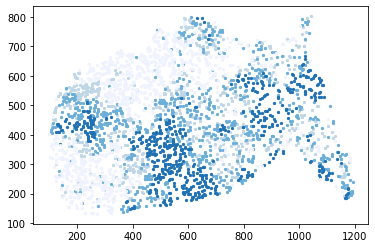

In [19]:
fig = plt.figure()
ax = fig.add_subplot()
xList = [pixelCoord[0] for pixelCoord in pixelCoordList0_sample]
yList = [pixelCoord[1] for pixelCoord in pixelCoordList0_sample]
ax.scatter(xList, yList, s = 5,c = np.asarray(colorList[0])/255.0)

xList = [pixelCoord[0] for pixelCoord in pixelCoordList1_sample]
yList = [pixelCoord[1] for pixelCoord in pixelCoordList1_sample]
ax.scatter(xList, yList, s = 5,c = np.asarray(colorList[1])/255.0)

xList = [pixelCoord[0] for pixelCoord in pixelCoordList2_sample]
yList = [pixelCoord[1] for pixelCoord in pixelCoordList2_sample]
ax.scatter(xList, yList, s = 5,c = np.asarray(colorList[2])/255.0)

xList = [pixelCoord[0] for pixelCoord in pixelCoordList3_sample]
yList = [pixelCoord[1] for pixelCoord in pixelCoordList3_sample]
ax.scatter(xList, yList, s = 5,c = np.asarray(colorList[3])/255.0)
plt.show()

In [20]:
def moransi(z, w):
    """
    Input
      z: list of values
      w: weight matrix
    Output
      I: Moran's I measure
    """
    n = len(z)
    mean = float(sum(z))/n
    S0 = 0
    d = 0
    var = 0
    for i in range(n):
        var += (z[i]-mean)**2
        for j in range(i):
            if w[i][j]:
                S0 += w[i][j]
                d += w[i][j] * (z[i]-mean) * (z[j]-mean)
    I = n*d/S0/var
    return I

In [21]:
len0 = len(pixelCoordList0_sample)
len1 = len(pixelCoordList1_sample)
len2 = len(pixelCoordList2_sample)
len3 = len(pixelCoordList3_sample)

In [22]:
zList0 = [colorGrey0 for i in range(len0)]
zList1 = [colorGrey1 for i in range(len1)]
zList2 = [colorGrey2 for i in range(len2)]
zList3 = [colorGrey3 for i in range(len3)]

In [23]:
# attribute list and coordinate list
zList = zList0 + zList1 + zList2 + zList3
pixelCoordList_sample = pixelCoordList0_sample + pixelCoordList1_sample + pixelCoordList2_sample + pixelCoordList3_sample

In [24]:
wMatrix = np.zeros(shape=(len(zList), len(zList)))

In [25]:
import math

In [26]:
def distance(coord1, coord2):
    x1, y1 = coord1[0], coord1[1]
    x2, y2 = coord2[0], coord2[1]
    dist = math.sqrt((x1 - x2)**2 + (y1 - y2)**2)
    return dist

In [27]:
# 1/(distance(pixelCoordList_sample[i], pixelCoordList_sample[j]) + 0.0000001)
def calculateKNeighWeight(i, coordList, k = 6): 
    # i is the currently target, k includes the point itself
    # k nearest neighborhood, only consider the k nearest neighbors
    # based on distance to calcuate weight, and normalize weight
    distList = []
    for j in range(len(coordList)):
        dist = distance(coordList[i], coordList[j])
        distList.append(dist)
    
    neighIndice = sorted(range(len(distList)), key = lambda sub: distList[sub])[:k]
    distNeigh = [distList[ind] for ind in neighIndice]

    neighIndice = neighIndice[1:]
    distNeigh = distNeigh[1:]
    wNeigh = [1/(distNeigh[j]+ 0.00000001) for j in range(len(distNeigh))]
    
    # normalize weights
    wNeighNorm = (np.asarray(wNeigh)/sum(wNeigh)).tolist()
    
    # put weights together
    wList = [0 for j in range(len(coordList))]
    for ind, j in enumerate(neighIndice):
        wList[j] = wNeighNorm[ind]
        
    return wList

In [28]:
for i in range(len(pixelCoordList_sample)):
    if i % 100 == 0:
        print(i)
    wMatrix[i] = calculateKNeighWeight(i, pixelCoordList_sample)

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900


In [29]:
w = wMatrix.tolist()

In [30]:
moransi(zList, w)

0.8260134782880447

In [31]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [32]:
sil = []
difSilList = []
kmax = 100
x = pixelCoordList0_sample
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(3, kmax+1):
#     print('K: '+str(k))
    kmeans = KMeans(n_clusters = k,random_state=0).fit(x)
    labels = kmeans.labels_
    silScore = silhouette_score(x, labels, metric = 'euclidean')
    difSil = 0
    if len(sil) > 0:
        difSil = silScore - sil[-1]
    sil.append(silScore)
    difSilList.append(difSil)
print(sil)

# find the best index of difSil
index = 0
maxValue = max(sil)
maxIndex = sil.index(maxValue)
maxDif = max(difSilList)
while maxIndex >= 3:
    maxValue = sil[maxIndex]
    i = maxIndex - 1
    if difSilList[maxIndex] < maxDif / 10:
        maxIndex = maxIndex - 1
    else:
        break
numClusters = maxIndex + 2
kmeans0 = KMeans(n_clusters = numClusters).fit(x)
kmeans0.cluster_centers_

[0.4235180744110417, 0.4464008246684377, 0.4476749434457403, 0.4807653755768408, 0.48791869271168786, 0.49653759132202985, 0.5050030702049374, 0.5028469529415746, 0.4960407337311193, 0.49384591408419104, 0.48886863588992585, 0.46786259587151685, 0.4755305596850538, 0.4735220486756464, 0.4565159786024188, 0.4388863400068717, 0.45229621800732, 0.4434072707788428, 0.4491584547644469, 0.46192175683202663, 0.4618980860488127, 0.45505135422162035, 0.46516411218658726, 0.4441890918452968, 0.43455510444140083, 0.4502740545617631, 0.4444210697874821, 0.43988578782005805, 0.442904149764453, 0.43595916067336044, 0.437143960512143, 0.4321738621396911, 0.43759762931607166, 0.42450524362641373, 0.4129588877427252, 0.4351733436512022, 0.423050740341462, 0.42486255700539527, 0.42571474452939567, 0.4479463808394793, 0.4360404126559459, 0.42974448936741094, 0.4318793171814702, 0.43361380849604386, 0.4243629196743843, 0.43356664263346933, 0.4337516713108999, 0.430207472937641, 0.4311236431796649, 0.42586

array([[ 392.36842105,  316.34736842],
       [ 738.11382114,  392.68292683],
       [ 233.625     ,  544.42857143],
       [ 561.31081081,  521.31081081],
       [ 910.95918367,  665.10204082],
       [1050.12903226,  382.16129032],
       [ 640.42372881,  716.3220339 ],
       [ 197.83333333,  338.8125    ]])

In [33]:
sil = []
difSilList = []
kmax = 100
x = pixelCoordList1_sample
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(3, kmax+1):
#     print('K: '+str(k))
    kmeans = KMeans(n_clusters = k,random_state=0).fit(x)
    labels = kmeans.labels_
    silScore = silhouette_score(x, labels, metric = 'euclidean')
    difSil = 0
    if len(sil) > 0:
        difSil = silScore - sil[-1]
    sil.append(silScore)
    difSilList.append(difSil)
print(sil)

# find the best index of difSil
index = 0
maxValue = max(sil)
maxIndex = sil.index(maxValue)
maxDif = max(difSilList)
while maxIndex >= 3:
    maxValue = sil[maxIndex]
    i = maxIndex - 1
    if difSilList[maxIndex] < maxDif / 10:
        maxIndex = maxIndex - 1
    else:
        break
numClusters = maxIndex + 2
kmeans1 = KMeans(n_clusters = numClusters).fit(x)
kmeans1.cluster_centers_

[0.40971027923715103, 0.4406882366775026, 0.44702361724316875, 0.4494977844849148, 0.49108604900099384, 0.4773851340301571, 0.47711865527167135, 0.4442227146321009, 0.44315132898213794, 0.4485528161777615, 0.4512089543748875, 0.4527399635595719, 0.45725950398849924, 0.4341526377423133, 0.43560963198053976, 0.44292737029906293, 0.4456728633931202, 0.4214526833132943, 0.44718197673336746, 0.4286373982558098, 0.4374935859990013, 0.4384956777012519, 0.43882207298037046, 0.4435940001416566, 0.4387133407106483, 0.43096367116156187, 0.4415854601367433, 0.43791401687557885, 0.4397521841227781, 0.43832481040301713, 0.4446733363735418, 0.44563695538084086, 0.4493786445114258, 0.43666867896292766, 0.4284074529033175, 0.43827965332789376, 0.4409490357549127, 0.4448001408153449, 0.4358994378068301, 0.4513836693996703, 0.4373994963945912, 0.4432287311279193, 0.44848513171685855, 0.43971632977820685, 0.4433446402351484, 0.4318682216250968, 0.4457446710447065, 0.4358510442482379, 0.44306399469551777, 

array([[ 725.08333333,  358.73888889],
       [ 258.82258065,  450.17741935],
       [ 607.24848485,  591.54545455],
       [1108.        ,  318.06666667],
       [ 436.8       ,  264.78095238],
       [ 910.36792453,  599.91509434]])

In [34]:
sil = []
difSilList = []
kmax = 100
x = pixelCoordList2_sample
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(3, kmax+1):
#     print('K: '+str(k))
    kmeans = KMeans(n_clusters = k,random_state=0).fit(x)
    labels = kmeans.labels_
    silScore = silhouette_score(x, labels, metric = 'euclidean')
    difSil = 0
    if len(sil) > 0:
        difSil = silScore - sil[-1]
    sil.append(silScore)
    difSilList.append(difSil)
print(sil)

# find the best index of difSil
index = 0
maxValue = max(sil)
maxIndex = sil.index(maxValue)
maxDif = max(difSilList)
while maxIndex >= 3:
    maxValue = sil[maxIndex]
    i = maxIndex - 1
    if difSilList[maxIndex] < maxDif / 10:
        maxIndex = maxIndex - 1
    else:
        break
numClusters = maxIndex + 2
kmeans2 = KMeans(n_clusters = numClusters).fit(x)
kmeans2.cluster_centers_

[0.5732726495599607, 0.5583496061068925, 0.4901935306910096, 0.4888617546458377, 0.47730165520221285, 0.4942207877561893, 0.497765140241782, 0.4798881084211006, 0.4890402435984076, 0.49067838137504477, 0.506037036426659, 0.4801235191990634, 0.45583156397845376, 0.4763331507593764, 0.45876164734142516, 0.46388395270689736, 0.4682780589022435, 0.45017513519585406, 0.44221945435979, 0.4497314714737242, 0.445637912303139, 0.42681786225771745, 0.438985631628815, 0.4237243359809302, 0.4502119822625585, 0.43672262007040236, 0.43940044229535763, 0.4435348886083177, 0.42279586632332933, 0.4321166245664071, 0.43876988716716486, 0.43671880449618183, 0.43679224005164113, 0.43256088378733043, 0.44555451287731307, 0.4446608667096429, 0.45847186535633566, 0.4443915452724998, 0.4346119010922723, 0.4426523989360663, 0.45029440050790853, 0.44387532420475356, 0.44514132839483006, 0.4398335586877369, 0.45022547765591486, 0.45085520960879416, 0.45227372732002363, 0.4453296957611946, 0.45342287974399215, 0.

array([[485.72209026, 325.27315914],
       [935.07727273, 469.30454545]])

In [35]:
sil = []
difSilList = []
kmax = 100
x = pixelCoordList3_sample
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(3, kmax+1):
#     print('K: '+str(k))
    kmeans = KMeans(n_clusters = k,random_state=0).fit(x)
    labels = kmeans.labels_
    silScore = silhouette_score(x, labels, metric = 'euclidean')
    difSil = 0
    if len(sil) > 0:
        difSil = silScore - sil[-1]
    sil.append(silScore)
    difSilList.append(difSil)
print(sil)

# find the best index of difSil
index = 0
maxValue = max(sil)
maxIndex = sil.index(maxValue)
maxDif = max(difSilList)
while maxIndex >= 3:
    maxValue = sil[maxIndex]
    i = maxIndex - 1
    if difSilList[maxIndex] < maxDif / 10:
        maxIndex = maxIndex - 1
    else:
        break
numClusters = maxIndex + 2
kmeans3 = KMeans(n_clusters = numClusters).fit(x)
kmeans3.cluster_centers_

[0.5694480301023018, 0.5197383410229666, 0.5071661774898258, 0.43013535909787876, 0.4460412151831925, 0.4197234639363114, 0.4110135892602784, 0.40007868613845093, 0.4095428812323045, 0.39716807589029496, 0.41164166477804975, 0.40492474764585656, 0.39589832934482666, 0.39012615508505527, 0.3964446046163672, 0.3863941023300179, 0.3958401664231248, 0.3873063284298647, 0.3787347771125579, 0.3724291209418088, 0.37666969189940486, 0.3671990267284392, 0.3725337270245543, 0.3815835175172963, 0.38358761480594433, 0.381800931390456, 0.3857985316649976, 0.38936677299587164, 0.3811493367158642, 0.39409092874779433, 0.3828532350529156, 0.3831890720994736, 0.38398557382520254, 0.3888507075891927, 0.38644186969778177, 0.38698777963051356, 0.3818190837338821, 0.39273636525315503, 0.39830225331620644, 0.3850251684326028, 0.38837731152217636, 0.3931894386226642, 0.3804638618892331, 0.3903498979339159, 0.39067820039809154, 0.3887918291285778, 0.3983857769468977, 0.3982610948093348, 0.39168067862586126, 0

array([[525.17301038, 594.61764706],
       [245.54711246, 266.66869301]])

In [36]:
kmeans3.cluster_centers_.shape

(2, 2)

###  find the cluster with fewest points and calculate number of clusters for each pixel category based on the min number of points in a cluster

In [47]:
# find the cluster with fewest points
numCluster0 = kmeans0.cluster_centers_.shape[0]
numPointInClusterList = []
for i in range(0,numCluster0):
    labelList = kmeans0.labels_.tolist()
    numPointInCluster = labelList.count(i)
#     print(numPointInCluster)
    numPointInClusterList.append(numPointInCluster)
for i in range(0,kmeans1.cluster_centers_.shape[0]):
    labelList = kmeans1.labels_.tolist()
    numPointInCluster = labelList.count(i)
#     print(numPointInCluster)
    numPointInClusterList.append(numPointInCluster)
for i in range(0,kmeans2.cluster_centers_.shape[0]):
    labelList = kmeans2.labels_.tolist()
    numPointInCluster = labelList.count(i)
#     print(numPointInCluster)
    numPointInClusterList.append(numPointInCluster)
for i in range(0,kmeans3.cluster_centers_.shape[0]):
    labelList = kmeans3.labels_.tolist()
    numPointInCluster = labelList.count(i)
#     print(numPointInCluster)
    numPointInClusterList.append(numPointInCluster)
minNumPointInCluster = min(numPointInClusterList)

In [48]:
# based on the min number of points in a cluster, calculate number of clusters for each pixel category
numCluster0 = math.ceil(len(pixelCoordList0_sample)/ minNumPointInCluster)
print(numCluster0)
numCluster1 = math.ceil(len(pixelCoordList1_sample)/ minNumPointInCluster)
print(numCluster1)
numCluster2 = math.ceil(len(pixelCoordList2_sample)/ minNumPointInCluster)
print(numCluster2)
numCluster3 = math.ceil(len(pixelCoordList3_sample)/ minNumPointInCluster)
print(numCluster3)

125
164
129
182


In [49]:
kmeans0 = KMeans(n_clusters = numCluster0).fit(pixelCoordList0_sample)
kmeans1 = KMeans(n_clusters = numCluster1).fit(pixelCoordList1_sample)
kmeans2 = KMeans(n_clusters = numCluster2).fit(pixelCoordList2_sample)
kmeans3 = KMeans(n_clusters = numCluster3).fit(pixelCoordList3_sample)

In [50]:
zCenters0 = [colorGrey0 for i in range(kmeans0.cluster_centers_.shape[0])]
zCenters1 = [colorGrey1 for i in range(kmeans1.cluster_centers_.shape[0])]
zCenters2 = [colorGrey2 for i in range(kmeans2.cluster_centers_.shape[0])]
zCenters3 = [colorGrey3 for i in range(kmeans3.cluster_centers_.shape[0])]

In [51]:
coordCenters0 = kmeans0.cluster_centers_.tolist()
coordCenters1 = kmeans1.cluster_centers_.tolist()
coordCenters2 = kmeans2.cluster_centers_.tolist()
coordCenters3 = kmeans3.cluster_centers_.tolist()

In [52]:
zCenters = zCenters0 + zCenters1 + zCenters2 + zCenters3
coordCenters = coordCenters0 + coordCenters1 + coordCenters2 + coordCenters3

In [53]:
wMatrix = np.zeros(shape=(len(zCenters), len(zCenters)))

In [54]:
for i in range(len(zCenters)):
    wMatrix[i] = calculateKNeighWeight(i, coordCenters)
    print(wMatrix[i])

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.21182527 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.18722932 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.19413508 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.16876184 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.25253547 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.21209979 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.1962075  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.17563673 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.17523538 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.14706924 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.2193095  0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.14739147 0.         0.         0.

 0.         0.         0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.48297537 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [55]:
w = wMatrix.tolist()
moransi(zCenters, w)

0.44034156524828555

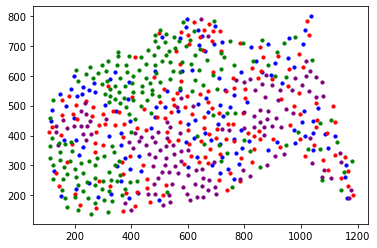

In [56]:
fig = plt.figure()
ax = fig.add_subplot()
xList = [pixelCoord[0] for pixelCoord in coordCenters0]
yList = [pixelCoord[1] for pixelCoord in coordCenters0]
ax.scatter(xList, yList, s = 10,c = 'blue')

xList = [pixelCoord[0] for pixelCoord in coordCenters1]
yList = [pixelCoord[1] for pixelCoord in coordCenters1]
ax.scatter(xList, yList, s = 10,c = 'red')

xList = [pixelCoord[0] for pixelCoord in coordCenters2]
yList = [pixelCoord[1] for pixelCoord in coordCenters2]
ax.scatter(xList, yList, s = 10,c = 'purple')

xList = [pixelCoord[0] for pixelCoord in coordCenters3]
yList = [pixelCoord[1] for pixelCoord in coordCenters3]
ax.scatter(xList, yList, s = 10,c = 'green')
plt.show()

### try to use the random lines to get number of clusters

#### first use a horizontal line as a prototype

In [57]:
pixelCoordList_sample[0]

(385, 452)

In [58]:
xList = [pixelCoord[0] for pixelCoord in pixelCoordList_sample]
yList = [pixelCoord[1] for pixelCoord in pixelCoordList_sample]
xMin, xMax = min(xList), max(xList)
yMin, yMax = min(yList), max(yList)
yMid = int((yMin + yMax) / 2)
xMin, xMax, yMin, yMax, yMid

(97, 1193, 131, 802, 466)

In [59]:
def calculateKNeigh(targetCoord, coordList, k = 6): 
    # targetCoord is the coordinate of current point
    # k nearest neighborhood, only consider the k nearest neighbors
    # CoordList is the set of coordinates to compare
    distList = []
    for j in range(len(coordList)):
        dist = distance(targetCoord, coordList[j])
        distList.append(dist)
    
    neighIndice = sorted(range(len(distList)), key = lambda sub: distList[sub])[:k]
#     [distList[ind] for ind in neighIndice]

    return neighIndice

In [60]:
def most_common(lst):
    return max(set(lst), key=lst.count)

In [61]:
def mostCommonListHLine(y,xMin, xMax, pixelCoordList_sample,zList):
    mostCommonList = []
    for x in range(xMin, xMax + 1):
        coord = (x,y)
        neighIndice = calculateKNeigh(coord, pixelCoordList_sample)
        # find the most common class
        zListNeighIndice = [zList[ind] for ind in neighIndice]
        mostCommon = most_common(zListNeighIndice)
        mostCommonList.append(mostCommon)
    return mostCommonList

In [62]:
def mostCommonListVLine(x,yMin, yMax, pixelCoordList_sample,zList):
    mostCommonList = []
    for y in range(yMin, yMax + 1):
        coord = (x,y)
        neighIndice = calculateKNeigh(coord, pixelCoordList_sample)
        # find the most common class
        zListNeighIndice = [zList[ind] for ind in neighIndice]
        mostCommon = most_common(zListNeighIndice)
        mostCommonList.append(mostCommon)
    return mostCommonList

In [63]:
mostCommonListLines = []
for y in range(yMin, yMax + 1, int((yMax + 1 - yMin) / 10)):
    print(y)
    mostCommonList = mostCommonListHLine(y, xMin, xMax, pixelCoordList_sample,zList)
    mostCommonListLines.append(mostCommonList)

131
198
265
332
399
466
533
600
667
734
801


In [64]:
for x in range(xMin, xMax + 1, int((xMax + 1 - xMin) / 10)):
    print(x)
    mostCommonList = mostCommonListHLine(x, yMin, yMax, pixelCoordList_sample,zList)
    mostCommonListLines.append(mostCommonList)

97
206
315
424
533
642
751
860
969
1078
1187


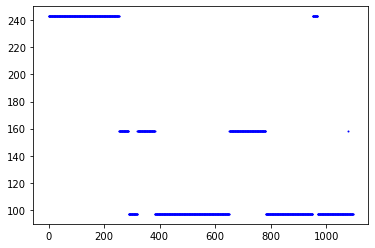

In [65]:
fig = plt.figure()
ax = fig.add_subplot()
xList = [i for i in range(len(mostCommonListLines[0]))]
yList = mostCommonListLines[0]
ax.scatter(xList, yList, s = 1,c = 'blue')

In [66]:
def countSegmentationFun(mostCommonList):
    countSegmentation = 1
    currentValue = mostCommonList[0]
    countDifferentTemp = 0
    for i in range(len(mostCommonList)):
        if mostCommonList[i] ==  currentValue:
            countDifferentTemp = 0
            continue
        else:
            countDifferentTemp += 1
            if countDifferentTemp > 20:
                currentValue = mostCommonList[i]
                countSegmentation += 1
    return countSegmentation

In [67]:
countSegmentationList = []
for mostCommonList in mostCommonListLines:
    countSegmentation = countSegmentationFun(mostCommonList)
    countSegmentationList.append(countSegmentation)
countSegmentationList

[7, 9, 7, 19, 16, 14, 9, 12, 8, 11, 11, 6, 6, 7, 7, 8, 3, 6, 5, 4, 3, 3]

In [68]:
countSegmentation = max(countSegmentationList)
totalNumCluster = countSegmentation**2
numClusterEach = math.ceil(totalNumCluster / 4)
print(numClusterEach)
numCluster0, numCluster1, numCluster2, numCluster3 = numClusterEach,numClusterEach,numClusterEach,numClusterEach

91


In [69]:
kmeans0 = KMeans(n_clusters = numCluster0).fit(pixelCoordList0_sample)
kmeans0.cluster_centers_

array([[ 228.66666667,  235.        ],
       [ 730.6       ,  388.        ],
       [ 225.45454545,  564.09090909],
       [ 660.88888889,  682.55555556],
       [1100.625     ,  396.5       ],
       [ 874.2       ,  605.6       ],
       [ 369.        ,  363.33333333],
       [ 396.        ,  545.5       ],
       [ 580.9       ,  545.1       ],
       [ 782.7       ,  413.2       ],
       [ 231.33333333,  360.16666667],
       [1157.57142857,  251.        ],
       [1005.83333333,  704.16666667],
       [ 728.        ,  493.5       ],
       [ 394.84615385,  286.76923077],
       [ 700.125     ,  291.375     ],
       [ 614.6       ,  384.8       ],
       [ 118.33333333,  467.55555556],
       [ 595.38461538,  774.23076923],
       [1039.        ,  406.5       ],
       [ 473.        ,  438.33333333],
       [ 341.55555556,  601.11111111],
       [ 979.4       ,  423.        ],
       [ 779.8       ,  314.6       ],
       [ 333.5       ,  492.83333333],
       [ 809.        ,  3

In [70]:
kmeans1 = KMeans(n_clusters = numCluster1).fit(pixelCoordList1_sample)
kmeans1.cluster_centers_

array([[ 850.90909091,  690.09090909],
       [ 344.84615385,  479.53846154],
       [ 784.28571429,  319.42857143],
       [1158.83333333,  275.33333333],
       [ 408.72727273,  191.72727273],
       [ 605.33333333,  524.22222222],
       [ 674.78571429,  754.14285714],
       [ 203.35294118,  472.17647059],
       [ 980.16666667,  549.5       ],
       [ 754.25      ,  439.16666667],
       [ 603.71428571,  326.21428571],
       [ 537.5       ,  476.625     ],
       [ 847.        ,  390.        ],
       [1106.25      ,  425.5       ],
       [1023.125     ,  769.875     ],
       [ 516.33333333,  217.33333333],
       [ 151.33333333,  272.33333333],
       [ 393.88888889,  330.11111111],
       [1087.92857143,  319.35714286],
       [ 289.88888889,  434.38888889],
       [ 748.125     ,  551.875     ],
       [ 847.75      ,  611.125     ],
       [ 739.88888889,  219.88888889],
       [ 562.6       ,  665.6       ],
       [ 618.53846154,  472.69230769],
       [ 181.75      ,  3

In [71]:
kmeans2 = KMeans(n_clusters = numCluster2).fit(pixelCoordList2_sample)
kmeans2.cluster_centers_

array([[ 506.        ,  352.42857143],
       [ 970.        ,  578.        ],
       [ 575.16666667,  223.16666667],
       [ 231.875     ,  486.75      ],
       [1101.88888889,  259.11111111],
       [ 838.5       ,  550.5       ],
       [ 790.66666667,  268.83333333],
       [ 494.07142857,  256.92857143],
       [ 797.        ,  425.5       ],
       [ 634.57142857,  240.14285714],
       [1065.2       ,  531.6       ],
       [ 535.        ,  420.83333333],
       [ 912.28571429,  432.57142857],
       [ 423.        ,  393.7       ],
       [ 672.        ,  731.        ],
       [ 572.14285714,  341.14285714],
       [ 241.5       ,  382.        ],
       [ 166.4       ,  435.6       ],
       [1057.42857143,  595.28571429],
       [1031.66666667,  391.33333333],
       [ 463.83333333,  214.83333333],
       [ 869.        ,  442.7       ],
       [ 728.2       ,  419.6       ],
       [ 694.5       ,  214.3       ],
       [1171.57142857,  199.57142857],
       [ 891.        ,  3

In [72]:
kmeans3 = KMeans(n_clusters = numCluster3).fit(pixelCoordList3_sample)
kmeans3.cluster_centers_

array([[ 185.81818182,  363.54545455],
       [ 623.81818182,  677.72727273],
       [ 381.41666667,  605.25      ],
       [ 948.25      ,  369.5       ],
       [ 302.23076923,  263.61538462],
       [ 903.71428571,  618.85714286],
       [ 487.30769231,  618.69230769],
       [ 167.6875    ,  270.9375    ],
       [ 723.55555556,  345.11111111],
       [ 375.23809524,  510.52380952],
       [ 210.83333333,  588.33333333],
       [1067.16666667,  354.        ],
       [ 531.92857143,  674.64285714],
       [ 649.7       ,  565.6       ],
       [ 408.33333333,  246.55555556],
       [ 332.52941176,  357.17647059],
       [ 316.13333333,  189.33333333],
       [ 979.5       ,  729.5       ],
       [ 300.64705882,  620.05882353],
       [ 452.5       ,  506.5       ],
       [ 217.36363636,  230.40909091],
       [ 423.7       ,  665.        ],
       [ 762.        ,  634.66666667],
       [ 751.57142857,  474.        ],
       [ 232.4       ,  310.53333333],
       [ 356.85714286,  6

In [73]:
zCenters0 = [colorGrey0 for i in range(kmeans0.cluster_centers_.shape[0])]
zCenters1 = [colorGrey1 for i in range(kmeans1.cluster_centers_.shape[0])]
zCenters2 = [colorGrey2 for i in range(kmeans2.cluster_centers_.shape[0])]
zCenters3 = [colorGrey3 for i in range(kmeans3.cluster_centers_.shape[0])]

In [74]:
coordCenters0 = kmeans0.cluster_centers_.tolist()
coordCenters1 = kmeans1.cluster_centers_.tolist()
coordCenters2 = kmeans2.cluster_centers_.tolist()
coordCenters3 = kmeans3.cluster_centers_.tolist()

In [75]:
zCenters = zCenters0 + zCenters1 + zCenters2 + zCenters3
coordCenters = coordCenters0 + coordCenters1 + coordCenters2 + coordCenters3

In [76]:
wMatrix = np.zeros(shape=(len(zCenters), len(zCenters)))

In [77]:
for i in range(len(zCenters)):
    wMatrix[i] = calculateKNeighWeight(i, coordCenters)
    print(wMatrix[i])

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

 0.13207002 0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.17431955 0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.14741421 0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.19422912
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.32003873 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.2066176  0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.15200682 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.34752907 0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.1741172  0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.24573154 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.16207058 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.28722731 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.14102399 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.21643029 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.34791389 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

 0.         0.         0.         0.        ]
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.16855378 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.42674281
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0

In [78]:
w = wMatrix.tolist()
moransi(zCenters, w)

0.41162314815913104

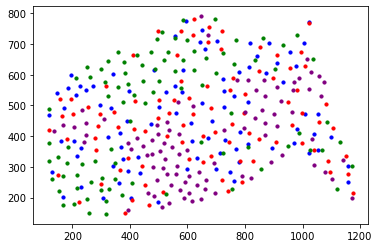

In [79]:
fig = plt.figure()
ax = fig.add_subplot()
xList = [pixelCoord[0] for pixelCoord in coordCenters0]
yList = [pixelCoord[1] for pixelCoord in coordCenters0]
ax.scatter(xList, yList, s = 10,c = 'blue')

xList = [pixelCoord[0] for pixelCoord in coordCenters1]
yList = [pixelCoord[1] for pixelCoord in coordCenters1]
ax.scatter(xList, yList, s = 10,c = 'red')

xList = [pixelCoord[0] for pixelCoord in coordCenters2]
yList = [pixelCoord[1] for pixelCoord in coordCenters2]
ax.scatter(xList, yList, s = 10,c = 'purple')

xList = [pixelCoord[0] for pixelCoord in coordCenters3]
yList = [pixelCoord[1] for pixelCoord in coordCenters3]
ax.scatter(xList, yList, s = 10,c = 'green')
plt.show()